# On Road Vehicle Detection using Machine Learning

Code references: Github, Scikit-Learn, Stack Overflow. 
The code here is an amalgamation of codes from multiple places and other code added by me for this project and in no way is entirely written by me. I have taken code from multiple place

In [1]:
# Import packages
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
#Import util file for functions defined in util file

from importlib import reload
import utils; reload(utils)
from utils import *

In [3]:
#Data directories

test_imgs_dir = "test_images"
output_imgs_dir = "output_images"
output_videos_dir = "output_videos"

project_dataset_dir = "/"
project_dataset_vehicles_dir = "vehicles/"
project_dataset_non_vehicles_dir = "non-vehicles/"

# Dataset exploration

In [4]:
# Let's fetch the paths of training images
project_vehicle_img_paths = glob.glob(project_dataset_vehicles_dir + "/**/*.png", recursive=True)
len(project_vehicle_img_paths)

8792

In [5]:
project_non_vehicle_img_paths = glob.glob(project_dataset_non_vehicles_dir + "/**/*.png", recursive=True)
len(project_non_vehicle_img_paths)

8968

In [6]:
example_vehicle_imgs= np.asarray(list(map(lambda path: load_image(path),  np.asarray(project_vehicle_img_paths)[np.random.randint(0, high=len(project_vehicle_img_paths), size=5)]))) 
example_non_vehicle_imgs= np.asarray(list(map(lambda path: load_image(path),  np.asarray(project_non_vehicle_img_paths)[np.random.randint(0, high=len(project_non_vehicle_img_paths), size=5)]))) 


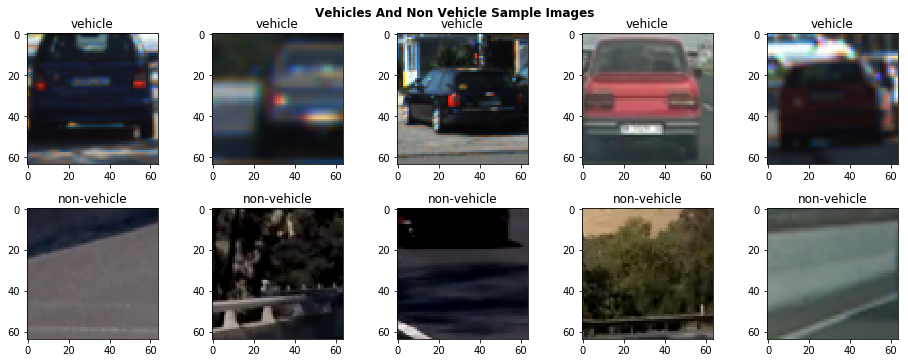

In [7]:
show_image_list([example_vehicle_imgs, example_non_vehicle_imgs], [np.repeat("vehicle", 5), np.repeat("non-vehicle", 5)], 
                "Vehicles And Non Vehicle Sample Images", cols=5, fig_size=(13, 5))


We can clearly see both vehicle and non-vehicle images. Non-vehicle images tend to be other elements of the road such as the asphalt, road signs or pavement. The distinction is very clear. Most images also display the vehicle in the center, but in different orientations, which is good. 

The concern however would be that because the vehicle is the central object of these images, we may be suffering from _translation_ invariance in the dataset (e.g. non image where we see half or less of the vehicle on the side, etc.).

It seems we will have to make sure to feed to our classifier an image where the vehicle is at the center.

# Feature Extraction

In this section, we apply Histogram of Oriented Gradients and Color bins to our input image to create our features, which will then be fed to a classifier. 

In [8]:
def subsample_image(img, new_size=(32,32), single_vector=True):
    """
    Resizes the image to the new size and returns either a 1-D vector or multi-dimensional matrix depending
    on the value of single_vector
    """
    features = cv2.resize(img, new_size)
    return features.ravel() if single_vector else features

In [9]:
def color_histogram(img, nbins=32, bins_range=(0, 256)):
    """
    Returns the histograms of the color image across all channels, as a concatenanted feature vector
    """
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    return hist_features

In [10]:
from skimage.feature import hog
from sklearn.preprocessing import StandardScaler

In [11]:
def pick_features(feat_sub_sample, feat_color_hist, feat_hog, 
                  use_sub_sample=False, use_color_hist=True, use_hog=True):
    """
    We select features to consider from the list of calcuated features.
    """
    feature_vec = []
    if use_sub_sample:
        feature_vec = feat_sub_sample
    if use_color_hist:
        feature_vec = feat_color_hist if len(feature_vec) == 0 else np.hstack((feature_vec, feat_color_hist))
    if use_hog:
        feature_vec = feat_hog if len(feature_vec) == 0 else np.hstack((feature_vec, feat_hog))
    
    return feature_vec

In [12]:
def get_hog_features(img, orient, pix_per_cell, cell_per_block, 
                        vis=False, feature_vec=True, b_norm="L2-Hys"):
    """
    Returns a feature matrix (or vector) that contains the result of the Histogram of Oriented gradients computation.
    If feature_vec is set to True, the resulting image is also returned.
    """
    if vis == True:
        features, hog_image = hog(img, orientations=orient, 
                                  pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), 
                                  transform_sqrt=False, 
                                  visualize=vis, feature_vector=feature_vec, block_norm="L2-Hys")
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = hog(img, orientations=orient, 
                       pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), 
                       transform_sqrt=False, 
                       visualize=vis, feature_vector=feature_vec, block_norm="L2-Hys")
        return features

In [13]:
def compute_features(img, color_space="YCrCb", subsample_size=(32, 32), hist_bins=32, hist_range=(0, 256), 
                    hog_orient=9, hog_pix_per_cell=8, hog_cells_per_block=2, hog_block_norm="L2-Hys",
                    hog_color_channels=[0, 1, 2], hog_grayscale=False):
    """
    Computes the features of the given image, by using a combination of:
    - image subsampling
    - color histogram
    - histogram of gradients
    The vector contains all concatenated (and unscaled) features computed
    """
    img_cspace = change_color_space(img, cspace=color_space)
    img_sub_sample = subsample_image(img_cspace, new_size=subsample_size)
    img_color_hist = color_histogram(img_cspace, nbins=hist_bins, bins_range=hist_range)

    hog_features = []
    if hog_color_channels == None:            
        hog_features, img_hog = hog(to_grayscale(img),  orientations=hog_orient,
                      pixels_per_cell=(hog_pix_per_cell, hog_pix_per_cell), 
                     cells_per_block=(hog_cells_per_block, hog_cells_per_block),
                     block_norm=hog_block_norm, visualize=True, feature_vector=True)
    else:
        for ch in hog_color_channels:
            hf, img_hog = hog(img_cspace[:,:,ch], orientations=hog_orient,
                      pixels_per_cell=(hog_pix_per_cell, hog_pix_per_cell), 
                     cells_per_block=(hog_cells_per_block, hog_cells_per_block),
                     block_norm=hog_block_norm, visualize=True, feature_vector=True)
            hog_features = hf if len(hog_features) == 0 else np.concatenate((hog_features, hf))
        
    return pick_features(img_sub_sample, img_color_hist, hog_features)

What does Normalisation do here?

In [14]:
def normalise_features(features, normaliser=None):
    """
    Returns the tuple (normalised_features, normaliser), 
    where normaliser can normalise feature data by applying the function normaliser.transform(data).
    The function can accept a default normaliser. If None is provided, one will be created and returned
    """
    stacked_features = np.vstack(features).astype(np.float64)
    if normaliser == None:        
        normaliser = StandardScaler().fit(stacked_features)
    normed_features = normaliser.transform(stacked_features)
    
    return normed_features, normaliser

# Exploration Of Features

HOG algorithm explained on this [here](https://www.learnopencv.com/histogram-of-oriented-gradients/). 

In [15]:
class FeatureConfig:
    """
    Stores feature configuration
    """
    def __init__(self, color_space, hog_orientations, hog_pixels_per_cell, hog_cells_per_block, hog_block_norm, hog_color_channels=[0,1,2]):
        self.color_space = color_space
        self.hog_orientations = hog_orientations
        self.hog_pixels_per_cell = hog_pixels_per_cell
        self.hog_cells_per_block = hog_cells_per_block
        self.hog_block_norm = hog_block_norm
        self.hog_color_channels = hog_color_channels

In [16]:
test_configs = [
    FeatureConfig("RGB", 9, 8, 2, "L2-Hys"),
    FeatureConfig("RGB", 9, 10, 2, "L2-Hys"),
    FeatureConfig("RGB", 9, 12, 2, "L2-Hys"),
    FeatureConfig("RGB", 9, 14, 2, "L2-Hys"),
    FeatureConfig("RGB", 9, 16, 2, "L2-Hys"),
    FeatureConfig("RGB", 11, 8, 2, "L2-Hys"),    
    FeatureConfig("RGB", 11, 10, 2, "L2-Hys"),
    FeatureConfig("RGB", 11, 12, 2, "L2-Hys"),
    FeatureConfig("RGB", 11, 14, 2, "L2-Hys"),
    FeatureConfig("RGB", 11, 16, 2, "L2-Hys")
]

In [17]:
def get_features_from_config(img, config):
    """
    Returns the tuple of the image in the configured color space, and a list of hog visualisations for each color channel
    """
    hog_visualisations = []
    cspace_img = change_color_space(img, config.color_space)
    for ch in [0, 1, 2]:
        _, hog_vis = get_hog_features(cspace_img[:,:,ch], config.hog_orientations, config.hog_pixels_per_cell, 
                         config.hog_cells_per_block, b_norm=config.hog_block_norm, vis=True)
        hog_visualisations.append(hog_vis)
    
    return (cspace_img, hog_visualisations)

In [18]:
def get_hog_features_from_multiple_configs(img, configs):
    """
    Returns the tuple (features, labels) resulting from the extraction of hog features for the passed configs
    """
    features = []
    labels = []
    for config in configs:
        cspace_img, hog_imgs = get_features_from_config(img, config)    
        features.append([cspace_img, hog_imgs[0], hog_imgs[1], hog_imgs[2]])
        hog_config_str = "o={0}, px/c={1}, c/bk={2}".format(config.hog_orientations, 
                                                          config.hog_pixels_per_cell, 
                                                          config.hog_cells_per_block)
        labels.append([config.color_space, 
                        "[1]: {0}".format(hog_config_str),
                        "[2]: {0}".format(hog_config_str),
                        "[3]: {0}".format(hog_config_str)])
    
    return (features, labels)

In [19]:
sample_vehicle_img = example_vehicle_imgs[np.random.randint(0, len(example_vehicle_imgs))]
sample_non_vehicle_img = example_non_vehicle_imgs[np.random.randint(0, len(example_non_vehicle_imgs))]

In [20]:
vehicle_imgs_hog, vehicle_imgs_hog_labels = get_hog_features_from_multiple_configs(sample_vehicle_img, test_configs)

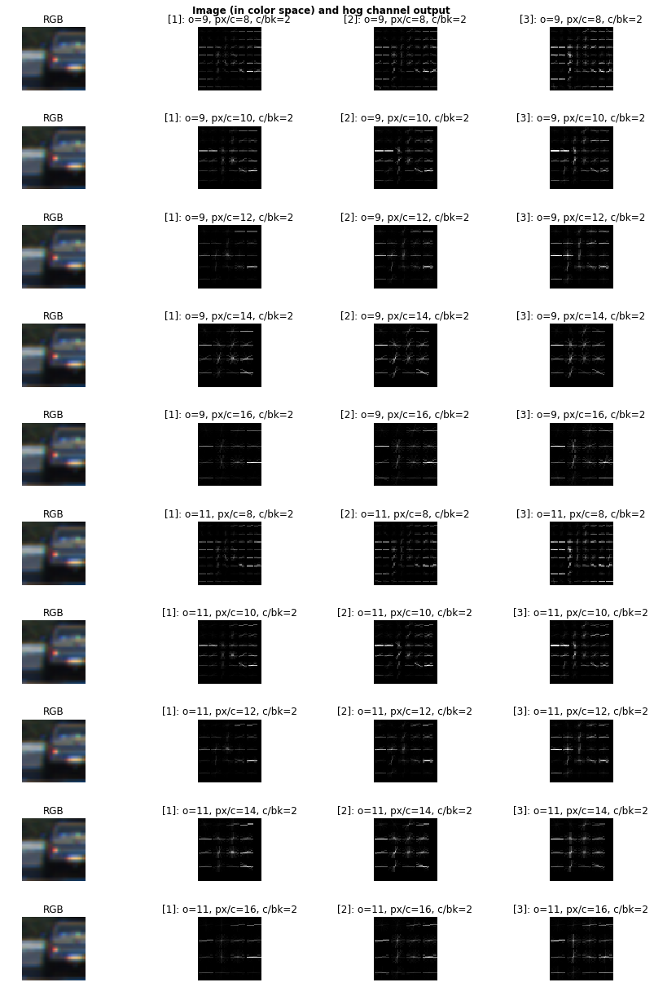

In [21]:
show_image_list(vehicle_imgs_hog, vehicle_imgs_hog_labels, 
                "Image (in color space) and hog channel output", cols=4, fig_size=(12, 17), show_ticks=False)

In [22]:
test_configs = [
    FeatureConfig("RGB", 11, 14, 2, "L2-Hys"),
    FeatureConfig("RGB", 11, 14, 3, "L2-Hys"),
    FeatureConfig("RGB", 11, 14, 4, "L2-Hys")
]

In [23]:
vehicle_imgs_hog, vehicle_imgs_hog_labels = get_hog_features_from_multiple_configs(sample_vehicle_img, test_configs)

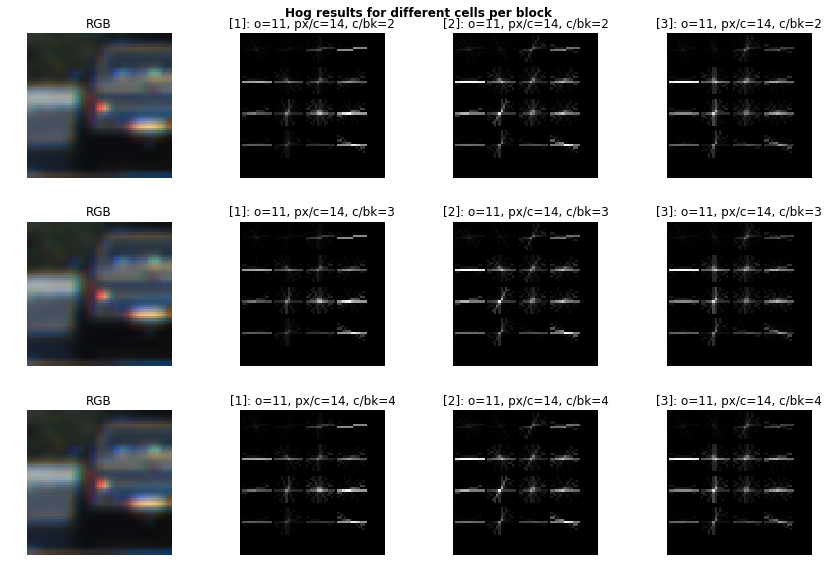

In [24]:
show_image_list(vehicle_imgs_hog, vehicle_imgs_hog_labels, 
                "Hog results for different cells per block", cols=4, fig_size=(12, 8), show_ticks=False)

To the human eye, there is no significant difference that we notice visually. We would ideally like to reduce the feature space for faster computation. But for now, we will settle for now on 2 cells per block as it is commonly used in the literature.

We must now explore the most suitable color space for our configuration, as it seems our hog features across the 3 RGB channels are too similar, therefore it feels we are not generating features with enough variations.

## Finding Suitable Color Space

In [25]:
test_configs = [
    FeatureConfig("RGB", 11, 14, 2, "L2-Hys"),
    FeatureConfig("HSV", 11, 14, 2, "L2-Hys"),
    FeatureConfig("HLS", 11, 14, 2, "L2-Hys"),
    FeatureConfig("YUV", 11, 14, 2, "L2-Hys"),
    FeatureConfig("YCrCb", 11, 14, 2, "L2-Hys"),
    FeatureConfig("LAB", 11, 14, 2, "L2-Hys")
]

In [26]:
vehicle_imgs_hog, vehicle_imgs_hog_labels = get_hog_features_from_multiple_configs(sample_vehicle_img, test_configs)

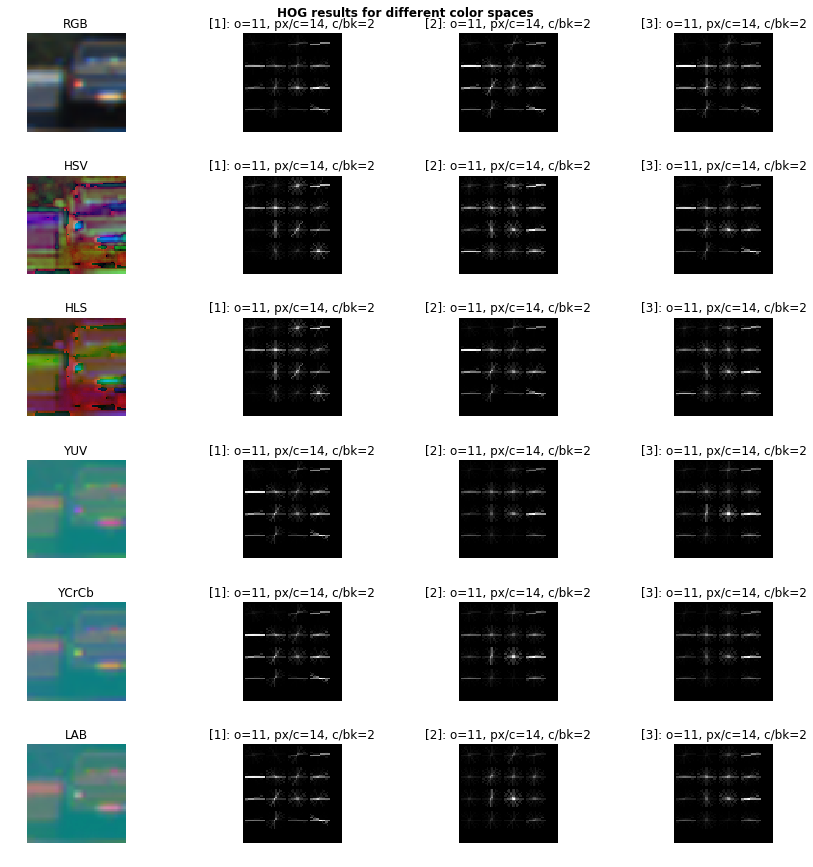

In [27]:
show_image_list(vehicle_imgs_hog, vehicle_imgs_hog_labels, 
                "HOG results for different color spaces", cols=4, fig_size=(12, 12), show_ticks=False)

For some color channels, it is difficult to interpret the result of HOG. Interestingly, it seems the first color channel in YUV, YCrCb, and LAB could be enough to capture the gradients we are looking for. In HSV and HLS it is respectively on the _Value_ and _Lightness_ that HOG captures the most significant features for the vehicle.

To confirm our hypothesis, let us try with a different image of vehicle.

In [28]:
sample_vehicle_img = example_vehicle_imgs[np.random.randint(0, len(example_vehicle_imgs))]

In [29]:
hog_features, hog_labels = get_hog_features_from_multiple_configs(sample_vehicle_img, test_configs)

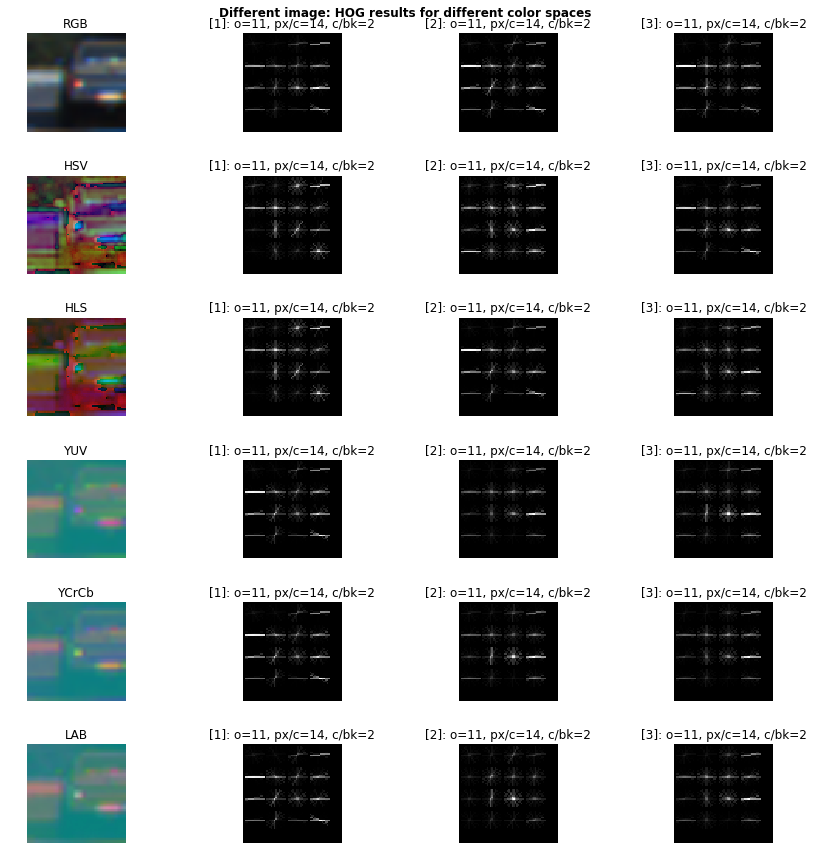

In [30]:
show_image_list(hog_features, hog_labels, 
                "Different image: HOG results for different color spaces", cols=4, fig_size=(12, 12), show_ticks=False)

We can observe that HOG on the channel that carries the most light information produces bad results. **We must therefore take into account all color channel to capture the most features.**
In the end, our configuration looks as follows:
* **ALL channels of YCrCb color space**
* **HOG orientations of 11**
* **HOG pixels per cell of 14**
* **HOG cells per cell of 2**

We will also be adding color information to strengthen our feature set.

# Classification

In [31]:
def extract_dataset_features(classes_imgs, labels, config):
    """
    Extract features from labeled dataset
    The list (normalised_features, labels, normaliser) is returned
    """
    all_features = []
    all_labels = []
    for i, class_imgs in enumerate(classes_imgs):
        class_features = []
        class_labels = np.repeat(labels[i], len(class_imgs))
        all_labels = class_labels if len(all_labels) == 0 else np.concatenate((all_labels, class_labels))
        for class_img_path in class_imgs:
            img = load_image(class_img_path)
            img_features = compute_features(img, color_space=config.color_space, 
                                            hog_orient=config.hog_orientations, 
                                            hog_pix_per_cell=config.hog_pixels_per_cell,
                                            hog_cells_per_block=config.hog_cells_per_block,
                                            hog_color_channels=config.hog_color_channels)
            class_features.append(img_features)

        all_features.append(class_features)
    
    normed_features, normaliser = normalise_features(all_features)    
    return normed_features, all_labels, normaliser    

In [32]:
feature_config = FeatureConfig("YCrCb", 11, 14, 2, "L2-Hys", hog_color_channels=[0,1,2])

In [33]:
data_features, data_labels, normaliser = extract_dataset_features([project_vehicle_img_paths, project_non_vehicle_img_paths], ["vehicle", "non_vehicle"], feature_config)

KeyboardInterrupt: 

In [ ]:
save_as_pickle(data_features, "features_Hist_ALL_HOG-11-14-2_YCrCb.p")

In [97]:
save_as_pickle(data_labels, "data_labels_Hist_ALL_HOG-11-14-2_YCrCb.p")
save_as_pickle(normaliser, "normaliser_Hist_ALL_HOG-11-14-2_YCrCb.p")

In [33]:
normaliser = load_as_pickle("normaliser_Hist_ALL_HOG-11-14-2_YCrCb.p")
data_features = load_as_pickle("features_Hist_ALL_HOG-11-14-2_YCrCb.p")
data_labels = load_as_pickle("data_labels_Hist_ALL_HOG-11-14-2_YCrCb.p")

In [34]:
len(data_labels)

17760

In [35]:
data_features.shape

(17760, 1284)

In [36]:
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier

In [37]:
def split_dataset(data, labels, test_pct=0.2):
    """
    Splits the dataset into with training having a proportion of 1 - test_pct, and the test set with propotion test_pct 
    Returns the tuple (X_train, y_train), (X_test, y_test)
    """
    X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=test_pct)
    return (X_train, y_train), (X_test, y_test)

In [38]:
def train_classifier(data, labels, method="LinearSVC"):
    """
    Train a classifier on the data and labels and returns the trained classifier
    The classifier itself can be chosen from a variety of options. The default is SVM    
    """
    cfier = None
    if method == "LinearSVC":
        cfier = LinearSVC(C=100)
    elif method == "RBFSVC":
        cfier = SVC(C=100)
    elif method == "DecisionTree":
        cfier = DecisionTreeClassifier()        
    
    cfier.fit(data, labels)

    return cfier

In [39]:
def train_classifier_grid_search(data, labels, method="SVM"):
    parameters = {}
    cfier = None
    if method == "SVM":    
        parameters = {'kernel':('linear', 'rbf'), 'C':[1, 100, 1000, 10000], "gamma":["auto", 0.01, 0.1, 1]}
        cfier = SVC()
    
    cfier_gs = GridSearchCV(cfier, parameters, cv=3, n_jobs=1, verbose=5)
    cfier_gs.fit(data, labels)
    
    return cfier_gs

In [40]:
training_dataset, test_dataset = split_dataset(data_features, data_labels)

In [41]:
print(training_dataset[0].shape, training_dataset[1].shape)

(14208, 1284) (14208,)


In [42]:
print(test_dataset[0].shape, test_dataset[1].shape)

(3552, 1284) (3552,)


In [47]:
classifier_grid_search = train_classifier_grid_search(training_dataset[0], training_dataset[1])

Fitting 3 folds for each of 32 candidates, totalling 96 fits
[CV] C=1, gamma=auto, kernel=linear ..................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  C=1, gamma=auto, kernel=linear, score=0.9915558370276546, total=  13.7s
[CV] C=1, gamma=auto, kernel=linear ..................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   20.9s remaining:    0.0s


[CV]  C=1, gamma=auto, kernel=linear, score=0.9881756756756757, total=  13.1s
[CV] C=1, gamma=auto, kernel=linear ..................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   41.2s remaining:    0.0s


[CV]  C=1, gamma=auto, kernel=linear, score=0.9885955649419219, total=  13.1s
[CV] C=1, gamma=auto, kernel=rbf .....................................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:  1.0min remaining:    0.0s


[CV]  C=1, gamma=auto, kernel=rbf, score=0.9964112307367532, total=  39.7s
[CV] C=1, gamma=auto, kernel=rbf .....................................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  2.1min remaining:    0.0s


[CV]  C=1, gamma=auto, kernel=rbf, score=0.9949324324324325, total=  39.5s
[CV] C=1, gamma=auto, kernel=rbf .....................................
[CV]  C=1, gamma=auto, kernel=rbf, score=0.9945089757127772, total=  40.1s
[CV] C=1, gamma=0.01, kernel=linear ..................................
[CV]  C=1, gamma=0.01, kernel=linear, score=0.9915558370276546, total=  13.4s
[CV] C=1, gamma=0.01, kernel=linear ..................................
[CV]  C=1, gamma=0.01, kernel=linear, score=0.9881756756756757, total=  13.1s
[CV] C=1, gamma=0.01, kernel=linear ..................................
[CV]  C=1, gamma=0.01, kernel=linear, score=0.9885955649419219, total=  13.1s
[CV] C=1, gamma=0.01, kernel=rbf .....................................
[CV]  C=1, gamma=0.01, kernel=rbf, score=0.6392231370065442, total= 8.0min
[CV] C=1, gamma=0.01, kernel=rbf .....................................
[CV]  C=1, gamma=0.01, kernel=rbf, score=0.6323902027027027, total= 8.6min
[CV] C=1, gamma=0.01, kernel=rbf .......

[CV]  C=1000, gamma=0.1, kernel=linear, score=0.9915558370276546, total=  13.3s
[CV] C=1000, gamma=0.1, kernel=linear ................................
[CV]  C=1000, gamma=0.1, kernel=linear, score=0.9881756756756757, total=  13.0s
[CV] C=1000, gamma=0.1, kernel=linear ................................
[CV]  C=1000, gamma=0.1, kernel=linear, score=0.9885955649419219, total=  13.1s
[CV] C=1000, gamma=0.1, kernel=rbf ...................................
[CV]  C=1000, gamma=0.1, kernel=rbf, score=0.5062275701921047, total=11.5min
[CV] C=1000, gamma=0.1, kernel=rbf ...................................
[CV]  C=1000, gamma=0.1, kernel=rbf, score=0.5063344594594594, total=10.6min
[CV] C=1000, gamma=0.1, kernel=rbf ...................................
[CV]  C=1000, gamma=0.1, kernel=rbf, score=0.5060190073917634, total=11.4min
[CV] C=1000, gamma=1, kernel=linear ..................................
[CV]  C=1000, gamma=1, kernel=linear, score=0.9915558370276546, total=  13.3s
[CV] C=1000, gamma=1, ker

[Parallel(n_jobs=1)]: Done  96 out of  96 | elapsed: 500.2min finished


In [49]:
classifier_grid_search.best_params_

{'C': 100, 'gamma': 'auto', 'kernel': 'rbf'}

In [50]:
save_as_pickle(classifier_grid_search, "classifier_Grid_Search_SVC_Hist_ch0_HOG-11-14-2_YCrCb.p")

In [43]:
classifier_grid_search = load_as_pickle("classifier_Grid_Search_SVC_Hist_ch0_HOG-11-14-2_YCrCb.p")

In [44]:
classifier = classifier_grid_search

In [45]:
simple_classifier = train_classifier(training_dataset[0], training_dataset[1], method="LinearSVC")
better_classifier = train_classifier(training_dataset[0], training_dataset[1], method="RBFSVC")

/home/cloaked04/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


In [46]:
save_as_pickle(classifier, "classifier_SVC-RBF_Hist_ALL_HOG-11-14-2_YCrCb.p")

In [46]:
classifier = load_as_pickle("classifier_SVC-RBF_Hist_ALL_HOG-11-14-2_YCrCb.p")

In [47]:
simple_preds = simple_classifier.predict(test_dataset[0])
better_preds = better_classifier.predict(test_dataset[0])

In [48]:
print("Simple classifier accuracy={0} - Better classifier accuracy={1}".format(
    accuracy_score(test_dataset[1], simple_preds),
    accuracy_score(test_dataset[1], better_preds)))

Simple classifier accuracy=0.9878941441441441 - Better classifier accuracy=0.995777027027027


In [49]:
test_imgs_paths = glob.glob(test_imgs_dir + "/*.jpg", recursive=True)

In [50]:
test_imgs = np.asarray(list(map(lambda img_path: load_image(img_path), test_imgs_paths)))

## Multi Scale Sliding Windows

In [51]:
import math
def multi_scale_pipeline(img, x_start, x_stop, y_start, y_stop, scale, cfier, normaliser, 
                         orient, pix_per_cell, cell_per_block, spatial_size, hist_bins,
                         window=64, color_space="YCrCb", correct_label="vehicle", overlap_cells=4):
    draw_img = np.copy(img)
    # Normalise our input image: COnvert to YCrCb
    img = change_color_space(img, cspace=color_space).astype(np.float32)
        
    # Define the image portion we are interested in
    img_tosearch = img[y_start:y_stop, x_start:x_stop, :]
    ctrans_tosearch = img_tosearch
    
    # Scale the cropped section of image if needed
    if scale != 1:
        imshape = ctrans_tosearch.shape 
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1]/scale), np.int(imshape[0]/scale)))
    
    ch1 = ctrans_tosearch[:,:,0]
    ch2 = ctrans_tosearch[:,:,1]
    ch3 = ctrans_tosearch[:,:,2]
    
    # Total number of cells in a given direction (x, y) 
    # is equivalent to the number of convolutions per axis in deep learning (c.f. cs231n)
    #The formula breaks down as follows for our current use case:
    # nxblock = [(axis_size - block_size) / stride] + 1 
    #  -> [(axis_size - pix_per_cell * cells_per_block) / pix_per_cell] + 1
    #  -> [(axis_size / pix_per_cell) - cells_per_block] + 1
    nxblocks = (ch1.shape[1] // pix_per_cell) - cell_per_block + 1
    nyblocks = (ch1.shape[0] // pix_per_cell) - cell_per_block + 1
    # Each cell within a block is normalised and produces a histogram of oriented features
    nfeat_per_block = orient*cell_per_block
    
    # Use the convolution formula to figure out the number of blocks in the window
    nblocks_per_window = (window // pix_per_cell) - cell_per_block + 1
    
    # Define how many steps we overlap
    cells_per_step = overlap_cells

    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step + 1
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step + 1
    
    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    
    bounding_boxes = []
    all_windows = []
    for xb in range(nxsteps):
        xpos = xb*cells_per_step
        for yb in range(nysteps):
            ypos = yb*cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))
            
            xleft = xpos*pix_per_cell
            ytop = ypos*pix_per_cell
            
            # Extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop+window, xleft:xleft+window], (window,window))
          
            # Get color features
            spatial_features = subsample_image(subimg, new_size=spatial_size)
            hist_features = color_histogram(subimg, nbins=hist_bins)
            
            # Pick features and make a prediction
            picked_features = pick_features(spatial_features, hist_features, hog_features)

            if len(picked_features.shape) == 1:
                picked_features = picked_features.reshape(1, -1)

            test_features = normaliser.transform(picked_features)
            test_prediction = cfier.predict(test_features)
            
            # Compute our window's actual size
            xbox_left = np.int(xleft * scale)
            ytop_draw = np.int(ytop * scale)
            win_draw = np.int(window * scale)
            
            top_left = (xbox_left + x_start, ytop_draw+y_start)
            bottom_right = (xbox_left+win_draw + x_start,ytop_draw+win_draw+y_start)
            
            all_windows.append((top_left, bottom_right))
            if test_prediction == correct_label:
                bounding_boxes.append((top_left, bottom_right))
    
    return bounding_boxes, all_windows

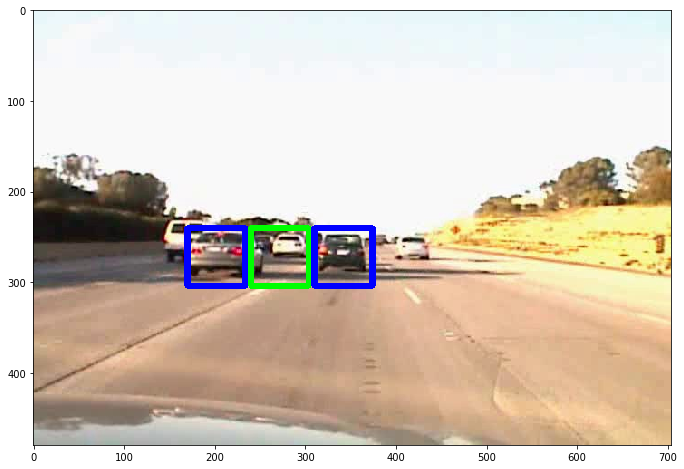

In [63]:
mc_bboxes, wins = multi_scale_pipeline(test_imgs[4], 100, 600, 100, 400, 1, better_classifier, normaliser, 11, 14, 2, (32, 32), 32, color_space="YCrCb", window=64, overlap_cells=5)
new_img_boxes = draw_boxes(test_imgs[4], mc_bboxes)
new_img_all_windows = draw_boxes(test_imgs[4], wins, alternating_bbox_color=(255, 153, 0))
plt.figure(figsize=(12,8))
plt.imshow(new_img_boxes)
plt.savefig('svm.png')

# Visualizing Training Process

In [64]:
from sklearn.model_selection import learning_curve

def plot_learning_process(estimator, title, X, y, ylim=None, cv=None, n_jobs=None, 
                                                train_sizes=np.array([0.1, 0.33, 0.55, 0.78, 1. ])):
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training Examples")
    plt.ylabel("Scores")
    
    train_sizes, train_scores, test_scores = learning_curve(estimator, 
                                                            X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    plt.grid()
    
    plt.fill_between(train_sizes, train_scores_mean-train_scores_std, train_scores_mean+train_scores_std, alpha=0.1,
                    color='r')
    plt.fill_between(train_sizes, test_scores_mean-test_scores_std, test_scores_mean+test_scores_std, alpha=0.1,
                    color='g')
    plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training Score')
    plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Cross Validation Score')
    
    plt.legend(loc='best')
    
    return plt
    

/home/cloaked04/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/home/cloaked04/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/home/cloaked04/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
/home/cloaked04/anaconda3/lib/python3.7/site-p

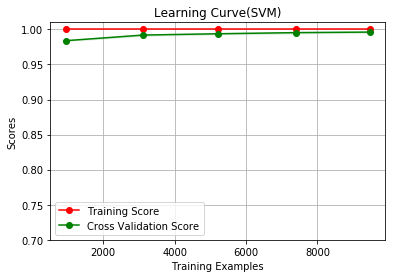

<Figure size 432x288 with 0 Axes>

In [78]:
#svm = MLPClassifier(hidden_layer_sizes=(8,8,8,), max_iter=500, alpha=0.01, solver='sgd', verbose=10, tol = 1e-04,
#                    random_state=1, learning_rate='adaptive', learning_rate_init=0.1)
title = "Learning Curve(SVM)"
plot_learning_process(better_classifier, title, training_dataset[0], training_dataset[1],cv=3, ylim=(0.7,1.01))
plt.show()
plt.savefig("svm_train.png")

# Multilayer Perceptron

Iteration 1, loss = 0.51880037
Iteration 2, loss = 0.14147673
Iteration 3, loss = 0.08235390
Iteration 4, loss = 0.03106529
Iteration 5, loss = 0.01549824
Iteration 6, loss = 0.00658639
Iteration 7, loss = 0.00548057
Iteration 8, loss = 0.00382188
Iteration 9, loss = 0.00365540
Iteration 10, loss = 0.00346371
Iteration 11, loss = 0.00336493
Iteration 12, loss = 0.00328037
Iteration 13, loss = 0.00319676
Iteration 14, loss = 0.00313303
Iteration 15, loss = 0.00306807
Iteration 16, loss = 0.00303073
Iteration 17, loss = 0.00298934
Iteration 18, loss = 0.00290155
Iteration 19, loss = 0.00273671
Iteration 20, loss = 0.00247395
Iteration 21, loss = 0.00202239
Iteration 22, loss = 0.00199764
Iteration 23, loss = 0.00196713
Iteration 24, loss = 0.00193203
Iteration 25, loss = 0.00190974
Iteration 26, loss = 0.00190034
Iteration 27, loss = 0.00186616
Iteration 28, loss = 0.00184140
Iteration 29, loss = 0.00182185
Iteration 30, loss = 0.00181064
Iteration 31, loss = 0.00178939
Iteration 32, los

Iteration 88, loss = 0.00165135
Iteration 89, loss = 0.00165135
Iteration 90, loss = 0.00165135
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 91, loss = 0.00165135
Iteration 92, loss = 0.00165135
Iteration 93, loss = 0.00165135
Iteration 94, loss = 0.00165135
Iteration 95, loss = 0.00165135
Iteration 96, loss = 0.00165135
Iteration 97, loss = 0.00165135
Iteration 98, loss = 0.00165135
Iteration 99, loss = 0.00165135
Iteration 100, loss = 0.00165135
Iteration 101, loss = 0.00165135
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000000
Iteration 102, loss = 0.00165134
Iteration 103, loss = 0.00165134
Iteration 104, loss = 0.00165134
Iteration 105, loss = 0.00165134
Iteration 106, loss = 0.00165134
Iteration 107, loss = 0.00165134
Iteration 108, loss = 0.00165134
Iteration 109, loss = 0.00165134
Iteration 110, loss = 0.00165134
Iteration 111, loss = 0.0

Iteration 66, loss = 0.00137576
Iteration 67, loss = 0.00137576
Iteration 68, loss = 0.00137575
Iteration 69, loss = 0.00137575
Iteration 70, loss = 0.00137575
Iteration 71, loss = 0.00137575
Iteration 72, loss = 0.00137575
Iteration 73, loss = 0.00137574
Iteration 74, loss = 0.00137574
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000006
Iteration 75, loss = 0.00137574
Iteration 76, loss = 0.00137574
Iteration 77, loss = 0.00137574
Iteration 78, loss = 0.00137574
Iteration 79, loss = 0.00137574
Iteration 80, loss = 0.00137574
Iteration 81, loss = 0.00137574
Iteration 82, loss = 0.00137574
Iteration 83, loss = 0.00137574
Iteration 84, loss = 0.00137574
Iteration 85, loss = 0.00137574
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 86, loss = 0.00137574
Iteration 87, loss = 0.00137574
Iteration 88, loss = 0.00137574
Iteration 89, loss = 0.00137574
Iter

Iteration 77, loss = 0.00128676
Iteration 78, loss = 0.00128675
Iteration 79, loss = 0.00128675
Iteration 80, loss = 0.00128675
Iteration 81, loss = 0.00128675
Iteration 82, loss = 0.00128675
Iteration 83, loss = 0.00128675
Iteration 84, loss = 0.00128675
Iteration 85, loss = 0.00128675
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000006
Iteration 86, loss = 0.00128675
Iteration 87, loss = 0.00128675
Iteration 88, loss = 0.00128675
Iteration 89, loss = 0.00128675
Iteration 90, loss = 0.00128675
Iteration 91, loss = 0.00128675
Iteration 92, loss = 0.00128675
Iteration 93, loss = 0.00128675
Iteration 94, loss = 0.00128675
Iteration 95, loss = 0.00128675
Iteration 96, loss = 0.00128675
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 97, loss = 0.00128675
Iteration 98, loss = 0.00128675
Iteration 99, loss = 0.00128675
Iteration 100, loss = 0.00128675
Ite

Iteration 47, loss = 0.00174513
Iteration 48, loss = 0.00174505
Iteration 49, loss = 0.00174499
Iteration 50, loss = 0.00174495
Iteration 51, loss = 0.00174485
Iteration 52, loss = 0.00174480
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000160
Iteration 53, loss = 0.00174471
Iteration 54, loss = 0.00174473
Iteration 55, loss = 0.00174466
Iteration 56, loss = 0.00174465
Iteration 57, loss = 0.00174464
Iteration 58, loss = 0.00174462
Iteration 59, loss = 0.00174460
Iteration 60, loss = 0.00174459
Iteration 61, loss = 0.00174459
Iteration 62, loss = 0.00174457
Iteration 63, loss = 0.00174456
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000032
Iteration 64, loss = 0.00174454
Iteration 65, loss = 0.00174454
Iteration 66, loss = 0.00174454
Iteration 67, loss = 0.00174453
Iteration 68, loss = 0.00174453
Iteration 69, loss = 0.00174453
Iteration 70, loss = 0.00174453
Iter

Iteration 31, loss = 0.00140704
Iteration 32, loss = 0.00140675
Iteration 33, loss = 0.00140651
Iteration 34, loss = 0.00140626
Iteration 35, loss = 0.00140601
Iteration 36, loss = 0.00140576
Iteration 37, loss = 0.00140552
Iteration 38, loss = 0.00140527
Iteration 39, loss = 0.00140503
Iteration 40, loss = 0.00140478
Iteration 41, loss = 0.00140453
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000800
Iteration 42, loss = 0.00140435
Iteration 43, loss = 0.00140429
Iteration 44, loss = 0.00140424
Iteration 45, loss = 0.00140419
Iteration 46, loss = 0.00140414
Iteration 47, loss = 0.00140409
Iteration 48, loss = 0.00140405
Iteration 49, loss = 0.00140400
Iteration 50, loss = 0.00140395
Iteration 51, loss = 0.00140390
Iteration 52, loss = 0.00140385
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000160
Iteration 53, loss = 0.00140381
Iteration 54, loss = 0.00140380
Iter

Iteration 5, loss = 0.00748835
Iteration 6, loss = 0.00548227
Iteration 7, loss = 0.00486398
Iteration 8, loss = 0.00419592
Iteration 9, loss = 0.00371767
Iteration 10, loss = 0.00356953
Iteration 11, loss = 0.00346963
Iteration 12, loss = 0.00337670
Iteration 13, loss = 0.00284822
Iteration 14, loss = 0.00275795
Iteration 15, loss = 0.00265973
Iteration 16, loss = 0.00261375
Iteration 17, loss = 0.00255595
Iteration 18, loss = 0.00253623
Iteration 19, loss = 0.00250908
Iteration 20, loss = 0.00248630
Iteration 21, loss = 0.00247474
Iteration 22, loss = 0.00246243
Iteration 23, loss = 0.00245202
Iteration 24, loss = 0.00243302
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.020000
Iteration 25, loss = 0.00242964
Iteration 26, loss = 0.00241855
Iteration 27, loss = 0.00241334
Iteration 28, loss = 0.00241415
Iteration 29, loss = 0.00241004
Iteration 30, loss = 0.00240855
Iteration 31, loss = 0.00240888
Iteration 32, loss = 0.0024

Iteration 95, loss = 0.00159874
Iteration 96, loss = 0.00159874
Iteration 97, loss = 0.00159874
Iteration 98, loss = 0.00159874
Iteration 99, loss = 0.00159874
Iteration 100, loss = 0.00159874
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000000
Iteration 101, loss = 0.00159874
Iteration 102, loss = 0.00159874
Iteration 103, loss = 0.00159874
Iteration 104, loss = 0.00159874
Iteration 105, loss = 0.00159874
Iteration 106, loss = 0.00159874
Iteration 107, loss = 0.00159874
Iteration 108, loss = 0.00159874
Iteration 109, loss = 0.00159874
Iteration 110, loss = 0.00159874
Iteration 111, loss = 0.00159874
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.13720060
Iteration 2, loss = 0.02134624
Iteration 3, loss = 0.01146317
Iteration 4, loss = 0.00505436
Iteration 5, loss = 0.00278934
Iteration 6, loss = 0.00286318
Iteration 7, loss = 0.0021805

Iteration 67, loss = 0.00152908
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000032
Iteration 68, loss = 0.00152907
Iteration 69, loss = 0.00152907
Iteration 70, loss = 0.00152907
Iteration 71, loss = 0.00152906
Iteration 72, loss = 0.00152906
Iteration 73, loss = 0.00152906
Iteration 74, loss = 0.00152906
Iteration 75, loss = 0.00152905
Iteration 76, loss = 0.00152905
Iteration 77, loss = 0.00152905
Iteration 78, loss = 0.00152905
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000006
Iteration 79, loss = 0.00152904
Iteration 80, loss = 0.00152904
Iteration 81, loss = 0.00152904
Iteration 82, loss = 0.00152904
Iteration 83, loss = 0.00152904
Iteration 84, loss = 0.00152904
Iteration 85, loss = 0.00152904
Iteration 86, loss = 0.00152904
Iteration 87, loss = 0.00152904
Iteration 88, loss = 0.00152904
Iteration 89, loss = 0.00152904
Training loss did not improve more t

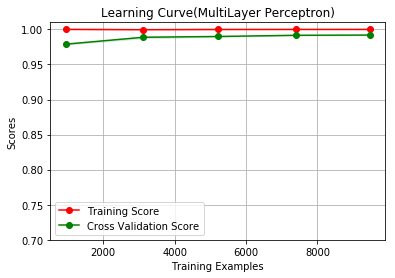

In [65]:
mlp = MLPClassifier(hidden_layer_sizes=(8,8,8,), max_iter=500, alpha=0.01, solver='sgd', verbose=10, tol = 1e-04,
                    random_state=1, learning_rate='adaptive', learning_rate_init=0.1)
title = "Learning Curve(MultiLayer Perceptron)"
plot_learning_process(mlp, title, training_dataset[0], training_dataset[1],cv=3, ylim=(0.7,1.01))
plt.show()
plt.savefig("mlp_train.png")

In [66]:
MLP = mlp.fit(training_dataset[0], training_dataset[1])



Iteration 1, loss = 0.09058937
Iteration 2, loss = 0.01894738
Iteration 3, loss = 0.01026064
Iteration 4, loss = 0.00659957
Iteration 5, loss = 0.00453113
Iteration 6, loss = 0.00445590
Iteration 7, loss = 0.00582689
Iteration 8, loss = 0.00363835
Iteration 9, loss = 0.00523904
Iteration 10, loss = 0.00243429
Iteration 11, loss = 0.00196550
Iteration 12, loss = 0.00188900
Iteration 13, loss = 0.00185230
Iteration 14, loss = 0.00182608
Iteration 15, loss = 0.00180222
Iteration 16, loss = 0.00178447
Iteration 17, loss = 0.00176439
Iteration 18, loss = 0.00174734
Iteration 19, loss = 0.00173093
Iteration 20, loss = 0.00171504
Iteration 21, loss = 0.00170015
Iteration 22, loss = 0.00168617
Training loss did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.020000
Iteration 23, loss = 0.00167318
Iteration 24, loss = 0.00166993
Iteration 25, loss = 0.00166736
Iteration 26, loss = 0.00166487
Iteration 27, loss = 0.00166167
Iteration 28, loss = 0.00165904

In [67]:
mlp_preds = MLP.predict(test_dataset[0])
accuracy_score(test_dataset[1], mlp_preds)

0.9943693693693694

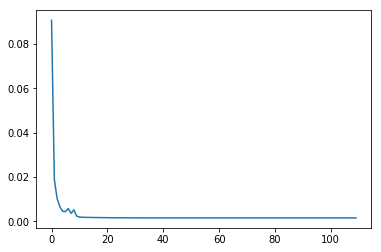

<Figure size 432x288 with 0 Axes>

In [68]:
mlp_loss = mlp.loss_curve_
#mlp_loss
plt.plot(mlp_loss)
plt.show()
plt.savefig("mlp_loss.png")

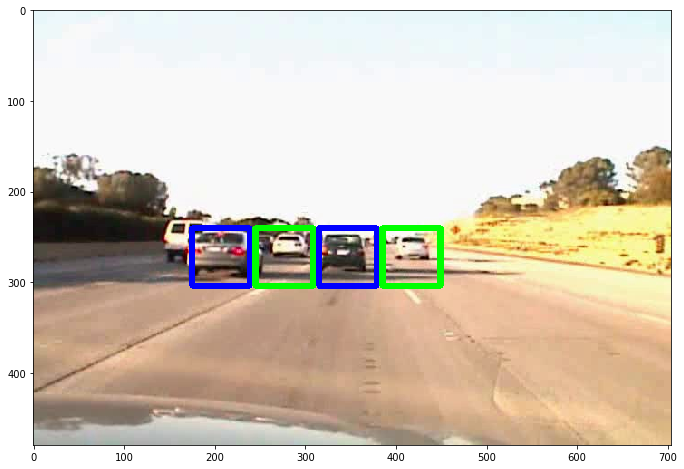

In [69]:
mc_bboxes, wins = multi_scale_pipeline(test_imgs[4], 35, 600, 100, 400, 1, MLP, normaliser, 11, 14, 2, (32, 32), 32, color_space="YCrCb", window=64, overlap_cells=5)
new_img_boxes = draw_boxes(test_imgs[4], mc_bboxes)
new_img_all_windows = draw_boxes(test_imgs[4], wins, alternating_bbox_color=(255, 153, 0))
plt.figure(figsize=(12,8))
plt.imshow(new_img_boxes)
plt.savefig("mlp.png")

# Decision Trees

/home/cloaked04/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


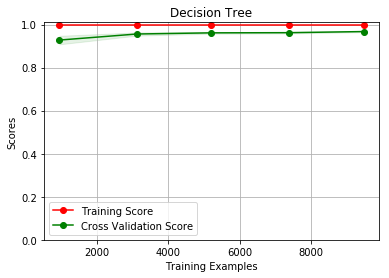

<Figure size 432x288 with 0 Axes>

In [70]:
decision_tree = DecisionTreeClassifier()
title = "Decision Tree"
plot_learning_process(decision_tree, title, training_dataset[0], training_dataset[1], ylim=(0.0,1.01))
plt.show()
plt.savefig("dtree_train.png")

In [71]:
d_tree = decision_tree.fit(training_dataset[0], training_dataset[1])

In [72]:
d_tree_preds = d_tree.predict(test_dataset[0])
accuracy_score(test_dataset[1], d_tree_preds)

0.9718468468468469

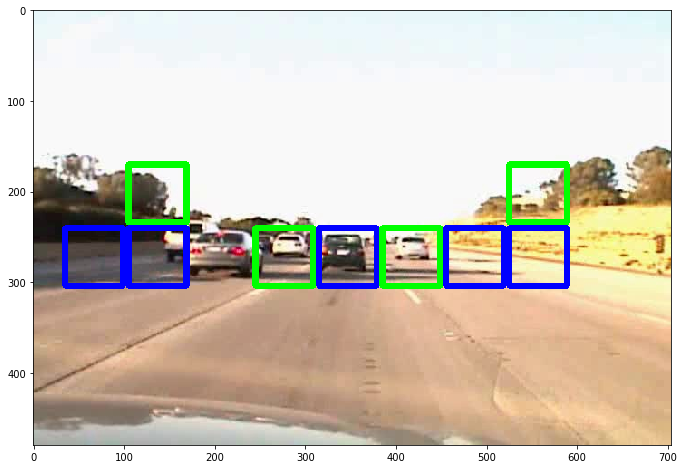

In [73]:
mc_bboxes, wins = multi_scale_pipeline(test_imgs[4], 35, 600, 100, 400, 1, d_tree, normaliser, 11, 14, 2, (32, 32), 32, color_space="YCrCb", window=64, overlap_cells=5)
new_img_boxes = draw_boxes(test_imgs[4], mc_bboxes)
new_img_all_windows = draw_boxes(test_imgs[4], wins, alternating_bbox_color=(255, 153, 0))
plt.figure(figsize=(12,8))
plt.imshow(new_img_boxes)

# Naive Bayes

/home/cloaked04/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


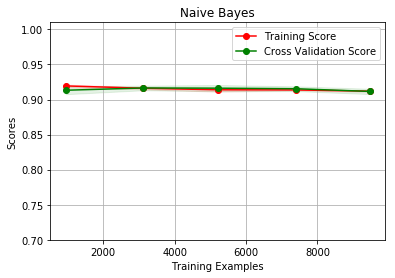

<Figure size 432x288 with 0 Axes>

In [74]:
naive_bayes = GaussianNB()
title = "Naive Bayes"
plot_learning_process(naive_bayes, title, training_dataset[0], training_dataset[1], ylim=(0.7,1.01))
plt.show()
plt.savefig("nb_train.png")

In [75]:
NB = naive_bayes.fit(training_dataset[0], training_dataset[1])

In [76]:
nb_preds = NB.predict(test_dataset[0])
accuracy_score(test_dataset[1], nb_preds)

0.9082207207207207

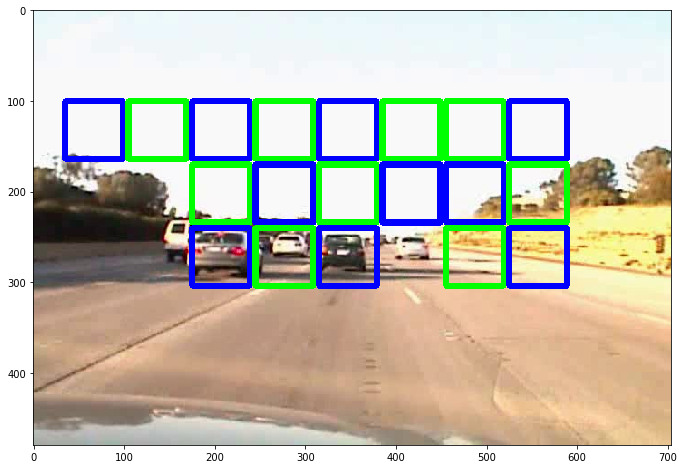

In [77]:
mc_bboxes, wins = multi_scale_pipeline(test_imgs[4], 35, 600, 100, 400, 1, NB, normaliser, 11, 14, 2, (32, 32), 32, color_space="YCrCb", window=64, overlap_cells=5)
new_img_boxes = draw_boxes(test_imgs[4], mc_bboxes)
new_img_all_windows = draw_boxes(test_imgs[4], wins, alternating_bbox_color=(255, 153, 0))
plt.figure(figsize=(12,8))
plt.imshow(new_img_boxes)
plt.savefig("nb.png")

## Heatmap Thresholding

In [80]:
from scipy.ndimage.measurements import label

In [81]:
def create_heatmap(img, bbox_list):
    """
    Returns a new heatmap where the regions of the image captured by the bounding boxes are "heated-up"
    Takes in the first channel of image and adds value to pixels in region where object is found to heat up 
    the area.
    """
    heatmap = np.zeros_like(img[:,:,0]).astype(np.float)
    for box in bbox_list:
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1
    
    heatmap = np.clip(heatmap, 0, 255)

    return heatmap

In [82]:
def threshold_heatmap(heatmap, threshold=2):
    """
    Updates the heatmap by only retaining hot sections whose values are strictly above the threshold.
    All other values are "cooled" down, i.e., the pixels are set to zero so that only heated up region is 
    visible.
    """
    heatmap_copy = np.copy(heatmap)
    # Zero out pixels below the threshold
    heatmap_copy[heatmap_copy < threshold] = 0
    # Return thresholded map
    return heatmap_copy

In [83]:
def label_heatmap(heatmap):
    """
    Returns a slice with labels over the original heatmap using label function from scipy, 
    as well as the total count of labels found
    """
    return label(heatmap)

In [84]:
def find_smoothed_boxes(img, labels, duplicate=True, min_area_filter=32*32):
    """
    Returns a set of bounding boxes where each bounding box is the aggregations of neighbouring boxes for the same label
    Taken in value of detected features and number of features.
    Outputs: List of Top left and bottom right co-ordinates for patch in which object is detected.
    
    """
    aggregate_bboxes = []
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        
        top_left = (np.min(nonzerox), np.min(nonzeroy))
        bottom_right = (np.max(nonzerox), np.max(nonzeroy))
        
        if (bottom_right[0] - top_left[0]) * (bottom_right[1] - top_left[1]) < min_area_filter:
            continue
        
        # Define a bounding box based on min/max x and y
        aggregate_bboxes.append(((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy))))
    # Return the image
    
    return aggregate_bboxes

In [85]:
def smoothen_bounding_boxes(img, bboxes, thres=2):
    
    heat = create_heatmap(img, bboxes)
    heat_thresholded = threshold_heatmap(heat, threshold=thres)
    heat_labels = label_heatmap(heat_thresholded)
    smoothed_bboxes = find_smoothed_boxes(img, heat_labels)
    
    return heat, heat_thresholded, heat_labels, smoothed_bboxes

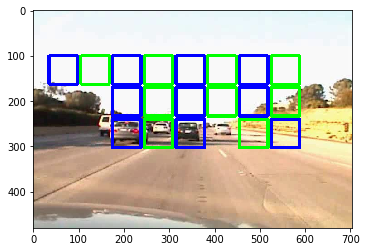

In [86]:
heatmap, heatmap_thres, heatmap_lbs, smoothed_bboxes = smoothen_bounding_boxes(test_imgs[4], mc_bboxes, thres=1)
plt.imshow(draw_boxes(test_imgs[4], smoothed_bboxes))

In [87]:
heatmap_lbs[1]

19

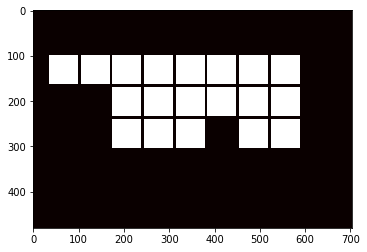

In [88]:
plt.imshow(heatmap * 255, cmap="hot")

In [89]:
def create_heatmap_rgb_img(hmap):
    """
    Create a heatmap from a binary image
    """
    scale = np.max(hmap) / 255
    if scale == 0:
        # Handle the zero case. We could also add an epsilon
        scale = 1
    z = np.zeros_like(hmap).astype(np.uint8)
    hm_scaled = (hmap / scale).astype(np.uint8)
    return np.dstack((hm_scaled, z, z))
    


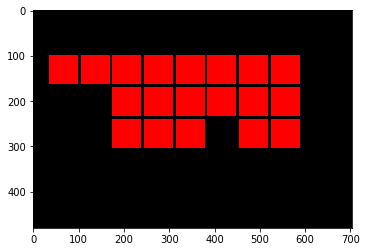

In [90]:
hm_scaled = create_heatmap_rgb_img(heatmap)
plt.imshow(hm_scaled)

# Putting It All Together

In [91]:
def draw_boxes_np(img, bboxes, color=(0, 0, 255), thick=6):
    """
    Returns a new image the bounding boxes have been overlaid in the chosen color
    The bounding boxes are contained within a numpy array
    """
    imcopy = np.copy(img)
    for bbox in bboxes:
        cv2.rectangle(imcopy, (bbox[0][0], bbox[0][1]), (bbox[1][0], bbox[1][1]), color, thick)

    return imcopy

In [92]:
def combine_images(img, overlay_imgs, small_img_size, x_offset, y_offset):
    """
    Returns an image that combines the original image with a set of overlaid images
    The overlaid images are resized to the supplied dimensions and overlaid onto the original image.
    Returned image is a modification of the original image.
    """
    img_copy = np.copy(img)
    #print(img_copy.shape)
    #print(overlay_imgs.shape)
    for i, overlay_img in enumerate(overlay_imgs):        
        sc = i + 1
        small_overlay_img = cv2.resize(overlay_img, small_img_size)
        overlay_color = small_overlay_img
        if len(overlay_color.shape) < 3:
            # Create the mini-heatmap
            overlay_color = create_heatmap_rgb_img(overlay_color)
        new_y_offset = y_offset
        new_x_offset = sc * x_offset + i * small_img_size[0]
        #img.setflags(write=1)
        img_copy[new_y_offset: new_y_offset + small_img_size[1], new_x_offset: new_x_offset + small_img_size[0]] = overlay_color
    
    return img_copy
        

In [93]:
import math
class DetectedObject:
    """
    The DetectedObject class calculates the bounding boxes, the number of boxes in which object is detected, 
    tells if the same object is detected or not. 
    """
    def __init__(self, bounding_box, img_patch, frame_nb):
        self.bounding_box = bounding_box
        self.img_patch = img_patch 
        self.frame_nb = frame_nb
        self.centroid = (int((bounding_box[0][0] + bounding_box[1][0]) / 2), int((bounding_box[0][1] + bounding_box[1][1]) / 2))
        self.similar_objects = []
            
    def bounding_box_area(self):
        """
        Returns the area of the bounding box
        """
        return (self.bounding_box[1][0] - self.bounding_box[0][0]) * (self.bounding_box[1][1] - self.bounding_box[0][1])
    
    def same_object(self, detected_object):
        """
        Returns whether the current detected object is the same as the newly detected one passed as argument
        """
        # The distance between the centroids
        dist = math.hypot(detected_object.centroid[0] - self.centroid[0], detected_object.centroid[1] - self.centroid[1])
        
        if dist <= 60.0:
            return True
        
        return False
    
    def smoothe_bounding_box(self, same_object):
        """
        Smoothes the bounding boxes between the current object and the same one from another frame
        """
        print("old centroid=", self.centroid)
        self.centroid = (int((same_object.centroid[0] + self.centroid[0]) / 2), int((same_object.centroid[1] + self.centroid[1]) / 2))
        print("new centroid=", self.centroid)
        
        print("old bbox=", self.bounding_box)
        # Ideally, we want to keep the biggest possible bounding box
        
        #Calculate width and height
        current_width = self.bounding_box[1][0] - self.bounding_box[0][0]
        current_height = self.bounding_box[1][1] - self.bounding_box[0][1]

        #Calculate width and height of new instance of same object detected
        obj_width = same_object.bounding_box[1][0] - same_object.bounding_box[0][0]
        obj_height = same_object.bounding_box[1][1] - same_object.bounding_box[0][1]
        
        #Find the max of the two width and heights. We want to keep the boxes as big as possible.
        max_width = max(current_width, obj_width)
        max_height = max(current_height, obj_height)
        
        half_width = int(max_width / 2)
        half_height = int(max_height / 2)
        
        #Calculate width and height of new bounding box for new frame. Shift previous centroid by values
        #top rigth and bottom left
        new_bounding_box = np.asarray(((self.centroid[0] - half_width, self.centroid[1] - half_height),
                                       (self.centroid[0] + half_width, self.centroid[1] + half_height)))
        
        self.bounding_box = new_bounding_box
        print("new bbox=", self.bounding_box)
    
    def add_similar_object(self, similar_object):
        """
        Accumulates a similar object
        """
        self.similar_objects.append(similar_object)
    
    def similar_objects_count(self):
        """
        Returns the number of similar objects
        """
        return len(self.similar_objects)

In [94]:
class SlidingWindowConfiguration:
    """
    Represents configuration details for a set of sliding windows
    """
    def __init__(self, xstart, xstop, ystart, ystop, scale):
        self.xstart = xstart
        self.xstop = xstop
        self.ystart = ystart
        self.ystop = ystop
        self.scale = scale

In [95]:
class VehicleDetectorWithMemory:
    """
    The VehicleDetectorWithMemory is a class that is capable of drawing bounding boxes around vehicles in a video
    """
    def __init__(self, better_classifier, faster_classifier, normaliser, color_space="RGB", frame_sampling_rate=5, save_frame=False, 
                 threshold=5, min_detection_count=8, debug_imgs = False, cell_overlap=4):
        self.better_classifier = better_classifier
        self.faster_classifier = faster_classifier
        self.normaliser = normaliser
        self.color_space = color_space 
        #Current_frame_number
        self.current_frame_nb = 0
        self.frame_sampling_rate = frame_sampling_rate
        self.previous_detected_objects = []
        self.current_detected_objects = []
        self.save_frame = save_frame
        self.threshold = threshold
        self.min_detection_count = min_detection_count
        self.debug_imgs = debug_imgs
        self.cell_overlap = cell_overlap
        
        # Add extra parameters such as [(ystart, ystop), (x_start, x_stop), scale] 
        # Maybe create a config object that has those and also classifier config?
        
    def process_image(self, img):
        """
        Returns a new image where the vehicles detected on the original image have been highlighted via a bounding box
        """
        
        # Save the frame for testing
        if self.save_frame and self.frame_sampling_rate > 0 and self.current_frame_nb % self.frame_sampling_rate == 0:
            cv2.imwrite("video_images/frame_{0}.png".format(self.current_frame_nb), cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
            
        sw_configs =[
            SlidingWindowConfiguration(50, 600, 100, 400, 1),
            SlidingWindowConfiguration(100, 600, 100, 400, 1),
            SlidingWindowConfiguration(0, 600, 300, 400, 1),
            SlidingWindowConfiguration(35, 600, 300, 400, 1)
        ]
        
        bboxes = []
        all_windows = []
        #Get bounding boxes for each image for multiple configurations
        for sw_config in sw_configs:
            box, all_s_wins = multi_scale_pipeline(img, sw_config.xstart, sw_config.xstop, 
                                                   sw_config.ystart, sw_config.ystop, sw_config.scale,
                                                  self.better_classifier, self.normaliser,
                                                  11, 14, 2, (32, 32), 32, color_space=self.color_space,
                                                  window=64, overlap_cells=self.cell_overlap)
            bboxes.append(box)
            all_windows.append(all_s_wins)
        
        #Take all the co-ordinates for boxes detected across multiple configs and save it all in one array
        combined_boxes = []
        for i, bboxes in enumerate(bboxes):
            if len(bboxes) == 0:
                continue
            combined_boxes = np.asarray(bboxes) if len(combined_boxes) == 0 else np.concatenate((combined_boxes, np.asarray(bboxes)), axis=0)
        
        #Draw all tested patches if in debug mode
        if self.debug_imgs and self.frame_sampling_rate == 0:
            for all_wins in all_windows:
                all_wins_img = draw_boxes(img, all_wins)
                plt.figure(figsize=(12,7))
                plt.imshow(all_wins_img)
                plt.show()
        
        #Draw all boxes from all configs where object is detected
        all_bboxes_drawn = draw_boxes_np(img, combined_boxes)
        #Get heatmap for detected boxes
        heatmap, heatmap_thres, heatmap_lbs, smoothed_bboxes = smoothen_bounding_boxes(img, combined_boxes, thres=self.threshold)
        
        #if self.frame_sampling_rate == 0:
         #   drawn_smoothed_bboxes = draw_boxes(img, smoothed_bboxes)
          #  combined_img = combine_images(drawn_smoothed_bboxes, [heatmap, heatmap_thres, all_bboxes_drawn], (150, 100), 20, 10)
          #  return combined_img

        print("Found {0} bounding boxes, {1} smoothed ones and {2} labels".format(len(combined_boxes), len(smoothed_bboxes), heatmap_lbs[1]))
        
        new_detected_objects = []
        for smoothed_bbox in smoothed_bboxes:
            # create a detected object; skip object if the bounding area is less than a certain size
            patch = img[smoothed_bbox[0][1]:smoothed_bbox[1][1],smoothed_bbox[0][0]:smoothed_bbox[1][0]]
            do = DetectedObject(np.asarray(smoothed_bbox), patch, self.current_frame_nb)
            if do.bounding_box_area() < 32 * 32:
                print("Skipping bounding box")
                continue
                
            #if self.current_frame_nb == 0:        
             #   self.previous_detected_objects.append(do)
            #else:
            
            #Checks for detected object, it adds it to the similar_object list
            #and sets append to false so that this object is not added to the
            #current_detected_object_list. If the object detected is not the same as
            #current object, append it to Current_detected_object list
            
            to_append = True
            for pdo in self.current_detected_objects:
                if pdo.same_object(do):
                    print("**Found a match**")
                    pdo.smoothe_bounding_box(do)
                    pdo.add_similar_object(do)
                    to_append = False
                    #new_detected_objects.append(do)

                    break
            if to_append:
                print("Appending new object with centroid:", do.centroid)
                self.current_detected_objects.append(do)
        
        print("previously detected objects=", len(self.previous_detected_objects))
        if self.current_frame_nb > 0 and self.current_frame_nb % self.frame_sampling_rate == 0:
            retained_detected_objects = []
            # Take all detected objects in previous frames and only retain those that have more than 2 matches
            for pdo in self.current_detected_objects:
                print("number of times detected object appeared: ", pdo.similar_objects_count())
                if pdo.similar_objects_count() >= self.min_detection_count:
                    print("** Adding similar object to one with centroid {0} **".format(pdo.centroid))
                    retained_detected_objects.append(pdo)
            
            self.previous_detected_objects = retained_detected_objects
            self.current_detected_objects = []
            print("Refresh at frame n. {0}: newly detected objects {1}".format(self.current_frame_nb, len(self.previous_detected_objects)))
        else:
            print("so far newly detected objects=", len(self.current_detected_objects))
        
        
        self.current_frame_nb += 1
        #If elements in previous_detected_object, return the smoothed bounding boxes, else return the combined boxes that 
        #have overlaid images of heatmap and multiple boxes. 
        if len(self.previous_detected_objects) > 0:
            bounding_boxes = []
            for ro in self.previous_detected_objects:
                bounding_boxes.append(((ro.bounding_box[0][0], ro.bounding_box[0][1]), (ro.bounding_box[1][0], ro.bounding_box[1][1])))

            smoothed_cars_bboxes = draw_boxes_np(img, bounding_boxes)
            
            combined_img = combine_images(smoothed_cars_bboxes, [heatmap, heatmap_thres, all_bboxes_drawn], (150, 100), 20, 10)
            if self.debug_imgs and (self.current_frame_nb -1)  % self.frame_sampling_rate == 0:
                plt.imshow(combined_img)
                plt.show()
                
            return smoothed_cars_bboxes
        else:
            combined_img = combine_images(img, [heatmap, heatmap_thres, all_bboxes_drawn], (150, 100), 20, 10)
            if self.debug_imgs and (self.current_frame_nb -1)  % self.frame_sampling_rate == 0:
                plt.imshow(combined_img)
                plt.show()

            return combined_img                    

# Results

In [96]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [97]:
project_video_path = "jan28.mp4"
project_video_output_path = 'output_videos/jan28.mp4'

project_video_sample_path = 'april21.mp4'
project_video_sample_output_path = 'output_videos/april21.mp4'

## Sample Of Project Video

In [98]:
from moviepy.video.io.ffmpeg_tools import ffmpeg_extract_subclip
ffmpeg_extract_subclip(project_video_path, 5, 12, targetname=project_video_sample_path)

Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


Found 84 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (155, 338)
Appending new object with centroid: (315, 352)
Appending new object with centroid: (553, 359)
previously detected objects= 0
so far newly detected objects= 3


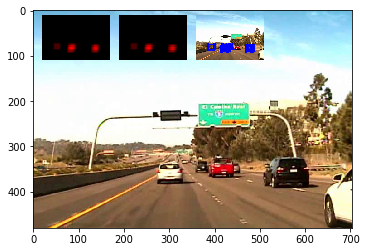

                                                            
t:   2%|▏         | 5/300 [06:59<13:02,  2.65s/it, now=None] 
                                                            ]
t:  24%|██▎       | 71/300 [04:56<07:52,  2.06s/it, now=None]

t:   0%|          | 0/300 [00:00<?, ?it/s, now=None]

Moviepy - Building video output_videos/april21.mp4.
Moviepy - Writing video output_videos/april21.mp4





t:   1%|          | 2/300 [00:02<07:21,  1.48s/it, now=None]

Found 84 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (155, 338)
new centroid= (155, 338)
old bbox= [[114 300]
 [196 377]]
new bbox= [[114 300]
 [196 376]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[252 300]
 [378 405]]
new bbox= [[252 300]
 [378 404]]
**Found a match**
old centroid= (553, 359)
new centroid= (553, 359)
old bbox= [[504 314]
 [603 405]]
new bbox= [[504 314]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 3




t:   1%|          | 3/300 [00:05<09:15,  1.87s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (155, 338)
new centroid= (156, 334)
old bbox= [[114 300]
 [196 376]]
new bbox= [[115 296]
 [197 372]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[252 300]
 [378 404]]
new bbox= [[252 300]
 [378 404]]
**Found a match**
old centroid= (553, 359)
new centroid= (546, 359)
old bbox= [[504 314]
 [602 404]]
new bbox= [[484 314]
 [608 404]]
previously detected objects= 0
so far newly detected objects= 3




t:   1%|▏         | 4/300 [00:08<10:35,  2.15s/it, now=None]

Found 85 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (156, 334)
new centroid= (152, 332)
old bbox= [[115 296]
 [197 372]]
new bbox= [[111 294]
 [193 370]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[252 300]
 [378 404]]
new bbox= [[252 300]
 [378 404]]
**Found a match**
old centroid= (546, 359)
new centroid= (543, 355)
old bbox= [[484 314]
 [608 404]]
new bbox= [[481 303]
 [605 407]]
previously detected objects= 0
so far newly detected objects= 3




t:   2%|▏         | 5/300 [00:11<11:31,  2.34s/it, now=None]

Found 82 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (152, 332)
new centroid= (150, 331)
old bbox= [[111 294]
 [193 370]]
new bbox= [[109 293]
 [191 369]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[252 300]
 [378 404]]
new bbox= [[252 300]
 [378 404]]
**Found a match**
old centroid= (543, 355)
new centroid= (541, 357)
old bbox= [[481 303]
 [605 407]]
new bbox= [[478 305]
 [604 409]]
previously detected objects= 0
so far newly detected objects= 3
Found 95 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (150, 331)
new centroid= (147, 331)
old bbox= [[109 293]
 [191 369]]
new bbox= [[106 293]
 [188 369]]
**Found a match**
old centroid= (315, 352)
new centroid= (320, 352)
old bbox= [[252 300]
 [378 404]]
new bbox= [[246 300]
 [394 404]]
**Found a match**
old centroid= (541, 357)
new centroid= (540, 358)
old bbox= [[478 305]
 [604 409]]
new bbox= [[477 306]
 [603 410]]
previously detected obje

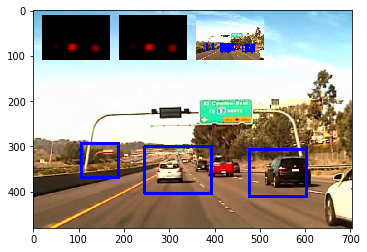



t:   2%|▏         | 6/300 [00:14<12:50,  2.62s/it, now=None]

t:   2%|▏         | 7/300 [00:17<13:25,  2.75s/it, now=None]

Found 95 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (147, 338)
Appending new object with centroid: (315, 345)
Appending new object with centroid: (539, 352)
previously detected objects= 3
so far newly detected objects= 3




t:   3%|▎         | 8/300 [00:20<14:03,  2.89s/it, now=None]

Found 114 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (147, 338)
new centroid= (145, 338)
old bbox= [[105 300]
 [189 377]]
new bbox= [[ 99 300]
 [191 376]]
**Found a match**
old centroid= (315, 345)
new centroid= (320, 348)
old bbox= [[252 300]
 [378 391]]
new bbox= [[246 296]
 [394 400]]
**Found a match**
old centroid= (539, 352)
new centroid= (529, 352)
old bbox= [[476 300]
 [603 405]]
new bbox= [[446 300]
 [612 404]]
previously detected objects= 3
so far newly detected objects= 3




t:   3%|▎         | 9/300 [00:23<14:11,  2.93s/it, now=None]

Found 93 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (145, 338)
new centroid= (141, 334)
old bbox= [[ 99 300]
 [191 376]]
new bbox= [[ 95 296]
 [187 372]]
**Found a match**
old centroid= (320, 348)
new centroid= (317, 346)
old bbox= [[246 296]
 [394 400]]
new bbox= [[243 294]
 [391 398]]
**Found a match**
old centroid= (529, 352)
new centroid= (534, 355)
old bbox= [[446 300]
 [612 404]]
new bbox= [[451 303]
 [617 407]]
previously detected objects= 3
so far newly detected objects= 3




t:   3%|▎         | 10/300 [00:26<14:24,  2.98s/it, now=None]

Found 82 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (141, 334)
new centroid= (144, 332)
old bbox= [[ 95 296]
 [187 372]]
new bbox= [[ 98 294]
 [190 370]]
**Found a match**
old centroid= (317, 346)
new centroid= (321, 349)
old bbox= [[243 294]
 [391 398]]
new bbox= [[247 297]
 [395 401]]
**Found a match**
old centroid= (534, 355)
new centroid= (543, 357)
old bbox= [[451 303]
 [617 407]]
new bbox= [[460 305]
 [626 409]]
previously detected objects= 3
so far newly detected objects= 3
Found 99 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (144, 332)
new centroid= (136, 338)
old bbox= [[ 98 294]
 [190 370]]
new bbox= [[ 90 293]
 [182 383]]
**Found a match**
old centroid= (321, 349)
new centroid= (323, 350)
old bbox= [[247 297]
 [395 401]]
new bbox= [[249 298]
 [397 402]]
**Found a match**
old centroid= (543, 357)
new centroid= (543, 358)
old bbox= [[460 305]
 [626 409]]
new bbox= [[460 306]
 [626 410]]
previously detected obje

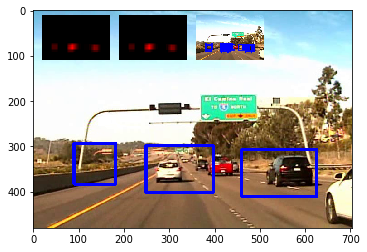



t:   4%|▎         | 11/300 [00:30<14:33,  3.02s/it, now=None]

t:   4%|▍         | 12/300 [00:32<14:14,  2.97s/it, now=None]

Found 78 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (319, 352)
Appending new object with centroid: (554, 359)
previously detected objects= 3
so far newly detected objects= 2




t:   4%|▍         | 13/300 [00:35<14:03,  2.94s/it, now=None]

Found 82 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (319, 352)
new centroid= (317, 352)
old bbox= [[254 300]
 [385 405]]
new bbox= [[252 300]
 [382 404]]
**Found a match**
old centroid= (554, 359)
new centroid= (553, 359)
old bbox= [[506 314]
 [603 405]]
new bbox= [[504 314]
 [602 404]]
previously detected objects= 3
so far newly detected objects= 2




t:   5%|▍         | 14/300 [00:38<13:58,  2.93s/it, now=None]

Found 96 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (140, 345)
**Found a match**
old centroid= (317, 352)
new centroid= (320, 352)
old bbox= [[252 300]
 [382 404]]
new bbox= [[251 300]
 [389 404]]
**Found a match**
old centroid= (553, 359)
new centroid= (553, 359)
old bbox= [[504 314]
 [602 404]]
new bbox= [[504 314]
 [602 404]]
previously detected objects= 3
so far newly detected objects= 3




t:   5%|▌         | 15/300 [00:41<13:59,  2.95s/it, now=None]

Found 78 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (140, 345)
new centroid= (149, 338)
old bbox= [[ 91 300]
 [189 391]]
new bbox= [[100 293]
 [198 383]]
**Found a match**
old centroid= (320, 352)
new centroid= (318, 348)
old bbox= [[251 300]
 [389 404]]
new bbox= [[249 296]
 [387 400]]
Appending new object with centroid: (467, 345)
**Found a match**
old centroid= (553, 359)
new centroid= (553, 359)
old bbox= [[504 314]
 [602 404]]
new bbox= [[504 314]
 [602 404]]
previously detected objects= 3
so far newly detected objects= 4
Found 69 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (318, 348)
new centroid= (317, 346)
old bbox= [[249 296]
 [387 400]]
new bbox= [[248 294]
 [386 398]]
**Found a match**
old centroid= (553, 359)
new centroid= (555, 359)
old bbox= [[504 314]
 [602 404]]
new bbox= [[506 314]
 [604 404]]
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one wit

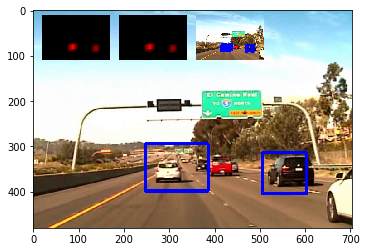



t:   5%|▌         | 16/300 [00:44<14:12,  3.00s/it, now=None]

t:   6%|▌         | 17/300 [00:47<14:05,  2.99s/it, now=None]

Found 90 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (133, 338)
Appending new object with centroid: (315, 352)
Appending new object with centroid: (546, 359)
previously detected objects= 2
so far newly detected objects= 3




t:   6%|▌         | 18/300 [00:50<14:02,  2.99s/it, now=None]

Found 68 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 348)
old bbox= [[252 300]
 [379 405]]
new bbox= [[252 296]
 [378 400]]
**Found a match**
old centroid= (546, 359)
new centroid= (551, 359)
old bbox= [[490 314]
 [603 405]]
new bbox= [[495 314]
 [607 404]]
previously detected objects= 2
so far newly detected objects= 3




t:   6%|▋         | 19/300 [00:53<13:44,  2.93s/it, now=None]

Found 66 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (315, 348)
new centroid= (315, 346)
old bbox= [[252 296]
 [378 400]]
new bbox= [[252 294]
 [378 398]]
**Found a match**
old centroid= (551, 359)
new centroid= (554, 359)
old bbox= [[495 314]
 [607 404]]
new bbox= [[498 314]
 [610 404]]
previously detected objects= 2
so far newly detected objects= 3




t:   7%|▋         | 20/300 [00:56<13:37,  2.92s/it, now=None]

Found 86 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (133, 338)
new centroid= (128, 338)
old bbox= [[ 78 300]
 [189 377]]
new bbox= [[ 69 300]
 [187 376]]
**Found a match**
old centroid= (315, 346)
new centroid= (313, 349)
old bbox= [[252 294]
 [378 398]]
new bbox= [[247 297]
 [379 401]]
**Found a match**
old centroid= (554, 359)
new centroid= (555, 359)
old bbox= [[498 314]
 [610 404]]
new bbox= [[499 314]
 [611 404]]
previously detected objects= 2
so far newly detected objects= 3
Found 75 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (313, 349)
new centroid= (314, 350)
old bbox= [[247 297]
 [379 401]]
new bbox= [[248 298]
 [380 402]]
**Found a match**
old centroid= (555, 359)
new centroid= (556, 359)
old bbox= [[499 314]
 [611 404]]
new bbox= [[500 314]
 [612 404]]
previously detected objects= 2
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with 

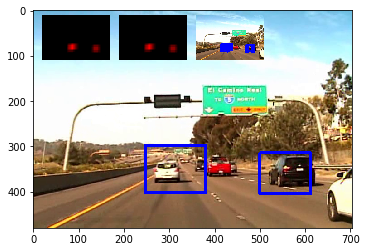



t:   7%|▋         | 21/300 [01:00<14:29,  3.12s/it, now=None]

t:   7%|▋         | 22/300 [01:03<15:28,  3.34s/it, now=None]

Found 71 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (316, 345)
Appending new object with centroid: (557, 359)
previously detected objects= 2
so far newly detected objects= 2




t:   8%|▊         | 23/300 [01:07<15:45,  3.41s/it, now=None]

Found 81 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (316, 345)
new centroid= (314, 348)
old bbox= [[254 300]
 [378 391]]
new bbox= [[248 296]
 [380 400]]
**Found a match**
old centroid= (557, 359)
new centroid= (557, 359)
old bbox= [[511 314]
 [603 405]]
new bbox= [[511 314]
 [603 404]]
previously detected objects= 2
so far newly detected objects= 2




t:   8%|▊         | 24/300 [01:10<15:09,  3.29s/it, now=None]

Found 74 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (314, 348)
new centroid= (311, 346)
old bbox= [[248 296]
 [380 400]]
new bbox= [[245 294]
 [377 398]]
**Found a match**
old centroid= (557, 359)
new centroid= (557, 359)
old bbox= [[511 314]
 [603 404]]
new bbox= [[511 314]
 [603 404]]
previously detected objects= 2
so far newly detected objects= 2




t:   8%|▊         | 25/300 [01:13<14:37,  3.19s/it, now=None]

Found 74 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (311, 346)
new centroid= (310, 345)
old bbox= [[245 294]
 [377 398]]
new bbox= [[244 293]
 [376 397]]
**Found a match**
old centroid= (557, 359)
new centroid= (557, 359)
old bbox= [[511 314]
 [603 404]]
new bbox= [[511 314]
 [603 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 98 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (148, 331)
**Found a match**
old centroid= (310, 345)
new centroid= (310, 348)
old bbox= [[244 293]
 [376 397]]
new bbox= [[244 296]
 [376 400]]
**Found a match**
old centroid= (557, 359)
new centroid= (548, 359)
old bbox= [[511 314]
 [603 404]]
new bbox= [[485 314]
 [611 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (310, 348) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (548, 359) **
numb

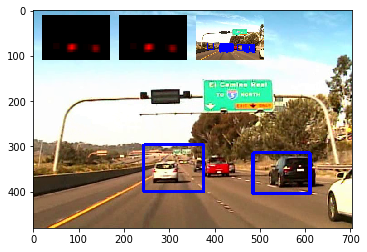



t:   9%|▊         | 26/300 [01:16<14:33,  3.19s/it, now=None]

t:   9%|▉         | 27/300 [01:19<14:33,  3.20s/it, now=None]

Found 81 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (309, 352)
Appending new object with centroid: (554, 359)
previously detected objects= 2
so far newly detected objects= 2




t:   9%|▉         | 28/300 [01:23<14:35,  3.22s/it, now=None]

Found 84 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (309, 352)
new centroid= (319, 352)
old bbox= [[245 300]
 [373 405]]
new bbox= [[235 300]
 [403 404]]
Appending new object with centroid: (459, 345)
**Found a match**
old centroid= (554, 359)
new centroid= (557, 359)
old bbox= [[506 314]
 [603 405]]
new bbox= [[509 314]
 [605 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  10%|▉         | 29/300 [01:26<14:04,  3.12s/it, now=None]

Found 128 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (145, 331)
**Found a match**
old centroid= (319, 352)
new centroid= (341, 352)
old bbox= [[235 300]
 [403 404]]
new bbox= [[215 300]
 [467 404]]
**Found a match**
old centroid= (557, 359)
new centroid= (557, 359)
old bbox= [[509 314]
 [605 404]]
new bbox= [[509 314]
 [605 404]]
previously detected objects= 2
so far newly detected objects= 4




t:  10%|█         | 30/300 [01:28<13:35,  3.02s/it, now=None]

Found 81 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (341, 352)
new centroid= (334, 352)
old bbox= [[215 300]
 [467 404]]
new bbox= [[208 300]
 [460 404]]
**Found a match**
old centroid= (557, 359)
new centroid= (559, 359)
old bbox= [[509 314]
 [605 404]]
new bbox= [[511 314]
 [607 404]]
previously detected objects= 2
so far newly detected objects= 4
Found 117 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (334, 352)
new centroid= (347, 348)
old bbox= [[208 300]
 [460 404]]
new bbox= [[221 296]
 [473 400]]
**Found a match**
old centroid= (559, 359)
new centroid= (559, 359)
old bbox= [[511 314]
 [607 404]]
new bbox= [[511 314]
 [607 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (347, 348) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (559, 359) **
number of times detected object appeared:  0
numbe

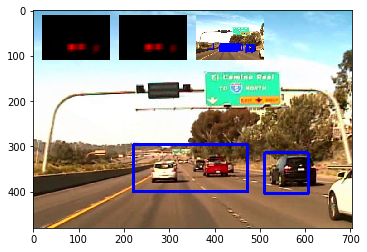



t:  10%|█         | 31/300 [01:31<13:30,  3.01s/it, now=None]

t:  11%|█         | 32/300 [01:34<13:11,  2.95s/it, now=None]

Found 136 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (143, 331)
Appending new object with centroid: (337, 352)
Appending new object with centroid: (543, 359)
previously detected objects= 2
so far newly detected objects= 3




t:  11%|█         | 33/300 [01:37<12:59,  2.92s/it, now=None]

Found 134 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (337, 352)
new centroid= (351, 348)
old bbox= [[231 300]
 [443 405]]
new bbox= [[226 296]
 [476 400]]
**Found a match**
old centroid= (543, 359)
new centroid= (551, 359)
old bbox= [[484 314]
 [603 405]]
new bbox= [[492 314]
 [610 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  11%|█▏        | 34/300 [01:40<12:49,  2.89s/it, now=None]

Found 78 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (143, 331)
new centroid= (143, 331)
old bbox= [[112 300]
 [175 363]]
new bbox= [[112 300]
 [174 362]]
**Found a match**
old centroid= (351, 348)
new centroid= (327, 346)
old bbox= [[226 296]
 [476 400]]
new bbox= [[202 294]
 [452 398]]
**Found a match**
old centroid= (551, 359)
new centroid= (555, 359)
old bbox= [[492 314]
 [610 404]]
new bbox= [[496 314]
 [614 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  12%|█▏        | 35/300 [01:43<12:42,  2.88s/it, now=None]

Found 115 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (143, 331)
new centroid= (142, 331)
old bbox= [[112 300]
 [174 362]]
new bbox= [[107 300]
 [177 362]]
**Found a match**
old centroid= (327, 346)
new centroid= (322, 345)
old bbox= [[202 294]
 [452 398]]
new bbox= [[197 293]
 [447 397]]
**Found a match**
old centroid= (555, 359)
new centroid= (535, 355)
old bbox= [[496 314]
 [614 404]]
new bbox= [[447 303]
 [623 407]]
previously detected objects= 2
so far newly detected objects= 3
Found 76 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (142, 331)
new centroid= (145, 331)
old bbox= [[107 300]
 [177 362]]
new bbox= [[110 300]
 [180 362]]
**Found a match**
old centroid= (322, 345)
new centroid= (318, 345)
old bbox= [[197 293]
 [447 397]]
new bbox= [[193 293]
 [443 397]]
**Found a match**
old centroid= (535, 355)
new centroid= (547, 357)
old bbox= [[447 303]
 [623 407]]
new bbox= [[459 305]
 [635 409]]
previously detected obj

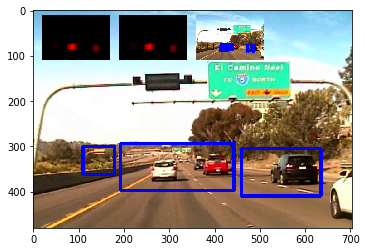



t:  12%|█▏        | 36/300 [01:46<12:49,  2.92s/it, now=None]

t:  12%|█▏        | 37/300 [01:48<12:34,  2.87s/it, now=None]

Found 77 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (143, 331)
Appending new object with centroid: (315, 345)
Appending new object with centroid: (459, 345)
Appending new object with centroid: (561, 359)
previously detected objects= 3
so far newly detected objects= 4




t:  13%|█▎        | 38/300 [01:51<12:26,  2.85s/it, now=None]

Found 97 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (315, 345)
new centroid= (313, 348)
old bbox= [[245 300]
 [385 391]]
new bbox= [[239 296]
 [387 400]]
**Found a match**
old centroid= (561, 359)
new centroid= (557, 355)
old bbox= [[520 314]
 [603 405]]
new bbox= [[509 303]
 [605 407]]
**Found a match**
old centroid= (459, 345)
new centroid= (459, 345)
old bbox= [[428 314]
 [490 377]]
new bbox= [[428 314]
 [490 376]]
previously detected objects= 3
so far newly detected objects= 4




t:  13%|█▎        | 39/300 [01:54<12:19,  2.83s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (313, 348)
new centroid= (312, 346)
old bbox= [[239 296]
 [387 400]]
new bbox= [[238 294]
 [386 398]]
**Found a match**
old centroid= (459, 345)
new centroid= (459, 345)
old bbox= [[428 314]
 [490 376]]
new bbox= [[428 314]
 [490 376]]
**Found a match**
old centroid= (557, 355)
new centroid= (558, 357)
old bbox= [[509 303]
 [605 407]]
new bbox= [[510 305]
 [606 409]]
previously detected objects= 3
so far newly detected objects= 4




t:  13%|█▎        | 40/300 [01:57<12:12,  2.82s/it, now=None]

Found 68 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (312, 346)
new centroid= (311, 349)
old bbox= [[238 294]
 [386 398]]
new bbox= [[237 297]
 [385 401]]
**Found a match**
old centroid= (459, 345)
new centroid= (458, 345)
old bbox= [[428 314]
 [490 376]]
new bbox= [[427 314]
 [489 376]]
**Found a match**
old centroid= (558, 357)
new centroid= (561, 354)
old bbox= [[510 305]
 [606 409]]
new bbox= [[513 302]
 [609 406]]
previously detected objects= 3
so far newly detected objects= 4
Found 88 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (143, 331)
new centroid= (143, 331)
old bbox= [[112 300]
 [175 363]]
new bbox= [[112 300]
 [174 362]]
**Found a match**
old centroid= (311, 349)
new centroid= (314, 350)
old bbox= [[237 297]
 [385 401]]
new bbox= [[240 298]
 [388 402]]
**Found a match**
old centroid= (458, 345)
new centroid= (460, 345)
old bbox= [[427 314]
 [489 376]]
new bbox= [[426 314]
 [494 376]]
**Found a match**
old ce

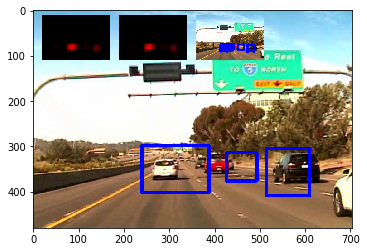



t:  14%|█▎        | 41/300 [02:00<12:22,  2.87s/it, now=None]

t:  14%|█▍        | 42/300 [02:03<12:15,  2.85s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (315, 352)
Appending new object with centroid: (459, 338)
Appending new object with centroid: (561, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  14%|█▍        | 43/300 [02:05<12:06,  2.83s/it, now=None]

Found 64 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 348)
old bbox= [[245 300]
 [385 405]]
new bbox= [[245 296]
 [385 400]]
**Found a match**
old centroid= (459, 338)
new centroid= (459, 338)
old bbox= [[428 314]
 [491 363]]
new bbox= [[428 314]
 [490 362]]
**Found a match**
old centroid= (561, 359)
new centroid= (562, 355)
old bbox= [[520 314]
 [603 405]]
new bbox= [[521 310]
 [603 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  15%|█▍        | 44/300 [02:08<12:03,  2.83s/it, now=None]

Found 88 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (315, 348)
new centroid= (315, 350)
old bbox= [[245 296]
 [385 400]]
new bbox= [[244 298]
 [386 402]]
**Found a match**
old centroid= (459, 338)
new centroid= (459, 341)
old bbox= [[428 314]
 [490 362]]
new bbox= [[428 310]
 [490 372]]
**Found a match**
old centroid= (562, 355)
new centroid= (559, 357)
old bbox= [[521 310]
 [603 400]]
new bbox= [[514 312]
 [604 402]]
previously detected objects= 3
so far newly detected objects= 3




t:  15%|█▌        | 45/300 [02:11<11:58,  2.82s/it, now=None]

Found 73 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (144, 331)
**Found a match**
old centroid= (315, 350)
new centroid= (313, 351)
old bbox= [[244 298]
 [386 402]]
new bbox= [[242 299]
 [384 403]]
**Found a match**
old centroid= (459, 341)
new centroid= (459, 339)
old bbox= [[428 310]
 [490 372]]
new bbox= [[428 308]
 [490 370]]
**Found a match**
old centroid= (559, 357)
new centroid= (561, 358)
old bbox= [[514 312]
 [604 402]]
new bbox= [[516 313]
 [606 403]]
previously detected objects= 3
so far newly detected objects= 4
Found 69 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (313, 351)
new centroid= (312, 348)
old bbox= [[242 299]
 [384 403]]
new bbox= [[241 296]
 [383 400]]
**Found a match**
old centroid= (459, 339)
new centroid= (459, 338)
old bbox= [[428 308]
 [490 370]]
new bbox= [[428 307]
 [490 369]]
**Found a match**
old centroid= (561, 358)
new centroid= (562, 355)
old bbox= [[516 313]
 [606 403]]
new bbox= 

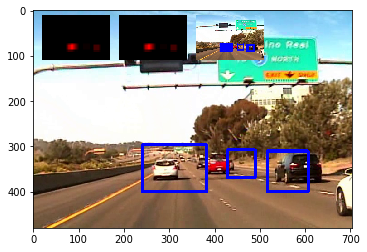



t:  15%|█▌        | 46/300 [02:14<12:10,  2.87s/it, now=None]

t:  16%|█▌        | 47/300 [02:17<12:01,  2.85s/it, now=None]

Found 73 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (140, 331)
Appending new object with centroid: (311, 345)
Appending new object with centroid: (459, 338)
Appending new object with centroid: (554, 352)
previously detected objects= 3
so far newly detected objects= 4




t:  16%|█▌        | 48/300 [02:20<11:55,  2.84s/it, now=None]

Found 63 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (140, 331)
new centroid= (140, 331)
old bbox= [[106 300]
 [175 363]]
new bbox= [[106 300]
 [174 362]]
**Found a match**
old centroid= (311, 345)
new centroid= (311, 345)
old bbox= [[245 300]
 [378 391]]
new bbox= [[244 300]
 [378 390]]
**Found a match**
old centroid= (554, 352)
new centroid= (560, 352)
old bbox= [[506 314]
 [603 391]]
new bbox= [[512 314]
 [608 390]]
previously detected objects= 3
so far newly detected objects= 4




t:  16%|█▋        | 49/300 [02:22<11:51,  2.83s/it, now=None]

Found 66 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (140, 331)
new centroid= (140, 331)
old bbox= [[106 300]
 [174 362]]
new bbox= [[105 300]
 [175 362]]
**Found a match**
old centroid= (311, 345)
new centroid= (311, 345)
old bbox= [[244 300]
 [378 390]]
new bbox= [[244 300]
 [378 390]]
**Found a match**
old centroid= (560, 352)
new centroid= (564, 352)
old bbox= [[512 314]
 [608 390]]
new bbox= [[516 314]
 [612 390]]
previously detected objects= 3
so far newly detected objects= 4




t:  17%|█▋        | 50/300 [02:25<11:43,  2.82s/it, now=None]

Found 76 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (140, 331)
new centroid= (138, 331)
old bbox= [[105 300]
 [175 362]]
new bbox= [[101 300]
 [175 362]]
**Found a match**
old centroid= (311, 345)
new centroid= (313, 345)
old bbox= [[244 300]
 [378 390]]
new bbox= [[243 300]
 [383 390]]
**Found a match**
old centroid= (564, 352)
new centroid= (559, 352)
old bbox= [[516 314]
 [612 390]]
new bbox= [[511 314]
 [607 390]]
previously detected objects= 3
so far newly detected objects= 4
Found 72 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (138, 331)
new centroid= (139, 331)
old bbox= [[101 300]
 [175 362]]
new bbox= [[102 300]
 [176 362]]
**Found a match**
old centroid= (313, 345)
new centroid= (314, 345)
old bbox= [[243 300]
 [383 390]]
new bbox= [[244 300]
 [384 390]]
**Found a match**
old centroid= (459, 338)
new centroid= (459, 338)
old bbox= [[428 314]
 [491 363]]
new bbox= [[428 314]
 [490 362]]
**Found a match**
old ce

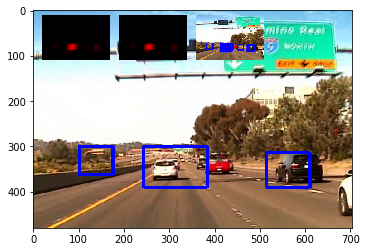



t:  17%|█▋        | 51/300 [02:28<11:53,  2.87s/it, now=None]

t:  17%|█▋        | 52/300 [02:31<11:46,  2.85s/it, now=None]

Found 70 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (137, 331)
Appending new object with centroid: (315, 345)
Appending new object with centroid: (459, 338)
Appending new object with centroid: (564, 352)
previously detected objects= 3
so far newly detected objects= 4




t:  18%|█▊        | 53/300 [02:34<11:39,  2.83s/it, now=None]

Found 75 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (137, 331)
new centroid= (135, 331)
old bbox= [[106 300]
 [168 363]]
new bbox= [[101 300]
 [169 362]]
**Found a match**
old centroid= (315, 345)
new centroid= (315, 345)
old bbox= [[245 300]
 [385 391]]
new bbox= [[245 300]
 [385 390]]
**Found a match**
old centroid= (459, 338)
new centroid= (459, 338)
old bbox= [[428 314]
 [491 363]]
new bbox= [[428 314]
 [490 362]]
**Found a match**
old centroid= (564, 352)
new centroid= (565, 352)
old bbox= [[526 314]
 [603 391]]
new bbox= [[527 314]
 [603 390]]
previously detected objects= 3
so far newly detected objects= 4




t:  18%|█▊        | 54/300 [02:37<11:37,  2.84s/it, now=None]

Found 73 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (135, 331)
new centroid= (136, 331)
old bbox= [[101 300]
 [169 362]]
new bbox= [[102 300]
 [170 362]]
**Found a match**
old centroid= (315, 345)
new centroid= (315, 345)
old bbox= [[245 300]
 [385 390]]
new bbox= [[245 300]
 [385 390]]
**Found a match**
old centroid= (565, 352)
new centroid= (564, 352)
old bbox= [[527 314]
 [603 390]]
new bbox= [[525 314]
 [603 390]]
previously detected objects= 3
so far newly detected objects= 4




t:  18%|█▊        | 55/300 [02:39<11:35,  2.84s/it, now=None]

Found 77 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (136, 331)
new centroid= (135, 331)
old bbox= [[102 300]
 [170 362]]
new bbox= [[101 300]
 [169 362]]
**Found a match**
old centroid= (315, 345)
new centroid= (315, 345)
old bbox= [[245 300]
 [385 390]]
new bbox= [[245 300]
 [385 390]]
**Found a match**
old centroid= (564, 352)
new centroid= (557, 352)
old bbox= [[525 314]
 [603 390]]
new bbox= [[505 314]
 [609 390]]
previously detected objects= 3
so far newly detected objects= 4
Found 100 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (135, 331)
new centroid= (134, 331)
old bbox= [[101 300]
 [169 362]]
new bbox= [[ 93 300]
 [175 362]]
**Found a match**
old centroid= (315, 345)
new centroid= (313, 348)
old bbox= [[245 300]
 [385 390]]
new bbox= [[241 296]
 [385 400]]
**Found a match**
old centroid= (459, 338)
new centroid= (459, 338)
old bbox= [[428 314]
 [490 362]]
new bbox= [[427 300]
 [491 376]]
**Found a match**
old c

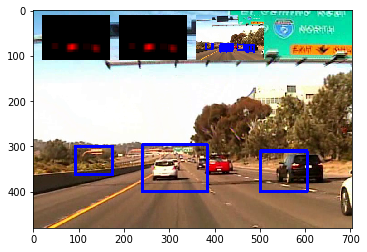



t:  19%|█▊        | 56/300 [02:43<11:48,  2.90s/it, now=None]

t:  19%|█▉        | 57/300 [02:45<11:37,  2.87s/it, now=None]

Found 84 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (134, 331)
Appending new object with centroid: (315, 352)
Appending new object with centroid: (459, 338)
Appending new object with centroid: (564, 359)
previously detected objects= 3
so far newly detected objects= 4




t:  19%|█▉        | 58/300 [02:48<11:27,  2.84s/it, now=None]

Found 83 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (134, 331)
new centroid= (132, 331)
old bbox= [[100 300]
 [169 363]]
new bbox= [[ 94 300]
 [170 362]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[245 300]
 [385 405]]
new bbox= [[244 300]
 [386 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (558, 355)
old bbox= [[526 314]
 [603 405]]
new bbox= [[509 310]
 [607 400]]
previously detected objects= 3
so far newly detected objects= 4




t:  20%|█▉        | 59/300 [02:51<11:22,  2.83s/it, now=None]

Found 86 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (132, 331)
new centroid= (132, 331)
old bbox= [[ 94 300]
 [170 362]]
new bbox= [[ 91 300]
 [173 362]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[244 300]
 [386 404]]
new bbox= [[244 300]
 [386 404]]
**Found a match**
old centroid= (558, 355)
new centroid= (556, 353)
old bbox= [[509 310]
 [607 400]]
new bbox= [[507 308]
 [605 398]]
previously detected objects= 3
so far newly detected objects= 4




t:  20%|██        | 60/300 [02:54<11:18,  2.83s/it, now=None]

Found 76 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (132, 331)
new centroid= (133, 331)
old bbox= [[ 91 300]
 [173 362]]
new bbox= [[ 92 300]
 [174 362]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[244 300]
 [386 404]]
new bbox= [[244 300]
 [386 404]]
**Found a match**
old centroid= (556, 353)
new centroid= (556, 352)
old bbox= [[507 308]
 [605 398]]
new bbox= [[507 307]
 [605 397]]
previously detected objects= 3
so far newly detected objects= 4
Found 86 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (133, 331)
new centroid= (131, 331)
old bbox= [[ 92 300]
 [174 362]]
new bbox= [[ 90 300]
 [172 362]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[244 300]
 [386 404]]
new bbox= [[244 300]
 [386 404]]
**Found a match**
old centroid= (459, 338)
new centroid= (459, 345)
old bbox= [[427 300]
 [491 377]]
new bbox= [[427 307]
 [491 383]]
**Found a match**
old ce

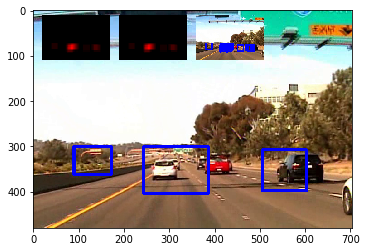



t:  20%|██        | 61/300 [02:57<11:47,  2.96s/it, now=None]

t:  21%|██        | 62/300 [03:00<11:36,  2.93s/it, now=None]

Found 78 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (133, 331)
Appending new object with centroid: (315, 352)
Appending new object with centroid: (564, 352)
Appending new object with centroid: (459, 352)
previously detected objects= 3
so far newly detected objects= 4




t:  21%|██        | 63/300 [03:03<11:26,  2.90s/it, now=None]

Found 100 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (133, 331)
new centroid= (131, 331)
old bbox= [[ 98 300]
 [168 363]]
new bbox= [[ 93 300]
 [169 362]]
**Found a match**
old centroid= (315, 352)
new centroid= (313, 352)
old bbox= [[245 300]
 [385 405]]
new bbox= [[240 300]
 [386 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (557, 348)
old bbox= [[525 314]
 [603 391]]
new bbox= [[505 303]
 [609 393]]
**Found a match**
old centroid= (459, 352)
new centroid= (459, 345)
old bbox= [[428 328]
 [491 377]]
new bbox= [[428 321]
 [490 369]]
previously detected objects= 3
so far newly detected objects= 4




t:  21%|██▏       | 64/300 [03:06<11:22,  2.89s/it, now=None]

Found 76 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (131, 331)
new centroid= (130, 331)
old bbox= [[ 93 300]
 [169 362]]
new bbox= [[ 92 300]
 [168 362]]
**Found a match**
old centroid= (313, 352)
new centroid= (314, 352)
old bbox= [[240 300]
 [386 404]]
new bbox= [[241 300]
 [387 404]]
**Found a match**
old centroid= (557, 348)
new centroid= (558, 350)
old bbox= [[505 303]
 [609 393]]
new bbox= [[506 305]
 [610 395]]
previously detected objects= 3
so far newly detected objects= 4




t:  22%|██▏       | 65/300 [03:09<11:28,  2.93s/it, now=None]

Found 60 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (130, 331)
new centroid= (130, 331)
old bbox= [[ 92 300]
 [168 362]]
new bbox= [[ 92 300]
 [168 362]]
**Found a match**
old centroid= (314, 352)
new centroid= (313, 352)
old bbox= [[241 300]
 [387 404]]
new bbox= [[240 300]
 [386 404]]
**Found a match**
old centroid= (558, 350)
new centroid= (564, 351)
old bbox= [[506 305]
 [610 395]]
new bbox= [[512 306]
 [616 396]]
previously detected objects= 3
so far newly detected objects= 4
Found 81 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (130, 331)
new centroid= (128, 331)
old bbox= [[ 92 300]
 [168 362]]
new bbox= [[ 90 300]
 [166 362]]
**Found a match**
old centroid= (313, 352)
new centroid= (312, 352)
old bbox= [[240 300]
 [386 404]]
new bbox= [[238 300]
 [386 404]]
**Found a match**
old centroid= (564, 351)
new centroid= (565, 351)
old bbox= [[512 306]
 [616 396]]
new bbox= [[513 306]
 [617 396]]
previously detected obje

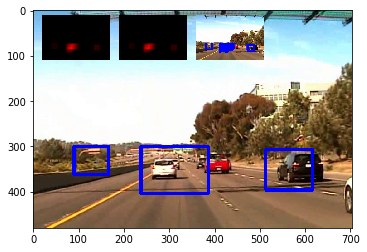



t:  22%|██▏       | 66/300 [03:12<11:38,  2.99s/it, now=None]

t:  22%|██▏       | 67/300 [03:15<11:25,  2.94s/it, now=None]

Found 62 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (127, 331)
Appending new object with centroid: (302, 352)
Appending new object with centroid: (567, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  23%|██▎       | 68/300 [03:17<11:18,  2.92s/it, now=None]

Found 81 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (127, 331)
new centroid= (125, 331)
old bbox= [[ 91 300]
 [163 363]]
new bbox= [[ 89 300]
 [161 362]]
**Found a match**
old centroid= (302, 352)
new centroid= (305, 352)
old bbox= [[240 300]
 [365 405]]
new bbox= [[235 300]
 [375 404]]
Appending new object with centroid: (459, 331)
**Found a match**
old centroid= (567, 352)
new centroid= (565, 355)
old bbox= [[532 314]
 [603 391]]
new bbox= [[526 310]
 [604 400]]
previously detected objects= 3
so far newly detected objects= 4




t:  23%|██▎       | 69/300 [03:20<11:10,  2.90s/it, now=None]

Found 80 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (125, 331)
new centroid= (125, 331)
old bbox= [[ 89 300]
 [161 362]]
new bbox= [[ 89 300]
 [161 362]]
**Found a match**
old centroid= (305, 352)
new centroid= (306, 352)
old bbox= [[235 300]
 [375 404]]
new bbox= [[236 300]
 [376 404]]
**Found a match**
old centroid= (565, 355)
new centroid= (561, 350)
old bbox= [[526 310]
 [604 400]]
new bbox= [[515 305]
 [607 395]]
previously detected objects= 3
so far newly detected objects= 4




t:  23%|██▎       | 70/300 [03:23<11:04,  2.89s/it, now=None]

Found 65 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (125, 331)
new centroid= (125, 331)
old bbox= [[ 89 300]
 [161 362]]
new bbox= [[ 89 300]
 [161 362]]
**Found a match**
old centroid= (306, 352)
new centroid= (307, 352)
old bbox= [[236 300]
 [376 404]]
new bbox= [[237 300]
 [377 404]]
**Found a match**
old centroid= (561, 350)
new centroid= (562, 347)
old bbox= [[515 305]
 [607 395]]
new bbox= [[516 302]
 [608 392]]
previously detected objects= 3
so far newly detected objects= 4
Found 51 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (307, 352)
new centroid= (306, 348)
old bbox= [[237 300]
 [377 404]]
new bbox= [[236 296]
 [376 400]]
**Found a match**
old centroid= (562, 347)
new centroid= (564, 349)
old bbox= [[516 302]
 [608 392]]
new bbox= [[518 304]
 [610 394]]
previously detected objects= 3
number of times detected object appeared:  3
** Adding similar object to one with centroid (125, 331) **
number of times detect

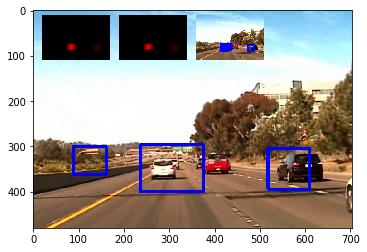



t:  24%|██▎       | 71/300 [03:26<11:13,  2.94s/it, now=None]

t:  24%|██▍       | 72/300 [03:29<11:04,  2.92s/it, now=None]

Found 82 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (126, 331)
Appending new object with centroid: (308, 352)
Appending new object with centroid: (459, 345)
Appending new object with centroid: (564, 359)
previously detected objects= 3
so far newly detected objects= 4




t:  24%|██▍       | 73/300 [03:32<10:58,  2.90s/it, now=None]

Found 60 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[238 300]
 [379 405]]
new bbox= [[238 300]
 [378 404]]
**Found a match**
old centroid= (459, 345)
new centroid= (459, 338)
old bbox= [[428 314]
 [490 377]]
new bbox= [[428 307]
 [490 369]]
**Found a match**
old centroid= (564, 359)
new centroid= (565, 359)
old bbox= [[526 314]
 [603 405]]
new bbox= [[527 314]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 4




t:  25%|██▍       | 74/300 [03:35<10:51,  2.88s/it, now=None]

Found 63 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (126, 331)
new centroid= (124, 331)
old bbox= [[ 91 300]
 [161 363]]
new bbox= [[ 89 300]
 [159 362]]
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[238 300]
 [378 404]]
new bbox= [[238 300]
 [378 404]]
**Found a match**
old centroid= (459, 338)
new centroid= (458, 338)
old bbox= [[428 307]
 [490 369]]
new bbox= [[427 307]
 [489 369]]
**Found a match**
old centroid= (565, 359)
new centroid= (557, 355)
old bbox= [[527 314]
 [603 404]]
new bbox= [[504 310]
 [610 400]]
previously detected objects= 3
so far newly detected objects= 4




t:  25%|██▌       | 75/300 [03:38<10:47,  2.88s/it, now=None]

Found 69 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (124, 331)
new centroid= (123, 334)
old bbox= [[ 89 300]
 [159 362]]
new bbox= [[ 85 296]
 [161 372]]
**Found a match**
old centroid= (308, 352)
new centroid= (310, 352)
old bbox= [[238 300]
 [378 404]]
new bbox= [[240 300]
 [380 404]]
**Found a match**
old centroid= (458, 338)
new centroid= (458, 341)
old bbox= [[427 307]
 [489 369]]
new bbox= [[427 310]
 [489 372]]
**Found a match**
old centroid= (557, 355)
new centroid= (560, 357)
old bbox= [[504 310]
 [610 400]]
new bbox= [[507 312]
 [613 402]]
previously detected objects= 3
so far newly detected objects= 4
Found 53 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (310, 352)
new centroid= (306, 348)
old bbox= [[240 300]
 [380 404]]
new bbox= [[236 296]
 [376 400]]
**Found a match**
old centroid= (560, 357)
new centroid= (565, 354)
old bbox= [[507 312]
 [613 402]]
new bbox= [[512 309]
 [618 399]]
previously detected obje

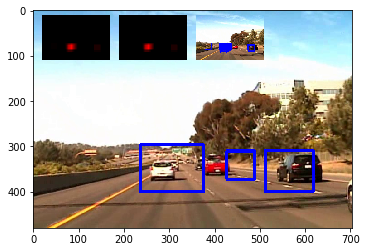



t:  25%|██▌       | 76/300 [03:41<10:56,  2.93s/it, now=None]

t:  26%|██▌       | 77/300 [03:44<10:47,  2.91s/it, now=None]

Found 70 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (119, 331)
Appending new object with centroid: (309, 352)
Appending new object with centroid: (564, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  26%|██▌       | 78/300 [03:46<10:39,  2.88s/it, now=None]

Found 68 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (119, 331)
new centroid= (120, 331)
old bbox= [[ 91 300]
 [147 363]]
new bbox= [[ 89 300]
 [151 362]]
**Found a match**
old centroid= (309, 352)
new centroid= (308, 352)
old bbox= [[240 300]
 [378 405]]
new bbox= [[238 300]
 [378 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (566, 355)
old bbox= [[526 314]
 [603 405]]
new bbox= [[528 310]
 [604 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  26%|██▋       | 79/300 [03:49<10:34,  2.87s/it, now=None]

Found 49 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (308, 352)
new centroid= (306, 348)
old bbox= [[238 300]
 [378 404]]
new bbox= [[236 296]
 [376 400]]
**Found a match**
old centroid= (566, 355)
new centroid= (566, 353)
old bbox= [[528 310]
 [604 400]]
new bbox= [[528 308]
 [604 398]]
previously detected objects= 3
so far newly detected objects= 3




t:  27%|██▋       | 80/300 [03:52<10:30,  2.87s/it, now=None]

Found 56 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (120, 331)
new centroid= (121, 331)
old bbox= [[ 89 300]
 [151 362]]
new bbox= [[ 90 300]
 [152 362]]
**Found a match**
old centroid= (306, 348)
new centroid= (304, 346)
old bbox= [[236 296]
 [376 400]]
new bbox= [[234 294]
 [374 398]]
**Found a match**
old centroid= (566, 353)
new centroid= (566, 352)
old bbox= [[528 308]
 [604 398]]
new bbox= [[528 307]
 [604 397]]
previously detected objects= 3
so far newly detected objects= 3
Found 59 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (121, 331)
new centroid= (121, 331)
old bbox= [[ 90 300]
 [152 362]]
new bbox= [[ 90 300]
 [152 362]]
**Found a match**
old centroid= (304, 346)
new centroid= (308, 345)
old bbox= [[234 294]
 [374 398]]
new bbox= [[238 293]
 [378 397]]
**Found a match**
old centroid= (566, 352)
new centroid= (566, 352)
old bbox= [[528 307]
 [604 397]]
new bbox= [[528 307]
 [604 397]]
previously detected obje

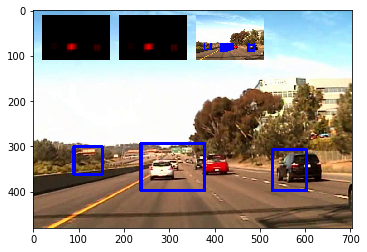



t:  27%|██▋       | 81/300 [03:55<10:41,  2.93s/it, now=None]

t:  27%|██▋       | 82/300 [03:58<10:31,  2.90s/it, now=None]

Found 62 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (112, 331)
Appending new object with centroid: (311, 345)
Appending new object with centroid: (567, 345)
previously detected objects= 3
so far newly detected objects= 3




t:  28%|██▊       | 83/300 [04:01<10:25,  2.88s/it, now=None]

Found 65 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (112, 331)
new centroid= (115, 331)
old bbox= [[ 78 300]
 [147 363]]
new bbox= [[ 81 300]
 [149 362]]
**Found a match**
old centroid= (311, 345)
new centroid= (311, 348)
old bbox= [[245 300]
 [378 391]]
new bbox= [[239 296]
 [383 400]]
**Found a match**
old centroid= (567, 345)
new centroid= (567, 348)
old bbox= [[532 300]
 [603 391]]
new bbox= [[532 303]
 [602 393]]
previously detected objects= 3
so far newly detected objects= 3




t:  28%|██▊       | 84/300 [04:04<10:22,  2.88s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (115, 331)
new centroid= (115, 331)
old bbox= [[ 81 300]
 [149 362]]
new bbox= [[ 77 300]
 [153 362]]
**Found a match**
old centroid= (311, 348)
new centroid= (311, 346)
old bbox= [[239 296]
 [383 400]]
new bbox= [[238 294]
 [384 398]]
**Found a match**
old centroid= (567, 348)
new centroid= (565, 346)
old bbox= [[532 303]
 [602 393]]
new bbox= [[527 301]
 [603 391]]
previously detected objects= 3
so far newly detected objects= 3




t:  28%|██▊       | 85/300 [04:07<10:18,  2.88s/it, now=None]

Found 66 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (115, 331)
new centroid= (112, 331)
old bbox= [[ 77 300]
 [153 362]]
new bbox= [[ 74 300]
 [150 362]]
**Found a match**
old centroid= (311, 346)
new centroid= (309, 345)
old bbox= [[238 294]
 [384 398]]
new bbox= [[236 293]
 [382 397]]
**Found a match**
old centroid= (565, 346)
new centroid= (566, 345)
old bbox= [[527 301]
 [603 391]]
new bbox= [[528 300]
 [604 390]]
previously detected objects= 3
so far newly detected objects= 3
Found 58 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (112, 331)
new centroid= (110, 331)
old bbox= [[ 74 300]
 [150 362]]
new bbox= [[ 72 300]
 [148 362]]
**Found a match**
old centroid= (309, 345)
new centroid= (305, 345)
old bbox= [[236 293]
 [382 397]]
new bbox= [[232 293]
 [378 397]]
**Found a match**
old centroid= (566, 345)
new centroid= (566, 348)
old bbox= [[528 300]
 [604 390]]
new bbox= [[528 303]
 [604 393]]
previously detected obje

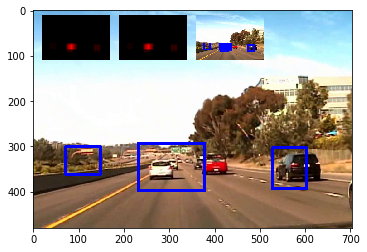



t:  29%|██▊       | 86/300 [04:10<10:29,  2.94s/it, now=None]

t:  29%|██▉       | 87/300 [04:12<10:20,  2.91s/it, now=None]

Found 71 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (109, 331)
Appending new object with centroid: (309, 345)
Appending new object with centroid: (547, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  29%|██▉       | 88/300 [04:15<10:12,  2.89s/it, now=None]

Found 61 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (109, 331)
new centroid= (109, 331)
old bbox= [[ 78 300]
 [141 363]]
new bbox= [[ 78 300]
 [140 362]]
**Found a match**
old centroid= (309, 345)
new centroid= (309, 345)
old bbox= [[240 300]
 [378 391]]
new bbox= [[240 300]
 [378 390]]
Appending new object with centroid: (452, 331)
**Found a match**
old centroid= (547, 359)
new centroid= (557, 355)
old bbox= [[492 314]
 [603 405]]
new bbox= [[502 310]
 [612 400]]
previously detected objects= 3
so far newly detected objects= 4




t:  30%|██▉       | 89/300 [04:18<10:05,  2.87s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 331)
new centroid= (109, 331)
old bbox= [[ 78 300]
 [140 362]]
new bbox= [[ 78 300]
 [140 362]]
**Found a match**
old centroid= (309, 345)
new centroid= (307, 345)
old bbox= [[240 300]
 [378 390]]
new bbox= [[234 300]
 [380 390]]
**Found a match**
old centroid= (557, 355)
new centroid= (560, 357)
old bbox= [[502 310]
 [612 400]]
new bbox= [[505 312]
 [615 402]]
previously detected objects= 3
so far newly detected objects= 4




t:  30%|███       | 90/300 [04:21<10:02,  2.87s/it, now=None]

Found 78 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (109, 331)
new centroid= (109, 334)
old bbox= [[ 78 300]
 [140 362]]
new bbox= [[ 77 296]
 [141 372]]
**Found a match**
old centroid= (307, 345)
new centroid= (306, 345)
old bbox= [[234 300]
 [380 390]]
new bbox= [[233 300]
 [379 390]]
**Found a match**
old centroid= (452, 331)
new centroid= (451, 331)
old bbox= [[422 300]
 [483 363]]
new bbox= [[420 300]
 [482 362]]
**Found a match**
old centroid= (560, 357)
new centroid= (553, 354)
old bbox= [[505 312]
 [615 402]]
new bbox= [[498 309]
 [608 399]]
previously detected objects= 3
so far newly detected objects= 4
Found 77 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (306, 345)
new centroid= (305, 348)
old bbox= [[233 300]
 [379 390]]
new bbox= [[232 296]
 [378 400]]
**Found a match**
old centroid= (451, 331)
new centroid= (451, 334)
old bbox= [[420 300]
 [482 362]]
new bbox= [[420 303]
 [482 365]]
**Found a match**
old ce

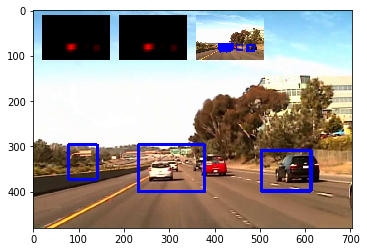



t:  30%|███       | 91/300 [04:24<10:13,  2.94s/it, now=None]

t:  31%|███       | 92/300 [04:27<10:06,  2.91s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (305, 352)
Appending new object with centroid: (452, 338)
Appending new object with centroid: (564, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  31%|███       | 93/300 [04:30<09:59,  2.90s/it, now=None]

Found 92 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (109, 331)
**Found a match**
old centroid= (305, 352)
new centroid= (303, 352)
old bbox= [[232 300]
 [378 405]]
new bbox= [[226 300]
 [380 404]]
**Found a match**
old centroid= (452, 338)
new centroid= (452, 338)
old bbox= [[420 300]
 [485 377]]
new bbox= [[420 300]
 [484 376]]
**Found a match**
old centroid= (564, 352)
new centroid= (555, 355)
old bbox= [[526 314]
 [603 391]]
new bbox= [[500 310]
 [610 400]]
previously detected objects= 3
so far newly detected objects= 4




t:  31%|███▏      | 94/300 [04:33<09:55,  2.89s/it, now=None]

Found 68 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 331)
new centroid= (108, 331)
old bbox= [[ 77 300]
 [141 363]]
new bbox= [[ 76 300]
 [140 362]]
**Found a match**
old centroid= (303, 352)
new centroid= (304, 352)
old bbox= [[226 300]
 [380 404]]
new bbox= [[227 300]
 [381 404]]
**Found a match**
old centroid= (555, 355)
new centroid= (561, 353)
old bbox= [[500 310]
 [610 400]]
new bbox= [[506 308]
 [616 398]]
previously detected objects= 3
so far newly detected objects= 4




t:  32%|███▏      | 95/300 [04:36<09:52,  2.89s/it, now=None]

Found 80 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (108, 331)
new centroid= (108, 331)
old bbox= [[ 76 300]
 [140 362]]
new bbox= [[ 76 300]
 [140 362]]
**Found a match**
old centroid= (304, 352)
new centroid= (304, 352)
old bbox= [[227 300]
 [381 404]]
new bbox= [[227 300]
 [381 404]]
**Found a match**
old centroid= (452, 338)
new centroid= (452, 341)
old bbox= [[420 300]
 [484 376]]
new bbox= [[420 303]
 [484 379]]
**Found a match**
old centroid= (561, 353)
new centroid= (562, 356)
old bbox= [[506 308]
 [616 398]]
new bbox= [[507 311]
 [617 401]]
previously detected objects= 3
so far newly detected objects= 4
Found 94 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (108, 331)
new centroid= (106, 334)
old bbox= [[ 76 300]
 [140 362]]
new bbox= [[ 71 296]
 [141 372]]
**Found a match**
old centroid= (304, 352)
new centroid= (292, 352)
old bbox= [[227 300]
 [381 404]]
new bbox= [[195 300]
 [389 404]]
**Found a match**
old ce

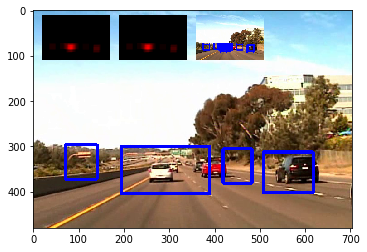



t:  32%|███▏      | 96/300 [04:39<09:58,  2.94s/it, now=None]

t:  32%|███▏      | 97/300 [04:41<09:51,  2.91s/it, now=None]

Found 89 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (108, 331)
Appending new object with centroid: (281, 352)
Appending new object with centroid: (452, 345)
Appending new object with centroid: (564, 359)
previously detected objects= 4
so far newly detected objects= 4




t:  33%|███▎      | 98/300 [04:44<09:47,  2.91s/it, now=None]

Found 77 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (108, 331)
new centroid= (106, 334)
old bbox= [[ 77 300]
 [140 363]]
new bbox= [[ 71 296]
 [141 372]]
**Found a match**
old centroid= (281, 352)
new centroid= (279, 352)
old bbox= [[190 300]
 [373 405]]
new bbox= [[188 300]
 [370 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (565, 359)
old bbox= [[525 314]
 [603 405]]
new bbox= [[526 314]
 [604 404]]
previously detected objects= 4
so far newly detected objects= 4




t:  33%|███▎      | 99/300 [04:47<09:43,  2.90s/it, now=None]

Found 102 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (106, 334)
new centroid= (105, 336)
old bbox= [[ 71 296]
 [141 372]]
new bbox= [[ 70 298]
 [140 374]]
**Found a match**
old centroid= (279, 352)
new centroid= (281, 352)
old bbox= [[188 300]
 [370 404]]
new bbox= [[187 300]
 [375 404]]
**Found a match**
old centroid= (452, 345)
new centroid= (452, 345)
old bbox= [[422 314]
 [483 377]]
new bbox= [[422 314]
 [482 376]]
**Found a match**
old centroid= (565, 359)
new centroid= (564, 359)
old bbox= [[526 314]
 [604 404]]
new bbox= [[525 314]
 [603 404]]
previously detected objects= 4
so far newly detected objects= 4




t:  33%|███▎      | 100/300 [04:50<09:38,  2.89s/it, now=None]

Found 84 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (105, 336)
new centroid= (103, 337)
old bbox= [[ 70 298]
 [140 374]]
new bbox= [[ 65 299]
 [141 375]]
**Found a match**
old centroid= (281, 352)
new centroid= (293, 352)
old bbox= [[187 300]
 [375 404]]
new bbox= [[199 300]
 [387 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (565, 359)
old bbox= [[525 314]
 [603 404]]
new bbox= [[526 314]
 [604 404]]
previously detected objects= 4
so far newly detected objects= 4
Found 91 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (103, 337)
new centroid= (102, 334)
old bbox= [[ 65 299]
 [141 375]]
new bbox= [[ 64 296]
 [140 372]]
**Found a match**
old centroid= (293, 352)
new centroid= (299, 352)
old bbox= [[199 300]
 [387 404]]
new bbox= [[205 300]
 [393 404]]
**Found a match**
old centroid= (565, 359)
new centroid= (564, 359)
old bbox= [[526 314]
 [604 404]]
new bbox= [[525 314]
 [603 404]]
previously detected obje

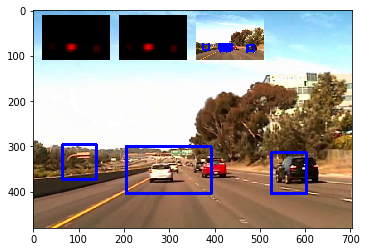



t:  34%|███▎      | 101/300 [04:53<09:46,  2.95s/it, now=None]

t:  34%|███▍      | 102/300 [04:56<09:37,  2.92s/it, now=None]

Found 100 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (101, 338)
Appending new object with centroid: (305, 352)
Appending new object with centroid: (561, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  34%|███▍      | 103/300 [04:59<09:31,  2.90s/it, now=None]

Found 97 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (101, 338)
new centroid= (99, 338)
old bbox= [[ 63 300]
 [140 377]]
new bbox= [[ 61 300]
 [137 376]]
**Found a match**
old centroid= (305, 352)
new centroid= (303, 352)
old bbox= [[232 300]
 [379 405]]
new bbox= [[227 300]
 [379 404]]
**Found a match**
old centroid= (561, 359)
new centroid= (562, 359)
old bbox= [[520 314]
 [603 405]]
new bbox= [[521 314]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  35%|███▍      | 104/300 [05:02<09:26,  2.89s/it, now=None]

Found 95 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (99, 338)
new centroid= (100, 338)
old bbox= [[ 61 300]
 [137 376]]
new bbox= [[ 62 300]
 [138 376]]
**Found a match**
old centroid= (303, 352)
new centroid= (293, 352)
old bbox= [[227 300]
 [379 404]]
new bbox= [[199 300]
 [387 404]]
**Found a match**
old centroid= (562, 359)
new centroid= (563, 359)
old bbox= [[521 314]
 [603 404]]
new bbox= [[522 314]
 [604 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  35%|███▌      | 105/300 [05:05<09:22,  2.89s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (100, 338)
new centroid= (101, 338)
old bbox= [[ 62 300]
 [138 376]]
new bbox= [[ 62 300]
 [140 376]]
**Found a match**
old centroid= (293, 352)
new centroid= (288, 352)
old bbox= [[199 300]
 [387 404]]
new bbox= [[194 300]
 [382 404]]
**Found a match**
old centroid= (563, 359)
new centroid= (562, 359)
old bbox= [[522 314]
 [604 404]]
new bbox= [[521 314]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3
Found 94 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (101, 338)
new centroid= (101, 338)
old bbox= [[ 62 300]
 [140 376]]
new bbox= [[ 62 300]
 [140 376]]
**Found a match**
old centroid= (288, 352)
new centroid= (287, 352)
old bbox= [[194 300]
 [382 404]]
new bbox= [[190 300]
 [384 404]]
**Found a match**
old centroid= (562, 359)
new centroid= (563, 359)
old bbox= [[521 314]
 [603 404]]
new bbox= [[522 314]
 [604 404]]
previously detected obj

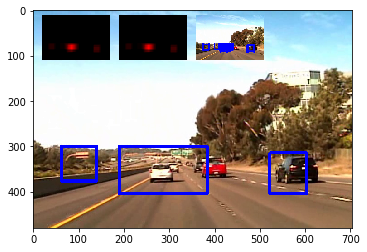



t:  35%|███▌      | 106/300 [05:08<09:41,  3.00s/it, now=None]

t:  36%|███▌      | 107/300 [05:11<09:32,  2.97s/it, now=None]

Found 90 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (98, 338)
Appending new object with centroid: (284, 352)
Appending new object with centroid: (564, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  36%|███▌      | 108/300 [05:14<09:23,  2.93s/it, now=None]

Found 92 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (98, 338)
new centroid= (96, 334)
old bbox= [[ 63 300]
 [133 377]]
new bbox= [[ 61 296]
 [131 372]]
**Found a match**
old centroid= (284, 352)
new centroid= (284, 352)
old bbox= [[190 300]
 [379 405]]
new bbox= [[190 300]
 [378 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (562, 359)
old bbox= [[525 314]
 [603 405]]
new bbox= [[521 314]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  36%|███▋      | 109/300 [05:17<09:16,  2.92s/it, now=None]

Found 87 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (96, 334)
new centroid= (97, 336)
old bbox= [[ 61 296]
 [131 372]]
new bbox= [[ 62 298]
 [132 374]]
**Found a match**
old centroid= (284, 352)
new centroid= (291, 352)
old bbox= [[190 300]
 [378 404]]
new bbox= [[197 300]
 [385 404]]
**Found a match**
old centroid= (562, 359)
new centroid= (563, 359)
old bbox= [[521 314]
 [603 404]]
new bbox= [[522 314]
 [604 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  37%|███▋      | 110/300 [05:19<09:10,  2.90s/it, now=None]

Found 80 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (97, 336)
new centroid= (96, 333)
old bbox= [[ 62 298]
 [132 374]]
new bbox= [[ 61 295]
 [131 371]]
**Found a match**
old centroid= (291, 352)
new centroid= (298, 352)
old bbox= [[197 300]
 [385 404]]
new bbox= [[204 300]
 [392 404]]
**Found a match**
old centroid= (563, 359)
new centroid= (563, 359)
old bbox= [[522 314]
 [604 404]]
new bbox= [[522 314]
 [604 404]]
previously detected objects= 3
so far newly detected objects= 3
Found 84 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (96, 333)
new centroid= (98, 335)
old bbox= [[ 61 295]
 [131 371]]
new bbox= [[ 60 297]
 [136 373]]
**Found a match**
old centroid= (298, 352)
new centroid= (291, 352)
old bbox= [[204 300]
 [392 404]]
new bbox= [[197 300]
 [385 404]]
**Found a match**
old centroid= (563, 359)
new centroid= (565, 355)
old bbox= [[522 314]
 [604 404]]
new bbox= [[524 310]
 [606 400]]
previously detected objects=

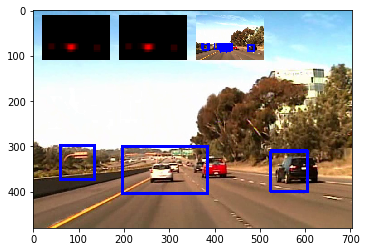



t:  37%|███▋      | 111/300 [05:22<09:16,  2.94s/it, now=None]

t:  37%|███▋      | 112/300 [05:25<09:06,  2.91s/it, now=None]

Found 76 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (95, 331)
Appending new object with centroid: (305, 352)
Appending new object with centroid: (568, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  38%|███▊      | 113/300 [05:28<08:59,  2.89s/it, now=None]

Found 79 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (95, 331)
new centroid= (95, 331)
old bbox= [[ 64 300]
 [127 363]]
new bbox= [[ 63 300]
 [127 362]]
**Found a match**
old centroid= (305, 352)
new centroid= (305, 352)
old bbox= [[232 300]
 [379 405]]
new bbox= [[232 300]
 [378 404]]
**Found a match**
old centroid= (568, 352)
new centroid= (567, 352)
old bbox= [[534 314]
 [603 391]]
new bbox= [[532 314]
 [602 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  38%|███▊      | 114/300 [05:31<08:54,  2.87s/it, now=None]

Found 92 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (95, 331)
new centroid= (93, 334)
old bbox= [[ 63 300]
 [127 362]]
new bbox= [[ 58 296]
 [128 372]]
**Found a match**
old centroid= (305, 352)
new centroid= (303, 352)
old bbox= [[232 300]
 [378 404]]
new bbox= [[226 300]
 [380 404]]
**Found a match**
old centroid= (567, 352)
new centroid= (558, 355)
old bbox= [[532 314]
 [602 390]]
new bbox= [[505 310]
 [611 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  38%|███▊      | 115/300 [05:34<08:52,  2.88s/it, now=None]

Found 88 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (93, 334)
new centroid= (92, 336)
old bbox= [[ 58 296]
 [128 372]]
new bbox= [[ 57 298]
 [127 374]]
**Found a match**
old centroid= (303, 352)
new centroid= (304, 352)
old bbox= [[226 300]
 [380 404]]
new bbox= [[227 300]
 [381 404]]
**Found a match**
old centroid= (558, 355)
new centroid= (552, 353)
old bbox= [[505 310]
 [611 400]]
new bbox= [[497 308]
 [607 398]]
previously detected objects= 3
so far newly detected objects= 3
Found 89 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (92, 336)
new centroid= (93, 333)
old bbox= [[ 57 298]
 [127 374]]
new bbox= [[ 58 295]
 [128 371]]
**Found a match**
old centroid= (304, 352)
new centroid= (304, 352)
old bbox= [[227 300]
 [381 404]]
new bbox= [[224 300]
 [384 404]]
**Found a match**
old centroid= (552, 353)
new centroid= (549, 352)
old bbox= [[497 308]
 [607 398]]
new bbox= [[494 307]
 [604 397]]
previously detected objects=

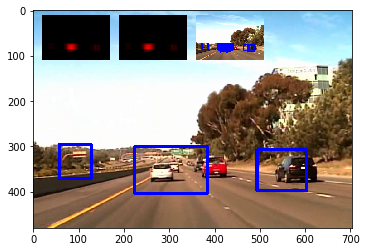



t:  39%|███▊      | 116/300 [05:37<09:00,  2.94s/it, now=None]

t:  39%|███▉      | 117/300 [05:40<08:56,  2.93s/it, now=None]

Found 105 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (91, 338)
Appending new object with centroid: (288, 352)
Appending new object with centroid: (547, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  39%|███▉      | 118/300 [05:43<08:53,  2.93s/it, now=None]

Found 83 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (91, 338)
new centroid= (89, 334)
old bbox= [[ 49 300]
 [133 377]]
new bbox= [[ 47 296]
 [131 372]]
**Found a match**
old centroid= (288, 352)
new centroid= (296, 352)
old bbox= [[190 300]
 [387 405]]
new bbox= [[198 300]
 [394 404]]
**Found a match**
old centroid= (547, 352)
new centroid= (557, 352)
old bbox= [[492 314]
 [603 391]]
new bbox= [[502 314]
 [612 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  40%|███▉      | 119/300 [05:46<08:46,  2.91s/it, now=None]

Found 80 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (89, 334)
new centroid= (88, 332)
old bbox= [[ 47 296]
 [131 372]]
new bbox= [[ 46 294]
 [130 370]]
**Found a match**
old centroid= (296, 352)
new centroid= (300, 352)
old bbox= [[198 300]
 [394 404]]
new bbox= [[202 300]
 [398 404]]
**Found a match**
old centroid= (557, 352)
new centroid= (562, 352)
old bbox= [[502 314]
 [612 390]]
new bbox= [[507 314]
 [617 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  40%|████      | 120/300 [05:49<08:43,  2.91s/it, now=None]

Found 97 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (88, 332)
new centroid= (88, 335)
old bbox= [[ 46 294]
 [130 370]]
new bbox= [[ 46 297]
 [130 373]]
**Found a match**
old centroid= (300, 352)
new centroid= (290, 352)
old bbox= [[202 300]
 [398 404]]
new bbox= [[192 300]
 [388 404]]
**Found a match**
old centroid= (562, 352)
new centroid= (556, 352)
old bbox= [[507 314]
 [617 390]]
new bbox= [[501 314]
 [611 390]]
previously detected objects= 3
so far newly detected objects= 3
Found 77 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (88, 335)
new centroid= (88, 333)
old bbox= [[ 46 297]
 [130 373]]
new bbox= [[ 46 295]
 [130 371]]
**Found a match**
old centroid= (290, 352)
new centroid= (299, 352)
old bbox= [[192 300]
 [388 404]]
new bbox= [[201 300]
 [397 404]]
**Found a match**
old centroid= (556, 352)
new centroid= (560, 352)
old bbox= [[501 314]
 [611 390]]
new bbox= [[505 314]
 [615 390]]
previously detected objects=

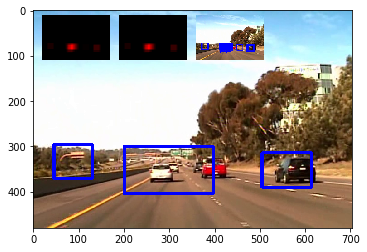



t:  40%|████      | 121/300 [05:52<08:51,  2.97s/it, now=None]

t:  41%|████      | 122/300 [05:55<08:44,  2.94s/it, now=None]

Found 77 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (88, 331)
Appending new object with centroid: (311, 352)
Appending new object with centroid: (452, 345)
Appending new object with centroid: (550, 352)
previously detected objects= 3
so far newly detected objects= 4




t:  41%|████      | 123/300 [05:57<08:37,  2.93s/it, now=None]

Found 123 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (88, 331)
new centroid= (89, 334)
old bbox= [[ 50 300]
 [127 363]]
new bbox= [[ 40 296]
 [138 372]]
**Found a match**
old centroid= (311, 352)
new centroid= (292, 352)
old bbox= [[245 300]
 [378 405]]
new bbox= [[188 300]
 [396 404]]
**Found a match**
old centroid= (550, 352)
new centroid= (553, 352)
old bbox= [[498 314]
 [603 391]]
new bbox= [[501 300]
 [605 404]]
**Found a match**
old centroid= (452, 345)
new centroid= (452, 345)
old bbox= [[422 314]
 [483 377]]
new bbox= [[422 314]
 [482 376]]
previously detected objects= 3
so far newly detected objects= 4




t:  41%|████▏     | 124/300 [06:00<08:30,  2.90s/it, now=None]

Found 104 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (89, 334)
new centroid= (88, 336)
old bbox= [[ 40 296]
 [138 372]]
new bbox= [[ 39 298]
 [137 374]]
**Found a match**
old centroid= (292, 352)
new centroid= (286, 352)
old bbox= [[188 300]
 [396 404]]
new bbox= [[182 300]
 [390 404]]
**Found a match**
old centroid= (553, 352)
new centroid= (550, 348)
old bbox= [[501 300]
 [605 404]]
new bbox= [[495 296]
 [605 400]]
previously detected objects= 3
so far newly detected objects= 4




t:  42%|████▏     | 125/300 [06:03<08:26,  2.90s/it, now=None]

Found 97 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (88, 336)
new centroid= (87, 333)
old bbox= [[ 39 298]
 [137 374]]
new bbox= [[ 38 295]
 [136 371]]
**Found a match**
old centroid= (286, 352)
new centroid= (283, 352)
old bbox= [[182 300]
 [390 404]]
new bbox= [[179 300]
 [387 404]]
**Found a match**
old centroid= (550, 348)
new centroid= (548, 346)
old bbox= [[495 296]
 [605 400]]
new bbox= [[493 294]
 [603 398]]
previously detected objects= 3
so far newly detected objects= 4
Found 113 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (87, 333)
new centroid= (85, 335)
old bbox= [[ 38 295]
 [136 371]]
new bbox= [[ 36 297]
 [134 373]]
**Found a match**
old centroid= (283, 352)
new centroid= (280, 352)
old bbox= [[179 300]
 [387 404]]
new bbox= [[176 300]
 [384 404]]
**Found a match**
old centroid= (548, 346)
new centroid= (551, 349)
old bbox= [[493 294]
 [603 398]]
new bbox= [[496 297]
 [606 401]]
previously detected objects

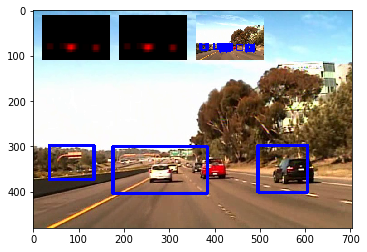



t:  42%|████▏     | 126/300 [06:06<08:32,  2.95s/it, now=None]

t:  42%|████▏     | 127/300 [06:09<08:25,  2.92s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (77, 338)
Appending new object with centroid: (281, 352)
Appending new object with centroid: (554, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  43%|████▎     | 128/300 [06:12<08:19,  2.91s/it, now=None]

Found 91 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (77, 338)
new centroid= (79, 338)
old bbox= [[ 42 300]
 [113 377]]
new bbox= [[ 44 300]
 [114 376]]
**Found a match**
old centroid= (281, 352)
new centroid= (291, 352)
old bbox= [[184 300]
 [379 405]]
new bbox= [[194 300]
 [388 404]]
**Found a match**
old centroid= (554, 359)
new centroid= (554, 355)
old bbox= [[506 314]
 [603 405]]
new bbox= [[506 310]
 [602 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  43%|████▎     | 129/300 [06:15<08:15,  2.90s/it, now=None]

Found 116 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (79, 338)
new centroid= (76, 338)
old bbox= [[ 44 300]
 [114 376]]
new bbox= [[ 37 300]
 [115 376]]
**Found a match**
old centroid= (291, 352)
new centroid= (284, 352)
old bbox= [[194 300]
 [388 404]]
new bbox= [[183 300]
 [385 404]]
**Found a match**
old centroid= (554, 355)
new centroid= (552, 350)
old bbox= [[506 310]
 [602 400]]
new bbox= [[499 305]
 [605 395]]
Appending new object with centroid: (452, 345)
previously detected objects= 3
so far newly detected objects= 4




t:  43%|████▎     | 130/300 [06:18<08:11,  2.89s/it, now=None]

Found 86 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (76, 338)
new centroid= (76, 338)
old bbox= [[ 37 300]
 [115 376]]
new bbox= [[ 37 300]
 [115 376]]
**Found a match**
old centroid= (284, 352)
new centroid= (279, 352)
old bbox= [[183 300]
 [385 404]]
new bbox= [[178 300]
 [380 404]]
**Found a match**
old centroid= (552, 350)
new centroid= (556, 347)
old bbox= [[499 305]
 [605 395]]
new bbox= [[503 302]
 [609 392]]
previously detected objects= 3
so far newly detected objects= 4
Found 88 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (76, 338)
new centroid= (78, 338)
old bbox= [[ 37 300]
 [115 376]]
new bbox= [[ 39 300]
 [117 376]]
**Found a match**
old centroid= (279, 352)
new centroid= (291, 352)
old bbox= [[178 300]
 [380 404]]
new bbox= [[190 300]
 [392 404]]
**Found a match**
old centroid= (452, 345)
new centroid= (452, 345)
old bbox= [[422 314]
 [483 377]]
new bbox= [[422 314]
 [482 376]]
**Found a match**
old centro

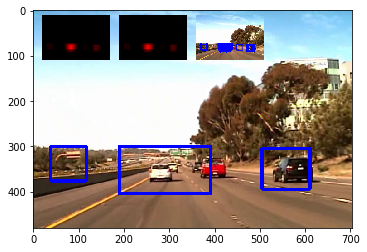



t:  44%|████▎     | 131/300 [06:21<08:17,  2.94s/it, now=None]

t:  44%|████▍     | 132/300 [06:24<08:10,  2.92s/it, now=None]

Found 112 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (74, 338)
Appending new object with centroid: (298, 352)
Appending new object with centroid: (550, 345)
Appending new object with centroid: (452, 345)
previously detected objects= 3
so far newly detected objects= 4




t:  44%|████▍     | 133/300 [06:27<08:09,  2.93s/it, now=None]

Found 103 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (74, 338)
new centroid= (75, 334)
old bbox= [[ 35 300]
 [113 377]]
new bbox= [[ 36 296]
 [114 372]]
**Found a match**
old centroid= (298, 352)
new centroid= (298, 352)
old bbox= [[218 300]
 [379 405]]
new bbox= [[217 300]
 [379 404]]
**Found a match**
old centroid= (550, 345)
new centroid= (552, 345)
old bbox= [[498 300]
 [603 391]]
new bbox= [[500 300]
 [604 390]]
previously detected objects= 3
so far newly detected objects= 4




t:  45%|████▍     | 134/300 [06:29<08:04,  2.92s/it, now=None]

Found 99 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (75, 334)
new centroid= (76, 332)
old bbox= [[ 36 296]
 [114 372]]
new bbox= [[ 37 294]
 [115 370]]
**Found a match**
old centroid= (298, 352)
new centroid= (299, 352)
old bbox= [[217 300]
 [379 404]]
new bbox= [[218 300]
 [380 404]]
**Found a match**
old centroid= (552, 345)
new centroid= (551, 345)
old bbox= [[500 300]
 [604 390]]
new bbox= [[499 300]
 [603 390]]
previously detected objects= 3
so far newly detected objects= 4




t:  45%|████▌     | 135/300 [06:32<07:59,  2.90s/it, now=None]

Found 105 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (76, 332)
new centroid= (74, 331)
old bbox= [[ 37 294]
 [115 370]]
new bbox= [[ 35 293]
 [113 369]]
**Found a match**
old centroid= (299, 352)
new centroid= (298, 352)
old bbox= [[218 300]
 [380 404]]
new bbox= [[217 300]
 [379 404]]
**Found a match**
old centroid= (452, 345)
new centroid= (452, 345)
old bbox= [[422 314]
 [483 377]]
new bbox= [[422 314]
 [482 376]]
**Found a match**
old centroid= (551, 345)
new centroid= (550, 352)
old bbox= [[499 300]
 [603 390]]
new bbox= [[498 307]
 [602 397]]
previously detected objects= 3
so far newly detected objects= 4
Found 97 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (74, 331)
new centroid= (73, 331)
old bbox= [[ 35 293]
 [113 369]]
new bbox= [[ 34 293]
 [112 369]]
**Found a match**
old centroid= (298, 352)
new centroid= (300, 352)
old bbox= [[217 300]
 [379 404]]
new bbox= [[219 300]
 [381 404]]
**Found a match**
old centr

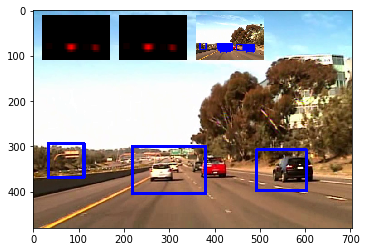



t:  45%|████▌     | 136/300 [06:35<08:05,  2.96s/it, now=None]

t:  46%|████▌     | 137/300 [06:38<07:56,  2.93s/it, now=None]

Found 86 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (73, 331)
Appending new object with centroid: (305, 352)
Appending new object with centroid: (452, 345)
Appending new object with centroid: (564, 352)
previously detected objects= 3
so far newly detected objects= 4




t:  46%|████▌     | 138/300 [06:41<07:50,  2.91s/it, now=None]

Found 116 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (73, 331)
new centroid= (73, 334)
old bbox= [[ 35 300]
 [112 363]]
new bbox= [[ 35 296]
 [111 372]]
**Found a match**
old centroid= (305, 352)
new centroid= (292, 352)
old bbox= [[226 300]
 [385 405]]
new bbox= [[188 300]
 [396 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (559, 348)
old bbox= [[525 314]
 [603 391]]
new bbox= [[511 303]
 [607 393]]
**Found a match**
old centroid= (452, 345)
new centroid= (452, 345)
old bbox= [[422 314]
 [483 377]]
new bbox= [[422 314]
 [482 376]]
previously detected objects= 3
so far newly detected objects= 4




t:  46%|████▋     | 139/300 [06:44<07:46,  2.90s/it, now=None]

Found 96 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (73, 334)
new centroid= (75, 332)
old bbox= [[ 35 296]
 [111 372]]
new bbox= [[ 37 294]
 [113 370]]
**Found a match**
old centroid= (292, 352)
new centroid= (288, 352)
old bbox= [[188 300]
 [396 404]]
new bbox= [[184 300]
 [392 404]]
**Found a match**
old centroid= (452, 345)
new centroid= (452, 345)
old bbox= [[422 314]
 [482 376]]
new bbox= [[422 314]
 [482 376]]
**Found a match**
old centroid= (559, 348)
new centroid= (561, 350)
old bbox= [[511 303]
 [607 393]]
new bbox= [[513 305]
 [609 395]]
previously detected objects= 3
so far newly detected objects= 4




t:  47%|████▋     | 140/300 [06:47<07:39,  2.87s/it, now=None]

Found 89 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (75, 332)
new centroid= (76, 331)
old bbox= [[ 37 294]
 [113 370]]
new bbox= [[ 38 293]
 [114 369]]
**Found a match**
old centroid= (288, 352)
new centroid= (284, 352)
old bbox= [[184 300]
 [392 404]]
new bbox= [[180 300]
 [388 404]]
**Found a match**
old centroid= (561, 350)
new centroid= (562, 347)
old bbox= [[513 305]
 [609 395]]
new bbox= [[514 302]
 [610 392]]
previously detected objects= 3
so far newly detected objects= 4
Found 103 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (76, 331)
new centroid= (75, 331)
old bbox= [[ 38 293]
 [114 369]]
new bbox= [[ 36 293]
 [114 369]]
**Found a match**
old centroid= (284, 352)
new centroid= (280, 352)
old bbox= [[180 300]
 [388 404]]
new bbox= [[173 300]
 [387 404]]
**Found a match**
old centroid= (562, 347)
new centroid= (561, 346)
old bbox= [[514 302]
 [610 392]]
new bbox= [[513 301]
 [609 391]]
previously detected objects

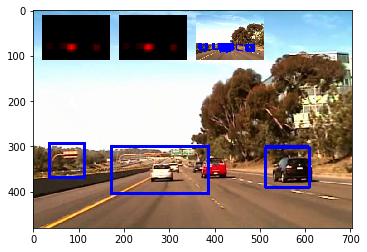



t:  47%|████▋     | 141/300 [06:50<07:45,  2.93s/it, now=None]

t:  47%|████▋     | 142/300 [06:53<07:40,  2.91s/it, now=None]

Found 84 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (277, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 3
so far newly detected objects= 2




t:  48%|████▊     | 143/300 [06:56<07:33,  2.89s/it, now=None]

Found 93 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (70, 331)
**Found a match**
old centroid= (277, 352)
new centroid= (277, 352)
old bbox= [[176 300]
 [378 405]]
new bbox= [[176 300]
 [378 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (559, 352)
old bbox= [[525 314]
 [603 391]]
new bbox= [[511 314]
 [607 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  48%|████▊     | 144/300 [06:58<07:29,  2.88s/it, now=None]

Found 110 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (70, 331)
new centroid= (68, 334)
old bbox= [[ 35 300]
 [105 363]]
new bbox= [[ 30 296]
 [106 372]]
**Found a match**
old centroid= (277, 352)
new centroid= (279, 352)
old bbox= [[176 300]
 [378 404]]
new bbox= [[178 300]
 [380 404]]
**Found a match**
old centroid= (559, 352)
new centroid= (554, 348)
old bbox= [[511 314]
 [607 390]]
new bbox= [[501 303]
 [607 393]]
previously detected objects= 3
so far newly detected objects= 3




t:  48%|████▊     | 145/300 [07:01<07:25,  2.87s/it, now=None]

Found 98 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (68, 334)
new centroid= (69, 332)
old bbox= [[ 30 296]
 [106 372]]
new bbox= [[ 31 294]
 [107 370]]
**Found a match**
old centroid= (279, 352)
new centroid= (278, 352)
old bbox= [[178 300]
 [380 404]]
new bbox= [[177 300]
 [379 404]]
**Found a match**
old centroid= (554, 348)
new centroid= (555, 350)
old bbox= [[501 303]
 [607 393]]
new bbox= [[502 305]
 [608 395]]
previously detected objects= 3
so far newly detected objects= 3
Found 92 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (69, 332)
new centroid= (69, 331)
old bbox= [[ 31 294]
 [107 370]]
new bbox= [[ 31 293]
 [107 369]]
**Found a match**
old centroid= (278, 352)
new centroid= (279, 352)
old bbox= [[177 300]
 [379 404]]
new bbox= [[178 300]
 [380 404]]
**Found a match**
old centroid= (555, 350)
new centroid= (558, 351)
old bbox= [[502 305]
 [608 395]]
new bbox= [[505 306]
 [611 396]]
previously detected objects=

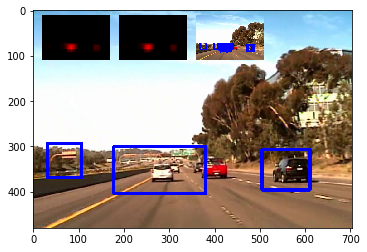



t:  49%|████▊     | 146/300 [07:04<07:31,  2.93s/it, now=None]

t:  49%|████▉     | 147/300 [07:07<07:30,  2.95s/it, now=None]

Found 99 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (63, 338)
Appending new object with centroid: (280, 352)
Appending new object with centroid: (456, 345)
Appending new object with centroid: (564, 352)
previously detected objects= 3
so far newly detected objects= 4




t:  49%|████▉     | 148/300 [07:10<07:24,  2.93s/it, now=None]

Found 82 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (280, 352)
old bbox= [[176 300]
 [385 405]]
new bbox= [[176 300]
 [384 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (562, 355)
old bbox= [[525 314]
 [603 391]]
new bbox= [[520 310]
 [604 400]]
previously detected objects= 3
so far newly detected objects= 4




t:  50%|████▉     | 149/300 [07:13<07:16,  2.89s/it, now=None]

Found 94 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (280, 352)
old bbox= [[176 300]
 [384 404]]
new bbox= [[176 300]
 [384 404]]
**Found a match**
old centroid= (562, 355)
new centroid= (559, 350)
old bbox= [[520 310]
 [604 400]]
new bbox= [[514 305]
 [604 395]]
previously detected objects= 3
so far newly detected objects= 4




t:  50%|█████     | 150/300 [07:16<07:10,  2.87s/it, now=None]

Found 119 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (63, 338)
new centroid= (64, 334)
old bbox= [[ 28 300]
 [ 98 377]]
new bbox= [[ 26 296]
 [102 372]]
**Found a match**
old centroid= (280, 352)
new centroid= (280, 352)
old bbox= [[176 300]
 [384 404]]
new bbox= [[175 300]
 [385 404]]
**Found a match**
old centroid= (559, 350)
new centroid= (554, 351)
old bbox= [[514 305]
 [604 395]]
new bbox= [[502 299]
 [606 403]]
previously detected objects= 3
so far newly detected objects= 4
Found 100 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (280, 352)
new centroid= (280, 352)
old bbox= [[175 300]
 [385 404]]
new bbox= [[174 300]
 [386 404]]
**Found a match**
old centroid= (554, 351)
new centroid= (552, 351)
old bbox= [[502 299]
 [606 403]]
new bbox= [[500 299]
 [604 403]]
**Found a match**
old centroid= (64, 334)
new centroid= (61, 336)
old bbox= [[ 26 296]
 [102 372]]
new bbox= [[ 23 298]
 [ 99 374]]
previously detected object

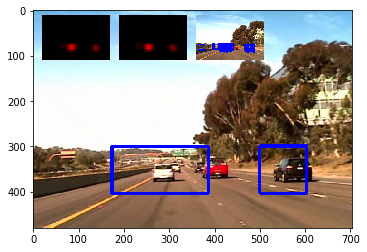



t:  50%|█████     | 151/300 [07:19<07:15,  2.92s/it, now=None]

t:  51%|█████     | 152/300 [07:22<07:07,  2.89s/it, now=None]

Found 92 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (63, 331)
Appending new object with centroid: (281, 352)
Appending new object with centroid: (561, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  51%|█████     | 153/300 [07:25<07:01,  2.87s/it, now=None]

Found 116 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (63, 331)
new centroid= (63, 331)
old bbox= [[ 35 300]
 [ 91 363]]
new bbox= [[ 28 300]
 [ 98 362]]
**Found a match**
old centroid= (281, 352)
new centroid= (281, 352)
old bbox= [[184 300]
 [378 405]]
new bbox= [[176 300]
 [386 404]]
**Found a match**
old centroid= (561, 352)
new centroid= (555, 352)
old bbox= [[520 314]
 [603 391]]
new bbox= [[502 314]
 [608 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  51%|█████▏    | 154/300 [07:27<06:59,  2.87s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (63, 331)
new centroid= (64, 331)
old bbox= [[ 28 300]
 [ 98 362]]
new bbox= [[ 29 300]
 [ 99 362]]
**Found a match**
old centroid= (281, 352)
new centroid= (281, 352)
old bbox= [[176 300]
 [386 404]]
new bbox= [[176 300]
 [386 404]]
**Found a match**
old centroid= (555, 352)
new centroid= (554, 352)
old bbox= [[502 314]
 [608 390]]
new bbox= [[501 314]
 [607 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  52%|█████▏    | 155/300 [07:30<06:55,  2.86s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (64, 331)
new centroid= (63, 331)
old bbox= [[ 29 300]
 [ 99 362]]
new bbox= [[ 28 300]
 [ 98 362]]
**Found a match**
old centroid= (281, 352)
new centroid= (277, 352)
old bbox= [[176 300]
 [386 404]]
new bbox= [[172 300]
 [382 404]]
**Found a match**
old centroid= (554, 352)
new centroid= (557, 348)
old bbox= [[501 314]
 [607 390]]
new bbox= [[504 303]
 [610 393]]
previously detected objects= 2
so far newly detected objects= 3
Found 113 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (63, 331)
new centroid= (61, 331)
old bbox= [[ 28 300]
 [ 98 362]]
new bbox= [[ 26 300]
 [ 96 362]]
**Found a match**
old centroid= (277, 352)
new centroid= (278, 352)
old bbox= [[172 300]
 [382 404]]
new bbox= [[173 300]
 [383 404]]
**Found a match**
old centroid= (557, 348)
new centroid= (555, 350)
old bbox= [[504 303]
 [610 393]]
new bbox= [[502 305]
 [608 395]]
previously detected object

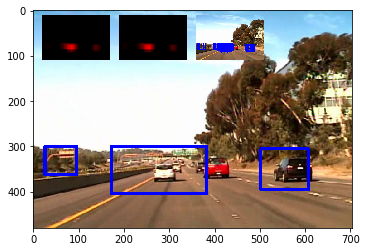



t:  52%|█████▏    | 156/300 [07:33<06:58,  2.90s/it, now=None]

t:  52%|█████▏    | 157/300 [07:36<06:51,  2.88s/it, now=None]

Found 104 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (63, 331)
Appending new object with centroid: (281, 352)
Appending new object with centroid: (564, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  53%|█████▎    | 158/300 [07:39<06:47,  2.87s/it, now=None]

Found 108 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (281, 352)
new centroid= (281, 352)
old bbox= [[176 300]
 [387 405]]
new bbox= [[176 300]
 [386 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (562, 352)
old bbox= [[525 314]
 [603 405]]
new bbox= [[520 307]
 [604 397]]
previously detected objects= 3
so far newly detected objects= 3




t:  53%|█████▎    | 159/300 [07:42<06:43,  2.86s/it, now=None]

Found 120 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (63, 331)
new centroid= (61, 331)
old bbox= [[ 28 300]
 [ 98 363]]
new bbox= [[ 26 300]
 [ 96 362]]
**Found a match**
old centroid= (281, 352)
new centroid= (281, 352)
old bbox= [[176 300]
 [386 404]]
new bbox= [[175 300]
 [387 404]]
**Found a match**
old centroid= (562, 352)
new centroid= (561, 352)
old bbox= [[520 307]
 [604 397]]
new bbox= [[519 300]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  53%|█████▎    | 160/300 [07:45<06:39,  2.86s/it, now=None]

Found 93 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (61, 331)
new centroid= (60, 331)
old bbox= [[ 26 300]
 [ 96 362]]
new bbox= [[ 25 300]
 [ 95 362]]
**Found a match**
old centroid= (281, 352)
new centroid= (284, 352)
old bbox= [[175 300]
 [387 404]]
new bbox= [[178 300]
 [390 404]]
**Found a match**
old centroid= (561, 352)
new centroid= (561, 352)
old bbox= [[519 300]
 [603 404]]
new bbox= [[519 300]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3
Found 90 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (284, 352)
new centroid= (284, 352)
old bbox= [[178 300]
 [390 404]]
new bbox= [[178 300]
 [390 404]]
**Found a match**
old centroid= (561, 352)
new centroid= (559, 348)
old bbox= [[519 300]
 [603 404]]
new bbox= [[514 296]
 [604 400]]
previously detected objects= 3
number of times detected object appeared:  2
number of times detected object appeared:  4
** Adding similar object to one with ce

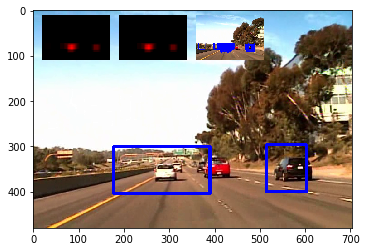



t:  54%|█████▎    | 161/300 [07:48<06:45,  2.92s/it, now=None]

t:  54%|█████▍    | 162/300 [07:51<06:39,  2.89s/it, now=None]

Found 105 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (288, 352)
Appending new object with centroid: (550, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  54%|█████▍    | 163/300 [07:53<06:35,  2.89s/it, now=None]

Found 82 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (288, 352)
new centroid= (288, 352)
old bbox= [[184 300]
 [392 405]]
new bbox= [[184 300]
 [392 404]]
**Found a match**
old centroid= (550, 345)
new centroid= (555, 345)
old bbox= [[498 300]
 [603 391]]
new bbox= [[503 300]
 [607 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  55%|█████▍    | 164/300 [07:56<06:31,  2.88s/it, now=None]

Found 92 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (45, 331)
**Found a match**
old centroid= (288, 352)
new centroid= (288, 352)
old bbox= [[184 300]
 [392 404]]
new bbox= [[184 300]
 [392 404]]
**Found a match**
old centroid= (555, 345)
new centroid= (558, 348)
old bbox= [[503 300]
 [607 390]]
new bbox= [[506 303]
 [610 393]]
previously detected objects= 2
so far newly detected objects= 3




t:  55%|█████▌    | 165/300 [07:59<06:29,  2.88s/it, now=None]

Found 88 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (45, 331)
new centroid= (45, 331)
old bbox= [[ 14 300]
 [ 77 363]]
new bbox= [[ 14 300]
 [ 76 362]]
**Found a match**
old centroid= (288, 352)
new centroid= (288, 352)
old bbox= [[184 300]
 [392 404]]
new bbox= [[184 300]
 [392 404]]
**Found a match**
old centroid= (558, 348)
new centroid= (559, 346)
old bbox= [[506 303]
 [610 393]]
new bbox= [[507 301]
 [611 391]]
previously detected objects= 2
so far newly detected objects= 3
Found 84 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (45, 331)
new centroid= (48, 331)
old bbox= [[ 14 300]
 [ 76 362]]
new bbox= [[ 17 300]
 [ 79 362]]
**Found a match**
old centroid= (288, 352)
new centroid= (286, 352)
old bbox= [[184 300]
 [392 404]]
new bbox= [[182 300]
 [390 404]]
**Found a match**
old centroid= (559, 346)
new centroid= (561, 349)
old bbox= [[507 301]
 [611 391]]
new bbox= [[509 304]
 [613 394]]
previously detected objects=

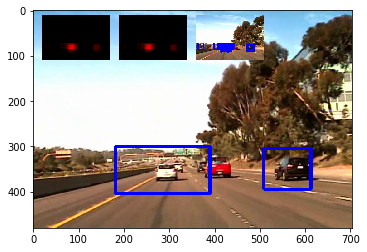



t:  55%|█████▌    | 166/300 [08:02<06:32,  2.93s/it, now=None]

t:  56%|█████▌    | 167/300 [08:05<06:25,  2.90s/it, now=None]

Found 67 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (52, 331)
Appending new object with centroid: (301, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  56%|█████▌    | 168/300 [08:08<06:19,  2.88s/it, now=None]

Found 94 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (52, 331)
new centroid= (52, 331)
old bbox= [[ 28 300]
 [ 77 363]]
new bbox= [[ 28 300]
 [ 76 362]]
**Found a match**
old centroid= (301, 352)
new centroid= (292, 352)
old bbox= [[231 300]
 [371 405]]
new bbox= [[184 300]
 [400 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (562, 348)
old bbox= [[525 314]
 [603 391]]
new bbox= [[520 303]
 [604 393]]
previously detected objects= 2
so far newly detected objects= 3




t:  56%|█████▋    | 169/300 [08:11<06:13,  2.85s/it, now=None]

Found 79 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (52, 331)
new centroid= (48, 331)
old bbox= [[ 28 300]
 [ 76 362]]
new bbox= [[ 17 300]
 [ 79 362]]
**Found a match**
old centroid= (292, 352)
new centroid= (289, 352)
old bbox= [[184 300]
 [400 404]]
new bbox= [[181 300]
 [397 404]]
**Found a match**
old centroid= (562, 348)
new centroid= (559, 346)
old bbox= [[520 303]
 [604 393]]
new bbox= [[513 301]
 [605 391]]
previously detected objects= 2
so far newly detected objects= 3




t:  57%|█████▋    | 170/300 [08:13<06:08,  2.84s/it, now=None]

Found 86 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (48, 331)
new centroid= (50, 331)
old bbox= [[ 17 300]
 [ 79 362]]
new bbox= [[ 19 300]
 [ 81 362]]
**Found a match**
old centroid= (289, 352)
new centroid= (286, 352)
old bbox= [[181 300]
 [397 404]]
new bbox= [[178 300]
 [394 404]]
**Found a match**
old centroid= (559, 346)
new centroid= (561, 349)
old bbox= [[513 301]
 [605 391]]
new bbox= [[515 304]
 [607 394]]
previously detected objects= 2
so far newly detected objects= 3
Found 102 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (50, 331)
new centroid= (47, 331)
old bbox= [[ 19 300]
 [ 81 362]]
new bbox= [[ 16 300]
 [ 78 362]]
**Found a match**
old centroid= (286, 352)
new centroid= (285, 352)
old bbox= [[178 300]
 [394 404]]
new bbox= [[177 300]
 [393 404]]
**Found a match**
old centroid= (561, 349)
new centroid= (561, 347)
old bbox= [[515 304]
 [607 394]]
new bbox= [[515 302]
 [607 392]]
previously detected objects

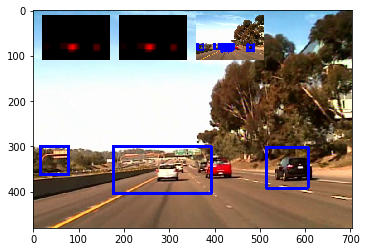



t:  57%|█████▋    | 171/300 [08:16<06:12,  2.89s/it, now=None]

t:  57%|█████▋    | 172/300 [08:19<06:07,  2.87s/it, now=None]

Found 73 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (218, 331)
Appending new object with centroid: (325, 352)
Appending new object with centroid: (564, 345)
previously detected objects= 3
so far newly detected objects= 3




t:  58%|█████▊    | 173/300 [08:22<06:02,  2.85s/it, now=None]

Found 100 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (325, 352)
new centroid= (304, 352)
old bbox= [[259 300]
 [392 405]]
new bbox= [[196 300]
 [412 404]]
**Found a match**
old centroid= (564, 345)
new centroid= (564, 345)
old bbox= [[525 300]
 [603 391]]
new bbox= [[525 300]
 [603 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  58%|█████▊    | 174/300 [08:25<05:58,  2.84s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (304, 352)
new centroid= (296, 352)
old bbox= [[196 300]
 [412 404]]
new bbox= [[188 300]
 [404 404]]
**Found a match**
old centroid= (564, 345)
new centroid= (562, 345)
old bbox= [[525 300]
 [603 390]]
new bbox= [[521 300]
 [603 390]]
Appending new object with centroid: (45, 338)
previously detected objects= 3
so far newly detected objects= 4




t:  58%|█████▊    | 175/300 [08:28<05:54,  2.84s/it, now=None]

Found 69 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (218, 331)
new centroid= (219, 331)
old bbox= [[184 300]
 [252 363]]
new bbox= [[185 300]
 [253 362]]
**Found a match**
old centroid= (296, 352)
new centroid= (309, 352)
old bbox= [[188 300]
 [404 404]]
new bbox= [[201 300]
 [417 404]]
**Found a match**
old centroid= (562, 345)
new centroid= (563, 348)
old bbox= [[521 300]
 [603 390]]
new bbox= [[522 303]
 [604 393]]
previously detected objects= 3
so far newly detected objects= 4
Found 78 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (309, 352)
new centroid= (300, 352)
old bbox= [[201 300]
 [417 404]]
new bbox= [[192 300]
 [408 404]]
**Found a match**
old centroid= (563, 348)
new centroid= (562, 350)
old bbox= [[522 303]
 [604 393]]
new bbox= [[521 305]
 [603 395]]
previously detected objects= 3
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with 

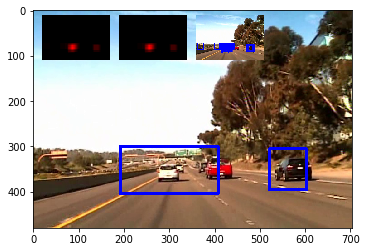



t:  59%|█████▊    | 176/300 [08:31<05:59,  2.90s/it, now=None]

t:  59%|█████▉    | 177/300 [08:34<05:52,  2.87s/it, now=None]

Found 91 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (288, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  59%|█████▉    | 178/300 [08:36<05:47,  2.84s/it, now=None]

Found 80 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (38, 331)
**Found a match**
old centroid= (288, 352)
new centroid= (288, 352)
old bbox= [[184 300]
 [392 405]]
new bbox= [[184 300]
 [392 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (553, 352)
old bbox= [[525 314]
 [603 391]]
new bbox= [[494 314]
 [612 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  60%|█████▉    | 179/300 [08:39<05:43,  2.84s/it, now=None]

Found 84 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (38, 331)
new centroid= (38, 331)
old bbox= [[ 14 300]
 [ 63 363]]
new bbox= [[ 14 300]
 [ 62 362]]
**Found a match**
old centroid= (288, 352)
new centroid= (288, 352)
old bbox= [[184 300]
 [392 404]]
new bbox= [[184 300]
 [392 404]]
**Found a match**
old centroid= (553, 352)
new centroid= (558, 352)
old bbox= [[494 314]
 [612 390]]
new bbox= [[499 314]
 [617 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  60%|██████    | 180/300 [08:42<05:40,  2.84s/it, now=None]

Found 96 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (38, 331)
new centroid= (34, 331)
old bbox= [[ 14 300]
 [ 62 362]]
new bbox= [[  3 300]
 [ 65 362]]
**Found a match**
old centroid= (288, 352)
new centroid= (287, 352)
old bbox= [[184 300]
 [392 404]]
new bbox= [[182 300]
 [392 404]]
**Found a match**
old centroid= (558, 352)
new centroid= (550, 352)
old bbox= [[499 314]
 [617 390]]
new bbox= [[491 314]
 [609 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 79 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (34, 331)
new centroid= (32, 331)
old bbox= [[  3 300]
 [ 65 362]]
new bbox= [[  1 300]
 [ 63 362]]
Appending new object with centroid: (218, 331)
**Found a match**
old centroid= (287, 352)
new centroid= (305, 352)
old bbox= [[182 300]
 [392 404]]
new bbox= [[200 300]
 [410 404]]
**Found a match**
old centroid= (550, 352)
new centroid= (546, 352)
old bbox= [[491 314]
 [609 390]]
new bbox= [[48

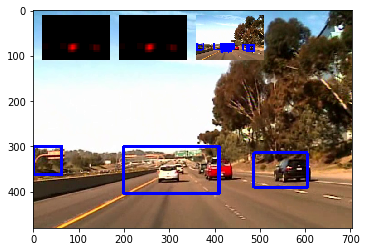



t:  60%|██████    | 181/300 [08:45<05:45,  2.90s/it, now=None]

t:  61%|██████    | 182/300 [08:48<05:39,  2.87s/it, now=None]

Found 98 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (31, 331)
Appending new object with centroid: (281, 352)
Appending new object with centroid: (543, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  61%|██████    | 183/300 [08:51<05:34,  2.86s/it, now=None]

Found 141 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (31, 331)
new centroid= (47, 338)
old bbox= [[  0 300]
 [ 63 363]]
new bbox= [[-16 293]
 [110 383]]
**Found a match**
old centroid= (281, 352)
new centroid= (279, 352)
old bbox= [[176 300]
 [387 405]]
new bbox= [[164 300]
 [394 404]]
**Found a match**
old centroid= (543, 352)
new centroid= (543, 348)
old bbox= [[484 314]
 [603 391]]
new bbox= [[484 303]
 [602 393]]
previously detected objects= 3
so far newly detected objects= 3




t:  61%|██████▏   | 184/300 [08:54<05:30,  2.85s/it, now=None]

Found 90 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (279, 352)
new centroid= (278, 352)
old bbox= [[164 300]
 [394 404]]
new bbox= [[163 300]
 [393 404]]
**Found a match**
old centroid= (543, 348)
new centroid= (543, 350)
old bbox= [[484 303]
 [602 393]]
new bbox= [[484 305]
 [602 395]]
previously detected objects= 3
so far newly detected objects= 3




t:  62%|██████▏   | 185/300 [08:56<05:26,  2.84s/it, now=None]

Found 102 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (278, 352)
new centroid= (279, 352)
old bbox= [[163 300]
 [393 404]]
new bbox= [[164 300]
 [394 404]]
**Found a match**
old centroid= (543, 350)
new centroid= (545, 351)
old bbox= [[484 305]
 [602 395]]
new bbox= [[486 306]
 [604 396]]
previously detected objects= 3
so far newly detected objects= 3
Found 118 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (279, 352)
new centroid= (277, 352)
old bbox= [[164 300]
 [394 404]]
new bbox= [[162 300]
 [392 404]]
**Found a match**
old centroid= (545, 351)
new centroid= (545, 351)
old bbox= [[486 306]
 [604 396]]
new bbox= [[486 299]
 [604 403]]
previously detected objects= 3
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with centroid (277, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (545, 351) **
Refr

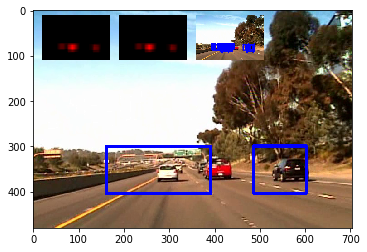



t:  62%|██████▏   | 186/300 [08:59<05:29,  2.89s/it, now=None]

t:  62%|██████▏   | 187/300 [09:02<05:23,  2.86s/it, now=None]

Found 103 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (280, 352)
Appending new object with centroid: (543, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  63%|██████▎   | 188/300 [09:05<05:19,  2.85s/it, now=None]

Found 112 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (280, 352)
old bbox= [[168 300]
 [393 405]]
new bbox= [[168 300]
 [392 404]]
**Found a match**
old centroid= (543, 345)
new centroid= (543, 348)
old bbox= [[484 300]
 [603 391]]
new bbox= [[484 303]
 [602 393]]
previously detected objects= 2
so far newly detected objects= 2




t:  63%|██████▎   | 189/300 [09:08<05:22,  2.90s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (275, 352)
old bbox= [[168 300]
 [392 404]]
new bbox= [[153 300]
 [397 404]]
**Found a match**
old centroid= (543, 348)
new centroid= (544, 353)
old bbox= [[484 303]
 [602 393]]
new bbox= [[485 308]
 [603 398]]
previously detected objects= 2
so far newly detected objects= 2




t:  63%|██████▎   | 190/300 [09:11<05:15,  2.87s/it, now=None]

Found 101 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (275, 352)
new centroid= (276, 352)
old bbox= [[153 300]
 [397 404]]
new bbox= [[154 300]
 [398 404]]
**Found a match**
old centroid= (544, 353)
new centroid= (543, 356)
old bbox= [[485 308]
 [603 398]]
new bbox= [[484 311]
 [602 401]]
previously detected objects= 2
so far newly detected objects= 2
Found 92 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (200, 338)
**Found a match**
old centroid= (276, 352)
new centroid= (297, 352)
old bbox= [[154 300]
 [398 404]]
new bbox= [[175 300]
 [419 404]]
**Found a match**
old centroid= (543, 356)
new centroid= (543, 357)
old bbox= [[484 311]
 [602 401]]
new bbox= [[484 312]
 [602 402]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (297, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (543, 357) **
num

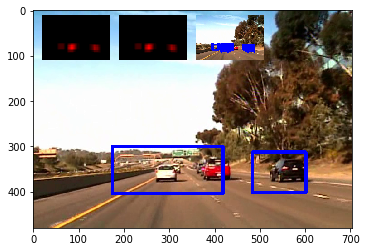



t:  64%|██████▎   | 191/300 [09:14<05:17,  2.92s/it, now=None]

t:  64%|██████▍   | 192/300 [09:17<05:10,  2.88s/it, now=None]

Found 133 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (271, 352)
Appending new object with centroid: (543, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  64%|██████▍   | 193/300 [09:19<05:05,  2.86s/it, now=None]

Found 115 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (271, 352)
new centroid= (271, 352)
old bbox= [[156 300]
 [387 405]]
new bbox= [[156 300]
 [386 404]]
**Found a match**
old centroid= (543, 352)
new centroid= (545, 355)
old bbox= [[484 300]
 [603 405]]
new bbox= [[486 303]
 [604 407]]
previously detected objects= 2
so far newly detected objects= 2




t:  65%|██████▍   | 194/300 [09:22<05:01,  2.84s/it, now=None]

Found 119 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (271, 352)
new centroid= (271, 352)
old bbox= [[156 300]
 [386 404]]
new bbox= [[156 300]
 [386 404]]
**Found a match**
old centroid= (545, 355)
new centroid= (546, 357)
old bbox= [[486 303]
 [604 407]]
new bbox= [[487 305]
 [605 409]]
previously detected objects= 2
so far newly detected objects= 2




t:  65%|██████▌   | 195/300 [09:25<04:58,  2.84s/it, now=None]

Found 131 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (271, 352)
new centroid= (270, 352)
old bbox= [[156 300]
 [386 404]]
new bbox= [[154 300]
 [386 404]]
**Found a match**
old centroid= (546, 357)
new centroid= (546, 358)
old bbox= [[487 305]
 [605 409]]
new bbox= [[487 306]
 [605 410]]
previously detected objects= 2
so far newly detected objects= 2
Found 94 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (200, 331)
**Found a match**
old centroid= (270, 352)
new centroid= (292, 352)
old bbox= [[154 300]
 [386 404]]
new bbox= [[176 300]
 [408 404]]
**Found a match**
old centroid= (546, 358)
new centroid= (551, 355)
old bbox= [[487 306]
 [605 410]]
new bbox= [[492 303]
 [610 407]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (292, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (551, 355) **
num

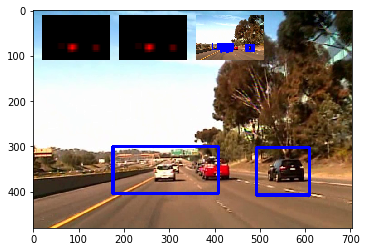



t:  65%|██████▌   | 196/300 [09:28<05:02,  2.91s/it, now=None]

t:  66%|██████▌   | 197/300 [09:31<04:57,  2.89s/it, now=None]

Found 107 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (270, 352)
Appending new object with centroid: (557, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  66%|██████▌   | 198/300 [09:34<04:52,  2.86s/it, now=None]

Found 134 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 352)
new centroid= (267, 352)
old bbox= [[162 300]
 [379 405]]
new bbox= [[145 300]
 [389 404]]
**Found a match**
old centroid= (557, 352)
new centroid= (553, 355)
old bbox= [[511 314]
 [603 391]]
new bbox= [[501 310]
 [605 400]]
previously detected objects= 2
so far newly detected objects= 2




t:  66%|██████▋   | 199/300 [09:37<04:47,  2.85s/it, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (267, 352)
new centroid= (268, 352)
old bbox= [[145 300]
 [389 404]]
new bbox= [[146 300]
 [390 404]]
**Found a match**
old centroid= (553, 355)
new centroid= (551, 353)
old bbox= [[501 310]
 [605 400]]
new bbox= [[499 308]
 [603 398]]
previously detected objects= 2
so far newly detected objects= 2




t:  67%|██████▋   | 200/300 [09:39<04:43,  2.84s/it, now=None]

Found 114 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (268, 352)
new centroid= (269, 352)
old bbox= [[146 300]
 [390 404]]
new bbox= [[147 300]
 [391 404]]
**Found a match**
old centroid= (551, 353)
new centroid= (554, 352)
old bbox= [[499 308]
 [603 398]]
new bbox= [[502 307]
 [606 397]]
previously detected objects= 2
so far newly detected objects= 2
Found 125 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (269, 352)
new centroid= (269, 352)
old bbox= [[147 300]
 [391 404]]
new bbox= [[147 300]
 [391 404]]
**Found a match**
old centroid= (554, 352)
new centroid= (554, 352)
old bbox= [[502 307]
 [606 397]]
new bbox= [[502 300]
 [606 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (269, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (554, 352) **
Refresh at frame n. 200: newly detected objects 2

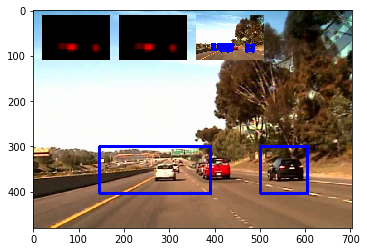



t:  67%|██████▋   | 201/300 [09:42<04:45,  2.89s/it, now=None]

t:  67%|██████▋   | 202/300 [09:45<04:40,  2.87s/it, now=None]

Found 87 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (270, 352)
Appending new object with centroid: (557, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  68%|██████▊   | 203/300 [09:48<04:35,  2.84s/it, now=None]

Found 97 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 352)
new centroid= (271, 352)
old bbox= [[156 300]
 [385 405]]
new bbox= [[157 300]
 [385 404]]
**Found a match**
old centroid= (557, 352)
new centroid= (555, 352)
old bbox= [[511 314]
 [603 391]]
new bbox= [[507 300]
 [603 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  68%|██████▊   | 204/300 [09:51<04:32,  2.84s/it, now=None]

Found 114 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (271, 352)
new centroid= (271, 352)
old bbox= [[157 300]
 [385 404]]
new bbox= [[156 300]
 [386 404]]
**Found a match**
old centroid= (555, 352)
new centroid= (556, 348)
old bbox= [[507 300]
 [603 404]]
new bbox= [[508 296]
 [604 400]]
previously detected objects= 2
so far newly detected objects= 2




t:  68%|██████▊   | 205/300 [09:54<04:29,  2.84s/it, now=None]

Found 102 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (271, 352)
new centroid= (270, 352)
old bbox= [[156 300]
 [386 404]]
new bbox= [[155 300]
 [385 404]]
**Found a match**
old centroid= (556, 348)
new centroid= (556, 346)
old bbox= [[508 296]
 [604 400]]
new bbox= [[508 294]
 [604 398]]
previously detected objects= 2
so far newly detected objects= 2
Found 93 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 352)
new centroid= (270, 352)
old bbox= [[155 300]
 [385 404]]
new bbox= [[155 300]
 [385 404]]
**Found a match**
old centroid= (556, 346)
new centroid= (556, 349)
old bbox= [[508 294]
 [604 398]]
new bbox= [[508 297]
 [604 401]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (270, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (556, 349) **
Refresh at frame n. 205: newly detected objects 2


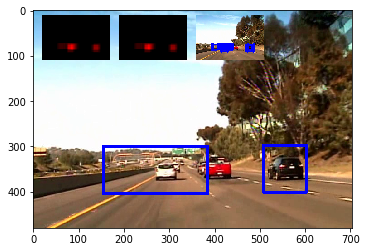



t:  69%|██████▊   | 206/300 [09:57<04:32,  2.90s/it, now=None]

t:  69%|██████▉   | 207/300 [10:00<04:27,  2.88s/it, now=None]

Found 105 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (270, 345)
Appending new object with centroid: (557, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  69%|██████▉   | 208/300 [10:02<04:23,  2.87s/it, now=None]

Found 102 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 345)
new centroid= (269, 348)
old bbox= [[156 300]
 [385 391]]
new bbox= [[154 296]
 [384 400]]
**Found a match**
old centroid= (557, 352)
new centroid= (557, 348)
old bbox= [[511 300]
 [603 405]]
new bbox= [[511 296]
 [603 400]]
previously detected objects= 2
so far newly detected objects= 2




t:  70%|██████▉   | 209/300 [10:05<04:19,  2.85s/it, now=None]

Found 101 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (269, 348)
new centroid= (274, 350)
old bbox= [[154 296]
 [384 400]]
new bbox= [[159 298]
 [389 402]]
**Found a match**
old centroid= (557, 348)
new centroid= (557, 346)
old bbox= [[511 296]
 [603 400]]
new bbox= [[511 294]
 [603 398]]
previously detected objects= 2
so far newly detected objects= 2




t:  70%|███████   | 210/300 [10:08<04:15,  2.84s/it, now=None]

Found 110 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (274, 350)
new centroid= (277, 351)
old bbox= [[159 298]
 [389 402]]
new bbox= [[162 299]
 [392 403]]
**Found a match**
old centroid= (557, 346)
new centroid= (555, 345)
old bbox= [[511 294]
 [603 398]]
new bbox= [[506 293]
 [604 397]]
previously detected objects= 2
so far newly detected objects= 2
Found 108 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (277, 351)
new centroid= (277, 351)
old bbox= [[162 299]
 [392 403]]
new bbox= [[161 299]
 [393 403]]
**Found a match**
old centroid= (555, 345)
new centroid= (556, 348)
old bbox= [[506 293]
 [604 397]]
new bbox= [[507 296]
 [605 400]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (277, 351) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (556, 348) **
Refresh at frame n. 210: newly detected objects 2

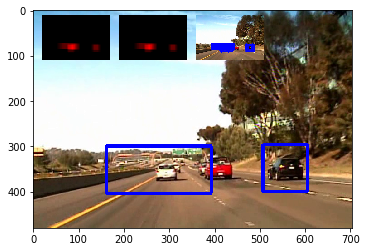



t:  70%|███████   | 211/300 [10:11<04:18,  2.90s/it, now=None]

t:  71%|███████   | 212/300 [10:14<04:13,  2.88s/it, now=None]

Found 105 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (280, 352)
Appending new object with centroid: (557, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  71%|███████   | 213/300 [10:17<04:08,  2.85s/it, now=None]

Found 106 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (280, 352)
old bbox= [[168 300]
 [393 405]]
new bbox= [[168 300]
 [392 404]]
**Found a match**
old centroid= (557, 345)
new centroid= (557, 345)
old bbox= [[511 300]
 [603 391]]
new bbox= [[511 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  71%|███████▏  | 214/300 [10:19<04:03,  2.83s/it, now=None]

Found 98 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (277, 352)
old bbox= [[168 300]
 [392 404]]
new bbox= [[164 300]
 [390 404]]
**Found a match**
old centroid= (557, 345)
new centroid= (557, 345)
old bbox= [[511 300]
 [603 390]]
new bbox= [[511 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  72%|███████▏  | 215/300 [10:22<04:00,  2.83s/it, now=None]

Found 94 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (277, 352)
new centroid= (275, 352)
old bbox= [[164 300]
 [390 404]]
new bbox= [[157 300]
 [393 404]]
**Found a match**
old centroid= (557, 345)
new centroid= (557, 345)
old bbox= [[511 300]
 [603 390]]
new bbox= [[511 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2
Found 131 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (275, 352)
new centroid= (274, 352)
old bbox= [[157 300]
 [393 404]]
new bbox= [[155 300]
 [393 404]]
**Found a match**
old centroid= (557, 345)
new centroid= (555, 348)
old bbox= [[511 300]
 [603 390]]
new bbox= [[506 296]
 [604 400]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (274, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (555, 348) **
Refresh at frame n. 215: newly detected objects 2


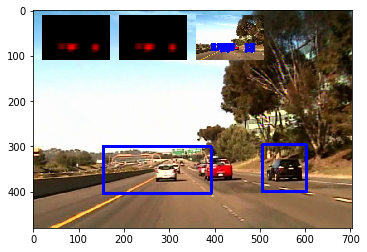



t:  72%|███████▏  | 216/300 [10:25<04:01,  2.88s/it, now=None]

t:  72%|███████▏  | 217/300 [10:28<03:55,  2.84s/it, now=None]

Found 97 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (277, 352)
Appending new object with centroid: (557, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  73%|███████▎  | 218/300 [10:31<03:51,  2.82s/it, now=None]

Found 108 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (277, 352)
new centroid= (277, 352)
old bbox= [[162 300]
 [393 405]]
new bbox= [[161 300]
 [393 404]]
**Found a match**
old centroid= (557, 345)
new centroid= (555, 345)
old bbox= [[511 300]
 [603 391]]
new bbox= [[507 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  73%|███████▎  | 219/300 [10:34<03:47,  2.81s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (277, 352)
new centroid= (273, 352)
old bbox= [[161 300]
 [393 404]]
new bbox= [[151 300]
 [395 404]]
**Found a match**
old centroid= (555, 345)
new centroid= (554, 345)
old bbox= [[507 300]
 [603 390]]
new bbox= [[505 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  73%|███████▎  | 220/300 [10:36<03:44,  2.80s/it, now=None]

Found 104 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (273, 352)
new centroid= (272, 352)
old bbox= [[151 300]
 [395 404]]
new bbox= [[150 300]
 [394 404]]
**Found a match**
old centroid= (554, 345)
new centroid= (553, 345)
old bbox= [[505 300]
 [603 390]]
new bbox= [[504 300]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 2
Found 96 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (272, 352)
new centroid= (271, 352)
old bbox= [[150 300]
 [394 404]]
new bbox= [[149 300]
 [393 404]]
**Found a match**
old centroid= (553, 345)
new centroid= (553, 345)
old bbox= [[504 300]
 [602 390]]
new bbox= [[504 300]
 [602 390]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (271, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (553, 345) **
Refresh at frame n. 220: newly detected objects 2


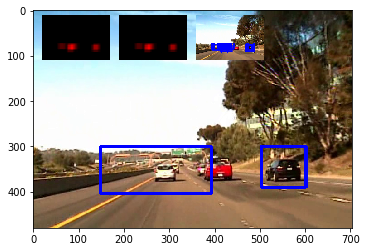



t:  74%|███████▎  | 221/300 [10:39<03:45,  2.86s/it, now=None]

t:  74%|███████▍  | 222/300 [10:42<03:41,  2.84s/it, now=None]

Found 127 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (273, 352)
Appending new object with centroid: (553, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  74%|███████▍  | 223/300 [10:45<03:37,  2.83s/it, now=None]

Found 99 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (273, 352)
new centroid= (275, 352)
old bbox= [[154 300]
 [392 405]]
new bbox= [[156 300]
 [394 404]]
**Found a match**
old centroid= (553, 345)
new centroid= (553, 345)
old bbox= [[504 300]
 [603 391]]
new bbox= [[504 300]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  75%|███████▍  | 224/300 [10:48<03:34,  2.82s/it, now=None]

Found 96 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (197, 331)
**Found a match**
old centroid= (275, 352)
new centroid= (295, 352)
old bbox= [[156 300]
 [394 404]]
new bbox= [[176 300]
 [414 404]]
**Found a match**
old centroid= (553, 345)
new centroid= (553, 345)
old bbox= [[504 300]
 [602 390]]
new bbox= [[504 300]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  75%|███████▌  | 225/300 [10:51<03:30,  2.81s/it, now=None]

Found 119 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (295, 352)
new centroid= (282, 352)
old bbox= [[176 300]
 [414 404]]
new bbox= [[163 300]
 [401 404]]
**Found a match**
old centroid= (553, 345)
new centroid= (551, 345)
old bbox= [[504 300]
 [602 390]]
new bbox= [[499 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 92 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (197, 331)
new centroid= (197, 334)
old bbox= [[156 300]
 [238 363]]
new bbox= [[156 296]
 [238 372]]
**Found a match**
old centroid= (282, 352)
new centroid= (298, 352)
old bbox= [[163 300]
 [401 404]]
new bbox= [[179 300]
 [417 404]]
**Found a match**
old centroid= (551, 345)
new centroid= (554, 345)
old bbox= [[499 300]
 [603 390]]
new bbox= [[502 300]
 [606 390]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (298, 352) **
number of times detec

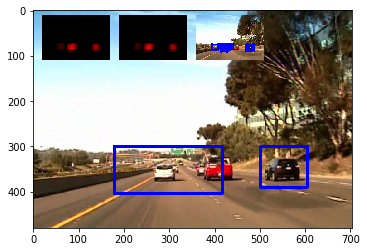



t:  75%|███████▌  | 226/300 [10:54<03:32,  2.87s/it, now=None]

t:  76%|███████▌  | 227/300 [10:56<03:27,  2.85s/it, now=None]

Found 91 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (196, 338)
Appending new object with centroid: (315, 352)
Appending new object with centroid: (554, 345)
previously detected objects= 2
so far newly detected objects= 3




t:  76%|███████▌  | 228/300 [10:59<03:23,  2.83s/it, now=None]

Found 109 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (196, 338)
new centroid= (196, 338)
old bbox= [[154 300]
 [238 377]]
new bbox= [[154 300]
 [238 376]]
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[245 300]
 [385 405]]
new bbox= [[244 300]
 [386 404]]
**Found a match**
old centroid= (554, 345)
new centroid= (552, 345)
old bbox= [[506 300]
 [603 391]]
new bbox= [[499 300]
 [605 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  76%|███████▋  | 229/300 [11:02<03:20,  2.82s/it, now=None]

Found 118 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (315, 352)
new centroid= (292, 352)
old bbox= [[244 300]
 [386 404]]
new bbox= [[170 300]
 [414 404]]
**Found a match**
old centroid= (552, 345)
new centroid= (551, 345)
old bbox= [[499 300]
 [605 390]]
new bbox= [[498 300]
 [604 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  77%|███████▋  | 230/300 [11:05<03:16,  2.81s/it, now=None]

Found 133 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (292, 352)
new centroid= (280, 352)
old bbox= [[170 300]
 [414 404]]
new bbox= [[158 300]
 [402 404]]
**Found a match**
old centroid= (551, 345)
new centroid= (550, 345)
old bbox= [[498 300]
 [604 390]]
new bbox= [[497 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (273, 352)
old bbox= [[158 300]
 [402 404]]
new bbox= [[151 300]
 [395 404]]
**Found a match**
old centroid= (550, 345)
new centroid= (548, 345)
old bbox= [[497 300]
 [603 390]]
new bbox= [[492 300]
 [604 390]]
previously detected objects= 2
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with centroid (273, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (548, 345) **
Refr

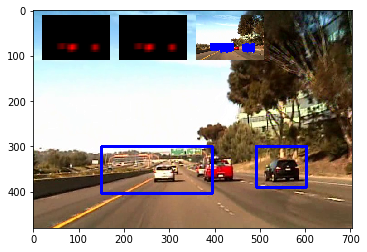



t:  77%|███████▋  | 231/300 [11:08<03:22,  2.94s/it, now=None]

t:  77%|███████▋  | 232/300 [11:11<03:17,  2.91s/it, now=None]

Found 120 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (274, 352)
Appending new object with centroid: (547, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  78%|███████▊  | 233/300 [11:14<03:13,  2.89s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (274, 352)
new centroid= (270, 352)
old bbox= [[156 300]
 [392 405]]
new bbox= [[145 300]
 [395 404]]
**Found a match**
old centroid= (547, 352)
new centroid= (543, 352)
old bbox= [[492 300]
 [603 405]]
new bbox= [[481 300]
 [605 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  78%|███████▊  | 234/300 [11:16<03:09,  2.87s/it, now=None]

Found 134 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 352)
new centroid= (270, 352)
old bbox= [[145 300]
 [395 404]]
new bbox= [[145 300]
 [395 404]]
**Found a match**
old centroid= (543, 352)
new centroid= (546, 352)
old bbox= [[481 300]
 [605 404]]
new bbox= [[484 300]
 [608 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  78%|███████▊  | 235/300 [11:19<03:05,  2.85s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 352)
new centroid= (267, 352)
old bbox= [[145 300]
 [395 404]]
new bbox= [[142 300]
 [392 404]]
**Found a match**
old centroid= (546, 352)
new centroid= (548, 352)
old bbox= [[484 300]
 [608 404]]
new bbox= [[486 300]
 [610 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 127 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (267, 352)
new centroid= (275, 352)
old bbox= [[142 300]
 [392 404]]
new bbox= [[150 300]
 [400 404]]
**Found a match**
old centroid= (548, 352)
new centroid= (549, 348)
old bbox= [[486 300]
 [610 404]]
new bbox= [[487 296]
 [611 400]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (275, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (549, 348) **
Refresh at frame n. 235: newly detected objects 2

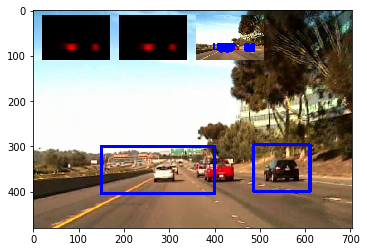



t:  79%|███████▊  | 236/300 [11:22<03:05,  2.89s/it, now=None]

t:  79%|███████▉  | 237/300 [11:25<03:00,  2.87s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (273, 352)
Appending new object with centroid: (549, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  79%|███████▉  | 238/300 [11:28<02:55,  2.83s/it, now=None]

Found 129 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (273, 352)
new centroid= (273, 352)
old bbox= [[154 300]
 [393 405]]
new bbox= [[154 300]
 [392 404]]
**Found a match**
old centroid= (549, 345)
new centroid= (547, 345)
old bbox= [[497 300]
 [602 391]]
new bbox= [[491 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  80%|███████▉  | 239/300 [11:31<02:51,  2.81s/it, now=None]

Found 111 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (273, 352)
new centroid= (291, 352)
old bbox= [[154 300]
 [392 404]]
new bbox= [[172 300]
 [410 404]]
**Found a match**
old centroid= (547, 345)
new centroid= (547, 348)
old bbox= [[491 300]
 [603 390]]
new bbox= [[491 296]
 [603 400]]
previously detected objects= 2
so far newly detected objects= 2




t:  80%|████████  | 240/300 [11:33<02:48,  2.81s/it, now=None]

Found 135 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (291, 352)
new centroid= (294, 352)
old bbox= [[172 300]
 [410 404]]
new bbox= [[175 300]
 [413 404]]
**Found a match**
old centroid= (547, 348)
new centroid= (548, 346)
old bbox= [[491 296]
 [603 400]]
new bbox= [[492 294]
 [604 398]]
previously detected objects= 2
so far newly detected objects= 2
Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (294, 352)
new centroid= (297, 352)
old bbox= [[175 300]
 [413 404]]
new bbox= [[178 300]
 [416 404]]
**Found a match**
old centroid= (548, 346)
new centroid= (547, 349)
old bbox= [[492 294]
 [604 398]]
new bbox= [[491 297]
 [603 401]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (297, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (547, 349) **
Refresh at frame n. 240: newly detected objects 2

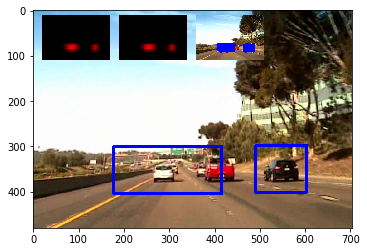



t:  80%|████████  | 241/300 [11:36<02:50,  2.89s/it, now=None]

t:  81%|████████  | 242/300 [11:40<02:54,  3.01s/it, now=None]

Found 124 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (305, 352)
Appending new object with centroid: (547, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  81%|████████  | 243/300 [11:43<02:55,  3.07s/it, now=None]

Found 141 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (305, 352)
new centroid= (287, 352)
old bbox= [[217 300]
 [393 405]]
new bbox= [[165 300]
 [409 404]]
**Found a match**
old centroid= (547, 352)
new centroid= (543, 352)
old bbox= [[492 300]
 [603 405]]
new bbox= [[481 300]
 [605 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  81%|████████▏ | 244/300 [11:46<02:56,  3.16s/it, now=None]

Found 124 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (287, 352)
new centroid= (280, 352)
old bbox= [[165 300]
 [409 404]]
new bbox= [[158 300]
 [402 404]]
**Found a match**
old centroid= (543, 352)
new centroid= (545, 348)
old bbox= [[481 300]
 [605 404]]
new bbox= [[483 296]
 [607 400]]
previously detected objects= 2
so far newly detected objects= 2




t:  82%|████████▏ | 245/300 [11:49<02:49,  3.08s/it, now=None]

Found 132 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (280, 352)
new centroid= (273, 352)
old bbox= [[158 300]
 [402 404]]
new bbox= [[148 300]
 [398 404]]
**Found a match**
old centroid= (545, 348)
new centroid= (545, 346)
old bbox= [[483 296]
 [607 400]]
new bbox= [[483 294]
 [607 398]]
previously detected objects= 2
so far newly detected objects= 2
Found 132 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (273, 352)
new centroid= (269, 352)
old bbox= [[148 300]
 [398 404]]
new bbox= [[143 300]
 [395 404]]
**Found a match**
old centroid= (545, 346)
new centroid= (547, 345)
old bbox= [[483 294]
 [607 398]]
new bbox= [[485 293]
 [609 397]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (269, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (547, 345) **
Refresh at frame n. 245: newly detected objects 2

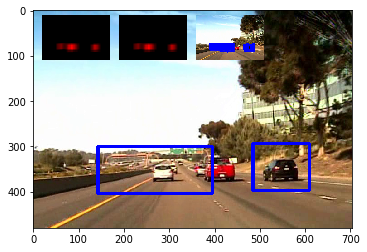



t:  82%|████████▏ | 246/300 [11:52<02:45,  3.07s/it, now=None]

t:  82%|████████▏ | 247/300 [11:55<02:38,  2.99s/it, now=None]

Found 107 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (270, 352)
Appending new object with centroid: (546, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  83%|████████▎ | 248/300 [11:58<02:33,  2.96s/it, now=None]

Found 110 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (179, 331)
**Found a match**
old centroid= (270, 352)
new centroid= (292, 352)
old bbox= [[148 300]
 [393 405]]
new bbox= [[170 300]
 [414 404]]
**Found a match**
old centroid= (546, 345)
new centroid= (534, 348)
old bbox= [[490 300]
 [603 391]]
new bbox= [[454 296]
 [614 400]]
previously detected objects= 2
so far newly detected objects= 3




t:  83%|████████▎ | 249/300 [12:01<02:28,  2.92s/it, now=None]

Found 111 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (292, 352)
new centroid= (303, 352)
old bbox= [[170 300]
 [414 404]]
new bbox= [[181 300]
 [425 404]]
**Found a match**
old centroid= (534, 348)
new centroid= (528, 346)
old bbox= [[454 296]
 [614 400]]
new bbox= [[447 294]
 [609 398]]
previously detected objects= 2
so far newly detected objects= 3




t:  83%|████████▎ | 250/300 [12:04<02:24,  2.89s/it, now=None]

Found 108 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (303, 352)
new centroid= (288, 352)
old bbox= [[181 300]
 [425 404]]
new bbox= [[166 300]
 [410 404]]
**Found a match**
old centroid= (528, 346)
new centroid= (525, 345)
old bbox= [[447 294]
 [609 398]]
new bbox= [[444 293]
 [606 397]]
previously detected objects= 2
so far newly detected objects= 3
Found 107 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (288, 352)
new centroid= (296, 352)
old bbox= [[166 300]
 [410 404]]
new bbox= [[174 300]
 [418 404]]
**Found a match**
old centroid= (525, 345)
new centroid= (536, 345)
old bbox= [[444 293]
 [606 397]]
new bbox= [[455 293]
 [617 397]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (296, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (536, 345) **
number of times detected object appeared:  0
Refr

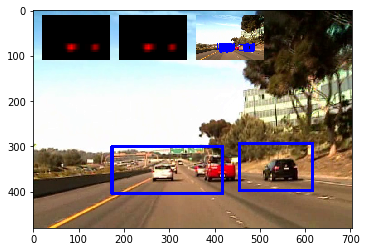



t:  84%|████████▎ | 251/300 [12:07<02:23,  2.93s/it, now=None]

t:  84%|████████▍ | 252/300 [12:09<02:19,  2.90s/it, now=None]

Found 119 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (308, 352)
Appending new object with centroid: (522, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  84%|████████▍ | 253/300 [12:12<02:14,  2.87s/it, now=None]

Found 107 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[224 300]
 [393 405]]
new bbox= [[224 300]
 [392 404]]
**Found a match**
old centroid= (522, 352)
new centroid= (530, 348)
old bbox= [[442 300]
 [603 405]]
new bbox= [[450 296]
 [610 400]]
previously detected objects= 2
so far newly detected objects= 2




t:  85%|████████▍ | 254/300 [12:15<02:15,  2.95s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (308, 352)
new centroid= (310, 352)
old bbox= [[224 300]
 [392 404]]
new bbox= [[223 300]
 [397 404]]
**Found a match**
old centroid= (530, 348)
new centroid= (535, 346)
old bbox= [[450 296]
 [610 400]]
new bbox= [[455 294]
 [615 398]]
previously detected objects= 2
so far newly detected objects= 2




t:  85%|████████▌ | 255/300 [12:18<02:12,  2.95s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (310, 352)
new centroid= (305, 352)
old bbox= [[223 300]
 [397 404]]
new bbox= [[207 300]
 [403 404]]
**Found a match**
old centroid= (535, 346)
new centroid= (539, 349)
old bbox= [[455 294]
 [615 398]]
new bbox= [[459 297]
 [619 401]]
previously detected objects= 2
so far newly detected objects= 2
Found 99 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (305, 352)
new centroid= (308, 352)
old bbox= [[207 300]
 [403 404]]
new bbox= [[210 300]
 [406 404]]
**Found a match**
old centroid= (539, 349)
new centroid= (544, 347)
old bbox= [[459 297]
 [619 401]]
new bbox= [[464 295]
 [624 399]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (308, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (544, 347) **
Refresh at frame n. 255: newly detected objects 2


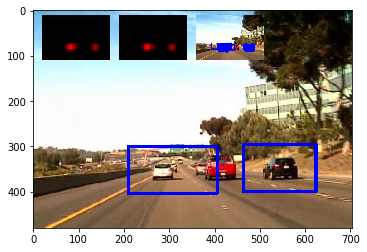



t:  85%|████████▌ | 256/300 [12:22<02:13,  3.04s/it, now=None]

t:  86%|████████▌ | 257/300 [12:24<02:08,  2.99s/it, now=None]

Found 107 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (270, 352)
Appending new object with centroid: (549, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  86%|████████▌ | 258/300 [12:27<02:04,  2.95s/it, now=None]

Found 130 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 352)
new centroid= (270, 352)
old bbox= [[142 300]
 [399 405]]
new bbox= [[142 300]
 [398 404]]
**Found a match**
old centroid= (549, 345)
new centroid= (544, 345)
old bbox= [[497 300]
 [602 391]]
new bbox= [[481 300]
 [607 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  86%|████████▋ | 259/300 [12:30<01:59,  2.93s/it, now=None]

Found 102 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 352)
new centroid= (270, 348)
old bbox= [[142 300]
 [398 404]]
new bbox= [[142 296]
 [398 400]]
**Found a match**
old centroid= (544, 345)
new centroid= (545, 345)
old bbox= [[481 300]
 [607 390]]
new bbox= [[482 300]
 [608 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  87%|████████▋ | 260/300 [12:33<01:56,  2.91s/it, now=None]

Found 123 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (270, 348)
new centroid= (268, 350)
old bbox= [[142 296]
 [398 400]]
new bbox= [[140 298]
 [396 402]]
**Found a match**
old centroid= (545, 345)
new centroid= (542, 345)
old bbox= [[482 300]
 [608 390]]
new bbox= [[479 300]
 [605 390]]
previously detected objects= 2
so far newly detected objects= 2
Found 134 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (268, 350)
new centroid= (267, 347)
old bbox= [[140 298]
 [396 402]]
new bbox= [[139 295]
 [395 399]]
**Found a match**
old centroid= (542, 345)
new centroid= (540, 345)
old bbox= [[479 300]
 [605 390]]
new bbox= [[477 300]
 [603 390]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (267, 347) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (540, 345) **
Refresh at frame n. 260: newly detected objects 2

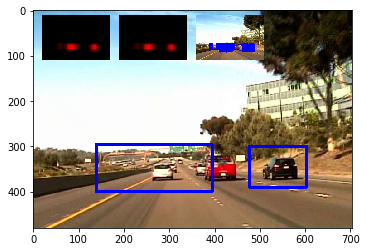



t:  87%|████████▋ | 261/300 [12:36<01:55,  2.96s/it, now=None]

t:  87%|████████▋ | 262/300 [12:39<01:51,  2.93s/it, now=None]

Found 102 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (267, 352)
Appending new object with centroid: (547, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  88%|████████▊ | 263/300 [12:42<01:47,  2.91s/it, now=None]

Found 102 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (179, 331)
**Found a match**
old centroid= (267, 352)
new centroid= (289, 352)
old bbox= [[142 300]
 [393 405]]
new bbox= [[164 300]
 [414 404]]
**Found a match**
old centroid= (547, 345)
new centroid= (547, 345)
old bbox= [[492 300]
 [602 391]]
new bbox= [[492 300]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  88%|████████▊ | 264/300 [12:45<01:44,  2.89s/it, now=None]

Found 129 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (289, 352)
new centroid= (277, 352)
old bbox= [[164 300]
 [414 404]]
new bbox= [[151 300]
 [403 404]]
**Found a match**
old centroid= (547, 345)
new centroid= (548, 345)
old bbox= [[492 300]
 [602 390]]
new bbox= [[493 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  88%|████████▊ | 265/300 [12:48<01:40,  2.87s/it, now=None]

Found 108 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (277, 352)
new centroid= (272, 352)
old bbox= [[151 300]
 [403 404]]
new bbox= [[146 300]
 [398 404]]
**Found a match**
old centroid= (548, 345)
new centroid= (549, 345)
old bbox= [[493 300]
 [603 390]]
new bbox= [[494 300]
 [604 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 122 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (272, 352)
new centroid= (267, 352)
old bbox= [[146 300]
 [398 404]]
new bbox= [[138 300]
 [396 404]]
**Found a match**
old centroid= (549, 345)
new centroid= (549, 345)
old bbox= [[494 300]
 [604 390]]
new bbox= [[494 300]
 [604 390]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (267, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (549, 345) **
number of times detected object appeared:  0
Refr

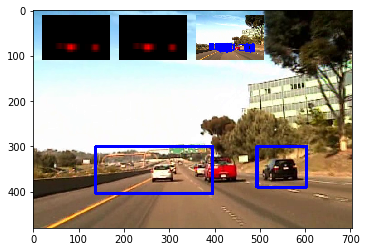



t:  89%|████████▊ | 266/300 [12:51<01:39,  2.92s/it, now=None]

t:  89%|████████▉ | 267/300 [12:53<01:35,  2.89s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (266, 352)
Appending new object with centroid: (522, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  89%|████████▉ | 268/300 [12:56<01:32,  2.88s/it, now=None]

Found 111 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (266, 352)
new centroid= (268, 352)
old bbox= [[140 300]
 [393 405]]
new bbox= [[142 300]
 [394 404]]
**Found a match**
old centroid= (522, 345)
new centroid= (520, 345)
old bbox= [[442 300]
 [603 391]]
new bbox= [[440 300]
 [600 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  90%|████████▉ | 269/300 [12:59<01:29,  2.87s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (179, 331)
**Found a match**
old centroid= (268, 352)
new centroid= (291, 352)
old bbox= [[142 300]
 [394 404]]
new bbox= [[165 300]
 [417 404]]
**Found a match**
old centroid= (520, 345)
new centroid= (519, 345)
old bbox= [[440 300]
 [600 390]]
new bbox= [[439 300]
 [599 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  90%|█████████ | 270/300 [13:02<01:26,  2.87s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (291, 352)
new centroid= (279, 352)
old bbox= [[165 300]
 [417 404]]
new bbox= [[153 300]
 [405 404]]
**Found a match**
old centroid= (519, 345)
new centroid= (520, 348)
old bbox= [[439 300]
 [599 390]]
new bbox= [[440 296]
 [600 400]]
previously detected objects= 2
so far newly detected objects= 3
Found 98 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (179, 331)
new centroid= (179, 331)
old bbox= [[142 300]
 [217 363]]
new bbox= [[140 300]
 [218 362]]
**Found a match**
old centroid= (279, 352)
new centroid= (295, 352)
old bbox= [[153 300]
 [405 404]]
new bbox= [[169 300]
 [421 404]]
**Found a match**
old centroid= (520, 348)
new centroid= (521, 346)
old bbox= [[440 296]
 [600 400]]
new bbox= [[441 294]
 [601 398]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (295, 352) **
number of times detec

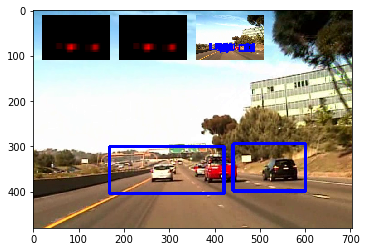



t:  90%|█████████ | 271/300 [13:05<01:25,  2.94s/it, now=None]

t:  91%|█████████ | 272/300 [13:08<01:23,  2.98s/it, now=None]

Found 99 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (172, 331)
Appending new object with centroid: (290, 352)
Appending new object with centroid: (522, 345)
previously detected objects= 2
so far newly detected objects= 3




t:  91%|█████████ | 273/300 [13:11<01:19,  2.96s/it, now=None]

Found 127 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (290, 352)
new centroid= (295, 352)
old bbox= [[217 300]
 [364 405]]
new bbox= [[204 300]
 [386 404]]
**Found a match**
old centroid= (522, 345)
new centroid= (522, 345)
old bbox= [[442 300]
 [603 391]]
new bbox= [[442 300]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  91%|█████████▏| 274/300 [13:14<01:16,  2.92s/it, now=None]

Found 81 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (172, 331)
new centroid= (174, 331)
old bbox= [[134 300]
 [211 363]]
new bbox= [[136 300]
 [212 362]]
**Found a match**
old centroid= (295, 352)
new centroid= (295, 352)
old bbox= [[204 300]
 [386 404]]
new bbox= [[204 300]
 [386 404]]
**Found a match**
old centroid= (522, 345)
new centroid= (537, 345)
old bbox= [[442 300]
 [602 390]]
new bbox= [[457 300]
 [617 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  92%|█████████▏| 275/300 [13:17<01:12,  2.91s/it, now=None]

Found 98 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (174, 331)
new centroid= (175, 331)
old bbox= [[136 300]
 [212 362]]
new bbox= [[137 300]
 [213 362]]
**Found a match**
old centroid= (295, 352)
new centroid= (303, 352)
old bbox= [[204 300]
 [386 404]]
new bbox= [[212 300]
 [394 404]]
**Found a match**
old centroid= (537, 345)
new centroid= (535, 345)
old bbox= [[457 300]
 [617 390]]
new bbox= [[455 300]
 [615 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 118 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (303, 352)
new centroid= (284, 352)
old bbox= [[212 300]
 [394 404]]
new bbox= [[158 300]
 [410 404]]
**Found a match**
old centroid= (535, 345)
new centroid= (532, 345)
old bbox= [[455 300]
 [615 390]]
new bbox= [[452 300]
 [612 390]]
previously detected objects= 2
number of times detected object appeared:  2
number of times detected object appeared:  4
** Adding similar object to one with

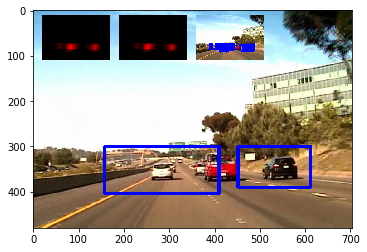



t:  92%|█████████▏| 276/300 [13:20<01:11,  2.96s/it, now=None]

t:  92%|█████████▏| 277/300 [13:23<01:07,  2.93s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (176, 331)
Appending new object with centroid: (309, 352)
Appending new object with centroid: (526, 345)
previously detected objects= 2
so far newly detected objects= 3




t:  93%|█████████▎| 278/300 [13:26<01:04,  2.91s/it, now=None]

Found 89 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (176, 331)
new centroid= (176, 331)
old bbox= [[142 300]
 [211 363]]
new bbox= [[142 300]
 [210 362]]
**Found a match**
old centroid= (309, 352)
new centroid= (307, 348)
old bbox= [[226 300]
 [393 405]]
new bbox= [[220 296]
 [394 400]]
**Found a match**
old centroid= (526, 345)
new centroid= (529, 348)
old bbox= [[450 300]
 [602 391]]
new bbox= [[453 303]
 [605 393]]
previously detected objects= 2
so far newly detected objects= 3




t:  93%|█████████▎| 279/300 [13:28<01:00,  2.90s/it, now=None]

Found 121 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (176, 331)
new centroid= (176, 334)
old bbox= [[142 300]
 [210 362]]
new bbox= [[133 296]
 [219 372]]
**Found a match**
old centroid= (307, 348)
new centroid= (309, 350)
old bbox= [[220 296]
 [394 400]]
new bbox= [[222 298]
 [396 402]]
**Found a match**
old centroid= (529, 348)
new centroid= (527, 346)
old bbox= [[453 303]
 [605 393]]
new bbox= [[450 301]
 [604 391]]
previously detected objects= 2
so far newly detected objects= 3




t:  93%|█████████▎| 280/300 [13:31<00:57,  2.88s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (309, 350)
new centroid= (286, 351)
old bbox= [[222 298]
 [396 402]]
new bbox= [[156 299]
 [416 403]]
**Found a match**
old centroid= (527, 346)
new centroid= (526, 349)
old bbox= [[450 301]
 [604 391]]
new bbox= [[449 304]
 [603 394]]
previously detected objects= 2
so far newly detected objects= 3
Found 111 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (176, 334)
new centroid= (175, 336)
old bbox= [[133 296]
 [219 372]]
new bbox= [[132 298]
 [218 374]]
**Found a match**
old centroid= (286, 351)
new centroid= (298, 351)
old bbox= [[156 299]
 [416 403]]
new bbox= [[168 299]
 [428 403]]
**Found a match**
old centroid= (526, 349)
new centroid= (526, 347)
old bbox= [[449 304]
 [603 394]]
new bbox= [[449 302]
 [603 392]]
previously detected objects= 2
number of times detected object appeared:  3
** Adding similar object to one with centroid (175, 336) **
number of times dete

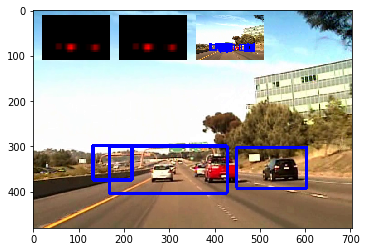



t:  94%|█████████▎| 281/300 [13:34<00:55,  2.94s/it, now=None]

t:  94%|█████████▍| 282/300 [13:37<00:52,  2.91s/it, now=None]

Found 136 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (263, 352)
Appending new object with centroid: (525, 345)
Appending new object with centroid: (70, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  94%|█████████▍| 283/300 [13:40<00:49,  2.89s/it, now=None]

Found 107 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (263, 352)
new centroid= (285, 352)
old bbox= [[133 300]
 [393 405]]
new bbox= [[155 300]
 [415 404]]
**Found a match**
old centroid= (525, 345)
new centroid= (537, 348)
old bbox= [[448 300]
 [603 391]]
new bbox= [[460 303]
 [614 393]]
**Found a match**
old centroid= (70, 359)
new centroid= (61, 359)
old bbox= [[ 28 328]
 [112 391]]
new bbox= [[ 19 328]
 [103 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  95%|█████████▍| 284/300 [13:43<00:46,  2.88s/it, now=None]

Found 97 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (178, 331)
**Found a match**
old centroid= (285, 352)
new centroid= (293, 352)
old bbox= [[155 300]
 [415 404]]
new bbox= [[163 300]
 [423 404]]
**Found a match**
old centroid= (537, 348)
new centroid= (538, 346)
old bbox= [[460 303]
 [614 393]]
new bbox= [[461 301]
 [615 391]]
previously detected objects= 3
so far newly detected objects= 4




t:  95%|█████████▌| 285/300 [13:46<00:43,  2.88s/it, now=None]

Found 114 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (293, 352)
new centroid= (269, 352)
old bbox= [[163 300]
 [423 404]]
new bbox= [[139 300]
 [399 404]]
**Found a match**
old centroid= (538, 346)
new centroid= (539, 349)
old bbox= [[461 301]
 [615 391]]
new bbox= [[462 297]
 [616 401]]
previously detected objects= 3
so far newly detected objects= 4
Found 99 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (178, 331)
new centroid= (177, 334)
old bbox= [[147 300]
 [210 363]]
new bbox= [[135 296]
 [219 372]]
**Found a match**
old centroid= (269, 352)
new centroid= (285, 352)
old bbox= [[139 300]
 [399 404]]
new bbox= [[155 300]
 [415 404]]
**Found a match**
old centroid= (539, 349)
new centroid= (539, 347)
old bbox= [[462 297]
 [616 401]]
new bbox= [[462 295]
 [616 399]]
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one with centroid (285, 352) **
number of times detec

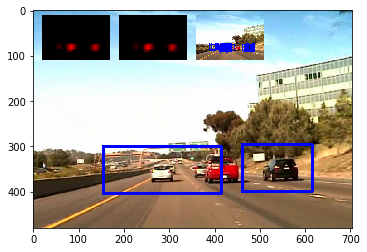



t:  95%|█████████▌| 286/300 [13:49<00:41,  2.95s/it, now=None]

t:  96%|█████████▌| 287/300 [13:52<00:38,  2.93s/it, now=None]

Found 116 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (172, 338)
Appending new object with centroid: (298, 352)
Appending new object with centroid: (550, 345)
previously detected objects= 2
so far newly detected objects= 3




t:  96%|█████████▌| 288/300 [13:55<00:34,  2.91s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (298, 352)
new centroid= (278, 352)
old bbox= [[226 300]
 [371 405]]
new bbox= [[145 300]
 [411 404]]
**Found a match**
old centroid= (550, 345)
new centroid= (545, 348)
old bbox= [[497 300]
 [603 391]]
new bbox= [[483 296]
 [607 400]]
previously detected objects= 2
so far newly detected objects= 3




t:  96%|█████████▋| 289/300 [13:57<00:31,  2.90s/it, now=None]

Found 126 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (172, 338)
new centroid= (174, 338)
old bbox= [[128 300]
 [217 377]]
new bbox= [[130 300]
 [218 376]]
**Found a match**
old centroid= (278, 352)
new centroid= (293, 352)
old bbox= [[145 300]
 [411 404]]
new bbox= [[160 300]
 [426 404]]
**Found a match**
old centroid= (545, 348)
new centroid= (535, 346)
old bbox= [[483 296]
 [607 400]]
new bbox= [[459 294]
 [611 398]]
previously detected objects= 2
so far newly detected objects= 3




t:  97%|█████████▋| 290/300 [14:00<00:28,  2.89s/it, now=None]

Found 122 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (174, 338)
new centroid= (171, 338)
old bbox= [[130 300]
 [218 376]]
new bbox= [[127 300]
 [215 376]]
**Found a match**
old centroid= (293, 352)
new centroid= (301, 352)
old bbox= [[160 300]
 [426 404]]
new bbox= [[168 300]
 [434 404]]
**Found a match**
old centroid= (535, 346)
new centroid= (530, 345)
old bbox= [[459 294]
 [611 398]]
new bbox= [[454 293]
 [606 397]]
previously detected objects= 2
so far newly detected objects= 3
Found 129 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (171, 338)
new centroid= (169, 338)
old bbox= [[127 300]
 [215 376]]
new bbox= [[125 300]
 [213 376]]
**Found a match**
old centroid= (301, 352)
new centroid= (303, 348)
old bbox= [[168 300]
 [434 404]]
new bbox= [[170 296]
 [436 400]]
**Found a match**
old centroid= (530, 345)
new centroid= (527, 345)
old bbox= [[454 293]
 [606 397]]
new bbox= [[450 293]
 [604 397]]
previously detected ob

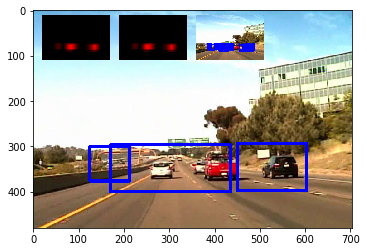



t:  97%|█████████▋| 291/300 [14:03<00:26,  2.94s/it, now=None]

t:  97%|█████████▋| 292/300 [14:06<00:23,  2.92s/it, now=None]

Found 96 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (165, 331)
Appending new object with centroid: (309, 345)
Appending new object with centroid: (525, 345)
previously detected objects= 3
so far newly detected objects= 3




t:  98%|█████████▊| 293/300 [14:09<00:20,  2.89s/it, now=None]

Found 98 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (165, 331)
new centroid= (165, 331)
old bbox= [[128 300]
 [203 363]]
new bbox= [[128 300]
 [202 362]]
**Found a match**
old centroid= (309, 345)
new centroid= (305, 345)
old bbox= [[226 300]
 [392 391]]
new bbox= [[221 300]
 [389 390]]
**Found a match**
old centroid= (525, 345)
new centroid= (532, 345)
old bbox= [[448 300]
 [603 391]]
new bbox= [[455 300]
 [609 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  98%|█████████▊| 294/300 [14:12<00:17,  2.87s/it, now=None]

Found 113 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (305, 345)
new centroid= (282, 345)
old bbox= [[221 300]
 [389 390]]
new bbox= [[149 300]
 [415 390]]
**Found a match**
old centroid= (532, 345)
new centroid= (528, 345)
old bbox= [[455 300]
 [609 390]]
new bbox= [[451 300]
 [605 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  98%|█████████▊| 295/300 [14:15<00:14,  2.86s/it, now=None]

Found 74 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (282, 345)
new centroid= (300, 345)
old bbox= [[149 300]
 [415 390]]
new bbox= [[167 300]
 [433 390]]
**Found a match**
old centroid= (528, 345)
new centroid= (537, 341)
old bbox= [[451 300]
 [605 390]]
new bbox= [[460 296]
 [614 386]]
previously detected objects= 3
so far newly detected objects= 3
Found 78 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (300, 345)
new centroid= (308, 345)
old bbox= [[167 300]
 [433 390]]
new bbox= [[175 300]
 [441 390]]
**Found a match**
old centroid= (537, 341)
new centroid= (540, 339)
old bbox= [[460 296]
 [614 386]]
new bbox= [[463 294]
 [617 384]]
previously detected objects= 3
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with centroid (308, 345) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (540, 339) **
Refres

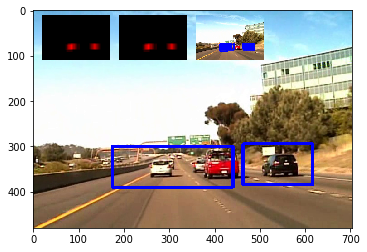



t:  99%|█████████▊| 296/300 [14:18<00:11,  2.91s/it, now=None]

t:  99%|█████████▉| 297/300 [14:21<00:08,  2.89s/it, now=None]

Found 104 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (165, 331)
Appending new object with centroid: (315, 345)
Appending new object with centroid: (540, 345)
previously detected objects= 2
so far newly detected objects= 3




t:  99%|█████████▉| 298/300 [14:24<00:05,  2.89s/it, now=None]

Found 79 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (165, 331)
new centroid= (161, 331)
old bbox= [[ 98 300]
 [233 363]]
new bbox= [[ 94 300]
 [228 362]]
**Found a match**
old centroid= (315, 345)
new centroid= (317, 345)
old bbox= [[238 300]
 [393 391]]
new bbox= [[240 300]
 [394 390]]
**Found a match**
old centroid= (540, 345)
new centroid= (543, 345)
old bbox= [[478 300]
 [603 391]]
new bbox= [[481 300]
 [605 390]]
previously detected objects= 2
so far newly detected objects= 3




t: 100%|█████████▉| 299/300 [14:26<00:02,  2.88s/it, now=None]

Found 77 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (161, 331)
new centroid= (161, 331)
old bbox= [[ 94 300]
 [228 362]]
new bbox= [[ 94 300]
 [228 362]]
**Found a match**
old centroid= (317, 345)
new centroid= (317, 345)
old bbox= [[240 300]
 [394 390]]
new bbox= [[240 300]
 [394 390]]
**Found a match**
old centroid= (543, 345)
new centroid= (546, 345)
old bbox= [[481 300]
 [605 390]]
new bbox= [[484 300]
 [608 390]]
previously detected objects= 2
so far newly detected objects= 3




t: 100%|██████████| 300/300 [14:29<00:00,  2.86s/it, now=None]

Found 91 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (161, 331)
new centroid= (159, 331)
old bbox= [[ 94 300]
 [228 362]]
new bbox= [[ 92 300]
 [226 362]]
**Found a match**
old centroid= (317, 345)
new centroid= (311, 345)
old bbox= [[240 300]
 [394 390]]
new bbox= [[224 300]
 [398 390]]
**Found a match**
old centroid= (546, 345)
new centroid= (544, 345)
old bbox= [[484 300]
 [608 390]]
new bbox= [[482 300]
 [606 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 94 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (159, 331)
new centroid= (158, 334)
old bbox= [[ 92 300]
 [226 362]]
new bbox= [[ 91 296]
 [225 372]]
**Found a match**
old centroid= (311, 345)
new centroid= (308, 345)
old bbox= [[224 300]
 [398 390]]
new bbox= [[221 300]
 [395 390]]
**Found a match**
old centroid= (544, 345)
new centroid= (547, 345)
old bbox= [[482 300]
 [606 390]]
new bbox= [[485 300]
 [609 390]]
previously detected obje

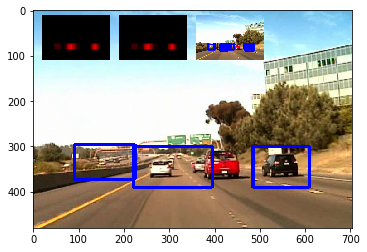



                                                              
t:   2%|▏         | 5/300 [21:32<13:02,  2.65s/it, now=None] 
                                                            ]
t:  24%|██▎       | 71/300 [19:29<07:52,  2.06s/it, now=None]

Moviepy - Done !
Moviepy - video ready output_videos/april21.mp4
CPU times: user 15min 31s, sys: 2.27 s, total: 15min 33s
Wall time: 14min 33s


In [297]:
detector = VehicleDetectorWithMemory(better_classifier, simple_classifier, normaliser, color_space="YCrCb", save_frame=False, 
                                     frame_sampling_rate=5, threshold=2, min_detection_count=3, 
                                     debug_imgs=True, cell_overlap=1)

clip1 = VideoFileClip(project_video_sample_path)
project_video_clip = clip1.fl_image(detector.process_image) 
%time project_video_clip.write_videofile(project_video_sample_output_path, audio=False)

Found 212 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (155, 331)
Appending new object with centroid: (428, 352)
previously detected objects= 0
so far newly detected objects= 2


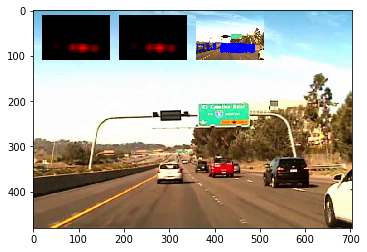

                                                            
t:   2%|▏         | 5/300 [30:15<13:02,  2.65s/it, now=None] 
                                                            ]
t:  24%|██▎       | 71/300 [28:13<07:52,  2.06s/it, now=None]

t:   0%|          | 0/300 [00:00<?, ?it/s, now=None]

Moviepy - Building video output_videos/april21.mp4.
Moviepy - Writing video output_videos/april21.mp4





t:   1%|          | 2/300 [00:01<02:54,  1.71it/s, now=None]

Found 212 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (155, 331)
new centroid= (155, 331)
old bbox= [[114 300]
 [196 363]]
new bbox= [[114 300]
 [196 362]]
**Found a match**
old centroid= (428, 352)
new centroid= (428, 352)
old bbox= [[254 300]
 [603 405]]
new bbox= [[254 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 2




t:   1%|          | 3/300 [00:02<03:36,  1.37it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (428, 352)
new centroid= (428, 352)
old bbox= [[254 300]
 [602 404]]
new bbox= [[254 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 2




t:   1%|▏         | 4/300 [00:03<03:58,  1.24it/s, now=None]

Found 207 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (155, 331)
new centroid= (149, 331)
old bbox= [[114 300]
 [196 362]]
new bbox= [[108 300]
 [190 362]]
**Found a match**
old centroid= (428, 352)
new centroid= (428, 352)
old bbox= [[254 300]
 [602 404]]
new bbox= [[254 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 2




t:   2%|▏         | 5/300 [00:03<03:54,  1.26it/s, now=None]

Found 219 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (149, 331)
new centroid= (144, 331)
old bbox= [[108 300]
 [190 362]]
new bbox= [[103 300]
 [185 362]]
**Found a match**
old centroid= (428, 352)
new centroid= (427, 352)
old bbox= [[254 300]
 [602 404]]
new bbox= [[252 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 2
Found 225 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (144, 331)
new centroid= (140, 331)
old bbox= [[103 300]
 [185 362]]
new bbox= [[ 99 300]
 [181 362]]
**Found a match**
old centroid= (427, 352)
new centroid= (427, 352)
old bbox= [[252 300]
 [602 404]]
new bbox= [[252 300]
 [602 404]]
previously detected objects= 0
number of times detected object appeared:  4
** Adding similar object to one with centroid (140, 331) **
number of times detected object appeared:  5
** Adding similar object to one with centroid (427, 352) **
Refresh at frame n. 5: newly detected objects 2


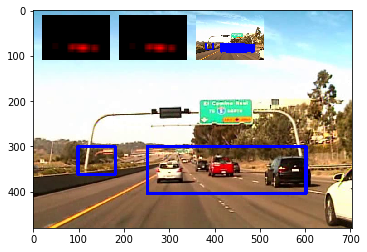



t:   2%|▏         | 6/300 [00:04<04:10,  1.17it/s, now=None]

t:   2%|▏         | 7/300 [00:05<04:02,  1.21it/s, now=None]

Found 224 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (136, 338)
Appending new object with centroid: (427, 352)
previously detected objects= 2
so far newly detected objects= 2




t:   3%|▎         | 8/300 [00:06<03:54,  1.25it/s, now=None]

Found 241 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (136, 338)
new centroid= (138, 338)
old bbox= [[ 70 300]
 [203 377]]
new bbox= [[ 72 300]
 [204 376]]
**Found a match**
old centroid= (427, 352)
new centroid= (415, 352)
old bbox= [[252 300]
 [603 405]]
new bbox= [[216 300]
 [614 404]]
previously detected objects= 2
so far newly detected objects= 2




t:   3%|▎         | 9/300 [00:07<03:47,  1.28it/s, now=None]

Found 196 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (415, 352)
new centroid= (421, 352)
old bbox= [[216 300]
 [614 404]]
new bbox= [[222 300]
 [620 404]]
**Found a match**
old centroid= (138, 338)
new centroid= (137, 341)
old bbox= [[ 72 300]
 [204 376]]
new bbox= [[ 71 303]
 [203 379]]
previously detected objects= 2
so far newly detected objects= 2




t:   3%|▎         | 10/300 [00:07<03:43,  1.30it/s, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (137, 341)
new centroid= (140, 336)
old bbox= [[ 71 303]
 [203 379]]
new bbox= [[ 74 298]
 [206 374]]
**Found a match**
old centroid= (421, 352)
new centroid= (424, 352)
old bbox= [[222 300]
 [620 404]]
new bbox= [[225 300]
 [623 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 232 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (140, 336)
new centroid= (135, 340)
old bbox= [[ 74 298]
 [206 374]]
new bbox= [[ 69 295]
 [201 385]]
**Found a match**
old centroid= (424, 352)
new centroid= (425, 352)
old bbox= [[225 300]
 [623 404]]
new bbox= [[226 300]
 [624 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (135, 340) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (425, 352) **
Refresh at frame n. 10: newly detected objects 2


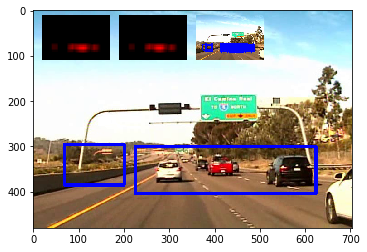



t:   4%|▎         | 11/300 [00:08<03:56,  1.22it/s, now=None]

t:   4%|▍         | 12/300 [00:09<03:50,  1.25it/s, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (130, 331)
Appending new object with centroid: (427, 352)
previously detected objects= 2
so far newly detected objects= 2




t:   4%|▍         | 13/300 [00:10<03:44,  1.28it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (427, 352)
new centroid= (427, 352)
old bbox= [[252 300]
 [603 405]]
new bbox= [[252 300]
 [602 404]]
previously detected objects= 2
so far newly detected objects= 2




t:   5%|▍         | 14/300 [00:11<03:41,  1.29it/s, now=None]

Found 208 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (427, 352)
new centroid= (427, 352)
old bbox= [[252 300]
 [602 404]]
new bbox= [[252 300]
 [602 404]]
**Found a match**
old centroid= (130, 331)
new centroid= (126, 341)
old bbox= [[100 300]
 [161 363]]
new bbox= [[ 94 303]
 [158 379]]
previously detected objects= 2
so far newly detected objects= 2




t:   5%|▌         | 15/300 [00:11<03:37,  1.31it/s, now=None]

Found 198 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (427, 352)
new centroid= (425, 352)
old bbox= [[252 300]
 [602 404]]
new bbox= [[247 300]
 [603 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 188 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (425, 352)
new centroid= (399, 352)
old bbox= [[247 300]
 [603 404]]
new bbox= [[221 300]
 [577 404]]
Appending new object with centroid: (557, 352)
previously detected objects= 2
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with centroid (399, 352) **
number of times detected object appeared:  0
Refresh at frame n. 15: newly detected objects 1


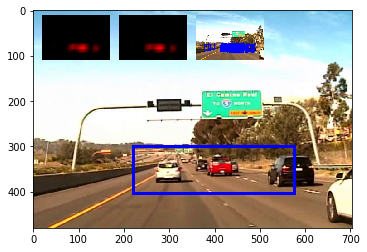



t:   5%|▌         | 16/300 [00:12<03:54,  1.21it/s, now=None]

t:   6%|▌         | 17/300 [00:13<03:47,  1.25it/s, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (424, 352)
Appending new object with centroid: (109, 345)
previously detected objects= 1
so far newly detected objects= 2




t:   6%|▌         | 18/300 [00:14<03:42,  1.27it/s, now=None]

Found 185 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 345)
new centroid= (133, 338)
old bbox= [[ 78 314]
 [141 377]]
new bbox= [[102 307]
 [164 369]]
**Found a match**
old centroid= (424, 352)
new centroid= (399, 352)
old bbox= [[245 300]
 [603 405]]
new bbox= [[220 300]
 [578 404]]
Appending new object with centroid: (557, 352)
previously detected objects= 1
so far newly detected objects= 3




t:   6%|▋         | 19/300 [00:15<03:36,  1.30it/s, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (399, 352)
new centroid= (413, 352)
old bbox= [[220 300]
 [578 404]]
new bbox= [[234 300]
 [592 404]]
previously detected objects= 1
so far newly detected objects= 3




t:   7%|▋         | 20/300 [00:15<03:32,  1.32it/s, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (413, 352)
new centroid= (418, 352)
old bbox= [[234 300]
 [592 404]]
new bbox= [[239 300]
 [597 404]]
**Found a match**
old centroid= (133, 338)
new centroid= (110, 341)
old bbox= [[102 307]
 [164 369]]
new bbox= [[ 58 310]
 [162 372]]
previously detected objects= 1
so far newly detected objects= 3
Found 195 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (418, 352)
new centroid= (421, 352)
old bbox= [[239 300]
 [597 404]]
new bbox= [[242 300]
 [600 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (421, 352) **
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 20: newly detected objects 1


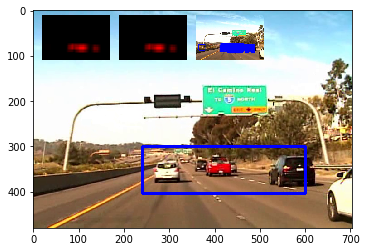



t:   7%|▋         | 21/300 [00:16<03:47,  1.23it/s, now=None]

t:   7%|▋         | 22/300 [00:17<03:43,  1.24it/s, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (428, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   8%|▊         | 23/300 [00:18<03:39,  1.26it/s, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (428, 352)
new centroid= (426, 352)
old bbox= [[254 300]
 [603 405]]
new bbox= [[247 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   8%|▊         | 24/300 [00:19<03:33,  1.29it/s, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (426, 352)
new centroid= (425, 352)
old bbox= [[247 300]
 [605 404]]
new bbox= [[246 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   8%|▊         | 25/300 [00:19<03:28,  1.32it/s, now=None]

Found 180 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (425, 352)
new centroid= (423, 352)
old bbox= [[246 300]
 [604 404]]
new bbox= [[242 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 228 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (151, 331)
**Found a match**
old centroid= (423, 352)
new centroid= (420, 352)
old bbox= [[242 300]
 [604 404]]
new bbox= [[235 300]
 [605 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (420, 352) **
number of times detected object appeared:  0
Refresh at frame n. 25: newly detected objects 1


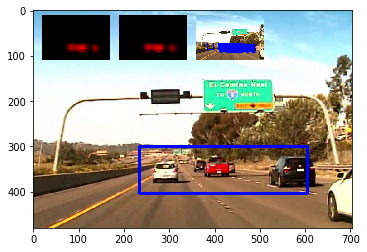



t:   9%|▊         | 26/300 [00:20<03:43,  1.23it/s, now=None]

t:   9%|▉         | 27/300 [00:21<03:36,  1.26it/s, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (424, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   9%|▉         | 28/300 [00:22<03:31,  1.29it/s, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (424, 352)
new centroid= (424, 352)
old bbox= [[245 300]
 [603 405]]
new bbox= [[245 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  10%|▉         | 29/300 [00:22<03:27,  1.30it/s, now=None]

Found 139 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (424, 352)
new centroid= (422, 352)
old bbox= [[245 300]
 [603 404]]
new bbox= [[241 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  10%|█         | 30/300 [00:23<03:26,  1.31it/s, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (422, 352)
new centroid= (419, 352)
old bbox= [[241 300]
 [603 404]]
new bbox= [[234 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (419, 352)
new centroid= (420, 352)
old bbox= [[234 300]
 [604 404]]
new bbox= [[235 300]
 [605 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (420, 352) **
Refresh at frame n. 30: newly detected objects 1


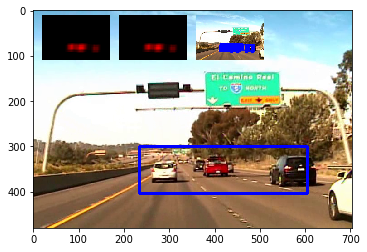



t:  10%|█         | 31/300 [00:24<03:39,  1.22it/s, now=None]

t:  11%|█         | 32/300 [00:25<03:34,  1.25it/s, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (144, 331)
Appending new object with centroid: (414, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  11%|█         | 33/300 [00:26<03:27,  1.29it/s, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (414, 352)
new centroid= (415, 352)
old bbox= [[226 300]
 [603 405]]
new bbox= [[227 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  11%|█▏        | 34/300 [00:26<03:23,  1.31it/s, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (415, 352)
new centroid= (389, 352)
old bbox= [[227 300]
 [603 404]]
new bbox= [[201 300]
 [577 404]]
Appending new object with centroid: (557, 359)
previously detected objects= 1
so far newly detected objects= 3




t:  12%|█▏        | 35/300 [00:27<03:21,  1.32it/s, now=None]

Found 236 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (144, 331)
new centroid= (145, 331)
old bbox= [[114 300]
 [175 363]]
new bbox= [[104 300]
 [186 362]]
**Found a match**
old centroid= (389, 352)
new centroid= (405, 352)
old bbox= [[201 300]
 [577 404]]
new bbox= [[217 300]
 [593 404]]
previously detected objects= 1
so far newly detected objects= 3
Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (145, 331)
new centroid= (148, 331)
old bbox= [[104 300]
 [186 362]]
new bbox= [[107 300]
 [189 362]]
**Found a match**
old centroid= (405, 352)
new centroid= (414, 352)
old bbox= [[217 300]
 [593 404]]
new bbox= [[226 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  2
number of times detected object appeared:  4
** Adding similar object to one with centroid (414, 352) **
number of times detected object appeared:  0
Refresh at frame n. 35: newly detected objects 1


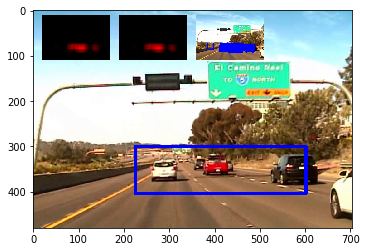



t:  12%|█▏        | 36/300 [00:28<03:53,  1.13it/s, now=None]

t:  12%|█▏        | 37/300 [00:29<03:45,  1.17it/s, now=None]

Found 192 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (145, 331)
Appending new object with centroid: (365, 352)
Appending new object with centroid: (550, 359)
previously detected objects= 1
so far newly detected objects= 3




t:  13%|█▎        | 38/300 [00:30<03:37,  1.21it/s, now=None]

Found 226 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 352)
new centroid= (392, 352)
old bbox= [[240 300]
 [491 405]]
new bbox= [[210 300]
 [574 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  13%|█▎        | 39/300 [00:31<03:31,  1.23it/s, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (392, 352)
new centroid= (406, 352)
old bbox= [[210 300]
 [574 404]]
new bbox= [[224 300]
 [588 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  13%|█▎        | 40/300 [00:31<03:28,  1.25it/s, now=None]

Found 166 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (406, 352)
new centroid= (387, 352)
old bbox= [[224 300]
 [588 404]]
new bbox= [[205 300]
 [569 404]]
**Found a match**
old centroid= (550, 359)
new centroid= (557, 355)
old bbox= [[497 314]
 [603 405]]
new bbox= [[504 310]
 [610 400]]
previously detected objects= 1
so far newly detected objects= 3
Found 195 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (145, 331)
new centroid= (146, 331)
old bbox= [[114 300]
 [177 363]]
new bbox= [[112 300]
 [180 362]]
**Found a match**
old centroid= (387, 352)
new centroid= (405, 352)
old bbox= [[205 300]
 [569 404]]
new bbox= [[223 300]
 [587 404]]
previously detected objects= 1
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with centroid (405, 352) **
number of times detected object appeared:  1
Refresh at frame n. 40: newly detected objects 1


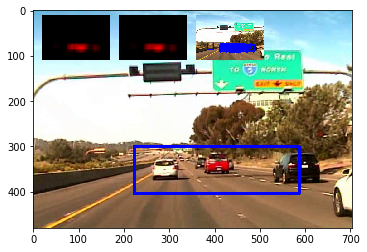



t:  14%|█▎        | 41/300 [00:32<03:41,  1.17it/s, now=None]

t:  14%|█▍        | 42/300 [00:33<03:35,  1.20it/s, now=None]

Found 185 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (424, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  14%|█▍        | 43/300 [00:34<03:30,  1.22it/s, now=None]

Found 165 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 352)
new centroid= (396, 352)
old bbox= [[245 300]
 [603 405]]
new bbox= [[217 300]
 [575 404]]
Appending new object with centroid: (557, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  15%|█▍        | 44/300 [00:35<03:29,  1.22it/s, now=None]

Found 211 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (396, 352)
new centroid= (410, 352)
old bbox= [[217 300]
 [575 404]]
new bbox= [[231 300]
 [589 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  15%|█▌        | 45/300 [00:36<03:26,  1.24it/s, now=None]

Found 181 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (144, 331)
**Found a match**
old centroid= (410, 352)
new centroid= (389, 352)
old bbox= [[231 300]
 [589 404]]
new bbox= [[210 300]
 [568 404]]
**Found a match**
old centroid= (557, 352)
new centroid= (560, 355)
old bbox= [[512 314]
 [603 391]]
new bbox= [[515 310]
 [605 400]]
previously detected objects= 1
so far newly detected objects= 3
Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (389, 352)
new centroid= (378, 352)
old bbox= [[210 300]
 [568 404]]
new bbox= [[199 300]
 [557 404]]
**Found a match**
old centroid= (560, 355)
new centroid= (562, 353)
old bbox= [[515 310]
 [605 400]]
new bbox= [[517 308]
 [607 398]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (378, 352) **
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame 

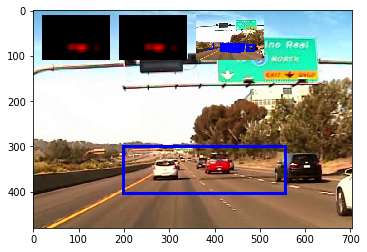



t:  15%|█▌        | 46/300 [00:37<03:37,  1.17it/s, now=None]

t:  16%|█▌        | 47/300 [00:37<03:30,  1.20it/s, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (144, 331)
Appending new object with centroid: (424, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  16%|█▌        | 48/300 [00:38<03:25,  1.23it/s, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (144, 331)
new centroid= (144, 331)
old bbox= [[106 300]
 [182 363]]
new bbox= [[106 300]
 [182 362]]
**Found a match**
old centroid= (424, 352)
new centroid= (424, 352)
old bbox= [[245 300]
 [603 405]]
new bbox= [[245 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  16%|█▋        | 49/300 [00:39<03:22,  1.24it/s, now=None]

Found 179 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (144, 331)
new centroid= (142, 331)
old bbox= [[106 300]
 [182 362]]
new bbox= [[104 300]
 [180 362]]
**Found a match**
old centroid= (424, 352)
new centroid= (395, 352)
old bbox= [[245 300]
 [603 404]]
new bbox= [[216 300]
 [574 404]]
Appending new object with centroid: (564, 359)
previously detected objects= 1
so far newly detected objects= 3




t:  17%|█▋        | 50/300 [00:40<03:19,  1.26it/s, now=None]

Found 183 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (142, 331)
new centroid= (141, 331)
old bbox= [[104 300]
 [180 362]]
new bbox= [[103 300]
 [179 362]]
**Found a match**
old centroid= (395, 352)
new centroid= (381, 352)
old bbox= [[216 300]
 [574 404]]
new bbox= [[202 300]
 [560 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (557, 355)
old bbox= [[526 314]
 [603 405]]
new bbox= [[504 310]
 [610 400]]
previously detected objects= 1
so far newly detected objects= 3
Found 190 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (141, 331)
new centroid= (140, 331)
old bbox= [[103 300]
 [179 362]]
new bbox= [[102 300]
 [178 362]]
**Found a match**
old centroid= (381, 352)
new centroid= (374, 352)
old bbox= [[202 300]
 [560 404]]
new bbox= [[195 300]
 [553 404]]
**Found a match**
old centroid= (557, 355)
new centroid= (555, 350)
old bbox= [[504 310]
 [610 400]]
new bbox= [[502 305]
 [608 395]]
previously detected ob

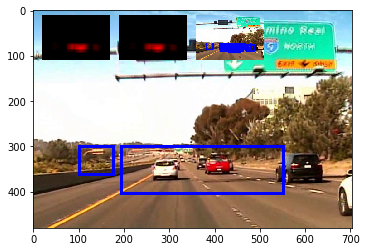



t:  17%|█▋        | 51/300 [00:41<03:33,  1.17it/s, now=None]

t:  17%|█▋        | 52/300 [00:41<03:29,  1.18it/s, now=None]

Found 172 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (137, 331)
Appending new object with centroid: (371, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  18%|█▊        | 53/300 [00:42<03:23,  1.21it/s, now=None]

Found 197 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (137, 331)
new centroid= (137, 331)
old bbox= [[106 300]
 [169 363]]
new bbox= [[105 300]
 [169 362]]
**Found a match**
old centroid= (371, 352)
new centroid= (396, 352)
old bbox= [[252 300]
 [491 405]]
new bbox= [[215 300]
 [577 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  18%|█▊        | 54/300 [00:43<03:18,  1.24it/s, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (137, 331)
new centroid= (137, 331)
old bbox= [[105 300]
 [169 362]]
new bbox= [[105 300]
 [169 362]]
**Found a match**
old centroid= (396, 352)
new centroid= (410, 352)
old bbox= [[215 300]
 [577 404]]
new bbox= [[229 300]
 [591 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  18%|█▊        | 55/300 [00:44<03:15,  1.25it/s, now=None]

Found 199 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (137, 331)
new centroid= (135, 331)
old bbox= [[105 300]
 [169 362]]
new bbox= [[101 300]
 [169 362]]
**Found a match**
old centroid= (410, 352)
new centroid= (417, 352)
old bbox= [[229 300]
 [591 404]]
new bbox= [[236 300]
 [598 404]]
previously detected objects= 2
so far newly detected objects= 3
Found 207 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (135, 331)
new centroid= (134, 331)
old bbox= [[101 300]
 [169 362]]
new bbox= [[100 300]
 [168 362]]
**Found a match**
old centroid= (417, 352)
new centroid= (418, 352)
old bbox= [[236 300]
 [598 404]]
new bbox= [[236 300]
 [600 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (134, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (418, 352) **
number of times detected object appeared:  0
Refr

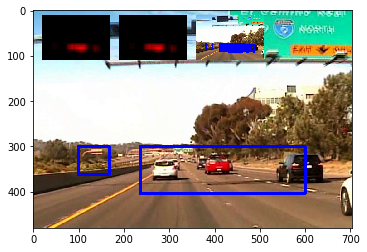



t:  19%|█▊        | 56/300 [00:45<03:29,  1.17it/s, now=None]

t:  19%|█▉        | 57/300 [00:46<03:22,  1.20it/s, now=None]

Found 195 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (134, 331)
Appending new object with centroid: (368, 352)
Appending new object with centroid: (553, 359)
previously detected objects= 2
so far newly detected objects= 3




t:  19%|█▉        | 58/300 [00:46<03:16,  1.23it/s, now=None]

Found 184 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (134, 331)
new centroid= (134, 331)
old bbox= [[100 300]
 [169 363]]
new bbox= [[100 300]
 [168 362]]
**Found a match**
old centroid= (368, 352)
new centroid= (368, 352)
old bbox= [[245 300]
 [491 405]]
new bbox= [[245 300]
 [491 404]]
**Found a match**
old centroid= (553, 359)
new centroid= (551, 359)
old bbox= [[504 314]
 [603 405]]
new bbox= [[499 314]
 [603 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  20%|█▉        | 59/300 [00:47<03:12,  1.25it/s, now=None]

Found 208 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (134, 331)
new centroid= (133, 331)
old bbox= [[100 300]
 [168 362]]
new bbox= [[ 92 300]
 [174 362]]
**Found a match**
old centroid= (368, 352)
new centroid= (364, 352)
old bbox= [[245 300]
 [491 404]]
new bbox= [[235 300]
 [493 404]]
**Found a match**
old centroid= (551, 359)
new centroid= (552, 352)
old bbox= [[499 314]
 [603 404]]
new bbox= [[500 307]
 [604 397]]
previously detected objects= 2
so far newly detected objects= 3




t:  20%|██        | 60/300 [00:48<03:11,  1.25it/s, now=None]

Found 205 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (133, 331)
new centroid= (133, 331)
old bbox= [[ 92 300]
 [174 362]]
new bbox= [[ 92 300]
 [174 362]]
**Found a match**
old centroid= (364, 352)
new centroid= (365, 352)
old bbox= [[235 300]
 [493 404]]
new bbox= [[236 300]
 [494 404]]
**Found a match**
old centroid= (552, 352)
new centroid= (553, 352)
old bbox= [[500 307]
 [604 397]]
new bbox= [[501 307]
 [605 397]]
previously detected objects= 2
so far newly detected objects= 3
Found 211 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (133, 331)
new centroid= (131, 331)
old bbox= [[ 92 300]
 [174 362]]
new bbox= [[ 90 300]
 [172 362]]
**Found a match**
old centroid= (365, 352)
new centroid= (394, 352)
old bbox= [[236 300]
 [494 404]]
new bbox= [[215 300]
 [573 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (131, 331) **
number of times dete

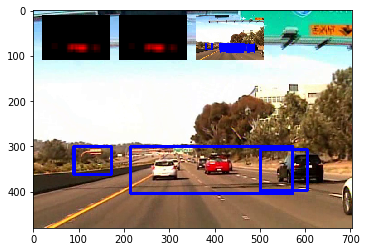



t:  20%|██        | 61/300 [00:49<03:23,  1.17it/s, now=None]

t:  21%|██        | 62/300 [00:50<03:18,  1.20it/s, now=None]

Found 191 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (424, 352)
previously detected objects= 3
so far newly detected objects= 1




t:  21%|██        | 63/300 [00:50<03:13,  1.22it/s, now=None]

Found 208 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (133, 331)
**Found a match**
old centroid= (424, 352)
new centroid= (420, 352)
old bbox= [[245 300]
 [603 405]]
new bbox= [[234 300]
 [606 404]]
previously detected objects= 3
so far newly detected objects= 2




t:  21%|██▏       | 64/300 [00:51<03:11,  1.23it/s, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (420, 352)
new centroid= (394, 352)
old bbox= [[234 300]
 [606 404]]
new bbox= [[208 300]
 [580 404]]
Appending new object with centroid: (550, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  22%|██▏       | 65/300 [00:52<03:07,  1.25it/s, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (394, 352)
new centroid= (379, 352)
old bbox= [[208 300]
 [580 404]]
new bbox= [[193 300]
 [565 404]]
**Found a match**
old centroid= (550, 352)
new centroid= (558, 355)
old bbox= [[497 314]
 [603 391]]
new bbox= [[505 310]
 [611 400]]
previously detected objects= 3
so far newly detected objects= 3
Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (379, 352)
new centroid= (370, 352)
old bbox= [[193 300]
 [565 404]]
new bbox= [[184 300]
 [556 404]]
**Found a match**
old centroid= (558, 355)
new centroid= (561, 350)
old bbox= [[505 310]
 [611 400]]
new bbox= [[508 305]
 [614 395]]
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one with centroid (370, 352) **
number of times detected object appeared:  0
number of times detected object appeared:  2
Refresh at frame n. 65: newly detected objects 1


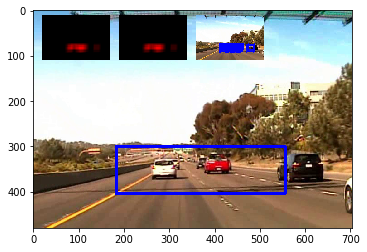



t:  22%|██▏       | 66/300 [00:53<03:19,  1.17it/s, now=None]

t:  22%|██▏       | 67/300 [00:54<03:13,  1.20it/s, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (129, 331)
Appending new object with centroid: (420, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  23%|██▎       | 68/300 [00:55<03:09,  1.23it/s, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (420, 352)
new centroid= (416, 352)
old bbox= [[238 300]
 [603 405]]
new bbox= [[227 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  23%|██▎       | 69/300 [00:55<03:05,  1.25it/s, now=None]

Found 190 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (129, 331)
new centroid= (127, 331)
old bbox= [[ 98 300]
 [161 363]]
new bbox= [[ 93 300]
 [161 362]]
**Found a match**
old centroid= (416, 352)
new centroid= (416, 352)
old bbox= [[227 300]
 [605 404]]
new bbox= [[227 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  23%|██▎       | 70/300 [00:56<03:02,  1.26it/s, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 352)
new centroid= (390, 352)
old bbox= [[227 300]
 [605 404]]
new bbox= [[201 300]
 [579 404]]
Appending new object with centroid: (547, 352)
previously detected objects= 1
so far newly detected objects= 3
Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (390, 352)
new centroid= (377, 352)
old bbox= [[201 300]
 [579 404]]
new bbox= [[188 300]
 [566 404]]
**Found a match**
old centroid= (547, 352)
new centroid= (550, 352)
old bbox= [[492 300]
 [603 405]]
new bbox= [[495 300]
 [605 404]]
previously detected objects= 1
number of times detected object appeared:  1
number of times detected object appeared:  4
** Adding similar object to one with centroid (377, 352) **
number of times detected object appeared:  1
Refresh at frame n. 70: newly detected objects 1


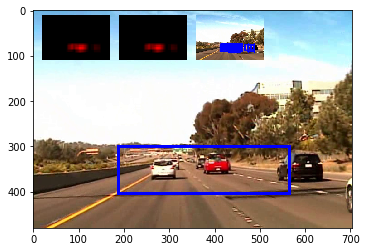



t:  24%|██▎       | 71/300 [00:57<03:13,  1.18it/s, now=None]

t:  24%|██▍       | 72/300 [00:58<03:09,  1.21it/s, now=None]

Found 195 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (126, 331)
Appending new object with centroid: (393, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  24%|██▍       | 73/300 [00:59<03:04,  1.23it/s, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (393, 352)
new centroid= (408, 352)
old bbox= [[184 300]
 [603 405]]
new bbox= [[199 300]
 [617 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  25%|██▍       | 74/300 [00:59<03:00,  1.25it/s, now=None]

Found 188 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (126, 331)
new centroid= (126, 331)
old bbox= [[ 91 300]
 [161 363]]
new bbox= [[ 91 300]
 [161 362]]
**Found a match**
old centroid= (408, 352)
new centroid= (416, 352)
old bbox= [[199 300]
 [617 404]]
new bbox= [[207 300]
 [625 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  25%|██▌       | 75/300 [01:00<02:58,  1.26it/s, now=None]

Found 196 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (126, 331)
new centroid= (124, 334)
old bbox= [[ 91 300]
 [161 362]]
new bbox= [[ 85 296]
 [163 372]]
**Found a match**
old centroid= (416, 352)
new centroid= (406, 352)
old bbox= [[207 300]
 [625 404]]
new bbox= [[197 300]
 [615 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (406, 352)
new centroid= (382, 352)
old bbox= [[197 300]
 [615 404]]
new bbox= [[173 300]
 [591 404]]
Appending new object with centroid: (568, 352)
previously detected objects= 1
number of times detected object appeared:  2
number of times detected object appeared:  4
** Adding similar object to one with centroid (382, 352) **
number of times detected object appeared:  0
Refresh at frame n. 75: newly detected objects 1


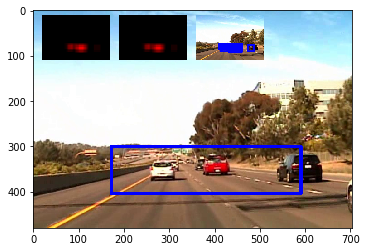



t:  25%|██▌       | 76/300 [01:01<03:10,  1.17it/s, now=None]

t:  26%|██▌       | 77/300 [01:02<03:05,  1.20it/s, now=None]

Found 181 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (123, 331)
Appending new object with centroid: (361, 352)
Appending new object with centroid: (550, 359)
previously detected objects= 1
so far newly detected objects= 3




t:  26%|██▌       | 78/300 [01:03<02:59,  1.23it/s, now=None]

Found 186 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (123, 331)
new centroid= (122, 331)
old bbox= [[ 92 300]
 [154 363]]
new bbox= [[ 91 300]
 [153 362]]
**Found a match**
old centroid= (361, 352)
new centroid= (347, 352)
old bbox= [[238 300]
 [485 405]]
new bbox= [[197 300]
 [497 404]]
**Found a match**
old centroid= (550, 359)
new centroid= (550, 355)
old bbox= [[498 314]
 [603 405]]
new bbox= [[498 310]
 [602 400]]
previously detected objects= 1
so far newly detected objects= 3




t:  26%|██▋       | 79/300 [01:03<02:57,  1.25it/s, now=None]

Found 157 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 352)
new centroid= (352, 352)
old bbox= [[197 300]
 [497 404]]
new bbox= [[202 300]
 [502 404]]
**Found a match**
old centroid= (550, 355)
new centroid= (558, 353)
old bbox= [[498 310]
 [602 400]]
new bbox= [[506 308]
 [610 398]]
previously detected objects= 1
so far newly detected objects= 3




t:  27%|██▋       | 80/300 [01:04<02:54,  1.26it/s, now=None]

Found 167 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (352, 352)
new centroid= (344, 352)
old bbox= [[202 300]
 [502 404]]
new bbox= [[194 300]
 [494 404]]
**Found a match**
old centroid= (558, 353)
new centroid= (562, 356)
old bbox= [[506 308]
 [610 398]]
new bbox= [[510 311]
 [614 401]]
previously detected objects= 1
so far newly detected objects= 3
Found 175 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (122, 331)
new centroid= (122, 331)
old bbox= [[ 91 300]
 [153 362]]
new bbox= [[ 91 300]
 [153 362]]
**Found a match**
old centroid= (344, 352)
new centroid= (347, 352)
old bbox= [[194 300]
 [494 404]]
new bbox= [[197 300]
 [497 404]]
**Found a match**
old centroid= (562, 356)
new centroid= (564, 350)
old bbox= [[510 311]
 [614 401]]
new bbox= [[512 305]
 [616 395]]
previously detected objects= 1
number of times detected object appeared:  2
number of times detected object appeared:  4
** Adding similar object to one wit

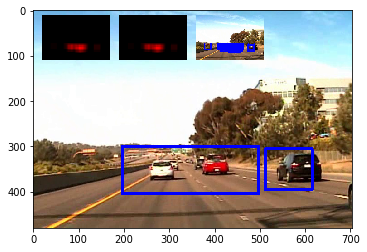



t:  27%|██▋       | 81/300 [01:05<03:09,  1.15it/s, now=None]

t:  27%|██▋       | 82/300 [01:06<03:04,  1.18it/s, now=None]

Found 183 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (116, 331)
Appending new object with centroid: (364, 352)
Appending new object with centroid: (564, 345)
previously detected objects= 2
so far newly detected objects= 3




t:  28%|██▊       | 83/300 [01:07<02:59,  1.21it/s, now=None]

Found 183 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (116, 331)
new centroid= (117, 331)
old bbox= [[ 78 300]
 [154 363]]
new bbox= [[ 79 300]
 [155 362]]
**Found a match**
old centroid= (364, 352)
new centroid= (357, 352)
old bbox= [[245 300]
 [483 405]]
new bbox= [[225 300]
 [489 404]]
**Found a match**
old centroid= (564, 345)
new centroid= (564, 345)
old bbox= [[525 300]
 [603 391]]
new bbox= [[525 300]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  28%|██▊       | 84/300 [01:08<02:54,  1.23it/s, now=None]

Found 187 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (117, 331)
new centroid= (116, 331)
old bbox= [[ 79 300]
 [155 362]]
new bbox= [[ 78 300]
 [154 362]]
**Found a match**
old centroid= (357, 352)
new centroid= (354, 352)
old bbox= [[225 300]
 [489 404]]
new bbox= [[221 300]
 [487 404]]
**Found a match**
old centroid= (564, 345)
new centroid= (559, 345)
old bbox= [[525 300]
 [603 390]]
new bbox= [[511 300]
 [607 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  28%|██▊       | 85/300 [01:08<02:51,  1.25it/s, now=None]

Found 184 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (116, 331)
new centroid= (114, 331)
old bbox= [[ 78 300]
 [154 362]]
new bbox= [[ 76 300]
 [152 362]]
**Found a match**
old centroid= (354, 352)
new centroid= (352, 352)
old bbox= [[221 300]
 [487 404]]
new bbox= [[219 300]
 [485 404]]
**Found a match**
old centroid= (559, 345)
new centroid= (563, 345)
old bbox= [[511 300]
 [607 390]]
new bbox= [[515 300]
 [611 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 180 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (114, 331)
new centroid= (111, 331)
old bbox= [[ 76 300]
 [152 362]]
new bbox= [[ 73 300]
 [149 362]]
**Found a match**
old centroid= (352, 352)
new centroid= (351, 352)
old bbox= [[219 300]
 [485 404]]
new bbox= [[218 300]
 [484 404]]
**Found a match**
old centroid= (563, 345)
new centroid= (565, 345)
old bbox= [[515 300]
 [611 390]]
new bbox= [[517 300]
 [613 390]]
previously detected ob

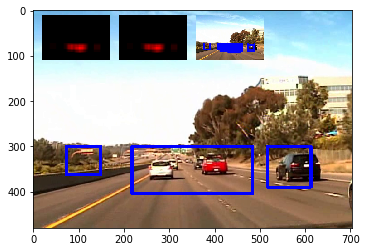



t:  29%|██▊       | 86/300 [01:09<03:01,  1.18it/s, now=None]

t:  29%|██▉       | 87/300 [01:10<02:55,  1.21it/s, now=None]

Found 196 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (109, 331)
Appending new object with centroid: (350, 352)
Appending new object with centroid: (546, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  29%|██▉       | 88/300 [01:11<02:51,  1.24it/s, now=None]

Found 179 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 331)
new centroid= (109, 331)
old bbox= [[ 78 300]
 [141 363]]
new bbox= [[ 78 300]
 [140 362]]
**Found a match**
old centroid= (350, 352)
new centroid= (352, 352)
old bbox= [[218 300]
 [483 405]]
new bbox= [[220 300]
 [484 404]]
**Found a match**
old centroid= (546, 359)
new centroid= (556, 355)
old bbox= [[490 314]
 [603 405]]
new bbox= [[500 310]
 [612 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  30%|██▉       | 89/300 [01:12<02:48,  1.25it/s, now=None]

Found 196 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 331)
new centroid= (109, 331)
old bbox= [[ 78 300]
 [140 362]]
new bbox= [[ 78 300]
 [140 362]]
**Found a match**
old centroid= (352, 352)
new centroid= (353, 352)
old bbox= [[220 300]
 [484 404]]
new bbox= [[221 300]
 [485 404]]
**Found a match**
old centroid= (556, 355)
new centroid= (551, 357)
old bbox= [[500 310]
 [612 400]]
new bbox= [[495 312]
 [607 402]]
previously detected objects= 3
so far newly detected objects= 3




t:  30%|███       | 90/300 [01:12<02:45,  1.27it/s, now=None]

Found 202 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 331)
new centroid= (107, 334)
old bbox= [[ 78 300]
 [140 362]]
new bbox= [[ 72 296]
 [142 372]]
**Found a match**
old centroid= (353, 352)
new centroid= (344, 352)
old bbox= [[221 300]
 [485 404]]
new bbox= [[198 300]
 [490 404]]
**Found a match**
old centroid= (551, 357)
new centroid= (549, 354)
old bbox= [[495 312]
 [607 402]]
new bbox= [[493 309]
 [605 399]]
previously detected objects= 3
so far newly detected objects= 3
Found 195 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (107, 334)
new centroid= (108, 332)
old bbox= [[ 72 296]
 [142 372]]
new bbox= [[ 73 294]
 [143 370]]
**Found a match**
old centroid= (344, 352)
new centroid= (340, 352)
old bbox= [[198 300]
 [490 404]]
new bbox= [[194 300]
 [486 404]]
**Found a match**
old centroid= (549, 354)
new centroid= (548, 353)
old bbox= [[493 309]
 [605 399]]
new bbox= [[492 308]
 [604 398]]
previously detected ob

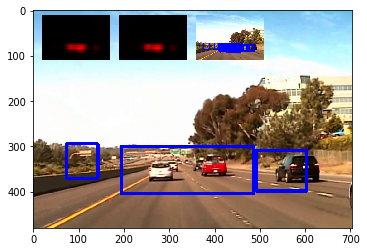



t:  30%|███       | 91/300 [01:13<02:58,  1.17it/s, now=None]

t:  31%|███       | 92/300 [01:14<02:52,  1.21it/s, now=None]

Found 200 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (337, 352)
Appending new object with centroid: (547, 359)
previously detected objects= 3
so far newly detected objects= 2




t:  31%|███       | 93/300 [01:15<02:47,  1.23it/s, now=None]

Found 223 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (109, 331)
**Found a match**
old centroid= (337, 352)
new centroid= (366, 352)
old bbox= [[190 300]
 [485 405]]
new bbox= [[160 300]
 [572 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  31%|███▏      | 94/300 [01:16<02:45,  1.24it/s, now=None]

Found 194 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 331)
new centroid= (107, 331)
old bbox= [[ 77 300]
 [141 363]]
new bbox= [[ 72 300]
 [142 362]]
**Found a match**
old centroid= (366, 352)
new centroid= (360, 352)
old bbox= [[160 300]
 [572 404]]
new bbox= [[154 300]
 [566 404]]
**Found a match**
old centroid= (547, 359)
new centroid= (547, 355)
old bbox= [[492 314]
 [603 405]]
new bbox= [[492 310]
 [602 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  32%|███▏      | 95/300 [01:17<02:43,  1.25it/s, now=None]

Found 208 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (107, 331)
new centroid= (108, 331)
old bbox= [[ 72 300]
 [142 362]]
new bbox= [[ 73 300]
 [143 362]]
**Found a match**
old centroid= (360, 352)
new centroid= (357, 352)
old bbox= [[154 300]
 [566 404]]
new bbox= [[151 300]
 [563 404]]
**Found a match**
old centroid= (547, 355)
new centroid= (548, 357)
old bbox= [[492 310]
 [602 400]]
new bbox= [[493 312]
 [603 402]]
previously detected objects= 3
so far newly detected objects= 3
Found 217 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (108, 331)
new centroid= (106, 331)
old bbox= [[ 73 300]
 [143 362]]
new bbox= [[ 71 300]
 [141 362]]
**Found a match**
old centroid= (357, 352)
new centroid= (347, 352)
old bbox= [[151 300]
 [563 404]]
new bbox= [[141 300]
 [553 404]]
**Found a match**
old centroid= (548, 357)
new centroid= (547, 358)
old bbox= [[493 312]
 [603 402]]
new bbox= [[492 313]
 [602 403]]
previously detected ob

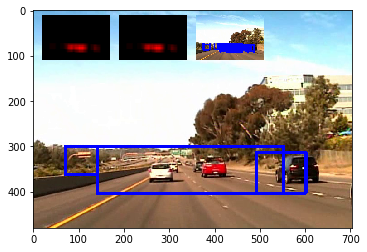



t:  32%|███▏      | 96/300 [01:18<02:53,  1.17it/s, now=None]

t:  32%|███▏      | 97/300 [01:18<02:48,  1.20it/s, now=None]

Found 217 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (109, 331)
Appending new object with centroid: (337, 352)
Appending new object with centroid: (547, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  33%|███▎      | 98/300 [01:19<02:45,  1.22it/s, now=None]

Found 197 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (109, 331)
new centroid= (108, 331)
old bbox= [[ 77 300]
 [141 363]]
new bbox= [[ 76 300]
 [140 362]]
**Found a match**
old centroid= (337, 352)
new centroid= (336, 352)
old bbox= [[190 300]
 [485 405]]
new bbox= [[189 300]
 [483 404]]
**Found a match**
old centroid= (547, 359)
new centroid= (548, 359)
old bbox= [[492 314]
 [603 405]]
new bbox= [[493 314]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  33%|███▎      | 99/300 [01:20<02:41,  1.24it/s, now=None]

Found 222 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (108, 331)
new centroid= (106, 331)
old bbox= [[ 76 300]
 [140 362]]
new bbox= [[ 71 300]
 [141 362]]
**Found a match**
old centroid= (336, 352)
new centroid= (366, 352)
old bbox= [[189 300]
 [483 404]]
new bbox= [[160 300]
 [572 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  33%|███▎      | 100/300 [01:21<02:39,  1.26it/s, now=None]

Found 195 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (106, 331)
new centroid= (104, 331)
old bbox= [[ 71 300]
 [141 362]]
new bbox= [[ 66 300]
 [142 362]]
**Found a match**
old centroid= (366, 352)
new centroid= (360, 352)
old bbox= [[160 300]
 [572 404]]
new bbox= [[154 300]
 [566 404]]
**Found a match**
old centroid= (548, 359)
new centroid= (557, 359)
old bbox= [[493 314]
 [603 404]]
new bbox= [[502 314]
 [612 404]]
previously detected objects= 3
so far newly detected objects= 3
Found 216 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (104, 331)
new centroid= (104, 331)
old bbox= [[ 66 300]
 [142 362]]
new bbox= [[ 66 300]
 [142 362]]
**Found a match**
old centroid= (360, 352)
new centroid= (348, 352)
old bbox= [[154 300]
 [566 404]]
new bbox= [[142 300]
 [554 404]]
**Found a match**
old centroid= (557, 359)
new centroid= (560, 359)
old bbox= [[502 314]
 [612 404]]
new bbox= [[505 314]
 [615 404]]
previously detected ob

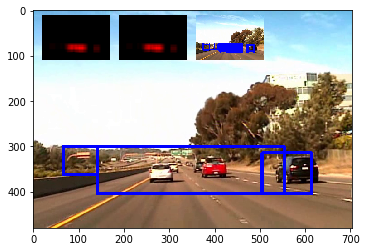



t:  34%|███▎      | 101/300 [01:22<02:50,  1.16it/s, now=None]

t:  34%|███▍      | 102/300 [01:22<02:46,  1.19it/s, now=None]

Found 222 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (105, 338)
Appending new object with centroid: (325, 352)
Appending new object with centroid: (564, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  34%|███▍      | 103/300 [01:23<02:42,  1.21it/s, now=None]

Found 228 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (105, 338)
new centroid= (103, 338)
old bbox= [[ 63 300]
 [147 377]]
new bbox= [[ 61 300]
 [145 376]]
**Found a match**
old centroid= (325, 352)
new centroid= (330, 352)
old bbox= [[168 300]
 [483 405]]
new bbox= [[173 300]
 [487 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (564, 359)
old bbox= [[525 314]
 [603 405]]
new bbox= [[525 314]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  35%|███▍      | 104/300 [01:24<02:38,  1.24it/s, now=None]

Found 220 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (103, 338)
new centroid= (102, 334)
old bbox= [[ 61 300]
 [145 376]]
new bbox= [[ 60 296]
 [144 372]]
**Found a match**
old centroid= (330, 352)
new centroid= (326, 352)
old bbox= [[173 300]
 [487 404]]
new bbox= [[166 300]
 [486 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (564, 359)
old bbox= [[525 314]
 [603 404]]
new bbox= [[525 314]
 [603 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  35%|███▌      | 105/300 [01:25<02:35,  1.26it/s, now=None]

Found 229 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (102, 334)
new centroid= (103, 336)
old bbox= [[ 60 296]
 [144 372]]
new bbox= [[ 61 298]
 [145 374]]
**Found a match**
old centroid= (326, 352)
new centroid= (354, 352)
old bbox= [[166 300]
 [486 404]]
new bbox= [[133 300]
 [575 404]]
previously detected objects= 3
so far newly detected objects= 3
Found 214 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (103, 336)
new centroid= (102, 333)
old bbox= [[ 61 298]
 [145 374]]
new bbox= [[ 60 295]
 [144 371]]
**Found a match**
old centroid= (354, 352)
new centroid= (338, 352)
old bbox= [[133 300]
 [575 404]]
new bbox= [[117 300]
 [559 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (564, 359)
old bbox= [[525 314]
 [603 404]]
new bbox= [[525 314]
 [603 404]]
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one with centroid (102, 333) **
number of times dete

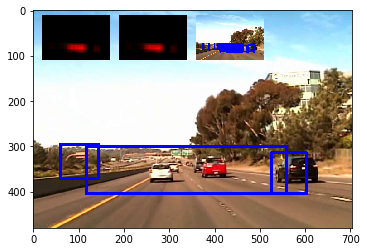



t:  35%|███▌      | 106/300 [01:26<02:43,  1.18it/s, now=None]

t:  36%|███▌      | 107/300 [01:26<02:38,  1.22it/s, now=None]

Found 220 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (102, 331)
Appending new object with centroid: (319, 352)
Appending new object with centroid: (553, 359)
previously detected objects= 3
so far newly detected objects= 3




t:  36%|███▌      | 108/300 [01:27<02:35,  1.23it/s, now=None]

Found 227 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (102, 331)
new centroid= (101, 331)
old bbox= [[ 64 300]
 [140 363]]
new bbox= [[ 63 300]
 [139 362]]
**Found a match**
old centroid= (319, 352)
new centroid= (319, 352)
old bbox= [[162 300]
 [477 405]]
new bbox= [[162 300]
 [476 404]]
**Found a match**
old centroid= (553, 359)
new centroid= (550, 355)
old bbox= [[504 314]
 [603 405]]
new bbox= [[495 303]
 [605 407]]
previously detected objects= 3
so far newly detected objects= 3




t:  36%|███▋      | 109/300 [01:28<02:32,  1.25it/s, now=None]

Found 202 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (101, 331)
new centroid= (101, 331)
old bbox= [[ 63 300]
 [139 362]]
new bbox= [[ 63 300]
 [139 362]]
**Found a match**
old centroid= (319, 352)
new centroid= (326, 352)
old bbox= [[162 300]
 [476 404]]
new bbox= [[169 300]
 [483 404]]
**Found a match**
old centroid= (550, 355)
new centroid= (552, 357)
old bbox= [[495 303]
 [605 407]]
new bbox= [[497 305]
 [607 409]]
previously detected objects= 3
so far newly detected objects= 3




t:  37%|███▋      | 110/300 [01:29<02:31,  1.26it/s, now=None]

Found 209 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (101, 331)
new centroid= (101, 331)
old bbox= [[ 63 300]
 [139 362]]
new bbox= [[ 63 300]
 [139 362]]
**Found a match**
old centroid= (326, 352)
new centroid= (324, 352)
old bbox= [[169 300]
 [483 404]]
new bbox= [[164 300]
 [484 404]]
**Found a match**
old centroid= (552, 357)
new centroid= (558, 358)
old bbox= [[497 305]
 [607 409]]
new bbox= [[503 306]
 [613 410]]
previously detected objects= 3
so far newly detected objects= 3
Found 208 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (101, 331)
new centroid= (101, 334)
old bbox= [[ 63 300]
 [139 362]]
new bbox= [[ 63 296]
 [139 372]]
**Found a match**
old centroid= (324, 352)
new centroid= (323, 352)
old bbox= [[164 300]
 [484 404]]
new bbox= [[163 300]
 [483 404]]
**Found a match**
old centroid= (558, 358)
new centroid= (555, 355)
old bbox= [[503 306]
 [613 410]]
new bbox= [[500 303]
 [610 407]]
previously detected ob

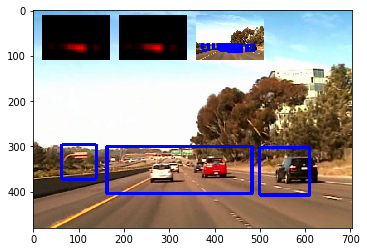



t:  37%|███▋      | 111/300 [01:30<02:40,  1.18it/s, now=None]

t:  37%|███▋      | 112/300 [01:31<02:35,  1.21it/s, now=None]

Found 196 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (101, 331)
Appending new object with centroid: (353, 352)
Appending new object with centroid: (554, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  38%|███▊      | 113/300 [01:31<02:31,  1.23it/s, now=None]

Found 189 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (101, 331)
new centroid= (101, 331)
old bbox= [[ 63 300]
 [140 363]]
new bbox= [[ 63 300]
 [139 362]]
**Found a match**
old centroid= (353, 352)
new centroid= (351, 352)
old bbox= [[224 300]
 [483 405]]
new bbox= [[219 300]
 [483 404]]
**Found a match**
old centroid= (554, 352)
new centroid= (560, 352)
old bbox= [[506 314]
 [603 391]]
new bbox= [[512 314]
 [608 390]]
previously detected objects= 3
so far newly detected objects= 3




t:  38%|███▊      | 114/300 [01:32<02:27,  1.26it/s, now=None]

Found 216 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (101, 331)
new centroid= (101, 331)
old bbox= [[ 63 300]
 [139 362]]
new bbox= [[ 63 300]
 [139 362]]
**Found a match**
old centroid= (351, 352)
new centroid= (336, 352)
old bbox= [[219 300]
 [483 404]]
new bbox= [[176 300]
 [496 404]]
**Found a match**
old centroid= (560, 352)
new centroid= (553, 355)
old bbox= [[512 314]
 [608 390]]
new bbox= [[498 310]
 [608 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  38%|███▊      | 115/300 [01:33<02:25,  1.27it/s, now=None]

Found 214 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (101, 331)
new centroid= (98, 331)
old bbox= [[ 63 300]
 [139 362]]
new bbox= [[ 60 300]
 [136 362]]
Appending new object with centroid: (417, 352)
previously detected objects= 3
so far newly detected objects= 4
Found 217 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (98, 331)
new centroid= (96, 331)
old bbox= [[ 60 300]
 [136 362]]
new bbox= [[ 58 300]
 [134 362]]
**Found a match**
old centroid= (336, 352)
new centroid= (366, 352)
old bbox= [[176 300]
 [496 404]]
new bbox= [[160 300]
 [572 404]]
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one with centroid (96, 331) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (366, 352) **
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 115: newly detected objects 2


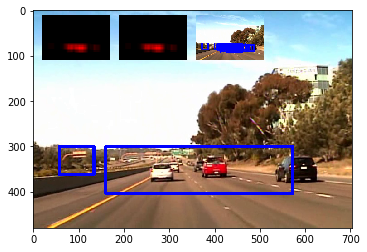



t:  39%|███▊      | 116/300 [01:34<02:35,  1.18it/s, now=None]

t:  39%|███▉      | 117/300 [01:35<02:30,  1.21it/s, now=None]

Found 231 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (94, 338)
Appending new object with centroid: (382, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  39%|███▉      | 118/300 [01:35<02:26,  1.24it/s, now=None]

Found 218 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (94, 338)
new centroid= (91, 334)
old bbox= [[ 49 300]
 [140 377]]
new bbox= [[ 46 296]
 [136 372]]
**Found a match**
old centroid= (382, 352)
new centroid= (366, 352)
old bbox= [[162 300]
 [603 405]]
new bbox= [[146 300]
 [586 404]]
Appending new object with centroid: (546, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  40%|███▉      | 119/300 [01:36<02:23,  1.26it/s, now=None]

Found 203 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (91, 334)
new centroid= (89, 332)
old bbox= [[ 46 296]
 [136 372]]
new bbox= [[ 44 294]
 [134 370]]
**Found a match**
old centroid= (366, 352)
new centroid= (361, 352)
old bbox= [[146 300]
 [586 404]]
new bbox= [[141 300]
 [581 404]]
**Found a match**
old centroid= (546, 352)
new centroid= (546, 352)
old bbox= [[490 314]
 [603 391]]
new bbox= [[490 314]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  40%|████      | 120/300 [01:37<02:21,  1.28it/s, now=None]

Found 235 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (89, 332)
new centroid= (88, 331)
old bbox= [[ 44 294]
 [134 370]]
new bbox= [[ 43 293]
 [133 369]]
**Found a match**
old centroid= (361, 352)
new centroid= (340, 352)
old bbox= [[141 300]
 [581 404]]
new bbox= [[120 300]
 [560 404]]
**Found a match**
old centroid= (546, 352)
new centroid= (544, 352)
old bbox= [[490 314]
 [602 390]]
new bbox= [[484 314]
 [604 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 209 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (88, 331)
new centroid= (88, 331)
old bbox= [[ 43 293]
 [133 369]]
new bbox= [[ 43 293]
 [133 369]]
**Found a match**
old centroid= (340, 352)
new centroid= (368, 352)
old bbox= [[120 300]
 [560 404]]
new bbox= [[148 300]
 [588 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (88, 331) **
number of times detected 

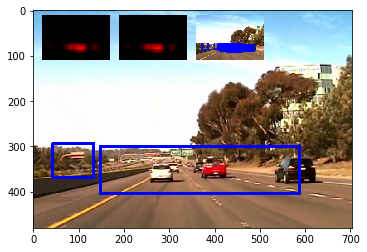



t:  40%|████      | 121/300 [01:38<02:29,  1.20it/s, now=None]

t:  41%|████      | 122/300 [01:39<02:26,  1.22it/s, now=None]

Found 205 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (88, 331)
Appending new object with centroid: (417, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  41%|████      | 123/300 [01:39<02:22,  1.24it/s, now=None]

Found 255 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (88, 331)
new centroid= (89, 331)
old bbox= [[ 50 300]
 [127 363]]
new bbox= [[ 40 300]
 [138 362]]
**Found a match**
old centroid= (417, 352)
new centroid= (399, 352)
old bbox= [[231 300]
 [603 405]]
new bbox= [[178 300]
 [620 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  41%|████▏     | 124/300 [01:40<02:20,  1.26it/s, now=None]

Found 230 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (89, 331)
new centroid= (88, 331)
old bbox= [[ 40 300]
 [138 362]]
new bbox= [[ 39 300]
 [137 362]]
**Found a match**
old centroid= (399, 352)
new centroid= (375, 352)
old bbox= [[178 300]
 [620 404]]
new bbox= [[154 300]
 [596 404]]
Appending new object with centroid: (543, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  42%|████▏     | 125/300 [01:41<02:18,  1.27it/s, now=None]

Found 221 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (88, 331)
new centroid= (86, 331)
old bbox= [[ 39 300]
 [137 362]]
new bbox= [[ 37 300]
 [135 362]]
**Found a match**
old centroid= (375, 352)
new centroid= (384, 352)
old bbox= [[154 300]
 [596 404]]
new bbox= [[163 300]
 [605 404]]
previously detected objects= 2
so far newly detected objects= 3
Found 250 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (86, 331)
new centroid= (83, 331)
old bbox= [[ 37 300]
 [135 362]]
new bbox= [[ 34 300]
 [132 362]]
**Found a match**
old centroid= (384, 352)
new centroid= (378, 352)
old bbox= [[163 300]
 [605 404]]
new bbox= [[148 300]
 [608 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (83, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (378, 352) **
number of times detected object appeared:  0
Refresh a

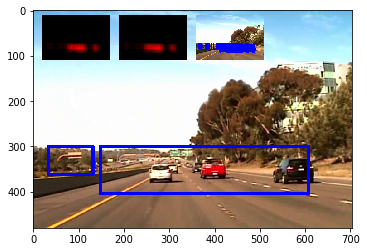



t:  42%|████▏     | 126/300 [01:42<02:28,  1.17it/s, now=None]

t:  42%|████▏     | 127/300 [01:43<02:23,  1.21it/s, now=None]

Found 231 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (84, 331)
Appending new object with centroid: (347, 352)
Appending new object with centroid: (543, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  43%|████▎     | 128/300 [01:44<02:19,  1.23it/s, now=None]

Found 215 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (84, 331)
new centroid= (84, 331)
old bbox= [[ 42 300]
 [126 363]]
new bbox= [[ 42 300]
 [126 362]]
**Found a match**
old centroid= (347, 352)
new centroid= (338, 352)
old bbox= [[217 300]
 [477 405]]
new bbox= [[192 300]
 [484 404]]
**Found a match**
old centroid= (543, 352)
new centroid= (548, 355)
old bbox= [[483 300]
 [603 405]]
new bbox= [[488 303]
 [608 407]]
previously detected objects= 2
so far newly detected objects= 3




t:  43%|████▎     | 129/300 [01:44<02:16,  1.25it/s, now=None]

Found 232 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (84, 331)
new centroid= (82, 331)
old bbox= [[ 42 300]
 [126 362]]
new bbox= [[ 37 300]
 [127 362]]
**Found a match**
old centroid= (338, 352)
new centroid= (335, 352)
old bbox= [[192 300]
 [484 404]]
new bbox= [[186 300]
 [484 404]]
**Found a match**
old centroid= (548, 355)
new centroid= (547, 350)
old bbox= [[488 303]
 [608 407]]
new bbox= [[487 298]
 [607 402]]
previously detected objects= 2
so far newly detected objects= 3




t:  43%|████▎     | 130/300 [01:45<02:15,  1.26it/s, now=None]

Found 214 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (82, 331)
new centroid= (81, 331)
old bbox= [[ 37 300]
 [127 362]]
new bbox= [[ 36 300]
 [126 362]]
**Found a match**
old centroid= (335, 352)
new centroid= (332, 352)
old bbox= [[186 300]
 [484 404]]
new bbox= [[179 300]
 [485 404]]
**Found a match**
old centroid= (547, 350)
new centroid= (547, 347)
old bbox= [[487 298]
 [607 402]]
new bbox= [[487 295]
 [607 399]]
previously detected objects= 2
so far newly detected objects= 3
Found 212 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (81, 331)
new centroid= (81, 331)
old bbox= [[ 36 300]
 [126 362]]
new bbox= [[ 36 300]
 [126 362]]
**Found a match**
old centroid= (332, 352)
new centroid= (341, 352)
old bbox= [[179 300]
 [485 404]]
new bbox= [[188 300]
 [494 404]]
**Found a match**
old centroid= (547, 347)
new centroid= (548, 349)
old bbox= [[487 295]
 [607 399]]
new bbox= [[488 297]
 [608 401]]
previously detected object

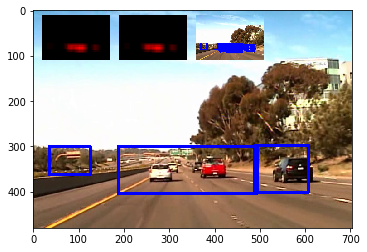



t:  44%|████▎     | 131/300 [01:46<02:22,  1.18it/s, now=None]

t:  44%|████▍     | 132/300 [01:47<02:18,  1.21it/s, now=None]

Found 220 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (74, 331)
Appending new object with centroid: (350, 352)
Appending new object with centroid: (547, 345)
previously detected objects= 3
so far newly detected objects= 3




t:  44%|████▍     | 133/300 [01:48<02:14,  1.24it/s, now=None]

Found 225 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (74, 331)
new centroid= (77, 331)
old bbox= [[ 35 300]
 [113 363]]
new bbox= [[ 38 300]
 [116 362]]
**Found a match**
old centroid= (350, 352)
new centroid= (340, 352)
old bbox= [[218 300]
 [483 405]]
new bbox= [[186 300]
 [494 404]]
**Found a match**
old centroid= (547, 345)
new centroid= (548, 348)
old bbox= [[492 300]
 [603 391]]
new bbox= [[493 303]
 [603 393]]
previously detected objects= 3
so far newly detected objects= 3




t:  45%|████▍     | 134/300 [01:48<02:12,  1.26it/s, now=None]

Found 221 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (77, 331)
new centroid= (79, 331)
old bbox= [[ 38 300]
 [116 362]]
new bbox= [[ 40 300]
 [118 362]]
**Found a match**
old centroid= (340, 352)
new centroid= (345, 352)
old bbox= [[186 300]
 [494 404]]
new bbox= [[191 300]
 [499 404]]
**Found a match**
old centroid= (548, 348)
new centroid= (547, 350)
old bbox= [[493 303]
 [603 393]]
new bbox= [[492 305]
 [602 395]]
previously detected objects= 3
so far newly detected objects= 3




t:  45%|████▌     | 135/300 [01:49<02:09,  1.27it/s, now=None]

Found 218 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (79, 331)
new centroid= (76, 331)
old bbox= [[ 40 300]
 [118 362]]
new bbox= [[ 37 300]
 [115 362]]
**Found a match**
old centroid= (345, 352)
new centroid= (349, 352)
old bbox= [[191 300]
 [499 404]]
new bbox= [[195 300]
 [503 404]]
**Found a match**
old centroid= (547, 350)
new centroid= (547, 354)
old bbox= [[492 305]
 [602 395]]
new bbox= [[492 309]
 [602 399]]
previously detected objects= 3
so far newly detected objects= 3
Found 224 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (76, 331)
new centroid= (75, 331)
old bbox= [[ 37 300]
 [115 362]]
new bbox= [[ 36 300]
 [114 362]]
Appending new object with centroid: (413, 352)
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one with centroid (75, 331) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (349, 352) **
number 

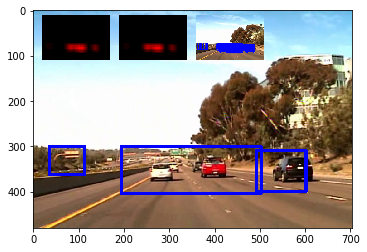



t:  45%|████▌     | 136/300 [01:50<02:36,  1.05it/s, now=None]

t:  46%|████▌     | 137/300 [01:51<02:33,  1.06it/s, now=None]

Found 211 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (70, 331)
Appending new object with centroid: (393, 352)
previously detected objects= 3
so far newly detected objects= 2




t:  46%|████▌     | 138/300 [01:52<02:24,  1.12it/s, now=None]

Found 238 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (70, 331)
new centroid= (72, 331)
old bbox= [[ 28 300]
 [113 363]]
new bbox= [[ 30 300]
 [114 362]]
**Found a match**
old centroid= (393, 352)
new centroid= (391, 352)
old bbox= [[184 300]
 [603 405]]
new bbox= [[178 300]
 [604 404]]
previously detected objects= 3
so far newly detected objects= 2




t:  46%|████▋     | 139/300 [01:53<02:24,  1.12it/s, now=None]

Found 213 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (72, 331)
new centroid= (74, 331)
old bbox= [[ 30 300]
 [114 362]]
new bbox= [[ 32 300]
 [116 362]]
**Found a match**
old centroid= (391, 352)
new centroid= (363, 352)
old bbox= [[178 300]
 [604 404]]
new bbox= [[150 300]
 [576 404]]
Appending new object with centroid: (553, 352)
previously detected objects= 3
so far newly detected objects= 3




t:  47%|████▋     | 140/300 [01:54<02:16,  1.17it/s, now=None]

Found 213 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (74, 331)
new centroid= (75, 331)
old bbox= [[ 32 300]
 [116 362]]
new bbox= [[ 33 300]
 [117 362]]
**Found a match**
old centroid= (363, 352)
new centroid= (346, 352)
old bbox= [[150 300]
 [576 404]]
new bbox= [[133 300]
 [559 404]]
**Found a match**
old centroid= (553, 352)
new centroid= (550, 352)
old bbox= [[504 314]
 [603 391]]
new bbox= [[495 314]
 [605 390]]
previously detected objects= 3
so far newly detected objects= 3
Found 234 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (75, 331)
new centroid= (72, 331)
old bbox= [[ 33 300]
 [117 362]]
new bbox= [[ 30 300]
 [114 362]]
**Found a match**
old centroid= (346, 352)
new centroid= (359, 352)
old bbox= [[133 300]
 [559 404]]
new bbox= [[129 300]
 [589 404]]
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one with centroid (72, 331) **
number of times detected 

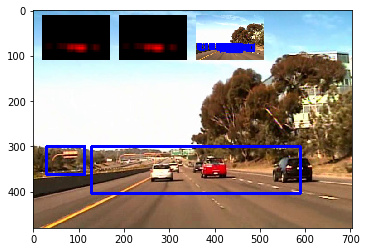



t:  47%|████▋     | 141/300 [01:55<02:22,  1.12it/s, now=None]

t:  47%|████▋     | 142/300 [01:56<02:16,  1.16it/s, now=None]

Found 216 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (74, 331)
Appending new object with centroid: (329, 352)
Appending new object with centroid: (547, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  48%|████▊     | 143/300 [01:56<02:11,  1.19it/s, now=None]

Found 224 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (74, 331)
new centroid= (72, 331)
old bbox= [[ 35 300]
 [113 363]]
new bbox= [[ 30 300]
 [114 362]]
**Found a match**
old centroid= (329, 352)
new centroid= (331, 352)
old bbox= [[176 300]
 [483 405]]
new bbox= [[178 300]
 [484 404]]
**Found a match**
old centroid= (547, 352)
new centroid= (546, 355)
old bbox= [[492 314]
 [603 391]]
new bbox= [[490 310]
 [602 400]]
previously detected objects= 2
so far newly detected objects= 3




t:  48%|████▊     | 144/300 [01:57<02:07,  1.22it/s, now=None]

Found 232 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (72, 331)
new centroid= (71, 334)
old bbox= [[ 30 300]
 [114 362]]
new bbox= [[ 29 296]
 [113 372]]
Appending new object with centroid: (393, 352)
previously detected objects= 2
so far newly detected objects= 4




t:  48%|████▊     | 145/300 [01:58<02:04,  1.24it/s, now=None]

Found 230 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (71, 334)
new centroid= (72, 332)
old bbox= [[ 29 296]
 [113 372]]
new bbox= [[ 30 294]
 [114 370]]
**Found a match**
old centroid= (331, 352)
new centroid= (355, 352)
old bbox= [[178 300]
 [484 404]]
new bbox= [[132 300]
 [578 404]]
previously detected objects= 2
so far newly detected objects= 4
Found 222 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (72, 332)
new centroid= (71, 331)
old bbox= [[ 30 294]
 [114 370]]
new bbox= [[ 29 293]
 [113 369]]
**Found a match**
old centroid= (355, 352)
new centroid= (374, 352)
old bbox= [[132 300]
 [578 404]]
new bbox= [[151 300]
 [597 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (71, 331) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (374, 352) **
number of times detected object appeared:  1
number of

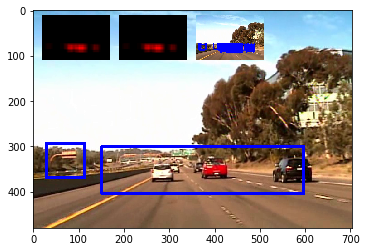



t:  49%|████▊     | 146/300 [01:59<02:11,  1.17it/s, now=None]

t:  49%|████▉     | 147/300 [02:00<02:06,  1.21it/s, now=None]

Found 225 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (70, 331)
Appending new object with centroid: (372, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  49%|████▉     | 148/300 [02:00<02:02,  1.24it/s, now=None]

Found 202 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (70, 331)
new centroid= (71, 331)
old bbox= [[ 28 300]
 [113 363]]
new bbox= [[ 29 300]
 [113 362]]
**Found a match**
old centroid= (372, 352)
new centroid= (354, 352)
old bbox= [[142 300]
 [603 405]]
new bbox= [[124 300]
 [584 404]]
Appending new object with centroid: (550, 359)
previously detected objects= 2
so far newly detected objects= 3




t:  50%|████▉     | 149/300 [02:01<01:59,  1.26it/s, now=None]

Found 227 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (71, 331)
new centroid= (74, 331)
old bbox= [[ 29 300]
 [113 362]]
new bbox= [[ 32 300]
 [116 362]]
**Found a match**
old centroid= (354, 352)
new centroid= (345, 352)
old bbox= [[124 300]
 [584 404]]
new bbox= [[115 300]
 [575 404]]
**Found a match**
old centroid= (550, 359)
new centroid= (551, 355)
old bbox= [[497 314]
 [603 405]]
new bbox= [[498 303]
 [604 407]]
previously detected objects= 2
so far newly detected objects= 3




t:  50%|█████     | 150/300 [02:02<01:57,  1.28it/s, now=None]

Found 244 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (74, 331)
new centroid= (72, 331)
old bbox= [[ 32 300]
 [116 362]]
new bbox= [[ 30 300]
 [114 362]]
**Found a match**
old centroid= (345, 352)
new centroid= (360, 352)
old bbox= [[115 300]
 [575 404]]
new bbox= [[130 300]
 [590 404]]
previously detected objects= 2
so far newly detected objects= 3
Found 216 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (72, 331)
new centroid= (72, 331)
old bbox= [[ 30 300]
 [114 362]]
new bbox= [[ 30 300]
 [114 362]]
**Found a match**
old centroid= (360, 352)
new centroid= (374, 352)
old bbox= [[130 300]
 [590 404]]
new bbox= [[144 300]
 [604 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (72, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (374, 352) **
number of times detected object appeared:  1
Refresh a

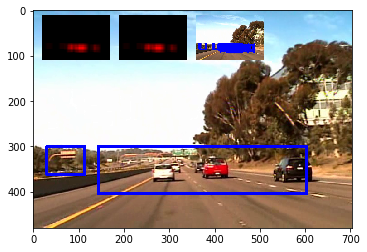



t:  50%|█████     | 151/300 [02:03<02:05,  1.19it/s, now=None]

t:  51%|█████     | 152/300 [02:04<02:00,  1.23it/s, now=None]

Found 216 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (66, 331)
Appending new object with centroid: (337, 352)
Appending new object with centroid: (564, 359)
previously detected objects= 2
so far newly detected objects= 3




t:  51%|█████     | 153/300 [02:04<01:56,  1.26it/s, now=None]

Found 242 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (66, 331)
new centroid= (64, 334)
old bbox= [[ 35 300]
 [ 98 363]]
new bbox= [[ 15 296]
 [113 372]]
**Found a match**
old centroid= (337, 352)
new centroid= (363, 352)
old bbox= [[184 300]
 [490 405]]
new bbox= [[150 300]
 [576 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  51%|█████▏    | 154/300 [02:05<01:53,  1.28it/s, now=None]

Found 234 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (64, 334)
new centroid= (67, 332)
old bbox= [[ 15 296]
 [113 372]]
new bbox= [[ 18 294]
 [116 370]]
**Found a match**
old centroid= (363, 352)
new centroid= (343, 352)
old bbox= [[150 300]
 [576 404]]
new bbox= [[130 300]
 [556 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (557, 359)
old bbox= [[525 314]
 [603 405]]
new bbox= [[505 314]
 [609 404]]
previously detected objects= 2
so far newly detected objects= 3




t:  52%|█████▏    | 155/300 [02:06<01:51,  1.30it/s, now=None]

Found 238 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (67, 332)
new centroid= (68, 335)
old bbox= [[ 18 294]
 [116 370]]
new bbox= [[ 19 297]
 [117 373]]
**Found a match**
old centroid= (343, 352)
new centroid= (333, 352)
old bbox= [[130 300]
 [556 404]]
new bbox= [[120 300]
 [546 404]]
**Found a match**
old centroid= (557, 359)
new centroid= (553, 352)
old bbox= [[505 314]
 [609 404]]
new bbox= [[501 307]
 [605 397]]
previously detected objects= 2
so far newly detected objects= 3
Found 245 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (68, 335)
new centroid= (65, 333)
old bbox= [[ 19 297]
 [117 373]]
new bbox= [[ 16 295]
 [114 371]]
**Found a match**
old centroid= (333, 352)
new centroid= (332, 352)
old bbox= [[120 300]
 [546 404]]
new bbox= [[119 300]
 [545 404]]
**Found a match**
old centroid= (553, 352)
new centroid= (551, 348)
old bbox= [[501 307]
 [605 397]]
new bbox= [[498 303]
 [604 393]]
previously detected object

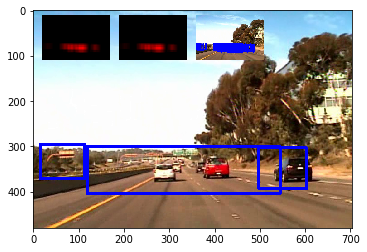



t:  52%|█████▏    | 156/300 [02:07<01:58,  1.21it/s, now=None]

t:  52%|█████▏    | 157/300 [02:08<01:54,  1.25it/s, now=None]

Found 233 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (70, 331)
Appending new object with centroid: (323, 352)
Appending new object with centroid: (550, 345)
previously detected objects= 3
so far newly detected objects= 3




t:  53%|█████▎    | 158/300 [02:08<01:52,  1.27it/s, now=None]

Found 236 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (70, 331)
new centroid= (71, 331)
old bbox= [[ 28 300]
 [112 363]]
new bbox= [[ 29 300]
 [113 362]]
**Found a match**
old centroid= (323, 352)
new centroid= (329, 352)
old bbox= [[156 300]
 [490 405]]
new bbox= [[162 300]
 [496 404]]
**Found a match**
old centroid= (550, 345)
new centroid= (550, 348)
old bbox= [[498 300]
 [603 391]]
new bbox= [[498 296]
 [602 400]]
previously detected objects= 3
so far newly detected objects= 3




t:  53%|█████▎    | 159/300 [02:09<01:50,  1.28it/s, now=None]

Found 255 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (71, 331)
new centroid= (67, 334)
old bbox= [[ 29 300]
 [113 362]]
new bbox= [[ 25 296]
 [109 372]]
**Found a match**
old centroid= (329, 352)
new centroid= (353, 352)
old bbox= [[162 300]
 [496 404]]
new bbox= [[129 300]
 [577 404]]
previously detected objects= 3
so far newly detected objects= 3




t:  53%|█████▎    | 160/300 [02:10<01:48,  1.30it/s, now=None]

Found 220 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (67, 334)
new centroid= (66, 332)
old bbox= [[ 25 296]
 [109 372]]
new bbox= [[ 24 294]
 [108 370]]
**Found a match**
old centroid= (353, 352)
new centroid= (373, 352)
old bbox= [[129 300]
 [577 404]]
new bbox= [[149 300]
 [597 404]]
previously detected objects= 3
so far newly detected objects= 3
Found 227 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (66, 332)
new centroid= (64, 331)
old bbox= [[ 24 294]
 [108 370]]
new bbox= [[ 22 293]
 [106 369]]
**Found a match**
old centroid= (373, 352)
new centroid= (383, 352)
old bbox= [[149 300]
 [597 404]]
new bbox= [[159 300]
 [607 404]]
previously detected objects= 3
number of times detected object appeared:  4
** Adding similar object to one with centroid (64, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (383, 352) **
number of times detected object appeared:  1
Refresh a

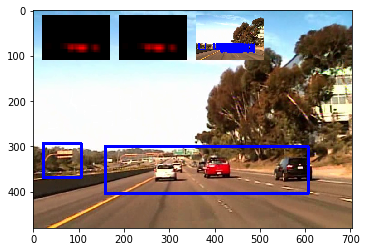



t:  54%|█████▎    | 161/300 [02:11<01:55,  1.21it/s, now=None]

t:  54%|█████▍    | 162/300 [02:12<01:52,  1.23it/s, now=None]

Found 240 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (63, 331)
Appending new object with centroid: (393, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  54%|█████▍    | 163/300 [02:12<01:49,  1.25it/s, now=None]

Found 215 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (63, 331)
new centroid= (61, 331)
old bbox= [[ 28 300]
 [ 98 363]]
new bbox= [[ 26 300]
 [ 96 362]]
**Found a match**
old centroid= (393, 352)
new centroid= (393, 352)
old bbox= [[184 300]
 [603 405]]
new bbox= [[184 300]
 [602 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  55%|█████▍    | 164/300 [02:13<01:48,  1.25it/s, now=None]

Found 227 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (61, 331)
new centroid= (56, 331)
old bbox= [[ 26 300]
 [ 96 362]]
new bbox= [[ 18 300]
 [ 94 362]]
**Found a match**
old centroid= (393, 352)
new centroid= (393, 352)
old bbox= [[184 300]
 [602 404]]
new bbox= [[184 300]
 [602 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  55%|█████▌    | 165/300 [02:14<01:47,  1.26it/s, now=None]

Found 229 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (56, 331)
new centroid= (56, 331)
old bbox= [[ 18 300]
 [ 94 362]]
new bbox= [[ 14 300]
 [ 98 362]]
**Found a match**
old centroid= (393, 352)
new centroid= (394, 352)
old bbox= [[184 300]
 [602 404]]
new bbox= [[185 300]
 [603 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 216 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (56, 331)
new centroid= (54, 331)
old bbox= [[ 14 300]
 [ 98 362]]
new bbox= [[ 12 300]
 [ 96 362]]
**Found a match**
old centroid= (394, 352)
new centroid= (395, 352)
old bbox= [[185 300]
 [603 404]]
new bbox= [[186 300]
 [604 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (54, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (395, 352) **
Refresh at frame n. 165: newly detected objects 2


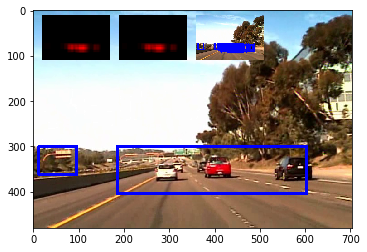



t:  55%|█████▌    | 166/300 [02:15<01:54,  1.17it/s, now=None]

t:  56%|█████▌    | 167/300 [02:16<01:49,  1.21it/s, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (45, 331)
Appending new object with centroid: (413, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  56%|█████▌    | 168/300 [02:16<01:45,  1.25it/s, now=None]

Found 229 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (45, 331)
new centroid= (54, 331)
old bbox= [[ 14 300]
 [ 77 363]]
new bbox= [[ 19 300]
 [ 89 362]]
**Found a match**
old centroid= (413, 352)
new centroid= (403, 352)
old bbox= [[224 300]
 [603 405]]
new bbox= [[194 300]
 [612 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  56%|█████▋    | 169/300 [02:17<01:43,  1.27it/s, now=None]

Found 225 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (54, 331)
new centroid= (56, 331)
old bbox= [[ 19 300]
 [ 89 362]]
new bbox= [[ 21 300]
 [ 91 362]]
**Found a match**
old centroid= (403, 352)
new centroid= (389, 352)
old bbox= [[194 300]
 [612 404]]
new bbox= [[162 300]
 [616 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  57%|█████▋    | 170/300 [02:18<01:42,  1.27it/s, now=None]

Found 213 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (56, 331)
new centroid= (54, 331)
old bbox= [[ 21 300]
 [ 91 362]]
new bbox= [[ 19 300]
 [ 89 362]]
Appending new object with centroid: (327, 352)
Appending new object with centroid: (561, 352)
previously detected objects= 2
so far newly detected objects= 4
Found 245 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (54, 331)
new centroid= (69, 338)
old bbox= [[ 19 300]
 [ 89 362]]
new bbox= [[ 13 293]
 [125 383]]
**Found a match**
old centroid= (389, 352)
new centroid= (385, 352)
old bbox= [[162 300]
 [616 404]]
new bbox= [[158 300]
 [612 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (69, 338) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (385, 352) **
number of times detected object appeared:  0
number of times detected object appeared:  0
Refr

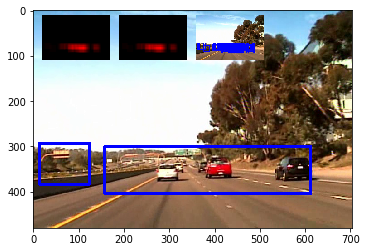



t:  57%|█████▋    | 171/300 [02:19<01:48,  1.19it/s, now=None]

t:  57%|█████▋    | 172/300 [02:20<01:44,  1.22it/s, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (52, 331)
Appending new object with centroid: (393, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  58%|█████▊    | 173/300 [02:21<01:42,  1.24it/s, now=None]

Found 238 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (52, 331)
new centroid= (52, 331)
old bbox= [[ 28 300]
 [ 77 363]]
new bbox= [[ 28 300]
 [ 76 362]]
**Found a match**
old centroid= (393, 352)
new centroid= (386, 352)
old bbox= [[184 300]
 [603 405]]
new bbox= [[163 300]
 [609 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  58%|█████▊    | 174/300 [02:21<01:40,  1.25it/s, now=None]

Found 242 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (52, 331)
new centroid= (52, 331)
old bbox= [[ 28 300]
 [ 76 362]]
new bbox= [[ 28 300]
 [ 76 362]]
**Found a match**
old centroid= (386, 352)
new centroid= (387, 352)
old bbox= [[163 300]
 [609 404]]
new bbox= [[164 300]
 [610 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  58%|█████▊    | 175/300 [02:22<01:38,  1.27it/s, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (52, 331)
new centroid= (52, 331)
old bbox= [[ 28 300]
 [ 76 362]]
new bbox= [[ 28 300]
 [ 76 362]]
**Found a match**
old centroid= (387, 352)
new centroid= (404, 352)
old bbox= [[164 300]
 [610 404]]
new bbox= [[181 300]
 [627 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 205 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (404, 352)
new centroid= (410, 352)
old bbox= [[181 300]
 [627 404]]
new bbox= [[187 300]
 [633 404]]
previously detected objects= 2
number of times detected object appeared:  3
** Adding similar object to one with centroid (52, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (410, 352) **
Refresh at frame n. 175: newly detected objects 2


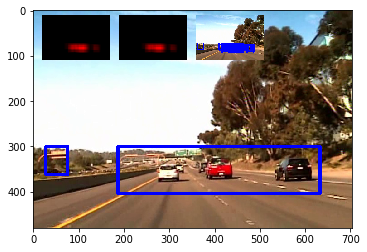



t:  59%|█████▊    | 176/300 [02:23<01:44,  1.19it/s, now=None]

t:  59%|█████▉    | 177/300 [02:24<01:41,  1.21it/s, now=None]

Found 232 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (63, 331)
Appending new object with centroid: (396, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  59%|█████▉    | 178/300 [02:25<01:38,  1.24it/s, now=None]

Found 208 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (63, 331)
new centroid= (54, 331)
old bbox= [[ 28 300]
 [ 98 363]]
new bbox= [[ 19 300]
 [ 89 362]]
**Found a match**
old centroid= (396, 352)
new centroid= (408, 352)
old bbox= [[190 300]
 [603 405]]
new bbox= [[202 300]
 [614 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  60%|█████▉    | 179/300 [02:25<01:36,  1.25it/s, now=None]

Found 208 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (54, 331)
new centroid= (46, 331)
old bbox= [[ 19 300]
 [ 89 362]]
new bbox= [[  8 300]
 [ 84 362]]
**Found a match**
old centroid= (408, 352)
new centroid= (410, 352)
old bbox= [[202 300]
 [614 404]]
new bbox= [[204 300]
 [616 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  60%|██████    | 180/300 [02:26<01:34,  1.28it/s, now=None]

Found 222 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (46, 331)
new centroid= (42, 331)
old bbox= [[  8 300]
 [ 84 362]]
new bbox= [[  4 300]
 [ 80 362]]
**Found a match**
old centroid= (410, 352)
new centroid= (399, 352)
old bbox= [[204 300]
 [616 404]]
new bbox= [[186 300]
 [612 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 204 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (42, 331)
new centroid= (36, 331)
old bbox= [[  4 300]
 [ 80 362]]
new bbox= [[ -2 300]
 [ 74 362]]
**Found a match**
old centroid= (399, 352)
new centroid= (410, 352)
old bbox= [[186 300]
 [612 404]]
new bbox= [[197 300]
 [623 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (36, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (410, 352) **
Refresh at frame n. 180: newly detected objects 2


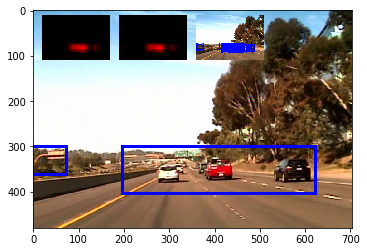



t:  60%|██████    | 181/300 [02:27<01:39,  1.19it/s, now=None]

t:  61%|██████    | 182/300 [02:28<01:37,  1.21it/s, now=None]

Found 225 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (31, 331)
Appending new object with centroid: (389, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  61%|██████    | 183/300 [02:29<01:34,  1.24it/s, now=None]

Found 283 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (31, 331)
new centroid= (34, 334)
old bbox= [[  0 300]
 [ 63 363]]
new bbox= [[ -4 296]
 [ 72 372]]
**Found a match**
old centroid= (389, 352)
new centroid= (378, 352)
old bbox= [[176 300]
 [603 405]]
new bbox= [[144 300]
 [612 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  61%|██████▏   | 184/300 [02:29<01:31,  1.26it/s, now=None]

Found 219 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (378, 352)
new centroid= (383, 352)
old bbox= [[144 300]
 [612 404]]
new bbox= [[149 300]
 [617 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  62%|██████▏   | 185/300 [02:30<01:30,  1.28it/s, now=None]

Found 244 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (34, 334)
new centroid= (36, 332)
old bbox= [[ -4 296]
 [ 72 372]]
new bbox= [[ -2 294]
 [ 74 370]]
**Found a match**
old centroid= (383, 352)
new centroid= (381, 352)
old bbox= [[149 300]
 [617 404]]
new bbox= [[147 300]
 [615 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 261 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (36, 332)
new centroid= (33, 331)
old bbox= [[ -2 294]
 [ 74 370]]
new bbox= [[ -5 293]
 [ 71 369]]
**Found a match**
old centroid= (381, 352)
new centroid= (378, 352)
old bbox= [[147 300]
 [615 404]]
new bbox= [[144 300]
 [612 404]]
previously detected objects= 2
number of times detected object appeared:  3
** Adding similar object to one with centroid (33, 331) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (378, 352) **
Refresh at frame n. 185: newly detected objects 2


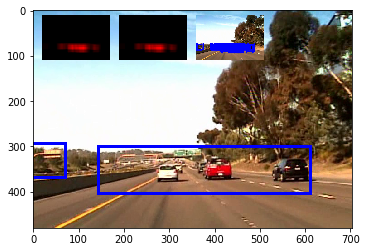



t:  62%|██████▏   | 186/300 [02:31<01:35,  1.20it/s, now=None]

t:  62%|██████▏   | 187/300 [02:32<01:34,  1.20it/s, now=None]

Found 242 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (38, 331)
Appending new object with centroid: (382, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  63%|██████▎   | 188/300 [02:33<01:32,  1.22it/s, now=None]

Found 254 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (378, 352)
old bbox= [[162 300]
 [603 405]]
new bbox= [[151 300]
 [605 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  63%|██████▎   | 189/300 [02:34<01:29,  1.24it/s, now=None]

Found 285 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (378, 352)
new centroid= (375, 352)
old bbox= [[151 300]
 [605 404]]
new bbox= [[145 300]
 [605 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  63%|██████▎   | 190/300 [02:34<01:26,  1.27it/s, now=None]

Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (378, 352)
old bbox= [[145 300]
 [605 404]]
new bbox= [[148 300]
 [608 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 241 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (378, 352)
new centroid= (378, 352)
old bbox= [[148 300]
 [608 404]]
new bbox= [[148 300]
 [608 404]]
previously detected objects= 2
number of times detected object appeared:  0
number of times detected object appeared:  4
** Adding similar object to one with centroid (378, 352) **
Refresh at frame n. 190: newly detected objects 1


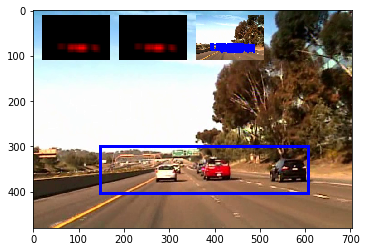



t:  64%|██████▎   | 191/300 [02:35<01:32,  1.18it/s, now=None]

t:  64%|██████▍   | 192/300 [02:36<01:28,  1.23it/s, now=None]

Found 282 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  64%|██████▍   | 193/300 [02:37<01:24,  1.26it/s, now=None]

Found 255 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (373, 352)
old bbox= [[142 300]
 [603 405]]
new bbox= [[143 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  65%|██████▍   | 194/300 [02:37<01:22,  1.28it/s, now=None]

Found 263 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (372, 352)
old bbox= [[143 300]
 [603 404]]
new bbox= [[142 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  65%|██████▌   | 195/300 [02:38<01:20,  1.30it/s, now=None]

Found 276 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (38, 331)
**Found a match**
old centroid= (372, 352)
new centroid= (375, 352)
old bbox= [[142 300]
 [602 404]]
new bbox= [[145 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (380, 352)
old bbox= [[145 300]
 [605 404]]
new bbox= [[150 300]
 [610 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (380, 352) **
number of times detected object appeared:  0
Refresh at frame n. 195: newly detected objects 1


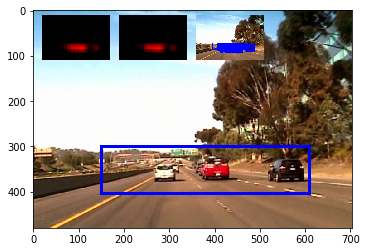



t:  65%|██████▌   | 196/300 [02:39<01:26,  1.21it/s, now=None]

t:  66%|██████▌   | 197/300 [02:40<01:23,  1.24it/s, now=None]

Found 253 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (382, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  66%|██████▌   | 198/300 [02:41<01:20,  1.27it/s, now=None]

Found 282 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (377, 352)
old bbox= [[161 300]
 [603 405]]
new bbox= [[147 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  66%|██████▋   | 199/300 [02:41<01:18,  1.29it/s, now=None]

Found 269 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (377, 352)
new centroid= (377, 352)
old bbox= [[147 300]
 [607 404]]
new bbox= [[147 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  67%|██████▋   | 200/300 [02:42<01:17,  1.29it/s, now=None]

Found 259 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (377, 352)
new centroid= (378, 352)
old bbox= [[147 300]
 [607 404]]
new bbox= [[148 300]
 [608 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 292 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (378, 352)
new centroid= (373, 352)
old bbox= [[148 300]
 [608 404]]
new bbox= [[139 300]
 [607 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (373, 352) **
Refresh at frame n. 200: newly detected objects 1


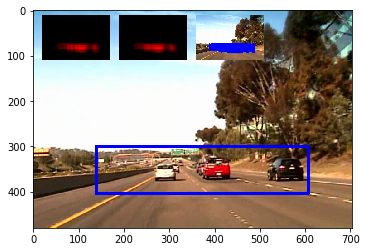



t:  67%|██████▋   | 201/300 [02:43<01:21,  1.22it/s, now=None]

t:  67%|██████▋   | 202/300 [02:44<01:18,  1.25it/s, now=None]

Found 233 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (379, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  68%|██████▊   | 203/300 [02:45<01:15,  1.28it/s, now=None]

Found 263 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (379, 352)
new centroid= (380, 352)
old bbox= [[156 300]
 [603 405]]
new bbox= [[157 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  68%|██████▊   | 204/300 [02:45<01:14,  1.29it/s, now=None]

Found 278 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (380, 352)
new centroid= (379, 352)
old bbox= [[157 300]
 [603 404]]
new bbox= [[155 300]
 [603 404]]
Appending new object with centroid: (109, 359)
previously detected objects= 1
so far newly detected objects= 2




t:  68%|██████▊   | 205/300 [02:46<01:12,  1.30it/s, now=None]

Found 246 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (379, 352)
new centroid= (380, 352)
old bbox= [[155 300]
 [603 404]]
new bbox= [[156 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 243 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (380, 352)
new centroid= (377, 352)
old bbox= [[156 300]
 [604 404]]
new bbox= [[150 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (377, 352) **
number of times detected object appeared:  0
Refresh at frame n. 205: newly detected objects 1


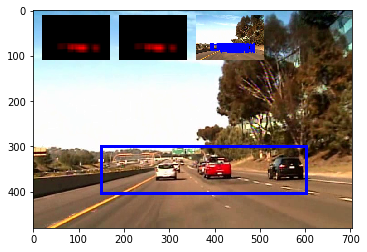



t:  69%|██████▊   | 206/300 [02:47<01:17,  1.21it/s, now=None]

t:  69%|██████▉   | 207/300 [02:48<01:15,  1.24it/s, now=None]

Found 249 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (354, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  69%|██████▉   | 208/300 [02:49<01:13,  1.26it/s, now=None]

Found 239 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (354, 352)
new centroid= (334, 352)
old bbox= [[105 300]
 [603 405]]
new bbox= [[ 85 300]
 [583 404]]
Appending new object with centroid: (557, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  70%|██████▉   | 209/300 [02:49<01:11,  1.27it/s, now=None]

Found 228 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 352)
new centroid= (359, 352)
old bbox= [[ 85 300]
 [583 404]]
new bbox= [[110 300]
 [608 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  70%|███████   | 210/300 [02:50<01:11,  1.26it/s, now=None]

Found 250 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 352)
new centroid= (372, 352)
old bbox= [[110 300]
 [608 404]]
new bbox= [[123 300]
 [621 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 251 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (377, 352)
old bbox= [[123 300]
 [621 404]]
new bbox= [[128 300]
 [626 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (377, 352) **
number of times detected object appeared:  0
Refresh at frame n. 210: newly detected objects 1


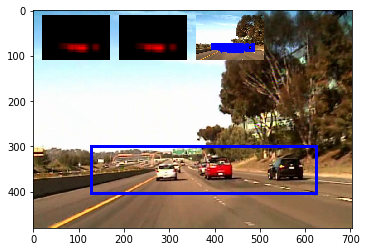



t:  70%|███████   | 211/300 [02:51<01:15,  1.19it/s, now=None]

t:  71%|███████   | 212/300 [02:52<01:12,  1.22it/s, now=None]

Found 256 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (386, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  71%|███████   | 213/300 [02:53<01:09,  1.25it/s, now=None]

Found 254 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (386, 352)
new centroid= (382, 352)
old bbox= [[170 300]
 [603 405]]
new bbox= [[159 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  71%|███████▏  | 214/300 [02:53<01:07,  1.28it/s, now=None]

Found 237 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (382, 352)
old bbox= [[159 300]
 [605 404]]
new bbox= [[159 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  72%|███████▏  | 215/300 [02:54<01:06,  1.28it/s, now=None]

Found 233 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (380, 352)
old bbox= [[159 300]
 [605 404]]
new bbox= [[157 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 258 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (380, 352)
new centroid= (379, 352)
old bbox= [[157 300]
 [603 404]]
new bbox= [[155 300]
 [603 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (379, 352) **
Refresh at frame n. 215: newly detected objects 1


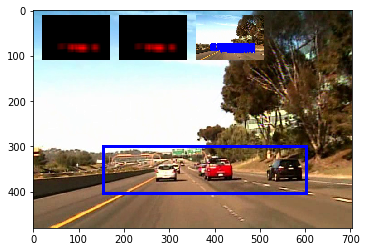



t:  72%|███████▏  | 216/300 [02:55<01:09,  1.20it/s, now=None]

t:  72%|███████▏  | 217/300 [02:56<01:06,  1.24it/s, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (382, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  73%|███████▎  | 218/300 [02:57<01:04,  1.28it/s, now=None]

Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (384, 352)
old bbox= [[162 300]
 [603 405]]
new bbox= [[164 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  73%|███████▎  | 219/300 [02:57<01:02,  1.29it/s, now=None]

Found 272 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (384, 352)
new centroid= (379, 352)
old bbox= [[164 300]
 [604 404]]
new bbox= [[152 300]
 [606 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  73%|███████▎  | 220/300 [02:58<01:01,  1.31it/s, now=None]

Found 248 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (379, 352)
new centroid= (375, 352)
old bbox= [[152 300]
 [606 404]]
new bbox= [[145 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (378, 352)
old bbox= [[145 300]
 [605 404]]
new bbox= [[148 300]
 [608 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (378, 352) **
Refresh at frame n. 220: newly detected objects 1


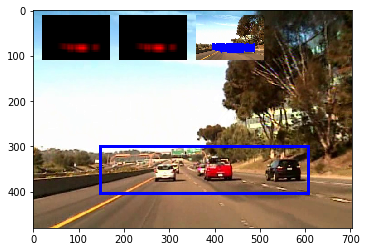



t:  74%|███████▎  | 221/300 [02:59<01:04,  1.22it/s, now=None]

t:  74%|███████▍  | 222/300 [03:00<01:03,  1.24it/s, now=None]

Found 275 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (368, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  74%|███████▍  | 223/300 [03:01<01:01,  1.26it/s, now=None]

Found 238 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 352)
new centroid= (368, 352)
old bbox= [[133 300]
 [603 405]]
new bbox= [[133 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  75%|███████▍  | 224/300 [03:01<00:59,  1.28it/s, now=None]

Found 223 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (200, 331)
**Found a match**
old centroid= (368, 352)
new centroid= (396, 352)
old bbox= [[133 300]
 [603 404]]
new bbox= [[161 300]
 [631 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  75%|███████▌  | 225/300 [03:02<00:58,  1.28it/s, now=None]

Found 239 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (396, 352)
new centroid= (387, 352)
old bbox= [[161 300]
 [631 404]]
new bbox= [[152 300]
 [622 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 224 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (322, 352)
Appending new object with centroid: (553, 345)
previously detected objects= 1
number of times detected object appeared:  3
** Adding similar object to one with centroid (387, 352) **
number of times detected object appeared:  0
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 225: newly detected objects 1


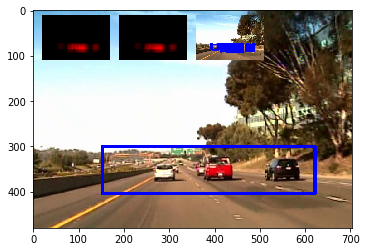



t:  75%|███████▌  | 226/300 [03:03<01:01,  1.20it/s, now=None]

t:  76%|███████▌  | 227/300 [03:04<00:59,  1.23it/s, now=None]

Found 220 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (196, 338)
Appending new object with centroid: (368, 352)
Appending new object with centroid: (550, 345)
previously detected objects= 1
so far newly detected objects= 3




t:  76%|███████▌  | 228/300 [03:05<00:57,  1.25it/s, now=None]

Found 239 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 352)
new centroid= (375, 352)
old bbox= [[246 300]
 [491 405]]
new bbox= [[154 300]
 [596 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  76%|███████▋  | 229/300 [03:05<00:55,  1.27it/s, now=None]

Found 253 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (375, 352)
old bbox= [[154 300]
 [596 404]]
new bbox= [[148 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  77%|███████▋  | 230/300 [03:06<00:54,  1.28it/s, now=None]

Found 283 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (371, 352)
old bbox= [[148 300]
 [602 404]]
new bbox= [[137 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 3
Found 281 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 352)
new centroid= (371, 352)
old bbox= [[137 300]
 [605 404]]
new bbox= [[137 300]
 [605 404]]
previously detected objects= 1
number of times detected object appeared:  0
number of times detected object appeared:  4
** Adding similar object to one with centroid (371, 352) **
number of times detected object appeared:  0
Refresh at frame n. 230: newly detected objects 1


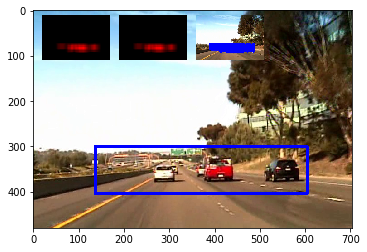



t:  77%|███████▋  | 231/300 [03:07<01:02,  1.11it/s, now=None]

t:  77%|███████▋  | 232/300 [03:08<00:58,  1.16it/s, now=None]

Found 254 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (379, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  78%|███████▊  | 233/300 [03:09<00:56,  1.19it/s, now=None]

Found 322 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (379, 352)
new centroid= (371, 352)
old bbox= [[156 300]
 [603 405]]
new bbox= [[133 300]
 [609 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  78%|███████▊  | 234/300 [03:10<00:54,  1.21it/s, now=None]

Found 281 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 352)
new centroid= (371, 352)
old bbox= [[133 300]
 [609 404]]
new bbox= [[133 300]
 [609 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  78%|███████▊  | 235/300 [03:10<00:52,  1.23it/s, now=None]

Found 288 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 352)
new centroid= (366, 352)
old bbox= [[133 300]
 [609 404]]
new bbox= [[125 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 274 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 352)
new centroid= (365, 352)
old bbox= [[125 300]
 [607 404]]
new bbox= [[124 300]
 [606 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (365, 352) **
Refresh at frame n. 235: newly detected objects 1


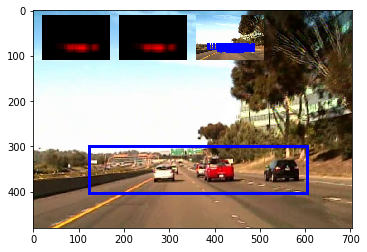



t:  79%|███████▊  | 236/300 [03:11<00:55,  1.15it/s, now=None]

t:  79%|███████▉  | 237/300 [03:12<00:53,  1.18it/s, now=None]

Found 264 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  79%|███████▉  | 238/300 [03:13<00:51,  1.20it/s, now=None]

Found 256 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (375, 352)
old bbox= [[142 300]
 [602 405]]
new bbox= [[145 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  80%|███████▉  | 239/300 [03:14<00:49,  1.22it/s, now=None]

Found 256 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (392, 352)
old bbox= [[145 300]
 [605 404]]
new bbox= [[162 300]
 [622 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  80%|████████  | 240/300 [03:15<00:48,  1.23it/s, now=None]

Found 271 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (392, 352)
new centroid= (397, 352)
old bbox= [[162 300]
 [622 404]]
new bbox= [[167 300]
 [627 404]]
Appending new object with centroid: (162, 345)
previously detected objects= 1
so far newly detected objects= 2
Found 271 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (397, 352)
new centroid= (388, 352)
old bbox= [[167 300]
 [627 404]]
new bbox= [[158 300]
 [618 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (388, 352) **
number of times detected object appeared:  0
Refresh at frame n. 240: newly detected objects 1


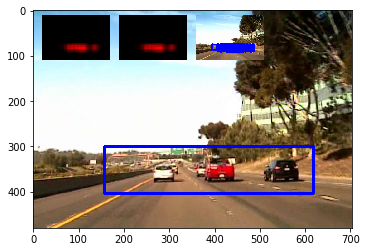



t:  80%|████████  | 241/300 [03:16<00:51,  1.16it/s, now=None]

t:  81%|████████  | 242/300 [03:16<00:48,  1.19it/s, now=None]

Found 253 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (393, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  81%|████████  | 243/300 [03:17<00:47,  1.21it/s, now=None]

Found 269 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (393, 352)
new centroid= (392, 352)
old bbox= [[184 300]
 [603 405]]
new bbox= [[182 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  81%|████████▏ | 244/300 [03:18<00:45,  1.22it/s, now=None]

Found 260 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (392, 352)
new centroid= (385, 352)
old bbox= [[182 300]
 [602 404]]
new bbox= [[162 300]
 [608 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  82%|████████▏ | 245/300 [03:19<00:44,  1.23it/s, now=None]

Found 283 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (385, 352)
new centroid= (380, 352)
old bbox= [[162 300]
 [608 404]]
new bbox= [[152 300]
 [608 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 282 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (380, 352)
new centroid= (375, 352)
old bbox= [[152 300]
 [608 404]]
new bbox= [[144 300]
 [606 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (375, 352) **
Refresh at frame n. 245: newly detected objects 1


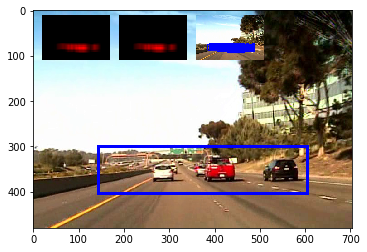



t:  82%|████████▏ | 246/300 [03:20<00:46,  1.15it/s, now=None]

t:  82%|████████▏ | 247/300 [03:21<00:44,  1.18it/s, now=None]

Found 256 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (382, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  83%|████████▎ | 248/300 [03:21<00:43,  1.20it/s, now=None]

Found 263 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (392, 352)
old bbox= [[161 300]
 [603 405]]
new bbox= [[171 300]
 [613 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  83%|████████▎ | 249/300 [03:22<00:41,  1.22it/s, now=None]

Found 263 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (392, 352)
new centroid= (397, 352)
old bbox= [[171 300]
 [613 404]]
new bbox= [[176 300]
 [618 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  83%|████████▎ | 250/300 [03:23<00:40,  1.23it/s, now=None]

Found 254 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (397, 352)
new centroid= (398, 352)
old bbox= [[176 300]
 [618 404]]
new bbox= [[177 300]
 [619 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 254 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (398, 352)
new centroid= (400, 352)
old bbox= [[177 300]
 [619 404]]
new bbox= [[179 300]
 [621 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (400, 352) **
Refresh at frame n. 250: newly detected objects 1


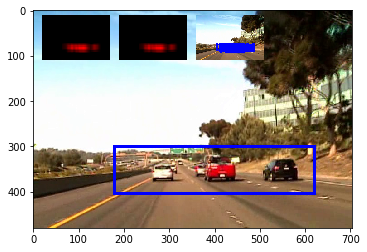



t:  84%|████████▎ | 251/300 [03:24<00:42,  1.16it/s, now=None]

t:  84%|████████▍ | 252/300 [03:25<00:40,  1.19it/s, now=None]

Found 276 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (403, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  84%|████████▍ | 253/300 [03:26<00:38,  1.22it/s, now=None]

Found 254 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (403, 352)
new centroid= (401, 352)
old bbox= [[204 300]
 [603 405]]
new bbox= [[198 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  85%|████████▍ | 254/300 [03:26<00:37,  1.24it/s, now=None]

Found 274 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (401, 352)
new centroid= (402, 352)
old bbox= [[198 300]
 [604 404]]
new bbox= [[199 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  85%|████████▌ | 255/300 [03:27<00:36,  1.25it/s, now=None]

Found 288 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (402, 352)
new centroid= (400, 352)
old bbox= [[199 300]
 [605 404]]
new bbox= [[197 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 261 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (386, 352)
old bbox= [[197 300]
 [603 404]]
new bbox= [[156 300]
 [616 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (386, 352) **
Refresh at frame n. 255: newly detected objects 1


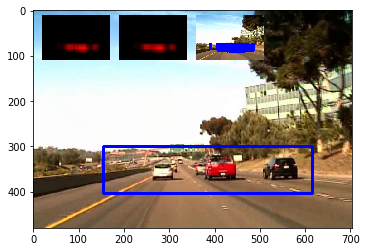



t:  85%|████████▌ | 256/300 [03:28<00:37,  1.17it/s, now=None]

t:  86%|████████▌ | 257/300 [03:29<00:36,  1.19it/s, now=None]

Found 266 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  86%|████████▌ | 258/300 [03:30<00:34,  1.22it/s, now=None]

Found 290 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (373, 352)
old bbox= [[142 300]
 [603 405]]
new bbox= [[143 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  86%|████████▋ | 259/300 [03:30<00:33,  1.24it/s, now=None]

Found 265 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (374, 352)
old bbox= [[143 300]
 [603 404]]
new bbox= [[144 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  87%|████████▋ | 260/300 [03:31<00:32,  1.25it/s, now=None]

Found 283 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (374, 352)
new centroid= (373, 352)
old bbox= [[144 300]
 [604 404]]
new bbox= [[143 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 292 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (372, 352)
old bbox= [[143 300]
 [603 404]]
new bbox= [[142 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (372, 352) **
Refresh at frame n. 260: newly detected objects 1


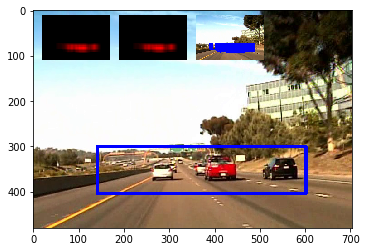



t:  87%|████████▋ | 261/300 [03:32<00:33,  1.16it/s, now=None]

t:  87%|████████▋ | 262/300 [03:33<00:32,  1.18it/s, now=None]

Found 255 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  88%|████████▊ | 263/300 [03:34<00:30,  1.21it/s, now=None]

Found 257 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (373, 352)
old bbox= [[142 300]
 [603 405]]
new bbox= [[143 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  88%|████████▊ | 264/300 [03:35<00:29,  1.23it/s, now=None]

Found 282 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (372, 352)
old bbox= [[143 300]
 [603 404]]
new bbox= [[141 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  88%|████████▊ | 265/300 [03:35<00:28,  1.24it/s, now=None]

Found 259 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (372, 352)
old bbox= [[141 300]
 [603 404]]
new bbox= [[141 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 272 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (372, 352)
old bbox= [[141 300]
 [603 404]]
new bbox= [[141 300]
 [603 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (372, 352) **
Refresh at frame n. 265: newly detected objects 1


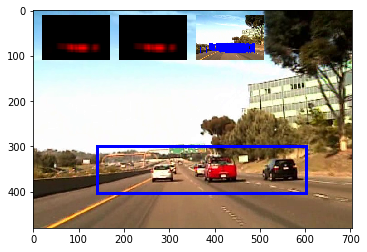



t:  89%|████████▊ | 266/300 [03:36<00:28,  1.18it/s, now=None]

t:  89%|████████▉ | 267/300 [03:37<00:27,  1.21it/s, now=None]

Found 310 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (326, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  89%|████████▉ | 268/300 [03:38<00:26,  1.23it/s, now=None]

Found 275 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (350, 352)
old bbox= [[ 49 300]
 [603 405]]
new bbox= [[ 73 300]
 [627 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  90%|████████▉ | 269/300 [03:39<00:24,  1.24it/s, now=None]

Found 257 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 352)
new centroid= (361, 352)
old bbox= [[ 73 300]
 [627 404]]
new bbox= [[ 84 300]
 [638 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  90%|█████████ | 270/300 [03:39<00:24,  1.24it/s, now=None]

Found 311 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 352)
new centroid= (364, 352)
old bbox= [[ 84 300]
 [638 404]]
new bbox= [[ 87 300]
 [641 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 267 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (364, 352)
new centroid= (368, 352)
old bbox= [[ 87 300]
 [641 404]]
new bbox= [[ 91 300]
 [645 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (368, 352) **
Refresh at frame n. 270: newly detected objects 1


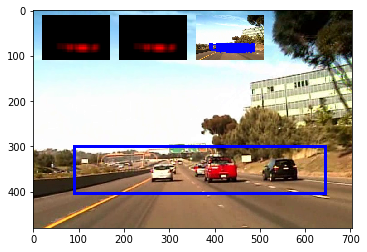



t:  90%|█████████ | 271/300 [03:40<00:24,  1.17it/s, now=None]

t:  91%|█████████ | 272/300 [03:41<00:23,  1.19it/s, now=None]

Found 263 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (371, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  91%|█████████ | 273/300 [03:42<00:22,  1.21it/s, now=None]

Found 284 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 352)
new centroid= (373, 352)
old bbox= [[140 300]
 [603 405]]
new bbox= [[142 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  91%|█████████▏| 274/300 [03:43<00:21,  1.23it/s, now=None]

Found 237 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (372, 352)
old bbox= [[142 300]
 [604 404]]
new bbox= [[141 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  92%|█████████▏| 275/300 [03:44<00:20,  1.23it/s, now=None]

Found 270 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (372, 352)
old bbox= [[141 300]
 [603 404]]
new bbox= [[141 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 281 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (370, 352)
old bbox= [[141 300]
 [603 404]]
new bbox= [[136 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (370, 352) **
Refresh at frame n. 275: newly detected objects 1


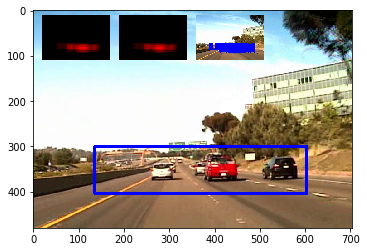



t:  92%|█████████▏| 276/300 [03:45<00:20,  1.17it/s, now=None]

t:  92%|█████████▏| 277/300 [03:45<00:19,  1.20it/s, now=None]

Found 255 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 278/300 [03:46<00:18,  1.21it/s, now=None]

Found 269 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (372, 352)
old bbox= [[142 300]
 [603 405]]
new bbox= [[142 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 279/300 [03:47<00:17,  1.22it/s, now=None]

Found 282 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (372, 352)
old bbox= [[142 300]
 [602 404]]
new bbox= [[142 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 280/300 [03:48<00:16,  1.24it/s, now=None]

Found 292 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (370, 352)
old bbox= [[142 300]
 [602 404]]
new bbox= [[135 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 268 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (370, 352)
new centroid= (369, 352)
old bbox= [[135 300]
 [605 404]]
new bbox= [[134 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (369, 352) **
Refresh at frame n. 280: newly detected objects 1


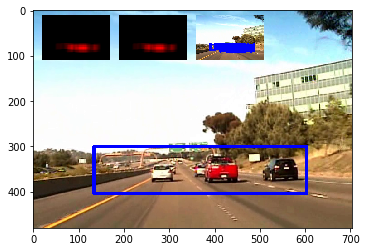



t:  94%|█████████▎| 281/300 [03:49<00:16,  1.16it/s, now=None]

t:  94%|█████████▍| 282/300 [03:50<00:15,  1.16it/s, now=None]

Found 289 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (368, 352)
Appending new object with centroid: (70, 359)
previously detected objects= 1
so far newly detected objects= 2




t:  94%|█████████▍| 283/300 [03:51<00:15,  1.08it/s, now=None]

Found 251 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (368, 352)
new centroid= (370, 352)
old bbox= [[134 300]
 [603 405]]
new bbox= [[136 300]
 [604 404]]
**Found a match**
old centroid= (70, 359)
new centroid= (61, 359)
old bbox= [[ 28 328]
 [112 391]]
new bbox= [[ 19 328]
 [103 390]]
previously detected objects= 1
so far newly detected objects= 2




t:  95%|█████████▍| 284/300 [03:52<00:14,  1.07it/s, now=None]

Found 245 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (370, 352)
new centroid= (386, 352)
old bbox= [[136 300]
 [604 404]]
new bbox= [[152 300]
 [620 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  95%|█████████▌| 285/300 [03:53<00:13,  1.11it/s, now=None]

Found 259 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (386, 352)
new centroid= (375, 352)
old bbox= [[152 300]
 [620 404]]
new bbox= [[138 300]
 [612 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 277 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (371, 352)
old bbox= [[138 300]
 [612 404]]
new bbox= [[134 300]
 [608 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (371, 352) **
number of times detected object appeared:  1
Refresh at frame n. 285: newly detected objects 1


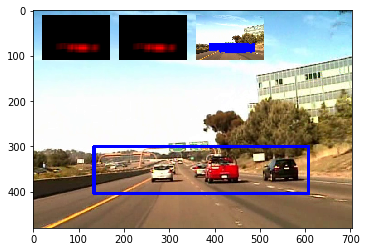



t:  95%|█████████▌| 286/300 [03:54<00:13,  1.05it/s, now=None]

t:  96%|█████████▌| 287/300 [03:54<00:11,  1.10it/s, now=None]

Found 259 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (368, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  96%|█████████▌| 288/300 [03:55<00:10,  1.10it/s, now=None]

Found 334 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 352)
new centroid= (366, 352)
old bbox= [[133 300]
 [603 405]]
new bbox= [[129 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  96%|█████████▋| 289/300 [03:56<00:09,  1.15it/s, now=None]

Found 278 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 352)
new centroid= (368, 352)
old bbox= [[129 300]
 [603 404]]
new bbox= [[131 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  97%|█████████▋| 290/300 [03:57<00:08,  1.18it/s, now=None]

Found 274 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 352)
new centroid= (368, 352)
old bbox= [[131 300]
 [605 404]]
new bbox= [[131 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 277 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 352)
new centroid= (366, 352)
old bbox= [[131 300]
 [605 404]]
new bbox= [[128 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (366, 352) **
Refresh at frame n. 290: newly detected objects 1


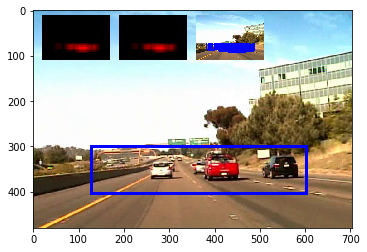



t:  97%|█████████▋| 291/300 [03:58<00:08,  1.12it/s, now=None]

t:  97%|█████████▋| 292/300 [03:59<00:06,  1.15it/s, now=None]

Found 256 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (365, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  98%|█████████▊| 293/300 [03:59<00:05,  1.20it/s, now=None]

Found 266 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 352)
new centroid= (365, 352)
old bbox= [[128 300]
 [603 405]]
new bbox= [[128 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  98%|█████████▊| 294/300 [04:00<00:04,  1.22it/s, now=None]

Found 284 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 352)
new centroid= (357, 352)
old bbox= [[128 300]
 [602 404]]
new bbox= [[105 300]
 [609 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  98%|█████████▊| 295/300 [04:01<00:04,  1.25it/s, now=None]

Found 222 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 352)
new centroid= (375, 352)
old bbox= [[105 300]
 [609 404]]
new bbox= [[123 300]
 [627 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 227 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 352)
new centroid= (383, 352)
old bbox= [[123 300]
 [627 404]]
new bbox= [[131 300]
 [635 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (383, 352) **
Refresh at frame n. 295: newly detected objects 1


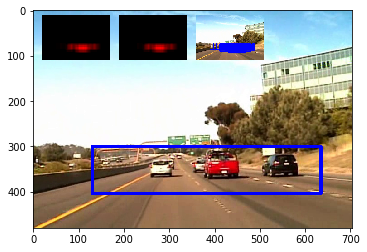



t:  99%|█████████▊| 296/300 [04:02<00:03,  1.16it/s, now=None]

t:  99%|█████████▉| 297/300 [04:03<00:02,  1.19it/s, now=None]

Found 267 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  99%|█████████▉| 298/300 [04:04<00:01,  1.21it/s, now=None]

Found 229 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (158, 331)
Appending new object with centroid: (424, 352)
previously detected objects= 1
so far newly detected objects= 3




t: 100%|█████████▉| 299/300 [04:04<00:00,  1.23it/s, now=None]

Found 223 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (158, 331)
new centroid= (160, 331)
old bbox= [[114 300]
 [203 363]]
new bbox= [[116 300]
 [204 362]]
**Found a match**
old centroid= (424, 352)
new centroid= (424, 352)
old bbox= [[246 300]
 [602 405]]
new bbox= [[246 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 3




t: 100%|██████████| 300/300 [04:05<00:00,  1.24it/s, now=None]

Found 260 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 352)
new centroid= (354, 352)
old bbox= [[ 92 300]
 [603 405]]
new bbox= [[ 99 300]
 [609 404]]
Appending new object with centroid: (81, 345)
previously detected objects= 1
so far newly detected objects= 4
Found 250 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 352)
new centroid= (357, 352)
old bbox= [[ 99 300]
 [609 404]]
new bbox= [[102 300]
 [612 404]]
previously detected objects= 1
number of times detected object appeared:  2
number of times detected object appeared:  1
number of times detected object appeared:  1
number of times detected object appeared:  0
Refresh at frame n. 300: newly detected objects 0


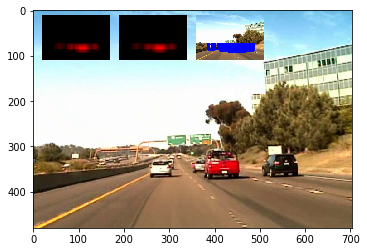



                                                              
t:   2%|▏         | 5/300 [34:23<13:02,  2.65s/it, now=None] 
                                                            ]
t:  24%|██▎       | 71/300 [32:20<07:52,  2.06s/it, now=None]

Moviepy - Done !
Moviepy - video ready output_videos/april21.mp4
CPU times: user 8min 3s, sys: 5.07 s, total: 8min 8s
Wall time: 4min 7s


In [299]:
detector = VehicleDetectorWithMemory(MLP, simple_classifier, normaliser, color_space="YCrCb", save_frame=False, 
                                     frame_sampling_rate=5, threshold=2, min_detection_count=3, 
                                     debug_imgs=True, cell_overlap=1)

clip1 = VideoFileClip(project_video_sample_path)
project_video_clip = clip1.fl_image(detector.process_image) 
%time project_video_clip.write_videofile(project_video_sample_output_path, audio=False)

Found 457 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 0
so far newly detected objects= 1


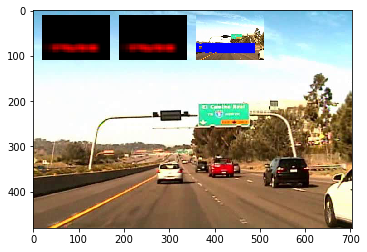

                                                            
t:   2%|▏         | 5/300 [22:53<13:02,  2.65s/it, now=None] 
                                                            ]
t:  24%|██▎       | 71/300 [20:50<07:52,  2.06s/it, now=None]

t:   0%|          | 0/300 [00:00<?, ?it/s, now=None]

Moviepy - Building video output_videos/april21.mp4.
Moviepy - Writing video output_videos/april21.mp4





t:   1%|          | 2/300 [00:00<02:16,  2.18it/s, now=None]

Found 457 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 1




t:   1%|          | 3/300 [00:01<02:50,  1.74it/s, now=None]

Found 469 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 1




t:   1%|▏         | 4/300 [00:02<03:02,  1.62it/s, now=None]

Found 458 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 1




t:   2%|▏         | 5/300 [00:03<03:12,  1.54it/s, now=None]

Found 474 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 1
Found 488 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 0
number of times detected object appeared:  5
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 5: newly detected objects 1


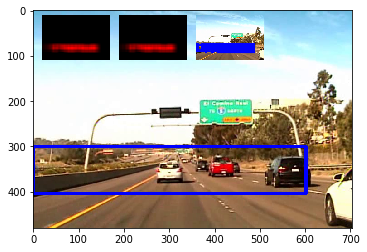



t:   2%|▏         | 6/300 [00:04<03:37,  1.35it/s, now=None]

t:   2%|▏         | 7/300 [00:04<03:37,  1.35it/s, now=None]

Found 432 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   3%|▎         | 8/300 [00:05<03:32,  1.38it/s, now=None]

Found 437 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   3%|▎         | 9/300 [00:06<03:28,  1.40it/s, now=None]

Found 434 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   3%|▎         | 10/300 [00:06<03:25,  1.41it/s, now=None]

Found 439 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 422 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 10: newly detected objects 1


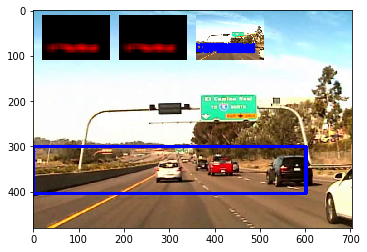



t:   4%|▎         | 11/300 [00:07<03:40,  1.31it/s, now=None]

t:   4%|▍         | 12/300 [00:08<03:32,  1.36it/s, now=None]

Found 450 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   4%|▍         | 13/300 [00:09<03:26,  1.39it/s, now=None]

Found 428 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   5%|▍         | 14/300 [00:09<03:23,  1.41it/s, now=None]

Found 458 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   5%|▌         | 15/300 [00:10<03:20,  1.42it/s, now=None]

Found 478 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 450 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 15: newly detected objects 1


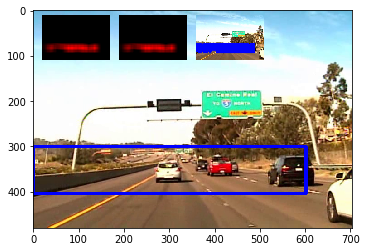



t:   5%|▌         | 16/300 [00:11<03:34,  1.33it/s, now=None]

t:   6%|▌         | 17/300 [00:12<03:26,  1.37it/s, now=None]

Found 441 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   6%|▌         | 18/300 [00:12<03:22,  1.40it/s, now=None]

Found 453 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   6%|▋         | 19/300 [00:13<03:22,  1.39it/s, now=None]

Found 457 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   7%|▋         | 20/300 [00:14<03:24,  1.37it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 436 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 20: newly detected objects 1


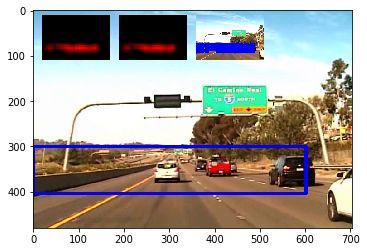



t:   7%|▋         | 21/300 [00:15<03:46,  1.23it/s, now=None]

t:   7%|▋         | 22/300 [00:16<03:47,  1.22it/s, now=None]

Found 433 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   8%|▊         | 23/300 [00:16<03:42,  1.24it/s, now=None]

Found 415 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   8%|▊         | 24/300 [00:17<03:42,  1.24it/s, now=None]

Found 419 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:   8%|▊         | 25/300 [00:18<03:37,  1.26it/s, now=None]

Found 423 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 426 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 25: newly detected objects 1


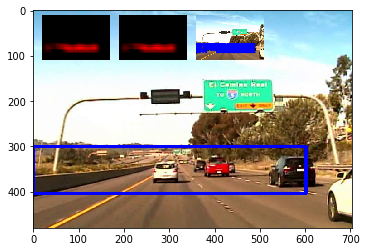



t:   9%|▊         | 26/300 [00:19<03:48,  1.20it/s, now=None]

t:   9%|▉         | 27/300 [00:20<03:45,  1.21it/s, now=None]

Found 415 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   9%|▉         | 28/300 [00:21<03:47,  1.20it/s, now=None]

Found 398 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  10%|▉         | 29/300 [00:21<03:40,  1.23it/s, now=None]

Found 399 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  10%|█         | 30/300 [00:22<03:31,  1.28it/s, now=None]

Found 350 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 408 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 30: newly detected objects 1


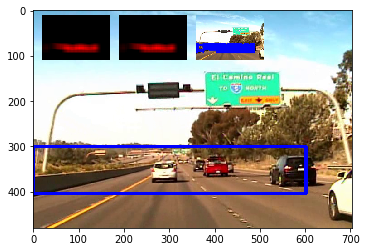



t:  10%|█         | 31/300 [00:23<03:40,  1.22it/s, now=None]

t:  11%|█         | 32/300 [00:24<03:31,  1.27it/s, now=None]

Found 384 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  11%|█         | 33/300 [00:24<03:22,  1.32it/s, now=None]

Found 397 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  11%|█▏        | 34/300 [00:25<03:16,  1.35it/s, now=None]

Found 387 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  12%|█▏        | 35/300 [00:26<03:11,  1.38it/s, now=None]

Found 380 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (301, 352)
new centroid= (320, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[ 19 300]
 [621 404]]
Appending new object with centroid: (31, 352)
previously detected objects= 1
so far newly detected objects= 2
Found 392 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (320, 352)
new centroid= (330, 352)
old bbox= [[ 19 300]
 [621 404]]
new bbox= [[ 29 300]
 [631 404]]
**Found a match**
old centroid= (31, 352)
new centroid= (31, 348)
old bbox= [[  0 314]
 [ 63 391]]
new bbox= [[  0 310]
 [ 62 386]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (330, 352) **
number of times detected object appeared:  1
Refresh at frame n. 35: newly detected objects 1


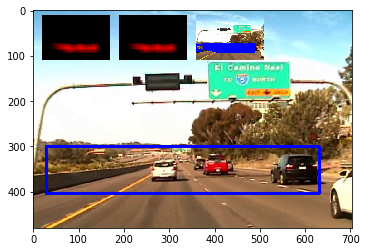



t:  12%|█▏        | 36/300 [00:27<03:25,  1.29it/s, now=None]

t:  12%|█▏        | 37/300 [00:27<03:17,  1.33it/s, now=None]

Found 405 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  13%|█▎        | 38/300 [00:28<03:11,  1.37it/s, now=None]

Found 385 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [603 405]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  13%|█▎        | 39/300 [00:29<03:06,  1.40it/s, now=None]

Found 424 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  13%|█▎        | 40/300 [00:29<03:03,  1.41it/s, now=None]

Found 400 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 419 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (340, 352) **
Refresh at frame n. 40: newly detected objects 1


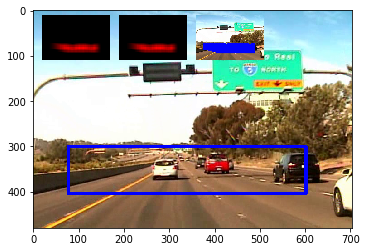



t:  14%|█▎        | 41/300 [00:30<03:16,  1.32it/s, now=None]

t:  14%|█▍        | 42/300 [00:31<03:08,  1.37it/s, now=None]

Found 421 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  14%|█▍        | 43/300 [00:32<03:03,  1.40it/s, now=None]

Found 447 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [603 405]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  15%|█▍        | 44/300 [00:32<03:01,  1.41it/s, now=None]

Found 441 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  15%|█▌        | 45/300 [00:33<02:58,  1.43it/s, now=None]

Found 407 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 383 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (340, 352) **
Refresh at frame n. 45: newly detected objects 1


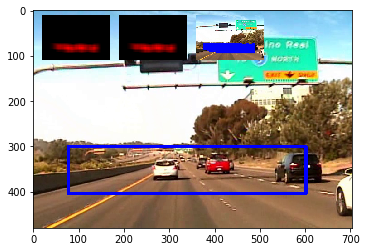



t:  15%|█▌        | 46/300 [00:34<03:11,  1.33it/s, now=None]

t:  16%|█▌        | 47/300 [00:35<03:03,  1.38it/s, now=None]

Found 424 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  16%|█▌        | 48/300 [00:35<03:00,  1.40it/s, now=None]

Found 398 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [603 405]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  16%|█▋        | 49/300 [00:36<02:58,  1.41it/s, now=None]

Found 404 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  17%|█▋        | 50/300 [00:37<02:56,  1.42it/s, now=None]

Found 378 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 359 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [602 404]]
new bbox= [[ 78 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (340, 352) **
Refresh at frame n. 50: newly detected objects 1


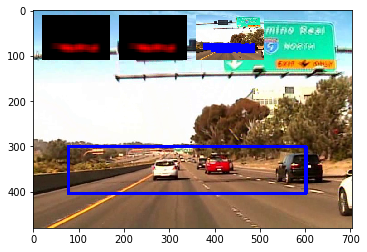



t:  17%|█▋        | 51/300 [00:38<03:10,  1.31it/s, now=None]

t:  17%|█▋        | 52/300 [00:38<03:04,  1.35it/s, now=None]

Found 423 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  18%|█▊        | 53/300 [00:39<02:59,  1.38it/s, now=None]

Found 422 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 78 300]
 [603 405]]
new bbox= [[ 77 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  18%|█▊        | 54/300 [00:40<02:55,  1.40it/s, now=None]

Found 407 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 77 300]
 [603 404]]
new bbox= [[ 77 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  18%|█▊        | 55/300 [00:40<02:52,  1.42it/s, now=None]

Found 434 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 77 300]
 [603 404]]
new bbox= [[ 77 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 377 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 77 300]
 [603 404]]
new bbox= [[ 77 300]
 [603 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (340, 352) **
Refresh at frame n. 55: newly detected objects 1


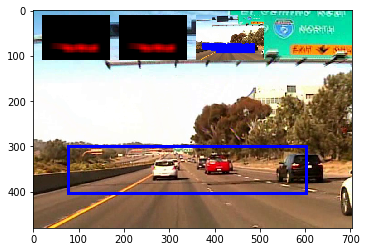



t:  19%|█▊        | 56/300 [00:41<03:05,  1.31it/s, now=None]

t:  19%|█▉        | 57/300 [00:42<02:58,  1.36it/s, now=None]

Found 375 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  19%|█▉        | 58/300 [00:42<02:52,  1.41it/s, now=None]

Found 354 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 77 300]
 [603 405]]
new bbox= [[ 77 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  20%|█▉        | 59/300 [00:43<02:49,  1.42it/s, now=None]

Found 380 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 77 300]
 [603 404]]
new bbox= [[ 77 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  20%|██        | 60/300 [00:44<02:47,  1.43it/s, now=None]

Found 403 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (340, 352)
old bbox= [[ 77 300]
 [603 404]]
new bbox= [[ 77 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 417 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (338, 352)
old bbox= [[ 77 300]
 [603 404]]
new bbox= [[ 72 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (338, 352) **
Refresh at frame n. 60: newly detected objects 1


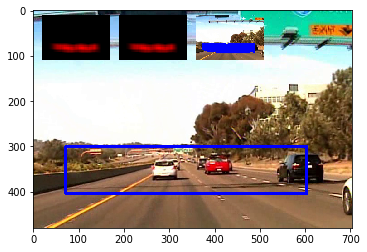



t:  20%|██        | 61/300 [00:45<03:00,  1.33it/s, now=None]

t:  21%|██        | 62/300 [00:45<02:54,  1.37it/s, now=None]

Found 410 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (336, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  21%|██        | 63/300 [00:46<02:49,  1.40it/s, now=None]

Found 384 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 352)
new centroid= (334, 352)
old bbox= [[ 70 300]
 [603 405]]
new bbox= [[ 64 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  21%|██▏       | 64/300 [00:47<02:45,  1.42it/s, now=None]

Found 390 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 352)
new centroid= (337, 352)
old bbox= [[ 64 300]
 [604 404]]
new bbox= [[ 67 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  22%|██▏       | 65/300 [00:47<02:43,  1.44it/s, now=None]

Found 396 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 352)
new centroid= (338, 352)
old bbox= [[ 67 300]
 [607 404]]
new bbox= [[ 68 300]
 [608 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 422 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (338, 352)
new centroid= (335, 352)
old bbox= [[ 68 300]
 [608 404]]
new bbox= [[ 65 300]
 [605 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (335, 352) **
Refresh at frame n. 65: newly detected objects 1


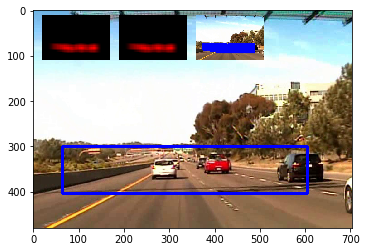



t:  22%|██▏       | 66/300 [00:48<02:56,  1.33it/s, now=None]

t:  22%|██▏       | 67/300 [00:49<02:50,  1.37it/s, now=None]

Found 429 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (333, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  23%|██▎       | 68/300 [00:50<02:45,  1.40it/s, now=None]

Found 413 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 352)
new centroid= (333, 352)
old bbox= [[ 64 300]
 [603 405]]
new bbox= [[ 64 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  23%|██▎       | 69/300 [00:50<02:43,  1.41it/s, now=None]

Found 372 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 352)
new centroid= (333, 352)
old bbox= [[ 64 300]
 [602 404]]
new bbox= [[ 64 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  23%|██▎       | 70/300 [00:51<02:42,  1.41it/s, now=None]

Found 428 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 352)
new centroid= (333, 352)
old bbox= [[ 64 300]
 [602 404]]
new bbox= [[ 64 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 424 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 352)
new centroid= (333, 352)
old bbox= [[ 64 300]
 [602 404]]
new bbox= [[ 64 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (333, 352) **
Refresh at frame n. 70: newly detected objects 1


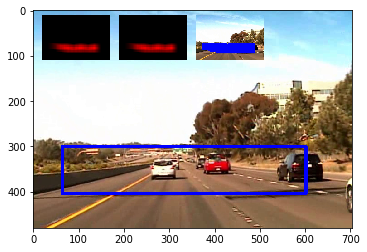



t:  24%|██▎       | 71/300 [00:52<02:53,  1.32it/s, now=None]

t:  24%|██▍       | 72/300 [00:53<02:46,  1.37it/s, now=None]

Found 377 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (333, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  24%|██▍       | 73/300 [00:53<02:42,  1.40it/s, now=None]

Found 420 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 352)
new centroid= (320, 352)
old bbox= [[ 64 300]
 [603 405]]
new bbox= [[ 26 300]
 [614 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  25%|██▍       | 74/300 [00:54<02:38,  1.42it/s, now=None]

Found 324 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (320, 352)
new centroid= (326, 352)
old bbox= [[ 26 300]
 [614 404]]
new bbox= [[ 32 300]
 [620 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  25%|██▌       | 75/300 [00:55<02:35,  1.44it/s, now=None]

Found 332 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (329, 352)
old bbox= [[ 32 300]
 [620 404]]
new bbox= [[ 35 300]
 [623 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 334 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (329, 352)
new centroid= (331, 352)
old bbox= [[ 35 300]
 [623 404]]
new bbox= [[ 37 300]
 [625 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (331, 352) **
Refresh at frame n. 75: newly detected objects 1


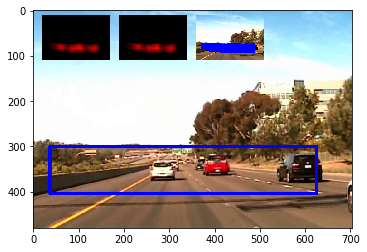



t:  25%|██▌       | 76/300 [00:56<02:46,  1.34it/s, now=None]

t:  26%|██▌       | 77/300 [00:56<02:41,  1.38it/s, now=None]

Found 422 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (329, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  26%|██▌       | 78/300 [00:57<02:37,  1.41it/s, now=None]

Found 417 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (329, 352)
new centroid= (331, 352)
old bbox= [[ 56 300]
 [603 405]]
new bbox= [[ 58 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  26%|██▋       | 79/300 [00:58<02:34,  1.43it/s, now=None]

Found 404 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 352)
new centroid= (330, 352)
old bbox= [[ 58 300]
 [604 404]]
new bbox= [[ 57 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  27%|██▋       | 80/300 [00:58<02:31,  1.45it/s, now=None]

Found 367 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 352)
new centroid= (331, 352)
old bbox= [[ 57 300]
 [603 404]]
new bbox= [[ 58 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 384 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 352)
new centroid= (332, 352)
old bbox= [[ 58 300]
 [604 404]]
new bbox= [[ 59 300]
 [605 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (332, 352) **
Refresh at frame n. 80: newly detected objects 1


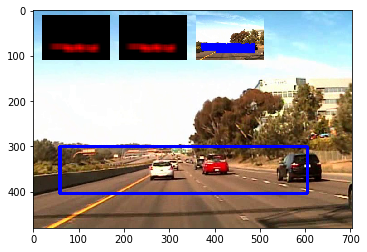



t:  27%|██▋       | 81/300 [00:59<02:44,  1.33it/s, now=None]

t:  27%|██▋       | 82/300 [01:00<02:38,  1.38it/s, now=None]

Found 386 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (326, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  28%|██▊       | 83/300 [01:00<02:36,  1.38it/s, now=None]

Found 449 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [603 405]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  28%|██▊       | 84/300 [01:01<02:35,  1.39it/s, now=None]

Found 418 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [602 404]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  28%|██▊       | 85/300 [01:02<02:31,  1.42it/s, now=None]

Found 408 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [602 404]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 426 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [602 404]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (326, 352) **
Refresh at frame n. 85: newly detected objects 1


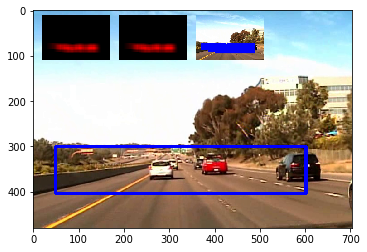



t:  29%|██▊       | 86/300 [01:03<02:45,  1.30it/s, now=None]

t:  29%|██▉       | 87/300 [01:04<02:39,  1.33it/s, now=None]

Found 405 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (326, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  29%|██▉       | 88/300 [01:04<02:34,  1.37it/s, now=None]

Found 429 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [603 405]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  30%|██▉       | 89/300 [01:05<02:30,  1.40it/s, now=None]

Found 407 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [602 404]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  30%|███       | 90/300 [01:06<02:27,  1.42it/s, now=None]

Found 421 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [602 404]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 441 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (326, 352)
old bbox= [[ 50 300]
 [602 404]]
new bbox= [[ 50 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (326, 352) **
Refresh at frame n. 90: newly detected objects 1


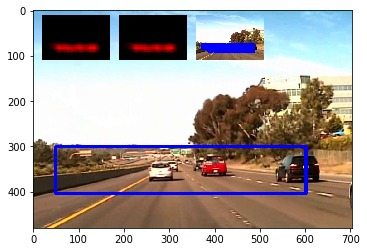



t:  30%|███       | 91/300 [01:06<02:41,  1.30it/s, now=None]

t:  31%|███       | 92/300 [01:07<02:34,  1.34it/s, now=None]

Found 380 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (322, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  31%|███       | 93/300 [01:08<02:31,  1.37it/s, now=None]

Found 374 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (322, 352)
new centroid= (324, 352)
old bbox= [[ 42 300]
 [603 405]]
new bbox= [[ 44 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  31%|███▏      | 94/300 [01:09<02:27,  1.40it/s, now=None]

Found 405 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (324, 352)
new centroid= (323, 352)
old bbox= [[ 44 300]
 [604 404]]
new bbox= [[ 43 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  32%|███▏      | 95/300 [01:09<02:25,  1.41it/s, now=None]

Found 367 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 352)
new centroid= (322, 352)
old bbox= [[ 43 300]
 [603 404]]
new bbox= [[ 42 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 434 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (322, 352)
new centroid= (318, 352)
old bbox= [[ 42 300]
 [602 404]]
new bbox= [[ 31 300]
 [605 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (318, 352) **
Refresh at frame n. 95: newly detected objects 1


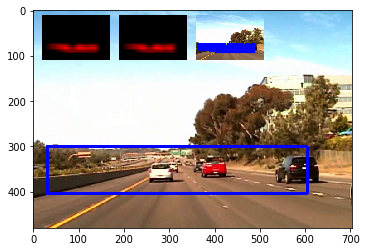



t:  32%|███▏      | 96/300 [01:10<02:36,  1.31it/s, now=None]

t:  32%|███▏      | 97/300 [01:11<02:29,  1.35it/s, now=None]

Found 430 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (319, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  33%|███▎      | 98/300 [01:11<02:25,  1.39it/s, now=None]

Found 370 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (319, 352)
new centroid= (318, 352)
old bbox= [[ 35 300]
 [603 405]]
new bbox= [[ 34 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  33%|███▎      | 99/300 [01:12<02:38,  1.27it/s, now=None]

Found 433 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (318, 352)
new centroid= (318, 352)
old bbox= [[ 34 300]
 [602 404]]
new bbox= [[ 34 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  33%|███▎      | 100/300 [01:13<02:36,  1.28it/s, now=None]

Found 438 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (318, 352)
new centroid= (318, 352)
old bbox= [[ 34 300]
 [602 404]]
new bbox= [[ 34 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (318, 352)
new centroid= (318, 352)
old bbox= [[ 34 300]
 [602 404]]
new bbox= [[ 34 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (318, 352) **
Refresh at frame n. 100: newly detected objects 1


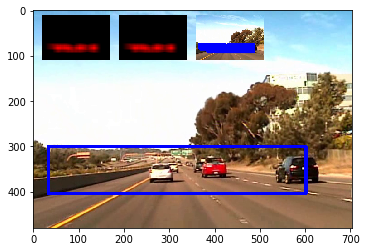



t:  34%|███▎      | 101/300 [01:14<02:47,  1.19it/s, now=None]

t:  34%|███▍      | 102/300 [01:15<02:38,  1.25it/s, now=None]

Found 455 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (319, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  34%|███▍      | 103/300 [01:16<02:31,  1.30it/s, now=None]

Found 439 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (319, 352)
new centroid= (317, 352)
old bbox= [[ 35 300]
 [603 405]]
new bbox= [[ 30 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  35%|███▍      | 104/300 [01:16<02:30,  1.31it/s, now=None]

Found 450 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (317, 352)
new centroid= (316, 352)
old bbox= [[ 30 300]
 [604 404]]
new bbox= [[ 29 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  35%|███▌      | 105/300 [01:17<02:27,  1.32it/s, now=None]

Found 433 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (316, 352)
new centroid= (315, 352)
old bbox= [[ 29 300]
 [603 404]]
new bbox= [[ 28 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 393 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (317, 352)
old bbox= [[ 28 300]
 [602 404]]
new bbox= [[ 30 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (317, 352) **
Refresh at frame n. 105: newly detected objects 1


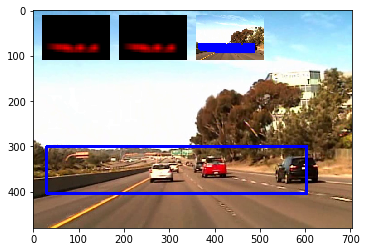



t:  35%|███▌      | 106/300 [01:18<02:36,  1.24it/s, now=None]

t:  36%|███▌      | 107/300 [01:19<02:28,  1.30it/s, now=None]

Found 395 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (308, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  36%|███▌      | 108/300 [01:19<02:25,  1.32it/s, now=None]

Found 417 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [603 405]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  36%|███▋      | 109/300 [01:20<02:21,  1.35it/s, now=None]

Found 407 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (311, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 17 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  37%|███▋      | 110/300 [01:21<02:17,  1.38it/s, now=None]

Found 440 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (311, 352)
new centroid= (313, 352)
old bbox= [[ 17 300]
 [605 404]]
new bbox= [[ 19 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 396 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (313, 352)
new centroid= (314, 352)
old bbox= [[ 19 300]
 [607 404]]
new bbox= [[ 20 300]
 [608 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (314, 352) **
Refresh at frame n. 110: newly detected objects 1


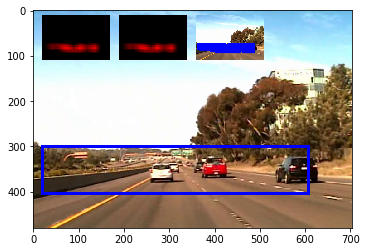



t:  37%|███▋      | 111/300 [01:22<02:26,  1.29it/s, now=None]

t:  37%|███▋      | 112/300 [01:22<02:20,  1.34it/s, now=None]

Found 391 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (315, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  38%|███▊      | 113/300 [01:23<02:16,  1.37it/s, now=None]

Found 435 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[ 28 300]
 [603 405]]
new bbox= [[ 28 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  38%|███▊      | 114/300 [01:24<02:12,  1.40it/s, now=None]

Found 432 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[ 28 300]
 [602 404]]
new bbox= [[ 28 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  38%|███▊      | 115/300 [01:24<02:10,  1.41it/s, now=None]

Found 429 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[ 28 300]
 [602 404]]
new bbox= [[ 28 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 480 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[ 28 300]
 [602 404]]
new bbox= [[ 28 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (315, 352) **
Refresh at frame n. 115: newly detected objects 1


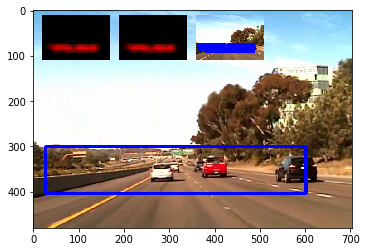



t:  39%|███▊      | 116/300 [01:25<02:20,  1.31it/s, now=None]

t:  39%|███▉      | 117/300 [01:26<02:14,  1.36it/s, now=None]

Found 461 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (315, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  39%|███▉      | 118/300 [01:27<02:10,  1.39it/s, now=None]

Found 457 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[ 28 300]
 [603 405]]
new bbox= [[ 28 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  40%|███▉      | 119/300 [01:27<02:07,  1.42it/s, now=None]

Found 425 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (315, 352)
old bbox= [[ 28 300]
 [602 404]]
new bbox= [[ 28 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  40%|████      | 120/300 [01:28<02:05,  1.44it/s, now=None]

Found 448 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (311, 352)
old bbox= [[ 28 300]
 [602 404]]
new bbox= [[ 17 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 442 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (311, 352)
new centroid= (309, 352)
old bbox= [[ 17 300]
 [605 404]]
new bbox= [[ 15 300]
 [603 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (309, 352) **
Refresh at frame n. 120: newly detected objects 1


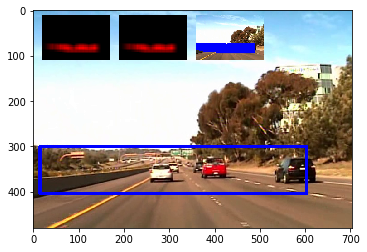



t:  40%|████      | 121/300 [01:29<02:13,  1.34it/s, now=None]

t:  41%|████      | 122/300 [01:30<02:09,  1.37it/s, now=None]

Found 429 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (308, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  41%|████      | 123/300 [01:30<02:06,  1.40it/s, now=None]

Found 437 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [603 405]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  41%|████▏     | 124/300 [01:31<02:03,  1.42it/s, now=None]

Found 431 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  42%|████▏     | 125/300 [01:32<02:01,  1.44it/s, now=None]

Found 410 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 485 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (308, 352) **
Refresh at frame n. 125: newly detected objects 1


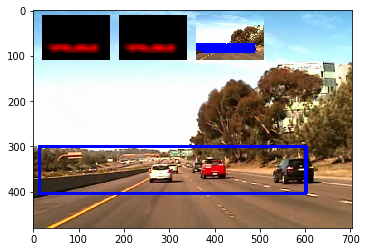



t:  42%|████▏     | 126/300 [01:32<02:09,  1.34it/s, now=None]

t:  42%|████▏     | 127/300 [01:33<02:05,  1.37it/s, now=None]

Found 433 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (308, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  43%|████▎     | 128/300 [01:34<02:03,  1.40it/s, now=None]

Found 410 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [603 405]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  43%|████▎     | 129/300 [01:35<02:00,  1.42it/s, now=None]

Found 426 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  43%|████▎     | 130/300 [01:35<01:59,  1.43it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 447 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (308, 352) **
Refresh at frame n. 130: newly detected objects 1


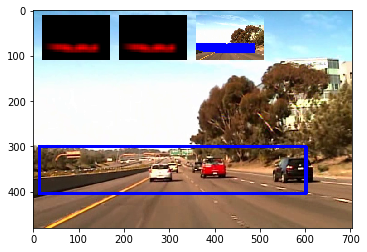



t:  44%|████▎     | 131/300 [01:36<02:07,  1.32it/s, now=None]

t:  44%|████▍     | 132/300 [01:37<02:03,  1.36it/s, now=None]

Found 442 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  44%|████▍     | 133/300 [01:37<01:59,  1.39it/s, now=None]

Found 441 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (304, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  3 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  45%|████▍     | 134/300 [01:38<01:56,  1.42it/s, now=None]

Found 461 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (304, 352)
new centroid= (306, 352)
old bbox= [[  3 300]
 [605 404]]
new bbox= [[  5 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  45%|████▌     | 135/300 [01:39<01:55,  1.43it/s, now=None]

Found 465 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (306, 352)
new centroid= (307, 352)
old bbox= [[  5 300]
 [607 404]]
new bbox= [[  6 300]
 [608 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 461 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (307, 352)
new centroid= (307, 352)
old bbox= [[  6 300]
 [608 404]]
new bbox= [[  6 300]
 [608 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (307, 352) **
Refresh at frame n. 135: newly detected objects 1


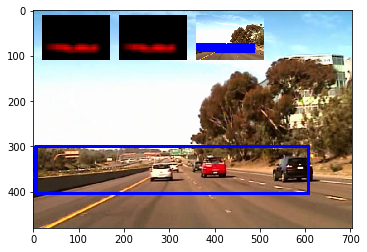



t:  45%|████▌     | 136/300 [01:40<02:03,  1.33it/s, now=None]

t:  46%|████▌     | 137/300 [01:40<01:59,  1.36it/s, now=None]

Found 418 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (308, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  46%|████▌     | 138/300 [01:41<01:55,  1.40it/s, now=None]

Found 437 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [603 405]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  46%|████▋     | 139/300 [01:42<01:53,  1.42it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  47%|████▋     | 140/300 [01:42<01:51,  1.43it/s, now=None]

Found 428 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 449 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (308, 352) **
Refresh at frame n. 140: newly detected objects 1


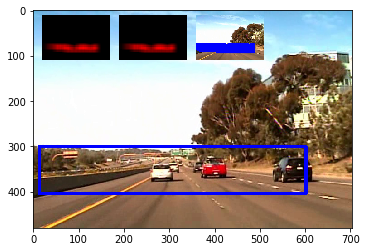



t:  47%|████▋     | 141/300 [01:43<01:59,  1.33it/s, now=None]

t:  47%|████▋     | 142/300 [01:44<01:55,  1.37it/s, now=None]

Found 438 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (308, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  48%|████▊     | 143/300 [01:45<01:52,  1.39it/s, now=None]

Found 432 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [603 405]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  48%|████▊     | 144/300 [01:45<01:50,  1.42it/s, now=None]

Found 434 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  48%|████▊     | 145/300 [01:46<01:47,  1.44it/s, now=None]

Found 461 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 427 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (308, 352)
old bbox= [[ 14 300]
 [602 404]]
new bbox= [[ 14 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (308, 352) **
Refresh at frame n. 145: newly detected objects 1


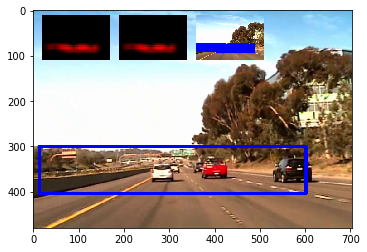



t:  49%|████▊     | 146/300 [01:47<02:05,  1.22it/s, now=None]

t:  49%|████▉     | 147/300 [01:48<01:59,  1.28it/s, now=None]

Found 481 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  49%|████▉     | 148/300 [01:49<01:54,  1.33it/s, now=None]

Found 461 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  50%|████▉     | 149/300 [01:49<01:52,  1.34it/s, now=None]

Found 445 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (304, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  3 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  50%|█████     | 150/300 [01:50<01:49,  1.37it/s, now=None]

Found 462 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (304, 352)
new centroid= (302, 352)
old bbox= [[  3 300]
 [605 404]]
new bbox= [[  1 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 457 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (302, 352)
new centroid= (301, 352)
old bbox= [[  1 300]
 [603 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 150: newly detected objects 1


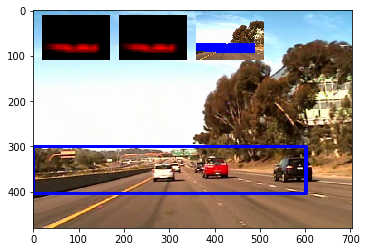



t:  50%|█████     | 151/300 [01:51<01:56,  1.28it/s, now=None]

t:  51%|█████     | 152/300 [01:52<01:52,  1.31it/s, now=None]

Found 430 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (308, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  51%|█████     | 153/300 [01:52<01:49,  1.34it/s, now=None]

Found 421 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (304, 352)
old bbox= [[ 14 300]
 [603 405]]
new bbox= [[  3 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  51%|█████▏    | 154/300 [01:53<01:46,  1.37it/s, now=None]

Found 439 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (304, 352)
new centroid= (302, 352)
old bbox= [[  3 300]
 [605 404]]
new bbox= [[  1 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  52%|█████▏    | 155/300 [01:54<01:44,  1.39it/s, now=None]

Found 470 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (302, 352)
new centroid= (305, 352)
old bbox= [[  1 300]
 [603 404]]
new bbox= [[  4 300]
 [606 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 391 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (305, 352)
new centroid= (303, 352)
old bbox= [[  4 300]
 [606 404]]
new bbox= [[  2 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (303, 352) **
Refresh at frame n. 155: newly detected objects 1


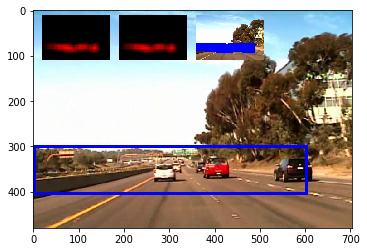



t:  52%|█████▏    | 156/300 [01:55<01:51,  1.29it/s, now=None]

t:  52%|█████▏    | 157/300 [01:55<01:47,  1.32it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  53%|█████▎    | 158/300 [01:56<01:45,  1.35it/s, now=None]

Found 414 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  53%|█████▎    | 159/300 [01:57<01:42,  1.37it/s, now=None]

Found 471 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  53%|█████▎    | 160/300 [01:57<01:40,  1.39it/s, now=None]

Found 447 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 444 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 160: newly detected objects 1


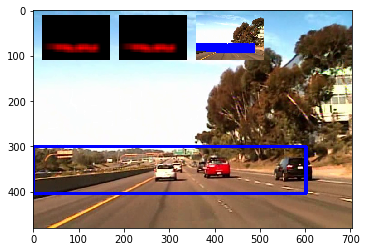



t:  54%|█████▎    | 161/300 [01:58<01:47,  1.29it/s, now=None]

t:  54%|█████▍    | 162/300 [01:59<01:43,  1.33it/s, now=None]

Found 435 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  54%|█████▍    | 163/300 [02:00<01:40,  1.36it/s, now=None]

Found 444 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  55%|█████▍    | 164/300 [02:00<01:38,  1.38it/s, now=None]

Found 482 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  55%|█████▌    | 165/300 [02:01<01:37,  1.38it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 467 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 165: newly detected objects 1


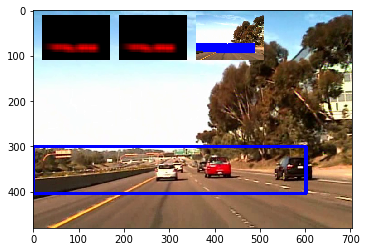



t:  55%|█████▌    | 166/300 [02:02<01:44,  1.29it/s, now=None]

t:  56%|█████▌    | 167/300 [02:03<01:40,  1.33it/s, now=None]

Found 469 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  56%|█████▌    | 168/300 [02:03<01:36,  1.36it/s, now=None]

Found 450 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  56%|█████▋    | 169/300 [02:04<01:34,  1.38it/s, now=None]

Found 449 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  57%|█████▋    | 170/300 [02:05<01:32,  1.41it/s, now=None]

Found 456 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 477 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 170: newly detected objects 1


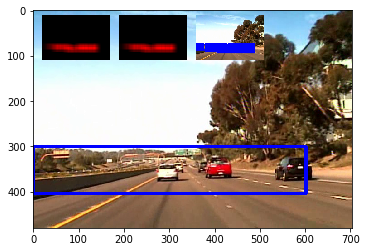



t:  57%|█████▋    | 171/300 [02:06<01:38,  1.31it/s, now=None]

t:  57%|█████▋    | 172/300 [02:06<01:35,  1.34it/s, now=None]

Found 424 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  58%|█████▊    | 173/300 [02:07<01:32,  1.37it/s, now=None]

Found 452 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  58%|█████▊    | 174/300 [02:08<01:30,  1.39it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  58%|█████▊    | 175/300 [02:08<01:28,  1.41it/s, now=None]

Found 415 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (66, 338)
Appending new object with centroid: (375, 352)
previously detected objects= 1
so far newly detected objects= 3
Found 388 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  3
** Adding similar object to one with centroid (301, 352) **
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 175: newly detected objects 1


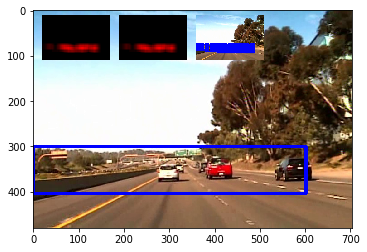



t:  59%|█████▊    | 176/300 [02:09<01:35,  1.30it/s, now=None]

t:  59%|█████▉    | 177/300 [02:10<01:31,  1.35it/s, now=None]

Found 476 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  59%|█████▉    | 178/300 [02:11<01:29,  1.37it/s, now=None]

Found 436 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  60%|█████▉    | 179/300 [02:11<01:27,  1.39it/s, now=None]

Found 492 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  60%|██████    | 180/300 [02:12<01:27,  1.37it/s, now=None]

Found 465 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 460 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 180: newly detected objects 1


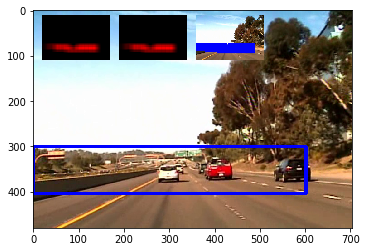



t:  60%|██████    | 181/300 [02:13<01:33,  1.27it/s, now=None]

t:  61%|██████    | 182/300 [02:14<01:29,  1.31it/s, now=None]

Found 485 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  61%|██████    | 183/300 [02:14<01:26,  1.35it/s, now=None]

Found 439 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  61%|██████▏   | 184/300 [02:15<01:24,  1.37it/s, now=None]

Found 472 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  62%|██████▏   | 185/300 [02:16<01:22,  1.39it/s, now=None]

Found 461 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 422 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 185: newly detected objects 1


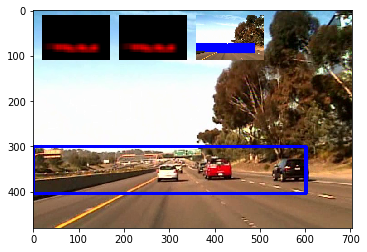



t:  62%|██████▏   | 186/300 [02:17<01:28,  1.29it/s, now=None]

t:  62%|██████▏   | 187/300 [02:17<01:24,  1.34it/s, now=None]

Found 470 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  63%|██████▎   | 188/300 [02:18<01:22,  1.36it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  63%|██████▎   | 189/300 [02:19<01:19,  1.39it/s, now=None]

Found 474 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  63%|██████▎   | 190/300 [02:20<01:18,  1.41it/s, now=None]

Found 489 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 409 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 190: newly detected objects 1


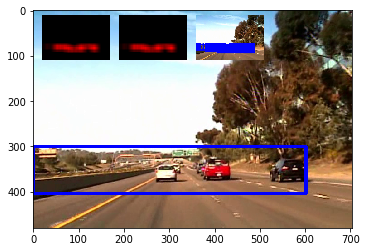



t:  64%|██████▎   | 191/300 [02:20<01:23,  1.30it/s, now=None]

t:  64%|██████▍   | 192/300 [02:21<01:20,  1.33it/s, now=None]

Found 420 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  64%|██████▍   | 193/300 [02:22<01:18,  1.37it/s, now=None]

Found 483 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  65%|██████▍   | 194/300 [02:23<01:16,  1.39it/s, now=None]

Found 476 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  65%|██████▌   | 195/300 [02:23<01:14,  1.40it/s, now=None]

Found 479 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 411 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (49, 338)
**Found a match**
old centroid= (301, 352)
new centroid= (331, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[ 30 300]
 [632 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (331, 352) **
number of times detected object appeared:  0
Refresh at frame n. 195: newly detected objects 1


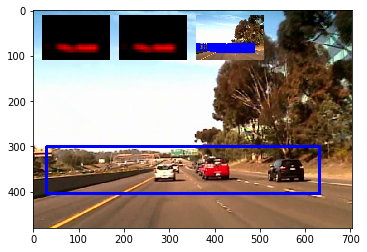



t:  65%|██████▌   | 196/300 [02:24<01:19,  1.30it/s, now=None]

t:  66%|██████▌   | 197/300 [02:25<01:16,  1.34it/s, now=None]

Found 409 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (49, 338)
Appending new object with centroid: (364, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  66%|██████▌   | 198/300 [02:25<01:14,  1.37it/s, now=None]

Found 406 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 3




t:  66%|██████▋   | 199/300 [02:26<01:12,  1.39it/s, now=None]

Found 416 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (49, 338)
new centroid= (47, 338)
old bbox= [[  0 300]
 [ 98 377]]
new bbox= [[ -2 300]
 [ 96 376]]
**Found a match**
old centroid= (364, 352)
new centroid= (357, 352)
old bbox= [[126 300]
 [603 405]]
new bbox= [[105 300]
 [609 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  67%|██████▋   | 200/300 [02:27<01:11,  1.40it/s, now=None]

Found 453 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 352)
new centroid= (329, 352)
old bbox= [[105 300]
 [609 404]]
new bbox= [[ 28 300]
 [630 404]]
previously detected objects= 1
so far newly detected objects= 3
Found 470 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (329, 352)
new centroid= (315, 352)
old bbox= [[ 28 300]
 [630 404]]
new bbox= [[ 14 300]
 [616 404]]
previously detected objects= 1
number of times detected object appeared:  1
number of times detected object appeared:  3
** Adding similar object to one with centroid (315, 352) **
number of times detected object appeared:  0
Refresh at frame n. 200: newly detected objects 1


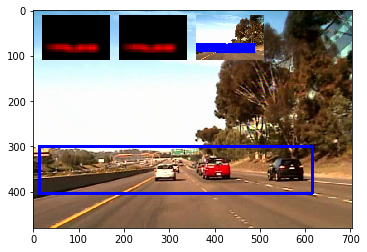



t:  67%|██████▋   | 201/300 [02:28<01:16,  1.30it/s, now=None]

t:  67%|██████▋   | 202/300 [02:28<01:13,  1.34it/s, now=None]

Found 431 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  68%|██████▊   | 203/300 [02:29<01:10,  1.38it/s, now=None]

Found 418 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (38, 338)
**Found a match**
old centroid= (301, 352)
new centroid= (331, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[ 30 300]
 [632 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  68%|██████▊   | 204/300 [02:30<01:08,  1.40it/s, now=None]

Found 441 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 352)
new centroid= (316, 352)
old bbox= [[ 30 300]
 [632 404]]
new bbox= [[ 15 300]
 [617 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  68%|██████▊   | 205/300 [02:31<01:07,  1.41it/s, now=None]

Found 421 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (38, 338)
new centroid= (45, 338)
old bbox= [[  0 300]
 [ 77 377]]
new bbox= [[ -7 300]
 [ 97 376]]
**Found a match**
old centroid= (316, 352)
new centroid= (340, 352)
old bbox= [[ 15 300]
 [617 404]]
new bbox= [[ 39 300]
 [641 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 412 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (45, 338)
new centroid= (41, 338)
old bbox= [[ -7 300]
 [ 97 376]]
new bbox= [[-11 300]
 [ 93 376]]
**Found a match**
old centroid= (340, 352)
new centroid= (352, 352)
old bbox= [[ 39 300]
 [641 404]]
new bbox= [[ 51 300]
 [653 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (352, 352) **
number of times detected object appeared:  2
Refresh at frame n. 205: newly detected objects 1


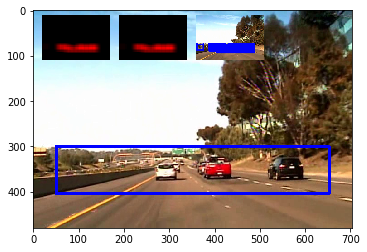



t:  69%|██████▊   | 206/300 [02:31<01:11,  1.31it/s, now=None]

t:  69%|██████▉   | 207/300 [02:32<01:09,  1.35it/s, now=None]

Found 415 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  69%|██████▉   | 208/300 [02:33<01:06,  1.38it/s, now=None]

Found 405 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  70%|██████▉   | 209/300 [02:33<01:05,  1.40it/s, now=None]

Found 464 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  70%|███████   | 210/300 [02:34<01:04,  1.40it/s, now=None]

Found 454 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 471 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (301, 352) **
Refresh at frame n. 210: newly detected objects 1


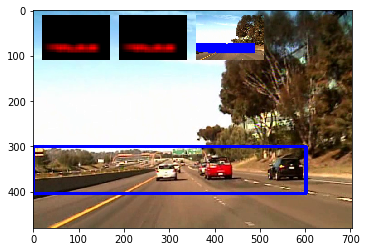



t:  70%|███████   | 211/300 [02:35<01:08,  1.31it/s, now=None]

t:  71%|███████   | 212/300 [02:36<01:05,  1.34it/s, now=None]

Found 394 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (31, 331)
Appending new object with centroid: (364, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  71%|███████   | 213/300 [02:36<01:03,  1.37it/s, now=None]

Found 407 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (31, 331)
new centroid= (34, 331)
old bbox= [[  0 300]
 [ 63 363]]
new bbox= [[ -4 300]
 [ 72 362]]
**Found a match**
old centroid= (364, 352)
new centroid= (364, 352)
old bbox= [[126 300]
 [603 405]]
new bbox= [[126 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  71%|███████▏  | 214/300 [02:37<01:02,  1.39it/s, now=None]

Found 427 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 3




t:  72%|███████▏  | 215/300 [02:38<01:00,  1.40it/s, now=None]

Found 388 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 3
Found 416 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (364, 352)
new centroid= (355, 352)
old bbox= [[126 300]
 [602 404]]
new bbox= [[ 99 300]
 [611 404]]
**Found a match**
old centroid= (34, 331)
new centroid= (32, 334)
old bbox= [[ -4 300]
 [ 72 362]]
new bbox= [[ -6 303]
 [ 70 365]]
previously detected objects= 1
number of times detected object appeared:  2
number of times detected object appeared:  2
number of times detected object appeared:  1
Refresh at frame n. 215: newly detected objects 0


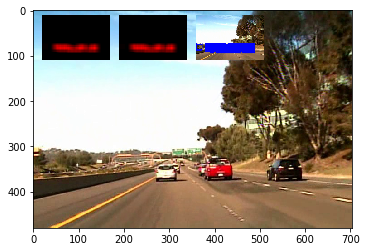



t:  72%|███████▏  | 216/300 [02:39<01:04,  1.30it/s, now=None]

t:  72%|███████▏  | 217/300 [02:39<01:02,  1.34it/s, now=None]

Found 476 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 0
so far newly detected objects= 1




t:  73%|███████▎  | 218/300 [02:40<01:00,  1.36it/s, now=None]

Found 427 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (301, 352)
new centroid= (324, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[ 23 300]
 [625 404]]
Appending new object with centroid: (31, 338)
previously detected objects= 0
so far newly detected objects= 2




t:  73%|███████▎  | 219/300 [02:41<00:59,  1.37it/s, now=None]

Found 440 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (324, 352)
new centroid= (335, 352)
old bbox= [[ 23 300]
 [625 404]]
new bbox= [[ 34 300]
 [636 404]]
**Found a match**
old centroid= (31, 338)
new centroid= (31, 338)
old bbox= [[  0 314]
 [ 63 363]]
new bbox= [[  0 314]
 [ 62 362]]
previously detected objects= 0
so far newly detected objects= 2




t:  73%|███████▎  | 220/300 [02:42<00:57,  1.40it/s, now=None]

Found 318 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (335, 352)
new centroid= (348, 352)
old bbox= [[ 34 300]
 [636 404]]
new bbox= [[ 47 300]
 [649 404]]
previously detected objects= 0
so far newly detected objects= 2
Found 434 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 352)
new centroid= (345, 352)
old bbox= [[ 47 300]
 [649 404]]
new bbox= [[ 44 300]
 [646 404]]
previously detected objects= 0
number of times detected object appeared:  4
** Adding similar object to one with centroid (345, 352) **
number of times detected object appeared:  1
Refresh at frame n. 220: newly detected objects 1


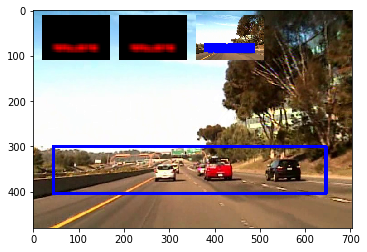



t:  74%|███████▎  | 221/300 [02:42<01:00,  1.31it/s, now=None]

t:  74%|███████▍  | 222/300 [02:43<00:58,  1.34it/s, now=None]

Found 448 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (343, 352)
Appending new object with centroid: (45, 373)
previously detected objects= 1
so far newly detected objects= 2




t:  74%|███████▍  | 223/300 [02:44<00:56,  1.36it/s, now=None]

Found 417 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (343, 352)
new centroid= (341, 352)
old bbox= [[ 84 300]
 [603 405]]
new bbox= [[ 78 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  75%|███████▍  | 224/300 [02:45<00:54,  1.39it/s, now=None]

Found 424 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 352)
new centroid= (342, 352)
old bbox= [[ 78 300]
 [604 404]]
new bbox= [[ 79 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  75%|███████▌  | 225/300 [02:45<00:53,  1.40it/s, now=None]

Found 475 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 352)
new centroid= (328, 352)
old bbox= [[ 79 300]
 [605 404]]
new bbox= [[ 41 300]
 [615 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 315 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (328, 352)
new centroid= (344, 352)
old bbox= [[ 41 300]
 [615 404]]
new bbox= [[ 57 300]
 [631 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (344, 352) **
number of times detected object appeared:  0
Refresh at frame n. 225: newly detected objects 1


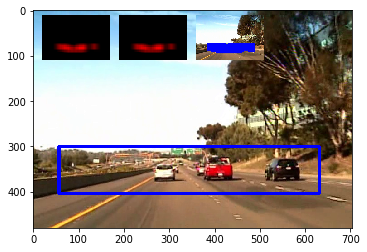



t:  75%|███████▌  | 226/300 [02:46<00:56,  1.31it/s, now=None]

t:  76%|███████▌  | 227/300 [02:47<00:53,  1.35it/s, now=None]

Found 354 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (354, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  76%|███████▌  | 228/300 [02:48<00:52,  1.38it/s, now=None]

Found 431 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 352)
new centroid= (331, 352)
old bbox= [[105 300]
 [603 405]]
new bbox= [[ 37 300]
 [625 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  76%|███████▋  | 229/300 [02:48<00:51,  1.38it/s, now=None]

Found 385 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 352)
new centroid= (335, 352)
old bbox= [[ 37 300]
 [625 404]]
new bbox= [[ 41 300]
 [629 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  77%|███████▋  | 230/300 [02:49<00:50,  1.40it/s, now=None]

Found 352 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (335, 352)
new centroid= (344, 352)
old bbox= [[ 41 300]
 [629 404]]
new bbox= [[ 50 300]
 [638 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 401 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 352)
new centroid= (349, 352)
old bbox= [[ 50 300]
 [638 404]]
new bbox= [[ 55 300]
 [643 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (349, 352) **
Refresh at frame n. 230: newly detected objects 1


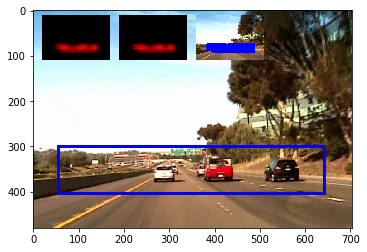



t:  77%|███████▋  | 231/300 [02:50<00:53,  1.29it/s, now=None]

t:  77%|███████▋  | 232/300 [02:51<00:50,  1.33it/s, now=None]

Found 409 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (333, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  78%|███████▊  | 233/300 [02:51<00:49,  1.36it/s, now=None]

Found 376 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 352)
new centroid= (324, 352)
old bbox= [[ 63 300]
 [603 405]]
new bbox= [[ 37 300]
 [611 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  78%|███████▊  | 234/300 [02:52<00:47,  1.40it/s, now=None]

Found 349 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (324, 352)
new centroid= (332, 352)
old bbox= [[ 37 300]
 [611 404]]
new bbox= [[ 45 300]
 [619 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  78%|███████▊  | 235/300 [02:53<00:45,  1.42it/s, now=None]

Found 450 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (332, 352)
new centroid= (323, 352)
old bbox= [[ 45 300]
 [619 404]]
new bbox= [[ 36 300]
 [610 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 424 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 352)
new centroid= (324, 352)
old bbox= [[ 36 300]
 [610 404]]
new bbox= [[ 37 300]
 [611 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (324, 352) **
Refresh at frame n. 235: newly detected objects 1


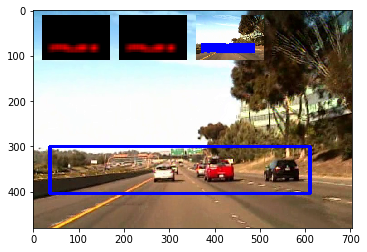



t:  79%|███████▊  | 236/300 [02:53<00:48,  1.32it/s, now=None]

t:  79%|███████▉  | 237/300 [02:54<00:46,  1.36it/s, now=None]

Found 422 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (336, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  79%|███████▉  | 238/300 [02:55<00:44,  1.39it/s, now=None]

Found 387 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 352)
new centroid= (322, 352)
old bbox= [[ 70 300]
 [603 405]]
new bbox= [[ 28 300]
 [616 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  80%|███████▉  | 239/300 [02:56<00:43,  1.41it/s, now=None]

Found 344 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (322, 352)
new centroid= (340, 352)
old bbox= [[ 28 300]
 [616 404]]
new bbox= [[ 46 300]
 [634 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  80%|████████  | 240/300 [02:56<00:42,  1.42it/s, now=None]

Found 350 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 352)
new centroid= (345, 352)
old bbox= [[ 46 300]
 [634 404]]
new bbox= [[ 51 300]
 [639 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 395 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 352)
new centroid= (347, 352)
old bbox= [[ 51 300]
 [639 404]]
new bbox= [[ 53 300]
 [641 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (347, 352) **
Refresh at frame n. 240: newly detected objects 1


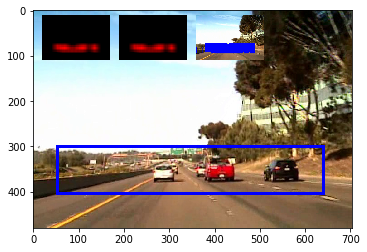



t:  80%|████████  | 241/300 [02:57<00:45,  1.30it/s, now=None]

t:  81%|████████  | 242/300 [02:58<00:42,  1.35it/s, now=None]

Found 415 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (357, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  81%|████████  | 243/300 [02:58<00:41,  1.38it/s, now=None]

Found 404 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 352)
new centroid= (336, 352)
old bbox= [[112 300]
 [603 405]]
new bbox= [[ 49 300]
 [623 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  81%|████████▏ | 244/300 [02:59<00:39,  1.40it/s, now=None]

Found 455 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 352)
new centroid= (336, 352)
old bbox= [[ 49 300]
 [623 404]]
new bbox= [[ 49 300]
 [623 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  82%|████████▏ | 245/300 [03:00<00:38,  1.42it/s, now=None]

Found 437 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 352)
new centroid= (336, 352)
old bbox= [[ 49 300]
 [623 404]]
new bbox= [[ 49 300]
 [623 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 464 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 352)
new centroid= (334, 352)
old bbox= [[ 49 300]
 [623 404]]
new bbox= [[ 47 300]
 [621 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (334, 352) **
Refresh at frame n. 245: newly detected objects 1


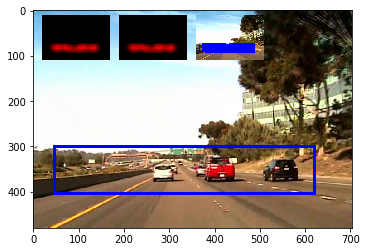



t:  82%|████████▏ | 246/300 [03:01<00:41,  1.31it/s, now=None]

t:  82%|████████▏ | 247/300 [03:01<00:39,  1.36it/s, now=None]

Found 447 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (350, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  83%|████████▎ | 248/300 [03:02<00:37,  1.38it/s, now=None]

Found 466 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 352)
new centroid= (329, 352)
old bbox= [[ 98 300]
 [603 405]]
new bbox= [[ 35 300]
 [623 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  83%|████████▎ | 249/300 [03:03<00:36,  1.41it/s, now=None]

Found 452 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (329, 352)
new centroid= (327, 352)
old bbox= [[ 35 300]
 [623 404]]
new bbox= [[ 33 300]
 [621 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  83%|████████▎ | 250/300 [03:03<00:35,  1.43it/s, now=None]

Found 445 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (327, 352)
new centroid= (338, 352)
old bbox= [[ 33 300]
 [621 404]]
new bbox= [[ 44 300]
 [632 404]]
Appending new object with centroid: (45, 359)
previously detected objects= 1
so far newly detected objects= 2
Found 442 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (338, 352)
new centroid= (335, 352)
old bbox= [[ 44 300]
 [632 404]]
new bbox= [[ 41 300]
 [629 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (335, 352) **
number of times detected object appeared:  0
Refresh at frame n. 250: newly detected objects 1


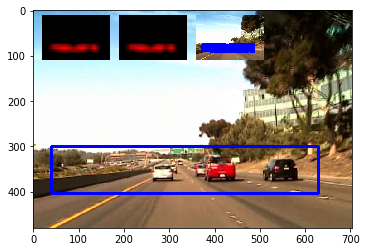



t:  84%|████████▎ | 251/300 [03:04<00:37,  1.32it/s, now=None]

t:  84%|████████▍ | 252/300 [03:05<00:35,  1.36it/s, now=None]

Found 364 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (329, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  84%|████████▍ | 253/300 [03:06<00:33,  1.39it/s, now=None]

Found 408 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (329, 352)
new centroid= (331, 352)
old bbox= [[ 56 300]
 [603 405]]
new bbox= [[ 58 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  85%|████████▍ | 254/300 [03:06<00:32,  1.40it/s, now=None]

Found 494 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 352)
new centroid= (328, 352)
old bbox= [[ 58 300]
 [604 404]]
new bbox= [[ 51 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  85%|████████▌ | 255/300 [03:07<00:31,  1.42it/s, now=None]

Found 456 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (328, 352)
new centroid= (314, 352)
old bbox= [[ 51 300]
 [605 404]]
new bbox= [[ 13 300]
 [615 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 453 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (314, 352)
new centroid= (320, 352)
old bbox= [[ 13 300]
 [615 404]]
new bbox= [[ 19 300]
 [621 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (320, 352) **
Refresh at frame n. 255: newly detected objects 1


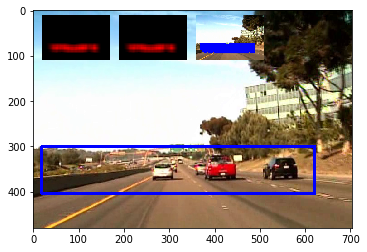



t:  85%|████████▌ | 256/300 [03:08<00:33,  1.32it/s, now=None]

t:  86%|████████▌ | 257/300 [03:09<00:31,  1.36it/s, now=None]

Found 450 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (319, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  86%|████████▌ | 258/300 [03:09<00:30,  1.39it/s, now=None]

Found 467 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (319, 352)
new centroid= (320, 352)
old bbox= [[ 35 300]
 [603 405]]
new bbox= [[ 36 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  86%|████████▋ | 259/300 [03:10<00:29,  1.40it/s, now=None]

Found 473 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (320, 352)
new centroid= (319, 352)
old bbox= [[ 36 300]
 [604 404]]
new bbox= [[ 35 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  87%|████████▋ | 260/300 [03:11<00:28,  1.42it/s, now=None]

Found 494 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (319, 352)
new centroid= (319, 352)
old bbox= [[ 35 300]
 [603 404]]
new bbox= [[ 35 300]
 [603 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 487 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (319, 352)
new centroid= (324, 352)
old bbox= [[ 35 300]
 [603 404]]
new bbox= [[ 40 300]
 [608 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (324, 352) **
Refresh at frame n. 260: newly detected objects 1


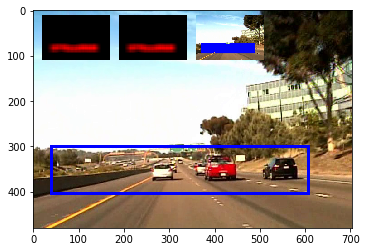



t:  87%|████████▋ | 261/300 [03:12<00:30,  1.28it/s, now=None]

t:  87%|████████▋ | 262/300 [03:13<00:30,  1.26it/s, now=None]

Found 422 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (315, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  88%|████████▊ | 263/300 [03:13<00:29,  1.25it/s, now=None]

Found 497 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (315, 352)
new centroid= (311, 352)
old bbox= [[ 28 300]
 [603 405]]
new bbox= [[ 17 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  88%|████████▊ | 264/300 [03:14<00:27,  1.29it/s, now=None]

Found 381 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (311, 352)
new centroid= (306, 352)
old bbox= [[ 17 300]
 [605 404]]
new bbox= [[  5 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  88%|████████▊ | 265/300 [03:15<00:26,  1.30it/s, now=None]

Found 454 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (306, 352)
new centroid= (303, 352)
old bbox= [[  5 300]
 [607 404]]
new bbox= [[  2 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 427 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (303, 352)
new centroid= (311, 352)
old bbox= [[  2 300]
 [604 404]]
new bbox= [[ 10 300]
 [612 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (311, 352) **
Refresh at frame n. 265: newly detected objects 1


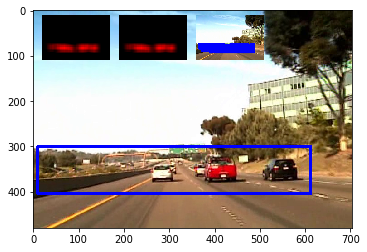



t:  89%|████████▊ | 266/300 [03:16<00:27,  1.25it/s, now=None]

t:  89%|████████▉ | 267/300 [03:16<00:25,  1.30it/s, now=None]

Found 457 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (308, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  89%|████████▉ | 268/300 [03:17<00:24,  1.33it/s, now=None]

Found 487 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (308, 352)
new centroid= (317, 352)
old bbox= [[ 14 300]
 [603 405]]
new bbox= [[ 23 300]
 [611 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  90%|████████▉ | 269/300 [03:18<00:22,  1.36it/s, now=None]

Found 433 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (317, 352)
new centroid= (335, 352)
old bbox= [[ 23 300]
 [611 404]]
new bbox= [[ 41 300]
 [629 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  90%|█████████ | 270/300 [03:19<00:21,  1.37it/s, now=None]

Found 470 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (335, 352)
new centroid= (321, 352)
old bbox= [[ 41 300]
 [629 404]]
new bbox= [[ 27 300]
 [615 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 431 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (321, 352)
new centroid= (336, 352)
old bbox= [[ 27 300]
 [615 404]]
new bbox= [[ 42 300]
 [630 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (336, 352) **
Refresh at frame n. 270: newly detected objects 1


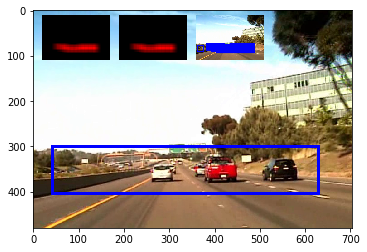



t:  90%|█████████ | 271/300 [03:19<00:22,  1.28it/s, now=None]

t:  91%|█████████ | 272/300 [03:20<00:20,  1.34it/s, now=None]

Found 452 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (329, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  91%|█████████ | 273/300 [03:21<00:19,  1.37it/s, now=None]

Found 450 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (329, 352)
new centroid= (339, 352)
old bbox= [[ 56 300]
 [603 405]]
new bbox= [[ 66 300]
 [612 404]]
Appending new object with centroid: (59, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  91%|█████████▏| 274/300 [03:21<00:18,  1.40it/s, now=None]

Found 470 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 352)
new centroid= (327, 352)
old bbox= [[ 66 300]
 [612 404]]
new bbox= [[ 40 300]
 [614 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  92%|█████████▏| 275/300 [03:22<00:17,  1.42it/s, now=None]

Found 470 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (327, 352)
new centroid= (335, 352)
old bbox= [[ 40 300]
 [614 404]]
new bbox= [[ 48 300]
 [622 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 499 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (335, 352)
new centroid= (318, 352)
old bbox= [[ 48 300]
 [622 404]]
new bbox= [[ 17 300]
 [619 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (318, 352) **
number of times detected object appeared:  0
Refresh at frame n. 275: newly detected objects 1


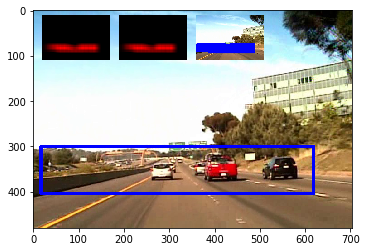



t:  92%|█████████▏| 276/300 [03:23<00:18,  1.32it/s, now=None]

t:  92%|█████████▏| 277/300 [03:24<00:16,  1.36it/s, now=None]

Found 477 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 278/300 [03:24<00:15,  1.38it/s, now=None]

Found 455 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 279/300 [03:25<00:14,  1.41it/s, now=None]

Found 458 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (313, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[ 12 300]
 [614 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 280/300 [03:26<00:14,  1.42it/s, now=None]

Found 480 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (313, 352)
new centroid= (307, 352)
old bbox= [[ 12 300]
 [614 404]]
new bbox= [[  6 300]
 [608 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 439 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (307, 352)
new centroid= (328, 352)
old bbox= [[  6 300]
 [608 404]]
new bbox= [[ 27 300]
 [629 404]]
Appending new object with centroid: (45, 352)
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (328, 352) **
number of times detected object appeared:  0
Refresh at frame n. 280: newly detected objects 1


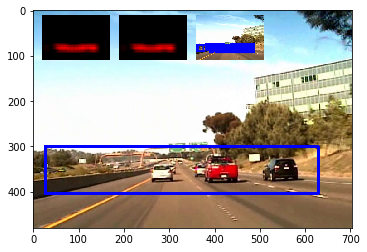



t:  94%|█████████▎| 281/300 [03:27<00:14,  1.32it/s, now=None]

t:  94%|█████████▍| 282/300 [03:27<00:13,  1.37it/s, now=None]

Found 453 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (322, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  94%|█████████▍| 283/300 [03:28<00:12,  1.38it/s, now=None]

Found 388 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (322, 352)
new centroid= (311, 352)
old bbox= [[ 42 300]
 [603 405]]
new bbox= [[ 10 300]
 [612 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  95%|█████████▍| 284/300 [03:29<00:11,  1.40it/s, now=None]

Found 419 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (311, 352)
new centroid= (306, 352)
old bbox= [[ 10 300]
 [612 404]]
new bbox= [[  5 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  95%|█████████▌| 285/300 [03:29<00:10,  1.42it/s, now=None]

Found 470 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (306, 352)
new centroid= (303, 352)
old bbox= [[  5 300]
 [607 404]]
new bbox= [[  2 300]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 461 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (303, 352)
new centroid= (323, 352)
old bbox= [[  2 300]
 [604 404]]
new bbox= [[ 22 300]
 [624 404]]
Appending new object with centroid: (38, 359)
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (323, 352) **
number of times detected object appeared:  0
Refresh at frame n. 285: newly detected objects 1


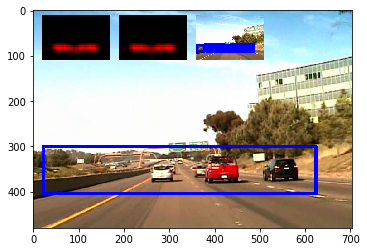



t:  95%|█████████▌| 286/300 [03:30<00:10,  1.31it/s, now=None]

t:  96%|█████████▌| 287/300 [03:31<00:09,  1.36it/s, now=None]

Found 442 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  96%|█████████▌| 288/300 [03:32<00:08,  1.40it/s, now=None]

Found 474 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  96%|█████████▋| 289/300 [03:32<00:07,  1.41it/s, now=None]

Found 455 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (304, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  3 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  97%|█████████▋| 290/300 [03:33<00:07,  1.42it/s, now=None]

Found 455 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (304, 352)
new centroid= (320, 352)
old bbox= [[  3 300]
 [605 404]]
new bbox= [[ 19 300]
 [621 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 454 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (320, 352)
new centroid= (310, 352)
old bbox= [[ 19 300]
 [621 404]]
new bbox= [[  9 300]
 [611 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (310, 352) **
Refresh at frame n. 290: newly detected objects 1


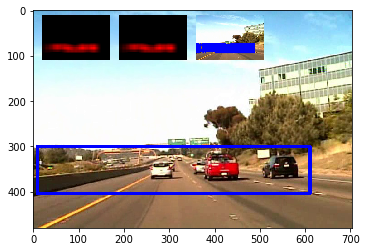



t:  97%|█████████▋| 291/300 [03:34<00:06,  1.31it/s, now=None]

t:  97%|█████████▋| 292/300 [03:35<00:05,  1.35it/s, now=None]

Found 424 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  98%|█████████▊| 293/300 [03:35<00:05,  1.38it/s, now=None]

Found 450 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  98%|█████████▊| 294/300 [03:36<00:04,  1.40it/s, now=None]

Found 451 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  98%|█████████▊| 295/300 [03:37<00:03,  1.42it/s, now=None]

Found 443 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (313, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[ 12 300]
 [614 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 436 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (313, 352)
new centroid= (319, 352)
old bbox= [[ 12 300]
 [614 404]]
new bbox= [[ 18 300]
 [620 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (319, 352) **
Refresh at frame n. 295: newly detected objects 1


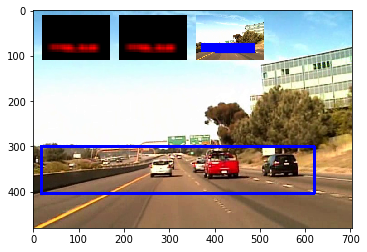



t:  99%|█████████▊| 296/300 [03:38<00:03,  1.31it/s, now=None]

t:  99%|█████████▉| 297/300 [03:38<00:02,  1.36it/s, now=None]

Found 453 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (301, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  99%|█████████▉| 298/300 [03:39<00:01,  1.40it/s, now=None]

Found 462 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (301, 352)
old bbox= [[  0 300]
 [603 405]]
new bbox= [[  0 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t: 100%|█████████▉| 299/300 [03:40<00:00,  1.41it/s, now=None]

Found 461 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (301, 352)
new centroid= (313, 352)
old bbox= [[  0 300]
 [602 404]]
new bbox= [[ 12 300]
 [614 404]]
previously detected objects= 1
so far newly detected objects= 1




t: 100%|██████████| 300/300 [03:40<00:00,  1.43it/s, now=None]

Found 449 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (313, 352)
new centroid= (314, 352)
old bbox= [[ 12 300]
 [614 404]]
new bbox= [[ 13 300]
 [615 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 455 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (314, 352)
new centroid= (311, 352)
old bbox= [[ 13 300]
 [615 404]]
new bbox= [[ 10 300]
 [612 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (311, 352) **
Refresh at frame n. 300: newly detected objects 1


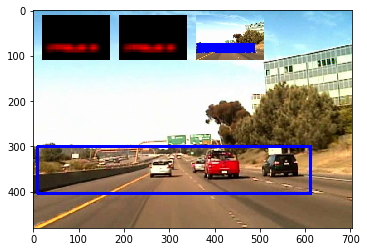



                                                              
t:   2%|▏         | 5/300 [26:36<13:02,  2.65s/it, now=None] 
                                                            ]
t:  24%|██▎       | 71/300 [24:33<07:52,  2.06s/it, now=None]

Moviepy - Done !
Moviepy - video ready output_videos/april21.mp4
CPU times: user 4min 40s, sys: 2.01 s, total: 4min 42s
Wall time: 3min 42s


In [298]:
detector = VehicleDetectorWithMemory(d_tree, simple_classifier, normaliser, color_space="YCrCb", save_frame=False, 
                                     frame_sampling_rate=5, threshold=2, min_detection_count=3, 
                                     debug_imgs=True, cell_overlap=1)

clip1 = VideoFileClip(project_video_sample_path)
project_video_clip = clip1.fl_image(detector.process_image) 
%time project_video_clip.write_videofile(project_video_sample_output_path, audio=False)

Found 202 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (358, 352)
Appending new object with centroid: (571, 345)
previously detected objects= 0
so far newly detected objects= 2


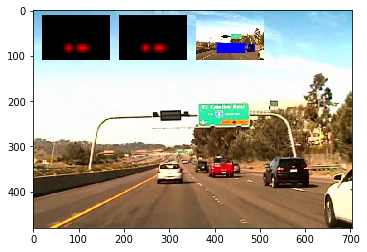

                                                            
t:   2%|▏         | 5/300 [46:18<13:02,  2.65s/it, now=None] 
                                                            ]
t:   2%|▏         | 5/300 [46:18<13:02,  2.65s/it, now=None] 


Moviepy - Building video output_videos/april21.mp4.
Moviepy - Writing video output_videos/april21.mp4



t:  24%|██▎       | 71/300 [44:15<07:52,  2.06s/it, now=None]

t:   0%|          | 0/300 [00:00<?, ?it/s, now=None]

t:   1%|          | 2/300 [00:00<01:59,  2.48it/s, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (358, 352)
new centroid= (358, 352)
old bbox= [[212 300]
 [504 405]]
new bbox= [[212 300]
 [504 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 345)
old bbox= [[540 314]
 [602 377]]
new bbox= [[540 314]
 [602 376]]
previously detected objects= 0
so far newly detected objects= 2




t:   1%|          | 3/300 [00:01<02:43,  1.82it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 352)
new centroid= (358, 352)
old bbox= [[212 300]
 [504 404]]
new bbox= [[212 300]
 [504 404]]
previously detected objects= 0
so far newly detected objects= 2




t:   1%|▏         | 4/300 [00:02<03:04,  1.61it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 352)
new centroid= (358, 352)
old bbox= [[212 300]
 [504 404]]
new bbox= [[212 300]
 [504 404]]
previously detected objects= 0
so far newly detected objects= 2




t:   2%|▏         | 5/300 [00:03<03:20,  1.47it/s, now=None]

Found 207 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 352)
new centroid= (358, 352)
old bbox= [[212 300]
 [504 404]]
new bbox= [[212 300]
 [504 404]]
previously detected objects= 0
so far newly detected objects= 2
Found 208 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 352)
new centroid= (358, 352)
old bbox= [[212 300]
 [504 404]]
new bbox= [[212 300]
 [504 404]]
previously detected objects= 0
number of times detected object appeared:  5
** Adding similar object to one with centroid (358, 352) **
number of times detected object appeared:  1
Refresh at frame n. 5: newly detected objects 1


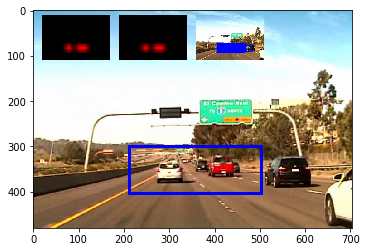



t:   2%|▏         | 6/300 [00:04<04:01,  1.22it/s, now=None]

t:   2%|▏         | 7/300 [00:05<04:09,  1.17it/s, now=None]

Found 223 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (400, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   3%|▎         | 8/300 [00:06<04:02,  1.20it/s, now=None]

Found 215 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (379, 352)
old bbox= [[212 300]
 [588 405]]
new bbox= [[191 300]
 [567 404]]
Appending new object with centroid: (557, 352)
previously detected objects= 1
so far newly detected objects= 2




t:   3%|▎         | 9/300 [00:06<03:52,  1.25it/s, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (379, 352)
new centroid= (382, 352)
old bbox= [[191 300]
 [567 404]]
new bbox= [[194 300]
 [570 404]]
**Found a match**
old centroid= (557, 352)
new centroid= (553, 359)
old bbox= [[512 314]
 [602 391]]
new bbox= [[508 321]
 [598 397]]
previously detected objects= 1
so far newly detected objects= 2




t:   3%|▎         | 10/300 [00:07<03:45,  1.29it/s, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (382, 352)
new centroid= (380, 352)
old bbox= [[194 300]
 [570 404]]
new bbox= [[192 300]
 [568 404]]
**Found a match**
old centroid= (553, 359)
new centroid= (551, 359)
old bbox= [[508 321]
 [598 397]]
new bbox= [[506 314]
 [596 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 215 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (380, 352)
new centroid= (367, 352)
old bbox= [[192 300]
 [568 404]]
new bbox= [[179 300]
 [555 404]]
Appending new object with centroid: (115, 345)
**Found a match**
old centroid= (551, 359)
new centroid= (554, 355)
old bbox= [[506 314]
 [596 404]]
new bbox= [[509 310]
 [599 400]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (367, 352) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (554, 355) **
nu

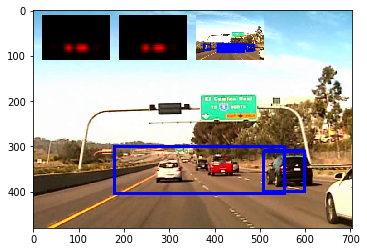



t:   4%|▎         | 11/300 [00:08<03:58,  1.21it/s, now=None]

t:   4%|▍         | 12/300 [00:09<03:48,  1.26it/s, now=None]

Found 205 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (354, 352)
previously detected objects= 2
so far newly detected objects= 1




t:   4%|▍         | 13/300 [00:09<03:40,  1.30it/s, now=None]

Found 130 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (354, 352)
new centroid= (384, 352)
old bbox= [[210 300]
 [499 405]]
new bbox= [[240 300]
 [528 404]]
Appending new object with centroid: (557, 345)
previously detected objects= 2
so far newly detected objects= 2




t:   5%|▍         | 14/300 [00:10<03:43,  1.28it/s, now=None]

Found 220 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (384, 352)
new centroid= (369, 352)
old bbox= [[240 300]
 [528 404]]
new bbox= [[225 300]
 [513 404]]
Appending new object with centroid: (109, 345)
**Found a match**
old centroid= (557, 345)
new centroid= (558, 348)
old bbox= [[526 314]
 [588 377]]
new bbox= [[516 310]
 [600 386]]
previously detected objects= 2
so far newly detected objects= 3




t:   5%|▌         | 15/300 [00:11<03:50,  1.23it/s, now=None]

Found 192 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (466, 352)
previously detected objects= 2
so far newly detected objects= 4
Found 232 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (109, 345)
new centroid= (135, 341)
old bbox= [[ 78 314]
 [140 377]]
new bbox= [[ 72 303]
 [198 379]]
**Found a match**
old centroid= (466, 352)
new centroid= (466, 352)
old bbox= [[329 300]
 [603 405]]
new bbox= [[329 300]
 [603 404]]
previously detected objects= 2
number of times detected object appeared:  2
number of times detected object appeared:  1
number of times detected object appeared:  1
number of times detected object appeared:  1
Refresh at frame n. 15: newly detected objects 0


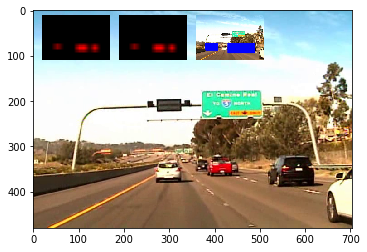



t:   5%|▌         | 16/300 [00:12<04:30,  1.05it/s, now=None]

t:   6%|▌         | 17/300 [00:13<04:26,  1.06it/s, now=None]

Found 268 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (406, 352)
previously detected objects= 0
so far newly detected objects= 1




t:   6%|▌         | 18/300 [00:14<04:20,  1.08it/s, now=None]

Found 264 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (406, 352)
new centroid= (406, 352)
old bbox= [[210 300]
 [603 405]]
new bbox= [[210 300]
 [602 404]]
previously detected objects= 0
so far newly detected objects= 1




t:   6%|▋         | 19/300 [00:15<04:14,  1.10it/s, now=None]

Found 184 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (406, 352)
new centroid= (436, 352)
old bbox= [[210 300]
 [602 404]]
new bbox= [[240 300]
 [632 404]]
previously detected objects= 0
so far newly detected objects= 1




t:   7%|▋         | 20/300 [00:16<04:10,  1.12it/s, now=None]

Found 203 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (353, 352)
previously detected objects= 0
so far newly detected objects= 2
Found 256 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (436, 352)
new centroid= (421, 352)
old bbox= [[240 300]
 [632 404]]
new bbox= [[225 300]
 [617 404]]
previously detected objects= 0
number of times detected object appeared:  3
** Adding similar object to one with centroid (421, 352) **
number of times detected object appeared:  0
Refresh at frame n. 20: newly detected objects 1


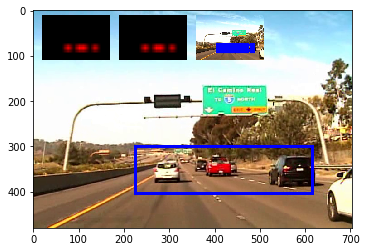



t:   7%|▋         | 21/300 [00:17<04:39,  1.00s/it, now=None]

t:   7%|▋         | 22/300 [00:18<04:24,  1.05it/s, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (463, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   8%|▊         | 23/300 [00:19<04:13,  1.09it/s, now=None]

Found 260 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (347, 352)
Appending new object with centroid: (550, 352)
previously detected objects= 1
so far newly detected objects= 3




t:   8%|▊         | 24/300 [00:20<03:57,  1.16it/s, now=None]

Found 209 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 405]]
new bbox= [[203 300]
 [491 404]]
**Found a match**
old centroid= (550, 352)
new centroid= (557, 352)
old bbox= [[497 300]
 [603 405]]
new bbox= [[504 300]
 [610 404]]
previously detected objects= 1
so far newly detected objects= 3




t:   8%|▊         | 25/300 [00:20<03:44,  1.22it/s, now=None]

Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 3
Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
**Found a match**
old centroid= (557, 352)
new centroid= (562, 348)
old bbox= [[504 300]
 [610 404]]
new bbox= [[509 296]
 [615 400]]
previously detected objects= 1
number of times detected object appeared:  0
number of times detected object appeared:  3
** Adding similar object to one with centroid (347, 352) **
number of times detected object appeared:  2
Refresh at frame n. 25: newly detected objects 1


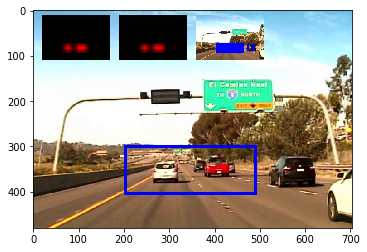



t:   9%|▊         | 26/300 [00:21<03:51,  1.18it/s, now=None]

t:   9%|▉         | 27/300 [00:22<03:38,  1.25it/s, now=None]

Found 204 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 352)
previously detected objects= 1
so far newly detected objects= 1




t:   9%|▉         | 28/300 [00:23<03:31,  1.29it/s, now=None]

Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 405]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  10%|▉         | 29/300 [00:23<03:24,  1.33it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (346, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[202 300]
 [490 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  10%|█         | 30/300 [00:24<03:19,  1.35it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 352)
new centroid= (346, 352)
old bbox= [[202 300]
 [490 404]]
new bbox= [[202 300]
 [490 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 352)
new centroid= (359, 352)
old bbox= [[202 300]
 [490 404]]
new bbox= [[215 300]
 [503 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (359, 352) **
Refresh at frame n. 30: newly detected objects 1


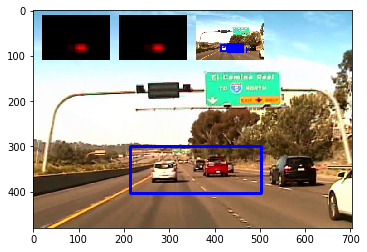



t:  10%|█         | 31/300 [00:25<03:31,  1.27it/s, now=None]

t:  11%|█         | 32/300 [00:26<03:30,  1.27it/s, now=None]

Found 212 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (326, 352)
Appending new object with centroid: (550, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  11%|█         | 33/300 [00:26<03:23,  1.31it/s, now=None]

Found 124 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 352)
new centroid= (348, 352)
old bbox= [[203 300]
 [449 405]]
new bbox= [[225 300]
 [471 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  11%|█▏        | 34/300 [00:27<03:23,  1.31it/s, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 352)
new centroid= (359, 352)
old bbox= [[225 300]
 [471 404]]
new bbox= [[236 300]
 [482 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  12%|█▏        | 35/300 [00:28<03:19,  1.33it/s, now=None]

Found 236 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (291, 352)
**Found a match**
old centroid= (550, 352)
new centroid= (555, 355)
old bbox= [[497 300]
 [603 405]]
new bbox= [[502 303]
 [608 407]]
previously detected objects= 1
so far newly detected objects= 3
Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 352)
new centroid= (353, 352)
old bbox= [[236 300]
 [482 404]]
new bbox= [[209 300]
 [497 404]]
previously detected objects= 1
number of times detected object appeared:  3
** Adding similar object to one with centroid (353, 352) **
number of times detected object appeared:  1
number of times detected object appeared:  0
Refresh at frame n. 35: newly detected objects 1


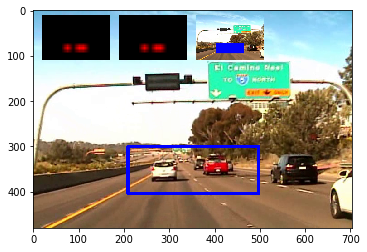



t:  12%|█▏        | 36/300 [00:29<03:36,  1.22it/s, now=None]

t:  12%|█▏        | 37/300 [00:30<03:35,  1.22it/s, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  13%|█▎        | 38/300 [00:31<03:27,  1.26it/s, now=None]

Found 258 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 405]]
new bbox= [[203 300]
 [491 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  13%|█▎        | 39/300 [00:31<03:23,  1.28it/s, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  13%|█▎        | 40/300 [00:32<03:23,  1.28it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (347, 352) **
number of times detected object appeared:  0
Refresh at frame n. 40: newly detected objects 1


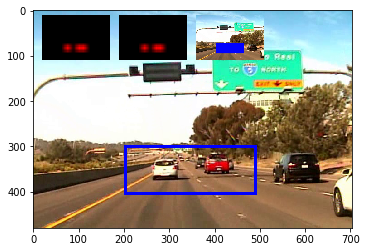



t:  14%|█▎        | 41/300 [00:33<03:32,  1.22it/s, now=None]

t:  14%|█▍        | 42/300 [00:34<03:26,  1.25it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (406, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  14%|█▍        | 43/300 [00:34<03:21,  1.27it/s, now=None]

Found 205 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (406, 352)
new centroid= (376, 352)
old bbox= [[322 300]
 [491 405]]
new bbox= [[232 300]
 [520 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  15%|█▍        | 44/300 [00:35<03:17,  1.29it/s, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (376, 352)
new centroid= (361, 352)
old bbox= [[232 300]
 [520 404]]
new bbox= [[217 300]
 [505 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  15%|█▌        | 45/300 [00:36<03:10,  1.34it/s, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 352)
new centroid= (354, 352)
old bbox= [[217 300]
 [505 404]]
new bbox= [[210 300]
 [498 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 352)
new centroid= (350, 352)
old bbox= [[210 300]
 [498 404]]
new bbox= [[206 300]
 [494 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (350, 352) **
Refresh at frame n. 45: newly detected objects 1


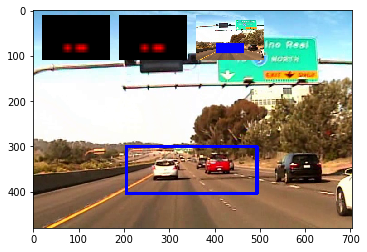



t:  15%|█▌        | 46/300 [00:37<03:21,  1.26it/s, now=None]

t:  16%|█▌        | 47/300 [00:38<03:17,  1.28it/s, now=None]

Found 207 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (347, 352)
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  16%|█▌        | 48/300 [00:38<03:14,  1.30it/s, now=None]

Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 405]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  16%|█▋        | 49/300 [00:39<03:09,  1.32it/s, now=None]

Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  17%|█▋        | 50/300 [00:40<03:06,  1.34it/s, now=None]

Found 205 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 205 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (347, 352) **
number of times detected object appeared:  0
Refresh at frame n. 50: newly detected objects 1


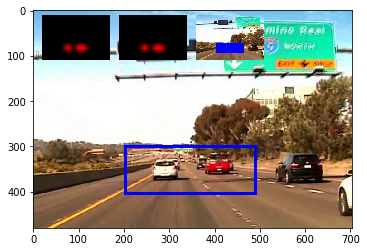



t:  17%|█▋        | 51/300 [00:41<03:28,  1.19it/s, now=None]

t:  17%|█▋        | 52/300 [00:42<03:40,  1.12it/s, now=None]

Found 205 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  18%|█▊        | 53/300 [00:43<03:36,  1.14it/s, now=None]

Found 245 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 405]]
new bbox= [[203 300]
 [491 404]]
Appending new object with centroid: (557, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  18%|█▊        | 54/300 [00:43<03:29,  1.17it/s, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[203 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  18%|█▊        | 55/300 [00:44<03:25,  1.19it/s, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (359, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[215 300]
 [503 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (359, 352)
new centroid= (365, 352)
old bbox= [[215 300]
 [503 404]]
new bbox= [[221 300]
 [509 404]]
**Found a match**
old centroid= (557, 352)
new centroid= (560, 362)
old bbox= [[511 300]
 [603 405]]
new bbox= [[514 310]
 [606 414]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (365, 352) **
number of times detected object appeared:  1
Refresh at frame n. 55: newly detected objects 1


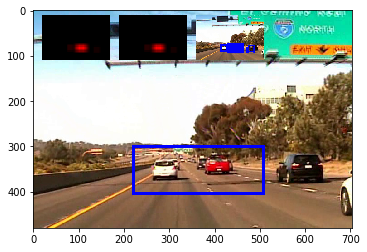



t:  19%|█▊        | 56/300 [00:45<03:46,  1.08it/s, now=None]

t:  19%|█▉        | 57/300 [00:46<03:45,  1.08it/s, now=None]

Found 205 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  19%|█▉        | 58/300 [00:47<03:36,  1.12it/s, now=None]

Found 131 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (361, 352)
old bbox= [[203 300]
 [491 405]]
new bbox= [[217 300]
 [505 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  20%|█▉        | 59/300 [00:48<03:31,  1.14it/s, now=None]

Found 207 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (361, 352)
new centroid= (354, 352)
old bbox= [[217 300]
 [505 404]]
new bbox= [[210 300]
 [498 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  20%|██        | 60/300 [00:49<03:30,  1.14it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 352)
new centroid= (362, 352)
old bbox= [[210 300]
 [498 404]]
new bbox= [[218 300]
 [506 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 205 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 352)
new centroid= (354, 352)
old bbox= [[218 300]
 [506 404]]
new bbox= [[210 300]
 [498 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (354, 352) **
number of times detected object appeared:  0
Refresh at frame n. 60: newly detected objects 1


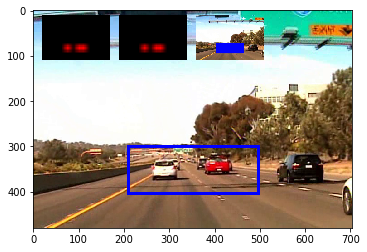



t:  20%|██        | 61/300 [00:50<03:51,  1.03it/s, now=None]

t:  21%|██        | 62/300 [00:51<03:53,  1.02it/s, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  21%|██        | 63/300 [00:52<03:57,  1.00s/it, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 352)
new centroid= (347, 352)
old bbox= [[203 300]
 [491 405]]
new bbox= [[203 300]
 [491 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  21%|██▏       | 64/300 [00:53<04:07,  1.05s/it, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 352)
new centroid= (359, 352)
old bbox= [[203 300]
 [491 404]]
new bbox= [[215 300]
 [503 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  22%|██▏       | 65/300 [00:54<04:07,  1.05s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 352)
new centroid= (367, 352)
old bbox= [[215 300]
 [503 404]]
new bbox= [[223 300]
 [511 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 202 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 352)
new centroid= (357, 352)
old bbox= [[223 300]
 [511 404]]
new bbox= [[213 300]
 [501 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (357, 352) **
number of times detected object appeared:  0
Refresh at frame n. 65: newly detected objects 1


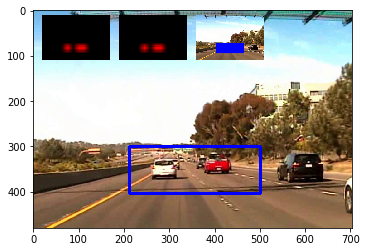



t:  22%|██▏       | 66/300 [00:56<04:17,  1.10s/it, now=None]

t:  22%|██▏       | 67/300 [00:56<04:05,  1.05s/it, now=None]

Found 129 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (406, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  23%|██▎       | 68/300 [00:57<03:54,  1.01s/it, now=None]

Found 213 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (406, 352)
new centroid= (376, 352)
old bbox= [[322 300]
 [491 405]]
new bbox= [[232 300]
 [520 404]]
Appending new object with centroid: (561, 359)
previously detected objects= 1
so far newly detected objects= 2




t:  23%|██▎       | 69/300 [00:58<03:41,  1.04it/s, now=None]

Found 204 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (376, 352)
new centroid= (361, 352)
old bbox= [[232 300]
 [520 404]]
new bbox= [[217 300]
 [505 404]]
**Found a match**
old centroid= (561, 359)
new centroid= (566, 355)
old bbox= [[520 314]
 [603 405]]
new bbox= [[525 310]
 [607 400]]
previously detected objects= 1
so far newly detected objects= 2




t:  23%|██▎       | 70/300 [00:59<03:33,  1.07it/s, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (361, 352)
new centroid= (354, 352)
old bbox= [[217 300]
 [505 404]]
new bbox= [[210 300]
 [498 404]]
**Found a match**
old centroid= (566, 355)
new centroid= (568, 350)
old bbox= [[525 310]
 [607 400]]
new bbox= [[527 305]
 [609 395]]
previously detected objects= 1
so far newly detected objects= 2
Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 352)
new centroid= (350, 352)
old bbox= [[210 300]
 [498 404]]
new bbox= [[206 300]
 [494 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (350, 352) **
number of times detected object appeared:  2
Refresh at frame n. 70: newly detected objects 1


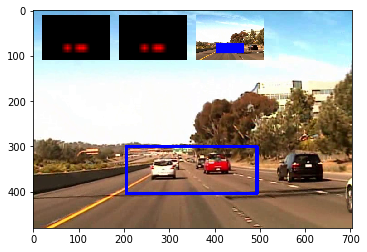



t:  24%|██▎       | 71/300 [01:00<03:43,  1.03it/s, now=None]

t:  24%|██▍       | 72/300 [01:01<03:34,  1.07it/s, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  24%|██▍       | 73/300 [01:02<03:28,  1.09it/s, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (372, 352)
new centroid= (373, 352)
old bbox= [[254 300]
 [491 405]]
new bbox= [[255 300]
 [491 404]]
Appending new object with centroid: (560, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  25%|██▍       | 74/300 [01:03<03:28,  1.09it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (374, 352)
old bbox= [[255 300]
 [491 404]]
new bbox= [[256 300]
 [492 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  25%|██▌       | 75/300 [01:04<03:38,  1.03it/s, now=None]

Found 199 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (374, 352)
new centroid= (359, 352)
old bbox= [[256 300]
 [492 404]]
new bbox= [[213 300]
 [505 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 208 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 352)
new centroid= (351, 352)
old bbox= [[213 300]
 [505 404]]
new bbox= [[204 300]
 [498 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (351, 352) **
number of times detected object appeared:  0
Refresh at frame n. 75: newly detected objects 1


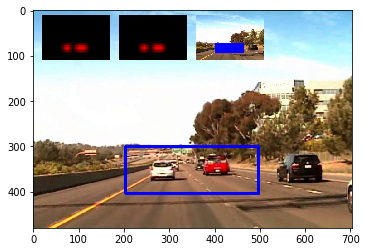



t:  25%|██▌       | 76/300 [01:05<04:02,  1.08s/it, now=None]

t:  26%|██▌       | 77/300 [01:06<03:55,  1.05s/it, now=None]

Found 130 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  26%|██▌       | 78/300 [01:07<03:51,  1.04s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (372, 352)
old bbox= [[254 300]
 [490 405]]
new bbox= [[254 300]
 [490 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  26%|██▋       | 79/300 [01:08<03:49,  1.04s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (373, 352)
old bbox= [[254 300]
 [490 404]]
new bbox= [[255 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  27%|██▋       | 80/300 [01:09<03:49,  1.04s/it, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (373, 352)
old bbox= [[255 300]
 [491 404]]
new bbox= [[255 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (387, 352)
old bbox= [[255 300]
 [491 404]]
new bbox= [[269 300]
 [505 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (387, 352) **
Refresh at frame n. 80: newly detected objects 1


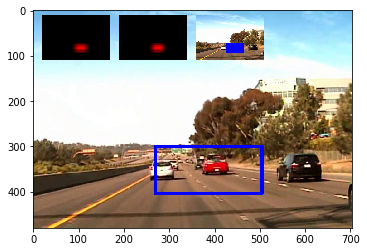



t:  27%|██▋       | 81/300 [01:11<04:07,  1.13s/it, now=None]

t:  27%|██▋       | 82/300 [01:12<03:57,  1.09s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  28%|██▊       | 83/300 [01:13<03:44,  1.04s/it, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (387, 352)
old bbox= [[254 300]
 [490 405]]
new bbox= [[269 300]
 [505 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  28%|██▊       | 84/300 [01:13<03:37,  1.01s/it, now=None]

Found 209 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (387, 352)
new centroid= (365, 352)
old bbox= [[269 300]
 [505 404]]
new bbox= [[218 300]
 [512 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  28%|██▊       | 85/300 [01:14<03:29,  1.02it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 352)
new centroid= (367, 352)
old bbox= [[218 300]
 [512 404]]
new bbox= [[220 300]
 [514 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 352)
new centroid= (368, 352)
old bbox= [[220 300]
 [514 404]]
new bbox= [[221 300]
 [515 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (368, 352) **
Refresh at frame n. 85: newly detected objects 1


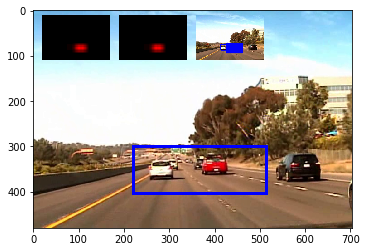



t:  29%|██▊       | 86/300 [01:16<03:45,  1.05s/it, now=None]

t:  29%|██▉       | 87/300 [01:17<03:35,  1.01s/it, now=None]

Found 130 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  29%|██▉       | 88/300 [01:17<03:26,  1.03it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 352)
new centroid= (386, 352)
old bbox= [[259 300]
 [485 405]]
new bbox= [[273 300]
 [499 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  30%|██▉       | 89/300 [01:18<03:25,  1.03it/s, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (386, 352)
new centroid= (379, 352)
old bbox= [[273 300]
 [499 404]]
new bbox= [[266 300]
 [492 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  30%|███       | 90/300 [01:19<03:22,  1.04it/s, now=None]

Found 252 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (379, 352)
new centroid= (359, 352)
old bbox= [[266 300]
 [492 404]]
new bbox= [[215 300]
 [503 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 352)
new centroid= (363, 352)
old bbox= [[215 300]
 [503 404]]
new bbox= [[219 300]
 [507 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (363, 352) **
Refresh at frame n. 90: newly detected objects 1


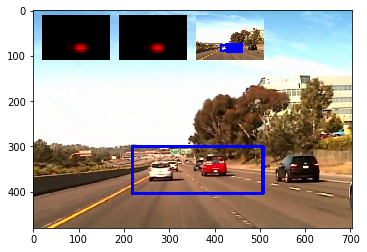



t:  30%|███       | 91/300 [01:21<03:34,  1.03s/it, now=None]

t:  31%|███       | 92/300 [01:21<03:29,  1.01s/it, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (368, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  31%|███       | 93/300 [01:22<03:26,  1.00it/s, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (368, 352)
new centroid= (366, 352)
old bbox= [[252 300]
 [485 405]]
new bbox= [[247 300]
 [485 404]]
Appending new object with centroid: (565, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  31%|███▏      | 94/300 [01:23<03:19,  1.03it/s, now=None]

Found 130 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 352)
new centroid= (367, 352)
old bbox= [[247 300]
 [485 404]]
new bbox= [[248 300]
 [486 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  32%|███▏      | 95/300 [01:24<03:22,  1.01it/s, now=None]

Found 131 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 352)
new centroid= (368, 352)
old bbox= [[248 300]
 [486 404]]
new bbox= [[249 300]
 [487 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 130 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (368, 352)
new centroid= (384, 352)
old bbox= [[249 300]
 [487 404]]
new bbox= [[265 300]
 [503 404]]
**Found a match**
old centroid= (565, 345)
new centroid= (568, 345)
old bbox= [[534 314]
 [597 377]]
new bbox= [[537 314]
 [599 376]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (384, 352) **
number of times detected object appeared:  1
Refresh at frame n. 95: newly detected objects 1


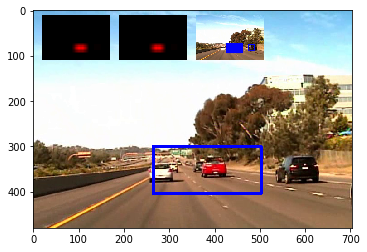



t:  32%|███▏      | 96/300 [01:25<03:18,  1.03it/s, now=None]

t:  32%|███▏      | 97/300 [01:26<03:10,  1.06it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (400, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  33%|███▎      | 98/300 [01:27<03:03,  1.10it/s, now=None]

Found 130 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (384, 352)
old bbox= [[315 300]
 [485 405]]
new bbox= [[269 300]
 [499 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  33%|███▎      | 99/300 [01:28<02:52,  1.17it/s, now=None]

Found 131 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (384, 352)
new centroid= (376, 352)
old bbox= [[269 300]
 [499 404]]
new bbox= [[261 300]
 [491 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  33%|███▎      | 100/300 [01:29<02:46,  1.20it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (376, 352)
new centroid= (388, 352)
old bbox= [[261 300]
 [491 404]]
new bbox= [[273 300]
 [503 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 134 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (388, 352)
new centroid= (378, 352)
old bbox= [[273 300]
 [503 404]]
new bbox= [[263 300]
 [493 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (378, 352) **
Refresh at frame n. 100: newly detected objects 1


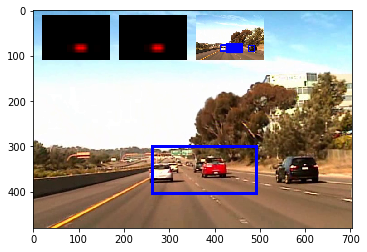



t:  34%|███▎      | 101/300 [01:29<02:49,  1.18it/s, now=None]

t:  34%|███▍      | 102/300 [01:30<02:43,  1.21it/s, now=None]

Found 140 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (400, 352)
Appending new object with centroid: (564, 359)
previously detected objects= 1
so far newly detected objects= 2




t:  34%|███▍      | 103/300 [01:31<02:43,  1.20it/s, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (384, 352)
old bbox= [[315 300]
 [485 405]]
new bbox= [[269 300]
 [499 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  35%|███▍      | 104/300 [01:32<02:43,  1.20it/s, now=None]

Found 129 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (384, 352)
new centroid= (392, 352)
old bbox= [[269 300]
 [499 404]]
new bbox= [[277 300]
 [507 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  35%|███▌      | 105/300 [01:33<02:41,  1.21it/s, now=None]

Found 133 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (392, 352)
new centroid= (396, 352)
old bbox= [[277 300]
 [507 404]]
new bbox= [[281 300]
 [511 404]]
**Found a match**
old centroid= (564, 359)
new centroid= (566, 359)
old bbox= [[526 314]
 [603 405]]
new bbox= [[528 314]
 [604 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (396, 352)
new centroid= (398, 352)
old bbox= [[281 300]
 [511 404]]
new bbox= [[283 300]
 [513 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (398, 352) **
number of times detected object appeared:  1
Refresh at frame n. 105: newly detected objects 1


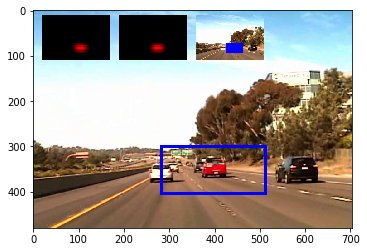



t:  35%|███▌      | 106/300 [01:34<02:50,  1.14it/s, now=None]

t:  36%|███▌      | 107/300 [01:35<02:53,  1.11it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (400, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  36%|███▌      | 108/300 [01:35<02:50,  1.13it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[315 300]
 [485 405]]
new bbox= [[315 300]
 [485 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  36%|███▋      | 109/300 [01:36<02:48,  1.13it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[315 300]
 [485 404]]
new bbox= [[315 300]
 [485 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  37%|███▋      | 110/300 [01:37<02:38,  1.20it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[315 300]
 [485 404]]
new bbox= [[315 300]
 [485 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[315 300]
 [485 404]]
new bbox= [[315 300]
 [485 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (400, 352) **
Refresh at frame n. 110: newly detected objects 1


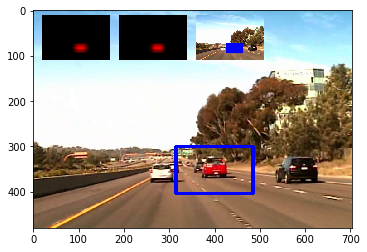



t:  37%|███▋      | 111/300 [01:38<02:41,  1.17it/s, now=None]

t:  37%|███▋      | 112/300 [01:39<02:33,  1.22it/s, now=None]

Found 131 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (402, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  38%|███▊      | 113/300 [01:39<02:27,  1.27it/s, now=None]

Found 131 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (402, 352)
new centroid= (402, 352)
old bbox= [[315 300]
 [490 405]]
new bbox= [[315 300]
 [489 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  38%|███▊      | 114/300 [01:40<02:22,  1.30it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (402, 352)
new centroid= (402, 352)
old bbox= [[315 300]
 [489 404]]
new bbox= [[315 300]
 [489 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  38%|███▊      | 115/300 [01:41<02:21,  1.31it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (402, 352)
new centroid= (402, 352)
old bbox= [[315 300]
 [489 404]]
new bbox= [[315 300]
 [489 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (402, 352)
new centroid= (402, 352)
old bbox= [[315 300]
 [489 404]]
new bbox= [[315 300]
 [489 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (402, 352) **
Refresh at frame n. 115: newly detected objects 1


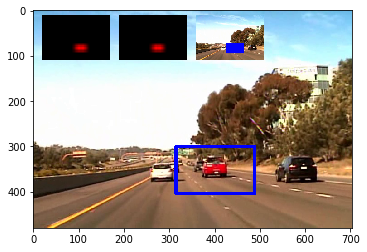



t:  39%|███▊      | 116/300 [01:42<02:40,  1.15it/s, now=None]

t:  39%|███▉      | 117/300 [01:43<02:48,  1.09it/s, now=None]

Found 209 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  39%|███▉      | 118/300 [01:44<02:39,  1.14it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 352)
new centroid= (373, 352)
old bbox= [[198 300]
 [490 405]]
new bbox= [[227 300]
 [519 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  40%|███▉      | 119/300 [01:45<02:39,  1.14it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 352)
new centroid= (386, 352)
old bbox= [[227 300]
 [519 404]]
new bbox= [[240 300]
 [532 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  40%|████      | 120/300 [01:46<02:38,  1.13it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (386, 352)
new centroid= (393, 352)
old bbox= [[240 300]
 [532 404]]
new bbox= [[247 300]
 [539 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (393, 352)
new centroid= (396, 352)
old bbox= [[247 300]
 [539 404]]
new bbox= [[250 300]
 [542 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (396, 352) **
Refresh at frame n. 120: newly detected objects 1


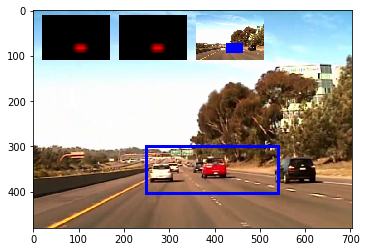



t:  40%|████      | 121/300 [01:47<02:46,  1.08it/s, now=None]

t:  41%|████      | 122/300 [01:47<02:35,  1.14it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (400, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  41%|████      | 123/300 [01:48<02:37,  1.12it/s, now=None]

Found 140 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (384, 352)
old bbox= [[315 300]
 [485 405]]
new bbox= [[268 300]
 [500 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  41%|████▏     | 124/300 [01:49<02:32,  1.16it/s, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (384, 352)
new centroid= (376, 352)
old bbox= [[268 300]
 [500 404]]
new bbox= [[260 300]
 [492 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  42%|████▏     | 125/300 [01:50<02:25,  1.20it/s, now=None]

Found 131 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (376, 352)
new centroid= (388, 352)
old bbox= [[260 300]
 [492 404]]
new bbox= [[272 300]
 [504 404]]
Appending new object with centroid: (277, 359)
previously detected objects= 1
so far newly detected objects= 3
Found 140 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (388, 352)
new centroid= (378, 352)
old bbox= [[272 300]
 [504 404]]
new bbox= [[262 300]
 [494 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 345)
old bbox= [[540 314]
 [602 377]]
new bbox= [[540 314]
 [602 376]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (378, 352) **
number of times detected object appeared:  1
number of times detected object appeared:  0
Refresh at frame n. 125: newly detected objects 1


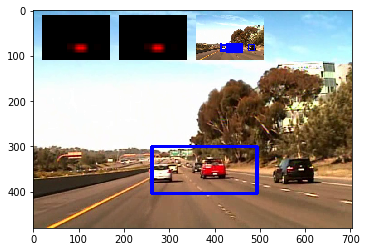



t:  42%|████▏     | 126/300 [01:51<02:33,  1.14it/s, now=None]

t:  42%|████▏     | 127/300 [01:52<02:23,  1.20it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (400, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  43%|████▎     | 128/300 [01:52<02:18,  1.25it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[315 300]
 [485 405]]
new bbox= [[315 300]
 [485 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  43%|████▎     | 129/300 [01:53<02:14,  1.27it/s, now=None]

Found 132 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[315 300]
 [485 404]]
new bbox= [[315 300]
 [485 404]]
Appending new object with centroid: (568, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  43%|████▎     | 130/300 [01:54<02:12,  1.29it/s, now=None]

Found 130 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[315 300]
 [485 404]]
new bbox= [[315 300]
 [485 404]]
**Found a match**
old centroid= (568, 345)
new centroid= (569, 345)
old bbox= [[534 314]
 [602 377]]
new bbox= [[535 314]
 [603 376]]
previously detected objects= 1
so far newly detected objects= 2
Found 130 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (386, 352)
old bbox= [[315 300]
 [485 404]]
new bbox= [[273 300]
 [499 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (386, 352) **
number of times detected object appeared:  1
Refresh at frame n. 130: newly detected objects 1


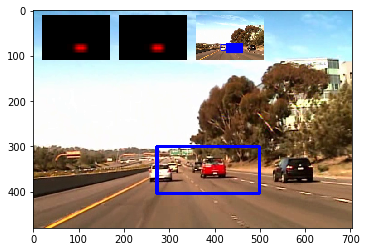



t:  44%|████▎     | 131/300 [01:55<02:24,  1.17it/s, now=None]

t:  44%|████▍     | 132/300 [01:56<02:20,  1.19it/s, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (365, 352)
Appending new object with centroid: (570, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  44%|████▍     | 133/300 [01:56<02:15,  1.23it/s, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (365, 352)
new centroid= (352, 352)
old bbox= [[246 300]
 [485 405]]
new bbox= [[208 300]
 [496 404]]
**Found a match**
old centroid= (570, 345)
new centroid= (570, 345)
old bbox= [[539 314]
 [602 377]]
new bbox= [[539 314]
 [601 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  45%|████▍     | 134/300 [01:57<02:10,  1.27it/s, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (352, 352)
new centroid= (360, 352)
old bbox= [[208 300]
 [496 404]]
new bbox= [[216 300]
 [504 404]]
**Found a match**
old centroid= (570, 345)
new centroid= (570, 345)
old bbox= [[539 314]
 [601 376]]
new bbox= [[539 314]
 [601 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  45%|████▌     | 135/300 [01:58<02:06,  1.31it/s, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (360, 352)
new centroid= (380, 352)
old bbox= [[216 300]
 [504 404]]
new bbox= [[236 300]
 [524 404]]
**Found a match**
old centroid= (570, 345)
new centroid= (567, 348)
old bbox= [[539 314]
 [601 376]]
new bbox= [[529 310]
 [605 386]]
previously detected objects= 1
so far newly detected objects= 2
Found 136 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (380, 352)
new centroid= (374, 352)
old bbox= [[236 300]
 [524 404]]
new bbox= [[230 300]
 [518 404]]
**Found a match**
old centroid= (567, 348)
new centroid= (565, 346)
old bbox= [[529 310]
 [605 386]]
new bbox= [[527 308]
 [603 384]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (374, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (565, 346) **
Refresh at frame n. 135: newly detected objects 2

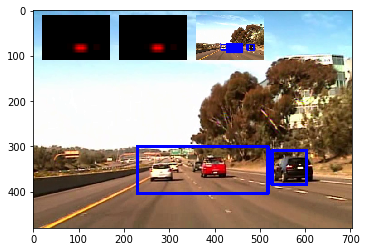



t:  45%|████▌     | 136/300 [01:59<02:12,  1.24it/s, now=None]

t:  46%|████▌     | 137/300 [01:59<02:07,  1.28it/s, now=None]

Found 132 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (400, 352)
Appending new object with centroid: (568, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  46%|████▌     | 138/300 [02:00<02:03,  1.31it/s, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (384, 352)
old bbox= [[315 300]
 [485 405]]
new bbox= [[268 300]
 [500 404]]
**Found a match**
old centroid= (568, 345)
new centroid= (566, 345)
old bbox= [[534 314]
 [602 377]]
new bbox= [[528 314]
 [604 376]]
previously detected objects= 2
so far newly detected objects= 2




t:  46%|████▋     | 139/300 [02:01<02:01,  1.32it/s, now=None]

Found 130 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (384, 352)
new centroid= (392, 352)
old bbox= [[268 300]
 [500 404]]
new bbox= [[276 300]
 [508 404]]
**Found a match**
old centroid= (566, 345)
new centroid= (568, 345)
old bbox= [[528 314]
 [604 376]]
new bbox= [[530 314]
 [606 376]]
previously detected objects= 2
so far newly detected objects= 2




t:  47%|████▋     | 140/300 [02:02<01:59,  1.34it/s, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (392, 352)
new centroid= (380, 352)
old bbox= [[276 300]
 [508 404]]
new bbox= [[264 300]
 [496 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 133 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (380, 352)
new centroid= (374, 352)
old bbox= [[264 300]
 [496 404]]
new bbox= [[258 300]
 [490 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (374, 352) **
number of times detected object appeared:  2
Refresh at frame n. 140: newly detected objects 1


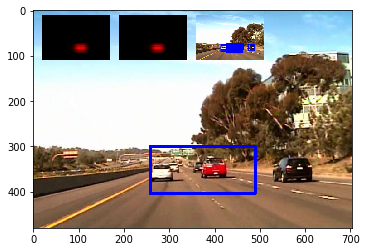



t:  47%|████▋     | 141/300 [02:03<02:06,  1.26it/s, now=None]

t:  47%|████▋     | 142/300 [02:03<02:01,  1.30it/s, now=None]

Found 134 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (402, 352)
Appending new object with centroid: (560, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  48%|████▊     | 143/300 [02:04<01:58,  1.33it/s, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (402, 352)
new centroid= (402, 352)
old bbox= [[315 300]
 [490 405]]
new bbox= [[315 300]
 [489 404]]
**Found a match**
old centroid= (560, 345)
new centroid= (562, 345)
old bbox= [[532 314]
 [589 377]]
new bbox= [[524 314]
 [600 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  48%|████▊     | 144/300 [02:05<01:57,  1.32it/s, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (402, 352)
new centroid= (388, 352)
old bbox= [[315 300]
 [489 404]]
new bbox= [[273 300]
 [503 404]]
**Found a match**
old centroid= (562, 345)
new centroid= (561, 345)
old bbox= [[524 314]
 [600 376]]
new bbox= [[520 314]
 [602 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  48%|████▊     | 145/300 [02:05<01:54,  1.35it/s, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (388, 352)
new centroid= (395, 352)
old bbox= [[273 300]
 [503 404]]
new bbox= [[280 300]
 [510 404]]
**Found a match**
old centroid= (561, 345)
new centroid= (564, 345)
old bbox= [[520 314]
 [602 376]]
new bbox= [[523 314]
 [605 376]]
previously detected objects= 1
so far newly detected objects= 2
Found 140 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (395, 352)
new centroid= (385, 352)
old bbox= [[280 300]
 [510 404]]
new bbox= [[270 300]
 [500 404]]
**Found a match**
old centroid= (564, 345)
new centroid= (564, 345)
old bbox= [[523 314]
 [605 376]]
new bbox= [[523 314]
 [605 376]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (385, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (564, 345) **
Refresh at frame n. 145: newly detected objects 2

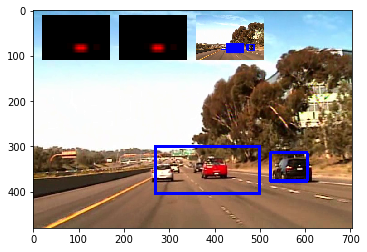



t:  49%|████▊     | 146/300 [02:06<02:01,  1.27it/s, now=None]

t:  49%|████▉     | 147/300 [02:07<01:56,  1.31it/s, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (403, 352)
previously detected objects= 2
so far newly detected objects= 1




t:  49%|████▉     | 148/300 [02:08<01:53,  1.34it/s, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 352)
new centroid= (403, 352)
old bbox= [[315 300]
 [491 405]]
new bbox= [[315 300]
 [491 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  50%|████▉     | 149/300 [02:09<01:51,  1.35it/s, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 352)
new centroid= (403, 352)
old bbox= [[315 300]
 [491 404]]
new bbox= [[315 300]
 [491 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (567, 348)
old bbox= [[540 314]
 [602 377]]
new bbox= [[529 310]
 [605 386]]
previously detected objects= 2
so far newly detected objects= 2




t:  50%|█████     | 150/300 [02:09<01:50,  1.35it/s, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 352)
new centroid= (403, 352)
old bbox= [[315 300]
 [491 404]]
new bbox= [[315 300]
 [491 404]]
**Found a match**
old centroid= (567, 348)
new centroid= (565, 350)
old bbox= [[529 310]
 [605 386]]
new bbox= [[527 312]
 [603 388]]
previously detected objects= 2
so far newly detected objects= 2
Found 137 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (403, 352)
new centroid= (403, 352)
old bbox= [[315 300]
 [491 404]]
new bbox= [[315 300]
 [491 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (403, 352) **
number of times detected object appeared:  2
Refresh at frame n. 150: newly detected objects 1


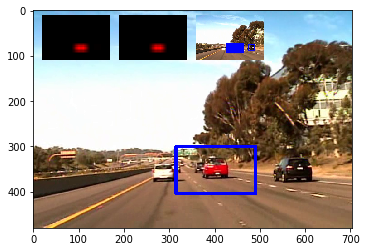



t:  50%|█████     | 151/300 [02:10<01:57,  1.26it/s, now=None]

t:  51%|█████     | 152/300 [02:11<01:53,  1.31it/s, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (403, 352)
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  51%|█████     | 153/300 [02:12<01:50,  1.33it/s, now=None]

Found 136 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 352)
new centroid= (387, 352)
old bbox= [[315 300]
 [491 405]]
new bbox= [[269 300]
 [505 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 345)
old bbox= [[540 314]
 [602 377]]
new bbox= [[540 314]
 [602 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  51%|█████▏    | 154/300 [02:12<01:48,  1.35it/s, now=None]

Found 133 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (387, 352)
new centroid= (396, 352)
old bbox= [[269 300]
 [505 404]]
new bbox= [[278 300]
 [514 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 348)
old bbox= [[540 314]
 [602 376]]
new bbox= [[539 310]
 [603 386]]
previously detected objects= 1
so far newly detected objects= 2




t:  52%|█████▏    | 155/300 [02:13<01:46,  1.36it/s, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (396, 352)
new centroid= (385, 352)
old bbox= [[278 300]
 [514 404]]
new bbox= [[267 300]
 [503 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (385, 352)
new centroid= (395, 352)
old bbox= [[267 300]
 [503 404]]
new bbox= [[277 300]
 [513 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (395, 352) **
number of times detected object appeared:  2
Refresh at frame n. 155: newly detected objects 1


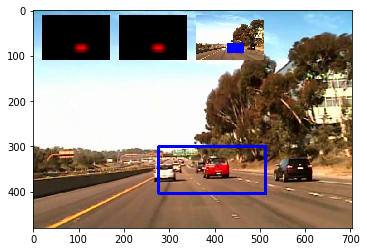



t:  52%|█████▏    | 156/300 [02:14<01:52,  1.29it/s, now=None]

t:  52%|█████▏    | 157/300 [02:15<01:48,  1.32it/s, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (406, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  53%|█████▎    | 158/300 [02:15<01:46,  1.33it/s, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (406, 352)
new centroid= (378, 352)
old bbox= [[322 300]
 [491 405]]
new bbox= [[238 300]
 [518 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  53%|█████▎    | 159/300 [02:16<01:44,  1.35it/s, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (378, 352)
new centroid= (376, 352)
old bbox= [[238 300]
 [518 404]]
new bbox= [[236 300]
 [516 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 348)
old bbox= [[540 314]
 [602 377]]
new bbox= [[539 310]
 [603 386]]
previously detected objects= 1
so far newly detected objects= 2




t:  53%|█████▎    | 160/300 [02:17<01:42,  1.36it/s, now=None]

Found 135 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (376, 352)
new centroid= (375, 352)
old bbox= [[236 300]
 [516 404]]
new bbox= [[235 300]
 [515 404]]
**Found a match**
old centroid= (571, 348)
new centroid= (569, 346)
old bbox= [[539 310]
 [603 386]]
new bbox= [[535 308]
 [603 384]]
previously detected objects= 1
so far newly detected objects= 2
Found 133 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (375, 352)
new centroid= (390, 352)
old bbox= [[235 300]
 [515 404]]
new bbox= [[250 300]
 [530 404]]
**Found a match**
old centroid= (569, 346)
new centroid= (568, 345)
old bbox= [[535 308]
 [603 384]]
new bbox= [[534 307]
 [602 383]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (390, 352) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (568, 345) **
Refresh at frame n. 160: newly detected objects 2

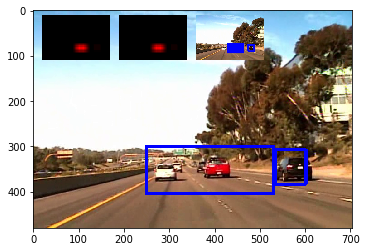



t:  54%|█████▎    | 161/300 [02:18<01:48,  1.28it/s, now=None]

t:  54%|█████▍    | 162/300 [02:18<01:44,  1.32it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (378, 352)
previously detected objects= 2
so far newly detected objects= 1




t:  54%|█████▍    | 163/300 [02:19<01:42,  1.34it/s, now=None]

Found 134 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (378, 352)
new centroid= (393, 352)
old bbox= [[266 300]
 [491 405]]
new bbox= [[281 300]
 [505 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  55%|█████▍    | 164/300 [02:20<01:40,  1.35it/s, now=None]

Found 134 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (393, 352)
new centroid= (401, 352)
old bbox= [[281 300]
 [505 404]]
new bbox= [[289 300]
 [513 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 345)
old bbox= [[540 314]
 [602 377]]
new bbox= [[540 314]
 [602 376]]
previously detected objects= 2
so far newly detected objects= 2




t:  55%|█████▌    | 165/300 [02:21<01:38,  1.37it/s, now=None]

Found 135 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (401, 352)
new centroid= (405, 352)
old bbox= [[289 300]
 [513 404]]
new bbox= [[293 300]
 [517 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 345)
old bbox= [[540 314]
 [602 376]]
new bbox= [[540 314]
 [602 376]]
previously detected objects= 2
so far newly detected objects= 2
Found 134 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (405, 352)
new centroid= (407, 352)
old bbox= [[293 300]
 [517 404]]
new bbox= [[295 300]
 [519 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 345)
old bbox= [[540 314]
 [602 376]]
new bbox= [[540 314]
 [602 376]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (407, 352) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (571, 345) **
Refresh at frame n. 165: newly detected objects 2

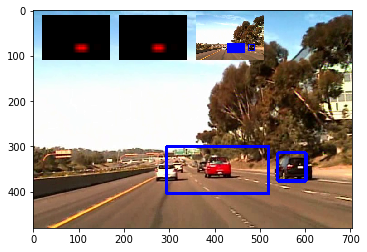



t:  55%|█████▌    | 166/300 [02:21<01:44,  1.28it/s, now=None]

t:  56%|█████▌    | 167/300 [02:22<01:41,  1.31it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (409, 352)
previously detected objects= 2
so far newly detected objects= 1




t:  56%|█████▌    | 168/300 [02:23<01:39,  1.33it/s, now=None]

Found 209 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (409, 352)
new centroid= (381, 352)
old bbox= [[322 300]
 [497 405]]
new bbox= [[238 300]
 [524 404]]
previously detected objects= 2
so far newly detected objects= 1




t:  56%|█████▋    | 169/300 [02:24<01:37,  1.34it/s, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (381, 352)
new centroid= (395, 352)
old bbox= [[238 300]
 [524 404]]
new bbox= [[252 300]
 [538 404]]
Appending new object with centroid: (570, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  57%|█████▋    | 170/300 [02:24<01:35,  1.36it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (395, 352)
new centroid= (403, 352)
old bbox= [[252 300]
 [538 404]]
new bbox= [[260 300]
 [546 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 209 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (403, 352)
new centroid= (379, 352)
old bbox= [[260 300]
 [546 404]]
new bbox= [[236 300]
 [522 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (379, 352) **
number of times detected object appeared:  0
Refresh at frame n. 170: newly detected objects 1


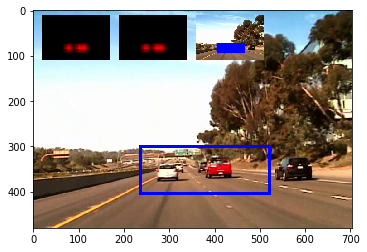



t:  57%|█████▋    | 171/300 [02:25<01:40,  1.28it/s, now=None]

t:  57%|█████▋    | 172/300 [02:26<01:37,  1.31it/s, now=None]

Found 134 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (386, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  58%|█████▊    | 173/300 [02:27<01:34,  1.34it/s, now=None]

Found 149 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (386, 352)
new centroid= (384, 352)
old bbox= [[274 300]
 [499 405]]
new bbox= [[269 300]
 [499 404]]
Appending new object with centroid: (570, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  58%|█████▊    | 174/300 [02:27<01:32,  1.36it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (384, 352)
new centroid= (397, 352)
old bbox= [[269 300]
 [499 404]]
new bbox= [[282 300]
 [512 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  58%|█████▊    | 175/300 [02:28<01:31,  1.37it/s, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (397, 352)
new centroid= (391, 352)
old bbox= [[282 300]
 [512 404]]
new bbox= [[276 300]
 [506 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (391, 352)
new centroid= (388, 352)
old bbox= [[276 300]
 [506 404]]
new bbox= [[273 300]
 [503 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (388, 352) **
number of times detected object appeared:  0
Refresh at frame n. 175: newly detected objects 1


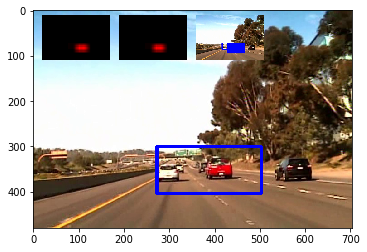



t:  59%|█████▊    | 176/300 [02:29<01:36,  1.28it/s, now=None]

t:  59%|█████▉    | 177/300 [02:30<01:33,  1.32it/s, now=None]

Found 172 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (256, 338)
Appending new object with centroid: (411, 352)
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 3




t:  59%|█████▉    | 178/300 [02:30<01:30,  1.34it/s, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (411, 352)
new centroid= (411, 352)
old bbox= [[324 300]
 [499 405]]
new bbox= [[324 300]
 [498 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  60%|█████▉    | 179/300 [02:31<01:29,  1.36it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (411, 352)
new centroid= (411, 352)
old bbox= [[324 300]
 [498 404]]
new bbox= [[324 300]
 [498 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  60%|██████    | 180/300 [02:32<01:27,  1.37it/s, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (411, 352)
new centroid= (398, 352)
old bbox= [[324 300]
 [498 404]]
new bbox= [[285 300]
 [511 404]]
previously detected objects= 1
so far newly detected objects= 3
Found 132 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (398, 352)
new centroid= (404, 352)
old bbox= [[285 300]
 [511 404]]
new bbox= [[291 300]
 [517 404]]
previously detected objects= 1
number of times detected object appeared:  0
number of times detected object appeared:  4
** Adding similar object to one with centroid (404, 352) **
number of times detected object appeared:  0
Refresh at frame n. 180: newly detected objects 1


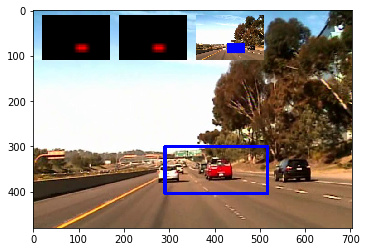



t:  60%|██████    | 181/300 [02:33<01:33,  1.28it/s, now=None]

t:  61%|██████    | 182/300 [02:33<01:29,  1.31it/s, now=None]

Found 132 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (411, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  61%|██████    | 183/300 [02:34<01:27,  1.34it/s, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (411, 352)
new centroid= (391, 352)
old bbox= [[324 300]
 [499 405]]
new bbox= [[265 300]
 [517 404]]
Appending new object with centroid: (571, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  61%|██████▏   | 184/300 [02:35<01:25,  1.35it/s, now=None]

Found 148 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (391, 352)
new centroid= (385, 352)
old bbox= [[265 300]
 [517 404]]
new bbox= [[259 300]
 [511 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  62%|██████▏   | 185/300 [02:36<01:24,  1.37it/s, now=None]

Found 146 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (385, 352)
new centroid= (382, 352)
old bbox= [[259 300]
 [511 404]]
new bbox= [[256 300]
 [508 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 144 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (382, 352)
old bbox= [[256 300]
 [508 404]]
new bbox= [[256 300]
 [508 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (382, 352) **
number of times detected object appeared:  0
Refresh at frame n. 185: newly detected objects 1


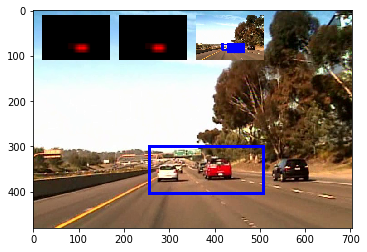



t:  62%|██████▏   | 186/300 [02:37<01:29,  1.28it/s, now=None]

t:  62%|██████▏   | 187/300 [02:37<01:26,  1.31it/s, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (382, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  63%|██████▎   | 188/300 [02:38<01:23,  1.33it/s, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (382, 352)
new centroid= (378, 352)
old bbox= [[268 300]
 [497 405]]
new bbox= [[257 300]
 [499 404]]
Appending new object with centroid: (571, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  63%|██████▎   | 189/300 [02:39<01:21,  1.35it/s, now=None]

Found 148 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (378, 352)
new centroid= (376, 352)
old bbox= [[257 300]
 [499 404]]
new bbox= [[255 300]
 [497 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (567, 345)
old bbox= [[540 314]
 [602 377]]
new bbox= [[529 314]
 [605 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  63%|██████▎   | 190/300 [02:39<01:19,  1.38it/s, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (376, 352)
new centroid= (391, 352)
old bbox= [[255 300]
 [497 404]]
new bbox= [[270 300]
 [512 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (391, 352)
new centroid= (395, 352)
old bbox= [[270 300]
 [512 404]]
new bbox= [[274 300]
 [516 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (395, 352) **
number of times detected object appeared:  1
Refresh at frame n. 190: newly detected objects 1


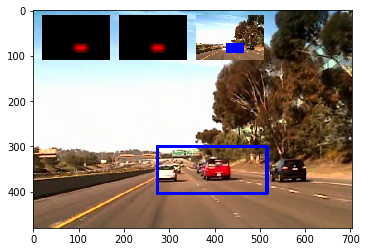



t:  64%|██████▎   | 191/300 [02:40<01:24,  1.29it/s, now=None]

t:  64%|██████▍   | 192/300 [02:41<01:21,  1.32it/s, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (400, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  64%|██████▍   | 193/300 [02:42<01:19,  1.35it/s, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (387, 352)
old bbox= [[310 300]
 [491 405]]
new bbox= [[272 300]
 [502 404]]
Appending new object with centroid: (563, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  65%|██████▍   | 194/300 [02:42<01:17,  1.36it/s, now=None]

Found 144 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (387, 352)
new centroid= (393, 352)
old bbox= [[272 300]
 [502 404]]
new bbox= [[278 300]
 [508 404]]
previously detected objects= 1
so far newly detected objects= 2




t:  65%|██████▌   | 195/300 [02:43<01:17,  1.36it/s, now=None]

Found 160 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (45, 338)
**Found a match**
old centroid= (393, 352)
new centroid= (382, 352)
old bbox= [[278 300]
 [508 404]]
new bbox= [[264 300]
 [500 404]]
**Found a match**
old centroid= (563, 352)
new centroid= (563, 348)
old bbox= [[525 314]
 [602 391]]
new bbox= [[525 310]
 [601 386]]
previously detected objects= 1
so far newly detected objects= 3
Found 148 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 352)
new centroid= (380, 352)
old bbox= [[264 300]
 [500 404]]
new bbox= [[262 300]
 [498 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (380, 352) **
number of times detected object appeared:  1
number of times detected object appeared:  0
Refresh at frame n. 195: newly detected objects 1


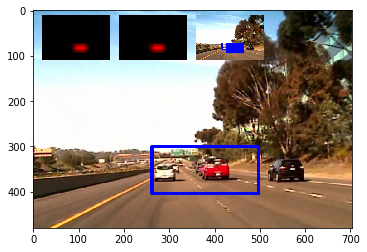



t:  65%|██████▌   | 196/300 [02:44<01:21,  1.28it/s, now=None]

t:  66%|██████▌   | 197/300 [02:45<01:18,  1.32it/s, now=None]

Found 152 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (375, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  66%|██████▌   | 198/300 [02:45<01:15,  1.35it/s, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (375, 352)
new centroid= (373, 352)
old bbox= [[259 300]
 [491 405]]
new bbox= [[254 300]
 [492 404]]
Appending new object with centroid: (568, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  66%|██████▋   | 199/300 [02:46<01:13,  1.37it/s, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (373, 352)
new centroid= (372, 352)
old bbox= [[254 300]
 [492 404]]
new bbox= [[253 300]
 [491 404]]
**Found a match**
old centroid= (568, 345)
new centroid= (566, 345)
old bbox= [[534 314]
 [602 377]]
new bbox= [[528 314]
 [604 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  67%|██████▋   | 200/300 [02:47<01:13,  1.37it/s, now=None]

Found 150 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (372, 352)
new centroid= (375, 352)
old bbox= [[253 300]
 [491 404]]
new bbox= [[256 300]
 [494 404]]
**Found a match**
old centroid= (566, 345)
new centroid= (568, 345)
old bbox= [[528 314]
 [604 376]]
new bbox= [[530 314]
 [606 376]]
previously detected objects= 1
so far newly detected objects= 2
Found 148 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (375, 352)
new centroid= (387, 352)
old bbox= [[256 300]
 [494 404]]
new bbox= [[268 300]
 [506 404]]
**Found a match**
old centroid= (568, 345)
new centroid= (566, 345)
old bbox= [[530 314]
 [606 376]]
new bbox= [[528 314]
 [604 376]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (387, 352) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (566, 345) **
Refresh at frame n. 200: newly detected objects 2

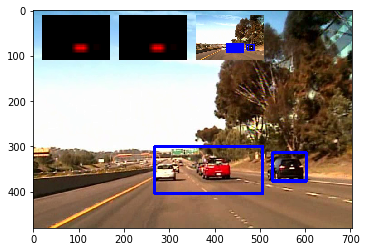



t:  67%|██████▋   | 201/300 [02:48<01:17,  1.27it/s, now=None]

t:  67%|██████▋   | 202/300 [02:48<01:14,  1.31it/s, now=None]

Found 135 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (409, 352)
Appending new object with centroid: (570, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  68%|██████▊   | 203/300 [02:49<01:12,  1.34it/s, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (409, 352)
new centroid= (409, 352)
old bbox= [[322 300]
 [497 405]]
new bbox= [[322 300]
 [496 404]]
**Found a match**
old centroid= (570, 345)
new centroid= (565, 348)
old bbox= [[539 314]
 [602 377]]
new bbox= [[523 310]
 [607 386]]
previously detected objects= 2
so far newly detected objects= 2




t:  68%|██████▊   | 204/300 [02:50<01:10,  1.36it/s, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (409, 352)
new centroid= (405, 352)
old bbox= [[322 300]
 [496 404]]
new bbox= [[311 300]
 [499 404]]
**Found a match**
old centroid= (565, 348)
new centroid= (566, 346)
old bbox= [[523 310]
 [607 386]]
new bbox= [[524 308]
 [608 384]]
previously detected objects= 2
so far newly detected objects= 2




t:  68%|██████▊   | 205/300 [02:51<01:09,  1.37it/s, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (405, 352)
new centroid= (390, 352)
old bbox= [[311 300]
 [499 404]]
new bbox= [[269 300]
 [511 404]]
**Found a match**
old centroid= (566, 346)
new centroid= (565, 345)
old bbox= [[524 308]
 [608 384]]
new bbox= [[523 307]
 [607 383]]
previously detected objects= 2
so far newly detected objects= 2
Found 136 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (390, 352)
new centroid= (399, 352)
old bbox= [[269 300]
 [511 404]]
new bbox= [[278 300]
 [520 404]]
**Found a match**
old centroid= (565, 345)
new centroid= (566, 345)
old bbox= [[523 307]
 [607 383]]
new bbox= [[524 307]
 [608 383]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (399, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (566, 345) **
Refresh at frame n. 205: newly detected objects 2

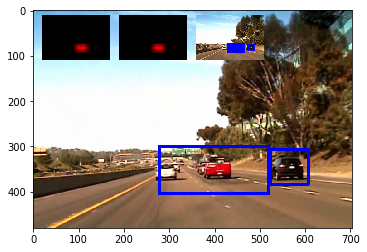



t:  69%|██████▊   | 206/300 [02:51<01:13,  1.29it/s, now=None]

t:  69%|██████▉   | 207/300 [02:52<01:09,  1.33it/s, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (410, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  69%|██████▉   | 208/300 [02:53<01:07,  1.36it/s, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (410, 352)
new centroid= (410, 352)
old bbox= [[322 300]
 [499 405]]
new bbox= [[322 300]
 [498 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (564, 352)
old bbox= [[526 314]
 [603 391]]
new bbox= [[526 314]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  70%|██████▉   | 209/300 [02:54<01:06,  1.38it/s, now=None]

Found 149 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (410, 352)
new centroid= (396, 352)
old bbox= [[322 300]
 [498 404]]
new bbox= [[280 300]
 [512 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (562, 348)
old bbox= [[526 314]
 [602 390]]
new bbox= [[521 310]
 [603 386]]
previously detected objects= 2
so far newly detected objects= 2




t:  70%|███████   | 210/300 [02:54<01:04,  1.39it/s, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (396, 352)
new centroid= (389, 352)
old bbox= [[280 300]
 [512 404]]
new bbox= [[273 300]
 [505 404]]
**Found a match**
old centroid= (562, 348)
new centroid= (561, 350)
old bbox= [[521 310]
 [603 386]]
new bbox= [[519 312]
 [603 388]]
previously detected objects= 2
so far newly detected objects= 2
Found 157 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (389, 352)
new centroid= (396, 352)
old bbox= [[273 300]
 [505 404]]
new bbox= [[280 300]
 [512 404]]
**Found a match**
old centroid= (561, 350)
new centroid= (562, 351)
old bbox= [[519 312]
 [603 388]]
new bbox= [[520 313]
 [604 389]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (396, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (562, 351) **
Refresh at frame n. 210: newly detected objects 2

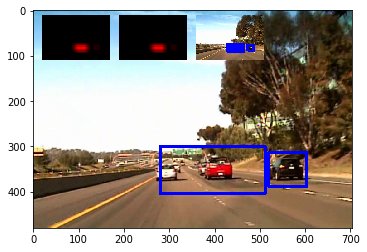



t:  70%|███████   | 211/300 [02:55<01:08,  1.29it/s, now=None]

t:  71%|███████   | 212/300 [02:56<01:06,  1.32it/s, now=None]

Found 157 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (382, 352)
Appending new object with centroid: (571, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  71%|███████   | 213/300 [02:57<01:04,  1.35it/s, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (382, 352)
new centroid= (380, 352)
old bbox= [[266 300]
 [499 405]]
new bbox= [[261 300]
 [499 404]]
**Found a match**
old centroid= (571, 345)
new centroid= (571, 348)
old bbox= [[540 314]
 [603 377]]
new bbox= [[539 310]
 [603 386]]
previously detected objects= 2
so far newly detected objects= 2




t:  71%|███████▏  | 214/300 [02:57<01:02,  1.37it/s, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (380, 352)
new centroid= (391, 352)
old bbox= [[261 300]
 [499 404]]
new bbox= [[272 300]
 [510 404]]
**Found a match**
old centroid= (571, 348)
new centroid= (571, 350)
old bbox= [[539 310]
 [603 386]]
new bbox= [[539 312]
 [603 388]]
previously detected objects= 2
so far newly detected objects= 2




t:  72%|███████▏  | 215/300 [02:58<01:01,  1.39it/s, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (391, 352)
new centroid= (397, 352)
old bbox= [[272 300]
 [510 404]]
new bbox= [[278 300]
 [516 404]]
**Found a match**
old centroid= (571, 350)
new centroid= (571, 351)
old bbox= [[539 312]
 [603 388]]
new bbox= [[539 313]
 [603 389]]
previously detected objects= 2
so far newly detected objects= 2
Found 173 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (397, 352)
new centroid= (386, 352)
old bbox= [[278 300]
 [516 404]]
new bbox= [[264 300]
 [508 404]]
**Found a match**
old centroid= (571, 351)
new centroid= (566, 351)
old bbox= [[539 313]
 [603 389]]
new bbox= [[525 313]
 [607 389]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (386, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (566, 351) **
Refresh at frame n. 215: newly detected objects 2

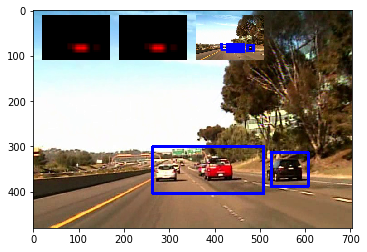



t:  72%|███████▏  | 216/300 [02:59<01:04,  1.30it/s, now=None]

t:  72%|███████▏  | 217/300 [03:00<01:02,  1.33it/s, now=None]

Found 149 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (379, 352)
Appending new object with centroid: (571, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  73%|███████▎  | 218/300 [03:00<01:00,  1.35it/s, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (379, 352)
new centroid= (391, 352)
old bbox= [[260 300]
 [499 405]]
new bbox= [[272 300]
 [510 404]]
**Found a match**
old centroid= (571, 352)
new centroid= (571, 352)
old bbox= [[539 314]
 [603 391]]
new bbox= [[539 314]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  73%|███████▎  | 219/300 [03:01<00:59,  1.37it/s, now=None]

Found 157 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (391, 352)
new centroid= (397, 352)
old bbox= [[272 300]
 [510 404]]
new bbox= [[278 300]
 [516 404]]
**Found a match**
old centroid= (571, 352)
new centroid= (571, 352)
old bbox= [[539 314]
 [603 390]]
new bbox= [[539 314]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  73%|███████▎  | 220/300 [03:02<00:58,  1.38it/s, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (397, 352)
new centroid= (400, 352)
old bbox= [[278 300]
 [516 404]]
new bbox= [[281 300]
 [519 404]]
**Found a match**
old centroid= (571, 352)
new centroid= (571, 352)
old bbox= [[539 314]
 [603 390]]
new bbox= [[539 314]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2
Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (405, 352)
old bbox= [[281 300]
 [519 404]]
new bbox= [[286 300]
 [524 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (405, 352) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (571, 352) **
Refresh at frame n. 220: newly detected objects 2


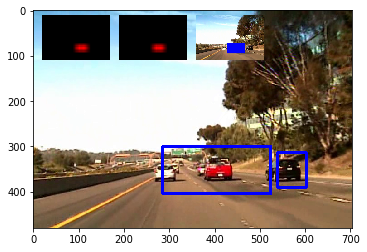



t:  74%|███████▎  | 221/300 [03:03<01:01,  1.28it/s, now=None]

t:  74%|███████▍  | 222/300 [03:03<00:59,  1.32it/s, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (379, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  74%|███████▍  | 223/300 [03:04<00:57,  1.35it/s, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (379, 352)
new centroid= (394, 352)
old bbox= [[259 300]
 [499 405]]
new bbox= [[274 300]
 [514 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (564, 352)
old bbox= [[526 314]
 [603 391]]
new bbox= [[525 314]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  75%|███████▍  | 224/300 [03:05<00:55,  1.36it/s, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (394, 352)
new centroid= (397, 352)
old bbox= [[274 300]
 [514 404]]
new bbox= [[277 300]
 [517 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (562, 352)
old bbox= [[525 314]
 [603 390]]
new bbox= [[521 314]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  75%|███████▌  | 225/300 [03:05<00:54,  1.38it/s, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (397, 352)
new centroid= (386, 352)
old bbox= [[277 300]
 [517 404]]
new bbox= [[264 300]
 [508 404]]
**Found a match**
old centroid= (562, 352)
new centroid= (562, 348)
old bbox= [[521 314]
 [603 390]]
new bbox= [[521 310]
 [603 386]]
previously detected objects= 2
so far newly detected objects= 2
Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (386, 352)
new centroid= (393, 352)
old bbox= [[264 300]
 [508 404]]
new bbox= [[271 300]
 [515 404]]
**Found a match**
old centroid= (562, 348)
new centroid= (563, 350)
old bbox= [[521 310]
 [603 386]]
new bbox= [[522 312]
 [604 388]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (393, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (563, 350) **
Refresh at frame n. 225: newly detected objects 2

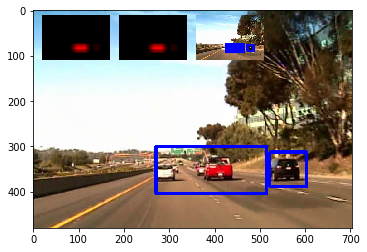



t:  75%|███████▌  | 226/300 [03:06<00:57,  1.30it/s, now=None]

t:  76%|███████▌  | 227/300 [03:07<00:54,  1.33it/s, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (400, 352)
Appending new object with centroid: (565, 345)
previously detected objects= 2
so far newly detected objects= 2




t:  76%|███████▌  | 228/300 [03:08<00:53,  1.35it/s, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[301 300]
 [499 405]]
new bbox= [[301 300]
 [499 404]]
**Found a match**
old centroid= (565, 345)
new centroid= (561, 345)
old bbox= [[534 314]
 [597 377]]
new bbox= [[523 314]
 [599 376]]
previously detected objects= 2
so far newly detected objects= 2




t:  76%|███████▋  | 229/300 [03:08<00:51,  1.37it/s, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[301 300]
 [499 404]]
new bbox= [[301 300]
 [499 404]]
**Found a match**
old centroid= (561, 345)
new centroid= (556, 348)
old bbox= [[523 314]
 [599 376]]
new bbox= [[511 310]
 [601 386]]
previously detected objects= 2
so far newly detected objects= 2




t:  77%|███████▋  | 230/300 [03:09<00:50,  1.37it/s, now=None]

Found 173 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (388, 352)
old bbox= [[301 300]
 [499 404]]
new bbox= [[266 300]
 [510 404]]
**Found a match**
old centroid= (556, 348)
new centroid= (557, 350)
old bbox= [[511 310]
 [601 386]]
new bbox= [[512 312]
 [602 388]]
previously detected objects= 2
so far newly detected objects= 2
Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (388, 352)
new centroid= (382, 352)
old bbox= [[266 300]
 [510 404]]
new bbox= [[260 300]
 [504 404]]
**Found a match**
old centroid= (557, 350)
new centroid= (556, 351)
old bbox= [[512 312]
 [602 388]]
new bbox= [[511 313]
 [601 389]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (382, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (556, 351) **
Refresh at frame n. 230: newly detected objects 2

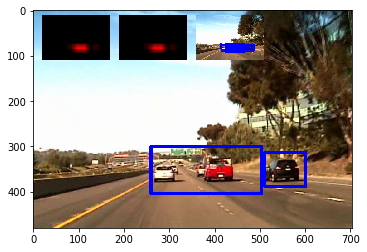



t:  77%|███████▋  | 231/300 [03:10<00:53,  1.28it/s, now=None]

t:  77%|███████▋  | 232/300 [03:11<00:51,  1.32it/s, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (376, 352)
Appending new object with centroid: (554, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  78%|███████▊  | 233/300 [03:12<00:49,  1.35it/s, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (452, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  78%|███████▊  | 234/300 [03:12<00:48,  1.36it/s, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (376, 352)
new centroid= (389, 352)
old bbox= [[254 300]
 [499 405]]
new bbox= [[267 300]
 [511 404]]
**Found a match**
old centroid= (554, 352)
new centroid= (559, 352)
old bbox= [[511 314]
 [597 391]]
new bbox= [[516 314]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 3




t:  78%|███████▊  | 235/300 [03:13<00:47,  1.38it/s, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (389, 352)
new centroid= (384, 352)
old bbox= [[267 300]
 [511 404]]
new bbox= [[259 300]
 [509 404]]
**Found a match**
old centroid= (559, 352)
new centroid= (560, 352)
old bbox= [[516 314]
 [602 390]]
new bbox= [[517 314]
 [603 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (384, 352)
new centroid= (381, 352)
old bbox= [[259 300]
 [509 404]]
new bbox= [[256 300]
 [506 404]]
**Found a match**
old centroid= (560, 352)
new centroid= (560, 352)
old bbox= [[517 314]
 [603 390]]
new bbox= [[517 314]
 [603 390]]
previously detected objects= 2
number of times detected object appeared:  3
** Adding similar object to one with centroid (381, 352) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (560, 352) **
number of times detected object appeared:  0
Refr

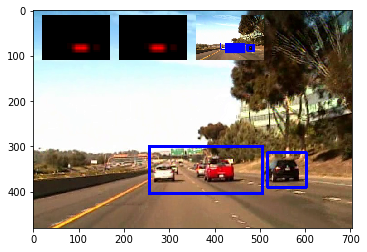



t:  79%|███████▊  | 236/300 [03:14<00:49,  1.29it/s, now=None]

t:  79%|███████▉  | 237/300 [03:15<00:47,  1.32it/s, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (379, 352)
previously detected objects= 2
so far newly detected objects= 1




t:  79%|███████▉  | 238/300 [03:15<00:45,  1.35it/s, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (379, 352)
new centroid= (379, 352)
old bbox= [[254 300]
 [504 405]]
new bbox= [[254 300]
 [504 404]]
Appending new object with centroid: (553, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  80%|███████▉  | 239/300 [03:16<00:44,  1.37it/s, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (449, 352)
previously detected objects= 2
so far newly detected objects= 3




t:  80%|████████  | 240/300 [03:17<00:43,  1.38it/s, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (379, 352)
new centroid= (378, 352)
old bbox= [[254 300]
 [504 404]]
new bbox= [[252 300]
 [504 404]]
**Found a match**
old centroid= (553, 352)
new centroid= (558, 352)
old bbox= [[511 314]
 [595 391]]
new bbox= [[516 314]
 [600 390]]
previously detected objects= 2
so far newly detected objects= 3
Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (378, 352)
new centroid= (390, 352)
old bbox= [[252 300]
 [504 404]]
new bbox= [[264 300]
 [516 404]]
**Found a match**
old centroid= (558, 352)
new centroid= (554, 348)
old bbox= [[516 314]
 [600 390]]
new bbox= [[512 310]
 [596 386]]
previously detected objects= 2
number of times detected object appeared:  3
** Adding similar object to one with centroid (390, 352) **
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 240: newly detected objects 1


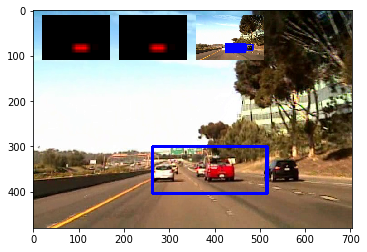



t:  80%|████████  | 241/300 [03:18<00:45,  1.29it/s, now=None]

t:  81%|████████  | 242/300 [03:18<00:43,  1.33it/s, now=None]

Found 173 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (403, 352)
Appending new object with centroid: (560, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  81%|████████  | 243/300 [03:19<00:42,  1.36it/s, now=None]

Found 190 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 352)
new centroid= (387, 352)
old bbox= [[301 300]
 [505 405]]
new bbox= [[255 300]
 [519 404]]
**Found a match**
old centroid= (560, 345)
new centroid= (560, 345)
old bbox= [[525 314]
 [595 377]]
new bbox= [[519 314]
 [601 376]]
previously detected objects= 1
so far newly detected objects= 2




t:  81%|████████▏ | 244/300 [03:20<00:40,  1.37it/s, now=None]

Found 183 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (387, 352)
new centroid= (393, 352)
old bbox= [[255 300]
 [519 404]]
new bbox= [[261 300]
 [525 404]]
**Found a match**
old centroid= (560, 345)
new centroid= (560, 348)
old bbox= [[519 314]
 [601 376]]
new bbox= [[519 310]
 [601 386]]
previously detected objects= 1
so far newly detected objects= 2




t:  82%|████████▏ | 245/300 [03:20<00:39,  1.38it/s, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (393, 352)
new centroid= (387, 352)
old bbox= [[261 300]
 [525 404]]
new bbox= [[255 300]
 [519 404]]
**Found a match**
old centroid= (560, 348)
new centroid= (560, 346)
old bbox= [[519 310]
 [601 386]]
new bbox= [[519 308]
 [601 384]]
previously detected objects= 1
so far newly detected objects= 2
Found 185 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (387, 352)
new centroid= (382, 352)
old bbox= [[255 300]
 [519 404]]
new bbox= [[250 300]
 [514 404]]
**Found a match**
old centroid= (560, 346)
new centroid= (561, 349)
old bbox= [[519 308]
 [601 384]]
new bbox= [[520 311]
 [602 387]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (382, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (561, 349) **
Refresh at frame n. 245: newly detected objects 2

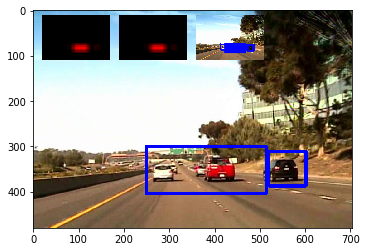



t:  82%|████████▏ | 246/300 [03:21<00:41,  1.29it/s, now=None]

t:  82%|████████▏ | 247/300 [03:22<00:40,  1.32it/s, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (382, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  83%|████████▎ | 248/300 [03:23<00:38,  1.34it/s, now=None]

Found 180 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (382, 352)
new centroid= (391, 352)
old bbox= [[260 300]
 [505 405]]
new bbox= [[269 300]
 [513 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (561, 352)
old bbox= [[526 314]
 [602 391]]
new bbox= [[523 314]
 [599 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  83%|████████▎ | 249/300 [03:23<00:37,  1.36it/s, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (391, 352)
new centroid= (395, 352)
old bbox= [[269 300]
 [513 404]]
new bbox= [[273 300]
 [517 404]]
**Found a match**
old centroid= (561, 352)
new centroid= (564, 352)
old bbox= [[523 314]
 [599 390]]
new bbox= [[526 314]
 [602 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  83%|████████▎ | 250/300 [03:24<00:36,  1.38it/s, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (395, 352)
new centroid= (397, 352)
old bbox= [[273 300]
 [517 404]]
new bbox= [[275 300]
 [519 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (563, 348)
old bbox= [[526 314]
 [602 390]]
new bbox= [[525 310]
 [601 386]]
previously detected objects= 2
so far newly detected objects= 2
Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (397, 352)
new centroid= (398, 352)
old bbox= [[275 300]
 [519 404]]
new bbox= [[276 300]
 [520 404]]
**Found a match**
old centroid= (563, 348)
new centroid= (561, 346)
old bbox= [[525 310]
 [601 386]]
new bbox= [[523 308]
 [599 384]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (398, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (561, 346) **
Refresh at frame n. 250: newly detected objects 2

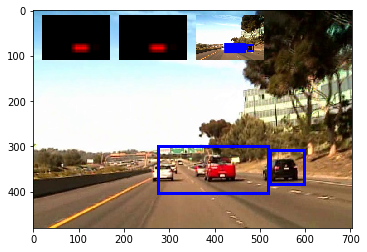



t:  84%|████████▎ | 251/300 [03:25<00:37,  1.29it/s, now=None]

t:  84%|████████▍ | 252/300 [03:26<00:36,  1.33it/s, now=None]

Found 185 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (400, 352)
Appending new object with centroid: (556, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  84%|████████▍ | 253/300 [03:26<00:34,  1.36it/s, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (400, 352)
old bbox= [[296 300]
 [505 405]]
new bbox= [[296 300]
 [504 404]]
**Found a match**
old centroid= (556, 352)
new centroid= (560, 352)
old bbox= [[511 314]
 [602 391]]
new bbox= [[515 314]
 [605 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  85%|████████▍ | 254/300 [03:27<00:33,  1.37it/s, now=None]

Found 197 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 352)
new centroid= (389, 352)
old bbox= [[296 300]
 [504 404]]
new bbox= [[264 300]
 [514 404]]
**Found a match**
old centroid= (560, 352)
new centroid= (560, 352)
old bbox= [[515 314]
 [605 390]]
new bbox= [[515 314]
 [605 390]]
previously detected objects= 2
so far newly detected objects= 2




t:  85%|████████▌ | 255/300 [03:28<00:32,  1.37it/s, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (389, 352)
new centroid= (383, 352)
old bbox= [[264 300]
 [514 404]]
new bbox= [[257 300]
 [509 404]]
**Found a match**
old centroid= (560, 352)
new centroid= (558, 352)
old bbox= [[515 314]
 [605 390]]
new bbox= [[512 314]
 [604 390]]
previously detected objects= 2
so far newly detected objects= 2
Found 180 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (383, 352)
new centroid= (391, 352)
old bbox= [[257 300]
 [509 404]]
new bbox= [[265 300]
 [517 404]]
**Found a match**
old centroid= (558, 352)
new centroid= (561, 352)
old bbox= [[512 314]
 [604 390]]
new bbox= [[515 314]
 [607 390]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (391, 352) **
number of times detected object appeared:  4
** Adding similar object to one with centroid (561, 352) **
Refresh at frame n. 255: newly detected objects 2

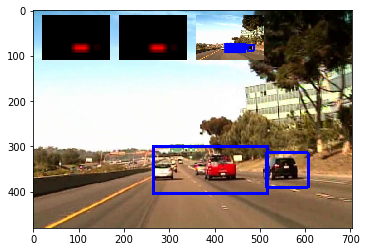



t:  85%|████████▌ | 256/300 [03:29<00:34,  1.28it/s, now=None]

t:  86%|████████▌ | 257/300 [03:29<00:32,  1.32it/s, now=None]

Found 185 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (400, 352)
Appending new object with centroid: (564, 352)
previously detected objects= 2
so far newly detected objects= 2




t:  86%|████████▌ | 258/300 [03:30<00:31,  1.35it/s, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (400, 352)
new centroid= (413, 352)
old bbox= [[296 300]
 [505 405]]
new bbox= [[238 300]
 [588 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  86%|████████▋ | 259/300 [03:31<00:29,  1.37it/s, now=None]

Found 195 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (413, 352)
new centroid= (420, 352)
old bbox= [[238 300]
 [588 404]]
new bbox= [[245 300]
 [595 404]]
previously detected objects= 2
so far newly detected objects= 2




t:  87%|████████▋ | 260/300 [03:32<00:28,  1.38it/s, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (420, 352)
new centroid= (424, 352)
old bbox= [[245 300]
 [595 404]]
new bbox= [[249 300]
 [599 404]]
previously detected objects= 2
so far newly detected objects= 2
Found 206 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (424, 352)
new centroid= (422, 352)
old bbox= [[249 300]
 [599 404]]
new bbox= [[241 300]
 [603 404]]
previously detected objects= 2
number of times detected object appeared:  4
** Adding similar object to one with centroid (422, 352) **
number of times detected object appeared:  0
Refresh at frame n. 260: newly detected objects 1


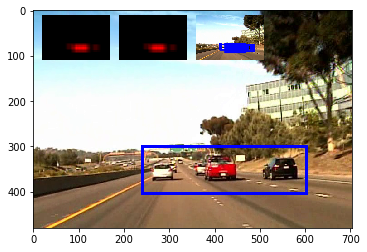



t:  87%|████████▋ | 261/300 [03:32<00:30,  1.29it/s, now=None]

t:  87%|████████▋ | 262/300 [03:33<00:28,  1.32it/s, now=None]

Found 255 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (354, 352)
Appending new object with centroid: (561, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  88%|████████▊ | 263/300 [03:34<00:27,  1.36it/s, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (421, 352)
previously detected objects= 1
so far newly detected objects= 3




t:  88%|████████▊ | 264/300 [03:35<00:26,  1.37it/s, now=None]

Found 190 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (421, 352)
new centroid= (418, 352)
old bbox= [[240 300]
 [603 405]]
new bbox= [[237 300]
 [599 404]]
previously detected objects= 1
so far newly detected objects= 3




t:  88%|████████▊ | 265/300 [03:35<00:25,  1.38it/s, now=None]

Found 190 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (418, 352)
new centroid= (432, 352)
old bbox= [[237 300]
 [599 404]]
new bbox= [[251 300]
 [613 404]]
previously detected objects= 1
so far newly detected objects= 3
Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (354, 352)
new centroid= (363, 352)
old bbox= [[203 300]
 [505 405]]
new bbox= [[212 300]
 [514 404]]
**Found a match**
old centroid= (561, 352)
new centroid= (561, 352)
old bbox= [[520 314]
 [602 391]]
new bbox= [[520 314]
 [602 390]]
previously detected objects= 1
number of times detected object appeared:  1
number of times detected object appeared:  1
number of times detected object appeared:  2
Refresh at frame n. 265: newly detected objects 0


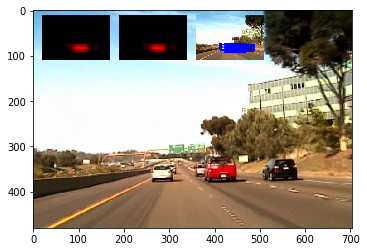



t:  89%|████████▊ | 266/300 [03:36<00:26,  1.29it/s, now=None]

t:  89%|████████▉ | 267/300 [03:37<00:24,  1.33it/s, now=None]

Found 220 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (420, 352)
Appending new object with centroid: (98, 359)
previously detected objects= 0
so far newly detected objects= 2




t:  89%|████████▉ | 268/300 [03:38<00:23,  1.35it/s, now=None]

Found 191 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (420, 352)
new centroid= (423, 352)
old bbox= [[238 300]
 [602 405]]
new bbox= [[241 300]
 [605 404]]
previously detected objects= 0
so far newly detected objects= 2




t:  90%|████████▉ | 269/300 [03:38<00:22,  1.35it/s, now=None]

Found 178 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (423, 352)
new centroid= (413, 352)
old bbox= [[241 300]
 [605 404]]
new bbox= [[231 300]
 [595 404]]
Appending new object with centroid: (560, 345)
previously detected objects= 0
so far newly detected objects= 3




t:  90%|█████████ | 270/300 [03:39<00:22,  1.32it/s, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (413, 352)
new centroid= (393, 352)
old bbox= [[231 300]
 [595 404]]
new bbox= [[211 300]
 [575 404]]
**Found a match**
old centroid= (560, 345)
new centroid= (560, 348)
old bbox= [[532 314]
 [589 377]]
new bbox= [[519 310]
 [601 386]]
previously detected objects= 0
so far newly detected objects= 3
Found 197 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (393, 352)
new centroid= (387, 352)
old bbox= [[211 300]
 [575 404]]
new bbox= [[205 300]
 [569 404]]
**Found a match**
old centroid= (560, 348)
new centroid= (560, 350)
old bbox= [[519 310]
 [601 386]]
new bbox= [[519 312]
 [601 388]]
previously detected objects= 0
number of times detected object appeared:  4
** Adding similar object to one with centroid (387, 352) **
number of times detected object appeared:  0
number of times detected object appeared:  2
Refresh at frame n. 270: newly detected objects 1


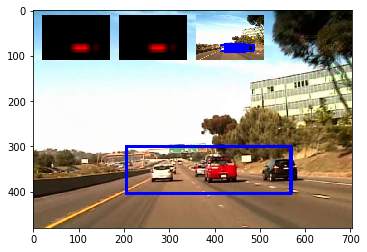



t:  90%|█████████ | 271/300 [03:40<00:23,  1.23it/s, now=None]

t:  91%|█████████ | 272/300 [03:41<00:23,  1.22it/s, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (427, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  91%|█████████ | 273/300 [03:42<00:22,  1.19it/s, now=None]

Found 206 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (427, 352)
new centroid= (424, 352)
old bbox= [[252 300]
 [602 405]]
new bbox= [[243 300]
 [605 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  91%|█████████▏| 274/300 [03:43<00:21,  1.21it/s, now=None]

Found 185 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 352)
new centroid= (413, 352)
old bbox= [[243 300]
 [605 404]]
new bbox= [[232 300]
 [594 404]]
Appending new object with centroid: (564, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  92%|█████████▏| 275/300 [03:43<00:19,  1.25it/s, now=None]

Found 197 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (413, 352)
new centroid= (420, 352)
old bbox= [[232 300]
 [594 404]]
new bbox= [[239 300]
 [601 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 197 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (420, 352)
new centroid= (423, 352)
old bbox= [[239 300]
 [601 404]]
new bbox= [[242 300]
 [604 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (423, 352) **
number of times detected object appeared:  0
Refresh at frame n. 275: newly detected objects 1


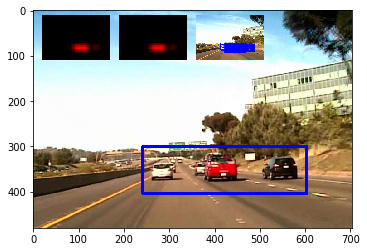



t:  92%|█████████▏| 276/300 [03:44<00:20,  1.20it/s, now=None]

t:  92%|█████████▏| 277/300 [03:45<00:19,  1.20it/s, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (427, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 278/300 [03:46<00:17,  1.26it/s, now=None]

Found 197 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (427, 352)
new centroid= (422, 352)
old bbox= [[252 300]
 [602 405]]
new bbox= [[237 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  93%|█████████▎| 279/300 [03:47<00:16,  1.29it/s, now=None]

Found 196 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (422, 352)
new centroid= (401, 352)
old bbox= [[237 300]
 [607 404]]
new bbox= [[216 300]
 [586 404]]
Appending new object with centroid: (564, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  93%|█████████▎| 280/300 [03:47<00:15,  1.31it/s, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (401, 352)
new centroid= (409, 352)
old bbox= [[216 300]
 [586 404]]
new bbox= [[224 300]
 [594 404]]
previously detected objects= 1
so far newly detected objects= 2
Found 201 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (409, 352)
new centroid= (395, 352)
old bbox= [[224 300]
 [594 404]]
new bbox= [[210 300]
 [580 404]]
**Found a match**
old centroid= (564, 352)
new centroid= (564, 352)
old bbox= [[525 314]
 [603 391]]
new bbox= [[525 314]
 [603 390]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (395, 352) **
number of times detected object appeared:  1
Refresh at frame n. 280: newly detected objects 1


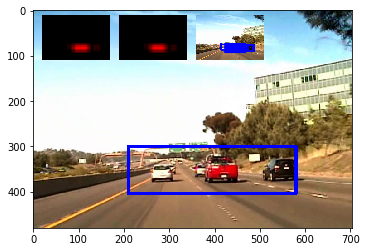



t:  94%|█████████▎| 281/300 [03:48<00:16,  1.15it/s, now=None]

t:  94%|█████████▍| 282/300 [03:49<00:14,  1.20it/s, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (404, 352)
Appending new object with centroid: (561, 352)
previously detected objects= 1
so far newly detected objects= 2




t:  94%|█████████▍| 283/300 [03:50<00:13,  1.24it/s, now=None]

Found 191 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (404, 352)
new centroid= (404, 352)
old bbox= [[296 300]
 [513 405]]
new bbox= [[296 300]
 [512 404]]
**Found a match**
old centroid= (561, 352)
new centroid= (562, 352)
old bbox= [[520 314]
 [603 391]]
new bbox= [[521 314]
 [603 390]]
previously detected objects= 1
so far newly detected objects= 2




t:  95%|█████████▍| 284/300 [03:51<00:12,  1.28it/s, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (404, 352)
new centroid= (393, 352)
old bbox= [[296 300]
 [512 404]]
new bbox= [[264 300]
 [522 404]]
**Found a match**
old centroid= (562, 352)
new centroid= (563, 352)
old bbox= [[521 314]
 [603 390]]
new bbox= [[522 314]
 [604 390]]
previously detected objects= 1
so far newly detected objects= 2




t:  95%|█████████▌| 285/300 [03:51<00:11,  1.29it/s, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (288, 331)
Appending new object with centroid: (463, 352)
previously detected objects= 1
so far newly detected objects= 4
Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (393, 352)
new centroid= (412, 352)
old bbox= [[264 300]
 [522 404]]
new bbox= [[240 300]
 [584 404]]
previously detected objects= 1
number of times detected object appeared:  3
** Adding similar object to one with centroid (412, 352) **
number of times detected object appeared:  2
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 285: newly detected objects 1


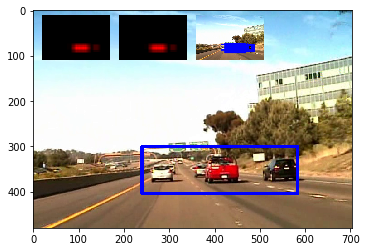



t:  95%|█████████▌| 286/300 [03:52<00:11,  1.23it/s, now=None]

t:  96%|█████████▌| 287/300 [03:53<00:10,  1.27it/s, now=None]

Found 208 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (428, 352)
previously detected objects= 1
so far newly detected objects= 1




t:  96%|█████████▌| 288/300 [03:54<00:09,  1.30it/s, now=None]

Found 208 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (428, 352)
new centroid= (428, 352)
old bbox= [[254 300]
 [603 405]]
new bbox= [[254 300]
 [602 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  96%|█████████▋| 289/300 [03:54<00:08,  1.33it/s, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (428, 352)
new centroid= (438, 352)
old bbox= [[254 300]
 [602 404]]
new bbox= [[264 300]
 [612 404]]
previously detected objects= 1
so far newly detected objects= 1




t:  97%|█████████▋| 290/300 [03:55<00:07,  1.35it/s, now=None]

Found 215 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (438, 352)
new centroid= (432, 352)
old bbox= [[264 300]
 [612 404]]
new bbox= [[257 300]
 [607 404]]
previously detected objects= 1
so far newly detected objects= 1
Found 200 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (432, 352)
new centroid= (407, 352)
old bbox= [[257 300]
 [607 404]]
new bbox= [[232 300]
 [582 404]]
Appending new object with centroid: (561, 338)
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (407, 352) **
number of times detected object appeared:  0
Refresh at frame n. 290: newly detected objects 1


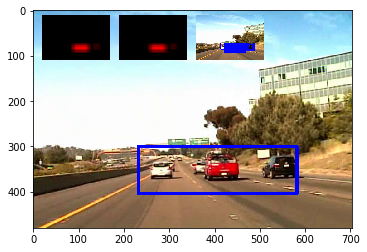



t:  97%|█████████▋| 291/300 [03:56<00:07,  1.28it/s, now=None]

t:  97%|█████████▋| 292/300 [03:57<00:06,  1.31it/s, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (403, 352)
Appending new object with centroid: (564, 345)
previously detected objects= 1
so far newly detected objects= 2




t:  98%|█████████▊| 293/300 [03:57<00:05,  1.33it/s, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 352)
new centroid= (403, 352)
old bbox= [[294 300]
 [513 405]]
new bbox= [[294 300]
 [512 404]]
**Found a match**
old centroid= (564, 345)
new centroid= (562, 341)
old bbox= [[525 300]
 [603 391]]
new bbox= [[521 296]
 [603 386]]
previously detected objects= 1
so far newly detected objects= 2




t:  98%|█████████▊| 294/300 [03:58<00:04,  1.36it/s, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 352)
new centroid= (393, 352)
old bbox= [[294 300]
 [512 404]]
new bbox= [[264 300]
 [522 404]]
**Found a match**
old centroid= (562, 341)
new centroid= (561, 339)
old bbox= [[521 296]
 [603 386]]
new bbox= [[520 294]
 [602 384]]
previously detected objects= 1
so far newly detected objects= 2




t:  98%|█████████▊| 295/300 [03:59<00:03,  1.37it/s, now=None]

Found 200 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (393, 352)
new centroid= (388, 352)
old bbox= [[264 300]
 [522 404]]
new bbox= [[259 300]
 [517 404]]
**Found a match**
old centroid= (561, 339)
new centroid= (562, 338)
old bbox= [[520 294]
 [602 384]]
new bbox= [[521 293]
 [603 383]]
previously detected objects= 1
so far newly detected objects= 2
Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (388, 352)
new centroid= (409, 352)
old bbox= [[259 300]
 [517 404]]
new bbox= [[237 300]
 [581 404]]
previously detected objects= 1
number of times detected object appeared:  4
** Adding similar object to one with centroid (409, 352) **
number of times detected object appeared:  3
** Adding similar object to one with centroid (562, 338) **
Refresh at frame n. 295: newly detected objects 2


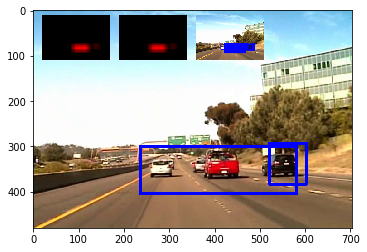



t:  99%|█████████▊| 296/300 [04:00<00:03,  1.29it/s, now=None]

t:  99%|█████████▉| 297/300 [04:00<00:02,  1.32it/s, now=None]

Found 166 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (288, 331)
Appending new object with centroid: (418, 352)
Appending new object with centroid: (561, 338)
previously detected objects= 2
so far newly detected objects= 3




t:  99%|█████████▉| 298/300 [04:01<00:01,  1.35it/s, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (418, 352)
new centroid= (418, 352)
old bbox= [[324 300]
 [513 405]]
new bbox= [[324 300]
 [512 404]]
**Found a match**
old centroid= (561, 338)
new centroid= (562, 338)
old bbox= [[520 300]
 [603 377]]
new bbox= [[521 300]
 [603 376]]
previously detected objects= 2
so far newly detected objects= 3




t: 100%|█████████▉| 299/300 [04:02<00:00,  1.37it/s, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (418, 352)
new centroid= (418, 352)
old bbox= [[324 300]
 [512 404]]
new bbox= [[324 300]
 [512 404]]
**Found a match**
old centroid= (562, 338)
new centroid= (563, 338)
old bbox= [[521 300]
 [603 376]]
new bbox= [[522 300]
 [604 376]]
previously detected objects= 2
so far newly detected objects= 3




t: 100%|██████████| 300/300 [04:03<00:00,  1.37it/s, now=None]

Found 209 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (418, 352)
new centroid= (433, 352)
old bbox= [[324 300]
 [512 404]]
new bbox= [[279 300]
 [587 404]]
previously detected objects= 2
so far newly detected objects= 3
Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (433, 352)
new centroid= (440, 352)
old bbox= [[279 300]
 [587 404]]
new bbox= [[286 300]
 [594 404]]
previously detected objects= 2
number of times detected object appeared:  0
number of times detected object appeared:  4
** Adding similar object to one with centroid (440, 352) **
number of times detected object appeared:  2
Refresh at frame n. 300: newly detected objects 1


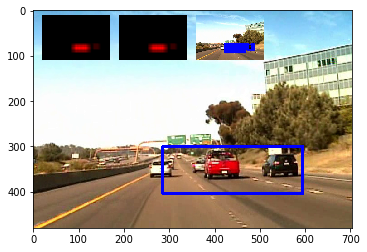



                                                              
t:   2%|▏         | 5/300 [50:22<13:02,  2.65s/it, now=None] 
                                                            ]
t:  24%|██▎       | 71/300 [48:19<07:52,  2.06s/it, now=None]

Moviepy - Done !
Moviepy - video ready output_videos/april21.mp4
CPU times: user 5min, sys: 2.38 s, total: 5min 3s
Wall time: 4min 4s


In [300]:
detector = VehicleDetectorWithMemory(NB, simple_classifier, normaliser, color_space="YCrCb", save_frame=False, 
                                     frame_sampling_rate=5, threshold=2, min_detection_count=3, 
                                     debug_imgs=True, cell_overlap=1)

clip1 = VideoFileClip(project_video_sample_path)
project_video_clip = clip1.fl_image(detector.process_image) 
%time project_video_clip.write_videofile(project_video_sample_output_path, audio=False)

In [151]:
HTML("""
<video width="900" height="600" controls>
  <source src="{0}">
</video>
""".format(project_video_sample_output_path))

In [145]:
my_gif = VideoFileClip(project_video_sample_output_path).resize(width=480)
my_gif.subclip(0,6).write_gif("media/two_cars_detected.gif", fps=15)

t:   0%|          | 0/90 [00:00<?, ?it/s, now=None]

MoviePy - Building file media/two_cars_detected.gif with imageio.


In [90]:
my_saved_img_clip = VideoFileClip(project_video_sample_output_path)
my_saved_img_clip.save_frame("media/saved_detection.png", t='00:00:5')  # saves frame at time t

In [99]:
detector = VehicleDetectorWithMemory(MLP, simple_classifier, normaliser, color_space="YCrCb", save_frame=False, 
                                     frame_sampling_rate=10, threshold=5, 
                                     min_detection_count=8, cell_overlap=1)

clip1 = VideoFileClip(project_video_path)
project_video_clip = clip1.fl_image(detector.process_image) #NOTE: this function expects color images!!
%time project_video_clip.write_videofile(project_video_output_path, audio=False)

t:   0%|          | 0/1600 [00:00<?, ?it/s, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (362, 257)
previously detected objects= 0
so far newly detected objects= 1
Moviepy - Building video output_videos/jan28.mp4.
Moviepy - Writing video output_videos/jan28.mp4



t:   0%|          | 2/1600 [00:02<27:39,  1.04s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 257)
new centroid= (362, 257)
old bbox= [[128 198]
 [597 317]]
new bbox= [[128 198]
 [596 316]]
previously detected objects= 0
so far newly detected objects= 1


t:   0%|          | 3/1600 [00:03<31:44,  1.19s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 257)
new centroid= (360, 257)
old bbox= [[128 198]
 [596 316]]
new bbox= [[126 198]
 [594 316]]
previously detected objects= 0
so far newly detected objects= 1


t:   0%|          | 4/1600 [00:05<34:39,  1.30s/it, now=None]

Found 143 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (360, 257)
new centroid= (353, 253)
old bbox= [[126 198]
 [594 316]]
new bbox= [[112 194]
 [594 312]]
previously detected objects= 0
so far newly detected objects= 1


t:   0%|          | 5/1600 [00:06<36:33,  1.37s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 253)
new centroid= (353, 255)
old bbox= [[112 194]
 [594 312]]
new bbox= [[112 196]
 [594 314]]
previously detected objects= 0
so far newly detected objects= 1


t:   0%|          | 6/1600 [00:08<37:49,  1.42s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 255)
new centroid= (355, 252)
old bbox= [[112 196]
 [594 314]]
new bbox= [[114 193]
 [596 311]]
previously detected objects= 0
so far newly detected objects= 1


t:   0%|          | 7/1600 [00:09<38:43,  1.46s/it, now=None]

Found 143 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 252)
new centroid= (353, 251)
old bbox= [[114 193]
 [596 311]]
new bbox= [[112 192]
 [594 310]]
previously detected objects= 0
so far newly detected objects= 1


t:   0%|          | 8/1600 [00:11<39:34,  1.49s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 251)
new centroid= (354, 254)
old bbox= [[112 192]
 [594 310]]
new bbox= [[113 195]
 [595 313]]
previously detected objects= 0
so far newly detected objects= 1


t:   1%|          | 9/1600 [00:12<39:58,  1.51s/it, now=None]

Found 161 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 254)
new centroid= (356, 259)
old bbox= [[113 195]
 [595 313]]
new bbox= [[115 193]
 [597 325]]
previously detected objects= 0
so far newly detected objects= 1


t:   1%|          | 10/1600 [00:14<40:12,  1.52s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (356, 259)
new centroid= (355, 261)
old bbox= [[115 193]
 [597 325]]
new bbox= [[114 195]
 [596 327]]
previously detected objects= 0
so far newly detected objects= 1


t:   1%|          | 11/1600 [00:16<40:23,  1.53s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 261)
new centroid= (353, 262)
old bbox= [[114 195]
 [596 327]]
new bbox= [[108 196]
 [598 328]]
previously detected objects= 0
number of times detected object appeared:  10
** Adding similar object to one with centroid (353, 262) **
Refresh at frame n. 10: newly detected objects 1


t:   1%|          | 12/1600 [00:17<40:30,  1.53s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 264)
previously detected objects= 1
so far newly detected objects= 1


t:   1%|          | 13/1600 [00:19<40:35,  1.53s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 264)
new centroid= (347, 264)
old bbox= [[100 198]
 [589 331]]
new bbox= [[102 198]
 [592 330]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|          | 14/1600 [00:20<40:52,  1.55s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 264)
new centroid= (349, 264)
old bbox= [[102 198]
 [592 330]]
new bbox= [[104 198]
 [594 330]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|          | 15/1600 [00:22<41:24,  1.57s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (349, 264)
new centroid= (348, 257)
old bbox= [[104 198]
 [594 330]]
new bbox= [[100 191]
 [596 323]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|          | 16/1600 [00:24<42:49,  1.62s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 257)
new centroid= (346, 253)
old bbox= [[100 191]
 [596 323]]
new bbox= [[ 98 187]
 [594 319]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|          | 17/1600 [00:25<43:16,  1.64s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 253)
new centroid= (347, 255)
old bbox= [[ 98 187]
 [594 319]]
new bbox= [[ 99 189]
 [595 321]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|          | 18/1600 [00:27<44:35,  1.69s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 255)
new centroid= (345, 256)
old bbox= [[ 99 189]
 [595 321]]
new bbox= [[ 93 190]
 [597 322]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|          | 19/1600 [00:29<44:20,  1.68s/it, now=None]

Found 147 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 256)
new centroid= (346, 253)
old bbox= [[ 93 190]
 [597 322]]
new bbox= [[ 94 187]
 [598 319]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|▏         | 20/1600 [00:30<43:28,  1.65s/it, now=None]

Found 193 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 253)
new centroid= (343, 251)
old bbox= [[ 94 187]
 [598 319]]
new bbox= [[ 81 185]
 [605 317]]
previously detected objects= 1
so far newly detected objects= 1


t:   1%|▏         | 21/1600 [00:32<43:20,  1.65s/it, now=None]

Found 143 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (343, 251)
new centroid= (345, 250)
old bbox= [[ 81 185]
 [605 317]]
new bbox= [[ 83 184]
 [607 316]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (345, 250) **
Refresh at frame n. 20: newly detected objects 1


t:   1%|▏         | 22/1600 [00:34<43:01,  1.64s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 257)
previously detected objects= 1
so far newly detected objects= 1


t:   1%|▏         | 23/1600 [00:35<42:34,  1.62s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 257)
new centroid= (344, 257)
old bbox= [[ 92 198]
 [597 317]]
new bbox= [[ 92 198]
 [596 316]]
previously detected objects= 1
so far newly detected objects= 1


t:   2%|▏         | 24/1600 [00:37<42:06,  1.60s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 257)
new centroid= (344, 253)
old bbox= [[ 92 198]
 [596 316]]
new bbox= [[ 92 194]
 [596 312]]
previously detected objects= 1
so far newly detected objects= 1


t:   2%|▏         | 25/1600 [00:38<41:44,  1.59s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (155, 250)
Appending new object with centroid: (414, 250)
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 26/1600 [00:40<41:44,  1.59s/it, now=None]

Found 184 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 253)
new centroid= (344, 248)
old bbox= [[ 92 194]
 [596 312]]
new bbox= [[ 92 189]
 [596 307]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 27/1600 [00:41<41:31,  1.58s/it, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 248)
new centroid= (344, 249)
old bbox= [[ 92 189]
 [596 307]]
new bbox= [[ 92 190]
 [596 308]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 28/1600 [00:43<41:22,  1.58s/it, now=None]

Found 142 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 249)
new centroid= (335, 249)
old bbox= [[ 92 190]
 [596 308]]
new bbox= [[ 73 190]
 [597 308]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 29/1600 [00:45<41:14,  1.58s/it, now=None]

Found 165 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (335, 249)
new centroid= (339, 249)
old bbox= [[ 73 190]
 [597 308]]
new bbox= [[ 77 190]
 [601 308]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 30/1600 [00:46<41:15,  1.58s/it, now=None]

Found 165 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 249)
new centroid= (336, 249)
old bbox= [[ 77 190]
 [601 308]]
new bbox= [[ 74 190]
 [598 308]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 31/1600 [00:48<41:10,  1.57s/it, now=None]

Found 160 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 249)
new centroid= (336, 246)
old bbox= [[ 74 190]
 [598 308]]
new bbox= [[ 74 187]
 [598 305]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (336, 246) **
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 30: newly detected objects 1


t:   2%|▏         | 32/1600 [00:49<42:50,  1.64s/it, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (337, 243)
previously detected objects= 1
so far newly detected objects= 1


t:   2%|▏         | 33/1600 [00:52<46:57,  1.80s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (134, 250)
Appending new object with centroid: (400, 250)
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 34/1600 [00:54<47:41,  1.83s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 243)
new centroid= (333, 253)
old bbox= [[ 78 184]
 [597 303]]
new bbox= [[ 67 187]
 [599 319]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 35/1600 [00:55<46:03,  1.77s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 253)
new centroid= (335, 251)
old bbox= [[ 67 187]
 [599 319]]
new bbox= [[ 69 185]
 [601 317]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 36/1600 [00:57<44:41,  1.71s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (335, 251)
new centroid= (332, 254)
old bbox= [[ 69 185]
 [601 317]]
new bbox= [[ 66 188]
 [598 320]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 37/1600 [00:58<43:24,  1.67s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (134, 250)
new centroid= (130, 253)
old bbox= [[ 78 198]
 [191 303]]
new bbox= [[ 67 194]
 [193 312]]
**Found a match**
old centroid= (400, 250)
new centroid= (400, 250)
old bbox= [[204 198]
 [597 303]]
new bbox= [[204 198]
 [596 302]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 38/1600 [01:00<42:49,  1.65s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (332, 254)
new centroid= (331, 255)
old bbox= [[ 66 188]
 [598 320]]
new bbox= [[ 65 189]
 [597 321]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▏         | 39/1600 [01:01<42:22,  1.63s/it, now=None]

Found 160 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 255)
new centroid= (330, 263)
old bbox= [[ 65 189]
 [597 321]]
new bbox= [[ 64 190]
 [596 336]]
previously detected objects= 1
so far newly detected objects= 3


t:   2%|▎         | 40/1600 [01:03<41:58,  1.61s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 263)
new centroid= (330, 260)
old bbox= [[ 64 190]
 [596 336]]
new bbox= [[ 64 187]
 [596 333]]
previously detected objects= 1
so far newly detected objects= 3


t:   3%|▎         | 41/1600 [01:05<41:31,  1.60s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 260)
new centroid= (330, 258)
old bbox= [[ 64 187]
 [596 333]]
new bbox= [[ 64 185]
 [596 331]]
previously detected objects= 1
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
Refresh at frame n. 40: newly detected objects 0


t:   3%|▎         | 42/1600 [01:06<41:18,  1.59s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 257)
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 43/1600 [01:08<41:14,  1.59s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 257)
new centroid= (326, 257)
old bbox= [[ 64 198]
 [597 317]]
new bbox= [[ 53 198]
 [599 316]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 44/1600 [01:09<41:03,  1.58s/it, now=None]

Found 216 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 257)
new centroid= (324, 257)
old bbox= [[ 53 198]
 [599 316]]
new bbox= [[ 51 184]
 [597 330]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 45/1600 [01:11<40:55,  1.58s/it, now=None]

Found 174 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (324, 257)
new centroid= (323, 250)
old bbox= [[ 51 184]
 [597 330]]
new bbox= [[ 50 177]
 [596 323]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 46/1600 [01:12<40:47,  1.57s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 250)
new centroid= (323, 257)
old bbox= [[ 50 177]
 [596 323]]
new bbox= [[ 50 184]
 [596 330]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 47/1600 [01:14<40:44,  1.57s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 257)
new centroid= (323, 250)
old bbox= [[ 50 184]
 [596 330]]
new bbox= [[ 50 177]
 [596 323]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 48/1600 [01:16<40:40,  1.57s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 250)
new centroid= (323, 257)
old bbox= [[ 50 177]
 [596 323]]
new bbox= [[ 50 184]
 [596 330]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 49/1600 [01:17<40:36,  1.57s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (323, 257)
new centroid= (323, 250)
old bbox= [[ 50 184]
 [596 330]]
new bbox= [[ 50 177]
 [596 323]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 50/1600 [01:19<40:33,  1.57s/it, now=None]

Found 184 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 250)
new centroid= (326, 257)
old bbox= [[ 50 177]
 [596 323]]
new bbox= [[ 53 177]
 [599 337]]
previously detected objects= 0
so far newly detected objects= 1


t:   3%|▎         | 51/1600 [01:20<40:36,  1.57s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (390, 257)
Appending new object with centroid: (113, 250)
previously detected objects= 0
number of times detected object appeared:  8
** Adding similar object to one with centroid (326, 257) **
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 50: newly detected objects 1


t:   3%|▎         | 52/1600 [01:22<40:34,  1.57s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (386, 257)
Appending new object with centroid: (102, 250)
previously detected objects= 1
so far newly detected objects= 2


t:   3%|▎         | 53/1600 [01:23<40:33,  1.57s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (323, 257)
previously detected objects= 1
so far newly detected objects= 3


t:   3%|▎         | 54/1600 [01:25<40:27,  1.57s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 257)
new centroid= (323, 260)
old bbox= [[ 50 184]
 [597 331]]
new bbox= [[ 50 180]
 [596 340]]
previously detected objects= 1
so far newly detected objects= 3


t:   3%|▎         | 55/1600 [01:27<40:28,  1.57s/it, now=None]

Found 167 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 260)
new centroid= (323, 262)
old bbox= [[ 50 180]
 [596 340]]
new bbox= [[ 50 182]
 [596 342]]
previously detected objects= 1
so far newly detected objects= 3


t:   4%|▎         | 56/1600 [01:28<40:26,  1.57s/it, now=None]

Found 187 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 262)
new centroid= (323, 263)
old bbox= [[ 50 182]
 [596 342]]
new bbox= [[ 50 183]
 [596 343]]
previously detected objects= 1
so far newly detected objects= 3


t:   4%|▎         | 57/1600 [01:30<40:35,  1.58s/it, now=None]

Found 148 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (386, 257)
new centroid= (358, 260)
old bbox= [[176 184]
 [597 331]]
new bbox= [[ 92 187]
 [624 333]]
previously detected objects= 1
so far newly detected objects= 3


t:   4%|▎         | 58/1600 [01:31<40:35,  1.58s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (358, 260)
new centroid= (372, 262)
old bbox= [[ 92 187]
 [624 333]]
new bbox= [[106 189]
 [638 335]]
**Found a match**
old centroid= (102, 250)
new centroid= (102, 253)
old bbox= [[ 50 198]
 [155 303]]
new bbox= [[ 50 201]
 [154 305]]
previously detected objects= 1
so far newly detected objects= 3


t:   4%|▎         | 59/1600 [01:33<40:31,  1.58s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (372, 262)
new centroid= (372, 263)
old bbox= [[106 189]
 [638 335]]
new bbox= [[106 183]
 [638 343]]
**Found a match**
old centroid= (102, 253)
new centroid= (102, 258)
old bbox= [[ 50 201]
 [154 305]]
new bbox= [[ 50 206]
 [154 310]]
previously detected objects= 1
so far newly detected objects= 3


t:   4%|▍         | 60/1600 [01:35<40:36,  1.58s/it, now=None]

Found 148 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (372, 263)
new centroid= (377, 267)
old bbox= [[106 183]
 [638 343]]
new bbox= [[111 187]
 [643 347]]
previously detected objects= 1
so far newly detected objects= 3


t:   4%|▍         | 61/1600 [01:36<40:27,  1.58s/it, now=None]

Found 144 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (377, 267)
new centroid= (360, 269)
old bbox= [[111 187]
 [643 347]]
new bbox= [[ 94 189]
 [626 349]]
previously detected objects= 1
number of times detected object appeared:  5
number of times detected object appeared:  2
number of times detected object appeared:  3
Refresh at frame n. 60: newly detected objects 0


t:   4%|▍         | 62/1600 [01:38<40:19,  1.57s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (372, 271)
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 63/1600 [01:39<40:22,  1.58s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 271)
new centroid= (375, 271)
old bbox= [[148 198]
 [597 345]]
new bbox= [[151 198]
 [599 344]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 64/1600 [01:41<40:56,  1.60s/it, now=None]

Found 165 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 271)
new centroid= (375, 271)
old bbox= [[151 198]
 [599 344]]
new bbox= [[151 198]
 [599 344]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 65/1600 [01:42<40:44,  1.59s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (375, 271)
new centroid= (373, 271)
old bbox= [[151 198]
 [599 344]]
new bbox= [[149 198]
 [597 344]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 66/1600 [01:44<40:32,  1.59s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 271)
new centroid= (374, 271)
old bbox= [[149 198]
 [597 344]]
new bbox= [[150 198]
 [598 344]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 67/1600 [01:46<40:30,  1.59s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (374, 271)
new centroid= (371, 267)
old bbox= [[150 198]
 [598 344]]
new bbox= [[144 187]
 [598 347]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 68/1600 [01:47<40:16,  1.58s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 267)
new centroid= (368, 269)
old bbox= [[144 187]
 [598 347]]
new bbox= [[137 189]
 [599 349]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 69/1600 [01:49<40:22,  1.58s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 269)
new centroid= (366, 270)
old bbox= [[137 189]
 [599 349]]
new bbox= [[135 190]
 [597 350]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 70/1600 [01:50<40:30,  1.59s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 270)
new centroid= (364, 270)
old bbox= [[135 190]
 [597 350]]
new bbox= [[130 190]
 [598 350]]
previously detected objects= 0
so far newly detected objects= 1


t:   4%|▍         | 71/1600 [01:52<40:20,  1.58s/it, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (364, 270)
new centroid= (362, 267)
old bbox= [[130 190]
 [598 350]]
new bbox= [[121 187]
 [603 347]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (362, 267) **
Refresh at frame n. 70: newly detected objects 1


t:   4%|▍         | 72/1600 [01:54<40:29,  1.59s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (365, 271)
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▍         | 73/1600 [01:55<40:15,  1.58s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 271)
new centroid= (361, 260)
old bbox= [[134 184]
 [597 359]]
new bbox= [[123 173]
 [599 347]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▍         | 74/1600 [01:57<40:08,  1.58s/it, now=None]

Found 215 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 260)
new centroid= (359, 262)
old bbox= [[123 173]
 [599 347]]
new bbox= [[121 175]
 [597 349]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▍         | 75/1600 [01:58<39:59,  1.57s/it, now=None]

Found 167 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 262)
new centroid= (358, 259)
old bbox= [[121 175]
 [597 349]]
new bbox= [[120 172]
 [596 346]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▍         | 76/1600 [02:00<40:03,  1.58s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 259)
new centroid= (356, 258)
old bbox= [[120 172]
 [596 346]]
new bbox= [[115 171]
 [597 345]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▍         | 77/1600 [02:01<40:03,  1.58s/it, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (356, 258)
new centroid= (353, 254)
old bbox= [[115 171]
 [597 345]]
new bbox= [[108 167]
 [598 341]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▍         | 78/1600 [02:03<39:56,  1.57s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 254)
new centroid= (353, 252)
old bbox= [[108 167]
 [598 341]]
new bbox= [[105 165]
 [601 339]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▍         | 79/1600 [02:05<40:10,  1.58s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 252)
new centroid= (359, 254)
old bbox= [[105 165]
 [601 339]]
new bbox= [[111 167]
 [607 341]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▌         | 80/1600 [02:06<40:01,  1.58s/it, now=None]

Found 195 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 254)
new centroid= (358, 255)
old bbox= [[111 167]
 [607 341]]
new bbox= [[110 168]
 [606 342]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▌         | 81/1600 [02:08<39:53,  1.58s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 255)
new centroid= (358, 252)
old bbox= [[110 168]
 [606 342]]
new bbox= [[110 165]
 [606 339]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (358, 252) **
Refresh at frame n. 80: newly detected objects 1


t:   5%|▌         | 82/1600 [02:09<39:49,  1.57s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (351, 264)
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▌         | 83/1600 [02:11<39:55,  1.58s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 264)
new centroid= (345, 264)
old bbox= [[106 184]
 [597 345]]
new bbox= [[ 83 184]
 [607 344]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▌         | 84/1600 [02:12<39:48,  1.58s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 264)
new centroid= (348, 264)
old bbox= [[ 83 184]
 [607 344]]
new bbox= [[ 86 184]
 [610 344]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▌         | 85/1600 [02:14<39:51,  1.58s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 264)
new centroid= (349, 260)
old bbox= [[ 86 184]
 [610 344]]
new bbox= [[ 87 180]
 [611 340]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▌         | 86/1600 [02:16<39:46,  1.58s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (349, 260)
new centroid= (348, 255)
old bbox= [[ 87 180]
 [611 340]]
new bbox= [[ 86 175]
 [610 335]]
previously detected objects= 1
so far newly detected objects= 1


t:   5%|▌         | 87/1600 [02:17<41:06,  1.63s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 255)
new centroid= (348, 252)
old bbox= [[ 86 175]
 [610 335]]
new bbox= [[ 86 172]
 [610 332]]
previously detected objects= 1
so far newly detected objects= 1


t:   6%|▌         | 88/1600 [02:19<41:38,  1.65s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 252)
new centroid= (346, 251)
old bbox= [[ 86 172]
 [610 332]]
new bbox= [[ 84 171]
 [608 331]]
previously detected objects= 1
so far newly detected objects= 1


t:   6%|▌         | 89/1600 [02:21<41:12,  1.64s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 251)
new centroid= (341, 257)
old bbox= [[ 84 171]
 [608 331]]
new bbox= [[ 79 177]
 [603 337]]
previously detected objects= 1
so far newly detected objects= 1


t:   6%|▌         | 90/1600 [02:22<40:40,  1.62s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 257)
new centroid= (339, 260)
old bbox= [[ 79 177]
 [603 337]]
new bbox= [[ 77 180]
 [601 340]]
previously detected objects= 1
so far newly detected objects= 1


t:   6%|▌         | 91/1600 [02:24<40:20,  1.60s/it, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (526, 243)
Appending new object with centroid: (274, 271)
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (339, 260) **
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 90: newly detected objects 1


t:   6%|▌         | 92/1600 [02:25<40:12,  1.60s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 264)
previously detected objects= 1
so far newly detected objects= 1


t:   6%|▌         | 93/1600 [02:27<39:53,  1.59s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (463, 264)
Appending new object with centroid: (183, 257)
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▌         | 94/1600 [02:29<39:39,  1.58s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (463, 264)
new centroid= (463, 260)
old bbox= [[324 184]
 [603 345]]
new bbox= [[324 180]
 [602 340]]
**Found a match**
old centroid= (183, 257)
new centroid= (186, 257)
old bbox= [[ 78 212]
 [289 303]]
new bbox= [[ 74 212]
 [298 302]]
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▌         | 95/1600 [02:30<39:40,  1.58s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (463, 260)
new centroid= (463, 255)
old bbox= [[324 180]
 [602 340]]
new bbox= [[324 175]
 [602 335]]
**Found a match**
old centroid= (186, 257)
new centroid= (184, 257)
old bbox= [[ 74 212]
 [298 302]]
new bbox= [[ 72 212]
 [296 302]]
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▌         | 96/1600 [02:32<39:35,  1.58s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (463, 255)
new centroid= (461, 259)
old bbox= [[324 175]
 [602 335]]
new bbox= [[318 179]
 [604 339]]
**Found a match**
old centroid= (184, 257)
new centroid= (180, 260)
old bbox= [[ 72 212]
 [296 302]]
new bbox= [[ 68 208]
 [292 312]]
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▌         | 97/1600 [02:33<40:29,  1.62s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (461, 259)
new centroid= (462, 261)
old bbox= [[318 179]
 [604 339]]
new bbox= [[319 181]
 [605 341]]
**Found a match**
old centroid= (180, 260)
new centroid= (178, 258)
old bbox= [[ 68 208]
 [292 312]]
new bbox= [[ 66 206]
 [290 310]]
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▌         | 98/1600 [02:35<41:06,  1.64s/it, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (462, 261)
new centroid= (457, 259)
old bbox= [[319 181]
 [605 341]]
new bbox= [[307 172]
 [607 346]]
**Found a match**
old centroid= (178, 258)
new centroid= (178, 261)
old bbox= [[ 66 206]
 [290 310]]
new bbox= [[ 63 209]
 [293 313]]
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▌         | 99/1600 [02:37<40:58,  1.64s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (457, 259)
new centroid= (458, 261)
old bbox= [[307 172]
 [607 346]]
new bbox= [[308 174]
 [608 348]]
**Found a match**
old centroid= (178, 261)
new centroid= (180, 262)
old bbox= [[ 63 209]
 [293 313]]
new bbox= [[ 65 210]
 [295 314]]
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▋         | 100/1600 [02:38<41:13,  1.65s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 264)
new centroid= (336, 264)
old bbox= [[ 78 184]
 [603 345]]
new bbox= [[ 67 184]
 [605 344]]
previously detected objects= 1
so far newly detected objects= 3


t:   6%|▋         | 101/1600 [02:40<41:42,  1.67s/it, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (458, 261)
new centroid= (458, 266)
old bbox= [[308 174]
 [608 348]]
new bbox= [[308 179]
 [608 353]]
**Found a match**
old centroid= (180, 262)
new centroid= (174, 263)
old bbox= [[ 65 210]
 [295 314]]
new bbox= [[ 59 211]
 [289 315]]
previously detected objects= 1
number of times detected object appeared:  1
number of times detected object appeared:  7
number of times detected object appeared:  7
Refresh at frame n. 100: newly detected objects 0


t:   6%|▋         | 102/1600 [02:42<41:26,  1.66s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (477, 271)
Appending new object with centroid: (176, 264)
previously detected objects= 0
so far newly detected objects= 2


t:   6%|▋         | 103/1600 [02:43<41:51,  1.68s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 271)
new centroid= (466, 267)
old bbox= [[352 184]
 [603 359]]
new bbox= [[320 180]
 [612 354]]
**Found a match**
old centroid= (176, 264)
new centroid= (177, 267)
old bbox= [[ 64 212]
 [289 317]]
new bbox= [[ 65 215]
 [289 319]]
previously detected objects= 0
so far newly detected objects= 2


t:   6%|▋         | 104/1600 [02:45<41:48,  1.68s/it, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (333, 264)
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 105/1600 [02:47<40:56,  1.64s/it, now=None]

Found 167 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 264)
new centroid= (333, 264)
old bbox= [[ 64 170]
 [603 359]]
new bbox= [[ 64 170]
 [602 358]]
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 106/1600 [02:48<40:19,  1.62s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (466, 267)
new centroid= (457, 265)
old bbox= [[320 180]
 [612 354]]
new bbox= [[304 171]
 [610 359]]
**Found a match**
old centroid= (177, 267)
new centroid= (176, 269)
old bbox= [[ 65 215]
 [289 319]]
new bbox= [[ 64 217]
 [288 321]]
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 107/1600 [02:50<42:10,  1.70s/it, now=None]

Found 192 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 264)
new centroid= (333, 260)
old bbox= [[ 64 170]
 [602 358]]
new bbox= [[ 64 166]
 [602 354]]
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 108/1600 [02:52<44:08,  1.78s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (457, 265)
new centroid= (453, 261)
old bbox= [[304 171]
 [610 359]]
new bbox= [[300 167]
 [606 355]]
**Found a match**
old centroid= (176, 269)
new centroid= (174, 266)
old bbox= [[ 64 217]
 [288 321]]
new bbox= [[ 62 214]
 [286 318]]
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 109/1600 [02:54<45:21,  1.83s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 260)
new centroid= (333, 258)
old bbox= [[ 64 166]
 [602 354]]
new bbox= [[ 64 164]
 [602 352]]
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 110/1600 [02:56<43:46,  1.76s/it, now=None]

Found 210 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 258)
new centroid= (333, 257)
old bbox= [[ 64 164]
 [602 352]]
new bbox= [[ 64 163]
 [602 351]]
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 111/1600 [02:57<42:42,  1.72s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (453, 261)
new centroid= (458, 262)
old bbox= [[300 167]
 [606 355]]
new bbox= [[305 168]
 [611 356]]
**Found a match**
old centroid= (174, 266)
new centroid= (171, 265)
old bbox= [[ 62 214]
 [286 318]]
new bbox= [[ 59 213]
 [283 317]]
previously detected objects= 0
number of times detected object appeared:  4
number of times detected object appeared:  4
number of times detected object appeared:  4
Refresh at frame n. 110: newly detected objects 0


t:   7%|▋         | 112/1600 [02:59<41:37,  1.68s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (459, 257)
Appending new object with centroid: (176, 264)
previously detected objects= 0
so far newly detected objects= 2


t:   7%|▋         | 113/1600 [03:00<40:51,  1.65s/it, now=None]

Found 183 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (459, 257)
new centroid= (461, 257)
old bbox= [[316 170]
 [603 345]]
new bbox= [[318 170]
 [604 344]]
**Found a match**
old centroid= (176, 264)
new centroid= (174, 264)
old bbox= [[ 78 212]
 [275 317]]
new bbox= [[ 66 212]
 [282 316]]
previously detected objects= 0
so far newly detected objects= 2


t:   7%|▋         | 114/1600 [03:02<41:00,  1.66s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (461, 257)
new centroid= (462, 260)
old bbox= [[318 170]
 [604 344]]
new bbox= [[319 166]
 [605 354]]
**Found a match**
old centroid= (174, 264)
new centroid= (187, 264)
old bbox= [[ 66 212]
 [282 316]]
new bbox= [[ 79 212]
 [295 316]]
previously detected objects= 0
so far newly detected objects= 2


t:   7%|▋         | 115/1600 [03:04<41:28,  1.68s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (462, 260)
new centroid= (462, 265)
old bbox= [[319 166]
 [605 354]]
new bbox= [[319 171]
 [605 359]]
**Found a match**
old centroid= (187, 264)
new centroid= (186, 264)
old bbox= [[ 79 212]
 [295 316]]
new bbox= [[ 78 212]
 [294 316]]
previously detected objects= 0
so far newly detected objects= 2


t:   7%|▋         | 116/1600 [03:06<41:18,  1.67s/it, now=None]

Found 224 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (462, 265)
new centroid= (462, 264)
old bbox= [[319 171]
 [605 359]]
new bbox= [[319 170]
 [605 358]]
**Found a match**
old centroid= (186, 264)
new centroid= (193, 264)
old bbox= [[ 78 212]
 [294 316]]
new bbox= [[ 85 212]
 [301 316]]
previously detected objects= 0
so far newly detected objects= 2


t:   7%|▋         | 117/1600 [03:07<41:10,  1.67s/it, now=None]

Found 217 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (462, 264)
new centroid= (462, 267)
old bbox= [[319 170]
 [605 358]]
new bbox= [[319 173]
 [605 361]]
**Found a match**
old centroid= (193, 264)
new centroid= (195, 264)
old bbox= [[ 85 212]
 [301 316]]
new bbox= [[ 87 198]
 [303 330]]
previously detected objects= 0
so far newly detected objects= 2


t:   7%|▋         | 118/1600 [03:09<40:56,  1.66s/it, now=None]

Found 219 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 271)
previously detected objects= 0
so far newly detected objects= 3


t:   7%|▋         | 119/1600 [03:10<40:52,  1.66s/it, now=None]

Found 240 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 271)
new centroid= (347, 271)
old bbox= [[ 92 184]
 [603 359]]
new bbox= [[ 92 184]
 [602 358]]
previously detected objects= 0
so far newly detected objects= 3


t:   8%|▊         | 120/1600 [03:12<40:29,  1.64s/it, now=None]

Found 215 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 271)
new centroid= (347, 271)
old bbox= [[ 92 184]
 [602 358]]
new bbox= [[ 92 184]
 [602 358]]
previously detected objects= 0
so far newly detected objects= 3


t:   8%|▊         | 121/1600 [03:14<40:45,  1.65s/it, now=None]

Found 200 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (462, 267)
new centroid= (460, 269)
old bbox= [[319 173]
 [605 361]]
new bbox= [[317 175]
 [603 363]]
**Found a match**
old centroid= (195, 264)
new centroid= (194, 264)
old bbox= [[ 87 198]
 [303 330]]
new bbox= [[ 86 198]
 [302 330]]
previously detected objects= 0
number of times detected object appeared:  6
number of times detected object appeared:  6
number of times detected object appeared:  2
Refresh at frame n. 120: newly detected objects 0


t:   8%|▊         | 122/1600 [03:15<40:56,  1.66s/it, now=None]

Found 238 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (459, 278)
Appending new object with centroid: (183, 271)
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 123/1600 [03:17<40:48,  1.66s/it, now=None]

Found 191 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (459, 278)
new centroid= (459, 278)
old bbox= [[316 184]
 [603 373]]
new bbox= [[316 184]
 [602 372]]
**Found a match**
old centroid= (183, 271)
new centroid= (184, 271)
old bbox= [[ 78 212]
 [289 331]]
new bbox= [[ 79 212]
 [289 330]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 124/1600 [03:19<40:46,  1.66s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (459, 278)
new centroid= (457, 278)
old bbox= [[316 184]
 [602 372]]
new bbox= [[311 184]
 [603 372]]
**Found a match**
old centroid= (184, 271)
new centroid= (187, 271)
old bbox= [[ 79 212]
 [289 330]]
new bbox= [[ 82 212]
 [292 330]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 125/1600 [03:20<40:52,  1.66s/it, now=None]

Found 224 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (457, 278)
new centroid= (460, 278)
old bbox= [[311 184]
 [603 372]]
new bbox= [[314 184]
 [606 372]]
**Found a match**
old centroid= (187, 271)
new centroid= (183, 271)
old bbox= [[ 82 212]
 [292 330]]
new bbox= [[ 78 212]
 [288 330]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 126/1600 [03:22<40:39,  1.66s/it, now=None]

Found 211 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (460, 278)
new centroid= (459, 274)
old bbox= [[314 184]
 [606 372]]
new bbox= [[313 180]
 [605 368]]
**Found a match**
old centroid= (183, 271)
new centroid= (184, 271)
old bbox= [[ 78 212]
 [288 330]]
new bbox= [[ 76 212]
 [292 330]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 127/1600 [03:24<40:46,  1.66s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (459, 274)
new centroid= (459, 272)
old bbox= [[313 180]
 [605 368]]
new bbox= [[313 178]
 [605 366]]
**Found a match**
old centroid= (184, 271)
new centroid= (181, 271)
old bbox= [[ 76 212]
 [292 330]]
new bbox= [[ 73 212]
 [289 330]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 128/1600 [03:25<40:42,  1.66s/it, now=None]

Found 237 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (459, 272)
new centroid= (459, 271)
old bbox= [[313 178]
 [605 366]]
new bbox= [[313 177]
 [605 365]]
**Found a match**
old centroid= (181, 271)
new centroid= (178, 267)
old bbox= [[ 73 212]
 [289 330]]
new bbox= [[ 66 201]
 [290 333]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 129/1600 [03:27<41:00,  1.67s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (459, 271)
new centroid= (461, 267)
old bbox= [[313 177]
 [605 365]]
new bbox= [[315 173]
 [607 361]]
**Found a match**
old centroid= (178, 267)
new centroid= (177, 269)
old bbox= [[ 66 201]
 [290 333]]
new bbox= [[ 65 203]
 [289 335]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 130/1600 [03:29<40:51,  1.67s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (461, 267)
new centroid= (456, 269)
old bbox= [[315 173]
 [607 361]]
new bbox= [[306 175]
 [606 363]]
**Found a match**
old centroid= (177, 269)
new centroid= (176, 270)
old bbox= [[ 65 203]
 [289 335]]
new bbox= [[ 64 204]
 [288 336]]
previously detected objects= 0
so far newly detected objects= 2


t:   8%|▊         | 131/1600 [03:30<40:37,  1.66s/it, now=None]

Found 223 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (456, 269)
new centroid= (456, 271)
old bbox= [[306 175]
 [606 363]]
new bbox= [[306 177]
 [606 365]]
**Found a match**
old centroid= (176, 270)
new centroid= (176, 270)
old bbox= [[ 64 204]
 [288 336]]
new bbox= [[ 64 204]
 [288 336]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (456, 271) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (176, 270) **
Refresh at frame n. 130: newly detected objects 2


t:   8%|▊         | 132/1600 [03:32<40:50,  1.67s/it, now=None]

Found 213 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (456, 271)
Appending new object with centroid: (176, 271)
previously detected objects= 2
so far newly detected objects= 2


t:   8%|▊         | 133/1600 [03:34<40:43,  1.67s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (456, 271)
new centroid= (457, 271)
old bbox= [[310 184]
 [603 359]]
new bbox= [[311 184]
 [603 358]]
**Found a match**
old centroid= (176, 271)
new centroid= (169, 267)
old bbox= [[ 64 212]
 [289 331]]
new bbox= [[ 57 208]
 [281 326]]
previously detected objects= 2
so far newly detected objects= 2


t:   8%|▊         | 134/1600 [03:35<40:08,  1.64s/it, now=None]

Found 230 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (457, 271)
new centroid= (454, 267)
old bbox= [[311 184]
 [603 358]]
new bbox= [[304 173]
 [604 361]]
**Found a match**
old centroid= (169, 267)
new centroid= (169, 265)
old bbox= [[ 57 208]
 [281 326]]
new bbox= [[ 57 199]
 [281 331]]
previously detected objects= 2
so far newly detected objects= 2


t:   8%|▊         | 135/1600 [03:37<40:03,  1.64s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (454, 267)
new centroid= (462, 269)
old bbox= [[304 173]
 [604 361]]
new bbox= [[312 175]
 [612 363]]
**Found a match**
old centroid= (169, 265)
new centroid= (169, 261)
old bbox= [[ 57 199]
 [281 331]]
new bbox= [[ 57 195]
 [281 327]]
previously detected objects= 2
so far newly detected objects= 2


t:   8%|▊         | 136/1600 [03:39<40:47,  1.67s/it, now=None]

Found 196 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (462, 269)
new centroid= (462, 266)
old bbox= [[312 175]
 [612 363]]
new bbox= [[312 172]
 [612 360]]
**Found a match**
old centroid= (169, 261)
new centroid= (170, 266)
old bbox= [[ 57 195]
 [281 327]]
new bbox= [[ 58 200]
 [282 332]]
previously detected objects= 2
so far newly detected objects= 2


t:   9%|▊         | 137/1600 [03:40<40:22,  1.66s/it, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (462, 266)
new centroid= (467, 265)
old bbox= [[312 172]
 [612 360]]
new bbox= [[317 171]
 [617 359]]
**Found a match**
old centroid= (170, 266)
new centroid= (169, 265)
old bbox= [[ 58 200]
 [282 332]]
new bbox= [[ 57 199]
 [281 331]]
previously detected objects= 2
so far newly detected objects= 2


t:   9%|▊         | 138/1600 [03:42<40:28,  1.66s/it, now=None]

Found 183 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (467, 265)
new centroid= (470, 264)
old bbox= [[317 171]
 [617 359]]
new bbox= [[320 170]
 [620 358]]
**Found a match**
old centroid= (169, 265)
new centroid= (170, 261)
old bbox= [[ 57 199]
 [281 331]]
new bbox= [[ 58 195]
 [282 327]]
previously detected objects= 2
so far newly detected objects= 2


t:   9%|▊         | 139/1600 [03:44<40:23,  1.66s/it, now=None]

Found 185 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (470, 264)
new centroid= (471, 264)
old bbox= [[320 170]
 [620 358]]
new bbox= [[321 170]
 [621 358]]
**Found a match**
old centroid= (170, 261)
new centroid= (167, 262)
old bbox= [[ 58 195]
 [282 327]]
new bbox= [[ 52 196]
 [282 328]]
previously detected objects= 2
so far newly detected objects= 2


t:   9%|▉         | 140/1600 [03:45<40:15,  1.65s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (471, 264)
new centroid= (470, 264)
old bbox= [[321 170]
 [621 358]]
new bbox= [[320 170]
 [620 358]]
**Found a match**
old centroid= (167, 262)
new centroid= (168, 263)
old bbox= [[ 52 196]
 [282 328]]
new bbox= [[ 49 197]
 [287 329]]
previously detected objects= 2
so far newly detected objects= 2


t:   9%|▉         | 141/1600 [03:47<40:17,  1.66s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (470, 264)
new centroid= (473, 264)
old bbox= [[320 170]
 [620 358]]
new bbox= [[323 170]
 [623 358]]
**Found a match**
old centroid= (168, 263)
new centroid= (168, 267)
old bbox= [[ 49 197]
 [287 329]]
new bbox= [[ 49 201]
 [287 333]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (473, 264) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (168, 267) **
Refresh at frame n. 140: newly detected objects 2


t:   9%|▉         | 142/1600 [03:49<40:05,  1.65s/it, now=None]

Found 183 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (473, 257)
Appending new object with centroid: (169, 264)
previously detected objects= 2
so far newly detected objects= 2


t:   9%|▉         | 143/1600 [03:50<40:01,  1.65s/it, now=None]

Found 198 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 257)
new centroid= (473, 260)
old bbox= [[344 170]
 [603 345]]
new bbox= [[344 166]
 [602 354]]
**Found a match**
old centroid= (169, 264)
new centroid= (170, 267)
old bbox= [[ 64 198]
 [275 331]]
new bbox= [[ 62 201]
 [278 333]]
previously detected objects= 2
so far newly detected objects= 2


t:   9%|▉         | 144/1600 [03:52<39:31,  1.63s/it, now=None]

Found 199 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 271)
previously detected objects= 2
so far newly detected objects= 3


t:   9%|▉         | 145/1600 [03:53<39:30,  1.63s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 260)
new centroid= (462, 258)
old bbox= [[344 166]
 [602 354]]
new bbox= [[312 164]
 [612 352]]
**Found a match**
old centroid= (170, 267)
new centroid= (174, 269)
old bbox= [[ 62 201]
 [278 333]]
new bbox= [[ 66 203]
 [282 335]]
previously detected objects= 2
so far newly detected objects= 3


t:   9%|▉         | 146/1600 [03:55<39:36,  1.63s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (462, 258)
new centroid= (457, 261)
old bbox= [[312 164]
 [612 352]]
new bbox= [[307 167]
 [607 355]]
**Found a match**
old centroid= (174, 269)
new centroid= (171, 273)
old bbox= [[ 66 203]
 [282 335]]
new bbox= [[ 52 207]
 [290 339]]
previously detected objects= 2
so far newly detected objects= 3


t:   9%|▉         | 147/1600 [03:57<39:43,  1.64s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (457, 261)
new centroid= (463, 262)
old bbox= [[307 167]
 [607 355]]
new bbox= [[313 168]
 [613 356]]
**Found a match**
old centroid= (171, 273)
new centroid= (170, 272)
old bbox= [[ 52 207]
 [290 339]]
new bbox= [[ 51 206]
 [289 338]]
previously detected objects= 2
so far newly detected objects= 3


t:   9%|▉         | 148/1600 [03:58<40:04,  1.66s/it, now=None]

Found 170 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (463, 262)
new centroid= (468, 263)
old bbox= [[313 168]
 [613 356]]
new bbox= [[318 169]
 [618 357]]
**Found a match**
old centroid= (170, 272)
new centroid= (171, 271)
old bbox= [[ 51 206]
 [289 338]]
new bbox= [[ 52 205]
 [290 337]]
**Found a match**
old centroid= (340, 271)
new centroid= (330, 264)
old bbox= [[ 78 184]
 [603 359]]
new bbox= [[ 68 177]
 [592 351]]
previously detected objects= 2
so far newly detected objects= 3


t:   9%|▉         | 149/1600 [04:00<39:56,  1.65s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 264)
new centroid= (331, 267)
old bbox= [[ 68 177]
 [592 351]]
new bbox= [[ 62 180]
 [600 354]]
previously detected objects= 2
so far newly detected objects= 3


t:   9%|▉         | 150/1600 [04:02<39:34,  1.64s/it, now=None]

Found 166 bounding boxes, 4 smoothed ones and 5 labels
**Found a match**
old centroid= (468, 263)
new centroid= (481, 267)
old bbox= [[318 169]
 [618 357]]
new bbox= [[331 173]
 [631 361]]
**Found a match**
old centroid= (171, 271)
new centroid= (171, 274)
old bbox= [[ 52 205]
 [290 337]]
new bbox= [[ 52 208]
 [290 340]]
**Found a match**
old centroid= (331, 267)
new centroid= (325, 262)
old bbox= [[ 62 180]
 [600 354]]
new bbox= [[ 56 175]
 [594 349]]
**Found a match**
old centroid= (325, 262)
new centroid= (339, 259)
old bbox= [[ 56 175]
 [594 349]]
new bbox= [[ 70 172]
 [608 346]]
previously detected objects= 2
so far newly detected objects= 3


t:   9%|▉         | 151/1600 [04:03<39:25,  1.63s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (481, 267)
new centroid= (468, 269)
old bbox= [[331 173]
 [631 361]]
new bbox= [[318 175]
 [618 363]]
**Found a match**
old centroid= (171, 274)
new centroid= (170, 279)
old bbox= [[ 52 208]
 [290 340]]
new bbox= [[ 51 213]
 [289 345]]
previously detected objects= 2
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  4
Refresh at frame n. 150: newly detected objects 0


t:  10%|▉         | 152/1600 [04:05<40:06,  1.66s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (333, 264)
previously detected objects= 0
so far newly detected objects= 1


t:  10%|▉         | 153/1600 [04:07<40:11,  1.67s/it, now=None]

Found 146 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (473, 271)
Appending new object with centroid: (183, 271)
**Found a match**
old centroid= (333, 264)
new centroid= (323, 260)
old bbox= [[ 64 170]
 [603 359]]
new bbox= [[ 54 166]
 [592 354]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|▉         | 154/1600 [04:08<40:26,  1.68s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 260)
new centroid= (328, 265)
old bbox= [[ 54 166]
 [592 354]]
new bbox= [[ 59 171]
 [597 359]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|▉         | 155/1600 [04:10<40:23,  1.68s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 271)
new centroid= (475, 271)
old bbox= [[344 184]
 [603 359]]
new bbox= [[346 184]
 [604 358]]
**Found a match**
old centroid= (183, 271)
new centroid= (176, 278)
old bbox= [[ 78 212]
 [289 331]]
new bbox= [[ 71 219]
 [281 337]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|▉         | 156/1600 [04:12<39:50,  1.66s/it, now=None]

Found 168 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (475, 271)
new centroid= (474, 271)
old bbox= [[346 184]
 [604 358]]
new bbox= [[345 184]
 [603 358]]
**Found a match**
old centroid= (176, 278)
new centroid= (185, 278)
old bbox= [[ 71 219]
 [281 337]]
new bbox= [[ 80 219]
 [290 337]]
**Found a match**
old centroid= (328, 265)
new centroid= (322, 261)
old bbox= [[ 59 171]
 [597 359]]
new bbox= [[ 53 167]
 [591 355]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|▉         | 157/1600 [04:13<39:57,  1.66s/it, now=None]

Found 165 bounding boxes, 3 smoothed ones and 6 labels
**Found a match**
old centroid= (474, 271)
new centroid= (484, 271)
old bbox= [[345 184]
 [603 358]]
new bbox= [[355 184]
 [613 358]]
**Found a match**
old centroid= (185, 278)
new centroid= (189, 271)
old bbox= [[ 80 219]
 [290 337]]
new bbox= [[ 84 212]
 [294 330]]
**Found a match**
old centroid= (322, 261)
new centroid= (322, 259)
old bbox= [[ 53 167]
 [591 355]]
new bbox= [[ 53 165]
 [591 353]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|▉         | 158/1600 [04:15<40:06,  1.67s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (484, 271)
new centroid= (468, 267)
old bbox= [[355 184]
 [613 358]]
new bbox= [[318 173]
 [618 361]]
**Found a match**
old centroid= (189, 271)
new centroid= (188, 271)
old bbox= [[ 84 212]
 [294 330]]
new bbox= [[ 83 212]
 [293 330]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|▉         | 159/1600 [04:17<40:19,  1.68s/it, now=None]

Found 165 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (322, 259)
new centroid= (336, 265)
old bbox= [[ 53 165]
 [591 353]]
new bbox= [[ 67 171]
 [605 359]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|█         | 160/1600 [04:18<40:11,  1.67s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 265)
new centroid= (343, 268)
old bbox= [[ 67 171]
 [605 359]]
new bbox= [[ 74 174]
 [612 362]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|█         | 161/1600 [04:20<40:03,  1.67s/it, now=None]

Found 199 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (343, 268)
new centroid= (345, 269)
old bbox= [[ 74 174]
 [612 362]]
new bbox= [[ 76 175]
 [614 363]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  4
number of times detected object appeared:  4
Refresh at frame n. 160: newly detected objects 0


t:  10%|█         | 162/1600 [04:22<40:29,  1.69s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (473, 271)
Appending new object with centroid: (176, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  10%|█         | 163/1600 [04:24<40:34,  1.69s/it, now=None]

Found 182 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 271)
new centroid= (485, 271)
old bbox= [[344 184]
 [603 359]]
new bbox= [[356 184]
 [614 358]]
**Found a match**
old centroid= (176, 257)
new centroid= (179, 257)
old bbox= [[ 78 212]
 [275 303]]
new bbox= [[ 81 212]
 [277 302]]
Appending new object with centroid: (351, 257)
previously detected objects= 0
so far newly detected objects= 3


t:  10%|█         | 164/1600 [04:25<40:31,  1.69s/it, now=None]

Found 227 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (485, 271)
new centroid= (468, 271)
old bbox= [[356 184]
 [614 358]]
new bbox= [[318 184]
 [618 358]]
**Found a match**
old centroid= (179, 257)
new centroid= (179, 257)
old bbox= [[ 81 212]
 [277 302]]
new bbox= [[ 78 212]
 [280 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|█         | 165/1600 [04:27<40:20,  1.69s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (468, 271)
new centroid= (465, 267)
old bbox= [[318 184]
 [618 358]]
new bbox= [[315 180]
 [615 354]]
**Found a match**
old centroid= (179, 257)
new centroid= (170, 260)
old bbox= [[ 78 212]
 [280 302]]
new bbox= [[ 69 215]
 [271 305]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|█         | 166/1600 [04:29<40:12,  1.68s/it, now=None]

Found 175 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (465, 267)
new centroid= (481, 265)
old bbox= [[315 180]
 [615 354]]
new bbox= [[331 178]
 [631 352]]
**Found a match**
old centroid= (170, 260)
new centroid= (173, 258)
old bbox= [[ 69 215]
 [271 305]]
new bbox= [[ 72 213]
 [274 303]]
**Found a match**
old centroid= (351, 257)
new centroid= (347, 257)
old bbox= [[316 226]
 [387 289]]
new bbox= [[305 226]
 [389 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|█         | 167/1600 [04:30<39:53,  1.67s/it, now=None]

Found 177 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (481, 265)
new centroid= (468, 261)
old bbox= [[331 178]
 [631 352]]
new bbox= [[318 174]
 [618 348]]
**Found a match**
old centroid= (173, 258)
new centroid= (167, 261)
old bbox= [[ 72 213]
 [274 303]]
new bbox= [[ 66 216]
 [268 306]]
previously detected objects= 0
so far newly detected objects= 3


t:  10%|█         | 168/1600 [04:32<39:17,  1.65s/it, now=None]

Found 182 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (468, 261)
new centroid= (483, 262)
old bbox= [[318 174]
 [618 348]]
new bbox= [[333 175]
 [633 349]]
**Found a match**
old centroid= (167, 261)
new centroid= (166, 259)
old bbox= [[ 66 216]
 [268 306]]
new bbox= [[ 65 214]
 [267 304]]
**Found a match**
old centroid= (347, 257)
new centroid= (343, 257)
old bbox= [[305 226]
 [389 288]]
new bbox= [[301 226]
 [385 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  11%|█         | 169/1600 [04:33<38:57,  1.63s/it, now=None]

Found 167 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (483, 262)
new centroid= (490, 263)
old bbox= [[333 175]
 [633 349]]
new bbox= [[340 176]
 [640 350]]
**Found a match**
old centroid= (166, 259)
new centroid= (165, 258)
old bbox= [[ 65 214]
 [267 304]]
new bbox= [[ 64 213]
 [266 303]]
**Found a match**
old centroid= (343, 257)
new centroid= (356, 257)
old bbox= [[301 226]
 [385 288]]
new bbox= [[314 226]
 [398 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  11%|█         | 170/1600 [04:35<38:39,  1.62s/it, now=None]

Found 208 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (490, 263)
new centroid= (476, 263)
old bbox= [[340 176]
 [640 350]]
new bbox= [[326 176]
 [626 350]]
**Found a match**
old centroid= (165, 258)
new centroid= (172, 257)
old bbox= [[ 64 213]
 [266 303]]
new bbox= [[ 71 212]
 [273 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  11%|█         | 171/1600 [04:37<38:38,  1.62s/it, now=None]

Found 168 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (476, 263)
new centroid= (487, 263)
old bbox= [[326 176]
 [626 350]]
new bbox= [[337 176]
 [637 350]]
**Found a match**
old centroid= (172, 257)
new centroid= (170, 260)
old bbox= [[ 71 212]
 [273 302]]
new bbox= [[ 65 215]
 [275 305]]
**Found a match**
old centroid= (356, 257)
new centroid= (362, 257)
old bbox= [[314 226]
 [398 288]]
new bbox= [[320 226]
 [404 288]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (487, 263) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (170, 260) **
number of times detected object appeared:  4
Refresh at frame n. 170: newly detected objects 2


t:  11%|█         | 172/1600 [04:38<39:30,  1.66s/it, now=None]

Found 195 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (480, 264)
Appending new object with centroid: (165, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  11%|█         | 173/1600 [04:40<39:21,  1.65s/it, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (480, 264)
new centroid= (469, 264)
old bbox= [[358 184]
 [603 345]]
new bbox= [[326 184]
 [612 344]]
**Found a match**
old centroid= (165, 257)
new centroid= (167, 257)
old bbox= [[ 64 212]
 [267 303]]
new bbox= [[ 62 212]
 [272 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  11%|█         | 174/1600 [04:42<39:25,  1.66s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (469, 264)
new centroid= (473, 264)
old bbox= [[326 184]
 [612 344]]
new bbox= [[330 184]
 [616 344]]
**Found a match**
old centroid= (167, 257)
new centroid= (162, 257)
old bbox= [[ 62 212]
 [272 302]]
new bbox= [[ 57 212]
 [267 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  11%|█         | 175/1600 [04:43<39:10,  1.65s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (473, 264)
new centroid= (490, 264)
old bbox= [[330 184]
 [616 344]]
new bbox= [[347 184]
 [633 344]]
**Found a match**
old centroid= (162, 257)
new centroid= (160, 260)
old bbox= [[ 57 212]
 [267 302]]
new bbox= [[ 55 215]
 [265 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  11%|█         | 176/1600 [04:45<38:40,  1.63s/it, now=None]

Found 180 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (490, 264)
new centroid= (497, 264)
old bbox= [[347 184]
 [633 344]]
new bbox= [[354 184]
 [640 344]]
**Found a match**
old centroid= (160, 260)
new centroid= (162, 255)
old bbox= [[ 55 215]
 [265 305]]
new bbox= [[ 57 210]
 [267 300]]
Appending new object with centroid: (354, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  11%|█         | 177/1600 [04:46<38:28,  1.62s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (497, 264)
new centroid= (480, 264)
old bbox= [[354 184]
 [640 344]]
new bbox= [[337 184]
 [623 344]]
**Found a match**
old centroid= (162, 255)
new centroid= (162, 256)
old bbox= [[ 57 210]
 [267 300]]
new bbox= [[ 57 211]
 [267 301]]
previously detected objects= 2
so far newly detected objects= 3


t:  11%|█         | 178/1600 [04:48<38:17,  1.62s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (480, 264)
new centroid= (496, 264)
old bbox= [[337 184]
 [623 344]]
new bbox= [[353 184]
 [639 344]]
**Found a match**
old centroid= (162, 256)
new centroid= (163, 253)
old bbox= [[ 57 211]
 [267 301]]
new bbox= [[ 58 208]
 [268 298]]
previously detected objects= 2
so far newly detected objects= 3


t:  11%|█         | 179/1600 [04:50<40:13,  1.70s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (496, 264)
new centroid= (479, 264)
old bbox= [[353 184]
 [639 344]]
new bbox= [[336 184]
 [622 344]]
**Found a match**
old centroid= (163, 253)
new centroid= (162, 255)
old bbox= [[ 58 208]
 [268 298]]
new bbox= [[ 57 210]
 [267 300]]
previously detected objects= 2
so far newly detected objects= 3


t:  11%|█▏        | 180/1600 [04:52<41:56,  1.77s/it, now=None]

Found 176 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (479, 264)
new centroid= (492, 260)
old bbox= [[336 184]
 [622 344]]
new bbox= [[349 173]
 [635 347]]
**Found a match**
old centroid= (162, 255)
new centroid= (167, 256)
old bbox= [[ 57 210]
 [267 300]]
new bbox= [[ 62 211]
 [272 301]]
**Found a match**
old centroid= (354, 257)
new centroid= (349, 260)
old bbox= [[330 226]
 [379 289]]
new bbox= [[307 222]
 [391 298]]
previously detected objects= 2
so far newly detected objects= 3


t:  11%|█▏        | 181/1600 [04:54<43:39,  1.85s/it, now=None]

Found 149 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (492, 260)
new centroid= (496, 262)
old bbox= [[349 173]
 [635 347]]
new bbox= [[353 175]
 [639 349]]
**Found a match**
old centroid= (167, 256)
new centroid= (175, 253)
old bbox= [[ 62 211]
 [272 301]]
new bbox= [[ 70 208]
 [280 298]]
**Found a match**
old centroid= (349, 260)
new centroid= (353, 258)
old bbox= [[307 222]
 [391 298]]
new bbox= [[311 220]
 [395 296]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (496, 262) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (175, 253) **
number of times detected object appeared:  2
Refresh at frame n. 180: newly detected objects 2


t:  11%|█▏        | 182/1600 [04:56<43:02,  1.82s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (456, 271)
Appending new object with centroid: (155, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  11%|█▏        | 183/1600 [04:57<41:45,  1.77s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (456, 271)
new centroid= (480, 267)
old bbox= [[310 184]
 [603 359]]
new bbox= [[334 180]
 [626 354]]
**Found a match**
old centroid= (155, 250)
new centroid= (160, 250)
old bbox= [[ 64 212]
 [247 289]]
new bbox= [[ 69 212]
 [251 288]]
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 184/1600 [04:59<40:39,  1.72s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (480, 267)
new centroid= (480, 269)
old bbox= [[334 180]
 [626 354]]
new bbox= [[334 182]
 [626 356]]
**Found a match**
old centroid= (160, 250)
new centroid= (168, 253)
old bbox= [[ 69 212]
 [251 288]]
new bbox= [[ 56 208]
 [280 298]]
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 185/1600 [05:01<39:42,  1.68s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (480, 269)
new centroid= (492, 270)
old bbox= [[334 182]
 [626 356]]
new bbox= [[346 183]
 [638 357]]
**Found a match**
old centroid= (168, 253)
new centroid= (196, 251)
old bbox= [[ 56 208]
 [280 298]]
new bbox= [[ 63 206]
 [329 296]]
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 186/1600 [05:02<39:35,  1.68s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (492, 270)
new centroid= (475, 267)
old bbox= [[346 183]
 [638 357]]
new bbox= [[329 180]
 [621 354]]
**Found a match**
old centroid= (196, 251)
new centroid= (186, 250)
old bbox= [[ 63 206]
 [329 296]]
new bbox= [[ 53 205]
 [319 295]]
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 187/1600 [05:04<39:21,  1.67s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (475, 267)
new centroid= (467, 265)
old bbox= [[329 180]
 [621 354]]
new bbox= [[321 178]
 [613 352]]
**Found a match**
old centroid= (186, 250)
new centroid= (182, 250)
old bbox= [[ 53 205]
 [319 295]]
new bbox= [[ 49 205]
 [315 295]]
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 188/1600 [05:06<40:06,  1.70s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (467, 265)
new centroid= (477, 264)
old bbox= [[321 178]
 [613 352]]
new bbox= [[331 177]
 [623 351]]
**Found a match**
old centroid= (182, 250)
new centroid= (177, 253)
old bbox= [[ 49 205]
 [315 295]]
new bbox= [[ 44 208]
 [310 298]]
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 189/1600 [05:07<40:05,  1.70s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 264)
new centroid= (482, 264)
old bbox= [[331 177]
 [623 351]]
new bbox= [[336 177]
 [628 351]]
**Found a match**
old centroid= (177, 253)
new centroid= (174, 255)
old bbox= [[ 44 208]
 [310 298]]
new bbox= [[ 41 210]
 [307 300]]
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 190/1600 [05:09<39:56,  1.70s/it, now=None]

Found 156 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (482, 264)
new centroid= (491, 264)
old bbox= [[336 177]
 [628 351]]
new bbox= [[345 177]
 [637 351]]
**Found a match**
old centroid= (174, 255)
new centroid= (175, 256)
old bbox= [[ 41 210]
 [307 300]]
new bbox= [[ 42 211]
 [308 301]]
Appending new object with centroid: (382, 264)
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▏        | 191/1600 [05:11<39:33,  1.68s/it, now=None]

Found 166 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (491, 264)
new centroid= (499, 260)
old bbox= [[345 177]
 [637 351]]
new bbox= [[353 173]
 [645 347]]
**Found a match**
old centroid= (175, 256)
new centroid= (182, 260)
old bbox= [[ 42 211]
 [308 301]]
new bbox= [[ 49 215]
 [315 305]]
**Found a match**
old centroid= (382, 264)
new centroid= (372, 260)
old bbox= [[372 240]
 [393 289]]
new bbox= [[348 229]
 [396 291]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (499, 260) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (182, 260) **
number of times detected object appeared:  1
Refresh at frame n. 190: newly detected objects 2


t:  12%|█▏        | 192/1600 [05:12<39:15,  1.67s/it, now=None]

Found 180 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (484, 257)
Appending new object with centroid: (176, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  12%|█▏        | 193/1600 [05:14<39:28,  1.68s/it, now=None]

Found 157 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (484, 257)
new centroid= (499, 260)
old bbox= [[366 170]
 [603 345]]
new bbox= [[381 173]
 [617 347]]
**Found a match**
old centroid= (176, 257)
new centroid= (172, 257)
old bbox= [[ 78 212]
 [275 303]]
new bbox= [[ 74 212]
 [270 302]]
Appending new object with centroid: (368, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▏        | 194/1600 [05:16<39:22,  1.68s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (499, 260)
new centroid= (489, 262)
old bbox= [[381 173]
 [617 347]]
new bbox= [[367 175]
 [611 349]]
**Found a match**
old centroid= (172, 257)
new centroid= (168, 257)
old bbox= [[ 74 212]
 [270 302]]
new bbox= [[ 67 212]
 [269 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▏        | 195/1600 [05:17<39:36,  1.69s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (489, 262)
new centroid= (498, 263)
old bbox= [[367 175]
 [611 349]]
new bbox= [[376 176]
 [620 350]]
**Found a match**
old centroid= (168, 257)
new centroid= (168, 253)
old bbox= [[ 67 212]
 [269 302]]
new bbox= [[ 67 208]
 [269 298]]
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▏        | 196/1600 [05:19<39:13,  1.68s/it, now=None]

Found 172 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (498, 263)
new centroid= (501, 263)
old bbox= [[376 176]
 [620 350]]
new bbox= [[379 176]
 [623 350]]
**Found a match**
old centroid= (168, 253)
new centroid= (166, 255)
old bbox= [[ 67 208]
 [269 298]]
new bbox= [[ 65 210]
 [267 300]]
**Found a match**
old centroid= (368, 257)
new centroid= (361, 257)
old bbox= [[358 226]
 [379 289]]
new bbox= [[337 226]
 [385 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▏        | 197/1600 [05:21<38:42,  1.66s/it, now=None]

Found 170 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (501, 263)
new centroid= (506, 263)
old bbox= [[379 176]
 [623 350]]
new bbox= [[384 176]
 [628 350]]
**Found a match**
old centroid= (166, 255)
new centroid= (165, 256)
old bbox= [[ 65 210]
 [267 300]]
new bbox= [[ 64 211]
 [266 301]]
**Found a match**
old centroid= (361, 257)
new centroid= (359, 257)
old bbox= [[337 226]
 [385 288]]
new bbox= [[335 226]
 [383 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▏        | 198/1600 [05:22<38:24,  1.64s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (506, 263)
new centroid= (507, 260)
old bbox= [[384 176]
 [628 350]]
new bbox= [[385 173]
 [629 347]]
**Found a match**
old centroid= (165, 256)
new centroid= (163, 256)
old bbox= [[ 64 211]
 [266 301]]
new bbox= [[ 62 211]
 [264 301]]
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▏        | 199/1600 [05:24<38:45,  1.66s/it, now=None]

Found 160 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (507, 260)
new centroid= (511, 262)
old bbox= [[385 173]
 [629 347]]
new bbox= [[389 175]
 [633 349]]
**Found a match**
old centroid= (163, 256)
new centroid= (166, 256)
old bbox= [[ 62 211]
 [264 301]]
new bbox= [[ 65 211]
 [267 301]]
**Found a match**
old centroid= (359, 257)
new centroid= (362, 257)
old bbox= [[335 226]
 [383 288]]
new bbox= [[335 226]
 [389 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  12%|█▎        | 200/1600 [05:26<38:45,  1.66s/it, now=None]

Found 176 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (511, 262)
new centroid= (509, 259)
old bbox= [[389 175]
 [633 349]]
new bbox= [[387 172]
 [631 346]]
**Found a match**
old centroid= (166, 256)
new centroid= (160, 256)
old bbox= [[ 65 211]
 [267 301]]
new bbox= [[ 59 211]
 [261 301]]
**Found a match**
old centroid= (362, 257)
new centroid= (356, 257)
old bbox= [[335 226]
 [389 288]]
new bbox= [[329 226]
 [383 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  13%|█▎        | 201/1600 [05:27<38:42,  1.66s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (509, 259)
new centroid= (487, 261)
old bbox= [[387 172]
 [631 346]]
new bbox= [[351 174]
 [623 348]]
**Found a match**
old centroid= (160, 256)
new centroid= (154, 256)
old bbox= [[ 59 211]
 [261 301]]
new bbox= [[ 53 211]
 [255 301]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (487, 261) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (154, 256) **
number of times detected object appeared:  4
Refresh at frame n. 200: newly detected objects 2


t:  13%|█▎        | 202/1600 [05:29<39:13,  1.68s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (466, 257)
Appending new object with centroid: (151, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  13%|█▎        | 203/1600 [05:31<39:16,  1.69s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (466, 257)
new centroid= (466, 257)
old bbox= [[330 170]
 [603 345]]
new bbox= [[330 170]
 [602 344]]
**Found a match**
old centroid= (151, 257)
new centroid= (149, 257)
old bbox= [[ 78 212]
 [225 303]]
new bbox= [[ 65 212]
 [233 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  13%|█▎        | 204/1600 [05:32<39:14,  1.69s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (466, 257)
new centroid= (450, 260)
old bbox= [[330 170]
 [602 344]]
new bbox= [[283 173]
 [617 347]]
**Found a match**
old centroid= (149, 257)
new centroid= (152, 257)
old bbox= [[ 65 212]
 [233 302]]
new bbox= [[ 61 212]
 [243 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  13%|█▎        | 205/1600 [05:34<39:22,  1.69s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (450, 260)
new centroid= (449, 262)
old bbox= [[283 173]
 [617 347]]
new bbox= [[282 175]
 [616 349]]
**Found a match**
old centroid= (152, 257)
new centroid= (146, 260)
old bbox= [[ 61 212]
 [243 302]]
new bbox= [[ 55 215]
 [237 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  13%|█▎        | 206/1600 [05:36<39:08,  1.68s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (333, 264)
previously detected objects= 2
so far newly detected objects= 3


t:  13%|█▎        | 207/1600 [05:37<38:55,  1.68s/it, now=None]

Found 140 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (519, 264)
**Found a match**
old centroid= (146, 260)
new centroid= (143, 258)
old bbox= [[ 55 215]
 [237 305]]
new bbox= [[ 52 213]
 [234 303]]
**Found a match**
old centroid= (333, 264)
new centroid= (337, 260)
old bbox= [[ 64 184]
 [603 345]]
new bbox= [[ 68 180]
 [606 340]]
previously detected objects= 2
so far newly detected objects= 4


t:  13%|█▎        | 208/1600 [05:39<38:24,  1.66s/it, now=None]

Found 165 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (449, 262)
new centroid= (438, 259)
old bbox= [[282 175]
 [616 349]]
new bbox= [[264 172]
 [612 346]]
**Found a match**
old centroid= (143, 258)
new centroid= (150, 261)
old bbox= [[ 52 213]
 [234 303]]
new bbox= [[ 59 216]
 [241 306]]
previously detected objects= 2
so far newly detected objects= 4


t:  13%|█▎        | 209/1600 [05:41<38:13,  1.65s/it, now=None]

Found 161 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (519, 264)
new centroid= (519, 260)
old bbox= [[436 184]
 [603 345]]
new bbox= [[436 173]
 [602 347]]
**Found a match**
old centroid= (150, 261)
new centroid= (136, 262)
old bbox= [[ 59 216]
 [241 306]]
new bbox= [[ 45 217]
 [227 307]]
**Found a match**
old centroid= (337, 260)
new centroid= (321, 258)
old bbox= [[ 68 180]
 [606 340]]
new bbox= [[ 52 178]
 [590 338]]
previously detected objects= 2
so far newly detected objects= 4


t:  13%|█▎        | 210/1600 [05:42<37:54,  1.64s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (519, 260)
new centroid= (513, 262)
old bbox= [[436 173]
 [602 347]]
new bbox= [[419 175]
 [607 349]]
Appending new object with centroid: (228, 264)
previously detected objects= 2
so far newly detected objects= 5


t:  13%|█▎        | 211/1600 [05:44<38:04,  1.64s/it, now=None]

Found 149 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (513, 262)
new centroid= (512, 259)
old bbox= [[419 175]
 [607 349]]
new bbox= [[418 172]
 [606 346]]
**Found a match**
old centroid= (136, 262)
new centroid= (128, 263)
old bbox= [[ 45 217]
 [227 307]]
new bbox= [[ 37 218]
 [219 308]]
**Found a match**
old centroid= (321, 258)
new centroid= (325, 257)
old bbox= [[ 52 178]
 [590 338]]
new bbox= [[ 56 177]
 [594 337]]
previously detected objects= 2
number of times detected object appeared:  4
number of times detected object appeared:  7
number of times detected object appeared:  3
number of times detected object appeared:  3
number of times detected object appeared:  0
Refresh at frame n. 210: newly detected objects 0


t:  13%|█▎        | 212/1600 [05:46<38:06,  1.65s/it, now=None]

Found 165 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (515, 257)
Appending new object with centroid: (158, 264)
Appending new object with centroid: (326, 257)
previously detected objects= 0
so far newly detected objects= 3


t:  13%|█▎        | 213/1600 [05:47<37:59,  1.64s/it, now=None]

Found 149 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (515, 257)
new centroid= (517, 257)
old bbox= [[428 170]
 [603 345]]
new bbox= [[430 170]
 [604 344]]
**Found a match**
old centroid= (158, 264)
new centroid= (137, 260)
old bbox= [[ 92 226]
 [225 303]]
new bbox= [[ 71 215]
 [203 305]]
**Found a match**
old centroid= (326, 257)
new centroid= (329, 257)
old bbox= [[260 226]
 [393 289]]
new bbox= [[263 226]
 [395 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  13%|█▎        | 214/1600 [05:49<38:29,  1.67s/it, now=None]

Found 154 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (517, 257)
new centroid= (516, 257)
old bbox= [[430 170]
 [604 344]]
new bbox= [[429 170]
 [603 344]]
**Found a match**
old centroid= (329, 257)
new centroid= (321, 257)
old bbox= [[263 226]
 [395 288]]
new bbox= [[248 226]
 [394 288]]
**Found a match**
old centroid= (137, 260)
new centroid= (123, 265)
old bbox= [[ 71 215]
 [203 305]]
new bbox= [[ 57 220]
 [189 310]]
previously detected objects= 0
so far newly detected objects= 3


t:  13%|█▎        | 215/1600 [05:51<38:44,  1.68s/it, now=None]

Found 152 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (516, 257)
new centroid= (515, 257)
old bbox= [[429 170]
 [603 344]]
new bbox= [[428 170]
 [602 344]]
**Found a match**
old centroid= (123, 265)
new centroid= (132, 264)
old bbox= [[ 57 220]
 [189 310]]
new bbox= [[ 55 219]
 [209 309]]
**Found a match**
old centroid= (321, 257)
new centroid= (336, 257)
old bbox= [[248 226]
 [394 288]]
new bbox= [[263 226]
 [409 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  14%|█▎        | 216/1600 [05:52<38:52,  1.69s/it, now=None]

Found 136 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (515, 257)
new centroid= (511, 257)
old bbox= [[428 170]
 [602 344]]
new bbox= [[417 170]
 [605 344]]
**Found a match**
old centroid= (336, 257)
new centroid= (356, 257)
old bbox= [[263 226]
 [409 288]]
new bbox= [[283 226]
 [429 288]]
**Found a match**
old centroid= (132, 264)
new centroid= (117, 264)
old bbox= [[ 55 219]
 [209 309]]
new bbox= [[ 40 219]
 [194 309]]
previously detected objects= 0
so far newly detected objects= 3


t:  14%|█▎        | 217/1600 [05:54<38:48,  1.68s/it, now=None]

Found 145 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (511, 257)
new centroid= (511, 257)
old bbox= [[417 170]
 [605 344]]
new bbox= [[417 170]
 [605 344]]
**Found a match**
old centroid= (356, 257)
new centroid= (350, 257)
old bbox= [[283 226]
 [429 288]]
new bbox= [[277 226]
 [423 288]]
**Found a match**
old centroid= (117, 264)
new centroid= (109, 264)
old bbox= [[ 40 219]
 [194 309]]
new bbox= [[ 32 219]
 [186 309]]
Appending new object with centroid: (232, 264)
previously detected objects= 0
so far newly detected objects= 4


t:  14%|█▎        | 218/1600 [05:56<40:32,  1.76s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (511, 257)
new centroid= (506, 257)
old bbox= [[417 170]
 [605 344]]
new bbox= [[405 170]
 [607 344]]
**Found a match**
old centroid= (232, 264)
new centroid= (219, 267)
old bbox= [[204 240]
 [261 289]]
new bbox= [[160 236]
 [278 298]]
previously detected objects= 0
so far newly detected objects= 4


t:  14%|█▎        | 219/1600 [05:58<40:38,  1.77s/it, now=None]

Found 130 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (506, 257)
new centroid= (510, 257)
old bbox= [[405 170]
 [607 344]]
new bbox= [[409 170]
 [611 344]]
**Found a match**
old centroid= (219, 267)
new centroid= (234, 265)
old bbox= [[160 236]
 [278 298]]
new bbox= [[175 234]
 [293 296]]
previously detected objects= 0
so far newly detected objects= 4


t:  14%|█▍        | 220/1600 [06:00<40:24,  1.76s/it, now=None]

Found 132 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (510, 257)
new centroid= (512, 260)
old bbox= [[409 170]
 [611 344]]
new bbox= [[411 173]
 [613 347]]
**Found a match**
old centroid= (109, 264)
new centroid= (139, 264)
old bbox= [[ 32 219]
 [186 309]]
new bbox= [[ 62 219]
 [216 309]]
previously detected objects= 0
so far newly detected objects= 4


t:  14%|█▍        | 221/1600 [06:01<40:13,  1.75s/it, now=None]

Found 146 bounding boxes, 7 smoothed ones and 8 labels
**Found a match**
old centroid= (512, 260)
new centroid= (513, 262)
old bbox= [[411 173]
 [613 347]]
new bbox= [[412 175]
 [614 349]]
**Found a match**
old centroid= (139, 264)
new centroid= (117, 260)
old bbox= [[ 62 219]
 [216 309]]
new bbox= [[ 40 215]
 [194 305]]
**Found a match**
old centroid= (117, 260)
new centroid= (129, 258)
old bbox= [[ 40 215]
 [194 305]]
new bbox= [[ 52 213]
 [206 303]]
**Found a match**
old centroid= (350, 257)
new centroid= (350, 257)
old bbox= [[277 226]
 [423 288]]
new bbox= [[277 226]
 [423 288]]
**Found a match**
old centroid= (129, 258)
new centroid= (154, 261)
old bbox= [[ 52 213]
 [206 303]]
new bbox= [[ 77 216]
 [231 306]]
**Found a match**
old centroid= (234, 265)
new centroid= (226, 264)
old bbox= [[175 234]
 [293 296]]
new bbox= [[167 233]
 [285 295]]
**Found a match**
old centroid= (226, 264)
new centroid= (239, 264)
old bbox= [[167 233]
 [285 295]]
new bbox= [[180 233]
 [298 295]]
previou

t:  14%|█▍        | 222/1600 [06:03<39:56,  1.74s/it, now=None]

Found 142 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (519, 257)
Appending new object with centroid: (194, 257)
Appending new object with centroid: (348, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  14%|█▍        | 223/1600 [06:05<39:26,  1.72s/it, now=None]

Found 134 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (519, 257)
new centroid= (519, 257)
old bbox= [[436 170]
 [603 345]]
new bbox= [[436 170]
 [602 344]]
**Found a match**
old centroid= (194, 257)
new centroid= (178, 257)
old bbox= [[128 226]
 [261 289]]
new bbox= [[112 226]
 [244 288]]
**Found a match**
old centroid= (178, 257)
new centroid= (203, 257)
old bbox= [[112 226]
 [244 288]]
new bbox= [[137 226]
 [269 288]]
**Found a match**
old centroid= (348, 257)
new centroid= (349, 257)
old bbox= [[324 226]
 [373 289]]
new bbox= [[325 226]
 [373 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  14%|█▍        | 224/1600 [06:06<39:17,  1.71s/it, now=None]

Found 149 bounding boxes, 4 smoothed ones and 5 labels
**Found a match**
old centroid= (519, 257)
new centroid= (517, 257)
old bbox= [[436 170]
 [602 344]]
new bbox= [[430 170]
 [604 344]]
**Found a match**
old centroid= (203, 257)
new centroid= (200, 257)
old bbox= [[137 226]
 [269 288]]
new bbox= [[123 226]
 [277 288]]
**Found a match**
old centroid= (349, 257)
new centroid= (322, 257)
old bbox= [[325 226]
 [373 288]]
new bbox= [[298 226]
 [346 288]]
**Found a match**
old centroid= (322, 257)
new centroid= (331, 257)
old bbox= [[298 226]
 [346 288]]
new bbox= [[307 226]
 [355 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  14%|█▍        | 225/1600 [06:08<39:04,  1.71s/it, now=None]

Found 140 bounding boxes, 4 smoothed ones and 6 labels
**Found a match**
old centroid= (517, 257)
new centroid= (516, 260)
old bbox= [[430 170]
 [604 344]]
new bbox= [[429 173]
 [603 347]]
**Found a match**
old centroid= (200, 257)
new centroid= (174, 257)
old bbox= [[123 226]
 [277 288]]
new bbox= [[ 97 226]
 [251 288]]
**Found a match**
old centroid= (174, 257)
new centroid= (194, 257)
old bbox= [[ 97 226]
 [251 288]]
new bbox= [[117 226]
 [271 288]]
**Found a match**
old centroid= (331, 257)
new centroid= (336, 257)
old bbox= [[307 226]
 [355 288]]
new bbox= [[305 226]
 [367 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  14%|█▍        | 226/1600 [06:10<38:42,  1.69s/it, now=None]

Found 140 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (516, 260)
new centroid= (515, 258)
old bbox= [[429 173]
 [603 347]]
new bbox= [[428 171]
 [602 345]]
**Found a match**
old centroid= (194, 257)
new centroid= (166, 260)
old bbox= [[117 226]
 [271 288]]
new bbox= [[ 89 222]
 [243 298]]
**Found a match**
old centroid= (336, 257)
new centroid= (338, 257)
old bbox= [[305 226]
 [367 288]]
new bbox= [[307 226]
 [369 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  14%|█▍        | 227/1600 [06:11<38:29,  1.68s/it, now=None]

Found 139 bounding boxes, 4 smoothed ones and 5 labels
**Found a match**
old centroid= (515, 258)
new centroid= (515, 261)
old bbox= [[428 171]
 [602 345]]
new bbox= [[428 174]
 [602 348]]
**Found a match**
old centroid= (166, 260)
new centroid= (151, 258)
old bbox= [[ 89 222]
 [243 298]]
new bbox= [[ 74 220]
 [228 296]]
Appending new object with centroid: (232, 257)
**Found a match**
old centroid= (338, 257)
new centroid= (339, 257)
old bbox= [[307 226]
 [369 288]]
new bbox= [[308 226]
 [370 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  14%|█▍        | 228/1600 [06:13<38:40,  1.69s/it, now=None]

Found 129 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (515, 261)
new centroid= (517, 262)
old bbox= [[428 174]
 [602 348]]
new bbox= [[430 175]
 [604 349]]
**Found a match**
old centroid= (151, 258)
new centroid= (142, 257)
old bbox= [[ 74 220]
 [228 296]]
new bbox= [[ 65 219]
 [219 295]]
**Found a match**
old centroid= (339, 257)
new centroid= (340, 257)
old bbox= [[308 226]
 [370 288]]
new bbox= [[309 226]
 [371 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  14%|█▍        | 229/1600 [06:15<38:39,  1.69s/it, now=None]

Found 123 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (517, 262)
new centroid= (519, 263)
old bbox= [[430 175]
 [604 349]]
new bbox= [[432 176]
 [606 350]]
**Found a match**
old centroid= (142, 257)
new centroid= (136, 257)
old bbox= [[ 65 219]
 [219 295]]
new bbox= [[ 59 219]
 [213 295]]
**Found a match**
old centroid= (340, 257)
new centroid= (342, 257)
old bbox= [[309 226]
 [371 288]]
new bbox= [[311 226]
 [373 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  14%|█▍        | 230/1600 [06:16<38:05,  1.67s/it, now=None]

Found 143 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (519, 263)
new centroid= (519, 267)
old bbox= [[432 176]
 [606 350]]
new bbox= [[432 180]
 [606 354]]
**Found a match**
old centroid= (136, 257)
new centroid= (129, 260)
old bbox= [[ 59 219]
 [213 295]]
new bbox= [[ 52 222]
 [206 298]]
**Found a match**
old centroid= (342, 257)
new centroid= (332, 257)
old bbox= [[311 226]
 [373 288]]
new bbox= [[283 226]
 [381 288]]
**Found a match**
old centroid= (232, 257)
new centroid= (230, 264)
old bbox= [[204 226]
 [261 289]]
new bbox= [[199 233]
 [261 295]]
previously detected objects= 2
so far newly detected objects= 4


t:  14%|█▍        | 231/1600 [06:18<38:29,  1.69s/it, now=None]

Found 118 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (519, 267)
new centroid= (520, 265)
old bbox= [[432 180]
 [606 354]]
new bbox= [[433 178]
 [607 352]]
**Found a match**
old centroid= (129, 260)
new centroid= (115, 258)
old bbox= [[ 52 222]
 [206 298]]
new bbox= [[ 38 220]
 [192 296]]
**Found a match**
old centroid= (332, 257)
new centroid= (338, 257)
old bbox= [[283 226]
 [381 288]]
new bbox= [[289 226]
 [387 288]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (520, 265) **
number of times detected object appeared:  11
** Adding similar object to one with centroid (115, 258) **
number of times detected object appeared:  10
** Adding similar object to one with centroid (338, 257) **
number of times detected object appeared:  1
Refresh at frame n. 230: newly detected objects 3


t:  14%|█▍        | 232/1600 [06:20<38:44,  1.70s/it, now=None]

Found 121 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (522, 264)
Appending new object with centroid: (109, 257)
Appending new object with centroid: (351, 257)
previously detected objects= 3
so far newly detected objects= 3


t:  15%|█▍        | 233/1600 [06:22<38:49,  1.70s/it, now=None]

Found 143 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (522, 264)
new centroid= (515, 267)
old bbox= [[442 184]
 [603 345]]
new bbox= [[421 180]
 [609 354]]
**Found a match**
old centroid= (109, 257)
new centroid= (116, 257)
old bbox= [[ 78 226]
 [141 289]]
new bbox= [[ 71 212]
 [161 302]]
Appending new object with centroid: (211, 257)
**Found a match**
old centroid= (351, 257)
new centroid= (356, 257)
old bbox= [[324 226]
 [379 289]]
new bbox= [[318 226]
 [394 288]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▍        | 234/1600 [06:23<38:53,  1.71s/it, now=None]

Found 126 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (515, 267)
new centroid= (517, 272)
old bbox= [[421 180]
 [609 354]]
new bbox= [[423 185]
 [611 359]]
**Found a match**
old centroid= (211, 257)
new centroid= (216, 260)
old bbox= [[176 226]
 [247 289]]
new bbox= [[178 222]
 [254 298]]
**Found a match**
old centroid= (356, 257)
new centroid= (359, 257)
old bbox= [[318 226]
 [394 288]]
new bbox= [[321 226]
 [397 288]]
**Found a match**
old centroid= (116, 257)
new centroid= (109, 260)
old bbox= [[ 71 212]
 [161 302]]
new bbox= [[ 64 215]
 [154 305]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▍        | 235/1600 [06:25<38:37,  1.70s/it, now=None]

Found 131 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (517, 272)
new centroid= (518, 271)
old bbox= [[423 185]
 [611 359]]
new bbox= [[424 184]
 [612 358]]
**Found a match**
old centroid= (109, 260)
new centroid= (105, 258)
old bbox= [[ 64 215]
 [154 305]]
new bbox= [[ 60 213]
 [150 303]]
**Found a match**
old centroid= (216, 260)
new centroid= (215, 262)
old bbox= [[178 222]
 [254 298]]
new bbox= [[177 224]
 [253 300]]
**Found a match**
old centroid= (359, 257)
new centroid= (357, 257)
old bbox= [[321 226]
 [397 288]]
new bbox= [[319 226]
 [395 288]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▍        | 236/1600 [06:27<38:37,  1.70s/it, now=None]

Found 148 bounding boxes, 4 smoothed ones and 5 labels
**Found a match**
old centroid= (518, 271)
new centroid= (515, 271)
old bbox= [[424 184]
 [612 358]]
new bbox= [[421 184]
 [609 358]]
**Found a match**
old centroid= (105, 258)
new centroid= (100, 257)
old bbox= [[ 60 213]
 [150 303]]
new bbox= [[ 55 212]
 [145 302]]
**Found a match**
old centroid= (215, 262)
new centroid= (223, 263)
old bbox= [[177 224]
 [253 300]]
new bbox= [[167 225]
 [279 301]]
**Found a match**
old centroid= (357, 257)
new centroid= (361, 257)
old bbox= [[319 226]
 [395 288]]
new bbox= [[323 226]
 [399 288]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▍        | 237/1600 [06:28<38:21,  1.69s/it, now=None]

Found 126 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (515, 271)
new centroid= (518, 271)
old bbox= [[421 184]
 [609 358]]
new bbox= [[424 184]
 [612 358]]
**Found a match**
old centroid= (223, 263)
new centroid= (217, 263)
old bbox= [[167 225]
 [279 301]]
new bbox= [[154 225]
 [280 301]]
**Found a match**
old centroid= (361, 257)
new centroid= (365, 257)
old bbox= [[323 226]
 [399 288]]
new bbox= [[327 226]
 [403 288]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▍        | 238/1600 [06:30<38:51,  1.71s/it, now=None]

Found 136 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (518, 271)
new centroid= (516, 271)
old bbox= [[424 184]
 [612 358]]
new bbox= [[422 184]
 [610 358]]
**Found a match**
old centroid= (217, 263)
new centroid= (223, 263)
old bbox= [[154 225]
 [280 301]]
new bbox= [[160 225]
 [286 301]]
**Found a match**
old centroid= (365, 257)
new centroid= (356, 257)
old bbox= [[327 226]
 [403 288]]
new bbox= [[318 226]
 [394 288]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▍        | 239/1600 [06:32<38:30,  1.70s/it, now=None]

Found 135 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (516, 271)
new centroid= (517, 272)
old bbox= [[422 184]
 [610 358]]
new bbox= [[423 183]
 [611 361]]
**Found a match**
old centroid= (223, 263)
new centroid= (224, 263)
old bbox= [[160 225]
 [286 301]]
new bbox= [[161 225]
 [287 301]]
**Found a match**
old centroid= (356, 257)
new centroid= (360, 257)
old bbox= [[318 226]
 [394 288]]
new bbox= [[322 226]
 [398 288]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▌        | 240/1600 [06:33<38:25,  1.70s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (517, 272)
new centroid= (493, 268)
old bbox= [[423 183]
 [611 361]]
new bbox= [[361 179]
 [625 357]]
**Found a match**
old centroid= (224, 263)
new centroid= (222, 263)
old bbox= [[161 225]
 [287 301]]
new bbox= [[159 225]
 [285 301]]
previously detected objects= 3
so far newly detected objects= 4


t:  15%|█▌        | 241/1600 [06:35<38:15,  1.69s/it, now=None]

Found 130 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (493, 268)
new centroid= (483, 269)
old bbox= [[361 179]
 [625 357]]
new bbox= [[351 180]
 [615 358]]
**Found a match**
old centroid= (222, 263)
new centroid= (206, 260)
old bbox= [[159 225]
 [285 301]]
new bbox= [[143 222]
 [269 298]]
previously detected objects= 3
number of times detected object appeared:  9
** Adding similar object to one with centroid (483, 269) **
number of times detected object appeared:  4
number of times detected object appeared:  7
number of times detected object appeared:  8
** Adding similar object to one with centroid (206, 260) **
Refresh at frame n. 240: newly detected objects 2


t:  15%|█▌        | 242/1600 [06:37<38:29,  1.70s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (484, 271)
Appending new object with centroid: (204, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  15%|█▌        | 243/1600 [06:39<38:30,  1.70s/it, now=None]

Found 127 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (484, 271)
new centroid= (477, 267)
old bbox= [[366 184]
 [603 359]]
new bbox= [[345 180]
 [609 354]]
**Found a match**
old centroid= (204, 257)
new centroid= (205, 257)
old bbox= [[162 226]
 [247 289]]
new bbox= [[163 226]
 [247 288]]
previously detected objects= 2
so far newly detected objects= 2


t:  15%|█▌        | 244/1600 [06:40<38:26,  1.70s/it, now=None]

Found 140 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 267)
new centroid= (475, 270)
old bbox= [[345 180]
 [609 354]]
new bbox= [[343 181]
 [607 359]]
**Found a match**
old centroid= (205, 257)
new centroid= (213, 257)
old bbox= [[163 226]
 [247 288]]
new bbox= [[161 226]
 [265 288]]
previously detected objects= 2
so far newly detected objects= 2


t:  15%|█▌        | 245/1600 [06:42<38:22,  1.70s/it, now=None]

Found 127 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (475, 270)
new centroid= (472, 267)
old bbox= [[343 181]
 [607 359]]
new bbox= [[340 178]
 [604 356]]
**Found a match**
old centroid= (213, 257)
new centroid= (210, 257)
old bbox= [[161 226]
 [265 288]]
new bbox= [[158 226]
 [262 288]]
previously detected objects= 2
so far newly detected objects= 2


t:  15%|█▌        | 246/1600 [06:44<38:05,  1.69s/it, now=None]

Found 133 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (472, 267)
new centroid= (471, 265)
old bbox= [[340 178]
 [604 356]]
new bbox= [[339 176]
 [603 354]]
**Found a match**
old centroid= (210, 257)
new centroid= (214, 260)
old bbox= [[158 226]
 [262 288]]
new bbox= [[158 222]
 [270 298]]
previously detected objects= 2
so far newly detected objects= 2


t:  15%|█▌        | 247/1600 [06:45<38:02,  1.69s/it, now=None]

Found 119 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (471, 265)
new centroid= (495, 264)
old bbox= [[339 176]
 [603 354]]
new bbox= [[363 175]
 [627 353]]
**Found a match**
old centroid= (214, 260)
new centroid= (217, 262)
old bbox= [[158 222]
 [270 298]]
new bbox= [[161 224]
 [273 300]]
Appending new object with centroid: (365, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▌        | 248/1600 [06:47<38:14,  1.70s/it, now=None]

Found 139 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (495, 264)
new centroid= (505, 268)
old bbox= [[363 175]
 [627 353]]
new bbox= [[373 179]
 [637 357]]
**Found a match**
old centroid= (217, 262)
new centroid= (216, 263)
old bbox= [[161 224]
 [273 300]]
new bbox= [[157 225]
 [275 301]]
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▌        | 249/1600 [06:49<38:17,  1.70s/it, now=None]

Found 139 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (505, 268)
new centroid= (506, 269)
old bbox= [[373 179]
 [637 357]]
new bbox= [[374 180]
 [638 358]]
**Found a match**
old centroid= (216, 263)
new centroid= (206, 263)
old bbox= [[157 225]
 [275 301]]
new bbox= [[129 225]
 [283 301]]
**Found a match**
old centroid= (365, 257)
new centroid= (363, 257)
old bbox= [[344 226]
 [387 289]]
new bbox= [[339 226]
 [387 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▌        | 250/1600 [06:51<42:02,  1.87s/it, now=None]

Found 142 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (506, 269)
new centroid= (507, 270)
old bbox= [[374 180]
 [638 358]]
new bbox= [[375 181]
 [639 359]]
**Found a match**
old centroid= (206, 263)
new centroid= (205, 263)
old bbox= [[129 225]
 [283 301]]
new bbox= [[121 225]
 [289 301]]
**Found a match**
old centroid= (363, 257)
new centroid= (362, 257)
old bbox= [[339 226]
 [387 288]]
new bbox= [[317 226]
 [407 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▌        | 251/1600 [06:53<43:51,  1.95s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (507, 270)
new centroid= (479, 274)
old bbox= [[375 181]
 [639 359]]
new bbox= [[329 185]
 [629 363]]
**Found a match**
old centroid= (205, 263)
new centroid= (199, 263)
old bbox= [[121 225]
 [289 301]]
new bbox= [[105 225]
 [293 301]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (479, 274) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (199, 263) **
number of times detected object appeared:  2
Refresh at frame n. 250: newly detected objects 2


t:  16%|█▌        | 252/1600 [06:55<43:37,  1.94s/it, now=None]

Found 146 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (515, 271)
Appending new object with centroid: (193, 264)
Appending new object with centroid: (340, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▌        | 253/1600 [06:57<42:17,  1.88s/it, now=None]

Found 136 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (515, 271)
new centroid= (517, 267)
old bbox= [[428 184]
 [603 359]]
new bbox= [[430 180]
 [604 354]]
**Found a match**
old centroid= (193, 264)
new centroid= (191, 264)
old bbox= [[106 226]
 [281 303]]
new bbox= [[104 226]
 [278 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▌        | 254/1600 [06:59<41:27,  1.85s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (517, 267)
new centroid= (516, 269)
old bbox= [[430 180]
 [604 354]]
new bbox= [[429 182]
 [603 356]]
**Found a match**
old centroid= (191, 264)
new centroid= (192, 264)
old bbox= [[104 226]
 [278 302]]
new bbox= [[105 226]
 [279 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▌        | 255/1600 [07:00<40:23,  1.80s/it, now=None]

Found 133 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (516, 269)
new centroid= (519, 270)
old bbox= [[429 182]
 [603 356]]
new bbox= [[432 183]
 [606 357]]
**Found a match**
old centroid= (192, 264)
new centroid= (171, 264)
old bbox= [[105 226]
 [279 302]]
new bbox= [[ 84 226]
 [258 302]]
Appending new object with centroid: (242, 264)
**Found a match**
old centroid= (340, 257)
new centroid= (350, 257)
old bbox= [[288 226]
 [393 289]]
new bbox= [[298 226]
 [402 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  16%|█▌        | 256/1600 [07:02<39:13,  1.75s/it, now=None]

Found 125 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (519, 270)
new centroid= (520, 267)
old bbox= [[432 183]
 [606 357]]
new bbox= [[433 180]
 [607 354]]
**Found a match**
old centroid= (171, 264)
new centroid= (182, 264)
old bbox= [[ 84 226]
 [258 302]]
new bbox= [[ 95 226]
 [269 302]]
previously detected objects= 2
so far newly detected objects= 4


t:  16%|█▌        | 257/1600 [07:04<39:01,  1.74s/it, now=None]

Found 149 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (520, 267)
new centroid= (514, 265)
old bbox= [[433 180]
 [607 354]]
new bbox= [[420 178]
 [608 352]]
**Found a match**
old centroid= (182, 264)
new centroid= (188, 264)
old bbox= [[ 95 226]
 [269 302]]
new bbox= [[101 226]
 [275 302]]
**Found a match**
old centroid= (350, 257)
new centroid= (361, 257)
old bbox= [[298 226]
 [402 288]]
new bbox= [[309 226]
 [413 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  16%|█▌        | 258/1600 [07:05<38:41,  1.73s/it, now=None]

Found 127 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (514, 265)
new centroid= (518, 268)
old bbox= [[420 178]
 [608 352]]
new bbox= [[424 181]
 [612 355]]
**Found a match**
old centroid= (188, 264)
new centroid= (170, 264)
old bbox= [[101 226]
 [275 302]]
new bbox= [[ 83 226]
 [257 302]]
**Found a match**
old centroid= (242, 264)
new centroid= (237, 267)
old bbox= [[204 226]
 [281 303]]
new bbox= [[199 229]
 [275 305]]
**Found a match**
old centroid= (361, 257)
new centroid= (358, 260)
old bbox= [[309 226]
 [413 288]]
new bbox= [[306 229]
 [410 291]]
previously detected objects= 2
so far newly detected objects= 4


t:  16%|█▌        | 259/1600 [07:07<38:27,  1.72s/it, now=None]

Found 128 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (518, 268)
new centroid= (518, 269)
old bbox= [[424 181]
 [612 355]]
new bbox= [[424 182]
 [612 356]]
**Found a match**
old centroid= (170, 264)
new centroid= (180, 267)
old bbox= [[ 83 226]
 [257 302]]
new bbox= [[ 93 229]
 [267 305]]
previously detected objects= 2
so far newly detected objects= 4


t:  16%|█▋        | 260/1600 [07:09<37:50,  1.69s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (518, 269)
new centroid= (520, 273)
old bbox= [[424 182]
 [612 356]]
new bbox= [[426 186]
 [614 360]]
**Found a match**
old centroid= (180, 267)
new centroid= (183, 265)
old bbox= [[ 93 229]
 [267 305]]
new bbox= [[ 96 227]
 [270 303]]
previously detected objects= 2
so far newly detected objects= 4


t:  16%|█▋        | 261/1600 [07:10<37:43,  1.69s/it, now=None]

Found 117 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (520, 273)
new centroid= (519, 272)
old bbox= [[426 186]
 [614 360]]
new bbox= [[425 185]
 [613 359]]
**Found a match**
old centroid= (183, 265)
new centroid= (155, 261)
old bbox= [[ 96 227]
 [270 303]]
new bbox= [[ 68 223]
 [242 299]]
**Found a match**
old centroid= (155, 261)
new centroid= (177, 262)
old bbox= [[ 68 223]
 [242 299]]
new bbox= [[ 90 224]
 [264 300]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (519, 272) **
number of times detected object appeared:  10
** Adding similar object to one with centroid (177, 262) **
number of times detected object appeared:  3
number of times detected object appeared:  1
Refresh at frame n. 260: newly detected objects 2


t:  16%|█▋        | 262/1600 [07:12<38:04,  1.71s/it, now=None]

Found 118 bounding boxes, 3 smoothed ones and 5 labels
Appending new object with centroid: (515, 271)
Appending new object with centroid: (131, 257)
Appending new object with centroid: (208, 264)
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▋        | 263/1600 [07:14<38:02,  1.71s/it, now=None]

Found 141 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (515, 271)
new centroid= (517, 271)
old bbox= [[428 198]
 [603 345]]
new bbox= [[430 198]
 [604 344]]
**Found a match**
old centroid= (131, 257)
new centroid= (148, 260)
old bbox= [[100 226]
 [163 289]]
new bbox= [[ 61 222]
 [235 298]]
previously detected objects= 2
so far newly detected objects= 3


t:  16%|█▋        | 264/1600 [07:16<38:32,  1.73s/it, now=None]

Found 123 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (517, 271)
new centroid= (518, 271)
old bbox= [[430 198]
 [604 344]]
new bbox= [[431 198]
 [605 344]]
**Found a match**
old centroid= (148, 260)
new centroid= (158, 262)
old bbox= [[ 61 222]
 [235 298]]
new bbox= [[ 71 224]
 [245 300]]
previously detected objects= 2
so far newly detected objects= 3


t:  17%|█▋        | 265/1600 [07:17<38:30,  1.73s/it, now=None]

Found 135 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (518, 271)
new centroid= (520, 275)
old bbox= [[431 198]
 [605 344]]
new bbox= [[433 193]
 [607 357]]
**Found a match**
old centroid= (158, 262)
new centroid= (161, 263)
old bbox= [[ 71 224]
 [245 300]]
new bbox= [[ 74 225]
 [248 301]]
previously detected objects= 2
so far newly detected objects= 3


t:  17%|█▋        | 266/1600 [07:19<38:44,  1.74s/it, now=None]

Found 137 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (520, 275)
new centroid= (521, 277)
old bbox= [[433 193]
 [607 357]]
new bbox= [[434 195]
 [608 359]]
**Found a match**
old centroid= (161, 263)
new centroid= (167, 263)
old bbox= [[ 74 225]
 [248 301]]
new bbox= [[ 80 225]
 [254 301]]
Appending new object with centroid: (354, 257)
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 267/1600 [07:21<38:39,  1.74s/it, now=None]

Found 125 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (521, 277)
new centroid= (521, 274)
old bbox= [[434 195]
 [608 359]]
new bbox= [[434 192]
 [608 356]]
**Found a match**
old centroid= (167, 263)
new centroid= (168, 263)
old bbox= [[ 80 225]
 [254 301]]
new bbox= [[ 81 225]
 [255 301]]
**Found a match**
old centroid= (354, 257)
new centroid= (359, 257)
old bbox= [[344 226]
 [365 289]]
new bbox= [[332 226]
 [386 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 268/1600 [07:22<38:10,  1.72s/it, now=None]

Found 123 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (521, 274)
new centroid= (521, 276)
old bbox= [[434 192]
 [608 356]]
new bbox= [[434 194]
 [608 358]]
**Found a match**
old centroid= (359, 257)
new centroid= (369, 257)
old bbox= [[332 226]
 [386 288]]
new bbox= [[342 226]
 [396 288]]
**Found a match**
old centroid= (168, 263)
new centroid= (144, 263)
old bbox= [[ 81 225]
 [255 301]]
new bbox= [[ 57 225]
 [231 301]]
**Found a match**
old centroid= (144, 263)
new centroid= (168, 267)
old bbox= [[ 57 225]
 [231 301]]
new bbox= [[ 81 229]
 [255 305]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 269/1600 [07:24<37:45,  1.70s/it, now=None]

Found 126 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (521, 276)
new centroid= (521, 273)
old bbox= [[434 194]
 [608 358]]
new bbox= [[434 191]
 [608 355]]
**Found a match**
old centroid= (168, 267)
new centroid= (163, 265)
old bbox= [[ 81 229]
 [255 305]]
new bbox= [[ 76 227]
 [250 303]]
**Found a match**
old centroid= (369, 257)
new centroid= (361, 260)
old bbox= [[342 226]
 [396 288]]
new bbox= [[334 229]
 [388 291]]
**Found a match**
old centroid= (361, 260)
new centroid= (371, 262)
old bbox= [[334 229]
 [388 291]]
new bbox= [[344 231]
 [398 293]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 270/1600 [07:26<37:21,  1.69s/it, now=None]

Found 117 bounding boxes, 4 smoothed ones and 5 labels
**Found a match**
old centroid= (521, 273)
new centroid= (523, 272)
old bbox= [[434 191]
 [608 355]]
new bbox= [[436 190]
 [610 354]]
Appending new object with centroid: (102, 264)
**Found a match**
old centroid= (163, 265)
new centroid= (176, 268)
old bbox= [[ 76 227]
 [250 303]]
new bbox= [[ 89 230]
 [263 306]]
**Found a match**
old centroid= (371, 262)
new centroid= (368, 263)
old bbox= [[344 231]
 [398 293]]
new bbox= [[341 232]
 [395 294]]
previously detected objects= 2
so far newly detected objects= 5


t:  17%|█▋        | 271/1600 [07:27<37:13,  1.68s/it, now=None]

Found 122 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (523, 272)
new centroid= (522, 271)
old bbox= [[436 190]
 [610 354]]
new bbox= [[435 189]
 [609 353]]
**Found a match**
old centroid= (368, 263)
new centroid= (377, 260)
old bbox= [[341 232]
 [395 294]]
new bbox= [[350 229]
 [404 291]]
**Found a match**
old centroid= (102, 264)
new centroid= (105, 267)
old bbox= [[ 78 240]
 [127 289]]
new bbox= [[ 81 236]
 [129 298]]
**Found a match**
old centroid= (176, 268)
new centroid= (186, 269)
old bbox= [[ 89 230]
 [263 306]]
new bbox= [[ 99 231]
 [273 307]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (522, 271) **
number of times detected object appeared:  10
** Adding similar object to one with centroid (186, 269) **
number of times detected object appeared:  0
number of times detected object appeared:  6
number of times detected object appeared:  1
Refresh at frame n. 270: newly d

t:  17%|█▋        | 272/1600 [07:29<37:24,  1.69s/it, now=None]

Found 119 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (526, 271)
Appending new object with centroid: (369, 257)
Appending new object with centroid: (95, 264)
Appending new object with centroid: (190, 271)
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 273/1600 [07:31<36:43,  1.66s/it, now=None]

Found 121 bounding boxes, 4 smoothed ones and 5 labels
**Found a match**
old centroid= (526, 271)
new centroid= (524, 274)
old bbox= [[450 198]
 [603 345]]
new bbox= [[444 194]
 [604 354]]
**Found a match**
old centroid= (95, 264)
new centroid= (98, 267)
old bbox= [[ 78 240]
 [113 289]]
new bbox= [[ 81 236]
 [115 298]]
**Found a match**
old centroid= (190, 271)
new centroid= (190, 271)
old bbox= [[148 240]
 [233 303]]
new bbox= [[148 240]
 [232 302]]
**Found a match**
old centroid= (369, 257)
new centroid= (368, 260)
old bbox= [[338 226]
 [401 289]]
new bbox= [[337 229]
 [399 291]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 274/1600 [07:32<36:35,  1.66s/it, now=None]

Found 107 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (524, 274)
new centroid= (525, 272)
old bbox= [[444 194]
 [604 354]]
new bbox= [[445 192]
 [605 352]]
**Found a match**
old centroid= (190, 271)
new centroid= (195, 271)
old bbox= [[148 240]
 [232 302]]
new bbox= [[153 240]
 [237 302]]
**Found a match**
old centroid= (368, 260)
new centroid= (368, 262)
old bbox= [[337 229]
 [399 291]]
new bbox= [[337 231]
 [399 293]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 275/1600 [07:34<36:05,  1.63s/it, now=None]

Found 124 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (525, 272)
new centroid= (523, 271)
old bbox= [[445 192]
 [605 352]]
new bbox= [[443 191]
 [603 351]]
**Found a match**
old centroid= (195, 271)
new centroid= (196, 267)
old bbox= [[153 240]
 [237 302]]
new bbox= [[141 229]
 [251 305]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 276/1600 [07:36<36:01,  1.63s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (523, 271)
new centroid= (522, 278)
old bbox= [[443 191]
 [603 351]]
new bbox= [[442 198]
 [602 358]]
**Found a match**
old centroid= (196, 267)
new centroid= (188, 265)
old bbox= [[141 229]
 [251 305]]
new bbox= [[133 227]
 [243 303]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 277/1600 [07:37<36:21,  1.65s/it, now=None]

Found 124 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (522, 278)
new centroid= (522, 279)
old bbox= [[442 198]
 [602 358]]
new bbox= [[442 197]
 [602 361]]
**Found a match**
old centroid= (188, 265)
new centroid= (185, 264)
old bbox= [[133 227]
 [243 303]]
new bbox= [[130 226]
 [240 302]]
**Found a match**
old centroid= (368, 262)
new centroid= (375, 259)
old bbox= [[337 231]
 [399 293]]
new bbox= [[344 228]
 [406 290]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 278/1600 [07:39<36:02,  1.64s/it, now=None]

Found 138 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (522, 279)
new centroid= (522, 278)
old bbox= [[442 197]
 [602 361]]
new bbox= [[442 196]
 [602 360]]
**Found a match**
old centroid= (185, 264)
new centroid= (180, 264)
old bbox= [[130 226]
 [240 302]]
new bbox= [[124 226]
 [236 302]]
**Found a match**
old centroid= (375, 259)
new centroid= (373, 258)
old bbox= [[344 228]
 [406 290]]
new bbox= [[342 227]
 [404 289]]
previously detected objects= 2
so far newly detected objects= 4


t:  17%|█▋        | 279/1600 [07:41<36:36,  1.66s/it, now=None]

Found 120 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (522, 278)
new centroid= (524, 278)
old bbox= [[442 196]
 [602 360]]
new bbox= [[444 196]
 [604 360]]
**Found a match**
old centroid= (180, 264)
new centroid= (171, 264)
old bbox= [[124 226]
 [236 302]]
new bbox= [[115 226]
 [227 302]]
**Found a match**
old centroid= (373, 258)
new centroid= (369, 257)
old bbox= [[342 227]
 [404 289]]
new bbox= [[338 226]
 [400 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  18%|█▊        | 280/1600 [07:42<36:16,  1.65s/it, now=None]

Found 124 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (524, 278)
new centroid= (525, 278)
old bbox= [[444 196]
 [604 360]]
new bbox= [[445 196]
 [605 360]]
**Found a match**
old centroid= (171, 264)
new centroid= (168, 264)
old bbox= [[115 226]
 [227 302]]
new bbox= [[112 226]
 [224 302]]
previously detected objects= 2
so far newly detected objects= 4


t:  18%|█▊        | 281/1600 [07:44<36:09,  1.64s/it, now=None]

Found 142 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (525, 278)
new centroid= (523, 281)
old bbox= [[445 196]
 [605 360]]
new bbox= [[443 194]
 [603 368]]
**Found a match**
old centroid= (168, 264)
new centroid= (163, 264)
old bbox= [[112 226]
 [224 302]]
new bbox= [[104 226]
 [222 302]]
**Found a match**
old centroid= (369, 257)
new centroid= (361, 257)
old bbox= [[338 226]
 [400 288]]
new bbox= [[330 226]
 [392 288]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (523, 281) **
number of times detected object appeared:  6
number of times detected object appeared:  1
number of times detected object appeared:  9
** Adding similar object to one with centroid (163, 264) **
Refresh at frame n. 280: newly detected objects 2


t:  18%|█▊        | 282/1600 [07:46<36:17,  1.65s/it, now=None]

Found 117 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (141, 250)
Appending new object with centroid: (522, 278)
Appending new object with centroid: (372, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 283/1600 [07:47<36:13,  1.65s/it, now=None]

Found 111 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (522, 278)
new centroid= (520, 274)
old bbox= [[442 212]
 [603 345]]
new bbox= [[437 201]
 [603 347]]
**Found a match**
old centroid= (141, 250)
new centroid= (137, 253)
old bbox= [[100 212]
 [183 289]]
new bbox= [[ 96 215]
 [178 291]]
**Found a match**
old centroid= (372, 257)
new centroid= (374, 257)
old bbox= [[344 226]
 [401 289]]
new bbox= [[346 226]
 [402 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 284/1600 [07:49<36:38,  1.67s/it, now=None]

Found 128 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (520, 274)
new centroid= (521, 272)
old bbox= [[437 201]
 [603 347]]
new bbox= [[438 199]
 [604 345]]
**Found a match**
old centroid= (137, 253)
new centroid= (137, 255)
old bbox= [[ 96 215]
 [178 291]]
new bbox= [[ 78 210]
 [196 300]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 285/1600 [07:51<37:00,  1.69s/it, now=None]

Found 104 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (521, 272)
new centroid= (521, 275)
old bbox= [[438 199]
 [604 345]]
new bbox= [[438 195]
 [604 355]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 286/1600 [07:52<36:37,  1.67s/it, now=None]

Found 106 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (521, 275)
new centroid= (523, 273)
old bbox= [[438 195]
 [604 355]]
new bbox= [[440 193]
 [606 353]]
**Found a match**
old centroid= (374, 257)
new centroid= (371, 257)
old bbox= [[346 226]
 [402 288]]
new bbox= [[343 226]
 [399 288]]
**Found a match**
old centroid= (137, 255)
new centroid= (130, 259)
old bbox= [[ 78 210]
 [196 300]]
new bbox= [[ 71 214]
 [189 304]]
**Found a match**
old centroid= (130, 259)
new centroid= (156, 265)
old bbox= [[ 71 214]
 [189 304]]
new bbox= [[ 97 220]
 [215 310]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 287/1600 [07:54<37:21,  1.71s/it, now=None]

Found 100 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (523, 273)
new centroid= (526, 272)
old bbox= [[440 193]
 [606 353]]
new bbox= [[443 192]
 [609 352]]
**Found a match**
old centroid= (156, 265)
new centroid= (171, 261)
old bbox= [[ 97 220]
 [215 310]]
new bbox= [[112 216]
 [230 306]]
**Found a match**
old centroid= (371, 257)
new centroid= (369, 257)
old bbox= [[343 226]
 [399 288]]
new bbox= [[341 226]
 [397 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 288/1600 [07:56<37:06,  1.70s/it, now=None]

Found 87 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (526, 272)
new centroid= (529, 271)
old bbox= [[443 192]
 [609 352]]
new bbox= [[446 191]
 [612 351]]
**Found a match**
old centroid= (369, 257)
new centroid= (375, 257)
old bbox= [[341 226]
 [397 288]]
new bbox= [[347 226]
 [403 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 289/1600 [07:57<37:14,  1.70s/it, now=None]

Found 86 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (529, 271)
new centroid= (531, 271)
old bbox= [[446 191]
 [612 351]]
new bbox= [[448 191]
 [614 351]]
**Found a match**
old centroid= (375, 257)
new centroid= (378, 257)
old bbox= [[347 226]
 [403 288]]
new bbox= [[350 226]
 [406 288]]
**Found a match**
old centroid= (171, 261)
new centroid= (184, 266)
old bbox= [[112 216]
 [230 306]]
new bbox= [[125 221]
 [243 311]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 290/1600 [07:59<37:22,  1.71s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (531, 271)
new centroid= (528, 260)
old bbox= [[448 191]
 [614 351]]
new bbox= [[445 180]
 [611 340]]
**Found a match**
old centroid= (184, 266)
new centroid= (167, 258)
old bbox= [[125 221]
 [243 311]]
new bbox= [[108 206]
 [226 310]]
**Found a match**
old centroid= (378, 257)
new centroid= (378, 257)
old bbox= [[350 226]
 [406 288]]
new bbox= [[350 226]
 [406 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  18%|█▊        | 291/1600 [08:01<37:32,  1.72s/it, now=None]

Found 42 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (528, 260)
new centroid= (530, 262)
old bbox= [[445 180]
 [611 340]]
new bbox= [[447 182]
 [613 342]]
**Found a match**
old centroid= (378, 257)
new centroid= (371, 257)
old bbox= [[350 226]
 [406 288]]
new bbox= [[343 226]
 [399 288]]
previously detected objects= 2
number of times detected object appeared:  7
number of times detected object appeared:  9
** Adding similar object to one with centroid (530, 262) **
number of times detected object appeared:  7
Refresh at frame n. 290: newly detected objects 1


t:  18%|█▊        | 292/1600 [08:03<37:23,  1.72s/it, now=None]

Found 58 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (144, 250)
Appending new object with centroid: (526, 257)
Appending new object with centroid: (372, 257)
previously detected objects= 1
so far newly detected objects= 3


t:  18%|█▊        | 293/1600 [08:04<36:30,  1.68s/it, now=None]

Found 63 bounding boxes, 3 smoothed ones and 6 labels
**Found a match**
old centroid= (526, 257)
new centroid= (531, 253)
old bbox= [[464 198]
 [589 317]]
new bbox= [[469 187]
 [593 319]]
**Found a match**
old centroid= (372, 257)
new centroid= (375, 257)
old bbox= [[344 226]
 [401 289]]
new bbox= [[340 226]
 [410 288]]
**Found a match**
old centroid= (144, 250)
new centroid= (155, 264)
old bbox= [[ 78 198]
 [211 303]]
new bbox= [[ 89 212]
 [221 316]]
previously detected objects= 1
so far newly detected objects= 3


t:  18%|█▊        | 294/1600 [08:06<36:19,  1.67s/it, now=None]

Found 51 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (531, 253)
new centroid= (535, 251)
old bbox= [[469 187]
 [593 319]]
new bbox= [[473 185]
 [597 317]]
**Found a match**
old centroid= (375, 257)
new centroid= (379, 257)
old bbox= [[340 226]
 [410 288]]
new bbox= [[344 226]
 [414 288]]
**Found a match**
old centroid= (155, 264)
new centroid= (160, 271)
old bbox= [[ 89 212]
 [221 316]]
new bbox= [[ 94 219]
 [226 323]]
previously detected objects= 1
so far newly detected objects= 3


t:  18%|█▊        | 295/1600 [08:07<35:57,  1.65s/it, now=None]

Found 51 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (535, 251)
new centroid= (539, 250)
old bbox= [[473 185]
 [597 317]]
new bbox= [[477 184]
 [601 316]]
**Found a match**
old centroid= (160, 271)
new centroid= (162, 271)
old bbox= [[ 94 219]
 [226 323]]
new bbox= [[ 96 219]
 [228 323]]
previously detected objects= 1
so far newly detected objects= 3


t:  18%|█▊        | 296/1600 [08:09<36:17,  1.67s/it, now=None]

Found 66 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (539, 250)
new centroid= (529, 250)
old bbox= [[477 184]
 [601 316]]
new bbox= [[452 184]
 [606 316]]
**Found a match**
old centroid= (162, 271)
new centroid= (156, 267)
old bbox= [[ 96 219]
 [228 323]]
new bbox= [[ 90 215]
 [222 319]]
previously detected objects= 1
so far newly detected objects= 3


t:  19%|█▊        | 297/1600 [08:11<37:32,  1.73s/it, now=None]

Found 56 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (529, 250)
new centroid= (533, 253)
old bbox= [[452 184]
 [606 316]]
new bbox= [[456 187]
 [610 319]]
**Found a match**
old centroid= (156, 267)
new centroid= (145, 265)
old bbox= [[ 90 215]
 [222 319]]
new bbox= [[ 75 213]
 [215 317]]
previously detected objects= 1
so far newly detected objects= 3


t:  19%|█▊        | 298/1600 [08:13<37:09,  1.71s/it, now=None]

Found 45 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (533, 253)
new centroid= (536, 251)
old bbox= [[456 187]
 [610 319]]
new bbox= [[459 185]
 [613 317]]
**Found a match**
old centroid= (145, 265)
new centroid= (146, 268)
old bbox= [[ 75 213]
 [215 317]]
new bbox= [[ 76 216]
 [216 320]]
previously detected objects= 1
so far newly detected objects= 3


t:  19%|█▊        | 299/1600 [08:15<38:20,  1.77s/it, now=None]

Found 51 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (536, 251)
new centroid= (533, 250)
old bbox= [[459 185]
 [613 317]]
new bbox= [[456 184]
 [610 316]]
**Found a match**
old centroid= (146, 268)
new centroid= (152, 266)
old bbox= [[ 76 216]
 [216 320]]
new bbox= [[ 82 214]
 [222 318]]
previously detected objects= 1
so far newly detected objects= 3


t:  19%|█▉        | 300/1600 [08:16<38:51,  1.79s/it, now=None]

Found 38 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (533, 250)
new centroid= (538, 246)
old bbox= [[456 184]
 [610 316]]
new bbox= [[461 180]
 [615 312]]
**Found a match**
old centroid= (152, 266)
new centroid= (153, 268)
old bbox= [[ 82 214]
 [222 318]]
new bbox= [[ 83 216]
 [223 320]]
previously detected objects= 1
so far newly detected objects= 3


t:  19%|█▉        | 301/1600 [08:18<39:11,  1.81s/it, now=None]

Found 47 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (538, 246)
new centroid= (544, 248)
old bbox= [[461 180]
 [615 312]]
new bbox= [[467 182]
 [621 314]]
**Found a match**
old centroid= (379, 257)
new centroid= (380, 257)
old bbox= [[344 226]
 [414 288]]
new bbox= [[345 226]
 [415 288]]
**Found a match**
old centroid= (153, 268)
new centroid= (150, 269)
old bbox= [[ 83 216]
 [223 320]]
new bbox= [[ 80 217]
 [220 321]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (150, 269) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (544, 248) **
number of times detected object appeared:  3
Refresh at frame n. 300: newly detected objects 2


t:  19%|█▉        | 302/1600 [08:20<38:39,  1.79s/it, now=None]

Found 46 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (508, 250)
Appending new object with centroid: (169, 264)
previously detected objects= 2
so far newly detected objects= 2


t:  19%|█▉        | 303/1600 [08:22<38:01,  1.76s/it, now=None]

Found 37 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (508, 250)
new centroid= (531, 250)
old bbox= [[414 198]
 [603 303]]
new bbox= [[437 198]
 [625 302]]
Appending new object with centroid: (372, 257)
**Found a match**
old centroid= (372, 257)
new centroid= (400, 257)
old bbox= [[344 226]
 [401 289]]
new bbox= [[372 226]
 [428 288]]
**Found a match**
old centroid= (169, 264)
new centroid= (164, 267)
old bbox= [[142 254]
 [197 275]]
new bbox= [[133 236]
 [195 298]]
previously detected objects= 2
so far newly detected objects= 3


t:  19%|█▉        | 304/1600 [08:23<36:56,  1.71s/it, now=None]

Found 42 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (531, 250)
new centroid= (541, 250)
old bbox= [[437 198]
 [625 302]]
new bbox= [[447 198]
 [635 302]]
**Found a match**
old centroid= (400, 257)
new centroid= (384, 257)
old bbox= [[372 226]
 [428 288]]
new bbox= [[356 226]
 [412 288]]
**Found a match**
old centroid= (164, 267)
new centroid= (161, 272)
old bbox= [[133 236]
 [195 298]]
new bbox= [[130 241]
 [192 303]]
previously detected objects= 2
so far newly detected objects= 3


t:  19%|█▉        | 305/1600 [08:25<36:28,  1.69s/it, now=None]

Found 66 bounding boxes, 3 smoothed ones and 5 labels
Appending new object with centroid: (463, 250)
**Found a match**
old centroid= (161, 272)
new centroid= (156, 271)
old bbox= [[130 241]
 [192 303]]
new bbox= [[125 240]
 [187 302]]
Appending new object with centroid: (236, 292)
previously detected objects= 2
so far newly detected objects= 5


t:  19%|█▉        | 306/1600 [08:27<35:56,  1.67s/it, now=None]

Found 76 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (463, 250)
new centroid= (461, 253)
old bbox= [[324 198]
 [603 303]]
new bbox= [[322 194]
 [600 312]]
**Found a match**
old centroid= (156, 271)
new centroid= (148, 278)
old bbox= [[125 240]
 [187 302]]
new bbox= [[107 233]
 [189 323]]
previously detected objects= 2
so far newly detected objects= 5


t:  19%|█▉        | 307/1600 [08:28<35:30,  1.65s/it, now=None]

Found 54 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (461, 253)
new centroid= (471, 255)
old bbox= [[322 194]
 [600 312]]
new bbox= [[332 196]
 [610 314]]
**Found a match**
old centroid= (148, 278)
new centroid= (142, 278)
old bbox= [[107 233]
 [189 323]]
new bbox= [[101 233]
 [183 323]]
previously detected objects= 2
so far newly detected objects= 5


t:  19%|█▉        | 308/1600 [08:30<35:10,  1.63s/it, now=None]

Found 65 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (541, 250)
new centroid= (512, 253)
old bbox= [[447 198]
 [635 302]]
new bbox= [[394 194]
 [630 312]]
**Found a match**
old centroid= (142, 278)
new centroid= (138, 281)
old bbox= [[101 233]
 [183 323]]
new bbox= [[ 97 236]
 [179 326]]
**Found a match**
old centroid= (236, 292)
new centroid= (234, 285)
old bbox= [[212 268]
 [261 317]]
new bbox= [[206 261]
 [262 309]]
previously detected objects= 2
so far newly detected objects= 5


t:  19%|█▉        | 309/1600 [08:31<35:23,  1.64s/it, now=None]

Found 53 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (512, 253)
new centroid= (489, 262)
old bbox= [[394 194]
 [630 312]]
new bbox= [[367 203]
 [611 321]]
**Found a match**
old centroid= (138, 281)
new centroid= (130, 279)
old bbox= [[ 97 236]
 [179 326]]
new bbox= [[ 89 234]
 [171 324]]
previously detected objects= 2
so far newly detected objects= 5


t:  19%|█▉        | 310/1600 [08:33<35:45,  1.66s/it, now=None]

Found 90 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (489, 262)
new centroid= (483, 270)
old bbox= [[367 203]
 [611 321]]
new bbox= [[361 204]
 [605 336]]
**Found a match**
old centroid= (130, 279)
new centroid= (132, 282)
old bbox= [[ 89 234]
 [171 324]]
new bbox= [[ 91 237]
 [173 327]]
previously detected objects= 2
so far newly detected objects= 5


t:  19%|█▉        | 311/1600 [08:35<35:20,  1.64s/it, now=None]

Found 102 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (483, 270)
new centroid= (473, 267)
old bbox= [[361 204]
 [605 336]]
new bbox= [[340 201]
 [606 333]]
**Found a match**
old centroid= (234, 285)
new centroid= (220, 274)
old bbox= [[206 261]
 [262 309]]
new bbox= [[189 250]
 [251 298]]
previously detected objects= 2
number of times detected object appeared:  6
number of times detected object appeared:  8
** Adding similar object to one with centroid (132, 282) **
number of times detected object appeared:  2
number of times detected object appeared:  2
number of times detected object appeared:  2
Refresh at frame n. 310: newly detected objects 1


t:  20%|█▉        | 312/1600 [08:36<34:43,  1.62s/it, now=None]

Found 116 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (470, 271)
Appending new object with centroid: (134, 299)
Appending new object with centroid: (218, 292)
previously detected objects= 1
so far newly detected objects= 3


t:  20%|█▉        | 313/1600 [08:38<34:18,  1.60s/it, now=None]

Found 107 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (470, 271)
new centroid= (489, 271)
old bbox= [[338 198]
 [603 345]]
new bbox= [[357 198]
 [621 344]]
Appending new object with centroid: (369, 257)
**Found a match**
old centroid= (134, 299)
new centroid= (127, 299)
old bbox= [[106 268]
 [163 331]]
new bbox= [[ 99 268]
 [155 330]]
previously detected objects= 1
so far newly detected objects= 4


t:  20%|█▉        | 314/1600 [08:39<34:06,  1.59s/it, now=None]

Found 127 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (489, 271)
new centroid= (502, 271)
old bbox= [[357 198]
 [621 344]]
new bbox= [[370 198]
 [634 344]]
**Found a match**
old centroid= (369, 257)
new centroid= (367, 257)
old bbox= [[338 226]
 [401 289]]
new bbox= [[332 226]
 [402 288]]
**Found a match**
old centroid= (218, 292)
new centroid= (211, 281)
old bbox= [[190 282]
 [247 303]]
new bbox= [[183 250]
 [239 312]]
**Found a match**
old centroid= (127, 299)
new centroid= (127, 295)
old bbox= [[ 99 268]
 [155 330]]
new bbox= [[ 99 264]
 [155 326]]
previously detected objects= 1
so far newly detected objects= 4


t:  20%|█▉        | 315/1600 [08:41<34:11,  1.60s/it, now=None]

Found 112 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (502, 271)
new centroid= (508, 271)
old bbox= [[370 198]
 [634 344]]
new bbox= [[376 198]
 [640 344]]
**Found a match**
old centroid= (367, 257)
new centroid= (362, 257)
old bbox= [[332 226]
 [402 288]]
new bbox= [[320 226]
 [404 288]]
previously detected objects= 1
so far newly detected objects= 4


t:  20%|█▉        | 316/1600 [08:43<33:48,  1.58s/it, now=None]

Found 121 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (435, 271)
previously detected objects= 1
so far newly detected objects= 5


t:  20%|█▉        | 317/1600 [08:44<34:28,  1.61s/it, now=None]

Found 125 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (508, 271)
new centroid= (508, 271)
old bbox= [[376 198]
 [640 344]]
new bbox= [[376 198]
 [640 344]]
**Found a match**
old centroid= (362, 257)
new centroid= (344, 257)
old bbox= [[320 226]
 [404 288]]
new bbox= [[264 226]
 [424 288]]
previously detected objects= 1
so far newly detected objects= 5


t:  20%|█▉        | 318/1600 [08:46<34:49,  1.63s/it, now=None]

Found 117 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (508, 271)
new centroid= (511, 271)
old bbox= [[376 198]
 [640 344]]
new bbox= [[379 198]
 [643 344]]
**Found a match**
old centroid= (344, 257)
new centroid= (351, 257)
old bbox= [[264 226]
 [424 288]]
new bbox= [[271 226]
 [431 288]]
previously detected objects= 1
so far newly detected objects= 5


t:  20%|█▉        | 319/1600 [08:48<34:15,  1.60s/it, now=None]

Found 128 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (511, 271)
new centroid= (509, 271)
old bbox= [[379 198]
 [643 344]]
new bbox= [[377 198]
 [641 344]]
**Found a match**
old centroid= (351, 257)
new centroid= (342, 257)
old bbox= [[271 226]
 [431 288]]
new bbox= [[262 226]
 [422 288]]
previously detected objects= 1
so far newly detected objects= 5


t:  20%|██        | 320/1600 [08:49<34:58,  1.64s/it, now=None]

Found 150 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (509, 271)
new centroid= (482, 278)
old bbox= [[377 198]
 [641 344]]
new bbox= [[336 191]
 [628 365]]
**Found a match**
old centroid= (211, 281)
new centroid= (200, 269)
old bbox= [[183 250]
 [239 312]]
new bbox= [[144 224]
 [256 314]]
Appending new object with centroid: (270, 250)
previously detected objects= 1
so far newly detected objects= 6


t:  20%|██        | 321/1600 [08:51<37:50,  1.78s/it, now=None]

Found 116 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (482, 278)
new centroid= (500, 274)
old bbox= [[336 191]
 [628 365]]
new bbox= [[354 187]
 [646 361]]
**Found a match**
old centroid= (270, 250)
new centroid= (268, 253)
old bbox= [[260 226]
 [281 275]]
new bbox= [[233 222]
 [303 284]]
**Found a match**
old centroid= (342, 257)
new centroid= (350, 257)
old bbox= [[262 226]
 [422 288]]
new bbox= [[270 226]
 [430 288]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (500, 274) **
number of times detected object appeared:  2
number of times detected object appeared:  2
number of times detected object appeared:  6
number of times detected object appeared:  0
number of times detected object appeared:  1
Refresh at frame n. 320: newly detected objects 1


t:  20%|██        | 322/1600 [08:53<38:00,  1.78s/it, now=None]

Found 122 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (407, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  20%|██        | 323/1600 [08:55<37:00,  1.74s/it, now=None]

Found 127 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (407, 271)
new centroid= (393, 267)
old bbox= [[212 198]
 [603 345]]
new bbox= [[170 194]
 [616 340]]
previously detected objects= 1
so far newly detected objects= 1


t:  20%|██        | 324/1600 [08:56<36:04,  1.70s/it, now=None]

Found 107 bounding boxes, 2 smoothed ones and 4 labels
Appending new object with centroid: (508, 271)
**Found a match**
old centroid= (393, 267)
new centroid= (375, 262)
old bbox= [[170 194]
 [616 340]]
new bbox= [[152 189]
 [598 335]]
previously detected objects= 1
so far newly detected objects= 2


t:  20%|██        | 325/1600 [08:58<35:09,  1.65s/it, now=None]

Found 113 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (508, 271)
new centroid= (512, 271)
old bbox= [[414 198]
 [603 345]]
new bbox= [[418 198]
 [606 344]]
Appending new object with centroid: (274, 257)
**Found a match**
old centroid= (375, 262)
new centroid= (366, 259)
old bbox= [[152 189]
 [598 335]]
new bbox= [[143 186]
 [589 332]]
Appending new object with centroid: (137, 264)
previously detected objects= 1
so far newly detected objects= 4


t:  20%|██        | 326/1600 [08:59<34:35,  1.63s/it, now=None]

Found 98 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (512, 271)
new centroid= (484, 274)
old bbox= [[418 198]
 [606 344]]
new bbox= [[338 201]
 [630 347]]
previously detected objects= 1
so far newly detected objects= 4


t:  20%|██        | 327/1600 [09:01<34:11,  1.61s/it, now=None]

Found 102 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (484, 274)
new centroid= (505, 276)
old bbox= [[338 201]
 [630 347]]
new bbox= [[359 203]
 [651 349]]
**Found a match**
old centroid= (366, 259)
new centroid= (362, 258)
old bbox= [[143 186]
 [589 332]]
new bbox= [[139 185]
 [585 331]]
previously detected objects= 1
so far newly detected objects= 4


t:  20%|██        | 328/1600 [09:03<33:50,  1.60s/it, now=None]

Found 88 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (505, 276)
new centroid= (515, 273)
old bbox= [[359 203]
 [651 349]]
new bbox= [[369 200]
 [661 346]]
**Found a match**
old centroid= (362, 258)
new centroid= (361, 257)
old bbox= [[139 185]
 [585 331]]
new bbox= [[138 184]
 [584 330]]
previously detected objects= 1
so far newly detected objects= 4


t:  21%|██        | 329/1600 [09:04<33:35,  1.59s/it, now=None]

Found 80 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (515, 273)
new centroid= (492, 272)
old bbox= [[369 200]
 [661 346]]
new bbox= [[346 199]
 [638 345]]
**Found a match**
old centroid= (274, 257)
new centroid= (276, 253)
old bbox= [[260 226]
 [289 289]]
new bbox= [[262 222]
 [290 284]]
**Found a match**
old centroid= (361, 257)
new centroid= (338, 257)
old bbox= [[138 184]
 [584 330]]
new bbox= [[115 184]
 [561 330]]
previously detected objects= 1
so far newly detected objects= 4


t:  21%|██        | 330/1600 [09:06<33:24,  1.58s/it, now=None]

Found 66 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (492, 272)
new centroid= (505, 271)
old bbox= [[346 199]
 [638 345]]
new bbox= [[359 198]
 [651 344]]
**Found a match**
old centroid= (338, 257)
new centroid= (350, 257)
old bbox= [[115 184]
 [561 330]]
new bbox= [[127 184]
 [573 330]]
previously detected objects= 1
so far newly detected objects= 4


t:  21%|██        | 331/1600 [09:07<33:27,  1.58s/it, now=None]

Found 62 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (505, 271)
new centroid= (517, 264)
old bbox= [[359 198]
 [651 344]]
new bbox= [[371 191]
 [663 337]]
**Found a match**
old centroid= (350, 257)
new centroid= (356, 257)
old bbox= [[127 184]
 [573 330]]
new bbox= [[133 184]
 [579 330]]
**Found a match**
old centroid= (137, 264)
new centroid= (141, 267)
old bbox= [[106 240]
 [169 289]]
new bbox= [[110 236]
 [172 298]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (356, 257) **
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
Refresh at frame n. 330: newly detected objects 1


t:  21%|██        | 332/1600 [09:09<33:14,  1.57s/it, now=None]

Found 58 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (526, 257)
Appending new object with centroid: (361, 257)
Appending new object with centroid: (127, 264)
previously detected objects= 1
so far newly detected objects= 3


t:  21%|██        | 333/1600 [09:10<33:13,  1.57s/it, now=None]

Found 63 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (526, 257)
new centroid= (522, 260)
old bbox= [[464 198]
 [589 317]]
new bbox= [[459 201]
 [585 319]]
**Found a match**
old centroid= (127, 264)
new centroid= (134, 264)
old bbox= [[114 240]
 [141 289]]
new bbox= [[ 71 226]
 [197 302]]
**Found a match**
old centroid= (361, 257)
new centroid= (371, 257)
old bbox= [[330 226]
 [393 289]]
new bbox= [[340 226]
 [402 288]]
previously detected objects= 1
so far newly detected objects= 3


t:  21%|██        | 334/1600 [09:12<33:07,  1.57s/it, now=None]

Found 62 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (522, 260)
new centroid= (520, 262)
old bbox= [[459 201]
 [585 319]]
new bbox= [[457 203]
 [583 321]]
**Found a match**
old centroid= (134, 264)
new centroid= (118, 260)
old bbox= [[ 71 226]
 [197 302]]
new bbox= [[ 55 222]
 [181 298]]
**Found a match**
old centroid= (118, 260)
new centroid= (140, 258)
old bbox= [[ 55 222]
 [181 298]]
new bbox= [[ 77 220]
 [203 296]]
**Found a match**
old centroid= (371, 257)
new centroid= (371, 257)
old bbox= [[340 226]
 [402 288]]
new bbox= [[340 226]
 [402 288]]
previously detected objects= 1
so far newly detected objects= 3


t:  21%|██        | 335/1600 [09:14<32:59,  1.56s/it, now=None]

Found 74 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (520, 262)
new centroid= (523, 263)
old bbox= [[457 203]
 [583 321]]
new bbox= [[460 204]
 [586 322]]
**Found a match**
old centroid= (140, 258)
new centroid= (137, 261)
old bbox= [[ 77 220]
 [203 296]]
new bbox= [[ 67 223]
 [207 299]]
**Found a match**
old centroid= (371, 257)
new centroid= (373, 257)
old bbox= [[340 226]
 [402 288]]
new bbox= [[342 226]
 [404 288]]
previously detected objects= 1
so far newly detected objects= 3


t:  21%|██        | 336/1600 [09:15<32:55,  1.56s/it, now=None]

Found 71 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (523, 263)
new centroid= (526, 260)
old bbox= [[460 204]
 [586 322]]
new bbox= [[460 201]
 [592 319]]
**Found a match**
old centroid= (137, 261)
new centroid= (137, 259)
old bbox= [[ 67 223]
 [207 299]]
new bbox= [[ 67 221]
 [207 297]]
**Found a match**
old centroid= (373, 257)
new centroid= (383, 257)
old bbox= [[342 226]
 [404 288]]
new bbox= [[334 226]
 [432 288]]
previously detected objects= 1
so far newly detected objects= 3


t:  21%|██        | 337/1600 [09:17<32:48,  1.56s/it, now=None]

Found 64 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (526, 260)
new centroid= (526, 262)
old bbox= [[460 201]
 [592 319]]
new bbox= [[460 203]
 [592 321]]
**Found a match**
old centroid= (137, 259)
new centroid= (153, 258)
old bbox= [[ 67 221]
 [207 297]]
new bbox= [[ 83 220]
 [223 296]]
Appending new object with centroid: (246, 250)
**Found a match**
old centroid= (383, 257)
new centroid= (386, 253)
old bbox= [[334 226]
 [432 288]]
new bbox= [[337 222]
 [435 284]]
previously detected objects= 1
so far newly detected objects= 4


t:  21%|██        | 338/1600 [09:18<32:38,  1.55s/it, now=None]

Found 66 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (526, 262)
new centroid= (526, 263)
old bbox= [[460 203]
 [592 321]]
new bbox= [[460 204]
 [592 322]]
**Found a match**
old centroid= (153, 258)
new centroid= (152, 257)
old bbox= [[ 83 220]
 [223 296]]
new bbox= [[ 82 219]
 [222 295]]
**Found a match**
old centroid= (386, 253)
new centroid= (389, 255)
old bbox= [[337 222]
 [435 284]]
new bbox= [[340 224]
 [438 286]]
previously detected objects= 1
so far newly detected objects= 4


t:  21%|██        | 339/1600 [09:20<32:43,  1.56s/it, now=None]

Found 81 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (526, 263)
new centroid= (524, 267)
old bbox= [[460 204]
 [592 322]]
new bbox= [[458 208]
 [590 326]]
**Found a match**
old centroid= (152, 257)
new centroid= (160, 257)
old bbox= [[ 82 219]
 [222 295]]
new bbox= [[ 90 219]
 [230 295]]
**Found a match**
old centroid= (389, 255)
new centroid= (391, 256)
old bbox= [[340 224]
 [438 286]]
new bbox= [[342 225]
 [440 287]]
previously detected objects= 1
so far newly detected objects= 4


t:  21%|██▏       | 340/1600 [09:21<32:38,  1.55s/it, now=None]

Found 54 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (524, 267)
new centroid= (525, 265)
old bbox= [[458 208]
 [590 326]]
new bbox= [[459 206]
 [591 324]]
previously detected objects= 1
so far newly detected objects= 4


t:  21%|██▏       | 341/1600 [09:23<33:03,  1.58s/it, now=None]

Found 73 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (525, 265)
new centroid= (516, 261)
old bbox= [[459 206]
 [591 324]]
new bbox= [[436 202]
 [596 320]]
**Found a match**
old centroid= (160, 257)
new centroid= (157, 257)
old bbox= [[ 90 219]
 [230 295]]
new bbox= [[ 87 219]
 [227 295]]
**Found a match**
old centroid= (391, 256)
new centroid= (366, 253)
old bbox= [[342 225]
 [440 287]]
new bbox= [[317 222]
 [415 284]]
**Found a match**
old centroid= (366, 253)
new centroid= (379, 251)
old bbox= [[317 222]
 [415 284]]
new bbox= [[330 220]
 [428 282]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (516, 261) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (379, 251) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (157, 257) **
number of times detected object appeared:  0
Refresh at frame n.

t:  21%|██▏       | 342/1600 [09:25<33:18,  1.59s/it, now=None]

Found 55 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (508, 257)
Appending new object with centroid: (400, 250)
previously detected objects= 3
so far newly detected objects= 2


t:  21%|██▏       | 343/1600 [09:26<33:15,  1.59s/it, now=None]

Found 79 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (508, 257)
new centroid= (513, 260)
old bbox= [[428 198]
 [589 317]]
new bbox= [[433 194]
 [593 326]]
**Found a match**
old centroid= (400, 250)
new centroid= (384, 250)
old bbox= [[386 226]
 [415 275]]
new bbox= [[346 212]
 [422 288]]
previously detected objects= 3
so far newly detected objects= 2


t:  22%|██▏       | 344/1600 [09:28<34:41,  1.66s/it, now=None]

Found 86 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (513, 260)
new centroid= (512, 262)
old bbox= [[433 194]
 [593 326]]
new bbox= [[428 196]
 [596 328]]
Appending new object with centroid: (144, 257)
**Found a match**
old centroid= (384, 250)
new centroid= (378, 253)
old bbox= [[346 212]
 [422 288]]
new bbox= [[340 215]
 [416 291]]
previously detected objects= 3
so far newly detected objects= 3


t:  22%|██▏       | 345/1600 [09:30<34:54,  1.67s/it, now=None]

Found 81 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (512, 262)
new centroid= (515, 263)
old bbox= [[428 196]
 [596 328]]
new bbox= [[431 197]
 [599 329]]
**Found a match**
old centroid= (378, 253)
new centroid= (384, 258)
old bbox= [[340 215]
 [416 291]]
new bbox= [[346 220]
 [422 296]]
previously detected objects= 3
so far newly detected objects= 3


t:  22%|██▏       | 346/1600 [09:31<35:14,  1.69s/it, now=None]

Found 66 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (515, 263)
new centroid= (522, 263)
old bbox= [[431 197]
 [599 329]]
new bbox= [[438 197]
 [606 329]]
**Found a match**
old centroid= (384, 258)
new centroid= (380, 261)
old bbox= [[346 220]
 [422 296]]
new bbox= [[342 223]
 [418 299]]
previously detected objects= 3
so far newly detected objects= 3


t:  22%|██▏       | 347/1600 [09:33<34:31,  1.65s/it, now=None]

Found 73 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (522, 263)
new centroid= (527, 263)
old bbox= [[438 197]
 [606 329]]
new bbox= [[443 197]
 [611 329]]
**Found a match**
old centroid= (380, 261)
new centroid= (376, 259)
old bbox= [[342 223]
 [418 299]]
new bbox= [[338 221]
 [414 297]]
previously detected objects= 3
so far newly detected objects= 3


t:  22%|██▏       | 348/1600 [09:35<35:17,  1.69s/it, now=None]

Found 73 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (527, 263)
new centroid= (533, 263)
old bbox= [[443 197]
 [611 329]]
new bbox= [[449 197]
 [617 329]]
**Found a match**
old centroid= (376, 259)
new centroid= (383, 258)
old bbox= [[338 221]
 [414 297]]
new bbox= [[331 220]
 [435 296]]
previously detected objects= 3
so far newly detected objects= 3


t:  22%|██▏       | 349/1600 [09:36<35:05,  1.68s/it, now=None]

Found 80 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (533, 263)
new centroid= (534, 263)
old bbox= [[449 197]
 [617 329]]
new bbox= [[450 197]
 [618 329]]
**Found a match**
old centroid= (383, 258)
new centroid= (377, 250)
old bbox= [[331 220]
 [435 296]]
new bbox= [[325 212]
 [429 288]]
previously detected objects= 3
so far newly detected objects= 3


t:  22%|██▏       | 350/1600 [09:38<34:25,  1.65s/it, now=None]

Found 66 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (534, 263)
new centroid= (538, 263)
old bbox= [[450 197]
 [618 329]]
new bbox= [[454 197]
 [622 329]]
**Found a match**
old centroid= (377, 250)
new centroid= (374, 250)
old bbox= [[325 212]
 [429 288]]
new bbox= [[322 212]
 [426 288]]
previously detected objects= 3
so far newly detected objects= 3


t:  22%|██▏       | 351/1600 [09:40<34:47,  1.67s/it, now=None]

Found 67 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (538, 263)
new centroid= (537, 260)
old bbox= [[454 197]
 [622 329]]
new bbox= [[453 194]
 [621 326]]
**Found a match**
old centroid= (374, 250)
new centroid= (374, 253)
old bbox= [[322 212]
 [426 288]]
new bbox= [[322 215]
 [426 291]]
previously detected objects= 3
number of times detected object appeared:  9
** Adding similar object to one with centroid (537, 260) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (374, 253) **
number of times detected object appeared:  0
Refresh at frame n. 350: newly detected objects 2


t:  22%|██▏       | 352/1600 [09:41<34:17,  1.65s/it, now=None]

Found 56 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (543, 257)
previously detected objects= 2
so far newly detected objects= 1


t:  22%|██▏       | 353/1600 [09:43<33:54,  1.63s/it, now=None]

Found 81 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (543, 257)
new centroid= (541, 257)
old bbox= [[484 198]
 [603 317]]
new bbox= [[479 198]
 [603 316]]
Appending new object with centroid: (330, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  22%|██▏       | 354/1600 [09:45<33:34,  1.62s/it, now=None]

Found 77 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (541, 257)
new centroid= (542, 260)
old bbox= [[479 198]
 [603 316]]
new bbox= [[480 194]
 [604 326]]
**Found a match**
old centroid= (330, 250)
new centroid= (331, 250)
old bbox= [[240 212]
 [421 289]]
new bbox= [[241 212]
 [421 288]]
previously detected objects= 2
so far newly detected objects= 2


t:  22%|██▏       | 355/1600 [09:46<33:10,  1.60s/it, now=None]

Found 94 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (542, 260)
new centroid= (537, 262)
old bbox= [[480 194]
 [604 326]]
new bbox= [[468 196]
 [606 328]]
**Found a match**
old centroid= (331, 250)
new centroid= (334, 250)
old bbox= [[241 212]
 [421 288]]
new bbox= [[244 212]
 [424 288]]
Appending new object with centroid: (148, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  22%|██▏       | 356/1600 [09:48<32:54,  1.59s/it, now=None]

Found 101 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (537, 262)
new centroid= (535, 263)
old bbox= [[468 196]
 [606 328]]
new bbox= [[466 197]
 [604 329]]
**Found a match**
old centroid= (334, 250)
new centroid= (325, 250)
old bbox= [[244 212]
 [424 288]]
new bbox= [[221 212]
 [429 288]]
**Found a match**
old centroid= (148, 257)
new centroid= (142, 257)
old bbox= [[120 226]
 [177 289]]
new bbox= [[114 226]
 [170 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  22%|██▏       | 357/1600 [09:49<32:35,  1.57s/it, now=None]

Found 102 bounding boxes, 1 smoothed ones and 3 labels
Appending new object with centroid: (428, 264)
previously detected objects= 2
so far newly detected objects= 4


t:  22%|██▏       | 358/1600 [09:51<32:27,  1.57s/it, now=None]

Found 90 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 264)
new centroid= (424, 260)
old bbox= [[254 198]
 [603 331]]
new bbox= [[243 194]
 [605 326]]
**Found a match**
old centroid= (142, 257)
new centroid= (145, 253)
old bbox= [[114 226]
 [170 288]]
new bbox= [[117 222]
 [173 284]]
previously detected objects= 2
so far newly detected objects= 4


t:  22%|██▏       | 359/1600 [09:52<32:17,  1.56s/it, now=None]

Found 127 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (325, 250)
new centroid= (332, 253)
old bbox= [[221 212]
 [429 288]]
new bbox= [[ 70 194]
 [594 312]]
previously detected objects= 2
so far newly detected objects= 4


t:  22%|██▎       | 360/1600 [09:54<32:33,  1.58s/it, now=None]

Found 88 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 260)
new centroid= (431, 258)
old bbox= [[243 194]
 [605 326]]
new bbox= [[250 192]
 [612 324]]
previously detected objects= 2
so far newly detected objects= 4


t:  23%|██▎       | 361/1600 [09:55<32:31,  1.58s/it, now=None]

Found 114 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (332, 253)
new centroid= (343, 258)
old bbox= [[ 70 194]
 [594 312]]
new bbox= [[ 81 192]
 [605 324]]
previously detected objects= 2
number of times detected object appeared:  4
number of times detected object appeared:  5
number of times detected object appeared:  2
number of times detected object appeared:  2
Refresh at frame n. 360: newly detected objects 0


t:  23%|██▎       | 362/1600 [09:57<32:23,  1.57s/it, now=None]

Found 103 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (435, 264)
previously detected objects= 0
so far newly detected objects= 1


t:  23%|██▎       | 363/1600 [09:59<32:18,  1.57s/it, now=None]

Found 124 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (435, 264)
new centroid= (433, 264)
old bbox= [[268 198]
 [603 331]]
new bbox= [[262 198]
 [604 330]]
Appending new object with centroid: (194, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  23%|██▎       | 364/1600 [10:00<32:12,  1.56s/it, now=None]

Found 107 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (516, 264)
Appending new object with centroid: (292, 250)
**Found a match**
old centroid= (194, 257)
new centroid= (194, 253)
old bbox= [[170 226]
 [219 289]]
new bbox= [[170 222]
 [218 284]]
**Found a match**
old centroid= (433, 264)
new centroid= (414, 257)
old bbox= [[262 198]
 [604 330]]
new bbox= [[243 191]
 [585 323]]
previously detected objects= 0
so far newly detected objects= 4


t:  23%|██▎       | 365/1600 [10:02<32:10,  1.56s/it, now=None]

Found 114 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (516, 264)
new centroid= (517, 264)
old bbox= [[436 198]
 [597 331]]
new bbox= [[434 198]
 [600 330]]
**Found a match**
old centroid= (292, 250)
new centroid= (314, 250)
old bbox= [[226 212]
 [359 289]]
new bbox= [[237 212]
 [391 288]]
**Found a match**
old centroid= (194, 253)
new centroid= (181, 255)
old bbox= [[170 222]
 [218 284]]
new bbox= [[154 224]
 [208 286]]
previously detected objects= 0
so far newly detected objects= 4


t:  23%|██▎       | 366/1600 [10:03<32:18,  1.57s/it, now=None]

Found 118 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (517, 264)
new centroid= (519, 264)
old bbox= [[434 198]
 [600 330]]
new bbox= [[436 198]
 [602 330]]
**Found a match**
old centroid= (314, 250)
new centroid= (318, 250)
old bbox= [[237 212]
 [391 288]]
new bbox= [[241 212]
 [395 288]]
**Found a match**
old centroid= (181, 255)
new centroid= (187, 252)
old bbox= [[154 224]
 [208 286]]
new bbox= [[160 221]
 [214 283]]
previously detected objects= 0
so far newly detected objects= 4


t:  23%|██▎       | 367/1600 [10:05<32:09,  1.57s/it, now=None]

Found 126 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (519, 264)
new centroid= (520, 264)
old bbox= [[436 198]
 [602 330]]
new bbox= [[437 198]
 [603 330]]
**Found a match**
old centroid= (318, 250)
new centroid= (312, 250)
old bbox= [[241 212]
 [395 288]]
new bbox= [[235 212]
 [389 288]]
**Found a match**
old centroid= (187, 252)
new centroid= (171, 254)
old bbox= [[160 221]
 [214 283]]
new bbox= [[116 223]
 [226 285]]
previously detected objects= 0
so far newly detected objects= 4


t:  23%|██▎       | 368/1600 [10:06<32:05,  1.56s/it, now=None]

Found 106 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (520, 264)
new centroid= (519, 264)
old bbox= [[437 198]
 [603 330]]
new bbox= [[436 198]
 [602 330]]
**Found a match**
old centroid= (171, 254)
new centroid= (156, 255)
old bbox= [[116 223]
 [226 285]]
new bbox= [[101 224]
 [211 286]]
previously detected objects= 0
so far newly detected objects= 4


t:  23%|██▎       | 369/1600 [10:08<31:56,  1.56s/it, now=None]

Found 118 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (519, 264)
new centroid= (519, 264)
old bbox= [[436 198]
 [602 330]]
new bbox= [[436 198]
 [602 330]]
**Found a match**
old centroid= (312, 250)
new centroid= (303, 246)
old bbox= [[235 212]
 [389 288]]
new bbox= [[226 208]
 [380 284]]
**Found a match**
old centroid= (156, 255)
new centroid= (147, 256)
old bbox= [[101 224]
 [211 286]]
new bbox= [[ 92 225]
 [202 287]]
previously detected objects= 0
so far newly detected objects= 4


t:  23%|██▎       | 370/1600 [10:09<31:53,  1.56s/it, now=None]

Found 113 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (519, 264)
new centroid= (520, 267)
old bbox= [[436 198]
 [602 330]]
new bbox= [[437 194]
 [603 340]]
**Found a match**
old centroid= (147, 256)
new centroid= (146, 256)
old bbox= [[ 92 225]
 [202 287]]
new bbox= [[ 91 225]
 [201 287]]
**Found a match**
old centroid= (303, 246)
new centroid= (295, 248)
old bbox= [[226 208]
 [380 284]]
new bbox= [[218 210]
 [372 286]]
previously detected objects= 0
so far newly detected objects= 4


t:  23%|██▎       | 371/1600 [10:11<31:54,  1.56s/it, now=None]

Found 114 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (520, 267)
new centroid= (519, 269)
old bbox= [[437 194]
 [603 340]]
new bbox= [[436 196]
 [602 342]]
**Found a match**
old centroid= (146, 256)
new centroid= (140, 256)
old bbox= [[ 91 225]
 [201 287]]
new bbox= [[ 85 225]
 [195 287]]
**Found a match**
old centroid= (295, 248)
new centroid= (291, 249)
old bbox= [[218 210]
 [372 286]]
new bbox= [[214 211]
 [368 287]]
previously detected objects= 0
number of times detected object appeared:  2
number of times detected object appeared:  8
** Adding similar object to one with centroid (140, 256) **
number of times detected object appeared:  7
number of times detected object appeared:  6
Refresh at frame n. 370: newly detected objects 1


t:  23%|██▎       | 372/1600 [10:13<31:53,  1.56s/it, now=None]

Found 121 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (480, 271)
Appending new object with centroid: (130, 257)
Appending new object with centroid: (288, 250)
previously detected objects= 1
so far newly detected objects= 3


t:  23%|██▎       | 373/1600 [10:14<31:50,  1.56s/it, now=None]

Found 123 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (480, 271)
new centroid= (485, 271)
old bbox= [[358 198]
 [603 345]]
new bbox= [[363 198]
 [607 344]]
**Found a match**
old centroid= (130, 257)
new centroid= (135, 257)
old bbox= [[ 92 226]
 [169 289]]
new bbox= [[ 94 226]
 [176 288]]
**Found a match**
old centroid= (288, 250)
new centroid= (286, 253)
old bbox= [[268 226]
 [309 275]]
new bbox= [[255 222]
 [317 284]]
previously detected objects= 1
so far newly detected objects= 3


t:  23%|██▎       | 374/1600 [10:16<31:57,  1.56s/it, now=None]

Found 126 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (485, 271)
new centroid= (491, 271)
old bbox= [[363 198]
 [607 344]]
new bbox= [[369 198]
 [613 344]]
**Found a match**
old centroid= (135, 257)
new centroid= (139, 260)
old bbox= [[ 94 226]
 [176 288]]
new bbox= [[ 87 222]
 [191 298]]
**Found a match**
old centroid= (286, 253)
new centroid= (287, 251)
old bbox= [[255 222]
 [317 284]]
new bbox= [[256 220]
 [318 282]]
previously detected objects= 1
so far newly detected objects= 3


t:  23%|██▎       | 375/1600 [10:17<33:06,  1.62s/it, now=None]

Found 103 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (491, 271)
new centroid= (498, 267)
old bbox= [[369 198]
 [613 344]]
new bbox= [[376 194]
 [620 340]]
**Found a match**
old centroid= (287, 251)
new centroid= (286, 250)
old bbox= [[256 220]
 [318 282]]
new bbox= [[255 219]
 [317 281]]
previously detected objects= 1
so far newly detected objects= 3


t:  24%|██▎       | 376/1600 [10:19<33:00,  1.62s/it, now=None]

Found 125 bounding boxes, 4 smoothed ones and 6 labels
**Found a match**
old centroid= (498, 267)
new centroid= (496, 269)
old bbox= [[376 194]
 [620 340]]
new bbox= [[374 196]
 [618 342]]
**Found a match**
old centroid= (286, 250)
new centroid= (283, 250)
old bbox= [[255 219]
 [317 281]]
new bbox= [[242 212]
 [324 288]]
**Found a match**
old centroid= (139, 260)
new centroid= (120, 255)
old bbox= [[ 87 222]
 [191 298]]
new bbox= [[ 68 217]
 [172 293]]
**Found a match**
old centroid= (120, 255)
new centroid= (142, 259)
old bbox= [[ 68 217]
 [172 293]]
new bbox= [[ 90 221]
 [194 297]]
previously detected objects= 1
so far newly detected objects= 3


t:  24%|██▎       | 377/1600 [10:21<33:57,  1.67s/it, now=None]

Found 94 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (496, 269)
new centroid= (497, 263)
old bbox= [[374 196]
 [618 342]]
new bbox= [[375 190]
 [619 336]]
**Found a match**
old centroid= (142, 259)
new centroid= (136, 254)
old bbox= [[ 90 221]
 [194 297]]
new bbox= [[ 84 216]
 [188 292]]
**Found a match**
old centroid= (283, 250)
new centroid= (278, 253)
old bbox= [[242 212]
 [324 288]]
new bbox= [[237 215]
 [319 291]]
previously detected objects= 1
so far newly detected objects= 3


t:  24%|██▎       | 378/1600 [10:22<33:29,  1.64s/it, now=None]

Found 95 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (497, 263)
new centroid= (487, 260)
old bbox= [[375 190]
 [619 336]]
new bbox= [[365 187]
 [609 333]]
**Found a match**
old centroid= (278, 253)
new centroid= (279, 251)
old bbox= [[237 215]
 [319 291]]
new bbox= [[238 213]
 [320 289]]
previously detected objects= 1
so far newly detected objects= 3


t:  24%|██▎       | 379/1600 [10:24<33:48,  1.66s/it, now=None]

Found 97 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (487, 260)
new centroid= (482, 258)
old bbox= [[365 187]
 [609 333]]
new bbox= [[360 185]
 [604 331]]
**Found a match**
old centroid= (136, 254)
new centroid= (122, 255)
old bbox= [[ 84 216]
 [188 292]]
new bbox= [[ 70 217]
 [174 293]]
**Found a match**
old centroid= (279, 251)
new centroid= (274, 254)
old bbox= [[238 213]
 [320 289]]
new bbox= [[233 216]
 [315 292]]
previously detected objects= 1
so far newly detected objects= 3


t:  24%|██▍       | 380/1600 [10:26<33:37,  1.65s/it, now=None]

Found 93 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (482, 258)
new centroid= (485, 257)
old bbox= [[360 185]
 [604 331]]
new bbox= [[363 184]
 [607 330]]
**Found a match**
old centroid= (274, 254)
new centroid= (267, 252)
old bbox= [[233 216]
 [315 292]]
new bbox= [[219 214]
 [315 290]]
previously detected objects= 1
so far newly detected objects= 3


t:  24%|██▍       | 381/1600 [10:27<33:21,  1.64s/it, now=None]

Found 88 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (485, 257)
new centroid= (483, 257)
old bbox= [[363 184]
 [607 330]]
new bbox= [[361 184]
 [605 330]]
**Found a match**
old centroid= (267, 252)
new centroid= (270, 254)
old bbox= [[219 214]
 [315 290]]
new bbox= [[222 216]
 [318 292]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (483, 257) **
number of times detected object appeared:  6
number of times detected object appeared:  9
** Adding similar object to one with centroid (270, 254) **
Refresh at frame n. 380: newly detected objects 2


t:  24%|██▍       | 382/1600 [10:29<34:46,  1.71s/it, now=None]

Found 104 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (477, 257)
Appending new object with centroid: (270, 250)
Appending new object with centroid: (144, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  24%|██▍       | 383/1600 [10:31<37:09,  1.83s/it, now=None]

Found 71 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 260)
old bbox= [[358 198]
 [597 317]]
new bbox= [[358 201]
 [596 319]]
**Found a match**
old centroid= (270, 250)
new centroid= (272, 253)
old bbox= [[232 212]
 [309 289]]
new bbox= [[234 215]
 [310 291]]
previously detected objects= 2
so far newly detected objects= 3


t:  24%|██▍       | 384/1600 [10:33<35:41,  1.76s/it, now=None]

Found 84 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 260)
new centroid= (477, 258)
old bbox= [[358 201]
 [596 319]]
new bbox= [[358 199]
 [596 317]]
**Found a match**
old centroid= (272, 253)
new centroid= (275, 251)
old bbox= [[234 215]
 [310 291]]
new bbox= [[237 213]
 [313 289]]
**Found a match**
old centroid= (144, 257)
new centroid= (149, 257)
old bbox= [[106 226]
 [183 289]]
new bbox= [[111 226]
 [187 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  24%|██▍       | 385/1600 [10:35<35:25,  1.75s/it, now=None]

Found 87 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 258)
new centroid= (477, 257)
old bbox= [[358 199]
 [596 317]]
new bbox= [[358 198]
 [596 316]]
**Found a match**
old centroid= (275, 251)
new centroid= (271, 250)
old bbox= [[237 213]
 [313 289]]
new bbox= [[230 212]
 [312 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  24%|██▍       | 386/1600 [10:36<35:18,  1.74s/it, now=None]

Found 78 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (271, 250)
new centroid= (274, 250)
old bbox= [[230 212]
 [312 288]]
new bbox= [[233 212]
 [315 288]]
**Found a match**
old centroid= (477, 257)
new centroid= (477, 260)
old bbox= [[358 198]
 [596 316]]
new bbox= [[358 201]
 [596 319]]
**Found a match**
old centroid= (149, 257)
new centroid= (122, 253)
old bbox= [[111 226]
 [187 288]]
new bbox= [[ 84 222]
 [160 284]]
previously detected objects= 2
so far newly detected objects= 3


t:  24%|██▍       | 387/1600 [10:39<38:07,  1.89s/it, now=None]

Found 78 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (477, 260)
new centroid= (475, 265)
old bbox= [[358 201]
 [596 319]]
new bbox= [[353 206]
 [597 324]]
previously detected objects= 2
so far newly detected objects= 3


t:  24%|██▍       | 388/1600 [10:41<38:24,  1.90s/it, now=None]

Found 86 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (475, 265)
new centroid= (493, 264)
old bbox= [[353 206]
 [597 324]]
new bbox= [[371 198]
 [615 330]]
**Found a match**
old centroid= (274, 250)
new centroid= (275, 253)
old bbox= [[233 212]
 [315 288]]
new bbox= [[234 215]
 [316 291]]
Appending new object with centroid: (379, 257)
previously detected objects= 2
so far newly detected objects= 4


t:  24%|██▍       | 389/1600 [10:43<40:32,  2.01s/it, now=None]

Found 85 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (493, 264)
new centroid= (502, 264)
old bbox= [[371 198]
 [615 330]]
new bbox= [[380 198]
 [624 330]]
**Found a match**
old centroid= (275, 253)
new centroid= (278, 251)
old bbox= [[234 215]
 [316 291]]
new bbox= [[237 213]
 [319 289]]
**Found a match**
old centroid= (379, 257)
new centroid= (379, 257)
old bbox= [[344 226]
 [415 289]]
new bbox= [[344 226]
 [414 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  24%|██▍       | 390/1600 [10:45<38:35,  1.91s/it, now=None]

Found 116 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (502, 264)
new centroid= (496, 267)
old bbox= [[380 198]
 [624 330]]
new bbox= [[374 194]
 [618 340]]
**Found a match**
old centroid= (278, 251)
new centroid= (279, 250)
old bbox= [[237 213]
 [319 289]]
new bbox= [[238 212]
 [320 288]]
previously detected objects= 2
so far newly detected objects= 4


t:  24%|██▍       | 391/1600 [10:46<37:19,  1.85s/it, now=None]

Found 117 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (496, 267)
new centroid= (488, 265)
old bbox= [[374 194]
 [618 340]]
new bbox= [[366 192]
 [610 338]]
**Found a match**
old centroid= (279, 250)
new centroid= (278, 250)
old bbox= [[238 212]
 [320 288]]
new bbox= [[237 212]
 [319 288]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (488, 265) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (278, 250) **
number of times detected object appeared:  2
number of times detected object appeared:  1
Refresh at frame n. 390: newly detected objects 2


t:  24%|██▍       | 392/1600 [10:48<36:28,  1.81s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (477, 271)
Appending new object with centroid: (236, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  25%|██▍       | 393/1600 [10:50<37:38,  1.87s/it, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 271)
new centroid= (478, 271)
old bbox= [[352 198]
 [603 345]]
new bbox= [[353 198]
 [603 344]]
**Found a match**
old centroid= (236, 250)
new centroid= (239, 253)
old bbox= [[156 212]
 [317 289]]
new bbox= [[159 215]
 [319 291]]
previously detected objects= 2
so far newly detected objects= 2


t:  25%|██▍       | 394/1600 [10:52<39:30,  1.97s/it, now=None]

Found 122 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 271)
new centroid= (489, 271)
old bbox= [[353 198]
 [603 344]]
new bbox= [[364 198]
 [614 344]]
**Found a match**
old centroid= (239, 253)
new centroid= (253, 255)
old bbox= [[159 215]
 [319 291]]
new bbox= [[173 217]
 [333 293]]
previously detected objects= 2
so far newly detected objects= 2


t:  25%|██▍       | 395/1600 [10:54<40:59,  2.04s/it, now=None]

Found 111 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (489, 271)
new centroid= (481, 274)
old bbox= [[364 198]
 [614 344]]
new bbox= [[352 201]
 [610 347]]
**Found a match**
old centroid= (253, 255)
new centroid= (263, 252)
old bbox= [[173 217]
 [333 293]]
new bbox= [[183 214]
 [343 290]]
previously detected objects= 2
so far newly detected objects= 2


t:  25%|██▍       | 396/1600 [10:56<39:36,  1.97s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (421, 271)
previously detected objects= 2
so far newly detected objects= 3


t:  25%|██▍       | 397/1600 [10:58<37:03,  1.85s/it, now=None]

Found 130 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (481, 274)
new centroid= (475, 272)
old bbox= [[352 201]
 [610 347]]
new bbox= [[343 199]
 [607 345]]
**Found a match**
old centroid= (263, 252)
new centroid= (267, 254)
old bbox= [[183 214]
 [343 290]]
new bbox= [[187 216]
 [347 292]]
previously detected objects= 2
so far newly detected objects= 3


t:  25%|██▍       | 398/1600 [10:59<36:04,  1.80s/it, now=None]

Found 133 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (475, 272)
new centroid= (474, 271)
old bbox= [[343 199]
 [607 345]]
new bbox= [[342 198]
 [606 344]]
**Found a match**
old centroid= (267, 254)
new centroid= (270, 252)
old bbox= [[187 216]
 [347 292]]
new bbox= [[190 214]
 [350 290]]
previously detected objects= 2
so far newly detected objects= 3


t:  25%|██▍       | 399/1600 [11:01<34:51,  1.74s/it, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (474, 271)
new centroid= (445, 271)
old bbox= [[342 198]
 [606 344]]
new bbox= [[260 198]
 [630 344]]
previously detected objects= 2
so far newly detected objects= 3


t:  25%|██▌       | 400/1600 [11:03<34:13,  1.71s/it, now=None]

Found 128 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (445, 271)
new centroid= (457, 271)
old bbox= [[260 198]
 [630 344]]
new bbox= [[272 198]
 [642 344]]
**Found a match**
old centroid= (270, 252)
new centroid= (270, 251)
old bbox= [[190 214]
 [350 290]]
new bbox= [[190 213]
 [350 289]]
previously detected objects= 2
so far newly detected objects= 3


t:  25%|██▌       | 401/1600 [11:04<34:39,  1.73s/it, now=None]

Found 121 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (457, 271)
new centroid= (467, 271)
old bbox= [[272 198]
 [642 344]]
new bbox= [[282 198]
 [652 344]]
**Found a match**
old centroid= (270, 251)
new centroid= (272, 254)
old bbox= [[190 213]
 [350 289]]
new bbox= [[192 216]
 [352 292]]
previously detected objects= 2
number of times detected object appeared:  8
** Adding similar object to one with centroid (467, 271) **
number of times detected object appeared:  7
number of times detected object appeared:  0
Refresh at frame n. 400: newly detected objects 1


t:  25%|██▌       | 402/1600 [11:06<34:48,  1.74s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (382, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  25%|██▌       | 403/1600 [11:08<34:46,  1.74s/it, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 271)
new centroid= (399, 271)
old bbox= [[162 198]
 [603 345]]
new bbox= [[179 198]
 [619 344]]
previously detected objects= 1
so far newly detected objects= 1


t:  25%|██▌       | 404/1600 [11:10<34:55,  1.75s/it, now=None]

Found 147 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (399, 271)
new centroid= (404, 271)
old bbox= [[179 198]
 [619 344]]
new bbox= [[184 198]
 [624 344]]
previously detected objects= 1
so far newly detected objects= 1


t:  25%|██▌       | 405/1600 [11:11<33:48,  1.70s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (404, 271)
new centroid= (405, 271)
old bbox= [[184 198]
 [624 344]]
new bbox= [[185 198]
 [625 344]]
Appending new object with centroid: (186, 250)
previously detected objects= 1
so far newly detected objects= 2


t:  25%|██▌       | 406/1600 [11:13<33:07,  1.66s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (466, 271)
Appending new object with centroid: (270, 250)
previously detected objects= 1
so far newly detected objects= 4


t:  25%|██▌       | 407/1600 [11:14<32:30,  1.63s/it, now=None]

Found 150 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (405, 271)
new centroid= (409, 271)
old bbox= [[185 198]
 [625 344]]
new bbox= [[189 198]
 [629 344]]
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▌       | 408/1600 [11:16<32:06,  1.62s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (409, 271)
new centroid= (437, 271)
old bbox= [[189 198]
 [629 344]]
new bbox= [[217 198]
 [657 344]]
**Found a match**
old centroid= (270, 250)
new centroid= (272, 250)
old bbox= [[218 212]
 [323 289]]
new bbox= [[220 212]
 [324 288]]
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▌       | 409/1600 [11:18<31:51,  1.61s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (437, 271)
new centroid= (457, 271)
old bbox= [[217 198]
 [657 344]]
new bbox= [[237 198]
 [677 344]]
**Found a match**
old centroid= (272, 250)
new centroid= (264, 253)
old bbox= [[220 212]
 [324 288]]
new bbox= [[212 215]
 [316 291]]
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▌       | 410/1600 [11:19<31:33,  1.59s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (457, 271)
new centroid= (463, 271)
old bbox= [[237 198]
 [677 344]]
new bbox= [[243 198]
 [683 344]]
**Found a match**
old centroid= (264, 253)
new centroid= (263, 251)
old bbox= [[212 215]
 [316 291]]
new bbox= [[211 213]
 [315 289]]
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▌       | 411/1600 [11:21<31:22,  1.58s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (463, 271)
new centroid= (466, 271)
old bbox= [[243 198]
 [683 344]]
new bbox= [[246 198]
 [686 344]]
**Found a match**
old centroid= (263, 251)
new centroid= (261, 254)
old bbox= [[211 213]
 [315 289]]
new bbox= [[209 216]
 [313 292]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (466, 271) **
number of times detected object appeared:  0
number of times detected object appeared:  0
number of times detected object appeared:  4
Refresh at frame n. 410: newly detected objects 1


t:  26%|██▌       | 412/1600 [11:22<31:23,  1.59s/it, now=None]

Found 141 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (470, 271)
Appending new object with centroid: (264, 257)
previously detected objects= 1
so far newly detected objects= 2


t:  26%|██▌       | 413/1600 [11:24<31:50,  1.61s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (470, 271)
new centroid= (470, 271)
old bbox= [[338 198]
 [603 345]]
new bbox= [[338 198]
 [602 344]]
**Found a match**
old centroid= (264, 257)
new centroid= (265, 257)
old bbox= [[226 226]
 [303 289]]
new bbox= [[227 226]
 [303 288]]
previously detected objects= 1
so far newly detected objects= 2


t:  26%|██▌       | 414/1600 [11:26<31:53,  1.61s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (470, 271)
new centroid= (468, 271)
old bbox= [[338 198]
 [602 344]]
new bbox= [[332 198]
 [604 344]]
**Found a match**
old centroid= (265, 257)
new centroid= (261, 257)
old bbox= [[227 226]
 [303 288]]
new bbox= [[216 212]
 [306 302]]
previously detected objects= 1
so far newly detected objects= 2


t:  26%|██▌       | 415/1600 [11:27<32:18,  1.64s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (468, 271)
new centroid= (467, 274)
old bbox= [[332 198]
 [604 344]]
new bbox= [[331 194]
 [603 354]]
**Found a match**
old centroid= (261, 257)
new centroid= (262, 257)
old bbox= [[216 212]
 [306 302]]
new bbox= [[210 212]
 [314 302]]
previously detected objects= 1
so far newly detected objects= 2


t:  26%|██▌       | 416/1600 [11:29<33:28,  1.70s/it, now=None]

Found 144 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (467, 274)
new centroid= (466, 272)
old bbox= [[331 194]
 [603 354]]
new bbox= [[330 192]
 [602 352]]
**Found a match**
old centroid= (262, 257)
new centroid= (259, 257)
old bbox= [[210 212]
 [314 302]]
new bbox= [[207 212]
 [311 302]]
Appending new object with centroid: (169, 271)
previously detected objects= 1
so far newly detected objects= 3


t:  26%|██▌       | 417/1600 [11:31<34:07,  1.73s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (403, 271)
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▌       | 418/1600 [11:33<33:24,  1.70s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 271)
new centroid= (403, 271)
old bbox= [[204 198]
 [603 345]]
new bbox= [[204 198]
 [602 344]]
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▌       | 419/1600 [11:34<32:39,  1.66s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (466, 272)
new centroid= (471, 271)
old bbox= [[330 192]
 [602 352]]
new bbox= [[335 191]
 [607 351]]
**Found a match**
old centroid= (259, 257)
new centroid= (259, 257)
old bbox= [[207 212]
 [311 302]]
new bbox= [[203 212]
 [315 302]]
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▋       | 420/1600 [11:36<32:55,  1.67s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (403, 271)
new centroid= (384, 271)
old bbox= [[204 198]
 [602 344]]
new bbox= [[147 198]
 [621 344]]
previously detected objects= 1
so far newly detected objects= 4


t:  26%|██▋       | 421/1600 [11:38<32:59,  1.68s/it, now=None]

Found 131 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (471, 271)
new centroid= (470, 271)
old bbox= [[335 191]
 [607 351]]
new bbox= [[334 191]
 [606 351]]
**Found a match**
old centroid= (259, 257)
new centroid= (263, 257)
old bbox= [[203 212]
 [315 302]]
new bbox= [[207 212]
 [319 302]]
previously detected objects= 1
number of times detected object appeared:  6
number of times detected object appeared:  6
number of times detected object appeared:  0
number of times detected object appeared:  2
Refresh at frame n. 420: newly detected objects 0


t:  26%|██▋       | 422/1600 [11:39<32:16,  1.64s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (470, 271)
Appending new object with centroid: (257, 250)
previously detected objects= 0
so far newly detected objects= 2


t:  26%|██▋       | 423/1600 [11:41<31:51,  1.62s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (470, 271)
new centroid= (471, 271)
old bbox= [[338 198]
 [603 345]]
new bbox= [[339 198]
 [603 344]]
**Found a match**
old centroid= (257, 250)
new centroid= (256, 250)
old bbox= [[198 212]
 [317 289]]
new bbox= [[197 212]
 [315 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  26%|██▋       | 424/1600 [11:42<31:50,  1.62s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (471, 271)
new centroid= (468, 271)
old bbox= [[339 198]
 [603 344]]
new bbox= [[332 198]
 [604 344]]
**Found a match**
old centroid= (256, 250)
new centroid= (259, 250)
old bbox= [[197 212]
 [315 288]]
new bbox= [[200 212]
 [318 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  27%|██▋       | 425/1600 [11:44<31:22,  1.60s/it, now=None]

Found 133 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (468, 271)
new centroid= (472, 271)
old bbox= [[332 198]
 [604 344]]
new bbox= [[336 198]
 [608 344]]
**Found a match**
old centroid= (259, 250)
new centroid= (263, 250)
old bbox= [[200 212]
 [318 288]]
new bbox= [[204 212]
 [322 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  27%|██▋       | 426/1600 [11:45<31:08,  1.59s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (472, 271)
new centroid= (474, 275)
old bbox= [[336 198]
 [608 344]]
new bbox= [[338 193]
 [610 357]]
**Found a match**
old centroid= (263, 250)
new centroid= (265, 250)
old bbox= [[204 212]
 [322 288]]
new bbox= [[206 212]
 [324 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  27%|██▋       | 427/1600 [11:47<30:56,  1.58s/it, now=None]

Found 128 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (474, 275)
new centroid= (473, 273)
old bbox= [[338 193]
 [610 357]]
new bbox= [[337 191]
 [609 355]]
**Found a match**
old centroid= (265, 250)
new centroid= (259, 250)
old bbox= [[206 212]
 [324 288]]
new bbox= [[200 212]
 [318 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  27%|██▋       | 428/1600 [11:49<30:55,  1.58s/it, now=None]

Found 140 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 273)
new centroid= (475, 272)
old bbox= [[337 191]
 [609 355]]
new bbox= [[339 190]
 [611 354]]
**Found a match**
old centroid= (259, 250)
new centroid= (261, 250)
old bbox= [[200 212]
 [318 288]]
new bbox= [[202 212]
 [320 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  27%|██▋       | 429/1600 [11:50<31:10,  1.60s/it, now=None]

Found 140 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (407, 271)
Appending new object with centroid: (155, 264)
previously detected objects= 0
so far newly detected objects= 4


t:  27%|██▋       | 430/1600 [11:52<31:01,  1.59s/it, now=None]

Found 150 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (407, 271)
new centroid= (389, 271)
old bbox= [[212 198]
 [603 345]]
new bbox= [[159 198]
 [619 344]]
previously detected objects= 0
so far newly detected objects= 4


t:  27%|██▋       | 431/1600 [11:53<30:54,  1.59s/it, now=None]

Found 132 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (475, 272)
new centroid= (472, 268)
old bbox= [[339 190]
 [611 354]]
new bbox= [[336 186]
 [608 350]]
**Found a match**
old centroid= (261, 250)
new centroid= (260, 253)
old bbox= [[202 212]
 [320 288]]
new bbox= [[201 215]
 [319 291]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  0
Refresh at frame n. 430: newly detected objects 0


t:  27%|██▋       | 432/1600 [11:55<33:23,  1.71s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (368, 271)
previously detected objects= 0
so far newly detected objects= 1


t:  27%|██▋       | 433/1600 [11:57<33:48,  1.74s/it, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (473, 264)
Appending new object with centroid: (211, 250)
previously detected objects= 0
so far newly detected objects= 3


t:  27%|██▋       | 434/1600 [11:59<34:31,  1.78s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (473, 264)
new centroid= (473, 264)
old bbox= [[344 198]
 [603 331]]
new bbox= [[344 198]
 [602 330]]
**Found a match**
old centroid= (211, 250)
new centroid= (211, 250)
old bbox= [[134 212]
 [289 289]]
new bbox= [[120 212]
 [302 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  27%|██▋       | 435/1600 [12:01<37:33,  1.93s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 264)
new centroid= (475, 267)
old bbox= [[344 198]
 [602 330]]
new bbox= [[346 194]
 [604 340]]
**Found a match**
old centroid= (211, 250)
new centroid= (235, 250)
old bbox= [[120 212]
 [302 288]]
new bbox= [[144 212]
 [326 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  27%|██▋       | 436/1600 [12:03<35:20,  1.82s/it, now=None]

Found 146 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 271)
new centroid= (382, 271)
old bbox= [[134 198]
 [603 345]]
new bbox= [[148 198]
 [616 344]]
previously detected objects= 0
so far newly detected objects= 3


t:  27%|██▋       | 437/1600 [12:05<33:55,  1.75s/it, now=None]

Found 137 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (475, 267)
new centroid= (476, 269)
old bbox= [[346 194]
 [604 340]]
new bbox= [[347 196]
 [605 342]]
**Found a match**
old centroid= (235, 250)
new centroid= (244, 253)
old bbox= [[144 212]
 [326 288]]
new bbox= [[153 215]
 [335 291]]
previously detected objects= 0
so far newly detected objects= 3


t:  27%|██▋       | 438/1600 [12:06<34:06,  1.76s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (382, 271)
new centroid= (391, 278)
old bbox= [[148 198]
 [616 344]]
new bbox= [[157 191]
 [625 365]]
previously detected objects= 0
so far newly detected objects= 3


t:  27%|██▋       | 439/1600 [12:08<33:37,  1.74s/it, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (476, 269)
new centroid= (474, 270)
old bbox= [[347 196]
 [605 342]]
new bbox= [[345 197]
 [603 343]]
**Found a match**
old centroid= (244, 253)
new centroid= (245, 255)
old bbox= [[153 215]
 [335 291]]
new bbox= [[154 217]
 [336 293]]
previously detected objects= 0
so far newly detected objects= 3


t:  28%|██▊       | 440/1600 [12:10<33:28,  1.73s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (474, 270)
new centroid= (473, 270)
old bbox= [[345 197]
 [603 343]]
new bbox= [[344 197]
 [602 343]]
**Found a match**
old centroid= (245, 255)
new centroid= (247, 256)
old bbox= [[154 217]
 [336 293]]
new bbox= [[156 211]
 [338 301]]
previously detected objects= 0
so far newly detected objects= 3


t:  28%|██▊       | 441/1600 [12:12<34:45,  1.80s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (473, 270)
new centroid= (476, 270)
old bbox= [[344 197]
 [602 343]]
new bbox= [[347 197]
 [605 343]]
**Found a match**
old centroid= (247, 256)
new centroid= (250, 256)
old bbox= [[156 211]
 [338 301]]
new bbox= [[159 211]
 [341 301]]
previously detected objects= 0
number of times detected object appeared:  2
number of times detected object appeared:  6
number of times detected object appeared:  6
Refresh at frame n. 440: newly detected objects 0


t:  28%|██▊       | 442/1600 [12:13<34:35,  1.79s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (480, 271)
Appending new object with centroid: (242, 264)
previously detected objects= 0
so far newly detected objects= 2


t:  28%|██▊       | 443/1600 [12:15<33:26,  1.73s/it, now=None]

Found 156 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (480, 271)
new centroid= (478, 271)
old bbox= [[358 198]
 [603 345]]
new bbox= [[353 198]
 [603 344]]
**Found a match**
old centroid= (242, 264)
new centroid= (242, 260)
old bbox= [[190 226]
 [295 303]]
new bbox= [[183 215]
 [301 305]]
Appending new object with centroid: (145, 264)
previously detected objects= 0
so far newly detected objects= 3


t:  28%|██▊       | 444/1600 [12:17<32:27,  1.68s/it, now=None]

Found 183 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (354, 271)
previously detected objects= 0
so far newly detected objects= 4


t:  28%|██▊       | 445/1600 [12:18<31:51,  1.65s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 271)
new centroid= (479, 271)
old bbox= [[353 198]
 [603 344]]
new bbox= [[354 198]
 [604 344]]
**Found a match**
old centroid= (242, 260)
new centroid= (245, 258)
old bbox= [[183 215]
 [301 305]]
new bbox= [[186 213]
 [304 303]]
previously detected objects= 0
so far newly detected objects= 4


t:  28%|██▊       | 446/1600 [12:20<31:43,  1.65s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (354, 271)
new centroid= (373, 278)
old bbox= [[106 198]
 [603 345]]
new bbox= [[125 191]
 [621 365]]
**Found a match**
old centroid= (145, 264)
new centroid= (137, 267)
old bbox= [[114 240]
 [177 289]]
new bbox= [[106 236]
 [168 298]]
previously detected objects= 0
so far newly detected objects= 4


t:  28%|██▊       | 447/1600 [12:21<31:50,  1.66s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (373, 278)
new centroid= (383, 274)
old bbox= [[125 191]
 [621 365]]
new bbox= [[135 187]
 [631 361]]
**Found a match**
old centroid= (137, 267)
new centroid= (137, 265)
old bbox= [[106 236]
 [168 298]]
new bbox= [[106 234]
 [168 296]]
previously detected objects= 0
so far newly detected objects= 4


t:  28%|██▊       | 448/1600 [12:24<35:15,  1.84s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (383, 274)
new centroid= (388, 280)
old bbox= [[135 187]
 [631 361]]
new bbox= [[140 191]
 [636 369]]
previously detected objects= 0
so far newly detected objects= 4


t:  28%|██▊       | 449/1600 [12:25<34:44,  1.81s/it, now=None]

Found 150 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (479, 271)
new centroid= (479, 271)
old bbox= [[354 198]
 [604 344]]
new bbox= [[354 198]
 [604 344]]
**Found a match**
old centroid= (245, 258)
new centroid= (244, 257)
old bbox= [[186 213]
 [304 303]]
new bbox= [[185 212]
 [303 302]]
previously detected objects= 0
so far newly detected objects= 4


t:  28%|██▊       | 450/1600 [12:27<33:57,  1.77s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (479, 271)
new centroid= (478, 274)
old bbox= [[354 198]
 [604 344]]
new bbox= [[353 194]
 [603 354]]
**Found a match**
old centroid= (244, 257)
new centroid= (245, 257)
old bbox= [[185 212]
 [303 302]]
new bbox= [[161 212]
 [329 302]]
previously detected objects= 0
so far newly detected objects= 4


t:  28%|██▊       | 451/1600 [12:29<32:55,  1.72s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 274)
new centroid= (474, 269)
old bbox= [[353 194]
 [603 354]]
new bbox= [[342 189]
 [606 349]]
**Found a match**
old centroid= (245, 257)
new centroid= (249, 257)
old bbox= [[161 212]
 [329 302]]
new bbox= [[165 212]
 [333 302]]
previously detected objects= 0
number of times detected object appeared:  5
number of times detected object appeared:  5
number of times detected object appeared:  2
number of times detected object appeared:  3
Refresh at frame n. 450: newly detected objects 0


t:  28%|██▊       | 452/1600 [12:31<32:58,  1.72s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (480, 271)
Appending new object with centroid: (236, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  28%|██▊       | 453/1600 [12:32<32:51,  1.72s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (480, 271)
new centroid= (478, 271)
old bbox= [[358 198]
 [603 345]]
new bbox= [[353 198]
 [603 344]]
**Found a match**
old centroid= (236, 257)
new centroid= (241, 257)
old bbox= [[170 212]
 [303 303]]
new bbox= [[157 212]
 [325 302]]
previously detected objects= 0
so far newly detected objects= 2


t:  28%|██▊       | 454/1600 [12:34<33:37,  1.76s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 271)
new centroid= (479, 267)
old bbox= [[353 198]
 [603 344]]
new bbox= [[354 194]
 [604 340]]
**Found a match**
old centroid= (241, 257)
new centroid= (233, 260)
old bbox= [[157 212]
 [325 302]]
new bbox= [[149 215]
 [317 305]]
previously detected objects= 0
so far newly detected objects= 2


t:  28%|██▊       | 455/1600 [12:36<33:48,  1.77s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (479, 267)
new centroid= (478, 265)
old bbox= [[354 194]
 [604 340]]
new bbox= [[353 192]
 [603 338]]
**Found a match**
old centroid= (233, 260)
new centroid= (229, 255)
old bbox= [[149 215]
 [317 305]]
new bbox= [[145 210]
 [313 300]]
previously detected objects= 0
so far newly detected objects= 2


t:  28%|██▊       | 456/1600 [12:38<33:40,  1.77s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 265)
new centroid= (479, 268)
old bbox= [[353 192]
 [603 338]]
new bbox= [[354 195]
 [604 341]]
**Found a match**
old centroid= (229, 255)
new centroid= (239, 259)
old bbox= [[145 210]
 [313 300]]
new bbox= [[155 214]
 [323 304]]
previously detected objects= 0
so far newly detected objects= 2


t:  29%|██▊       | 457/1600 [12:39<33:20,  1.75s/it, now=None]

Found 140 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (479, 268)
new centroid= (478, 266)
old bbox= [[354 195]
 [604 341]]
new bbox= [[353 193]
 [603 339]]
**Found a match**
old centroid= (239, 259)
new centroid= (233, 261)
old bbox= [[155 214]
 [323 304]]
new bbox= [[149 216]
 [317 306]]
previously detected objects= 0
so far newly detected objects= 2


t:  29%|██▊       | 458/1600 [12:41<32:25,  1.70s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 266)
new centroid= (479, 265)
old bbox= [[353 193]
 [603 339]]
new bbox= [[354 192]
 [604 338]]
**Found a match**
old centroid= (233, 261)
new centroid= (229, 259)
old bbox= [[149 216]
 [317 306]]
new bbox= [[145 214]
 [313 304]]
previously detected objects= 0
so far newly detected objects= 2


t:  29%|██▊       | 459/1600 [12:43<32:51,  1.73s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (479, 265)
new centroid= (478, 264)
old bbox= [[354 192]
 [604 338]]
new bbox= [[353 191]
 [603 337]]
**Found a match**
old centroid= (229, 259)
new centroid= (232, 261)
old bbox= [[145 214]
 [313 304]]
new bbox= [[148 216]
 [316 306]]
previously detected objects= 0
so far newly detected objects= 2


t:  29%|██▉       | 460/1600 [12:44<32:40,  1.72s/it, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 264)
new centroid= (477, 264)
old bbox= [[353 191]
 [603 337]]
new bbox= [[352 191]
 [602 337]]
**Found a match**
old centroid= (232, 261)
new centroid= (218, 262)
old bbox= [[148 216]
 [316 306]]
new bbox= [[134 217]
 [302 307]]
previously detected objects= 0
so far newly detected objects= 2


t:  29%|██▉       | 461/1600 [12:46<32:20,  1.70s/it, now=None]

Found 132 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 264)
new centroid= (475, 264)
old bbox= [[352 191]
 [602 337]]
new bbox= [[346 191]
 [604 337]]
**Found a match**
old centroid= (218, 262)
new centroid= (219, 263)
old bbox= [[134 217]
 [302 307]]
new bbox= [[135 218]
 [303 308]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (475, 264) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (219, 263) **
Refresh at frame n. 460: newly detected objects 2


t:  29%|██▉       | 462/1600 [12:48<31:29,  1.66s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (477, 271)
Appending new object with centroid: (218, 264)
previously detected objects= 2
so far newly detected objects= 2


t:  29%|██▉       | 463/1600 [12:49<31:03,  1.64s/it, now=None]

Found 136 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 271)
new centroid= (477, 271)
old bbox= [[352 198]
 [603 345]]
new bbox= [[352 198]
 [602 344]]
**Found a match**
old centroid= (218, 264)
new centroid= (216, 264)
old bbox= [[148 226]
 [289 303]]
new bbox= [[146 226]
 [286 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  29%|██▉       | 464/1600 [12:51<32:22,  1.71s/it, now=None]

Found 136 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 271)
new centroid= (478, 271)
old bbox= [[352 198]
 [602 344]]
new bbox= [[353 198]
 [603 344]]
**Found a match**
old centroid= (216, 264)
new centroid= (210, 264)
old bbox= [[146 226]
 [286 302]]
new bbox= [[140 226]
 [280 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  29%|██▉       | 465/1600 [12:53<33:56,  1.79s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 271)
new centroid= (477, 271)
old bbox= [[353 198]
 [603 344]]
new bbox= [[352 198]
 [602 344]]
**Found a match**
old centroid= (210, 264)
new centroid= (214, 264)
old bbox= [[140 226]
 [280 302]]
new bbox= [[144 226]
 [284 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  29%|██▉       | 466/1600 [12:55<34:14,  1.81s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 271)
new centroid= (475, 271)
old bbox= [[352 198]
 [602 344]]
new bbox= [[346 198]
 [604 344]]
**Found a match**
old centroid= (214, 264)
new centroid= (214, 264)
old bbox= [[144 226]
 [284 302]]
new bbox= [[144 226]
 [284 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  29%|██▉       | 467/1600 [12:57<33:22,  1.77s/it, now=None]

Found 128 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (475, 271)
new centroid= (477, 267)
old bbox= [[346 198]
 [604 344]]
new bbox= [[348 194]
 [606 340]]
**Found a match**
old centroid= (214, 264)
new centroid= (212, 260)
old bbox= [[144 226]
 [284 302]]
new bbox= [[142 222]
 [282 298]]
previously detected objects= 2
so far newly detected objects= 2


t:  29%|██▉       | 468/1600 [12:58<32:34,  1.73s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (375, 271)
previously detected objects= 2
so far newly detected objects= 3


t:  29%|██▉       | 469/1600 [13:00<32:09,  1.71s/it, now=None]

Found 129 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 267)
new centroid= (477, 265)
old bbox= [[348 194]
 [606 340]]
new bbox= [[348 192]
 [606 338]]
**Found a match**
old centroid= (212, 260)
new centroid= (220, 255)
old bbox= [[142 222]
 [282 298]]
new bbox= [[150 217]
 [290 293]]
previously detected objects= 2
so far newly detected objects= 3


t:  29%|██▉       | 470/1600 [13:01<31:25,  1.67s/it, now=None]

Found 132 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 265)
new centroid= (494, 264)
old bbox= [[348 192]
 [606 338]]
new bbox= [[365 191]
 [623 337]]
**Found a match**
old centroid= (375, 271)
new centroid= (375, 260)
old bbox= [[148 198]
 [603 345]]
new bbox= [[148 187]
 [602 333]]
**Found a match**
old centroid= (220, 255)
new centroid= (214, 259)
old bbox= [[150 217]
 [290 293]]
new bbox= [[144 221]
 [284 297]]
previously detected objects= 2
so far newly detected objects= 3


t:  29%|██▉       | 471/1600 [13:03<30:51,  1.64s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (375, 260)
new centroid= (380, 262)
old bbox= [[148 187]
 [602 333]]
new bbox= [[153 189]
 [607 335]]
previously detected objects= 2
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  2
Refresh at frame n. 470: newly detected objects 0


t:  30%|██▉       | 472/1600 [13:05<30:26,  1.62s/it, now=None]

Found 130 bounding boxes, 4 smoothed ones and 5 labels
Appending new object with centroid: (512, 264)
Appending new object with centroid: (214, 250)
Appending new object with centroid: (299, 257)
Appending new object with centroid: (376, 257)
previously detected objects= 0
so far newly detected objects= 4


t:  30%|██▉       | 473/1600 [13:06<31:36,  1.68s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (512, 264)
new centroid= (489, 264)
old bbox= [[422 198]
 [603 331]]
new bbox= [[353 198]
 [625 330]]
**Found a match**
old centroid= (214, 250)
new centroid= (212, 253)
old bbox= [[176 212]
 [253 289]]
new bbox= [[174 215]
 [250 291]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|██▉       | 474/1600 [13:08<32:10,  1.71s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (376, 257)
new centroid= (377, 267)
old bbox= [[338 226]
 [415 289]]
new bbox= [[154 173]
 [600 361]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|██▉       | 475/1600 [13:10<32:52,  1.75s/it, now=None]

Found 141 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (489, 264)
new centroid= (481, 264)
old bbox= [[353 198]
 [625 330]]
new bbox= [[345 198]
 [617 330]]
**Found a match**
old centroid= (212, 253)
new centroid= (208, 255)
old bbox= [[174 215]
 [250 291]]
new bbox= [[146 217]
 [270 293]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|██▉       | 476/1600 [13:12<32:56,  1.76s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (481, 264)
new centroid= (480, 264)
old bbox= [[345 198]
 [617 330]]
new bbox= [[344 198]
 [616 330]]
**Found a match**
old centroid= (208, 255)
new centroid= (220, 252)
old bbox= [[146 217]
 [270 293]]
new bbox= [[150 214]
 [290 290]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|██▉       | 477/1600 [13:14<33:03,  1.77s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (480, 264)
new centroid= (480, 264)
old bbox= [[344 198]
 [616 330]]
new bbox= [[344 198]
 [616 330]]
**Found a match**
old centroid= (220, 252)
new centroid= (224, 254)
old bbox= [[150 214]
 [290 290]]
new bbox= [[130 209]
 [318 299]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|██▉       | 478/1600 [13:15<32:50,  1.76s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (480, 264)
new centroid= (480, 264)
old bbox= [[344 198]
 [616 330]]
new bbox= [[344 198]
 [616 330]]
**Found a match**
old centroid= (224, 254)
new centroid= (217, 252)
old bbox= [[130 209]
 [318 299]]
new bbox= [[123 207]
 [311 297]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|██▉       | 479/1600 [13:17<33:19,  1.78s/it, now=None]

Found 136 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (480, 264)
new centroid= (482, 264)
old bbox= [[344 198]
 [616 330]]
new bbox= [[346 198]
 [618 330]]
**Found a match**
old centroid= (217, 252)
new centroid= (214, 251)
old bbox= [[123 207]
 [311 297]]
new bbox= [[120 206]
 [308 296]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|███       | 480/1600 [13:19<32:53,  1.76s/it, now=None]

Found 165 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (377, 267)
new centroid= (372, 269)
old bbox= [[154 173]
 [600 361]]
new bbox= [[138 175]
 [606 363]]
previously detected objects= 0
so far newly detected objects= 4


t:  30%|███       | 481/1600 [13:21<32:39,  1.75s/it, now=None]

Found 131 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (482, 264)
new centroid= (478, 264)
old bbox= [[346 198]
 [618 330]]
new bbox= [[342 198]
 [614 330]]
**Found a match**
old centroid= (214, 251)
new centroid= (207, 250)
old bbox= [[120 206]
 [308 296]]
new bbox= [[113 205]
 [301 295]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  0
number of times detected object appeared:  2
Refresh at frame n. 480: newly detected objects 0


t:  30%|███       | 482/1600 [13:22<32:39,  1.75s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (484, 264)
Appending new object with centroid: (225, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  30%|███       | 483/1600 [13:24<31:44,  1.71s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (484, 264)
new centroid= (477, 274)
old bbox= [[366 198]
 [603 331]]
new bbox= [[345 187]
 [609 361]]
**Found a match**
old centroid= (225, 257)
new centroid= (209, 260)
old bbox= [[142 212]
 [309 303]]
new bbox= [[126 215]
 [292 305]]
previously detected objects= 0
so far newly detected objects= 2


t:  30%|███       | 484/1600 [13:26<31:00,  1.67s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 274)
new centroid= (477, 269)
old bbox= [[345 187]
 [609 361]]
new bbox= [[345 182]
 [609 356]]
**Found a match**
old centroid= (209, 260)
new centroid= (205, 258)
old bbox= [[126 215]
 [292 305]]
new bbox= [[122 213]
 [288 303]]
previously detected objects= 0
so far newly detected objects= 2


t:  30%|███       | 485/1600 [13:27<30:24,  1.64s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 269)
new centroid= (477, 266)
old bbox= [[345 182]
 [609 356]]
new bbox= [[345 179]
 [609 353]]
**Found a match**
old centroid= (205, 258)
new centroid= (201, 257)
old bbox= [[122 213]
 [288 303]]
new bbox= [[118 212]
 [284 302]]
previously detected objects= 0
so far newly detected objects= 2


t:  30%|███       | 486/1600 [13:29<29:59,  1.61s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 266)
new centroid= (478, 276)
old bbox= [[345 179]
 [609 353]]
new bbox= [[346 187]
 [610 365]]
**Found a match**
old centroid= (201, 257)
new centroid= (200, 257)
old bbox= [[118 212]
 [284 302]]
new bbox= [[117 212]
 [283 302]]
previously detected objects= 0
so far newly detected objects= 2


t:  30%|███       | 487/1600 [13:30<29:41,  1.60s/it, now=None]

Found 151 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (478, 276)
new centroid= (477, 270)
old bbox= [[346 187]
 [610 365]]
new bbox= [[345 181]
 [609 359]]
**Found a match**
old centroid= (200, 257)
new centroid= (207, 253)
old bbox= [[117 212]
 [283 302]]
new bbox= [[113 208]
 [301 298]]
Appending new object with centroid: (508, 364)
previously detected objects= 0
so far newly detected objects= 3


t:  30%|███       | 488/1600 [13:32<29:30,  1.59s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 270)
new centroid= (475, 275)
old bbox= [[345 181]
 [609 359]]
new bbox= [[343 186]
 [607 364]]
**Found a match**
old centroid= (207, 253)
new centroid= (195, 255)
old bbox= [[113 208]
 [301 298]]
new bbox= [[ 90 210]
 [300 300]]
previously detected objects= 0
so far newly detected objects= 3


t:  31%|███       | 489/1600 [13:33<29:25,  1.59s/it, now=None]

Found 185 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (475, 275)
new centroid= (474, 277)
old bbox= [[343 186]
 [607 364]]
new bbox= [[342 188]
 [606 366]]
**Found a match**
old centroid= (195, 255)
new centroid= (185, 256)
old bbox= [[ 90 210]
 [300 300]]
new bbox= [[ 80 211]
 [290 301]]
previously detected objects= 0
so far newly detected objects= 3


t:  31%|███       | 490/1600 [13:35<29:35,  1.60s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (474, 277)
new centroid= (477, 274)
old bbox= [[342 188]
 [606 366]]
new bbox= [[345 185]
 [609 363]]
**Found a match**
old centroid= (185, 256)
new centroid= (201, 256)
old bbox= [[ 80 211]
 [290 301]]
new bbox= [[ 96 211]
 [306 301]]
previously detected objects= 0
so far newly detected objects= 3


t:  31%|███       | 491/1600 [13:37<31:19,  1.69s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 274)
new centroid= (473, 269)
old bbox= [[345 185]
 [609 363]]
new bbox= [[341 180]
 [605 358]]
**Found a match**
old centroid= (201, 256)
new centroid= (211, 256)
old bbox= [[ 96 211]
 [306 301]]
new bbox= [[106 211]
 [316 301]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (473, 269) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (211, 256) **
number of times detected object appeared:  0
Refresh at frame n. 490: newly detected objects 2


t:  31%|███       | 492/1600 [13:39<31:24,  1.70s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (368, 280)
previously detected objects= 2
so far newly detected objects= 1


t:  31%|███       | 493/1600 [13:40<30:46,  1.67s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (477, 271)
Appending new object with centroid: (207, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  31%|███       | 494/1600 [13:42<30:16,  1.64s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 271)
new centroid= (477, 274)
old bbox= [[358 198]
 [597 345]]
new bbox= [[358 194]
 [596 354]]
**Found a match**
old centroid= (207, 257)
new centroid= (212, 257)
old bbox= [[148 212]
 [267 303]]
new bbox= [[122 212]
 [302 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  31%|███       | 495/1600 [13:44<30:37,  1.66s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 274)
new centroid= (477, 276)
old bbox= [[358 194]
 [596 354]]
new bbox= [[352 196]
 [602 356]]
**Found a match**
old centroid= (212, 257)
new centroid= (206, 257)
old bbox= [[122 212]
 [302 302]]
new bbox= [[116 212]
 [296 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  31%|███       | 496/1600 [13:45<30:07,  1.64s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 276)
new centroid= (477, 270)
old bbox= [[352 196]
 [602 356]]
new bbox= [[352 190]
 [602 350]]
**Found a match**
old centroid= (206, 257)
new centroid= (203, 257)
old bbox= [[116 212]
 [296 302]]
new bbox= [[113 212]
 [293 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  31%|███       | 497/1600 [13:47<30:01,  1.63s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 270)
new centroid= (477, 270)
old bbox= [[352 190]
 [602 350]]
new bbox= [[352 190]
 [602 350]]
**Found a match**
old centroid= (203, 257)
new centroid= (200, 257)
old bbox= [[113 212]
 [293 302]]
new bbox= [[110 212]
 [290 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  31%|███       | 498/1600 [13:48<30:02,  1.64s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 280)
new centroid= (366, 272)
old bbox= [[134 198]
 [603 363]]
new bbox= [[129 190]
 [603 354]]
previously detected objects= 2
so far newly detected objects= 3


t:  31%|███       | 499/1600 [13:50<30:11,  1.65s/it, now=None]

Found 169 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 270)
new centroid= (473, 267)
old bbox= [[352 190]
 [602 350]]
new bbox= [[347 187]
 [599 347]]
**Found a match**
old centroid= (200, 257)
new centroid= (197, 257)
old bbox= [[110 212]
 [290 302]]
new bbox= [[107 212]
 [287 302]]
Appending new object with centroid: (540, 371)
previously detected objects= 2
so far newly detected objects= 4


t:  31%|███▏      | 500/1600 [13:52<30:20,  1.66s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (473, 267)
new centroid= (471, 277)
old bbox= [[347 187]
 [599 347]]
new bbox= [[339 188]
 [603 366]]
**Found a match**
old centroid= (197, 257)
new centroid= (195, 260)
old bbox= [[107 212]
 [287 302]]
new bbox= [[105 215]
 [285 305]]
previously detected objects= 2
so far newly detected objects= 4


t:  31%|███▏      | 501/1600 [13:53<29:58,  1.64s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 272)
new centroid= (363, 279)
old bbox= [[129 190]
 [603 354]]
new bbox= [[122 176]
 [604 382]]
previously detected objects= 2
number of times detected object appeared:  2
number of times detected object appeared:  6
number of times detected object appeared:  6
number of times detected object appeared:  0
Refresh at frame n. 500: newly detected objects 0


t:  31%|███▏      | 502/1600 [13:55<29:48,  1.63s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 4 labels
Appending new object with centroid: (460, 280)
Appending new object with centroid: (197, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  31%|███▏      | 503/1600 [13:57<29:38,  1.62s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (460, 280)
new centroid= (465, 272)
old bbox= [[324 198]
 [597 363]]
new bbox= [[329 190]
 [601 354]]
**Found a match**
old centroid= (197, 257)
new centroid= (200, 257)
old bbox= [[120 212]
 [275 303]]
new bbox= [[123 212]
 [277 302]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 504/1600 [13:58<29:23,  1.61s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (358, 280)
previously detected objects= 0
so far newly detected objects= 3


t:  32%|███▏      | 505/1600 [14:00<29:54,  1.64s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (465, 272)
new centroid= (464, 275)
old bbox= [[329 190]
 [601 354]]
new bbox= [[328 193]
 [600 357]]
**Found a match**
old centroid= (200, 257)
new centroid= (211, 257)
old bbox= [[123 212]
 [277 302]]
new bbox= [[117 212]
 [305 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  32%|███▏      | 506/1600 [14:02<30:44,  1.69s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (464, 275)
new centroid= (465, 276)
old bbox= [[328 193]
 [600 357]]
new bbox= [[329 194]
 [601 358]]
**Found a match**
old centroid= (211, 257)
new centroid= (213, 257)
old bbox= [[117 212]
 [305 302]]
new bbox= [[112 212]
 [314 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  32%|███▏      | 507/1600 [14:03<30:52,  1.69s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (465, 276)
new centroid= (464, 266)
old bbox= [[329 194]
 [601 358]]
new bbox= [[325 184]
 [603 348]]
**Found a match**
old centroid= (213, 257)
new centroid= (214, 260)
old bbox= [[112 212]
 [314 302]]
new bbox= [[113 215]
 [315 305]]
previously detected objects= 0
so far newly detected objects= 3


t:  32%|███▏      | 508/1600 [14:05<30:18,  1.67s/it, now=None]

Found 150 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (464, 266)
new centroid= (468, 265)
old bbox= [[325 184]
 [603 348]]
new bbox= [[329 183]
 [607 347]]
**Found a match**
old centroid= (214, 260)
new centroid= (211, 262)
old bbox= [[113 215]
 [315 305]]
new bbox= [[110 217]
 [312 307]]
previously detected objects= 0
so far newly detected objects= 3


t:  32%|███▏      | 509/1600 [14:07<30:18,  1.67s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (468, 265)
new centroid= (470, 261)
old bbox= [[329 183]
 [607 347]]
new bbox= [[331 179]
 [609 343]]
**Found a match**
old centroid= (211, 262)
new centroid= (207, 263)
old bbox= [[110 217]
 [312 307]]
new bbox= [[106 218]
 [308 308]]
previously detected objects= 0
so far newly detected objects= 3


t:  32%|███▏      | 510/1600 [14:09<31:31,  1.74s/it, now=None]

Found 184 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 280)
new centroid= (354, 268)
old bbox= [[120 198]
 [597 363]]
new bbox= [[103 186]
 [605 350]]
previously detected objects= 0
so far newly detected objects= 3


t:  32%|███▏      | 511/1600 [14:10<32:32,  1.79s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (470, 261)
new centroid= (470, 259)
old bbox= [[331 179]
 [609 343]]
new bbox= [[331 177]
 [609 341]]
**Found a match**
old centroid= (207, 263)
new centroid= (207, 263)
old bbox= [[106 218]
 [308 308]]
new bbox= [[106 218]
 [308 308]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  1
Refresh at frame n. 510: newly detected objects 0


t:  32%|███▏      | 512/1600 [14:12<33:09,  1.83s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (473, 257)
Appending new object with centroid: (211, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 513/1600 [14:14<31:55,  1.76s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (473, 257)
new centroid= (473, 257)
old bbox= [[344 184]
 [603 331]]
new bbox= [[344 184]
 [602 330]]
**Found a match**
old centroid= (211, 257)
new centroid= (202, 260)
old bbox= [[106 212]
 [317 303]]
new bbox= [[ 97 215]
 [307 305]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 514/1600 [14:16<31:59,  1.77s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (473, 257)
new centroid= (473, 260)
old bbox= [[344 184]
 [602 330]]
new bbox= [[344 187]
 [602 333]]
**Found a match**
old centroid= (202, 260)
new centroid= (194, 262)
old bbox= [[ 97 215]
 [307 305]]
new bbox= [[ 89 217]
 [299 307]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 515/1600 [14:18<32:31,  1.80s/it, now=None]

Found 137 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 260)
new centroid= (473, 262)
old bbox= [[344 187]
 [602 333]]
new bbox= [[344 189]
 [602 335]]
**Found a match**
old centroid= (194, 262)
new centroid= (173, 259)
old bbox= [[ 89 217]
 [299 307]]
new bbox= [[ 68 214]
 [278 304]]
**Found a match**
old centroid= (173, 259)
new centroid= (199, 261)
old bbox= [[ 68 214]
 [278 304]]
new bbox= [[ 94 216]
 [304 306]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 516/1600 [14:20<32:48,  1.82s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (473, 262)
new centroid= (475, 266)
old bbox= [[344 189]
 [602 335]]
new bbox= [[346 179]
 [604 353]]
**Found a match**
old centroid= (199, 261)
new centroid= (208, 259)
old bbox= [[ 94 216]
 [304 306]]
new bbox= [[ 90 214]
 [326 304]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 517/1600 [14:21<32:18,  1.79s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (475, 266)
new centroid= (493, 272)
old bbox= [[346 179]
 [604 353]]
new bbox= [[364 185]
 [622 359]]
**Found a match**
old centroid= (208, 259)
new centroid= (204, 258)
old bbox= [[ 90 214]
 [326 304]]
new bbox= [[ 86 213]
 [322 303]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 518/1600 [14:23<31:17,  1.73s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (493, 272)
new centroid= (502, 264)
old bbox= [[364 185]
 [622 359]]
new bbox= [[373 177]
 [631 351]]
**Found a match**
old centroid= (204, 258)
new centroid= (202, 257)
old bbox= [[ 86 213]
 [322 303]]
new bbox= [[ 84 212]
 [320 302]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▏      | 519/1600 [14:24<30:38,  1.70s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (502, 264)
new centroid= (505, 267)
old bbox= [[373 177]
 [631 351]]
new bbox= [[376 180]
 [634 354]]
**Found a match**
old centroid= (202, 257)
new centroid= (196, 257)
old bbox= [[ 84 212]
 [320 302]]
new bbox= [[ 78 212]
 [314 302]]
previously detected objects= 0
so far newly detected objects= 2


t:  32%|███▎      | 520/1600 [14:26<30:11,  1.68s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (505, 267)
new centroid= (506, 269)
old bbox= [[376 180]
 [634 354]]
new bbox= [[377 182]
 [635 356]]
**Found a match**
old centroid= (196, 257)
new centroid= (180, 253)
old bbox= [[ 78 212]
 [314 302]]
new bbox= [[ 62 201]
 [298 305]]
previously detected objects= 0
so far newly detected objects= 2


t:  33%|███▎      | 521/1600 [14:28<29:42,  1.65s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (506, 269)
new centroid= (507, 263)
old bbox= [[377 182]
 [635 356]]
new bbox= [[378 176]
 [636 350]]
**Found a match**
old centroid= (180, 253)
new centroid= (181, 251)
old bbox= [[ 62 201]
 [298 305]]
new bbox= [[ 63 199]
 [299 303]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (507, 263) **
number of times detected object appeared:  10
** Adding similar object to one with centroid (181, 251) **
Refresh at frame n. 520: newly detected objects 2


t:  33%|███▎      | 522/1600 [14:29<29:27,  1.64s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (498, 257)
Appending new object with centroid: (197, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  33%|███▎      | 523/1600 [14:31<29:20,  1.63s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (498, 257)
new centroid= (489, 257)
old bbox= [[394 184]
 [603 331]]
new bbox= [[367 184]
 [611 330]]
**Found a match**
old centroid= (197, 257)
new centroid= (188, 257)
old bbox= [[ 92 212]
 [303 303]]
new bbox= [[ 83 212]
 [293 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  33%|███▎      | 524/1600 [14:33<29:12,  1.63s/it, now=None]

Found 165 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (489, 257)
new centroid= (495, 257)
old bbox= [[367 184]
 [611 330]]
new bbox= [[373 184]
 [617 330]]
**Found a match**
old centroid= (188, 257)
new centroid= (187, 253)
old bbox= [[ 83 212]
 [293 302]]
new bbox= [[ 82 201]
 [292 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  33%|███▎      | 525/1600 [14:34<29:08,  1.63s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (495, 257)
new centroid= (496, 257)
old bbox= [[373 184]
 [617 330]]
new bbox= [[374 184]
 [618 330]]
**Found a match**
old centroid= (187, 253)
new centroid= (176, 251)
old bbox= [[ 82 201]
 [292 305]]
new bbox= [[ 71 199]
 [281 303]]
previously detected objects= 2
so far newly detected objects= 2


t:  33%|███▎      | 526/1600 [14:36<29:00,  1.62s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (496, 257)
new centroid= (498, 257)
old bbox= [[374 184]
 [618 330]]
new bbox= [[376 184]
 [620 330]]
**Found a match**
old centroid= (176, 251)
new centroid= (184, 254)
old bbox= [[ 71 199]
 [281 303]]
new bbox= [[ 69 202]
 [299 306]]
previously detected objects= 2
so far newly detected objects= 2


t:  33%|███▎      | 527/1600 [14:37<28:54,  1.62s/it, now=None]

Found 153 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (498, 257)
new centroid= (503, 257)
old bbox= [[376 184]
 [620 330]]
new bbox= [[381 184]
 [625 330]]
**Found a match**
old centroid= (184, 254)
new centroid= (173, 252)
old bbox= [[ 69 202]
 [299 306]]
new bbox= [[ 58 200]
 [288 304]]
Appending new object with centroid: (372, 250)
previously detected objects= 2
so far newly detected objects= 3


t:  33%|███▎      | 528/1600 [14:39<28:47,  1.61s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 250)
new centroid= (352, 253)
old bbox= [[344 226]
 [401 275]]
new bbox= [[ 83 180]
 [621 326]]
previously detected objects= 2
so far newly detected objects= 3


t:  33%|███▎      | 529/1600 [14:41<28:46,  1.61s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (503, 257)
new centroid= (479, 257)
old bbox= [[381 184]
 [625 330]]
new bbox= [[333 184]
 [625 330]]
**Found a match**
old centroid= (173, 252)
new centroid= (176, 254)
old bbox= [[ 58 200]
 [288 304]]
new bbox= [[ 61 202]
 [291 306]]
previously detected objects= 2
so far newly detected objects= 3


t:  33%|███▎      | 530/1600 [14:42<28:41,  1.61s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (414, 257)
**Found a match**
old centroid= (176, 254)
new centroid= (162, 259)
old bbox= [[ 61 202]
 [291 306]]
new bbox= [[ 47 207]
 [277 311]]
previously detected objects= 2
so far newly detected objects= 4


t:  33%|███▎      | 531/1600 [14:44<28:36,  1.61s/it, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (352, 253)
new centroid= (346, 255)
old bbox= [[ 83 180]
 [621 326]]
new bbox= [[ 77 182]
 [615 328]]
previously detected objects= 2
number of times detected object appeared:  6
number of times detected object appeared:  7
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 530: newly detected objects 0


t:  33%|███▎      | 532/1600 [14:45<28:36,  1.61s/it, now=None]

Found 159 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (501, 257)
Appending new object with centroid: (141, 264)
Appending new object with centroid: (302, 257)
**Found a match**
old centroid= (302, 257)
new centroid= (328, 257)
old bbox= [[288 226]
 [317 289]]
new bbox= [[297 226]
 [359 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  33%|███▎      | 533/1600 [14:47<28:45,  1.62s/it, now=None]

Found 171 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (501, 257)
new centroid= (501, 257)
old bbox= [[400 184]
 [603 331]]
new bbox= [[400 184]
 [602 330]]
**Found a match**
old centroid= (141, 264)
new centroid= (158, 264)
old bbox= [[ 64 226]
 [219 303]]
new bbox= [[ 46 226]
 [270 302]]
**Found a match**
old centroid= (328, 257)
new centroid= (332, 257)
old bbox= [[297 226]
 [359 288]]
new bbox= [[291 226]
 [373 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  33%|███▎      | 534/1600 [14:49<28:36,  1.61s/it, now=None]

Found 205 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (332, 257)
new centroid= (332, 253)
old bbox= [[291 226]
 [373 288]]
new bbox= [[ 63 173]
 [601 333]]
previously detected objects= 0
so far newly detected objects= 3


t:  33%|███▎      | 535/1600 [14:51<30:26,  1.71s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (501, 257)
new centroid= (503, 257)
old bbox= [[400 184]
 [602 330]]
new bbox= [[402 184]
 [604 330]]
**Found a match**
old centroid= (158, 264)
new centroid= (177, 264)
old bbox= [[ 46 226]
 [270 302]]
new bbox= [[ 65 226]
 [289 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  34%|███▎      | 536/1600 [14:53<31:39,  1.79s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (503, 257)
new centroid= (484, 253)
old bbox= [[402 184]
 [604 330]]
new bbox= [[348 173]
 [620 333]]
**Found a match**
old centroid= (177, 264)
new centroid= (180, 264)
old bbox= [[ 65 226]
 [289 302]]
new bbox= [[ 61 212]
 [299 316]]
previously detected objects= 0
so far newly detected objects= 3


t:  34%|███▎      | 537/1600 [14:54<32:25,  1.83s/it, now=None]

Found 225 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (332, 253)
new centroid= (332, 251)
old bbox= [[ 63 173]
 [601 333]]
new bbox= [[ 63 171]
 [601 331]]
previously detected objects= 0
so far newly detected objects= 3


t:  34%|███▎      | 538/1600 [14:56<31:28,  1.78s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (332, 251)
new centroid= (345, 254)
old bbox= [[ 63 171]
 [601 331]]
new bbox= [[ 76 174]
 [614 334]]
previously detected objects= 0
so far newly detected objects= 3


t:  34%|███▎      | 539/1600 [14:58<31:16,  1.77s/it, now=None]

Found 191 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 254)
new centroid= (339, 252)
old bbox= [[ 76 174]
 [614 334]]
new bbox= [[ 70 172]
 [608 332]]
previously detected objects= 0
so far newly detected objects= 3


t:  34%|███▍      | 540/1600 [14:59<30:25,  1.72s/it, now=None]

Found 209 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 252)
new centroid= (343, 254)
old bbox= [[ 70 172]
 [608 332]]
new bbox= [[ 74 174]
 [612 334]]
previously detected objects= 0
so far newly detected objects= 3


t:  34%|███▍      | 541/1600 [15:01<29:52,  1.69s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (484, 253)
new centroid= (466, 251)
old bbox= [[348 173]
 [620 333]]
new bbox= [[313 171]
 [619 331]]
**Found a match**
old centroid= (180, 264)
new centroid= (181, 260)
old bbox= [[ 61 212]
 [299 316]]
new bbox= [[ 62 201]
 [300 319]]
previously detected objects= 0
number of times detected object appeared:  4
number of times detected object appeared:  4
number of times detected object appeared:  7
Refresh at frame n. 540: newly detected objects 0


t:  34%|███▍      | 542/1600 [15:03<29:25,  1.67s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 250)
previously detected objects= 0
so far newly detected objects= 1


t:  34%|███▍      | 543/1600 [15:04<29:16,  1.66s/it, now=None]

Found 191 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (439, 250)
Appending new object with centroid: (179, 250)
previously detected objects= 0
so far newly detected objects= 3


t:  34%|███▍      | 544/1600 [15:06<29:07,  1.65s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (439, 250)
new centroid= (468, 250)
old bbox= [[282 170]
 [597 331]]
new bbox= [[311 170]
 [625 330]]
Appending new object with centroid: (242, 250)
previously detected objects= 0
so far newly detected objects= 4


t:  34%|███▍      | 545/1600 [15:08<28:57,  1.65s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (468, 250)
new centroid= (464, 250)
old bbox= [[311 170]
 [625 330]]
new bbox= [[307 170]
 [621 330]]
**Found a match**
old centroid= (179, 250)
new centroid= (179, 250)
old bbox= [[ 92 184]
 [267 317]]
new bbox= [[ 92 184]
 [266 316]]
previously detected objects= 0
so far newly detected objects= 4


t:  34%|███▍      | 546/1600 [15:09<29:04,  1.65s/it, now=None]

Found 212 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 250)
new centroid= (340, 250)
old bbox= [[ 92 170]
 [597 331]]
new bbox= [[ 81 170]
 [599 330]]
previously detected objects= 0
so far newly detected objects= 4


t:  34%|███▍      | 547/1600 [15:11<28:52,  1.65s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (464, 250)
new centroid= (481, 250)
old bbox= [[307 170]
 [621 330]]
new bbox= [[324 170]
 [638 330]]
**Found a match**
old centroid= (179, 250)
new centroid= (209, 250)
old bbox= [[ 92 184]
 [266 316]]
new bbox= [[ 62 184]
 [356 316]]
previously detected objects= 0
so far newly detected objects= 4


t:  34%|███▍      | 548/1600 [15:13<28:44,  1.64s/it, now=None]

Found 169 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (481, 250)
new centroid= (489, 250)
old bbox= [[324 170]
 [638 330]]
new bbox= [[332 170]
 [646 330]]
Appending new object with centroid: (130, 257)
**Found a match**
old centroid= (340, 250)
new centroid= (316, 253)
old bbox= [[ 81 170]
 [599 330]]
new bbox= [[ 57 173]
 [575 333]]
previously detected objects= 0
so far newly detected objects= 5


t:  34%|███▍      | 549/1600 [15:14<28:34,  1.63s/it, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (316, 253)
new centroid= (326, 251)
old bbox= [[ 57 173]
 [575 333]]
new bbox= [[ 67 171]
 [585 331]]
previously detected objects= 0
so far newly detected objects= 5


t:  34%|███▍      | 550/1600 [15:16<28:36,  1.63s/it, now=None]

Found 161 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (489, 250)
new centroid= (493, 250)
old bbox= [[332 170]
 [646 330]]
new bbox= [[336 170]
 [650 330]]
**Found a match**
old centroid= (130, 257)
new centroid= (125, 257)
old bbox= [[ 78 212]
 [183 303]]
new bbox= [[ 69 212]
 [181 302]]
**Found a match**
old centroid= (326, 251)
new centroid= (303, 257)
old bbox= [[ 67 171]
 [585 331]]
new bbox= [[ 44 177]
 [562 337]]
previously detected objects= 0
so far newly detected objects= 5


t:  34%|███▍      | 551/1600 [15:17<28:33,  1.63s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (303, 257)
new centroid= (320, 253)
old bbox= [[ 44 177]
 [562 337]]
new bbox= [[ 61 173]
 [579 333]]
previously detected objects= 0
number of times detected object appeared:  5
number of times detected object appeared:  5
number of times detected object appeared:  2
number of times detected object appeared:  0
number of times detected object appeared:  1
Refresh at frame n. 550: newly detected objects 0


t:  34%|███▍      | 552/1600 [15:19<28:25,  1.63s/it, now=None]

Found 184 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 250)
previously detected objects= 0
so far newly detected objects= 1


t:  35%|███▍      | 553/1600 [15:21<28:21,  1.62s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 250)
new centroid= (328, 250)
old bbox= [[ 64 170]
 [597 331]]
new bbox= [[ 62 170]
 [594 330]]
previously detected objects= 0
so far newly detected objects= 1


t:  35%|███▍      | 554/1600 [15:22<28:16,  1.62s/it, now=None]

Found 164 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (424, 250)
Appending new object with centroid: (102, 271)
Appending new object with centroid: (221, 257)
previously detected objects= 0
so far newly detected objects= 4


t:  35%|███▍      | 555/1600 [15:24<28:37,  1.64s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (328, 250)
new centroid= (357, 250)
old bbox= [[ 62 170]
 [594 330]]
new bbox= [[ 91 170]
 [623 330]]
**Found a match**
old centroid= (102, 271)
new centroid= (102, 267)
old bbox= [[ 64 226]
 [141 317]]
new bbox= [[ 64 222]
 [140 312]]
previously detected objects= 0
so far newly detected objects= 4


t:  35%|███▍      | 556/1600 [15:26<28:27,  1.64s/it, now=None]

Found 160 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (424, 250)
new centroid= (428, 246)
old bbox= [[260 170]
 [589 331]]
new bbox= [[264 159]
 [592 333]]
**Found a match**
old centroid= (221, 257)
new centroid= (218, 253)
old bbox= [[190 226]
 [253 289]]
new bbox= [[187 215]
 [249 291]]
**Found a match**
old centroid= (102, 267)
new centroid= (102, 265)
old bbox= [[ 64 222]
 [140 312]]
new bbox= [[ 64 220]
 [140 310]]
previously detected objects= 0
so far newly detected objects= 4


t:  35%|███▍      | 557/1600 [15:27<28:24,  1.63s/it, now=None]

Found 173 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (428, 246)
new centroid= (430, 244)
old bbox= [[264 159]
 [592 333]]
new bbox= [[266 157]
 [594 331]]
**Found a match**
old centroid= (102, 265)
new centroid= (98, 261)
old bbox= [[ 64 220]
 [140 310]]
new bbox= [[ 60 216]
 [136 306]]
**Found a match**
old centroid= (218, 253)
new centroid= (216, 251)
old bbox= [[187 215]
 [249 291]]
new bbox= [[185 213]
 [247 289]]
previously detected objects= 0
so far newly detected objects= 4


t:  35%|███▍      | 558/1600 [15:29<28:13,  1.63s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (357, 250)
new centroid= (371, 246)
old bbox= [[ 91 170]
 [623 330]]
new bbox= [[105 159]
 [637 333]]
**Found a match**
old centroid= (98, 261)
new centroid= (100, 266)
old bbox= [[ 60 216]
 [136 306]]
new bbox= [[ 62 221]
 [138 311]]
previously detected objects= 0
so far newly detected objects= 4


t:  35%|███▍      | 559/1600 [15:30<28:13,  1.63s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (371, 246)
new centroid= (399, 244)
old bbox= [[105 159]
 [637 333]]
new bbox= [[133 157]
 [665 331]]
**Found a match**
old centroid= (216, 251)
new centroid= (213, 250)
old bbox= [[185 213]
 [247 289]]
new bbox= [[182 212]
 [244 288]]
previously detected objects= 0
so far newly detected objects= 4


t:  35%|███▌      | 560/1600 [15:32<28:04,  1.62s/it, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (399, 244)
new centroid= (415, 243)
old bbox= [[133 157]
 [665 331]]
new bbox= [[149 156]
 [681 330]]
**Found a match**
old centroid= (213, 250)
new centroid= (212, 250)
old bbox= [[182 212]
 [244 288]]
new bbox= [[181 212]
 [243 288]]
previously detected objects= 0
so far newly detected objects= 4


t:  35%|███▌      | 561/1600 [15:34<28:10,  1.63s/it, now=None]

Found 169 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (415, 243)
new centroid= (434, 243)
old bbox= [[149 156]
 [681 330]]
new bbox= [[168 156]
 [700 330]]
**Found a match**
old centroid= (212, 250)
new centroid= (208, 250)
old bbox= [[181 212]
 [243 288]]
new bbox= [[160 212]
 [256 288]]
Appending new object with centroid: (277, 250)
previously detected objects= 0
number of times detected object appeared:  6
number of times detected object appeared:  2
number of times detected object appeared:  4
number of times detected object appeared:  5
number of times detected object appeared:  0
Refresh at frame n. 560: newly detected objects 0


t:  35%|███▌      | 562/1600 [15:35<28:07,  1.63s/it, now=None]

Found 128 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (498, 243)
Appending new object with centroid: (204, 250)
Appending new object with centroid: (355, 257)
previously detected objects= 0
so far newly detected objects= 3


t:  35%|███▌      | 563/1600 [15:37<28:01,  1.62s/it, now=None]

Found 152 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 257)
new centroid= (365, 250)
old bbox= [[324 226]
 [387 289]]
new bbox= [[145 163]
 [585 337]]
previously detected objects= 0
so far newly detected objects= 3


t:  35%|███▌      | 564/1600 [15:39<27:52,  1.61s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (498, 243)
new centroid= (473, 243)
old bbox= [[400 156]
 [597 331]]
new bbox= [[326 156]
 [620 330]]
**Found a match**
old centroid= (204, 250)
new centroid= (206, 250)
old bbox= [[176 226]
 [233 275]]
new bbox= [[168 212]
 [244 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  35%|███▌      | 565/1600 [15:40<27:51,  1.61s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (473, 243)
new centroid= (462, 243)
old bbox= [[326 156]
 [620 330]]
new bbox= [[315 156]
 [609 330]]
**Found a match**
old centroid= (206, 250)
new centroid= (200, 246)
old bbox= [[168 212]
 [244 288]]
new bbox= [[162 208]
 [238 284]]
previously detected objects= 0
so far newly detected objects= 3


t:  35%|███▌      | 566/1600 [15:42<27:47,  1.61s/it, now=None]

Found 140 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (462, 243)
new centroid= (457, 243)
old bbox= [[315 156]
 [609 330]]
new bbox= [[310 156]
 [604 330]]
**Found a match**
old centroid= (200, 246)
new centroid= (198, 244)
old bbox= [[162 208]
 [238 284]]
new bbox= [[160 206]
 [236 282]]
previously detected objects= 0
so far newly detected objects= 3


t:  35%|███▌      | 567/1600 [15:43<27:57,  1.62s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (457, 243)
new centroid= (440, 243)
old bbox= [[310 156]
 [604 330]]
new bbox= [[276 156]
 [604 330]]
**Found a match**
old centroid= (198, 244)
new centroid= (189, 250)
old bbox= [[160 206]
 [236 282]]
new bbox= [[137 205]
 [241 295]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 568/1600 [15:45<27:50,  1.62s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (440, 243)
new centroid= (442, 243)
old bbox= [[276 156]
 [604 330]]
new bbox= [[278 156]
 [606 330]]
**Found a match**
old centroid= (189, 250)
new centroid= (184, 250)
old bbox= [[137 205]
 [241 295]]
new bbox= [[132 205]
 [236 295]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 569/1600 [15:47<27:45,  1.62s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (442, 243)
new centroid= (433, 243)
old bbox= [[278 156]
 [606 330]]
new bbox= [[269 156]
 [597 330]]
**Found a match**
old centroid= (184, 250)
new centroid= (183, 250)
old bbox= [[132 205]
 [236 295]]
new bbox= [[131 205]
 [235 295]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 570/1600 [15:48<27:41,  1.61s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 250)
new centroid= (359, 246)
old bbox= [[145 163]
 [585 337]]
new bbox= [[125 159]
 [593 333]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 571/1600 [15:50<27:42,  1.62s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (433, 243)
new centroid= (437, 243)
old bbox= [[269 156]
 [597 330]]
new bbox= [[273 156]
 [601 330]]
**Found a match**
old centroid= (183, 250)
new centroid= (177, 253)
old bbox= [[131 205]
 [235 295]]
new bbox= [[125 208]
 [229 298]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  2
Refresh at frame n. 570: newly detected objects 0


t:  36%|███▌      | 572/1600 [15:51<27:37,  1.61s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (421, 243)
Appending new object with centroid: (183, 243)
previously detected objects= 0
so far newly detected objects= 2


t:  36%|███▌      | 573/1600 [15:53<27:33,  1.61s/it, now=None]

Found 183 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (358, 243)
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 574/1600 [15:55<27:33,  1.61s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 243)
new centroid= (423, 243)
old bbox= [[254 156]
 [589 331]]
new bbox= [[252 156]
 [594 330]]
**Found a match**
old centroid= (183, 243)
new centroid= (181, 243)
old bbox= [[142 212]
 [225 275]]
new bbox= [[136 212]
 [226 274]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 575/1600 [15:56<27:35,  1.61s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 3 labels
**Found a match**
old centroid= (423, 243)
new centroid= (422, 243)
old bbox= [[252 156]
 [594 330]]
new bbox= [[251 156]
 [593 330]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 576/1600 [15:58<27:32,  1.61s/it, now=None]

Found 185 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 243)
new centroid= (354, 239)
old bbox= [[120 156]
 [597 331]]
new bbox= [[109 145]
 [599 333]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 577/1600 [16:00<27:36,  1.62s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (422, 243)
new centroid= (421, 246)
old bbox= [[251 156]
 [593 330]]
new bbox= [[246 159]
 [596 333]]
**Found a match**
old centroid= (181, 243)
new centroid= (159, 250)
old bbox= [[136 212]
 [226 274]]
new bbox= [[114 219]
 [204 281]]
previously detected objects= 0
so far newly detected objects= 3


t:  36%|███▌      | 578/1600 [16:01<27:36,  1.62s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (421, 246)
new centroid= (435, 241)
old bbox= [[246 159]
 [596 333]]
new bbox= [[260 154]
 [610 328]]
Appending new object with centroid: (239, 257)
previously detected objects= 0
so far newly detected objects= 4


t:  36%|███▌      | 579/1600 [16:03<27:32,  1.62s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 239)
new centroid= (349, 241)
old bbox= [[109 145]
 [599 333]]
new bbox= [[ 97 147]
 [601 335]]
previously detected objects= 0
so far newly detected objects= 4


t:  36%|███▋      | 580/1600 [16:04<27:32,  1.62s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (435, 241)
new centroid= (442, 238)
old bbox= [[260 154]
 [610 328]]
new bbox= [[267 144]
 [617 332]]
**Found a match**
old centroid= (159, 250)
new centroid= (134, 257)
old bbox= [[114 219]
 [204 281]]
new bbox= [[ 89 226]
 [179 288]]
previously detected objects= 0
so far newly detected objects= 4


t:  36%|███▋      | 581/1600 [16:06<27:39,  1.63s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (442, 238)
new centroid= (419, 244)
old bbox= [[267 144]
 [617 332]]
new bbox= [[220 150]
 [618 338]]
**Found a match**
old centroid= (134, 257)
new centroid= (125, 253)
old bbox= [[ 89 226]
 [179 288]]
new bbox= [[ 80 222]
 [170 284]]
previously detected objects= 0
number of times detected object appeared:  6
number of times detected object appeared:  4
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 580: newly detected objects 0


t:  36%|███▋      | 582/1600 [16:08<27:35,  1.63s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (393, 257)
previously detected objects= 0
so far newly detected objects= 1


t:  36%|███▋      | 583/1600 [16:09<27:30,  1.62s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (393, 257)
new centroid= (405, 253)
old bbox= [[190 170]
 [597 345]]
new bbox= [[202 159]
 [608 347]]
previously detected objects= 0
so far newly detected objects= 1


t:  36%|███▋      | 584/1600 [16:11<27:50,  1.64s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (405, 253)
new centroid= (411, 251)
old bbox= [[202 159]
 [608 347]]
new bbox= [[208 157]
 [614 345]]
Appending new object with centroid: (194, 250)
previously detected objects= 0
so far newly detected objects= 2


t:  37%|███▋      | 585/1600 [16:13<27:37,  1.63s/it, now=None]

Found 177 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (411, 251)
new centroid= (430, 250)
old bbox= [[208 157]
 [614 345]]
new bbox= [[227 156]
 [633 344]]
**Found a match**
old centroid= (194, 250)
new centroid= (178, 250)
old bbox= [[184 226]
 [205 275]]
new bbox= [[ 94 212]
 [262 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  37%|███▋      | 586/1600 [16:14<27:37,  1.63s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (430, 250)
new centroid= (434, 253)
old bbox= [[227 156]
 [633 344]]
new bbox= [[231 159]
 [637 347]]
**Found a match**
old centroid= (178, 250)
new centroid= (175, 246)
old bbox= [[ 94 212]
 [262 288]]
new bbox= [[ 91 208]
 [259 284]]
previously detected objects= 0
so far newly detected objects= 2


t:  37%|███▋      | 587/1600 [16:16<27:30,  1.63s/it, now=None]

Found 162 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (434, 253)
new centroid= (438, 255)
old bbox= [[231 159]
 [637 347]]
new bbox= [[235 161]
 [641 349]]
**Found a match**
old centroid= (175, 246)
new centroid= (175, 248)
old bbox= [[ 91 208]
 [259 284]]
new bbox= [[ 91 210]
 [259 286]]
Appending new object with centroid: (95, 257)
previously detected objects= 0
so far newly detected objects= 3


t:  37%|███▋      | 588/1600 [16:17<27:23,  1.62s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (337, 264)
previously detected objects= 0
so far newly detected objects= 4


t:  37%|███▋      | 589/1600 [16:19<27:22,  1.63s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (438, 255)
new centroid= (408, 252)
old bbox= [[235 161]
 [641 349]]
new bbox= [[191 158]
 [625 346]]
previously detected objects= 0
so far newly detected objects= 4


t:  37%|███▋      | 590/1600 [16:21<27:20,  1.62s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (408, 252)
new centroid= (428, 251)
old bbox= [[191 158]
 [625 346]]
new bbox= [[211 157]
 [645 345]]
**Found a match**
old centroid= (175, 248)
new centroid= (203, 256)
old bbox= [[ 91 210]
 [259 286]]
new bbox= [[119 218]
 [287 294]]
previously detected objects= 0
so far newly detected objects= 4


t:  37%|███▋      | 591/1600 [16:22<27:25,  1.63s/it, now=None]

Found 191 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 264)
new centroid= (342, 265)
old bbox= [[ 78 170]
 [597 359]]
new bbox= [[ 83 169]
 [601 361]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  4
number of times detected object appeared:  0
number of times detected object appeared:  1
Refresh at frame n. 590: newly detected objects 0


t:  37%|███▋      | 592/1600 [16:24<27:23,  1.63s/it, now=None]

Found 152 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (393, 250)
previously detected objects= 0
so far newly detected objects= 1


t:  37%|███▋      | 593/1600 [16:26<27:17,  1.63s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (456, 250)
Appending new object with centroid: (249, 264)
previously detected objects= 0
so far newly detected objects= 3


t:  37%|███▋      | 594/1600 [16:27<27:17,  1.63s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (393, 250)
new centroid= (370, 253)
old bbox= [[190 170]
 [597 331]]
new bbox= [[122 166]
 [618 340]]
previously detected objects= 0
so far newly detected objects= 3


t:  37%|███▋      | 595/1600 [16:29<27:12,  1.62s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (370, 253)
new centroid= (392, 251)
old bbox= [[122 166]
 [618 340]]
new bbox= [[144 164]
 [640 338]]
previously detected objects= 0
so far newly detected objects= 3


t:  37%|███▋      | 596/1600 [16:30<27:13,  1.63s/it, now=None]

Found 139 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (392, 251)
new centroid= (403, 247)
old bbox= [[144 164]
 [640 338]]
new bbox= [[155 160]
 [651 334]]
previously detected objects= 0
so far newly detected objects= 3


t:  37%|███▋      | 597/1600 [16:32<27:09,  1.62s/it, now=None]

Found 197 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (403, 247)
new centroid= (379, 252)
old bbox= [[155 160]
 [651 334]]
new bbox= [[131 151]
 [627 353]]
previously detected objects= 0
so far newly detected objects= 3


t:  37%|███▋      | 598/1600 [16:34<27:04,  1.62s/it, now=None]

Found 135 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (456, 250)
new centroid= (475, 246)
old bbox= [[316 170]
 [597 331]]
new bbox= [[335 159]
 [615 333]]
**Found a match**
old centroid= (249, 264)
new centroid= (277, 257)
old bbox= [[190 226]
 [309 303]]
new bbox= [[211 219]
 [343 295]]
previously detected objects= 0
so far newly detected objects= 3


t:  37%|███▋      | 599/1600 [16:35<27:01,  1.62s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (379, 252)
new centroid= (384, 251)
old bbox= [[131 151]
 [627 353]]
new bbox= [[136 150]
 [632 352]]
Appending new object with centroid: (127, 250)
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 600/1600 [16:37<26:57,  1.62s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (384, 251)
new centroid= (385, 254)
old bbox= [[136 150]
 [632 352]]
new bbox= [[137 153]
 [633 355]]
**Found a match**
old centroid= (127, 250)
new centroid= (127, 253)
old bbox= [[100 226]
 [155 275]]
new bbox= [[ 92 222]
 [162 284]]
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 601/1600 [16:39<26:59,  1.62s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (385, 254)
new centroid= (385, 255)
old bbox= [[137 153]
 [633 355]]
new bbox= [[137 154]
 [633 356]]
**Found a match**
old centroid= (127, 253)
new centroid= (123, 251)
old bbox= [[ 92 222]
 [162 284]]
new bbox= [[ 88 220]
 [158 282]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
number of times detected object appeared:  2
Refresh at frame n. 600: newly detected objects 0


t:  38%|███▊      | 602/1600 [16:40<26:54,  1.62s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (393, 257)
Appending new object with centroid: (120, 250)
previously detected objects= 0
so far newly detected objects= 2


t:  38%|███▊      | 603/1600 [16:42<26:55,  1.62s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (393, 257)
new centroid= (400, 257)
old bbox= [[198 184]
 [589 331]]
new bbox= [[205 184]
 [595 330]]
**Found a match**
old centroid= (120, 250)
new centroid= (125, 250)
old bbox= [[100 226]
 [141 275]]
new bbox= [[ 87 212]
 [163 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  38%|███▊      | 604/1600 [16:43<27:01,  1.63s/it, now=None]

Found 140 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (400, 257)
new centroid= (405, 257)
old bbox= [[205 184]
 [595 330]]
new bbox= [[210 184]
 [600 330]]
previously detected objects= 0
so far newly detected objects= 2


t:  38%|███▊      | 605/1600 [16:45<27:00,  1.63s/it, now=None]

Found 211 bounding boxes, 2 smoothed ones and 5 labels
Appending new object with centroid: (442, 145)
Appending new object with centroid: (344, 264)
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 606/1600 [16:47<26:52,  1.62s/it, now=None]

Found 191 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (405, 257)
new centroid= (406, 232)
old bbox= [[210 184]
 [600 330]]
new bbox= [[211 124]
 [601 340]]
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 607/1600 [16:48<26:51,  1.62s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (406, 232)
new centroid= (403, 220)
old bbox= [[211 124]
 [601 340]]
new bbox= [[207 112]
 [599 328]]
**Found a match**
old centroid= (125, 250)
new centroid= (120, 250)
old bbox= [[ 87 212]
 [163 288]]
new bbox= [[ 82 212]
 [158 288]]
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 608/1600 [16:50<28:12,  1.71s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (403, 220)
new centroid= (398, 217)
old bbox= [[207 112]
 [599 328]]
new bbox= [[202 102]
 [594 332]]
**Found a match**
old centroid= (120, 250)
new centroid= (118, 250)
old bbox= [[ 82 212]
 [158 288]]
new bbox= [[ 80 212]
 [156 288]]
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 609/1600 [16:52<29:51,  1.81s/it, now=None]

Found 202 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (442, 145)
new centroid= (452, 145)
old bbox= [[372 100]
 [513 191]]
new bbox= [[361 100]
 [543 190]]
**Found a match**
old centroid= (398, 217)
new centroid= (394, 237)
old bbox= [[202 102]
 [594 332]]
new bbox= [[198 122]
 [590 352]]
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 610/1600 [16:54<30:41,  1.86s/it, now=None]

Found 175 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (452, 145)
new centroid= (456, 145)
old bbox= [[361 100]
 [543 190]]
new bbox= [[365 100]
 [547 190]]
**Found a match**
old centroid= (394, 237)
new centroid= (395, 247)
old bbox= [[198 122]
 [590 352]]
new bbox= [[199 132]
 [591 362]]
**Found a match**
old centroid= (118, 250)
new centroid= (106, 250)
old bbox= [[ 80 212]
 [156 288]]
new bbox= [[ 68 212]
 [144 288]]
previously detected objects= 0
so far newly detected objects= 4


t:  38%|███▊      | 611/1600 [16:56<29:32,  1.79s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (456, 145)
new centroid= (459, 145)
old bbox= [[365 100]
 [547 190]]
new bbox= [[368 100]
 [550 190]]
**Found a match**
old centroid= (344, 264)
new centroid= (338, 272)
old bbox= [[ 92 198]
 [597 331]]
new bbox= [[ 83 176]
 [593 368]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  4
number of times detected object appeared:  3
number of times detected object appeared:  1
Refresh at frame n. 610: newly detected objects 0


t:  38%|███▊      | 612/1600 [16:58<28:40,  1.74s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (460, 138)
Appending new object with centroid: (316, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  38%|███▊      | 613/1600 [16:59<28:02,  1.71s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (460, 138)
new centroid= (465, 138)
old bbox= [[380 100]
 [541 177]]
new bbox= [[375 100]
 [555 176]]
**Found a match**
old centroid= (316, 257)
new centroid= (330, 257)
old bbox= [[ 64 198]
 [569 317]]
new bbox= [[ 78 198]
 [582 316]]
previously detected objects= 0
so far newly detected objects= 2


t:  38%|███▊      | 614/1600 [17:01<27:35,  1.68s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (465, 138)
new centroid= (469, 141)
old bbox= [[375 100]
 [555 176]]
new bbox= [[375  96]
 [563 186]]
**Found a match**
old centroid= (330, 257)
new centroid= (330, 257)
old bbox= [[ 78 198]
 [582 316]]
new bbox= [[ 78 198]
 [582 316]]
previously detected objects= 0
so far newly detected objects= 2


t:  38%|███▊      | 615/1600 [17:02<27:21,  1.67s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (469, 141)
new centroid= (473, 139)
old bbox= [[375  96]
 [563 186]]
new bbox= [[379  94]
 [567 184]]
**Found a match**
old centroid= (330, 257)
new centroid= (335, 257)
old bbox= [[ 78 198]
 [582 316]]
new bbox= [[ 83 198]
 [587 316]]
previously detected objects= 0
so far newly detected objects= 2


t:  38%|███▊      | 616/1600 [17:04<26:57,  1.64s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (335, 257)
new centroid= (327, 232)
old bbox= [[ 83 198]
 [587 316]]
new bbox= [[ 72 124]
 [582 340]]
previously detected objects= 0
so far newly detected objects= 2


t:  39%|███▊      | 617/1600 [17:06<26:51,  1.64s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (473, 139)
new centroid= (478, 138)
old bbox= [[379  94]
 [567 184]]
new bbox= [[380  93]
 [576 183]]
**Found a match**
old centroid= (327, 232)
new centroid= (335, 244)
old bbox= [[ 72 124]
 [582 340]]
new bbox= [[ 80 136]
 [590 352]]
previously detected objects= 0
so far newly detected objects= 2


t:  39%|███▊      | 618/1600 [17:07<26:36,  1.63s/it, now=None]

Found 171 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (478, 138)
new centroid= (484, 138)
old bbox= [[380  93]
 [576 183]]
new bbox= [[386  93]
 [582 183]]
**Found a match**
old centroid= (335, 244)
new centroid= (360, 250)
old bbox= [[ 80 136]
 [590 352]]
new bbox= [[105 142]
 [615 358]]
Appending new object with centroid: (138, 250)
previously detected objects= 0
so far newly detected objects= 3


t:  39%|███▊      | 619/1600 [17:09<26:32,  1.62s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (484, 138)
new centroid= (489, 134)
old bbox= [[386  93]
 [582 183]]
new bbox= [[388  89]
 [590 179]]
**Found a match**
old centroid= (360, 250)
new centroid= (373, 253)
old bbox= [[105 142]
 [615 358]]
new bbox= [[118 145]
 [628 361]]
previously detected objects= 0
so far newly detected objects= 3


t:  39%|███▉      | 620/1600 [17:10<26:36,  1.63s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (489, 134)
new centroid= (493, 136)
old bbox= [[388  89]
 [590 179]]
new bbox= [[392  91]
 [594 181]]
**Found a match**
old centroid= (373, 253)
new centroid= (362, 255)
old bbox= [[118 145]
 [628 361]]
new bbox= [[107 147]
 [617 363]]
previously detected objects= 0
so far newly detected objects= 3


t:  39%|███▉      | 621/1600 [17:12<26:28,  1.62s/it, now=None]

Found 116 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 255)
new centroid= (351, 256)
old bbox= [[107 147]
 [617 363]]
new bbox= [[ 96 148]
 [606 364]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  9
** Adding similar object to one with centroid (351, 256) **
number of times detected object appeared:  0
Refresh at frame n. 620: newly detected objects 1


t:  39%|███▉      | 622/1600 [17:14<26:24,  1.62s/it, now=None]

Found 135 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (400, 257)
Appending new object with centroid: (145, 257)
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 623/1600 [17:15<26:29,  1.63s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (400, 257)
new centroid= (391, 253)
old bbox= [[218 198]
 [583 317]]
new bbox= [[192 187]
 [590 319]]
**Found a match**
old centroid= (145, 257)
new centroid= (143, 257)
old bbox= [[114 226]
 [177 289]]
new bbox= [[112 226]
 [174 288]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 624/1600 [17:17<26:20,  1.62s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (391, 253)
new centroid= (392, 255)
old bbox= [[192 187]
 [590 319]]
new bbox= [[193 189]
 [591 321]]
**Found a match**
old centroid= (143, 257)
new centroid= (142, 257)
old bbox= [[112 226]
 [174 288]]
new bbox= [[111 226]
 [173 288]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 625/1600 [17:19<26:13,  1.61s/it, now=None]

Found 145 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (392, 255)
new centroid= (394, 259)
old bbox= [[193 189]
 [591 321]]
new bbox= [[195 193]
 [593 325]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 626/1600 [17:20<26:10,  1.61s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (394, 259)
new centroid= (393, 258)
old bbox= [[195 193]
 [593 325]]
new bbox= [[194 185]
 [592 331]]
**Found a match**
old centroid= (142, 257)
new centroid= (136, 257)
old bbox= [[111 226]
 [173 288]]
new bbox= [[ 98 226]
 [174 288]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 627/1600 [17:22<26:07,  1.61s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (393, 258)
new centroid= (395, 257)
old bbox= [[194 185]
 [592 331]]
new bbox= [[196 184]
 [594 330]]
**Found a match**
old centroid= (136, 257)
new centroid= (135, 253)
old bbox= [[ 98 226]
 [174 288]]
new bbox= [[ 97 215]
 [173 291]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 628/1600 [17:23<26:01,  1.61s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (395, 257)
new centroid= (389, 260)
old bbox= [[196 184]
 [594 330]]
new bbox= [[190 187]
 [588 333]]
**Found a match**
old centroid= (135, 253)
new centroid= (136, 255)
old bbox= [[ 97 215]
 [173 291]]
new bbox= [[ 98 217]
 [174 293]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 629/1600 [17:25<25:56,  1.60s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (389, 260)
new centroid= (387, 255)
old bbox= [[190 187]
 [588 333]]
new bbox= [[188 175]
 [586 335]]
**Found a match**
old centroid= (136, 255)
new centroid= (138, 252)
old bbox= [[ 98 217]
 [174 293]]
new bbox= [[100 214]
 [176 290]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 630/1600 [17:27<25:57,  1.61s/it, now=None]

Found 142 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (387, 255)
new centroid= (388, 259)
old bbox= [[188 175]
 [586 335]]
new bbox= [[189 179]
 [587 339]]
previously detected objects= 1
so far newly detected objects= 2


t:  39%|███▉      | 631/1600 [17:28<25:59,  1.61s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (388, 259)
new centroid= (387, 261)
old bbox= [[189 179]
 [587 339]]
new bbox= [[188 181]
 [586 341]]
**Found a match**
old centroid= (138, 252)
new centroid= (127, 251)
old bbox= [[100 214]
 [176 290]]
new bbox= [[ 89 213]
 [165 289]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (387, 261) **
number of times detected object appeared:  7
Refresh at frame n. 630: newly detected objects 1


t:  40%|███▉      | 632/1600 [17:30<26:01,  1.61s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (379, 264)
Appending new object with centroid: (116, 264)
previously detected objects= 1
so far newly detected objects= 2


t:  40%|███▉      | 633/1600 [17:31<25:57,  1.61s/it, now=None]

Found 143 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (379, 264)
new centroid= (408, 264)
old bbox= [[190 198]
 [569 331]]
new bbox= [[219 198]
 [597 330]]
**Found a match**
old centroid= (116, 264)
new centroid= (123, 253)
old bbox= [[ 92 240]
 [141 289]]
new bbox= [[ 99 229]
 [147 277]]
Appending new object with centroid: (246, 257)
previously detected objects= 1
so far newly detected objects= 3


t:  40%|███▉      | 634/1600 [17:33<25:56,  1.61s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (408, 264)
new centroid= (393, 260)
old bbox= [[219 198]
 [597 330]]
new bbox= [[204 194]
 [582 326]]
previously detected objects= 1
so far newly detected objects= 3


t:  40%|███▉      | 635/1600 [17:35<25:50,  1.61s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (333, 257)
previously detected objects= 1
so far newly detected objects= 4


t:  40%|███▉      | 636/1600 [17:36<25:48,  1.61s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (393, 260)
new centroid= (381, 262)
old bbox= [[204 194]
 [582 326]]
new bbox= [[182 196]
 [580 328]]
previously detected objects= 1
so far newly detected objects= 4


t:  40%|███▉      | 637/1600 [17:38<26:00,  1.62s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (381, 262)
new centroid= (357, 259)
old bbox= [[182 196]
 [580 328]]
new bbox= [[123 193]
 [591 325]]
previously detected objects= 1
so far newly detected objects= 4


t:  40%|███▉      | 638/1600 [17:39<25:55,  1.62s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 259)
new centroid= (359, 261)
old bbox= [[123 193]
 [591 325]]
new bbox= [[125 195]
 [593 327]]
previously detected objects= 1
so far newly detected objects= 4


t:  40%|███▉      | 639/1600 [17:41<25:53,  1.62s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (435, 264)
**Found a match**
old centroid= (246, 257)
new centroid= (218, 257)
old bbox= [[204 226]
 [289 289]]
new bbox= [[128 226]
 [308 288]]
previously detected objects= 1
so far newly detected objects= 5


t:  40%|████      | 640/1600 [17:43<25:50,  1.61s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 261)
new centroid= (350, 262)
old bbox= [[125 195]
 [593 327]]
new bbox= [[116 196]
 [584 328]]
previously detected objects= 1
so far newly detected objects= 5


t:  40%|████      | 641/1600 [17:44<26:27,  1.66s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 262)
new centroid= (345, 263)
old bbox= [[116 196]
 [584 328]]
new bbox= [[111 197]
 [579 329]]
previously detected objects= 1
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 640: newly detected objects 0


t:  40%|████      | 642/1600 [17:46<26:51,  1.68s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (337, 264)
previously detected objects= 0
so far newly detected objects= 1


t:  40%|████      | 643/1600 [17:49<30:18,  1.90s/it, now=None]

Found 161 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (337, 264)
new centroid= (347, 264)
old bbox= [[106 198]
 [569 331]]
new bbox= [[116 198]
 [578 330]]
previously detected objects= 0
so far newly detected objects= 1


t:  40%|████      | 644/1600 [17:51<31:16,  1.96s/it, now=None]

Found 165 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (428, 264)
Appending new object with centroid: (190, 250)
previously detected objects= 0
so far newly detected objects= 3


t:  40%|████      | 645/1600 [17:53<30:45,  1.93s/it, now=None]

Found 137 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 264)
new centroid= (429, 264)
old bbox= [[282 198]
 [575 331]]
new bbox= [[283 198]
 [575 330]]
**Found a match**
old centroid= (190, 250)
new centroid= (204, 253)
old bbox= [[106 212]
 [275 289]]
new bbox= [[120 215]
 [288 291]]
previously detected objects= 0
so far newly detected objects= 3


t:  40%|████      | 646/1600 [17:54<30:40,  1.93s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 264)
new centroid= (352, 264)
old bbox= [[116 198]
 [578 330]]
new bbox= [[121 198]
 [583 330]]
previously detected objects= 0
so far newly detected objects= 3


t:  40%|████      | 647/1600 [17:57<31:12,  1.97s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (352, 264)
new centroid= (356, 264)
old bbox= [[121 198]
 [583 330]]
new bbox= [[125 198]
 [587 330]]
previously detected objects= 0
so far newly detected objects= 3


t:  40%|████      | 648/1600 [17:59<32:04,  2.02s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (356, 264)
new centroid= (357, 264)
old bbox= [[125 198]
 [587 330]]
new bbox= [[126 198]
 [588 330]]
previously detected objects= 0
so far newly detected objects= 3


t:  41%|████      | 649/1600 [18:01<31:43,  2.00s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 264)
new centroid= (366, 271)
old bbox= [[126 198]
 [588 330]]
new bbox= [[135 191]
 [597 351]]
previously detected objects= 0
so far newly detected objects= 3


t:  41%|████      | 650/1600 [18:03<32:43,  2.07s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 3 labels
**Found a match**
old centroid= (366, 271)
new centroid= (371, 274)
old bbox= [[135 191]
 [597 351]]
new bbox= [[140 194]
 [602 354]]
previously detected objects= 0
so far newly detected objects= 3


t:  41%|████      | 651/1600 [18:05<33:00,  2.09s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 274)
new centroid= (369, 277)
old bbox= [[140 194]
 [602 354]]
new bbox= [[138 195]
 [600 359]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
Refresh at frame n. 650: newly detected objects 0


t:  41%|████      | 652/1600 [18:07<32:39,  2.07s/it, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (435, 287)
Appending new object with centroid: (204, 250)
previously detected objects= 0
so far newly detected objects= 2


t:  41%|████      | 653/1600 [18:09<32:25,  2.05s/it, now=None]

Found 179 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (365, 280)
previously detected objects= 0
so far newly detected objects= 3


t:  41%|████      | 654/1600 [18:11<32:22,  2.05s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 287)
new centroid= (433, 283)
old bbox= [[288 198]
 [583 377]]
new bbox= [[286 194]
 [580 372]]
**Found a match**
old centroid= (204, 250)
new centroid= (204, 253)
old bbox= [[148 212]
 [261 289]]
new bbox= [[142 208]
 [266 298]]
previously detected objects= 0
so far newly detected objects= 3


t:  41%|████      | 655/1600 [18:13<32:12,  2.05s/it, now=None]

Found 207 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 280)
new centroid= (367, 280)
old bbox= [[156 198]
 [575 363]]
new bbox= [[154 184]
 [580 376]]
previously detected objects= 0
so far newly detected objects= 3


t:  41%|████      | 656/1600 [18:15<32:04,  2.04s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 280)
new centroid= (369, 287)
old bbox= [[154 184]
 [580 376]]
new bbox= [[156 191]
 [582 383]]
previously detected objects= 0
so far newly detected objects= 3


t:  41%|████      | 657/1600 [18:17<31:51,  2.03s/it, now=None]

Found 187 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (433, 283)
new centroid= (432, 277)
old bbox= [[286 194]
 [580 372]]
new bbox= [[282 188]
 [582 366]]
**Found a match**
old centroid= (204, 253)
new centroid= (216, 255)
old bbox= [[142 208]
 [266 298]]
new bbox= [[154 210]
 [278 300]]
Appending new object with centroid: (532, 369)
previously detected objects= 0
so far newly detected objects= 4


t:  41%|████      | 658/1600 [18:19<31:36,  2.01s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (432, 277)
new centroid= (404, 270)
old bbox= [[282 188]
 [582 366]]
new bbox= [[198 181]
 [610 359]]
previously detected objects= 0
so far newly detected objects= 4


t:  41%|████      | 659/1600 [18:21<29:48,  1.90s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (404, 270)
new centroid= (418, 275)
old bbox= [[198 181]
 [610 359]]
new bbox= [[212 186]
 [624 364]]
**Found a match**
old centroid= (216, 255)
new centroid= (222, 256)
old bbox= [[154 210]
 [278 300]]
new bbox= [[160 211]
 [284 301]]
previously detected objects= 0
so far newly detected objects= 4


t:  41%|████▏     | 660/1600 [18:23<29:23,  1.88s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (418, 275)
new centroid= (395, 277)
old bbox= [[212 186]
 [624 364]]
new bbox= [[185 188]
 [605 366]]
previously detected objects= 0
so far newly detected objects= 4


t:  41%|████▏     | 661/1600 [18:24<28:58,  1.85s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (395, 277)
new centroid= (385, 277)
old bbox= [[185 188]
 [605 366]]
new bbox= [[175 188]
 [595 366]]
previously detected objects= 0
number of times detected object appeared:  6
number of times detected object appeared:  3
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 660: newly detected objects 0


t:  41%|████▏     | 662/1600 [18:26<28:08,  1.80s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (414, 278)
Appending new object with centroid: (204, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  41%|████▏     | 663/1600 [18:28<28:03,  1.80s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 278)
new centroid= (426, 278)
old bbox= [[246 198]
 [583 359]]
new bbox= [[258 198]
 [594 358]]
**Found a match**
old centroid= (204, 257)
new centroid= (212, 257)
old bbox= [[170 226]
 [239 289]]
new bbox= [[178 226]
 [246 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  42%|████▏     | 664/1600 [18:30<27:33,  1.77s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 5 labels
**Found a match**
old centroid= (426, 278)
new centroid= (429, 281)
old bbox= [[258 198]
 [594 358]]
new bbox= [[261 194]
 [597 368]]
**Found a match**
old centroid= (212, 257)
new centroid= (213, 260)
old bbox= [[178 226]
 [246 288]]
new bbox= [[161 222]
 [265 298]]
previously detected objects= 0
so far newly detected objects= 2


t:  42%|████▏     | 665/1600 [18:31<27:38,  1.77s/it, now=None]

Found 179 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (429, 281)
new centroid= (402, 276)
old bbox= [[261 194]
 [597 368]]
new bbox= [[196 189]
 [608 363]]
previously detected objects= 0
so far newly detected objects= 2


t:  42%|████▏     | 666/1600 [18:33<27:15,  1.75s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (402, 276)
new centroid= (383, 274)
old bbox= [[196 189]
 [608 363]]
new bbox= [[174 185]
 [592 363]]
previously detected objects= 0
so far newly detected objects= 2


t:  42%|████▏     | 667/1600 [18:35<27:32,  1.77s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (383, 274)
new centroid= (409, 277)
old bbox= [[174 185]
 [592 363]]
new bbox= [[200 188]
 [618 366]]
**Found a match**
old centroid= (213, 260)
new centroid= (208, 258)
old bbox= [[161 222]
 [265 298]]
new bbox= [[152 220]
 [264 296]]
previously detected objects= 0
so far newly detected objects= 2


t:  42%|████▏     | 668/1600 [18:37<27:13,  1.75s/it, now=None]

Found 195 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (409, 277)
new centroid= (389, 270)
old bbox= [[200 188]
 [618 366]]
new bbox= [[176 181]
 [602 359]]
previously detected objects= 0
so far newly detected objects= 2


t:  42%|████▏     | 669/1600 [18:38<27:37,  1.78s/it, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (389, 270)
new centroid= (408, 263)
old bbox= [[176 181]
 [602 359]]
new bbox= [[195 174]
 [621 352]]
**Found a match**
old centroid= (208, 258)
new centroid= (211, 254)
old bbox= [[152 220]
 [264 296]]
new bbox= [[155 216]
 [267 292]]
previously detected objects= 0
so far newly detected objects= 2


t:  42%|████▏     | 670/1600 [18:40<28:06,  1.81s/it, now=None]

Found 217 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (337, 257)
previously detected objects= 0
so far newly detected objects= 3


t:  42%|████▏     | 671/1600 [18:42<28:29,  1.84s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (211, 254)
new centroid= (211, 252)
old bbox= [[155 216]
 [267 292]]
new bbox= [[155 200]
 [267 304]]
**Found a match**
old centroid= (408, 263)
new centroid= (425, 263)
old bbox= [[195 174]
 [621 352]]
new bbox= [[212 174]
 [638 352]]
previously detected objects= 0
number of times detected object appeared:  8
** Adding similar object to one with centroid (425, 263) **
number of times detected object appeared:  5
number of times detected object appeared:  0
Refresh at frame n. 670: newly detected objects 1


t:  42%|████▏     | 672/1600 [18:44<27:45,  1.79s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (428, 292)
Appending new object with centroid: (207, 264)
previously detected objects= 1
so far newly detected objects= 2


t:  42%|████▏     | 673/1600 [18:46<27:52,  1.80s/it, now=None]

Found 183 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 292)
new centroid= (440, 278)
old bbox= [[274 198]
 [583 387]]
new bbox= [[286 184]
 [594 372]]
**Found a match**
old centroid= (207, 264)
new centroid= (202, 260)
old bbox= [[148 226]
 [267 303]]
new bbox= [[143 215]
 [261 305]]
previously detected objects= 1
so far newly detected objects= 2


t:  42%|████▏     | 674/1600 [18:48<27:58,  1.81s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (440, 278)
new centroid= (441, 271)
old bbox= [[286 184]
 [594 372]]
new bbox= [[287 177]
 [595 365]]
**Found a match**
old centroid= (202, 260)
new centroid= (201, 258)
old bbox= [[143 215]
 [261 305]]
new bbox= [[142 213]
 [260 303]]
previously detected objects= 1
so far newly detected objects= 2


t:  42%|████▏     | 675/1600 [18:50<28:50,  1.87s/it, now=None]

Found 197 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (441, 271)
new centroid= (436, 264)
old bbox= [[287 177]
 [595 365]]
new bbox= [[282 170]
 [590 358]]
**Found a match**
old centroid= (201, 258)
new centroid= (195, 257)
old bbox= [[142 213]
 [260 303]]
new bbox= [[125 212]
 [265 302]]
previously detected objects= 1
so far newly detected objects= 2


t:  42%|████▏     | 676/1600 [18:52<31:52,  2.07s/it, now=None]

Found 214 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 271)
previously detected objects= 1
so far newly detected objects= 3


t:  42%|████▏     | 677/1600 [18:55<36:31,  2.37s/it, now=None]

Found 165 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (436, 264)
new centroid= (442, 264)
old bbox= [[282 170]
 [590 358]]
new bbox= [[288 170]
 [596 358]]
**Found a match**
old centroid= (195, 257)
new centroid= (196, 257)
old bbox= [[125 212]
 [265 302]]
new bbox= [[126 212]
 [266 302]]
previously detected objects= 1
so far newly detected objects= 3


t:  42%|████▏     | 678/1600 [18:58<37:11,  2.42s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (442, 264)
new centroid= (445, 264)
old bbox= [[288 170]
 [596 358]]
new bbox= [[291 170]
 [599 358]]
**Found a match**
old centroid= (196, 257)
new centroid= (184, 257)
old bbox= [[126 212]
 [266 302]]
new bbox= [[104 212]
 [264 302]]
previously detected objects= 1
so far newly detected objects= 3


t:  42%|████▏     | 679/1600 [19:00<36:07,  2.35s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (445, 264)
new centroid= (449, 260)
old bbox= [[291 170]
 [599 358]]
new bbox= [[295 166]
 [603 354]]
**Found a match**
old centroid= (184, 257)
new centroid= (183, 257)
old bbox= [[104 212]
 [264 302]]
new bbox= [[103 212]
 [263 302]]
previously detected objects= 1
so far newly detected objects= 3


t:  42%|████▎     | 680/1600 [19:02<36:17,  2.37s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (449, 260)
new centroid= (445, 270)
old bbox= [[295 166]
 [603 354]]
new bbox= [[291 176]
 [599 364]]
**Found a match**
old centroid= (183, 257)
new centroid= (188, 260)
old bbox= [[103 212]
 [263 302]]
new bbox= [[108 215]
 [268 305]]
previously detected objects= 1
so far newly detected objects= 3


t:  43%|████▎     | 681/1600 [19:05<36:37,  2.39s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (445, 270)
new centroid= (448, 274)
old bbox= [[291 176]
 [599 364]]
new bbox= [[294 180]
 [602 368]]
**Found a match**
old centroid= (188, 260)
new centroid= (187, 258)
old bbox= [[108 215]
 [268 305]]
new bbox= [[107 213]
 [267 303]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (448, 274) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (187, 258) **
number of times detected object appeared:  0
Refresh at frame n. 680: newly detected objects 2


t:  43%|████▎     | 682/1600 [19:06<33:12,  2.17s/it, now=None]

Found 205 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (435, 257)
Appending new object with centroid: (176, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 683/1600 [19:08<30:56,  2.02s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 257)
new centroid= (435, 274)
old bbox= [[282 184]
 [589 331]]
new bbox= [[282 180]
 [588 368]]
**Found a match**
old centroid= (176, 257)
new centroid= (183, 260)
old bbox= [[100 212]
 [253 303]]
new bbox= [[107 215]
 [259 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 684/1600 [19:10<29:25,  1.93s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 274)
new centroid= (430, 265)
old bbox= [[282 180]
 [588 368]]
new bbox= [[273 171]
 [587 359]]
**Found a match**
old centroid= (183, 260)
new centroid= (188, 262)
old bbox= [[107 215]
 [259 305]]
new bbox= [[112 217]
 [264 307]]
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 685/1600 [19:11<28:00,  1.84s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (430, 265)
new centroid= (434, 268)
old bbox= [[273 171]
 [587 359]]
new bbox= [[277 174]
 [591 362]]
**Found a match**
old centroid= (188, 262)
new centroid= (185, 259)
old bbox= [[112 217]
 [264 307]]
new bbox= [[109 214]
 [261 304]]
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 686/1600 [19:13<26:54,  1.77s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (434, 268)
new centroid= (436, 262)
old bbox= [[277 174]
 [591 362]]
new bbox= [[279 168]
 [593 356]]
**Found a match**
old centroid= (185, 259)
new centroid= (184, 258)
old bbox= [[109 214]
 [261 304]]
new bbox= [[108 213]
 [260 303]]
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 687/1600 [19:15<26:16,  1.73s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (436, 262)
new centroid= (441, 259)
old bbox= [[279 168]
 [593 356]]
new bbox= [[284 165]
 [598 353]]
**Found a match**
old centroid= (184, 258)
new centroid= (185, 257)
old bbox= [[108 213]
 [260 303]]
new bbox= [[109 212]
 [261 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 688/1600 [19:16<25:40,  1.69s/it, now=None]

Found 211 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (441, 259)
new centroid= (433, 269)
old bbox= [[284 165]
 [598 353]]
new bbox= [[276 175]
 [590 363]]
**Found a match**
old centroid= (185, 257)
new centroid= (180, 257)
old bbox= [[109 212]
 [261 302]]
new bbox= [[104 212]
 [256 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 689/1600 [19:18<25:40,  1.69s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (433, 269)
new centroid= (430, 270)
old bbox= [[276 175]
 [590 363]]
new bbox= [[273 176]
 [587 364]]
**Found a match**
old centroid= (180, 257)
new centroid= (183, 257)
old bbox= [[104 212]
 [256 302]]
new bbox= [[107 212]
 [259 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  43%|████▎     | 690/1600 [19:20<25:24,  1.68s/it, now=None]

Found 209 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (351, 273)
previously detected objects= 2
so far newly detected objects= 3


t:  43%|████▎     | 691/1600 [19:21<26:16,  1.73s/it, now=None]

Found 199 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (351, 273)
new centroid= (349, 265)
old bbox= [[120 184]
 [583 363]]
new bbox= [[108 176]
 [590 354]]
Appending new object with centroid: (561, 371)
previously detected objects= 2
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  0
Refresh at frame n. 690: newly detected objects 0


t:  43%|████▎     | 692/1600 [19:24<28:12,  1.86s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (452, 264)
Appending new object with centroid: (183, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  43%|████▎     | 693/1600 [19:26<29:03,  1.92s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (452, 264)
new centroid= (450, 271)
old bbox= [[316 198]
 [589 331]]
new bbox= [[311 191]
 [589 351]]
**Found a match**
old centroid= (183, 257)
new centroid= (179, 253)
old bbox= [[120 212]
 [247 303]]
new bbox= [[116 208]
 [242 298]]
previously detected objects= 0
so far newly detected objects= 2


t:  43%|████▎     | 694/1600 [19:28<29:36,  1.96s/it, now=None]

Found 213 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (450, 271)
new centroid= (439, 271)
old bbox= [[311 191]
 [589 351]]
new bbox= [[279 184]
 [599 358]]
**Found a match**
old centroid= (179, 253)
new centroid= (179, 255)
old bbox= [[116 208]
 [242 298]]
new bbox= [[113 210]
 [245 300]]
previously detected objects= 0
so far newly detected objects= 2


t:  43%|████▎     | 695/1600 [19:30<29:50,  1.98s/it, now=None]

Found 195 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (439, 271)
new centroid= (445, 275)
old bbox= [[279 184]
 [599 358]]
new bbox= [[285 188]
 [605 362]]
**Found a match**
old centroid= (179, 255)
new centroid= (179, 256)
old bbox= [[113 210]
 [245 300]]
new bbox= [[113 211]
 [245 301]]
previously detected objects= 0
so far newly detected objects= 2


t:  44%|████▎     | 696/1600 [19:32<30:13,  2.01s/it, now=None]

Found 207 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (445, 275)
new centroid= (441, 276)
old bbox= [[285 188]
 [605 362]]
new bbox= [[281 182]
 [601 370]]
**Found a match**
old centroid= (179, 256)
new centroid= (174, 256)
old bbox= [[113 211]
 [245 301]]
new bbox= [[108 211]
 [240 301]]
previously detected objects= 0
so far newly detected objects= 2


t:  44%|████▎     | 697/1600 [19:34<29:30,  1.96s/it, now=None]

Found 198 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (351, 257)
previously detected objects= 0
so far newly detected objects= 3


t:  44%|████▎     | 698/1600 [19:35<27:56,  1.86s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (441, 276)
new centroid= (446, 266)
old bbox= [[281 182]
 [601 370]]
new bbox= [[286 172]
 [606 360]]
**Found a match**
old centroid= (174, 256)
new centroid= (171, 253)
old bbox= [[108 211]
 [240 301]]
new bbox= [[105 208]
 [237 298]]
previously detected objects= 0
so far newly detected objects= 3


t:  44%|████▎     | 699/1600 [19:37<26:53,  1.79s/it, now=None]

Found 173 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (446, 266)
new centroid= (446, 261)
old bbox= [[286 172]
 [606 360]]
new bbox= [[286 167]
 [606 355]]
**Found a match**
old centroid= (171, 253)
new centroid= (170, 255)
old bbox= [[105 208]
 [237 298]]
new bbox= [[104 210]
 [236 300]]
previously detected objects= 0
so far newly detected objects= 3


t:  44%|████▍     | 700/1600 [19:39<26:03,  1.74s/it, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (446, 261)
new centroid= (438, 259)
old bbox= [[286 167]
 [606 355]]
new bbox= [[278 165]
 [598 353]]
**Found a match**
old centroid= (170, 255)
new centroid= (169, 252)
old bbox= [[104 210]
 [236 300]]
new bbox= [[103 207]
 [235 297]]
previously detected objects= 0
so far newly detected objects= 3


t:  44%|████▍     | 701/1600 [19:40<25:30,  1.70s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (438, 259)
new centroid= (447, 258)
old bbox= [[278 165]
 [598 353]]
new bbox= [[287 164]
 [607 352]]
**Found a match**
old centroid= (169, 252)
new centroid= (172, 254)
old bbox= [[103 207]
 [235 297]]
new bbox= [[106 209]
 [238 299]]
previously detected objects= 0
number of times detected object appeared:  8
** Adding similar object to one with centroid (447, 258) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (172, 254) **
number of times detected object appeared:  0
Refresh at frame n. 700: newly detected objects 2


t:  44%|████▍     | 702/1600 [19:42<25:04,  1.68s/it, now=None]

Found 181 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (449, 257)
Appending new object with centroid: (159, 250)
Appending new object with centroid: (509, 371)
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 703/1600 [19:43<24:47,  1.66s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (449, 257)
new centroid= (440, 257)
old bbox= [[316 184]
 [583 331]]
new bbox= [[290 184]
 [590 330]]
**Found a match**
old centroid= (159, 250)
new centroid= (157, 257)
old bbox= [[100 212]
 [219 289]]
new bbox= [[ 98 219]
 [216 295]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 704/1600 [19:45<24:31,  1.64s/it, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (440, 257)
new centroid= (437, 257)
old bbox= [[290 184]
 [590 330]]
new bbox= [[284 184]
 [590 330]]
**Found a match**
old centroid= (157, 257)
new centroid= (154, 253)
old bbox= [[ 98 219]
 [216 295]]
new bbox= [[ 95 215]
 [213 291]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 705/1600 [19:47<24:18,  1.63s/it, now=None]

Found 195 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (437, 257)
new centroid= (425, 264)
old bbox= [[284 184]
 [590 330]]
new bbox= [[257 177]
 [593 351]]
**Found a match**
old centroid= (154, 253)
new centroid= (152, 251)
old bbox= [[ 95 215]
 [213 291]]
new bbox= [[ 93 213]
 [211 289]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 706/1600 [19:48<24:06,  1.62s/it, now=None]

Found 228 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (425, 264)
new centroid= (419, 274)
old bbox= [[257 177]
 [593 351]]
new bbox= [[245 173]
 [593 375]]
**Found a match**
old centroid= (152, 251)
new centroid= (151, 250)
old bbox= [[ 93 213]
 [211 289]]
new bbox= [[ 92 212]
 [210 288]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 707/1600 [19:50<24:01,  1.61s/it, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (419, 274)
new centroid= (432, 273)
old bbox= [[245 173]
 [593 375]]
new bbox= [[258 172]
 [606 374]]
**Found a match**
old centroid= (151, 250)
new centroid= (153, 253)
old bbox= [[ 92 212]
 [210 288]]
new bbox= [[ 94 215]
 [212 291]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 708/1600 [19:51<23:56,  1.61s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (432, 273)
new centroid= (435, 273)
old bbox= [[258 172]
 [606 374]]
new bbox= [[261 172]
 [609 374]]
**Found a match**
old centroid= (153, 253)
new centroid= (154, 255)
old bbox= [[ 94 215]
 [212 291]]
new bbox= [[ 95 217]
 [213 293]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 709/1600 [19:53<23:52,  1.61s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (435, 273)
new centroid= (442, 273)
old bbox= [[261 172]
 [609 374]]
new bbox= [[268 172]
 [616 374]]
**Found a match**
old centroid= (154, 255)
new centroid= (152, 256)
old bbox= [[ 95 217]
 [213 293]]
new bbox= [[ 93 211]
 [211 301]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 710/1600 [19:55<23:59,  1.62s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (442, 273)
new centroid= (447, 279)
old bbox= [[268 172]
 [616 374]]
new bbox= [[273 178]
 [621 380]]
**Found a match**
old centroid= (152, 256)
new centroid= (159, 256)
old bbox= [[ 93 211]
 [211 301]]
new bbox= [[100 211]
 [218 301]]
previously detected objects= 2
so far newly detected objects= 3


t:  44%|████▍     | 711/1600 [19:56<23:58,  1.62s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (447, 279)
new centroid= (442, 279)
old bbox= [[273 178]
 [621 380]]
new bbox= [[268 178]
 [616 380]]
**Found a match**
old centroid= (159, 256)
new centroid= (164, 256)
old bbox= [[100 211]
 [218 301]]
new bbox= [[105 211]
 [223 301]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (442, 279) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (164, 256) **
number of times detected object appeared:  0
Refresh at frame n. 710: newly detected objects 2


t:  44%|████▍     | 712/1600 [19:58<23:55,  1.62s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (442, 273)
Appending new object with centroid: (141, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▍     | 713/1600 [19:59<23:57,  1.62s/it, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (442, 273)
new centroid= (440, 279)
old bbox= [[288 184]
 [597 363]]
new bbox= [[286 190]
 [594 368]]
**Found a match**
old centroid= (141, 257)
new centroid= (139, 257)
old bbox= [[ 64 212]
 [219 303]]
new bbox= [[ 62 212]
 [216 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▍     | 714/1600 [20:01<23:55,  1.62s/it, now=None]

Found 214 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (440, 279)
new centroid= (437, 279)
old bbox= [[286 190]
 [594 368]]
new bbox= [[283 183]
 [591 375]]
**Found a match**
old centroid= (139, 257)
new centroid= (159, 253)
old bbox= [[ 62 212]
 [216 302]]
new bbox= [[ 72 201]
 [246 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▍     | 715/1600 [20:03<23:51,  1.62s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (437, 279)
new centroid= (439, 279)
old bbox= [[283 183]
 [591 375]]
new bbox= [[285 183]
 [593 375]]
**Found a match**
old centroid= (159, 253)
new centroid= (155, 258)
old bbox= [[ 72 201]
 [246 305]]
new bbox= [[ 68 206]
 [242 310]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▍     | 716/1600 [20:04<23:45,  1.61s/it, now=None]

Found 217 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (439, 279)
new centroid= (435, 282)
old bbox= [[285 183]
 [593 375]]
new bbox= [[278 181]
 [592 383]]
**Found a match**
old centroid= (155, 258)
new centroid= (144, 257)
old bbox= [[ 68 206]
 [242 310]]
new bbox= [[ 57 205]
 [231 309]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▍     | 717/1600 [20:06<23:44,  1.61s/it, now=None]

Found 211 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 282)
new centroid= (424, 290)
old bbox= [[278 181]
 [592 383]]
new bbox= [[250 189]
 [598 391]]
**Found a match**
old centroid= (144, 257)
new centroid= (135, 257)
old bbox= [[ 57 205]
 [231 309]]
new bbox= [[ 48 205]
 [222 309]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▍     | 718/1600 [20:08<23:39,  1.61s/it, now=None]

Found 205 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (424, 290)
new centroid= (428, 284)
old bbox= [[250 189]
 [598 391]]
new bbox= [[254 183]
 [602 385]]
**Found a match**
old centroid= (135, 257)
new centroid= (129, 257)
old bbox= [[ 48 205]
 [222 309]]
new bbox= [[ 42 205]
 [216 309]]
Appending new object with centroid: (232, 236)
previously detected objects= 2
so far newly detected objects= 3


t:  45%|████▍     | 719/1600 [20:09<23:35,  1.61s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (428, 284)
new centroid= (431, 284)
old bbox= [[254 183]
 [602 385]]
new bbox= [[257 183]
 [605 385]]
**Found a match**
old centroid= (129, 257)
new centroid= (119, 260)
old bbox= [[ 42 205]
 [216 309]]
new bbox= [[ 32 208]
 [206 312]]
previously detected objects= 2
so far newly detected objects= 3


t:  45%|████▌     | 720/1600 [20:11<23:38,  1.61s/it, now=None]

Found 197 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (431, 284)
new centroid= (431, 281)
old bbox= [[257 183]
 [605 385]]
new bbox= [[257 180]
 [605 382]]
**Found a match**
old centroid= (119, 260)
new centroid= (126, 262)
old bbox= [[ 32 208]
 [206 312]]
new bbox= [[ 39 210]
 [213 314]]
previously detected objects= 2
so far newly detected objects= 3


t:  45%|████▌     | 721/1600 [20:12<23:34,  1.61s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (431, 281)
new centroid= (428, 269)
old bbox= [[257 180]
 [605 382]]
new bbox= [[254 168]
 [602 370]]
**Found a match**
old centroid= (126, 262)
new centroid= (142, 256)
old bbox= [[ 39 210]
 [213 314]]
new bbox= [[ 48 204]
 [236 308]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (428, 269) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (142, 256) **
number of times detected object appeared:  0
Refresh at frame n. 720: newly detected objects 2


t:  45%|████▌     | 722/1600 [20:14<24:27,  1.67s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (432, 292)
Appending new object with centroid: (127, 264)
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▌     | 723/1600 [20:16<24:56,  1.71s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (432, 292)
new centroid= (424, 286)
old bbox= [[296 198]
 [569 387]]
new bbox= [[281 192]
 [567 380]]
**Found a match**
old centroid= (127, 264)
new centroid= (127, 264)
old bbox= [[ 64 226]
 [191 303]]
new bbox= [[ 64 226]
 [190 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▌     | 724/1600 [20:18<25:05,  1.72s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 286)
new centroid= (421, 279)
old bbox= [[281 192]
 [567 380]]
new bbox= [[271 185]
 [571 373]]
**Found a match**
old centroid= (127, 264)
new centroid= (132, 264)
old bbox= [[ 64 226]
 [190 302]]
new bbox= [[ 69 226]
 [195 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▌     | 725/1600 [20:20<25:28,  1.75s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 279)
new centroid= (416, 282)
old bbox= [[271 185]
 [571 373]]
new bbox= [[266 188]
 [566 376]]
**Found a match**
old centroid= (132, 264)
new centroid= (131, 267)
old bbox= [[ 69 226]
 [195 302]]
new bbox= [[ 68 229]
 [194 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▌     | 726/1600 [20:22<26:35,  1.83s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 282)
new centroid= (423, 283)
old bbox= [[266 188]
 [566 376]]
new bbox= [[273 189]
 [573 377]]
**Found a match**
old centroid= (131, 267)
new centroid= (132, 265)
old bbox= [[ 68 229]
 [194 305]]
new bbox= [[ 69 227]
 [195 303]]
previously detected objects= 2
so far newly detected objects= 2


t:  45%|████▌     | 727/1600 [20:24<27:22,  1.88s/it, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (423, 283)
new centroid= (427, 281)
old bbox= [[273 189]
 [573 377]]
new bbox= [[277 185]
 [577 377]]
**Found a match**
old centroid= (132, 265)
new centroid= (134, 261)
old bbox= [[ 69 227]
 [195 303]]
new bbox= [[ 71 216]
 [197 306]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 728/1600 [20:26<28:04,  1.93s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (427, 281)
new centroid= (429, 276)
old bbox= [[277 185]
 [577 377]]
new bbox= [[279 180]
 [579 372]]
**Found a match**
old centroid= (134, 261)
new centroid= (132, 259)
old bbox= [[ 71 216]
 [197 306]]
new bbox= [[ 66 214]
 [198 304]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 729/1600 [20:28<28:23,  1.96s/it, now=None]

Found 187 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (429, 276)
new centroid= (432, 274)
old bbox= [[279 180]
 [579 372]]
new bbox= [[282 178]
 [582 370]]
**Found a match**
old centroid= (132, 259)
new centroid= (131, 258)
old bbox= [[ 66 214]
 [198 304]]
new bbox= [[ 65 213]
 [197 303]]
Appending new object with centroid: (519, 371)
previously detected objects= 2
so far newly detected objects= 3


t:  46%|████▌     | 730/1600 [20:30<28:26,  1.96s/it, now=None]

Found 205 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (432, 274)
new centroid= (438, 273)
old bbox= [[282 178]
 [582 370]]
new bbox= [[288 177]
 [588 369]]
**Found a match**
old centroid= (131, 258)
new centroid= (130, 257)
old bbox= [[ 65 213]
 [197 303]]
new bbox= [[ 64 212]
 [196 302]]
**Found a match**
old centroid= (519, 371)
new centroid= (518, 371)
old bbox= [[498 342]
 [541 401]]
new bbox= [[497 342]
 [539 400]]
previously detected objects= 2
so far newly detected objects= 3


t:  46%|████▌     | 731/1600 [20:32<28:32,  1.97s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (438, 273)
new centroid= (438, 279)
old bbox= [[288 177]
 [588 369]]
new bbox= [[288 183]
 [588 375]]
**Found a match**
old centroid= (130, 257)
new centroid= (132, 260)
old bbox= [[ 64 212]
 [196 302]]
new bbox= [[ 66 215]
 [198 305]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (438, 279) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (132, 260) **
number of times detected object appeared:  1
Refresh at frame n. 730: newly detected objects 2


t:  46%|████▌     | 732/1600 [20:34<28:38,  1.98s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (439, 273)
Appending new object with centroid: (145, 264)
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 733/1600 [20:36<28:24,  1.97s/it, now=None]

Found 197 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (439, 273)
new centroid= (442, 279)
old bbox= [[324 184]
 [555 363]]
new bbox= [[320 190]
 [564 368]]
**Found a match**
old centroid= (145, 264)
new centroid= (136, 260)
old bbox= [[100 226]
 [191 303]]
new bbox= [[ 73 215]
 [199 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 734/1600 [20:37<28:19,  1.96s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (442, 279)
new centroid= (436, 278)
old bbox= [[320 190]
 [564 368]]
new bbox= [[314 184]
 [558 372]]
**Found a match**
old centroid= (136, 260)
new centroid= (135, 258)
old bbox= [[ 73 215]
 [199 305]]
new bbox= [[ 72 213]
 [198 303]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 735/1600 [20:39<28:20,  1.97s/it, now=None]

Found 178 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (436, 278)
new centroid= (437, 275)
old bbox= [[314 184]
 [558 372]]
new bbox= [[315 181]
 [559 369]]
**Found a match**
old centroid= (135, 258)
new centroid= (134, 254)
old bbox= [[ 72 213]
 [198 303]]
new bbox= [[ 71 209]
 [197 299]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 736/1600 [20:41<28:30,  1.98s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (437, 275)
new centroid= (436, 277)
old bbox= [[315 181]
 [559 369]]
new bbox= [[311 183]
 [561 371]]
**Found a match**
old centroid= (134, 254)
new centroid= (128, 255)
old bbox= [[ 71 209]
 [197 299]]
new bbox= [[ 65 210]
 [191 300]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 737/1600 [20:43<28:31,  1.98s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (436, 277)
new centroid= (434, 278)
old bbox= [[311 183]
 [561 371]]
new bbox= [[309 184]
 [559 372]]
**Found a match**
old centroid= (128, 255)
new centroid= (138, 256)
old bbox= [[ 65 210]
 [191 300]]
new bbox= [[ 75 211]
 [201 301]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 738/1600 [20:48<41:13,  2.87s/it, now=None]

Found 173 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (434, 278)
new centroid= (432, 271)
old bbox= [[309 184]
 [559 372]]
new bbox= [[307 177]
 [557 365]]
**Found a match**
old centroid= (138, 256)
new centroid= (145, 256)
old bbox= [[ 75 211]
 [201 301]]
new bbox= [[ 82 211]
 [208 301]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▌     | 739/1600 [20:54<54:33,  3.80s/it, now=None]

Found 188 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (432, 271)
new centroid= (433, 274)
old bbox= [[307 177]
 [557 365]]
new bbox= [[308 180]
 [558 368]]
**Found a match**
old centroid= (145, 256)
new centroid= (146, 256)
old bbox= [[ 82 211]
 [208 301]]
new bbox= [[ 83 211]
 [209 301]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▋     | 740/1600 [20:58<54:31,  3.80s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (146, 256)
new centroid= (152, 249)
old bbox= [[ 83 211]
 [209 301]]
new bbox= [[ 86 190]
 [218 308]]
**Found a match**
old centroid= (433, 274)
new centroid= (432, 279)
old bbox= [[308 180]
 [558 368]]
new bbox= [[307 185]
 [557 373]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▋     | 741/1600 [21:02<52:31,  3.67s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (432, 279)
new centroid= (428, 283)
old bbox= [[307 185]
 [557 373]]
new bbox= [[303 189]
 [553 377]]
**Found a match**
old centroid= (152, 249)
new centroid= (148, 253)
old bbox= [[ 86 190]
 [218 308]]
new bbox= [[ 82 194]
 [214 312]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (428, 283) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (148, 253) **
Refresh at frame n. 740: newly detected objects 2


t:  46%|████▋     | 742/1600 [21:05<50:20,  3.52s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (169, 243)
Appending new object with centroid: (438, 285)
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▋     | 743/1600 [21:08<48:26,  3.39s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (169, 243)
new centroid= (172, 246)
old bbox= [[ 78 184]
 [261 303]]
new bbox= [[ 81 187]
 [263 305]]
**Found a match**
old centroid= (438, 285)
new centroid= (431, 288)
old bbox= [[316 184]
 [561 387]]
new bbox= [[309 187]
 [553 389]]
previously detected objects= 2
so far newly detected objects= 2


t:  46%|████▋     | 744/1600 [21:11<46:31,  3.26s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (172, 246)
new centroid= (165, 244)
old bbox= [[ 81 187]
 [263 305]]
new bbox= [[ 74 185]
 [256 303]]
**Found a match**
old centroid= (431, 288)
new centroid= (426, 279)
old bbox= [[309 187]
 [553 389]]
new bbox= [[304 178]
 [548 380]]
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 745/1600 [21:14<46:05,  3.23s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (165, 244)
new centroid= (160, 243)
old bbox= [[ 74 185]
 [256 303]]
new bbox= [[ 69 184]
 [251 302]]
**Found a match**
old centroid= (426, 279)
new centroid= (430, 283)
old bbox= [[304 178]
 [548 380]]
new bbox= [[308 182]
 [552 384]]
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 746/1600 [21:16<40:31,  2.85s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (160, 243)
new centroid= (161, 243)
old bbox= [[ 69 184]
 [251 302]]
new bbox= [[ 70 184]
 [252 302]]
**Found a match**
old centroid= (430, 283)
new centroid= (429, 287)
old bbox= [[308 182]
 [552 384]]
new bbox= [[307 186]
 [551 388]]
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 747/1600 [21:18<36:54,  2.60s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (429, 287)
new centroid= (428, 287)
old bbox= [[307 186]
 [551 388]]
new bbox= [[306 186]
 [550 388]]
**Found a match**
old centroid= (161, 243)
new centroid= (161, 253)
old bbox= [[ 70 184]
 [252 302]]
new bbox= [[ 70 194]
 [252 312]]
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 748/1600 [21:20<36:15,  2.55s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (161, 253)
new centroid= (175, 248)
old bbox= [[ 70 194]
 [252 312]]
new bbox= [[ 84 189]
 [266 307]]
**Found a match**
old centroid= (428, 287)
new centroid= (433, 287)
old bbox= [[306 186]
 [550 388]]
new bbox= [[304 186]
 [562 388]]
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 749/1600 [21:23<36:35,  2.58s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (433, 287)
new centroid= (427, 275)
old bbox= [[304 186]
 [562 388]]
new bbox= [[298 174]
 [556 376]]
**Found a match**
old centroid= (175, 248)
new centroid= (158, 252)
old bbox= [[ 84 189]
 [266 307]]
new bbox= [[ 67 193]
 [249 311]]
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 750/1600 [21:25<33:50,  2.39s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (158, 252)
new centroid= (154, 251)
old bbox= [[ 67 193]
 [249 311]]
new bbox= [[ 63 192]
 [245 310]]
**Found a match**
old centroid= (427, 275)
new centroid= (433, 287)
old bbox= [[298 174]
 [556 376]]
new bbox= [[304 186]
 [562 388]]
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 751/1600 [21:27<32:11,  2.28s/it, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (154, 251)
new centroid= (158, 250)
old bbox= [[ 63 192]
 [245 310]]
new bbox= [[ 67 191]
 [249 309]]
**Found a match**
old centroid= (433, 287)
new centroid= (429, 275)
old bbox= [[304 186]
 [562 388]]
new bbox= [[300 174]
 [558 376]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (158, 250) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (429, 275) **
Refresh at frame n. 750: newly detected objects 2


t:  47%|████▋     | 752/1600 [21:29<31:21,  2.22s/it, now=None]

Found 197 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (169, 243)
Appending new object with centroid: (431, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  47%|████▋     | 753/1600 [21:31<30:54,  2.19s/it, now=None]

Found 171 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (235, 215)
**Found a match**
old centroid= (431, 257)
new centroid= (422, 260)
old bbox= [[302 184]
 [561 331]]
new bbox= [[293 187]
 [551 333]]
**Found a match**
old centroid= (169, 243)
new centroid= (149, 250)
old bbox= [[ 78 184]
 [261 303]]
new bbox= [[ 58 191]
 [240 309]]
previously detected objects= 2
so far newly detected objects= 3


t:  47%|████▋     | 754/1600 [21:33<29:43,  2.11s/it, now=None]

Found 218 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (149, 250)
new centroid= (160, 246)
old bbox= [[ 58 191]
 [240 309]]
new bbox= [[ 66 187]
 [254 305]]
**Found a match**
old centroid= (422, 260)
new centroid= (418, 270)
old bbox= [[293 187]
 [551 333]]
new bbox= [[289 174]
 [547 366]]
Appending new object with centroid: (563, 364)
previously detected objects= 2
so far newly detected objects= 4


t:  47%|████▋     | 755/1600 [21:35<30:10,  2.14s/it, now=None]

Found 183 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (160, 246)
new centroid= (171, 244)
old bbox= [[ 66 187]
 [254 305]]
new bbox= [[ 77 185]
 [265 303]]
**Found a match**
old centroid= (418, 270)
new centroid= (417, 267)
old bbox= [[289 174]
 [547 366]]
new bbox= [[288 171]
 [546 363]]
previously detected objects= 2
so far newly detected objects= 4


t:  47%|████▋     | 756/1600 [21:37<29:31,  2.10s/it, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (171, 244)
new centroid= (168, 243)
old bbox= [[ 77 185]
 [265 303]]
new bbox= [[ 67 184]
 [269 302]]
**Found a match**
old centroid= (417, 267)
new centroid= (420, 262)
old bbox= [[288 171]
 [546 363]]
new bbox= [[291 166]
 [549 358]]
previously detected objects= 2
so far newly detected objects= 4


t:  47%|████▋     | 757/1600 [21:39<28:49,  2.05s/it, now=None]

Found 212 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (316, 257)
previously detected objects= 2
so far newly detected objects= 5


t:  47%|████▋     | 758/1600 [21:41<28:42,  2.05s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (420, 262)
new centroid= (408, 263)
old bbox= [[291 166]
 [549 358]]
new bbox= [[258 167]
 [558 359]]
**Found a match**
old centroid= (168, 243)
new centroid= (163, 250)
old bbox= [[ 67 184]
 [269 302]]
new bbox= [[ 62 191]
 [264 309]]
previously detected objects= 2
so far newly detected objects= 5


t:  47%|████▋     | 759/1600 [21:43<28:35,  2.04s/it, now=None]

Found 183 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (163, 250)
new centroid= (167, 246)
old bbox= [[ 62 191]
 [264 309]]
new bbox= [[ 66 187]
 [268 305]]
**Found a match**
old centroid= (408, 263)
new centroid= (416, 260)
old bbox= [[258 167]
 [558 359]]
new bbox= [[266 164]
 [566 356]]
previously detected objects= 2
so far newly detected objects= 5


t:  48%|████▊     | 760/1600 [21:46<31:21,  2.24s/it, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (316, 257)
new centroid= (317, 257)
old bbox= [[ 78 184]
 [555 331]]
new bbox= [[ 76 184]
 [558 330]]
previously detected objects= 2
so far newly detected objects= 5


t:  48%|████▊     | 761/1600 [21:48<32:15,  2.31s/it, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (317, 257)
new centroid= (316, 268)
old bbox= [[ 76 184]
 [558 330]]
new bbox= [[ 75 172]
 [557 364]]
previously detected objects= 2
number of times detected object appeared:  6
number of times detected object appeared:  6
number of times detected object appeared:  0
number of times detected object appeared:  0
number of times detected object appeared:  2
Refresh at frame n. 760: newly detected objects 0


t:  48%|████▊     | 762/1600 [21:50<30:54,  2.21s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (309, 257)
previously detected objects= 0
so far newly detected objects= 1


t:  48%|████▊     | 763/1600 [21:52<29:35,  2.12s/it, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (309, 257)
new centroid= (309, 257)
old bbox= [[ 78 184]
 [541 331]]
new bbox= [[ 78 184]
 [540 330]]
previously detected objects= 0
so far newly detected objects= 1


t:  48%|████▊     | 764/1600 [21:54<28:46,  2.07s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (309, 257)
new centroid= (310, 257)
old bbox= [[ 78 184]
 [540 330]]
new bbox= [[ 76 184]
 [544 330]]
previously detected objects= 0
so far newly detected objects= 1


t:  48%|████▊     | 765/1600 [21:56<28:08,  2.02s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (187, 243)
Appending new object with centroid: (421, 287)
previously detected objects= 0
so far newly detected objects= 3


t:  48%|████▊     | 766/1600 [21:58<27:37,  1.99s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (187, 243)
new centroid= (181, 243)
old bbox= [[114 184]
 [261 303]]
new bbox= [[ 83 184]
 [279 302]]
**Found a match**
old centroid= (421, 287)
new centroid= (421, 275)
old bbox= [[296 198]
 [547 377]]
new bbox= [[282 186]
 [560 364]]
previously detected objects= 0
so far newly detected objects= 3


t:  48%|████▊     | 767/1600 [22:00<27:07,  1.95s/it, now=None]

Found 173 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (181, 243)
new centroid= (180, 243)
old bbox= [[ 83 184]
 [279 302]]
new bbox= [[ 82 184]
 [278 302]]
**Found a match**
old centroid= (421, 275)
new centroid= (422, 269)
old bbox= [[282 186]
 [560 364]]
new bbox= [[283 180]
 [561 358]]
Appending new object with centroid: (536, 357)
previously detected objects= 0
so far newly detected objects= 4


t:  48%|████▊     | 768/1600 [22:02<26:45,  1.93s/it, now=None]

Found 163 bounding boxes, 4 smoothed ones and 6 labels
Appending new object with centroid: (249, 215)
**Found a match**
old centroid= (422, 269)
new centroid= (414, 266)
old bbox= [[283 180]
 [561 358]]
new bbox= [[275 177]
 [553 355]]
**Found a match**
old centroid= (180, 243)
new centroid= (165, 257)
old bbox= [[ 82 184]
 [278 302]]
new bbox= [[ 67 198]
 [263 316]]
**Found a match**
old centroid= (536, 357)
new centroid= (543, 358)
old bbox= [[504 324]
 [569 391]]
new bbox= [[511 325]
 [575 391]]
previously detected objects= 0
so far newly detected objects= 5


t:  48%|████▊     | 769/1600 [22:04<26:26,  1.91s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (310, 257)
new centroid= (314, 267)
old bbox= [[ 76 184]
 [544 330]]
new bbox= [[ 80 173]
 [548 361]]
**Found a match**
old centroid= (543, 358)
new centroid= (548, 354)
old bbox= [[511 325]
 [575 391]]
new bbox= [[516 321]
 [580 387]]
previously detected objects= 0
so far newly detected objects= 5


t:  48%|████▊     | 770/1600 [22:06<26:50,  1.94s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (165, 257)
new centroid= (174, 253)
old bbox= [[ 67 198]
 [263 316]]
new bbox= [[ 76 187]
 [272 319]]
**Found a match**
old centroid= (414, 266)
new centroid= (419, 265)
old bbox= [[275 177]
 [553 355]]
new bbox= [[280 176]
 [558 354]]
previously detected objects= 0
so far newly detected objects= 5


t:  48%|████▊     | 771/1600 [22:08<26:39,  1.93s/it, now=None]

Found 176 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (419, 265)
new centroid= (402, 264)
old bbox= [[280 176]
 [558 354]]
new bbox= [[263 175]
 [541 353]]
**Found a match**
old centroid= (174, 253)
new centroid= (166, 262)
old bbox= [[ 76 187]
 [272 319]]
new bbox= [[ 68 196]
 [264 328]]
**Found a match**
old centroid= (548, 354)
new centroid= (551, 359)
old bbox= [[516 321]
 [580 387]]
new bbox= [[519 326]
 [583 392]]
previously detected objects= 0
number of times detected object appeared:  3
number of times detected object appeared:  5
number of times detected object appeared:  5
number of times detected object appeared:  3
number of times detected object appeared:  0
Refresh at frame n. 770: newly detected objects 0


t:  48%|████▊     | 772/1600 [22:10<26:30,  1.92s/it, now=None]

Found 220 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (333, 257)
Appending new object with centroid: (557, 369)
previously detected objects= 0
so far newly detected objects= 2


t:  48%|████▊     | 773/1600 [22:11<26:32,  1.93s/it, now=None]

Found 187 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 257)
new centroid= (327, 271)
old bbox= [[ 78 184]
 [589 331]]
new bbox= [[ 72 184]
 [582 358]]
previously detected objects= 0
so far newly detected objects= 2


t:  48%|████▊     | 774/1600 [22:13<26:27,  1.92s/it, now=None]

Found 190 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (327, 271)
new centroid= (330, 275)
old bbox= [[ 72 184]
 [582 358]]
new bbox= [[ 75 179]
 [585 371]]
previously detected objects= 0
so far newly detected objects= 2


t:  48%|████▊     | 775/1600 [22:15<26:14,  1.91s/it, now=None]

Found 195 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (330, 275)
new centroid= (330, 266)
old bbox= [[ 75 179]
 [585 371]]
new bbox= [[ 75 170]
 [585 362]]
**Found a match**
old centroid= (557, 369)
new centroid= (551, 360)
old bbox= [[526 338]
 [588 401]]
new bbox= [[520 329]
 [582 391]]
previously detected objects= 0
so far newly detected objects= 2


t:  48%|████▊     | 776/1600 [22:17<26:16,  1.91s/it, now=None]

Found 185 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (193, 250)
Appending new object with centroid: (410, 264)
previously detected objects= 0
so far newly detected objects= 4


t:  49%|████▊     | 777/1600 [22:19<26:07,  1.90s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (193, 250)
new centroid= (188, 246)
old bbox= [[ 92 184]
 [295 317]]
new bbox= [[ 87 180]
 [289 312]]
**Found a match**
old centroid= (410, 264)
new centroid= (408, 264)
old bbox= [[302 198]
 [519 331]]
new bbox= [[300 198]
 [516 330]]
previously detected objects= 0
so far newly detected objects= 4


t:  49%|████▊     | 778/1600 [22:21<25:57,  1.89s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (330, 266)
new centroid= (335, 261)
old bbox= [[ 75 170]
 [585 362]]
new bbox= [[ 80 165]
 [590 357]]
**Found a match**
old centroid= (551, 360)
new centroid= (554, 355)
old bbox= [[520 329]
 [582 391]]
new bbox= [[523 324]
 [585 386]]
previously detected objects= 0
so far newly detected objects= 4


t:  49%|████▊     | 779/1600 [22:23<25:52,  1.89s/it, now=None]

Found 164 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (188, 246)
new centroid= (187, 244)
old bbox= [[ 87 180]
 [289 312]]
new bbox= [[ 86 178]
 [288 310]]
**Found a match**
old centroid= (408, 264)
new centroid= (425, 275)
old bbox= [[300 198]
 [516 330]]
new bbox= [[293 186]
 [557 364]]
Appending new object with centroid: (550, 236)
previously detected objects= 0
so far newly detected objects= 5


t:  49%|████▉     | 780/1600 [22:25<25:48,  1.89s/it, now=None]

Found 166 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (187, 244)
new centroid= (183, 243)
old bbox= [[ 86 178]
 [288 310]]
new bbox= [[ 82 177]
 [284 309]]
**Found a match**
old centroid= (425, 275)
new centroid= (416, 269)
old bbox= [[293 186]
 [557 364]]
new bbox= [[284 180]
 [548 358]]
**Found a match**
old centroid= (550, 236)
new centroid= (555, 232)
old bbox= [[526 226]
 [575 247]]
new bbox= [[520 201]
 [590 263]]
previously detected objects= 0
so far newly detected objects= 5


t:  49%|████▉     | 781/1600 [22:27<25:46,  1.89s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (416, 269)
new centroid= (432, 263)
old bbox= [[284 180]
 [548 358]]
new bbox= [[285 174]
 [579 352]]
**Found a match**
old centroid= (183, 243)
new centroid= (176, 250)
old bbox= [[ 82 177]
 [284 309]]
new bbox= [[ 75 184]
 [277 316]]
previously detected objects= 0
number of times detected object appeared:  4
number of times detected object appeared:  2
number of times detected object appeared:  4
number of times detected object appeared:  4
number of times detected object appeared:  1
Refresh at frame n. 780: newly detected objects 0


t:  49%|████▉     | 782/1600 [22:28<25:38,  1.88s/it, now=None]

Found 176 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (172, 257)
Appending new object with centroid: (410, 264)
Appending new object with centroid: (568, 250)
previously detected objects= 0
so far newly detected objects= 3


t:  49%|████▉     | 783/1600 [22:30<25:42,  1.89s/it, now=None]

Found 175 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (172, 257)
new centroid= (175, 253)
old bbox= [[ 92 198]
 [253 317]]
new bbox= [[ 88 187]
 [262 319]]
**Found a match**
old centroid= (410, 264)
new centroid= (414, 264)
old bbox= [[302 198]
 [519 331]]
new bbox= [[306 198]
 [522 330]]
**Found a match**
old centroid= (568, 250)
new centroid= (563, 236)
old bbox= [[540 240]
 [597 261]]
new bbox= [[535 212]
 [591 260]]
previously detected objects= 0
so far newly detected objects= 3


t:  49%|████▉     | 784/1600 [22:32<25:39,  1.89s/it, now=None]

Found 201 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (175, 253)
new centroid= (179, 248)
old bbox= [[ 88 187]
 [262 319]]
new bbox= [[ 88 182]
 [270 314]]
**Found a match**
old centroid= (414, 264)
new centroid= (433, 260)
old bbox= [[306 198]
 [522 330]]
new bbox= [[290 187]
 [576 333]]
Appending new object with centroid: (560, 357)
previously detected objects= 0
so far newly detected objects= 4


t:  49%|████▉     | 785/1600 [22:34<25:36,  1.89s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (179, 248)
new centroid= (183, 245)
old bbox= [[ 88 182]
 [270 314]]
new bbox= [[ 92 179]
 [274 311]]
**Found a match**
old centroid= (433, 260)
new centroid= (425, 262)
old bbox= [[290 187]
 [576 333]]
new bbox= [[282 189]
 [568 335]]
previously detected objects= 0
so far newly detected objects= 4


t:  49%|████▉     | 786/1600 [22:36<25:44,  1.90s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (183, 245)
new centroid= (177, 244)
old bbox= [[ 92 179]
 [274 311]]
new bbox= [[ 83 178]
 [271 310]]
**Found a match**
old centroid= (425, 262)
new centroid= (439, 259)
old bbox= [[282 189]
 [568 335]]
new bbox= [[296 186]
 [582 332]]
previously detected objects= 0
so far newly detected objects= 4


t:  49%|████▉     | 787/1600 [22:38<25:42,  1.90s/it, now=None]

Found 189 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (236, 208)
**Found a match**
old centroid= (439, 259)
new centroid= (433, 258)
old bbox= [[296 186]
 [582 332]]
new bbox= [[273 185]
 [593 331]]
**Found a match**
old centroid= (177, 244)
new centroid= (178, 250)
old bbox= [[ 83 178]
 [271 310]]
new bbox= [[ 84 184]
 [272 316]]
previously detected objects= 0
so far newly detected objects= 5


t:  49%|████▉     | 788/1600 [22:40<25:34,  1.89s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (178, 250)
new centroid= (179, 246)
old bbox= [[ 84 184]
 [272 316]]
new bbox= [[ 85 180]
 [273 312]]
**Found a match**
old centroid= (433, 258)
new centroid= (439, 261)
old bbox= [[273 185]
 [593 331]]
new bbox= [[279 188]
 [599 334]]
previously detected objects= 0
so far newly detected objects= 5


t:  49%|████▉     | 789/1600 [22:42<25:29,  1.89s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (179, 246)
new centroid= (182, 244)
old bbox= [[ 85 180]
 [273 312]]
new bbox= [[ 88 178]
 [276 310]]
**Found a match**
old centroid= (439, 261)
new centroid= (445, 262)
old bbox= [[279 188]
 [599 334]]
new bbox= [[285 189]
 [605 335]]
previously detected objects= 0
so far newly detected objects= 5


t:  49%|████▉     | 790/1600 [22:44<25:22,  1.88s/it, now=None]

Found 203 bounding boxes, 2 smoothed ones and 5 labels
**Found a match**
old centroid= (182, 244)
new centroid= (184, 247)
old bbox= [[ 88 178]
 [276 310]]
new bbox= [[ 90 181]
 [278 313]]
**Found a match**
old centroid= (445, 262)
new centroid= (450, 259)
old bbox= [[285 189]
 [605 335]]
new bbox= [[290 186]
 [610 332]]
previously detected objects= 0
so far newly detected objects= 5


t:  49%|████▉     | 791/1600 [22:45<25:20,  1.88s/it, now=None]

Found 174 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (184, 247)
new centroid= (187, 248)
old bbox= [[ 90 181]
 [278 313]]
new bbox= [[ 93 182]
 [281 314]]
**Found a match**
old centroid= (450, 259)
new centroid= (451, 261)
old bbox= [[290 186]
 [610 332]]
new bbox= [[291 188]
 [611 334]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (187, 248) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (451, 261) **
number of times detected object appeared:  1
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 790: newly detected objects 2


t:  50%|████▉     | 792/1600 [22:47<25:21,  1.88s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 4 labels
Appending new object with centroid: (186, 250)
Appending new object with centroid: (438, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  50%|████▉     | 793/1600 [22:50<26:42,  1.99s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (186, 250)
new centroid= (184, 250)
old bbox= [[106 184]
 [267 317]]
new bbox= [[101 184]
 [267 316]]
**Found a match**
old centroid= (438, 257)
new centroid= (441, 260)
old bbox= [[288 184]
 [589 331]]
new bbox= [[291 180]
 [591 340]]
previously detected objects= 2
so far newly detected objects= 2


t:  50%|████▉     | 794/1600 [22:52<28:14,  2.10s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (184, 250)
new centroid= (185, 246)
old bbox= [[101 184]
 [267 316]]
new bbox= [[ 98 173]
 [272 319]]
**Found a match**
old centroid= (441, 260)
new centroid= (441, 262)
old bbox= [[291 180]
 [591 340]]
new bbox= [[291 182]
 [591 342]]
previously detected objects= 2
so far newly detected objects= 2


t:  50%|████▉     | 795/1600 [22:54<29:36,  2.21s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (185, 246)
new centroid= (187, 248)
old bbox= [[ 98 173]
 [272 319]]
new bbox= [[ 97 175]
 [277 321]]
**Found a match**
old centroid= (441, 262)
new centroid= (439, 263)
old bbox= [[291 182]
 [591 342]]
new bbox= [[289 183]
 [589 343]]
previously detected objects= 2
so far newly detected objects= 2


t:  50%|████▉     | 796/1600 [22:57<29:24,  2.19s/it, now=None]

Found 217 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 257)
previously detected objects= 2
so far newly detected objects= 3


t:  50%|████▉     | 797/1600 [22:59<28:28,  2.13s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (187, 248)
new centroid= (194, 249)
old bbox= [[ 97 175]
 [277 321]]
new bbox= [[104 176]
 [284 322]]
**Found a match**
old centroid= (439, 263)
new centroid= (438, 267)
old bbox= [[289 183]
 [589 343]]
new bbox= [[288 187]
 [588 347]]
previously detected objects= 2
so far newly detected objects= 3


t:  50%|████▉     | 798/1600 [23:00<27:29,  2.06s/it, now=None]

Found 212 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 257)
new centroid= (330, 260)
old bbox= [[100 184]
 [561 331]]
new bbox= [[100 180]
 [560 340]]
previously detected objects= 2
so far newly detected objects= 3


t:  50%|████▉     | 799/1600 [23:02<26:49,  2.01s/it, now=None]

Found 202 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (194, 249)
new centroid= (186, 256)
old bbox= [[104 176]
 [284 322]]
new bbox= [[ 96 183]
 [276 329]]
**Found a match**
old centroid= (438, 267)
new centroid= (434, 269)
old bbox= [[288 187]
 [588 347]]
new bbox= [[284 189]
 [584 349]]
previously detected objects= 2
so far newly detected objects= 3


t:  50%|█████     | 800/1600 [23:04<26:17,  1.97s/it, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 260)
new centroid= (331, 262)
old bbox= [[100 180]
 [560 340]]
new bbox= [[101 182]
 [561 342]]
previously detected objects= 2
so far newly detected objects= 3


t:  50%|█████     | 801/1600 [23:06<26:16,  1.97s/it, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (186, 256)
new centroid= (190, 249)
old bbox= [[ 96 183]
 [276 329]]
new bbox= [[100 176]
 [280 322]]
**Found a match**
old centroid= (434, 269)
new centroid= (426, 266)
old bbox= [[284 189]
 [584 349]]
new bbox= [[276 186]
 [576 346]]
previously detected objects= 2
number of times detected object appeared:  6
number of times detected object appeared:  6
number of times detected object appeared:  2
Refresh at frame n. 800: newly detected objects 0


t:  50%|█████     | 802/1600 [23:09<28:28,  2.14s/it, now=None]

Found 216 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (351, 264)
previously detected objects= 0
so far newly detected objects= 1


t:  50%|█████     | 803/1600 [23:11<28:20,  2.13s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (204, 243)
Appending new object with centroid: (438, 271)
previously detected objects= 0
so far newly detected objects= 3


t:  50%|█████     | 804/1600 [23:13<28:07,  2.12s/it, now=None]

Found 192 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 264)
new centroid= (344, 257)
old bbox= [[106 184]
 [597 345]]
new bbox= [[ 99 177]
 [589 337]]
previously detected objects= 0
so far newly detected objects= 3


t:  50%|█████     | 805/1600 [23:15<28:28,  2.15s/it, now=None]

Found 185 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (204, 243)
new centroid= (199, 250)
old bbox= [[128 184]
 [281 303]]
new bbox= [[119 191]
 [279 309]]
**Found a match**
old centroid= (438, 271)
new centroid= (443, 267)
old bbox= [[302 198]
 [575 345]]
new bbox= [[296 194]
 [590 340]]
previously detected objects= 0
so far newly detected objects= 3


t:  50%|█████     | 806/1600 [23:18<30:01,  2.27s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (199, 250)
new centroid= (203, 253)
old bbox= [[119 191]
 [279 309]]
new bbox= [[123 194]
 [283 312]]
**Found a match**
old centroid= (443, 267)
new centroid= (435, 265)
old bbox= [[296 194]
 [590 340]]
new bbox= [[288 192]
 [582 338]]
previously detected objects= 0
so far newly detected objects= 3


t:  50%|█████     | 807/1600 [23:20<31:40,  2.40s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (203, 253)
new centroid= (203, 255)
old bbox= [[123 194]
 [283 312]]
new bbox= [[123 196]
 [283 314]]
**Found a match**
old centroid= (435, 265)
new centroid= (435, 264)
old bbox= [[288 192]
 [582 338]]
new bbox= [[288 191]
 [582 337]]
previously detected objects= 0
so far newly detected objects= 3


t:  50%|█████     | 808/1600 [23:23<31:51,  2.41s/it, now=None]

Found 212 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (203, 255)
new centroid= (203, 256)
old bbox= [[123 196]
 [283 314]]
new bbox= [[119 197]
 [287 315]]
**Found a match**
old centroid= (435, 264)
new centroid= (435, 267)
old bbox= [[288 191]
 [582 337]]
new bbox= [[288 194]
 [582 340]]
previously detected objects= 0
so far newly detected objects= 3


t:  51%|█████     | 809/1600 [23:25<32:26,  2.46s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (203, 256)
new centroid= (205, 253)
old bbox= [[119 197]
 [287 315]]
new bbox= [[121 194]
 [289 312]]
**Found a match**
old centroid= (435, 267)
new centroid= (442, 269)
old bbox= [[288 194]
 [582 340]]
new bbox= [[295 196]
 [589 342]]
previously detected objects= 0
so far newly detected objects= 3


t:  51%|█████     | 810/1600 [23:28<33:08,  2.52s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (442, 269)
new centroid= (440, 270)
old bbox= [[295 196]
 [589 342]]
new bbox= [[293 197]
 [587 343]]
**Found a match**
old centroid= (205, 253)
new centroid= (208, 255)
old bbox= [[121 194]
 [289 312]]
new bbox= [[124 196]
 [292 314]]
previously detected objects= 0
so far newly detected objects= 3


t:  51%|█████     | 811/1600 [23:31<33:04,  2.51s/it, now=None]

Found 199 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (208, 255)
new centroid= (206, 256)
old bbox= [[124 196]
 [292 314]]
new bbox= [[122 197]
 [290 315]]
**Found a match**
old centroid= (440, 270)
new centroid= (439, 270)
old bbox= [[293 197]
 [587 343]]
new bbox= [[292 197]
 [586 343]]
previously detected objects= 0
number of times detected object appeared:  1
number of times detected object appeared:  7
number of times detected object appeared:  7
Refresh at frame n. 810: newly detected objects 0


t:  51%|█████     | 812/1600 [23:33<33:24,  2.54s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (449, 271)
Appending new object with centroid: (208, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████     | 813/1600 [23:35<31:48,  2.43s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (208, 257)
new centroid= (202, 253)
old bbox= [[128 212]
 [289 303]]
new bbox= [[119 201]
 [285 305]]
**Found a match**
old centroid= (449, 271)
new centroid= (445, 271)
old bbox= [[324 198]
 [575 345]]
new bbox= [[319 198]
 [571 344]]
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████     | 814/1600 [23:38<31:04,  2.37s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (445, 271)
new centroid= (448, 271)
old bbox= [[319 198]
 [571 344]]
new bbox= [[322 198]
 [574 344]]
**Found a match**
old centroid= (202, 253)
new centroid= (205, 255)
old bbox= [[119 201]
 [285 305]]
new bbox= [[122 203]
 [288 307]]
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████     | 815/1600 [23:40<31:42,  2.42s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (205, 255)
new centroid= (204, 252)
old bbox= [[122 203]
 [288 307]]
new bbox= [[114 200]
 [294 304]]
**Found a match**
old centroid= (448, 271)
new centroid= (446, 267)
old bbox= [[322 198]
 [574 344]]
new bbox= [[317 194]
 [575 340]]
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████     | 816/1600 [23:42<30:14,  2.31s/it, now=None]

Found 180 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (204, 252)
new centroid= (204, 251)
old bbox= [[114 200]
 [294 304]]
new bbox= [[114 199]
 [294 303]]
**Found a match**
old centroid= (446, 267)
new centroid= (444, 269)
old bbox= [[317 194]
 [575 340]]
new bbox= [[312 196]
 [576 342]]
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████     | 817/1600 [23:44<29:03,  2.23s/it, now=None]

Found 177 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (444, 269)
new centroid= (451, 266)
old bbox= [[312 196]
 [576 342]]
new bbox= [[319 193]
 [583 339]]
**Found a match**
old centroid= (204, 251)
new centroid= (205, 257)
old bbox= [[114 199]
 [294 303]]
new bbox= [[115 205]
 [295 309]]
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████     | 818/1600 [23:46<28:25,  2.18s/it, now=None]

Found 173 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (205, 257)
new centroid= (208, 257)
old bbox= [[115 205]
 [295 309]]
new bbox= [[117 198]
 [299 316]]
**Found a match**
old centroid= (451, 266)
new centroid= (448, 268)
old bbox= [[319 193]
 [583 339]]
new bbox= [[312 195]
 [584 341]]
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████     | 819/1600 [23:48<28:19,  2.18s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (340, 271)
previously detected objects= 0
so far newly detected objects= 3


t:  51%|█████▏    | 820/1600 [23:51<29:57,  2.30s/it, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 271)
new centroid= (342, 271)
old bbox= [[106 212]
 [575 331]]
new bbox= [[ 98 198]
 [586 344]]
previously detected objects= 0
so far newly detected objects= 3


t:  51%|█████▏    | 821/1600 [23:53<29:01,  2.24s/it, now=None]

Found 185 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (208, 257)
new centroid= (208, 253)
old bbox= [[117 198]
 [299 316]]
new bbox= [[114 194]
 [302 312]]
**Found a match**
old centroid= (448, 268)
new centroid= (447, 266)
old bbox= [[312 195]
 [584 341]]
new bbox= [[311 193]
 [583 339]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  1
Refresh at frame n. 820: newly detected objects 0


t:  51%|█████▏    | 822/1600 [23:55<29:08,  2.25s/it, now=None]

Found 173 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (211, 257)
Appending new object with centroid: (449, 271)
previously detected objects= 0
so far newly detected objects= 2


t:  51%|█████▏    | 823/1600 [23:57<28:19,  2.19s/it, now=None]

Found 197 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 264)
previously detected objects= 0
so far newly detected objects= 3


t:  52%|█████▏    | 824/1600 [23:59<27:33,  2.13s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (211, 257)
new centroid= (212, 253)
old bbox= [[114 198]
 [309 317]]
new bbox= [[115 194]
 [309 312]]
**Found a match**
old centroid= (449, 271)
new centroid= (456, 267)
old bbox= [[316 212]
 [583 331]]
new bbox= [[323 201]
 [589 333]]
previously detected objects= 0
so far newly detected objects= 3


t:  52%|█████▏    | 825/1600 [24:01<26:49,  2.08s/it, now=None]

Found 170 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (212, 253)
new centroid= (192, 244)
old bbox= [[115 194]
 [309 312]]
new bbox= [[ 95 185]
 [289 303]]
**Found a match**
old centroid= (456, 267)
new centroid= (456, 265)
old bbox= [[323 201]
 [589 333]]
new bbox= [[323 199]
 [589 331]]
Appending new object with centroid: (270, 271)
previously detected objects= 0
so far newly detected objects= 4


t:  52%|█████▏    | 826/1600 [24:03<26:37,  2.06s/it, now=None]

Found 192 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 264)
new centroid= (349, 264)
old bbox= [[106 198]
 [589 331]]
new bbox= [[104 198]
 [594 330]]
previously detected objects= 0
so far newly detected objects= 4


t:  52%|█████▏    | 827/1600 [24:05<26:28,  2.06s/it, now=None]

Found 150 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (192, 244)
new centroid= (191, 240)
old bbox= [[ 95 185]
 [289 303]]
new bbox= [[ 94 181]
 [288 299]]
**Found a match**
old centroid= (456, 265)
new centroid= (458, 268)
old bbox= [[323 199]
 [589 331]]
new bbox= [[322 202]
 [594 334]]
**Found a match**
old centroid= (270, 271)
new centroid= (274, 271)
old bbox= [[232 240]
 [309 303]]
new bbox= [[236 240]
 [312 302]]
previously detected objects= 0
so far newly detected objects= 4


t:  52%|█████▏    | 828/1600 [24:07<26:07,  2.03s/it, now=None]

Found 177 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (191, 240)
new centroid= (185, 245)
old bbox= [[ 94 181]
 [288 299]]
new bbox= [[ 88 186]
 [282 304]]
**Found a match**
old centroid= (458, 268)
new centroid= (438, 269)
old bbox= [[322 202]
 [594 334]]
new bbox= [[260 196]
 [616 342]]
previously detected objects= 0
so far newly detected objects= 4


t:  52%|█████▏    | 829/1600 [24:09<25:55,  2.02s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (438, 269)
new centroid= (429, 266)
old bbox= [[260 196]
 [616 342]]
new bbox= [[251 186]
 [607 346]]
**Found a match**
old centroid= (185, 245)
new centroid= (180, 247)
old bbox= [[ 88 186]
 [282 304]]
new bbox= [[ 83 188]
 [277 306]]
previously detected objects= 0
so far newly detected objects= 4


t:  52%|█████▏    | 830/1600 [24:12<27:32,  2.15s/it, now=None]

Found 195 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (180, 247)
new centroid= (176, 248)
old bbox= [[ 83 188]
 [277 306]]
new bbox= [[ 79 189]
 [273 307]]
**Found a match**
old centroid= (429, 266)
new centroid= (425, 268)
old bbox= [[251 186]
 [607 346]]
new bbox= [[247 188]
 [603 348]]
previously detected objects= 0
so far newly detected objects= 4


t:  52%|█████▏    | 831/1600 [24:15<29:30,  2.30s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (176, 248)
new centroid= (179, 245)
old bbox= [[ 79 189]
 [273 307]]
new bbox= [[ 82 186]
 [276 304]]
**Found a match**
old centroid= (425, 268)
new centroid= (425, 269)
old bbox= [[247 188]
 [603 348]]
new bbox= [[247 189]
 [603 349]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
Refresh at frame n. 830: newly detected objects 0


t:  52%|█████▏    | 832/1600 [24:17<29:11,  2.28s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (169, 250)
Appending new object with centroid: (428, 271)
previously detected objects= 0
so far newly detected objects= 2


t:  52%|█████▏    | 833/1600 [24:19<28:13,  2.21s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (169, 250)
new centroid= (176, 246)
old bbox= [[114 198]
 [225 303]]
new bbox= [[121 194]
 [231 298]]
**Found a match**
old centroid= (428, 271)
new centroid= (428, 267)
old bbox= [[254 198]
 [603 345]]
new bbox= [[254 194]
 [602 340]]
previously detected objects= 0
so far newly detected objects= 2


t:  52%|█████▏    | 834/1600 [24:21<27:39,  2.17s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 267)
new centroid= (426, 265)
old bbox= [[254 194]
 [602 340]]
new bbox= [[252 192]
 [600 338]]
**Found a match**
old centroid= (176, 246)
new centroid= (183, 248)
old bbox= [[121 194]
 [231 298]]
new bbox= [[128 196]
 [238 300]]
previously detected objects= 0
so far newly detected objects= 2


t:  52%|█████▏    | 835/1600 [24:23<27:58,  2.19s/it, now=None]

Found 180 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (183, 248)
new centroid= (186, 249)
old bbox= [[128 196]
 [238 300]]
new bbox= [[131 197]
 [241 301]]
**Found a match**
old centroid= (426, 265)
new centroid= (423, 264)
old bbox= [[252 192]
 [600 338]]
new bbox= [[248 191]
 [598 337]]
previously detected objects= 0
so far newly detected objects= 2


t:  52%|█████▏    | 836/1600 [24:25<28:07,  2.21s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (358, 264)
previously detected objects= 0
so far newly detected objects= 3


t:  52%|█████▏    | 837/1600 [24:28<28:22,  2.23s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (186, 249)
new centroid= (183, 249)
old bbox= [[131 197]
 [241 301]]
new bbox= [[128 197]
 [238 301]]
**Found a match**
old centroid= (423, 264)
new centroid= (424, 264)
old bbox= [[248 191]
 [598 337]]
new bbox= [[249 191]
 [599 337]]
previously detected objects= 0
so far newly detected objects= 3


t:  52%|█████▏    | 838/1600 [24:30<29:52,  2.35s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (183, 249)
new centroid= (176, 249)
old bbox= [[128 197]
 [238 301]]
new bbox= [[121 197]
 [231 301]]
**Found a match**
old centroid= (424, 264)
new centroid= (424, 272)
old bbox= [[249 191]
 [599 337]]
new bbox= [[249 190]
 [599 354]]
previously detected objects= 0
so far newly detected objects= 3


t:  52%|█████▏    | 839/1600 [24:32<28:45,  2.27s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (176, 249)
new centroid= (172, 253)
old bbox= [[121 197]
 [231 301]]
new bbox= [[117 201]
 [227 305]]
**Found a match**
old centroid= (424, 272)
new centroid= (426, 275)
old bbox= [[249 190]
 [599 354]]
new bbox= [[251 193]
 [601 357]]
previously detected objects= 0
so far newly detected objects= 3


t:  52%|█████▎    | 840/1600 [24:34<27:12,  2.15s/it, now=None]

Found 156 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (172, 253)
new centroid= (172, 251)
old bbox= [[117 201]
 [227 305]]
new bbox= [[117 199]
 [227 303]]
**Found a match**
old centroid= (426, 275)
new centroid= (451, 273)
old bbox= [[251 193]
 [601 357]]
new bbox= [[276 191]
 [626 355]]
**Found a match**
old centroid= (358, 264)
new centroid= (331, 267)
old bbox= [[120 198]
 [597 331]]
new bbox= [[ 93 201]
 [569 333]]
previously detected objects= 0
so far newly detected objects= 3


t:  53%|█████▎    | 841/1600 [24:36<26:11,  2.07s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (451, 273)
new centroid= (429, 268)
old bbox= [[276 191]
 [626 355]]
new bbox= [[240 186]
 [618 350]]
**Found a match**
old centroid= (172, 251)
new centroid= (174, 247)
old bbox= [[117 199]
 [227 303]]
new bbox= [[119 195]
 [229 299]]
previously detected objects= 0
number of times detected object appeared:  8
** Adding similar object to one with centroid (174, 247) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (429, 268) **
number of times detected object appeared:  1
Refresh at frame n. 840: newly detected objects 2


t:  53%|█████▎    | 842/1600 [24:38<25:24,  2.01s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (165, 257)
Appending new object with centroid: (428, 278)
previously detected objects= 2
so far newly detected objects= 2


t:  53%|█████▎    | 843/1600 [24:40<24:51,  1.97s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 278)
new centroid= (428, 267)
old bbox= [[260 212]
 [597 345]]
new bbox= [[260 194]
 [596 340]]
**Found a match**
old centroid= (165, 257)
new centroid= (170, 253)
old bbox= [[120 212]
 [211 303]]
new bbox= [[125 201]
 [215 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  53%|█████▎    | 844/1600 [24:42<24:21,  1.93s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (351, 264)
previously detected objects= 2
so far newly detected objects= 3


t:  53%|█████▎    | 845/1600 [24:44<23:54,  1.90s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (170, 253)
new centroid= (171, 244)
old bbox= [[125 201]
 [215 305]]
new bbox= [[126 192]
 [216 296]]
**Found a match**
old centroid= (428, 267)
new centroid= (419, 269)
old bbox= [[260 194]
 [596 340]]
new bbox= [[234 196]
 [604 342]]
previously detected objects= 2
so far newly detected objects= 3


t:  53%|█████▎    | 846/1600 [24:45<23:38,  1.88s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (171, 244)
new centroid= (171, 247)
old bbox= [[126 192]
 [216 296]]
new bbox= [[119 195]
 [223 299]]
**Found a match**
old centroid= (419, 269)
new centroid= (427, 270)
old bbox= [[234 196]
 [604 342]]
new bbox= [[242 197]
 [612 343]]
previously detected objects= 2
so far newly detected objects= 3


t:  53%|█████▎    | 847/1600 [24:47<23:24,  1.87s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 264)
new centroid= (354, 264)
old bbox= [[106 184]
 [597 345]]
new bbox= [[109 184]
 [599 344]]
previously detected objects= 2
so far newly detected objects= 3


t:  53%|█████▎    | 848/1600 [24:49<23:24,  1.87s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (427, 270)
new centroid= (431, 270)
old bbox= [[242 197]
 [612 343]]
new bbox= [[246 197]
 [616 343]]
**Found a match**
old centroid= (171, 247)
new centroid= (170, 252)
old bbox= [[119 195]
 [223 299]]
new bbox= [[115 200]
 [225 304]]
previously detected objects= 2
so far newly detected objects= 3


t:  53%|█████▎    | 849/1600 [24:52<26:02,  2.08s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (170, 252)
new centroid= (171, 251)
old bbox= [[115 200]
 [225 304]]
new bbox= [[116 199]
 [226 303]]
**Found a match**
old centroid= (431, 270)
new centroid= (433, 270)
old bbox= [[246 197]
 [616 343]]
new bbox= [[248 197]
 [618 343]]
previously detected objects= 2
so far newly detected objects= 3


t:  53%|█████▎    | 850/1600 [24:54<27:17,  2.18s/it, now=None]

Found 195 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (433, 270)
new centroid= (434, 267)
old bbox= [[248 197]
 [618 343]]
new bbox= [[249 187]
 [619 347]]
**Found a match**
old centroid= (171, 251)
new centroid= (175, 250)
old bbox= [[116 199]
 [226 303]]
new bbox= [[116 198]
 [234 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  53%|█████▎    | 851/1600 [24:57<29:13,  2.34s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (434, 267)
new centroid= (434, 269)
old bbox= [[249 187]
 [619 347]]
new bbox= [[249 189]
 [619 349]]
**Found a match**
old centroid= (175, 250)
new centroid= (175, 253)
old bbox= [[116 198]
 [234 302]]
new bbox= [[116 201]
 [234 305]]
previously detected objects= 2
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  1
Refresh at frame n. 850: newly detected objects 0


t:  53%|█████▎    | 852/1600 [24:59<29:39,  2.38s/it, now=None]

Found 157 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (173, 264)
Appending new object with centroid: (495, 278)
Appending new object with centroid: (319, 278)
previously detected objects= 0
so far newly detected objects= 3


t:  53%|█████▎    | 853/1600 [25:02<31:48,  2.55s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (319, 278)
new centroid= (342, 271)
old bbox= [[274 240]
 [365 317]]
new bbox= [[105 191]
 [579 351]]
previously detected objects= 0
so far newly detected objects= 3


t:  53%|█████▎    | 854/1600 [25:05<31:57,  2.57s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (435, 264)
**Found a match**
old centroid= (173, 264)
new centroid= (176, 260)
old bbox= [[114 212]
 [233 317]]
new bbox= [[117 208]
 [235 312]]
previously detected objects= 0
so far newly detected objects= 4


t:  53%|█████▎    | 855/1600 [25:07<29:29,  2.38s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 271)
new centroid= (353, 267)
old bbox= [[105 191]
 [579 351]]
new bbox= [[116 187]
 [590 347]]
previously detected objects= 0
so far newly detected objects= 4


t:  54%|█████▎    | 856/1600 [25:09<29:45,  2.40s/it, now=None]

Found 216 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 267)
new centroid= (355, 265)
old bbox= [[116 187]
 [590 347]]
new bbox= [[111 185]
 [599 345]]
previously detected objects= 0
so far newly detected objects= 4


t:  54%|█████▎    | 857/1600 [25:11<28:30,  2.30s/it, now=None]

Found 193 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 265)
new centroid= (358, 264)
old bbox= [[111 185]
 [599 345]]
new bbox= [[114 184]
 [602 344]]
previously detected objects= 0
so far newly detected objects= 4


t:  54%|█████▎    | 858/1600 [25:13<27:14,  2.20s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 264)
new centroid= (359, 264)
old bbox= [[114 184]
 [602 344]]
new bbox= [[115 184]
 [603 344]]
previously detected objects= 0
so far newly detected objects= 4


t:  54%|█████▎    | 859/1600 [25:15<26:07,  2.11s/it, now=None]

Found 173 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (359, 264)
new centroid= (386, 264)
old bbox= [[115 184]
 [603 344]]
new bbox= [[142 184]
 [630 344]]
**Found a match**
old centroid= (176, 260)
new centroid= (177, 262)
old bbox= [[117 208]
 [235 312]]
new bbox= [[118 210]
 [236 314]]
previously detected objects= 0
so far newly detected objects= 4


t:  54%|█████▍    | 860/1600 [25:17<25:12,  2.04s/it, now=None]

Found 136 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (495, 278)
new centroid= (498, 274)
old bbox= [[394 212]
 [597 345]]
new bbox= [[397 201]
 [599 347]]
**Found a match**
old centroid= (177, 262)
new centroid= (189, 252)
old bbox= [[118 210]
 [236 314]]
new bbox= [[130 200]
 [248 304]]
Appending new object with centroid: (316, 271)
previously detected objects= 0
so far newly detected objects= 5


t:  54%|█████▍    | 861/1600 [25:19<24:26,  1.98s/it, now=None]

Found 150 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (498, 274)
new centroid= (500, 272)
old bbox= [[397 201]
 [599 347]]
new bbox= [[399 199]
 [601 345]]
**Found a match**
old centroid= (189, 252)
new centroid= (182, 254)
old bbox= [[130 200]
 [248 304]]
new bbox= [[123 202]
 [241 306]]
**Found a match**
old centroid= (316, 271)
new centroid= (314, 274)
old bbox= [[274 240]
 [359 303]]
new bbox= [[269 236]
 [359 312]]
previously detected objects= 0
number of times detected object appeared:  4
number of times detected object appeared:  2
number of times detected object appeared:  6
number of times detected object appeared:  0
number of times detected object appeared:  1
Refresh at frame n. 860: newly detected objects 0


t:  54%|█████▍    | 862/1600 [25:21<23:54,  1.94s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (442, 278)
Appending new object with centroid: (183, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  54%|█████▍    | 863/1600 [25:23<23:36,  1.92s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (442, 278)
new centroid= (438, 274)
old bbox= [[282 184]
 [603 373]]
new bbox= [[271 180]
 [605 368]]
**Found a match**
old centroid= (183, 257)
new centroid= (183, 257)
old bbox= [[128 198]
 [239 317]]
new bbox= [[128 198]
 [238 316]]
previously detected objects= 0
so far newly detected objects= 2


t:  54%|█████▍    | 864/1600 [25:25<23:56,  1.95s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (438, 274)
new centroid= (438, 269)
old bbox= [[271 180]
 [605 368]]
new bbox= [[271 175]
 [605 363]]
**Found a match**
old centroid= (183, 257)
new centroid= (172, 257)
old bbox= [[128 198]
 [238 316]]
new bbox= [[117 198]
 [227 316]]
previously detected objects= 0
so far newly detected objects= 2


t:  54%|█████▍    | 865/1600 [25:27<25:22,  2.07s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (365, 264)
previously detected objects= 0
so far newly detected objects= 3


t:  54%|█████▍    | 866/1600 [25:30<27:15,  2.23s/it, now=None]

Found 152 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (438, 269)
new centroid= (462, 263)
old bbox= [[271 175]
 [605 363]]
new bbox= [[295 169]
 [629 357]]
**Found a match**
old centroid= (172, 257)
new centroid= (172, 257)
old bbox= [[117 198]
 [227 316]]
new bbox= [[117 198]
 [227 316]]
**Found a match**
old centroid= (365, 264)
new centroid= (339, 267)
old bbox= [[128 184]
 [603 345]]
new bbox= [[102 187]
 [576 347]]
previously detected objects= 0
so far newly detected objects= 3


t:  54%|█████▍    | 867/1600 [25:32<28:20,  2.32s/it, now=None]

Found 144 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (462, 263)
new centroid= (480, 263)
old bbox= [[295 169]
 [629 357]]
new bbox= [[313 169]
 [647 357]]
**Found a match**
old centroid= (172, 257)
new centroid= (169, 257)
old bbox= [[117 198]
 [227 316]]
new bbox= [[114 198]
 [224 316]]
**Found a match**
old centroid= (339, 267)
new centroid= (326, 269)
old bbox= [[102 187]
 [576 347]]
new bbox= [[ 89 189]
 [563 349]]
previously detected objects= 0
so far newly detected objects= 3


t:  54%|█████▍    | 868/1600 [25:34<28:23,  2.33s/it, now=None]

Found 169 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (480, 263)
new centroid= (483, 260)
old bbox= [[313 169]
 [647 357]]
new bbox= [[316 166]
 [650 354]]
**Found a match**
old centroid= (169, 257)
new centroid= (172, 260)
old bbox= [[114 198]
 [224 316]]
new bbox= [[117 201]
 [227 319]]
**Found a match**
old centroid= (326, 269)
new centroid= (317, 266)
old bbox= [[ 89 189]
 [563 349]]
new bbox= [[ 80 186]
 [554 346]]
previously detected objects= 0
so far newly detected objects= 3


t:  54%|█████▍    | 869/1600 [25:37<28:09,  2.31s/it, now=None]

Found 149 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (483, 260)
new centroid= (487, 258)
old bbox= [[316 166]
 [650 354]]
new bbox= [[320 164]
 [654 352]]
**Found a match**
old centroid= (172, 260)
new centroid= (167, 265)
old bbox= [[117 201]
 [227 319]]
new bbox= [[112 206]
 [222 324]]
**Found a match**
old centroid= (317, 266)
new centroid= (316, 268)
old bbox= [[ 80 186]
 [554 346]]
new bbox= [[ 79 188]
 [553 348]]
previously detected objects= 0
so far newly detected objects= 3


t:  54%|█████▍    | 870/1600 [25:39<28:26,  2.34s/it, now=None]

Found 158 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (487, 258)
new centroid= (492, 257)
old bbox= [[320 164]
 [654 352]]
new bbox= [[325 163]
 [659 351]]
**Found a match**
old centroid= (167, 265)
new centroid= (171, 268)
old bbox= [[112 206]
 [222 324]]
new bbox= [[116 209]
 [226 327]]
**Found a match**
old centroid= (316, 268)
new centroid= (314, 269)
old bbox= [[ 79 188]
 [553 348]]
new bbox= [[ 77 189]
 [551 349]]
previously detected objects= 0
so far newly detected objects= 3


t:  54%|█████▍    | 871/1600 [25:41<28:10,  2.32s/it, now=None]

Found 175 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (492, 257)
new centroid= (491, 257)
old bbox= [[325 163]
 [659 351]]
new bbox= [[324 163]
 [658 351]]
**Found a match**
old centroid= (171, 268)
new centroid= (170, 269)
old bbox= [[116 209]
 [226 327]]
new bbox= [[115 210]
 [225 328]]
**Found a match**
old centroid= (314, 269)
new centroid= (309, 266)
old bbox= [[ 77 189]
 [551 349]]
new bbox= [[ 72 186]
 [546 346]]
previously detected objects= 0
number of times detected object appeared:  8
** Adding similar object to one with centroid (491, 257) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (170, 269) **
number of times detected object appeared:  6
Refresh at frame n. 870: newly detected objects 2


t:  55%|█████▍    | 872/1600 [25:44<30:33,  2.52s/it, now=None]

Found 163 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (494, 264)
Appending new object with centroid: (162, 271)
Appending new object with centroid: (295, 264)
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▍    | 873/1600 [25:47<30:59,  2.56s/it, now=None]

Found 146 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (494, 264)
new centroid= (497, 264)
old bbox= [[386 198]
 [603 331]]
new bbox= [[389 198]
 [605 330]]
**Found a match**
old centroid= (162, 271)
new centroid= (162, 271)
old bbox= [[120 226]
 [205 317]]
new bbox= [[120 226]
 [204 316]]
**Found a match**
old centroid= (295, 264)
new centroid= (303, 264)
old bbox= [[246 226]
 [345 303]]
new bbox= [[254 226]
 [352 302]]
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▍    | 874/1600 [25:50<32:20,  2.67s/it, now=None]

Found 160 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (497, 264)
new centroid= (492, 264)
old bbox= [[389 198]
 [605 330]]
new bbox= [[377 198]
 [607 330]]
**Found a match**
old centroid= (162, 271)
new centroid= (164, 267)
old bbox= [[120 226]
 [204 316]]
new bbox= [[122 215]
 [206 319]]
**Found a match**
old centroid= (303, 264)
new centroid= (304, 267)
old bbox= [[254 226]
 [352 302]]
new bbox= [[255 229]
 [353 305]]
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▍    | 875/1600 [25:52<31:38,  2.62s/it, now=None]

Found 151 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (492, 264)
new centroid= (496, 267)
old bbox= [[377 198]
 [607 330]]
new bbox= [[381 194]
 [611 340]]
**Found a match**
old centroid= (164, 267)
new centroid= (163, 265)
old bbox= [[122 215]
 [206 319]]
new bbox= [[121 213]
 [205 317]]
**Found a match**
old centroid= (304, 267)
new centroid= (308, 265)
old bbox= [[255 229]
 [353 305]]
new bbox= [[259 227]
 [357 303]]
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▍    | 876/1600 [25:55<29:40,  2.46s/it, now=None]

Found 162 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (496, 267)
new centroid= (495, 265)
old bbox= [[381 194]
 [611 340]]
new bbox= [[380 185]
 [610 345]]
**Found a match**
old centroid= (308, 265)
new centroid= (310, 264)
old bbox= [[259 227]
 [357 303]]
new bbox= [[261 226]
 [359 302]]
**Found a match**
old centroid= (163, 265)
new centroid= (159, 271)
old bbox= [[121 213]
 [205 317]]
new bbox= [[117 219]
 [201 323]]
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▍    | 877/1600 [25:57<29:24,  2.44s/it, now=None]

Found 184 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (495, 265)
new centroid= (494, 264)
old bbox= [[380 185]
 [610 345]]
new bbox= [[379 184]
 [609 344]]
**Found a match**
old centroid= (159, 271)
new centroid= (164, 267)
old bbox= [[117 219]
 [201 323]]
new bbox= [[122 215]
 [206 319]]
**Found a match**
old centroid= (310, 264)
new centroid= (304, 267)
old bbox= [[261 226]
 [359 302]]
new bbox= [[245 222]
 [363 312]]
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▍    | 878/1600 [25:59<27:42,  2.30s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (494, 264)
new centroid= (466, 264)
old bbox= [[379 184]
 [609 344]]
new bbox= [[302 184]
 [630 344]]
**Found a match**
old centroid= (164, 267)
new centroid= (161, 265)
old bbox= [[122 215]
 [206 319]]
new bbox= [[119 213]
 [203 317]]
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▍    | 879/1600 [26:01<26:35,  2.21s/it, now=None]

Found 168 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (466, 264)
new centroid= (482, 264)
old bbox= [[302 184]
 [630 344]]
new bbox= [[318 184]
 [646 344]]
**Found a match**
old centroid= (161, 265)
new centroid= (163, 257)
old bbox= [[119 213]
 [203 317]]
new bbox= [[121 205]
 [205 309]]
**Found a match**
old centroid= (304, 267)
new centroid= (313, 269)
old bbox= [[245 222]
 [363 312]]
new bbox= [[254 224]
 [372 314]]
previously detected objects= 2
so far newly detected objects= 3


t:  55%|█████▌    | 880/1600 [26:03<27:03,  2.26s/it, now=None]

Found 215 bounding boxes, 3 smoothed ones and 5 labels
Appending new object with centroid: (176, 159)
**Found a match**
old centroid= (482, 264)
new centroid= (453, 264)
old bbox= [[318 184]
 [646 344]]
new bbox= [[275 184]
 [631 344]]
**Found a match**
old centroid= (163, 257)
new centroid= (166, 260)
old bbox= [[121 205]
 [205 309]]
new bbox= [[117 208]
 [215 312]]
previously detected objects= 2
so far newly detected objects= 4


t:  55%|█████▌    | 881/1600 [26:05<26:08,  2.18s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (453, 264)
new centroid= (444, 264)
old bbox= [[275 184]
 [631 344]]
new bbox= [[266 184]
 [622 344]]
**Found a match**
old centroid= (166, 260)
new centroid= (164, 251)
old bbox= [[117 208]
 [215 312]]
new bbox= [[115 199]
 [213 303]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (444, 264) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (164, 251) **
number of times detected object appeared:  6
number of times detected object appeared:  0
Refresh at frame n. 880: newly detected objects 2


t:  55%|█████▌    | 882/1600 [26:08<26:52,  2.25s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (424, 264)
Appending new object with centroid: (162, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  55%|█████▌    | 883/1600 [26:10<26:43,  2.24s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 264)
new centroid= (422, 264)
old bbox= [[246 184]
 [603 345]]
new bbox= [[241 184]
 [603 344]]
**Found a match**
old centroid= (162, 250)
new centroid= (160, 253)
old bbox= [[128 212]
 [197 289]]
new bbox= [[122 208]
 [198 298]]
previously detected objects= 2
so far newly detected objects= 2


t:  55%|█████▌    | 884/1600 [26:12<27:56,  2.34s/it, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (422, 264)
new centroid= (425, 267)
old bbox= [[241 184]
 [603 344]]
new bbox= [[244 187]
 [606 347]]
**Found a match**
old centroid= (160, 253)
new centroid= (159, 258)
old bbox= [[122 208]
 [198 298]]
new bbox= [[121 206]
 [197 310]]
previously detected objects= 2
so far newly detected objects= 2


t:  55%|█████▌    | 885/1600 [26:15<29:42,  2.49s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (498, 271)
Appending new object with centroid: (316, 264)
previously detected objects= 2
so far newly detected objects= 4


t:  55%|█████▌    | 886/1600 [26:18<28:44,  2.42s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (425, 267)
new centroid= (426, 269)
old bbox= [[244 187]
 [606 347]]
new bbox= [[245 189]
 [607 349]]
**Found a match**
old centroid= (159, 258)
new centroid= (159, 261)
old bbox= [[121 206]
 [197 310]]
new bbox= [[114 209]
 [204 313]]
previously detected objects= 2
so far newly detected objects= 4


t:  55%|█████▌    | 887/1600 [26:19<27:01,  2.27s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (426, 269)
new centroid= (428, 278)
old bbox= [[245 189]
 [607 349]]
new bbox= [[247 189]
 [609 367]]
**Found a match**
old centroid= (159, 261)
new centroid= (157, 266)
old bbox= [[114 209]
 [204 313]]
new bbox= [[112 214]
 [202 318]]
previously detected objects= 2
so far newly detected objects= 4


t:  56%|█████▌    | 888/1600 [26:21<25:31,  2.15s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 278)
new centroid= (429, 274)
old bbox= [[247 189]
 [609 367]]
new bbox= [[248 185]
 [610 363]]
**Found a match**
old centroid= (157, 266)
new centroid= (154, 265)
old bbox= [[112 214]
 [202 318]]
new bbox= [[109 213]
 [199 317]]
previously detected objects= 2
so far newly detected objects= 4


t:  56%|█████▌    | 889/1600 [26:23<25:05,  2.12s/it, now=None]

Found 181 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (429, 274)
new centroid= (428, 272)
old bbox= [[248 185]
 [610 363]]
new bbox= [[247 183]
 [609 361]]
**Found a match**
old centroid= (154, 265)
new centroid= (154, 264)
old bbox= [[109 213]
 [199 317]]
new bbox= [[109 212]
 [199 316]]
previously detected objects= 2
so far newly detected objects= 4


t:  56%|█████▌    | 890/1600 [26:26<25:08,  2.13s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 272)
new centroid= (433, 271)
old bbox= [[247 183]
 [609 361]]
new bbox= [[252 182]
 [614 360]]
**Found a match**
old centroid= (154, 264)
new centroid= (156, 253)
old bbox= [[109 212]
 [199 316]]
new bbox= [[111 201]
 [201 305]]
previously detected objects= 2
so far newly detected objects= 4


t:  56%|█████▌    | 891/1600 [26:28<25:41,  2.17s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (433, 271)
new centroid= (434, 271)
old bbox= [[252 182]
 [614 360]]
new bbox= [[253 182]
 [615 360]]
**Found a match**
old centroid= (156, 253)
new centroid= (157, 255)
old bbox= [[111 201]
 [201 305]]
new bbox= [[112 203]
 [202 307]]
previously detected objects= 2
number of times detected object appeared:  8
** Adding similar object to one with centroid (434, 271) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (157, 255) **
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 890: newly detected objects 2


t:  56%|█████▌    | 892/1600 [26:30<26:44,  2.27s/it, now=None]

Found 199 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (417, 264)
Appending new object with centroid: (159, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▌    | 893/1600 [26:33<28:19,  2.40s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (417, 264)
new centroid= (429, 267)
old bbox= [[232 184]
 [603 345]]
new bbox= [[244 187]
 [614 347]]
**Found a match**
old centroid= (159, 257)
new centroid= (152, 267)
old bbox= [[114 212]
 [205 303]]
new bbox= [[107 222]
 [197 312]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▌    | 894/1600 [26:35<27:06,  2.30s/it, now=None]

Found 180 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (429, 267)
new centroid= (435, 269)
old bbox= [[244 187]
 [614 347]]
new bbox= [[250 189]
 [620 349]]
**Found a match**
old centroid= (152, 267)
new centroid= (144, 265)
old bbox= [[107 222]
 [197 312]]
new bbox= [[ 99 220]
 [189 310]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▌    | 895/1600 [26:37<27:02,  2.30s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 269)
new centroid= (435, 270)
old bbox= [[250 189]
 [620 349]]
new bbox= [[250 190]
 [620 350]]
**Found a match**
old centroid= (144, 265)
new centroid= (144, 271)
old bbox= [[ 99 220]
 [189 310]]
new bbox= [[ 99 226]
 [189 316]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▌    | 896/1600 [26:39<25:55,  2.21s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 270)
new centroid= (435, 270)
old bbox= [[250 190]
 [620 350]]
new bbox= [[250 190]
 [620 350]]
**Found a match**
old centroid= (144, 271)
new centroid= (146, 281)
old bbox= [[ 99 226]
 [189 316]]
new bbox= [[101 236]
 [191 326]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▌    | 897/1600 [26:41<24:49,  2.12s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 270)
new centroid= (435, 270)
old bbox= [[250 190]
 [620 350]]
new bbox= [[250 190]
 [620 350]]
**Found a match**
old centroid= (146, 281)
new centroid= (147, 286)
old bbox= [[101 236]
 [191 326]]
new bbox= [[102 241]
 [192 331]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▌    | 898/1600 [26:44<25:41,  2.20s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 270)
new centroid= (431, 270)
old bbox= [[250 190]
 [620 350]]
new bbox= [[246 190]
 [616 350]]
**Found a match**
old centroid= (147, 286)
new centroid= (149, 278)
old bbox= [[102 241]
 [192 331]]
new bbox= [[104 219]
 [194 337]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▌    | 899/1600 [26:46<26:55,  2.30s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (431, 270)
new centroid= (431, 270)
old bbox= [[246 190]
 [616 350]]
new bbox= [[246 190]
 [616 350]]
**Found a match**
old centroid= (149, 278)
new centroid= (148, 285)
old bbox= [[104 219]
 [194 337]]
new bbox= [[103 226]
 [193 344]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▋    | 900/1600 [26:49<26:47,  2.30s/it, now=None]

Found 199 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (431, 270)
new centroid= (421, 267)
old bbox= [[246 190]
 [616 350]]
new bbox= [[236 187]
 [606 347]]
**Found a match**
old centroid= (148, 285)
new centroid= (146, 288)
old bbox= [[103 226]
 [193 344]]
new bbox= [[101 229]
 [191 347]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▋    | 901/1600 [26:51<29:09,  2.50s/it, now=None]

Found 209 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (421, 267)
new centroid= (421, 265)
old bbox= [[236 187]
 [606 347]]
new bbox= [[236 185]
 [606 345]]
**Found a match**
old centroid= (146, 288)
new centroid= (147, 276)
old bbox= [[101 229]
 [191 347]]
new bbox= [[ 99 210]
 [195 342]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (421, 265) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (147, 276) **
Refresh at frame n. 900: newly detected objects 2


t:  56%|█████▋    | 902/1600 [26:54<30:45,  2.64s/it, now=None]

Found 220 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (435, 264)
Appending new object with centroid: (151, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▋    | 903/1600 [26:57<29:47,  2.56s/it, now=None]

Found 196 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 264)
new centroid= (431, 264)
old bbox= [[268 184]
 [603 345]]
new bbox= [[257 184]
 [605 344]]
**Found a match**
old centroid= (151, 257)
new centroid= (156, 250)
old bbox= [[106 198]
 [197 317]]
new bbox= [[111 191]
 [201 309]]
previously detected objects= 2
so far newly detected objects= 2


t:  56%|█████▋    | 904/1600 [27:00<31:58,  2.76s/it, now=None]

Found 213 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (431, 264)
new centroid= (433, 264)
old bbox= [[257 184]
 [605 344]]
new bbox= [[259 184]
 [607 344]]
**Found a match**
old centroid= (156, 250)
new centroid= (155, 257)
old bbox= [[111 191]
 [201 309]]
new bbox= [[110 198]
 [200 316]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 905/1600 [27:03<31:00,  2.68s/it, now=None]

Found 209 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (433, 264)
new centroid= (435, 264)
old bbox= [[259 184]
 [607 344]]
new bbox= [[261 184]
 [609 344]]
**Found a match**
old centroid= (155, 257)
new centroid= (155, 260)
old bbox= [[110 198]
 [200 316]]
new bbox= [[110 201]
 [200 319]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 906/1600 [27:06<33:42,  2.91s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 264)
new centroid= (431, 264)
old bbox= [[261 184]
 [609 344]]
new bbox= [[257 184]
 [605 344]]
**Found a match**
old centroid= (155, 260)
new centroid= (155, 258)
old bbox= [[110 201]
 [200 319]]
new bbox= [[110 199]
 [200 317]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 907/1600 [27:09<33:27,  2.90s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (431, 264)
new centroid= (433, 264)
old bbox= [[257 184]
 [605 344]]
new bbox= [[259 184]
 [607 344]]
**Found a match**
old centroid= (155, 258)
new centroid= (155, 254)
old bbox= [[110 199]
 [200 317]]
new bbox= [[110 195]
 [200 313]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 908/1600 [27:11<30:14,  2.62s/it, now=None]

Found 223 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (433, 264)
new centroid= (430, 260)
old bbox= [[259 184]
 [607 344]]
new bbox= [[256 173]
 [604 347]]
**Found a match**
old centroid= (155, 254)
new centroid= (153, 252)
old bbox= [[110 195]
 [200 313]]
new bbox= [[108 193]
 [198 311]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 909/1600 [27:13<29:25,  2.55s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (430, 260)
new centroid= (430, 262)
old bbox= [[256 173]
 [604 347]]
new bbox= [[256 175]
 [604 349]]
**Found a match**
old centroid= (153, 252)
new centroid= (157, 247)
old bbox= [[108 193]
 [198 311]]
new bbox= [[112 188]
 [202 306]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 910/1600 [27:16<28:54,  2.51s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (430, 262)
new centroid= (432, 263)
old bbox= [[256 175]
 [604 349]]
new bbox= [[258 176]
 [606 350]]
**Found a match**
old centroid= (157, 247)
new centroid= (159, 245)
old bbox= [[112 188]
 [202 306]]
new bbox= [[114 186]
 [204 304]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 911/1600 [27:18<27:44,  2.42s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (432, 263)
new centroid= (433, 263)
old bbox= [[258 176]
 [606 350]]
new bbox= [[259 176]
 [607 350]]
**Found a match**
old centroid= (159, 245)
new centroid= (160, 244)
old bbox= [[114 186]
 [204 304]]
new bbox= [[115 185]
 [205 303]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (433, 263) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (160, 244) **
Refresh at frame n. 910: newly detected objects 2


t:  57%|█████▋    | 912/1600 [27:20<26:39,  2.33s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (435, 264)
Appending new object with centroid: (166, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 913/1600 [27:22<25:45,  2.25s/it, now=None]

Found 192 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 264)
new centroid= (431, 264)
old bbox= [[268 184]
 [603 345]]
new bbox= [[257 184]
 [605 344]]
**Found a match**
old centroid= (166, 250)
new centroid= (164, 250)
old bbox= [[128 212]
 [205 289]]
new bbox= [[126 212]
 [202 288]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 914/1600 [27:24<24:58,  2.18s/it, now=None]

Found 221 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (431, 264)
new centroid= (429, 264)
old bbox= [[257 184]
 [605 344]]
new bbox= [[255 184]
 [603 344]]
**Found a match**
old centroid= (164, 250)
new centroid= (165, 253)
old bbox= [[126 212]
 [202 288]]
new bbox= [[127 208]
 [203 298]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 915/1600 [27:27<25:54,  2.27s/it, now=None]

Found 207 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (429, 264)
new centroid= (430, 264)
old bbox= [[255 184]
 [603 344]]
new bbox= [[256 184]
 [604 344]]
**Found a match**
old centroid= (165, 253)
new centroid= (161, 255)
old bbox= [[127 208]
 [203 298]]
new bbox= [[123 210]
 [199 300]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 916/1600 [27:29<25:10,  2.21s/it, now=None]

Found 216 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (430, 264)
new centroid= (420, 264)
old bbox= [[256 184]
 [604 344]]
new bbox= [[228 184]
 [612 344]]
**Found a match**
old centroid= (161, 255)
new centroid= (156, 263)
old bbox= [[123 210]
 [199 300]]
new bbox= [[111 218]
 [201 308]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 917/1600 [27:31<25:33,  2.25s/it, now=None]

Found 229 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (420, 264)
new centroid= (422, 264)
old bbox= [[228 184]
 [612 344]]
new bbox= [[230 184]
 [614 344]]
**Found a match**
old centroid= (156, 263)
new centroid= (153, 263)
old bbox= [[111 218]
 [201 308]]
new bbox= [[108 211]
 [198 315]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 918/1600 [27:33<24:53,  2.19s/it, now=None]

Found 205 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (422, 264)
new centroid= (425, 264)
old bbox= [[230 184]
 [614 344]]
new bbox= [[233 184]
 [617 344]]
**Found a match**
old centroid= (153, 263)
new centroid= (154, 260)
old bbox= [[108 211]
 [198 315]]
new bbox= [[109 208]
 [199 312]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▋    | 919/1600 [27:35<25:11,  2.22s/it, now=None]

Found 208 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (425, 264)
new centroid= (428, 264)
old bbox= [[233 184]
 [617 344]]
new bbox= [[236 184]
 [620 344]]
**Found a match**
old centroid= (154, 260)
new centroid= (152, 265)
old bbox= [[109 208]
 [199 312]]
new bbox= [[107 206]
 [197 324]]
previously detected objects= 2
so far newly detected objects= 2


t:  57%|█████▊    | 920/1600 [27:37<24:41,  2.18s/it, now=None]

Found 227 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (428, 264)
new centroid= (422, 260)
old bbox= [[236 184]
 [620 344]]
new bbox= [[230 173]
 [614 347]]
**Found a match**
old centroid= (152, 265)
new centroid= (153, 257)
old bbox= [[107 206]
 [197 324]]
new bbox= [[104 198]
 [202 316]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 921/1600 [27:39<23:52,  2.11s/it, now=None]

Found 209 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (422, 260)
new centroid= (428, 262)
old bbox= [[230 173]
 [614 347]]
new bbox= [[236 175]
 [620 349]]
**Found a match**
old centroid= (153, 257)
new centroid= (154, 257)
old bbox= [[104 198]
 [202 316]]
new bbox= [[105 198]
 [203 316]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (428, 262) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (154, 257) **
Refresh at frame n. 920: newly detected objects 2


t:  58%|█████▊    | 922/1600 [27:41<23:08,  2.05s/it, now=None]

Found 218 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (424, 264)
Appending new object with centroid: (155, 264)
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 923/1600 [27:43<23:04,  2.05s/it, now=None]

Found 222 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 264)
new centroid= (429, 264)
old bbox= [[246 184]
 [603 345]]
new bbox= [[251 184]
 [607 344]]
**Found a match**
old centroid= (155, 264)
new centroid= (155, 264)
old bbox= [[106 198]
 [205 331]]
new bbox= [[106 198]
 [204 330]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 924/1600 [27:45<23:02,  2.05s/it, now=None]

Found 205 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (429, 264)
new centroid= (432, 264)
old bbox= [[251 184]
 [607 344]]
new bbox= [[254 184]
 [610 344]]
**Found a match**
old centroid= (155, 264)
new centroid= (153, 267)
old bbox= [[106 198]
 [204 330]]
new bbox= [[104 201]
 [202 333]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 925/1600 [27:48<23:30,  2.09s/it, now=None]

Found 194 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (432, 264)
new centroid= (431, 264)
old bbox= [[254 184]
 [610 344]]
new bbox= [[253 184]
 [609 344]]
**Found a match**
old centroid= (153, 267)
new centroid= (156, 255)
old bbox= [[104 201]
 [202 333]]
new bbox= [[107 189]
 [205 321]]
**Found a match**
old centroid= (156, 255)
new centroid= (143, 277)
old bbox= [[107 189]
 [205 321]]
new bbox= [[ 94 211]
 [192 343]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 926/1600 [27:50<23:49,  2.12s/it, now=None]

Found 205 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (431, 264)
new centroid= (427, 264)
old bbox= [[253 184]
 [609 344]]
new bbox= [[249 184]
 [605 344]]
**Found a match**
old centroid= (143, 277)
new centroid= (149, 267)
old bbox= [[ 94 211]
 [192 343]]
new bbox= [[100 201]
 [198 333]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 927/1600 [27:52<23:32,  2.10s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (427, 264)
new centroid= (427, 264)
old bbox= [[249 184]
 [605 344]]
new bbox= [[249 184]
 [605 344]]
**Found a match**
old centroid= (149, 267)
new centroid= (147, 276)
old bbox= [[100 201]
 [198 333]]
new bbox= [[ 98 210]
 [196 342]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 928/1600 [27:54<25:30,  2.28s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (427, 264)
new centroid= (427, 264)
old bbox= [[249 184]
 [605 344]]
new bbox= [[249 184]
 [605 344]]
**Found a match**
old centroid= (147, 276)
new centroid= (140, 287)
old bbox= [[ 98 210]
 [196 342]]
new bbox= [[ 91 221]
 [189 353]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 929/1600 [27:57<24:48,  2.22s/it, now=None]

Found 186 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (427, 264)
new centroid= (427, 264)
old bbox= [[249 184]
 [605 344]]
new bbox= [[249 184]
 [605 344]]
**Found a match**
old centroid= (140, 287)
new centroid= (135, 296)
old bbox= [[ 91 221]
 [189 353]]
new bbox= [[ 86 230]
 [184 362]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 930/1600 [27:58<23:35,  2.11s/it, now=None]

Found 174 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (427, 264)
new centroid= (425, 267)
old bbox= [[249 184]
 [605 344]]
new bbox= [[247 187]
 [603 347]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 931/1600 [28:00<22:42,  2.04s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (425, 267)
new centroid= (426, 265)
old bbox= [[247 187]
 [603 347]]
new bbox= [[248 185]
 [604 345]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (426, 265) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (135, 296) **
Refresh at frame n. 930: newly detected objects 2


t:  58%|█████▊    | 932/1600 [28:02<22:05,  1.98s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (435, 264)
Appending new object with centroid: (155, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 933/1600 [28:04<21:26,  1.93s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (435, 264)
new centroid= (429, 267)
old bbox= [[268 184]
 [603 345]]
new bbox= [[251 187]
 [607 347]]
**Found a match**
old centroid= (155, 257)
new centroid= (151, 257)
old bbox= [[120 212]
 [191 303]]
new bbox= [[116 212]
 [186 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 934/1600 [28:06<20:55,  1.88s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (429, 267)
new centroid= (430, 265)
old bbox= [[251 187]
 [607 347]]
new bbox= [[252 185]
 [608 345]]
**Found a match**
old centroid= (151, 257)
new centroid= (151, 257)
old bbox= [[116 212]
 [186 302]]
new bbox= [[116 212]
 [186 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  58%|█████▊    | 935/1600 [28:07<20:36,  1.86s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (430, 265)
new centroid= (458, 261)
old bbox= [[252 185]
 [608 345]]
new bbox= [[280 181]
 [636 341]]
Appending new object with centroid: (316, 271)
previously detected objects= 2
so far newly detected objects= 3


t:  58%|█████▊    | 936/1600 [28:09<20:24,  1.84s/it, now=None]

Found 161 bounding boxes, 1 smoothed ones and 5 labels
**Found a match**
old centroid= (458, 261)
new centroid= (441, 266)
old bbox= [[280 181]
 [636 341]]
new bbox= [[263 186]
 [619 346]]
previously detected objects= 2
so far newly detected objects= 3


t:  59%|█████▊    | 937/1600 [28:11<20:12,  1.83s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (441, 266)
new centroid= (425, 258)
old bbox= [[263 186]
 [619 346]]
new bbox= [[233 178]
 [617 338]]
**Found a match**
old centroid= (151, 257)
new centroid= (140, 281)
old bbox= [[116 212]
 [186 302]]
new bbox= [[105 236]
 [175 326]]
previously detected objects= 2
so far newly detected objects= 3


t:  59%|█████▊    | 938/1600 [28:13<20:08,  1.82s/it, now=None]

Found 201 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (425, 258)
new centroid= (416, 257)
old bbox= [[233 178]
 [617 338]]
new bbox= [[221 177]
 [611 337]]
**Found a match**
old centroid= (140, 281)
new centroid= (147, 258)
old bbox= [[105 236]
 [175 326]]
new bbox= [[112 213]
 [182 303]]
**Found a match**
old centroid= (147, 258)
new centroid= (151, 278)
old bbox= [[112 213]
 [182 303]]
new bbox= [[116 233]
 [186 323]]
previously detected objects= 2
so far newly detected objects= 3


t:  59%|█████▊    | 939/1600 [28:15<20:11,  1.83s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (416, 257)
new centroid= (418, 257)
old bbox= [[221 177]
 [611 337]]
new bbox= [[223 177]
 [613 337]]
previously detected objects= 2
so far newly detected objects= 3


t:  59%|█████▉    | 940/1600 [28:17<20:08,  1.83s/it, now=None]

Found 182 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (418, 257)
new centroid= (419, 257)
old bbox= [[223 177]
 [613 337]]
new bbox= [[224 177]
 [614 337]]
**Found a match**
old centroid= (151, 278)
new centroid= (151, 264)
old bbox= [[116 233]
 [186 323]]
new bbox= [[116 219]
 [186 309]]
**Found a match**
old centroid= (151, 264)
new centroid= (149, 285)
old bbox= [[116 219]
 [186 309]]
new bbox= [[114 240]
 [184 330]]
previously detected objects= 2
so far newly detected objects= 3


t:  59%|█████▉    | 941/1600 [28:18<19:53,  1.81s/it, now=None]

Found 196 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (419, 257)
new centroid= (416, 257)
old bbox= [[224 177]
 [614 337]]
new bbox= [[221 177]
 [611 337]]
**Found a match**
old centroid= (149, 285)
new centroid= (148, 285)
old bbox= [[114 240]
 [184 330]]
new bbox= [[106 240]
 [190 330]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (416, 257) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (148, 285) **
number of times detected object appeared:  0
Refresh at frame n. 940: newly detected objects 2


t:  59%|█████▉    | 942/1600 [28:20<20:55,  1.91s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (417, 257)
Appending new object with centroid: (144, 292)
previously detected objects= 2
so far newly detected objects= 2


t:  59%|█████▉    | 943/1600 [28:22<20:54,  1.91s/it, now=None]

Found 169 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (484, 257)
Appending new object with centroid: (292, 264)
**Found a match**
old centroid= (144, 292)
new centroid= (147, 278)
old bbox= [[106 254]
 [183 331]]
new bbox= [[109 240]
 [185 316]]
previously detected objects= 2
so far newly detected objects= 4


t:  59%|█████▉    | 944/1600 [28:24<20:52,  1.91s/it, now=None]

Found 181 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (417, 257)
new centroid= (447, 257)
old bbox= [[232 184]
 [603 331]]
new bbox= [[262 184]
 [632 330]]
**Found a match**
old centroid= (147, 278)
new centroid= (144, 274)
old bbox= [[109 240]
 [185 316]]
new bbox= [[103 215]
 [185 333]]
**Found a match**
old centroid= (292, 264)
new centroid= (276, 264)
old bbox= [[240 226]
 [345 303]]
new bbox= [[206 226]
 [346 302]]
previously detected objects= 2
so far newly detected objects= 4


t:  59%|█████▉    | 945/1600 [28:26<20:26,  1.87s/it, now=None]

Found 170 bounding boxes, 3 smoothed ones and 6 labels
**Found a match**
old centroid= (447, 257)
new centroid= (462, 257)
old bbox= [[262 184]
 [632 330]]
new bbox= [[277 184]
 [647 330]]
**Found a match**
old centroid= (276, 264)
new centroid= (268, 260)
old bbox= [[206 226]
 [346 302]]
new bbox= [[198 215]
 [338 305]]
**Found a match**
old centroid= (144, 274)
new centroid= (139, 290)
old bbox= [[103 215]
 [185 333]]
new bbox= [[ 98 231]
 [180 349]]
previously detected objects= 2
so far newly detected objects= 4


t:  59%|█████▉    | 946/1600 [28:29<23:51,  2.19s/it, now=None]

Found 130 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (462, 257)
new centroid= (438, 260)
old bbox= [[277 184]
 [647 330]]
new bbox= [[253 187]
 [623 333]]
**Found a match**
old centroid= (139, 290)
new centroid= (142, 280)
old bbox= [[ 98 231]
 [180 349]]
new bbox= [[ 97 221]
 [187 339]]
previously detected objects= 2
so far newly detected objects= 4


t:  59%|█████▉    | 947/1600 [28:32<24:55,  2.29s/it, now=None]

Found 125 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (438, 260)
new centroid= (424, 251)
old bbox= [[253 187]
 [623 333]]
new bbox= [[239 178]
 [609 324]]
Appending new object with centroid: (557, 208)
**Found a match**
old centroid= (142, 280)
new centroid= (146, 272)
old bbox= [[ 97 221]
 [187 339]]
new bbox= [[101 206]
 [191 338]]
previously detected objects= 2
so far newly detected objects= 5


t:  59%|█████▉    | 948/1600 [28:35<29:31,  2.72s/it, now=None]

Found 98 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 251)
new centroid= (398, 250)
old bbox= [[239 178]
 [609 324]]
new bbox= [[213 177]
 [583 323]]
**Found a match**
old centroid= (146, 272)
new centroid= (147, 254)
old bbox= [[101 206]
 [191 338]]
new bbox= [[102 188]
 [192 320]]
previously detected objects= 2
so far newly detected objects= 5


t:  59%|█████▉    | 949/1600 [28:38<28:16,  2.61s/it, now=None]

Found 92 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (398, 250)
new centroid= (390, 250)
old bbox= [[213 177]
 [583 323]]
new bbox= [[205 177]
 [575 323]]
**Found a match**
old centroid= (147, 254)
new centroid= (142, 280)
old bbox= [[102 188]
 [192 320]]
new bbox= [[ 97 214]
 [187 346]]
previously detected objects= 2
so far newly detected objects= 5


t:  59%|█████▉    | 950/1600 [28:40<26:47,  2.47s/it, now=None]

Found 121 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (390, 250)
new centroid= (389, 250)
old bbox= [[205 177]
 [575 323]]
new bbox= [[204 170]
 [574 330]]
**Found a match**
old centroid= (142, 280)
new centroid= (145, 261)
old bbox= [[ 97 214]
 [187 346]]
new bbox= [[100 195]
 [190 327]]
previously detected objects= 2
so far newly detected objects= 5


t:  59%|█████▉    | 951/1600 [28:42<25:58,  2.40s/it, now=None]

Found 168 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (484, 257)
new centroid= (480, 257)
old bbox= [[366 184]
 [603 331]]
new bbox= [[361 184]
 [599 330]]
**Found a match**
old centroid= (145, 261)
new centroid= (146, 255)
old bbox= [[100 195]
 [190 327]]
new bbox= [[101 189]
 [191 321]]
**Found a match**
old centroid= (268, 260)
new centroid= (281, 262)
old bbox= [[198 215]
 [338 305]]
new bbox= [[211 217]
 [351 307]]
previously detected objects= 2
number of times detected object appeared:  7
number of times detected object appeared:  9
** Adding similar object to one with centroid (146, 255) **
number of times detected object appeared:  1
number of times detected object appeared:  3
number of times detected object appeared:  0
Refresh at frame n. 950: newly detected objects 1


t:  60%|█████▉    | 952/1600 [28:45<28:12,  2.61s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (414, 264)
Appending new object with centroid: (145, 243)
previously detected objects= 1
so far newly detected objects= 2


t:  60%|█████▉    | 953/1600 [28:49<31:12,  2.89s/it, now=None]

Found 177 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 264)
new centroid= (412, 264)
old bbox= [[232 184]
 [597 345]]
new bbox= [[220 184]
 [604 344]]
**Found a match**
old centroid= (145, 243)
new centroid= (143, 257)
old bbox= [[114 212]
 [177 275]]
new bbox= [[102 198]
 [184 316]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|█████▉    | 954/1600 [28:52<33:55,  3.15s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (412, 264)
new centroid= (420, 264)
old bbox= [[220 184]
 [604 344]]
new bbox= [[228 184]
 [612 344]]
**Found a match**
old centroid= (143, 257)
new centroid= (142, 253)
old bbox= [[102 198]
 [184 316]]
new bbox= [[101 194]
 [183 312]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|█████▉    | 955/1600 [28:56<35:47,  3.33s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (420, 264)
new centroid= (427, 260)
old bbox= [[228 184]
 [612 344]]
new bbox= [[235 173]
 [619 347]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|█████▉    | 956/1600 [29:00<36:12,  3.37s/it, now=None]

Found 199 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (427, 260)
new centroid= (422, 258)
old bbox= [[235 173]
 [619 347]]
new bbox= [[230 171]
 [614 345]]
**Found a match**
old centroid= (142, 253)
new centroid= (143, 269)
old bbox= [[101 194]
 [183 312]]
new bbox= [[102 210]
 [184 328]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|█████▉    | 957/1600 [29:02<33:56,  3.17s/it, now=None]

Found 189 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (422, 258)
new centroid= (421, 261)
old bbox= [[230 171]
 [614 345]]
new bbox= [[229 174]
 [613 348]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|█████▉    | 958/1600 [29:05<33:11,  3.10s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (421, 261)
new centroid= (428, 259)
old bbox= [[229 174]
 [613 348]]
new bbox= [[236 172]
 [620 346]]
**Found a match**
old centroid= (143, 269)
new centroid= (147, 259)
old bbox= [[102 210]
 [184 328]]
new bbox= [[106 200]
 [188 318]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|█████▉    | 959/1600 [29:08<31:18,  2.93s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 259)
new centroid= (422, 261)
old bbox= [[236 172]
 [620 346]]
new bbox= [[230 174]
 [614 348]]
**Found a match**
old centroid= (147, 259)
new centroid= (146, 265)
old bbox= [[106 200]
 [188 318]]
new bbox= [[105 206]
 [187 324]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|██████    | 960/1600 [29:11<32:39,  3.06s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (422, 261)
new centroid= (419, 259)
old bbox= [[230 174]
 [614 348]]
new bbox= [[227 172]
 [611 346]]
**Found a match**
old centroid= (146, 265)
new centroid= (148, 254)
old bbox= [[105 206]
 [187 324]]
new bbox= [[107 195]
 [189 313]]
previously detected objects= 1
so far newly detected objects= 2


t:  60%|██████    | 961/1600 [29:15<34:56,  3.28s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (419, 259)
new centroid= (421, 258)
old bbox= [[227 172]
 [611 346]]
new bbox= [[229 171]
 [613 345]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (421, 258) **
number of times detected object appeared:  6
Refresh at frame n. 960: newly detected objects 1


t:  60%|██████    | 962/1600 [29:19<36:24,  3.42s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 4 labels
Appending new object with centroid: (407, 257)
Appending new object with centroid: (137, 313)
previously detected objects= 1
so far newly detected objects= 2


t:  60%|██████    | 963/1600 [29:22<35:20,  3.33s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (407, 257)
new centroid= (410, 260)
old bbox= [[212 170]
 [603 345]]
new bbox= [[215 173]
 [605 347]]
Appending new object with centroid: (145, 243)
previously detected objects= 1
so far newly detected objects= 3


t:  60%|██████    | 964/1600 [29:25<36:13,  3.42s/it, now=None]

Found 195 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (410, 260)
new centroid= (385, 258)
old bbox= [[215 173]
 [605 347]]
new bbox= [[144 171]
 [626 345]]
previously detected objects= 1
so far newly detected objects= 3


t:  60%|██████    | 965/1600 [29:29<35:46,  3.38s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (385, 258)
new centroid= (401, 257)
old bbox= [[144 171]
 [626 345]]
new bbox= [[160 170]
 [642 344]]
**Found a match**
old centroid= (137, 313)
new centroid= (139, 285)
old bbox= [[120 296]
 [155 331]]
new bbox= [[104 240]
 [174 330]]
previously detected objects= 1
so far newly detected objects= 3


t:  60%|██████    | 966/1600 [29:32<34:21,  3.25s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (401, 257)
new centroid= (400, 257)
old bbox= [[160 170]
 [642 344]]
new bbox= [[159 170]
 [641 344]]
**Found a match**
old centroid= (139, 285)
new centroid= (136, 267)
old bbox= [[104 240]
 [174 330]]
new bbox= [[101 222]
 [171 312]]
previously detected objects= 1
so far newly detected objects= 3


t:  60%|██████    | 967/1600 [29:35<34:08,  3.24s/it, now=None]

Found 203 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (400, 257)
new centroid= (401, 257)
old bbox= [[159 170]
 [641 344]]
new bbox= [[160 170]
 [642 344]]
**Found a match**
old centroid= (136, 267)
new centroid= (136, 258)
old bbox= [[101 222]
 [171 312]]
new bbox= [[101 213]
 [171 303]]
previously detected objects= 1
so far newly detected objects= 3


t:  60%|██████    | 968/1600 [29:38<34:09,  3.24s/it, now=None]

Found 195 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (401, 257)
new centroid= (400, 257)
old bbox= [[160 170]
 [642 344]]
new bbox= [[159 170]
 [641 344]]
**Found a match**
old centroid= (136, 258)
new centroid= (136, 257)
old bbox= [[101 213]
 [171 303]]
new bbox= [[101 212]
 [171 302]]
previously detected objects= 1
so far newly detected objects= 3


t:  61%|██████    | 969/1600 [29:41<33:45,  3.21s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (400, 257)
new centroid= (409, 257)
old bbox= [[159 170]
 [641 344]]
new bbox= [[168 170]
 [650 344]]
**Found a match**
old centroid= (136, 257)
new centroid= (140, 250)
old bbox= [[101 212]
 [171 302]]
new bbox= [[105 205]
 [175 295]]
previously detected objects= 1
so far newly detected objects= 3


t:  61%|██████    | 970/1600 [29:45<36:40,  3.49s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (409, 257)
new centroid= (404, 257)
old bbox= [[168 170]
 [650 344]]
new bbox= [[163 170]
 [645 344]]
**Found a match**
old centroid= (140, 250)
new centroid= (137, 253)
old bbox= [[105 205]
 [175 295]]
new bbox= [[102 208]
 [172 298]]
previously detected objects= 1
so far newly detected objects= 3


t:  61%|██████    | 971/1600 [29:48<35:10,  3.35s/it, now=None]

Found 196 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (404, 257)
new centroid= (400, 257)
old bbox= [[163 170]
 [645 344]]
new bbox= [[159 170]
 [641 344]]
**Found a match**
old centroid= (137, 253)
new centroid= (139, 255)
old bbox= [[102 208]
 [172 298]]
new bbox= [[104 210]
 [174 300]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (400, 257) **
number of times detected object appeared:  7
number of times detected object appeared:  0
Refresh at frame n. 970: newly detected objects 1


t:  61%|██████    | 972/1600 [29:52<34:41,  3.31s/it, now=None]

Found 177 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (414, 257)
Appending new object with centroid: (134, 257)
previously detected objects= 1
so far newly detected objects= 2


t:  61%|██████    | 973/1600 [29:55<34:02,  3.26s/it, now=None]

Found 173 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 257)
new centroid= (405, 260)
old bbox= [[232 170]
 [597 345]]
new bbox= [[206 173]
 [604 347]]
**Found a match**
old centroid= (134, 257)
new centroid= (134, 257)
old bbox= [[100 212]
 [169 303]]
new bbox= [[100 212]
 [168 302]]
previously detected objects= 1
so far newly detected objects= 2


t:  61%|██████    | 974/1600 [29:58<33:08,  3.18s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 5 labels
**Found a match**
old centroid= (405, 260)
new centroid= (399, 262)
old bbox= [[206 173]
 [604 347]]
new bbox= [[196 175]
 [602 349]]
**Found a match**
old centroid= (134, 257)
new centroid= (134, 264)
old bbox= [[100 212]
 [168 302]]
new bbox= [[100 205]
 [168 323]]
previously detected objects= 1
so far newly detected objects= 2


t:  61%|██████    | 975/1600 [30:01<32:28,  3.12s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (399, 262)
new centroid= (406, 259)
old bbox= [[196 175]
 [602 349]]
new bbox= [[203 172]
 [609 346]]
**Found a match**
old centroid= (134, 264)
new centroid= (134, 264)
old bbox= [[100 205]
 [168 323]]
new bbox= [[100 205]
 [168 323]]
previously detected objects= 1
so far newly detected objects= 2


t:  61%|██████    | 976/1600 [30:04<32:14,  3.10s/it, now=None]

Found 173 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (477, 257)
**Found a match**
old centroid= (134, 264)
new centroid= (132, 264)
old bbox= [[100 205]
 [168 323]]
new bbox= [[ 98 205]
 [166 323]]
Appending new object with centroid: (271, 271)
previously detected objects= 1
so far newly detected objects= 4


t:  61%|██████    | 977/1600 [30:07<31:51,  3.07s/it, now=None]

Found 176 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 257)
old bbox= [[358 170]
 [597 345]]
new bbox= [[358 170]
 [596 344]]
**Found a match**
old centroid= (132, 264)
new centroid= (131, 260)
old bbox= [[ 98 205]
 [166 323]]
new bbox= [[ 97 201]
 [165 319]]
**Found a match**
old centroid= (271, 271)
new centroid= (279, 271)
old bbox= [[198 226]
 [345 317]]
new bbox= [[206 226]
 [352 316]]
previously detected objects= 1
so far newly detected objects= 4


t:  61%|██████    | 978/1600 [30:10<32:02,  3.09s/it, now=None]

Found 180 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 257)
old bbox= [[358 170]
 [596 344]]
new bbox= [[358 170]
 [596 344]]
**Found a match**
old centroid= (131, 260)
new centroid= (129, 258)
old bbox= [[ 97 201]
 [165 319]]
new bbox= [[ 94 199]
 [164 317]]
**Found a match**
old centroid= (279, 271)
new centroid= (287, 271)
old bbox= [[206 226]
 [352 316]]
new bbox= [[214 226]
 [360 316]]
previously detected objects= 1
so far newly detected objects= 4


t:  61%|██████    | 979/1600 [30:13<31:45,  3.07s/it, now=None]

Found 165 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 257)
old bbox= [[358 170]
 [596 344]]
new bbox= [[358 170]
 [596 344]]
**Found a match**
old centroid= (129, 258)
new centroid= (130, 257)
old bbox= [[ 94 199]
 [164 317]]
new bbox= [[ 95 198]
 [165 316]]
**Found a match**
old centroid= (287, 271)
new centroid= (291, 271)
old bbox= [[214 226]
 [360 316]]
new bbox= [[218 226]
 [364 316]]
previously detected objects= 1
so far newly detected objects= 4


t:  61%|██████▏   | 980/1600 [30:16<31:22,  3.04s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (406, 259)
new centroid= (408, 258)
old bbox= [[203 172]
 [609 346]]
new bbox= [[205 171]
 [611 345]]
**Found a match**
old centroid= (130, 257)
new centroid= (130, 260)
old bbox= [[ 95 198]
 [165 316]]
new bbox= [[ 95 201]
 [165 319]]
previously detected objects= 1
so far newly detected objects= 4


t:  61%|██████▏   | 981/1600 [30:19<31:11,  3.02s/it, now=None]

Found 177 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 257)
new centroid= (473, 260)
old bbox= [[358 170]
 [596 344]]
new bbox= [[347 173]
 [599 347]]
**Found a match**
old centroid= (130, 260)
new centroid= (130, 262)
old bbox= [[ 95 201]
 [165 319]]
new bbox= [[ 95 203]
 [165 321]]
**Found a match**
old centroid= (291, 271)
new centroid= (293, 274)
old bbox= [[218 226]
 [364 316]]
new bbox= [[220 229]
 [366 319]]
previously detected objects= 1
number of times detected object appeared:  4
number of times detected object appeared:  9
** Adding similar object to one with centroid (130, 262) **
number of times detected object appeared:  4
number of times detected object appeared:  4
Refresh at frame n. 980: newly detected objects 1


t:  61%|██████▏   | 982/1600 [30:22<31:37,  3.07s/it, now=None]

Found 193 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (470, 257)
Appending new object with centroid: (130, 257)
Appending new object with centroid: (253, 250)
previously detected objects= 1
so far newly detected objects= 3


t:  61%|██████▏   | 983/1600 [30:25<31:54,  3.10s/it, now=None]

Found 209 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (470, 257)
new centroid= (470, 257)
old bbox= [[344 170]
 [597 345]]
new bbox= [[344 170]
 [596 344]]
**Found a match**
old centroid= (130, 257)
new centroid= (149, 257)
old bbox= [[ 92 198]
 [169 317]]
new bbox= [[ 72 184]
 [226 330]]
**Found a match**
old centroid= (253, 250)
new centroid= (274, 264)
old bbox= [[176 198]
 [331 303]]
new bbox= [[197 212]
 [351 316]]
previously detected objects= 1
so far newly detected objects= 3


t:  62%|██████▏   | 984/1600 [30:28<31:41,  3.09s/it, now=None]

Found 190 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (470, 257)
new centroid= (470, 257)
old bbox= [[344 170]
 [596 344]]
new bbox= [[344 170]
 [596 344]]
Appending new object with centroid: (211, 229)
**Found a match**
old centroid= (149, 257)
new centroid= (134, 257)
old bbox= [[ 72 184]
 [226 330]]
new bbox= [[ 57 184]
 [211 330]]
**Found a match**
old centroid= (274, 264)
new centroid= (284, 271)
old bbox= [[197 212]
 [351 316]]
new bbox= [[207 219]
 [361 323]]
previously detected objects= 1
so far newly detected objects= 4


t:  62%|██████▏   | 985/1600 [30:31<31:42,  3.09s/it, now=None]

Found 172 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (470, 257)
new centroid= (470, 257)
old bbox= [[344 170]
 [596 344]]
new bbox= [[344 170]
 [596 344]]
**Found a match**
old centroid= (134, 257)
new centroid= (130, 250)
old bbox= [[ 57 184]
 [211 330]]
new bbox= [[ 53 177]
 [207 323]]
**Found a match**
old centroid= (284, 271)
new centroid= (284, 271)
old bbox= [[207 219]
 [361 323]]
new bbox= [[207 219]
 [361 323]]
previously detected objects= 1
so far newly detected objects= 4


t:  62%|██████▏   | 986/1600 [30:34<31:21,  3.06s/it, now=None]

Found 214 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (344, 257)
previously detected objects= 1
so far newly detected objects= 5


t:  62%|██████▏   | 987/1600 [30:37<31:03,  3.04s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (470, 257)
new centroid= (451, 257)
old bbox= [[344 170]
 [596 344]]
new bbox= [[287 170]
 [615 344]]
**Found a match**
old centroid= (130, 250)
new centroid= (146, 250)
old bbox= [[ 53 177]
 [207 323]]
new bbox= [[ 62 177]
 [230 323]]
previously detected objects= 1
so far newly detected objects= 5


t:  62%|██████▏   | 988/1600 [30:41<31:11,  3.06s/it, now=None]

Found 198 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (451, 257)
new centroid= (460, 257)
old bbox= [[287 170]
 [615 344]]
new bbox= [[296 170]
 [624 344]]
**Found a match**
old centroid= (146, 250)
new centroid= (159, 250)
old bbox= [[ 62 177]
 [230 323]]
new bbox= [[ 75 177]
 [243 323]]
**Found a match**
old centroid= (284, 271)
new centroid= (287, 271)
old bbox= [[207 219]
 [361 323]]
new bbox= [[210 219]
 [364 323]]
previously detected objects= 1
so far newly detected objects= 5


t:  62%|██████▏   | 989/1600 [30:44<31:17,  3.07s/it, now=None]

Found 212 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (287, 271)
new centroid= (315, 264)
old bbox= [[210 219]
 [364 323]]
new bbox= [[ 63 177]
 [567 351]]
previously detected objects= 1
so far newly detected objects= 5


t:  62%|██████▏   | 990/1600 [30:47<31:29,  3.10s/it, now=None]

Found 196 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (460, 257)
new centroid= (465, 257)
old bbox= [[296 170]
 [624 344]]
new bbox= [[301 170]
 [629 344]]
**Found a match**
old centroid= (159, 250)
new centroid= (143, 246)
old bbox= [[ 75 177]
 [243 323]]
new bbox= [[ 59 173]
 [227 319]]
**Found a match**
old centroid= (315, 264)
new centroid= (286, 257)
old bbox= [[ 63 177]
 [567 351]]
new bbox= [[ 34 170]
 [538 344]]
previously detected objects= 1
so far newly detected objects= 5


t:  62%|██████▏   | 991/1600 [30:50<31:49,  3.14s/it, now=None]

Found 196 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (465, 257)
new centroid= (439, 257)
old bbox= [[301 170]
 [629 344]]
new bbox= [[257 170]
 [621 344]]
**Found a match**
old centroid= (143, 246)
new centroid= (135, 248)
old bbox= [[ 59 173]
 [227 319]]
new bbox= [[ 51 175]
 [219 321]]
previously detected objects= 1
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  6
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 990: newly detected objects 0


t:  62%|██████▏   | 992/1600 [30:53<32:30,  3.21s/it, now=None]

Found 214 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (390, 257)
Appending new object with centroid: (123, 250)
previously detected objects= 0
so far newly detected objects= 2


t:  62%|██████▏   | 993/1600 [30:57<34:11,  3.38s/it, now=None]

Found 198 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (390, 257)
new centroid= (400, 257)
old bbox= [[184 170]
 [597 345]]
new bbox= [[194 170]
 [606 344]]
**Found a match**
old centroid= (123, 250)
new centroid= (121, 250)
old bbox= [[ 78 198]
 [169 303]]
new bbox= [[ 76 198]
 [166 302]]
Appending new object with centroid: (200, 236)
previously detected objects= 0
so far newly detected objects= 3


t:  62%|██████▏   | 994/1600 [31:01<36:39,  3.63s/it, now=None]

Found 197 bounding boxes, 4 smoothed ones and 4 labels
Appending new object with centroid: (470, 257)
**Found a match**
old centroid= (121, 250)
new centroid= (120, 257)
old bbox= [[ 76 198]
 [166 302]]
new bbox= [[ 75 205]
 [165 309]]
**Found a match**
old centroid= (200, 236)
new centroid= (200, 236)
old bbox= [[190 212]
 [211 261]]
new bbox= [[190 212]
 [210 260]]
Appending new object with centroid: (278, 264)
previously detected objects= 0
so far newly detected objects= 5


t:  62%|██████▏   | 995/1600 [31:04<34:31,  3.42s/it, now=None]

Found 213 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (400, 257)
new centroid= (405, 257)
old bbox= [[194 170]
 [606 344]]
new bbox= [[199 170]
 [611 344]]
**Found a match**
old centroid= (120, 257)
new centroid= (120, 257)
old bbox= [[ 75 205]
 [165 309]]
new bbox= [[ 75 205]
 [165 309]]
**Found a match**
old centroid= (200, 236)
new centroid= (198, 236)
old bbox= [[190 212]
 [210 260]]
new bbox= [[185 212]
 [211 260]]
previously detected objects= 0
so far newly detected objects= 5


t:  62%|██████▏   | 996/1600 [31:06<30:25,  3.02s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (405, 257)
new centroid= (409, 257)
old bbox= [[199 170]
 [611 344]]
new bbox= [[203 170]
 [615 344]]
**Found a match**
old centroid= (120, 257)
new centroid= (130, 257)
old bbox= [[ 75 205]
 [165 309]]
new bbox= [[ 67 205]
 [193 309]]
previously detected objects= 0
so far newly detected objects= 5


t:  62%|██████▏   | 997/1600 [31:08<26:55,  2.68s/it, now=None]

Found 205 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (409, 257)
new centroid= (411, 257)
old bbox= [[203 170]
 [615 344]]
new bbox= [[205 170]
 [617 344]]
**Found a match**
old centroid= (130, 257)
new centroid= (139, 253)
old bbox= [[ 67 205]
 [193 309]]
new bbox= [[ 69 201]
 [209 305]]
previously detected objects= 0
so far newly detected objects= 5


t:  62%|██████▏   | 998/1600 [31:10<24:48,  2.47s/it, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (278, 264)
new centroid= (307, 260)
old bbox= [[226 226]
 [331 303]]
new bbox= [[ 48 173]
 [566 347]]
previously detected objects= 0
so far newly detected objects= 5


t:  62%|██████▏   | 999/1600 [31:12<23:34,  2.35s/it, now=None]

Found 200 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (411, 257)
new centroid= (411, 257)
old bbox= [[205 170]
 [617 344]]
new bbox= [[205 170]
 [617 344]]
**Found a match**
old centroid= (139, 253)
new centroid= (141, 248)
old bbox= [[ 69 201]
 [209 305]]
new bbox= [[ 71 196]
 [211 300]]
previously detected objects= 0
so far newly detected objects= 5


t:  62%|██████▎   | 1000/1600 [31:15<23:11,  2.32s/it, now=None]

Found 207 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (411, 257)
new centroid= (400, 257)
old bbox= [[205 170]
 [617 344]]
new bbox= [[187 170]
 [613 344]]
**Found a match**
old centroid= (141, 248)
new centroid= (132, 242)
old bbox= [[ 71 196]
 [211 300]]
new bbox= [[ 62 190]
 [202 294]]
previously detected objects= 0
so far newly detected objects= 5


t:  63%|██████▎   | 1001/1600 [31:17<22:16,  2.23s/it, now=None]

Found 212 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (307, 260)
new centroid= (322, 258)
old bbox= [[ 48 173]
 [566 347]]
new bbox= [[ 63 171]
 [581 345]]
previously detected objects= 0
number of times detected object appeared:  6
number of times detected object appeared:  7
number of times detected object appeared:  2
number of times detected object appeared:  0
number of times detected object appeared:  2
Refresh at frame n. 1000: newly detected objects 0


t:  63%|██████▎   | 1002/1600 [31:19<22:14,  2.23s/it, now=None]

Found 204 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (330, 257)
previously detected objects= 0
so far newly detected objects= 1


t:  63%|██████▎   | 1003/1600 [31:21<22:25,  2.25s/it, now=None]

Found 197 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (411, 257)
Appending new object with centroid: (148, 243)
previously detected objects= 0
so far newly detected objects= 3


t:  63%|██████▎   | 1004/1600 [31:23<22:10,  2.23s/it, now=None]

Found 219 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (330, 257)
new centroid= (351, 257)
old bbox= [[ 64 170]
 [597 345]]
new bbox= [[ 85 170]
 [617 344]]
**Found a match**
old centroid= (148, 243)
new centroid= (125, 246)
old bbox= [[ 78 198]
 [219 289]]
new bbox= [[ 55 194]
 [195 298]]
previously detected objects= 0
so far newly detected objects= 3


t:  63%|██████▎   | 1005/1600 [31:26<22:18,  2.25s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (351, 257)
new centroid= (381, 257)
old bbox= [[ 85 170]
 [617 344]]
new bbox= [[115 170]
 [647 344]]
**Found a match**
old centroid= (125, 246)
new centroid= (113, 248)
old bbox= [[ 55 194]
 [195 298]]
new bbox= [[ 43 196]
 [183 300]]
previously detected objects= 0
so far newly detected objects= 3


t:  63%|██████▎   | 1006/1600 [31:28<23:10,  2.34s/it, now=None]

Found 213 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (381, 257)
new centroid= (355, 257)
old bbox= [[115 170]
 [647 344]]
new bbox= [[ 89 170]
 [621 344]]
previously detected objects= 0
so far newly detected objects= 3


t:  63%|██████▎   | 1007/1600 [31:31<23:16,  2.36s/it, now=None]

Found 217 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (355, 257)
new centroid= (383, 257)
old bbox= [[ 89 170]
 [621 344]]
new bbox= [[117 170]
 [649 344]]
**Found a match**
old centroid= (113, 248)
new centroid= (125, 245)
old bbox= [[ 43 196]
 [183 300]]
new bbox= [[ 52 193]
 [198 297]]
previously detected objects= 0
so far newly detected objects= 3


t:  63%|██████▎   | 1008/1600 [31:34<25:53,  2.62s/it, now=None]

Found 177 bounding boxes, 4 smoothed ones and 5 labels
Appending new object with centroid: (477, 257)
**Found a match**
old centroid= (125, 245)
new centroid= (150, 244)
old bbox= [[ 52 193]
 [198 297]]
new bbox= [[ 77 192]
 [223 296]]
Appending new object with centroid: (288, 264)
**Found a match**
old centroid= (150, 244)
new centroid= (129, 250)
old bbox= [[ 77 192]
 [223 296]]
new bbox= [[ 56 198]
 [202 302]]
previously detected objects= 0
so far newly detected objects= 5


t:  63%|██████▎   | 1009/1600 [31:36<25:01,  2.54s/it, now=None]

Found 171 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 257)
old bbox= [[358 170]
 [597 345]]
new bbox= [[358 170]
 [596 344]]
**Found a match**
old centroid= (129, 250)
new centroid= (119, 246)
old bbox= [[ 56 198]
 [202 302]]
new bbox= [[ 46 194]
 [192 298]]
**Found a match**
old centroid= (119, 246)
new centroid= (147, 248)
old bbox= [[ 46 194]
 [192 298]]
new bbox= [[ 74 196]
 [220 300]]
**Found a match**
old centroid= (288, 264)
new centroid= (288, 267)
old bbox= [[232 226]
 [345 303]]
new bbox= [[232 229]
 [344 305]]
previously detected objects= 0
so far newly detected objects= 5


t:  63%|██████▎   | 1010/1600 [31:38<23:12,  2.36s/it, now=None]

Found 210 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 257)
old bbox= [[358 170]
 [596 344]]
new bbox= [[358 170]
 [596 344]]
Appending new object with centroid: (207, 250)
previously detected objects= 0
so far newly detected objects= 6


t:  63%|██████▎   | 1011/1600 [31:40<22:24,  2.28s/it, now=None]

Found 175 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (477, 257)
new centroid= (487, 257)
old bbox= [[358 170]
 [596 344]]
new bbox= [[368 170]
 [606 344]]
**Found a match**
old centroid= (147, 248)
new centroid= (163, 245)
old bbox= [[ 74 196]
 [220 300]]
new bbox= [[ 90 193]
 [236 297]]
**Found a match**
old centroid= (288, 267)
new centroid= (284, 265)
old bbox= [[232 229]
 [344 305]]
new bbox= [[228 227]
 [340 303]]
previously detected objects= 0
number of times detected object appeared:  4
number of times detected object appeared:  0
number of times detected object appeared:  8
** Adding similar object to one with centroid (163, 245) **
number of times detected object appeared:  3
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 1010: newly detected objects 1


t:  63%|██████▎   | 1012/1600 [31:42<21:12,  2.16s/it, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 257)
previously detected objects= 1
so far newly detected objects= 1


t:  63%|██████▎   | 1013/1600 [31:44<21:40,  2.22s/it, now=None]

Found 192 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (498, 257)
Appending new object with centroid: (148, 250)
**Found a match**
old centroid= (340, 257)
new centroid= (314, 260)
old bbox= [[ 78 170]
 [603 345]]
new bbox= [[ 52 173]
 [576 347]]
previously detected objects= 1
so far newly detected objects= 3


t:  63%|██████▎   | 1014/1600 [31:47<21:14,  2.18s/it, now=None]

Found 195 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (498, 257)
new centroid= (492, 257)
old bbox= [[394 170]
 [603 345]]
new bbox= [[377 170]
 [607 344]]
**Found a match**
old centroid= (148, 250)
new centroid= (125, 243)
old bbox= [[ 78 212]
 [219 289]]
new bbox= [[ 55 205]
 [195 281]]
Appending new object with centroid: (253, 257)
previously detected objects= 1
so far newly detected objects= 4


t:  63%|██████▎   | 1015/1600 [31:49<20:43,  2.12s/it, now=None]

Found 192 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (492, 257)
new centroid= (488, 257)
old bbox= [[377 170]
 [607 344]]
new bbox= [[370 170]
 [606 344]]
**Found a match**
old centroid= (253, 257)
new centroid= (251, 253)
old bbox= [[156 212]
 [351 303]]
new bbox= [[150 201]
 [352 305]]
**Found a match**
old centroid= (125, 243)
new centroid= (110, 243)
old bbox= [[ 55 205]
 [195 281]]
new bbox= [[ 40 205]
 [180 281]]
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▎   | 1016/1600 [31:50<20:07,  2.07s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (488, 257)
new centroid= (493, 257)
old bbox= [[370 170]
 [606 344]]
new bbox= [[375 170]
 [611 344]]
**Found a match**
old centroid= (251, 253)
new centroid= (229, 251)
old bbox= [[150 201]
 [352 305]]
new bbox= [[ 86 199]
 [372 303]]
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▎   | 1017/1600 [31:52<19:45,  2.03s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (493, 257)
new centroid= (495, 257)
old bbox= [[375 170]
 [611 344]]
new bbox= [[377 170]
 [613 344]]
**Found a match**
old centroid= (229, 251)
new centroid= (214, 250)
old bbox= [[ 86 199]
 [372 303]]
new bbox= [[ 71 198]
 [357 302]]
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▎   | 1018/1600 [31:55<20:45,  2.14s/it, now=None]

Found 202 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (495, 257)
new centroid= (487, 257)
old bbox= [[377 170]
 [613 344]]
new bbox= [[365 170]
 [609 344]]
**Found a match**
old centroid= (110, 243)
new centroid= (125, 243)
old bbox= [[ 40 205]
 [180 281]]
new bbox= [[ 48 198]
 [202 288]]
**Found a match**
old centroid= (314, 260)
new centroid= (287, 262)
old bbox= [[ 52 173]
 [576 347]]
new bbox= [[ 25 175]
 [549 349]]
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▎   | 1019/1600 [31:57<19:56,  2.06s/it, now=None]

Found 219 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (487, 257)
new centroid= (483, 257)
old bbox= [[365 170]
 [609 344]]
new bbox= [[361 170]
 [605 344]]
**Found a match**
old centroid= (125, 243)
new centroid= (131, 246)
old bbox= [[ 48 198]
 [202 288]]
new bbox= [[ 54 201]
 [208 291]]
**Found a match**
old centroid= (287, 262)
new centroid= (284, 263)
old bbox= [[ 25 175]
 [549 349]]
new bbox= [[ 22 176]
 [546 350]]
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▍   | 1020/1600 [31:59<19:32,  2.02s/it, now=None]

Found 195 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (483, 257)
new centroid= (485, 257)
old bbox= [[361 170]
 [605 344]]
new bbox= [[363 170]
 [607 344]]
**Found a match**
old centroid= (131, 246)
new centroid= (116, 251)
old bbox= [[ 54 201]
 [208 291]]
new bbox= [[ 39 206]
 [193 296]]
**Found a match**
old centroid= (214, 250)
new centroid= (196, 246)
old bbox= [[ 71 198]
 [357 302]]
new bbox= [[ 53 194]
 [339 298]]
**Found a match**
old centroid= (284, 263)
new centroid= (275, 263)
old bbox= [[ 22 176]
 [546 350]]
new bbox= [[ 13 176]
 [537 350]]
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▍   | 1021/1600 [32:01<19:25,  2.01s/it, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (485, 257)
new centroid= (482, 257)
old bbox= [[363 170]
 [607 344]]
new bbox= [[360 170]
 [604 344]]
**Found a match**
old centroid= (196, 246)
new centroid= (196, 248)
old bbox= [[ 53 194]
 [339 298]]
new bbox= [[ 53 196]
 [339 300]]
previously detected objects= 1
number of times detected object appeared:  4
number of times detected object appeared:  8
** Adding similar object to one with centroid (482, 257) **
number of times detected object appeared:  5
number of times detected object appeared:  5
Refresh at frame n. 1020: newly detected objects 1


t:  64%|██████▍   | 1022/1600 [32:03<19:02,  1.98s/it, now=None]

Found 217 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (480, 257)
Appending new object with centroid: (197, 250)
previously detected objects= 1
so far newly detected objects= 2


t:  64%|██████▍   | 1023/1600 [32:04<18:47,  1.95s/it, now=None]

Found 193 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (480, 257)
new centroid= (478, 257)
old bbox= [[358 170]
 [603 345]]
new bbox= [[353 170]
 [603 344]]
**Found a match**
old centroid= (197, 250)
new centroid= (184, 246)
old bbox= [[ 64 198]
 [331 303]]
new bbox= [[ 51 194]
 [317 298]]
Appending new object with centroid: (95, 257)
Appending new object with centroid: (278, 264)
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▍   | 1024/1600 [32:07<19:47,  2.06s/it, now=None]

Found 198 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (478, 257)
new centroid= (477, 257)
old bbox= [[353 170]
 [603 344]]
new bbox= [[352 170]
 [602 344]]
**Found a match**
old centroid= (184, 246)
new centroid= (194, 248)
old bbox= [[ 51 194]
 [317 298]]
new bbox= [[ 61 196]
 [327 300]]
previously detected objects= 1
so far newly detected objects= 4


t:  64%|██████▍   | 1025/1600 [32:09<19:09,  2.00s/it, now=None]

Found 216 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (368, 257)
**Found a match**
old centroid= (95, 257)
new centroid= (95, 260)
old bbox= [[ 64 212]
 [127 303]]
new bbox= [[ 64 215]
 [126 305]]
previously detected objects= 1
so far newly detected objects= 5


t:  64%|██████▍   | 1026/1600 [32:11<19:02,  1.99s/it, now=None]

Found 205 bounding boxes, 4 smoothed ones and 4 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 257)
old bbox= [[352 170]
 [602 344]]
new bbox= [[352 170]
 [602 344]]
**Found a match**
old centroid= (95, 260)
new centroid= (95, 251)
old bbox= [[ 64 215]
 [126 305]]
new bbox= [[ 64 206]
 [126 296]]
**Found a match**
old centroid= (194, 248)
new centroid= (183, 249)
old bbox= [[ 61 196]
 [327 300]]
new bbox= [[ 50 197]
 [316 301]]
**Found a match**
old centroid= (278, 264)
new centroid= (269, 264)
old bbox= [[226 226]
 [331 303]]
new bbox= [[217 226]
 [321 302]]
previously detected objects= 1
so far newly detected objects= 5


t:  64%|██████▍   | 1027/1600 [32:12<18:36,  1.95s/it, now=None]

Found 201 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 257)
new centroid= (477, 257)
old bbox= [[352 170]
 [602 344]]
new bbox= [[352 170]
 [602 344]]
**Found a match**
old centroid= (183, 249)
new centroid= (160, 249)
old bbox= [[ 50 197]
 [316 301]]
new bbox= [[ 27 197]
 [293 301]]
**Found a match**
old centroid= (269, 264)
new centroid= (262, 264)
old bbox= [[217 226]
 [321 302]]
new bbox= [[210 226]
 [314 302]]
previously detected objects= 1
so far newly detected objects= 5


t:  64%|██████▍   | 1028/1600 [32:14<18:14,  1.91s/it, now=None]

Found 238 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 257)
new centroid= (347, 257)
old bbox= [[134 170]
 [603 345]]
new bbox= [[ 71 170]
 [623 344]]
previously detected objects= 1
so far newly detected objects= 5


t:  64%|██████▍   | 1029/1600 [32:16<17:58,  1.89s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (477, 257)
new centroid= (485, 260)
old bbox= [[352 170]
 [602 344]]
new bbox= [[360 166]
 [610 354]]
**Found a match**
old centroid= (160, 249)
new centroid= (169, 249)
old bbox= [[ 27 197]
 [293 301]]
new bbox= [[ 36 197]
 [302 301]]
previously detected objects= 1
so far newly detected objects= 5


t:  64%|██████▍   | 1030/1600 [32:18<17:49,  1.88s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (485, 260)
new centroid= (481, 258)
old bbox= [[360 166]
 [610 354]]
new bbox= [[356 164]
 [606 352]]
**Found a match**
old centroid= (169, 249)
new centroid= (174, 249)
old bbox= [[ 36 197]
 [302 301]]
new bbox= [[ 41 197]
 [307 301]]
previously detected objects= 1
so far newly detected objects= 5


t:  64%|██████▍   | 1031/1600 [32:20<17:44,  1.87s/it, now=None]

Found 213 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (481, 258)
new centroid= (480, 257)
old bbox= [[356 164]
 [606 352]]
new bbox= [[355 163]
 [605 351]]
**Found a match**
old centroid= (174, 249)
new centroid= (176, 249)
old bbox= [[ 41 197]
 [307 301]]
new bbox= [[ 43 197]
 [309 301]]
previously detected objects= 1
number of times detected object appeared:  7
number of times detected object appeared:  7
number of times detected object appeared:  2
number of times detected object appeared:  2
number of times detected object appeared:  1
Refresh at frame n. 1030: newly detected objects 0


t:  64%|██████▍   | 1032/1600 [32:22<17:42,  1.87s/it, now=None]

Found 191 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (491, 257)
Appending new object with centroid: (214, 250)
Appending new object with centroid: (95, 257)
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▍   | 1033/1600 [32:24<17:49,  1.89s/it, now=None]

Found 194 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (491, 257)
new centroid= (485, 257)
old bbox= [[380 170]
 [603 345]]
new bbox= [[363 170]
 [607 344]]
**Found a match**
old centroid= (95, 257)
new centroid= (91, 253)
old bbox= [[ 64 226]
 [127 289]]
new bbox= [[ 60 222]
 [122 284]]
**Found a match**
old centroid= (214, 250)
new centroid= (216, 257)
old bbox= [[134 198]
 [295 303]]
new bbox= [[136 205]
 [296 309]]
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▍   | 1034/1600 [32:25<17:40,  1.87s/it, now=None]

Found 235 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (485, 257)
new centroid= (479, 260)
old bbox= [[363 170]
 [607 344]]
new bbox= [[350 166]
 [608 354]]
**Found a match**
old centroid= (216, 257)
new centroid= (203, 253)
old bbox= [[136 205]
 [296 309]]
new bbox= [[ 63 201]
 [343 305]]
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▍   | 1035/1600 [32:27<17:36,  1.87s/it, now=None]

Found 217 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (479, 260)
new centroid= (478, 262)
old bbox= [[350 166]
 [608 354]]
new bbox= [[349 168]
 [607 356]]
**Found a match**
old centroid= (203, 253)
new centroid= (219, 251)
old bbox= [[ 63 201]
 [343 305]]
new bbox= [[ 79 199]
 [359 303]]
**Found a match**
old centroid= (91, 253)
new centroid= (89, 255)
old bbox= [[ 60 222]
 [122 284]]
new bbox= [[ 51 210]
 [127 300]]
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▍   | 1036/1600 [32:29<17:30,  1.86s/it, now=None]

Found 218 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (478, 262)
new centroid= (477, 263)
old bbox= [[349 168]
 [607 356]]
new bbox= [[348 169]
 [606 357]]
**Found a match**
old centroid= (89, 255)
new centroid= (88, 249)
old bbox= [[ 51 210]
 [127 300]]
new bbox= [[ 50 204]
 [126 294]]
**Found a match**
old centroid= (219, 251)
new centroid= (229, 254)
old bbox= [[ 79 199]
 [359 303]]
new bbox= [[ 89 202]
 [369 306]]
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▍   | 1037/1600 [32:31<17:22,  1.85s/it, now=None]

Found 229 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (326, 264)
previously detected objects= 0
so far newly detected objects= 4


t:  65%|██████▍   | 1038/1600 [32:33<17:18,  1.85s/it, now=None]

Found 216 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (326, 264)
new centroid= (347, 264)
old bbox= [[ 50 170]
 [603 359]]
new bbox= [[ 71 170]
 [623 358]]
**Found a match**
old centroid= (88, 249)
new centroid= (84, 246)
old bbox= [[ 50 204]
 [126 294]]
new bbox= [[ 46 201]
 [122 291]]
previously detected objects= 0
so far newly detected objects= 4


t:  65%|██████▍   | 1039/1600 [32:35<17:11,  1.84s/it, now=None]

Found 216 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 264)
new centroid= (359, 264)
old bbox= [[ 71 170]
 [623 358]]
new bbox= [[ 83 170]
 [635 358]]
**Found a match**
old centroid= (84, 246)
new centroid= (82, 248)
old bbox= [[ 46 201]
 [122 291]]
new bbox= [[ 44 203]
 [120 293]]
previously detected objects= 0
so far newly detected objects= 4


t:  65%|██████▌   | 1040/1600 [32:36<17:15,  1.85s/it, now=None]

Found 229 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 264)
new centroid= (346, 260)
old bbox= [[ 83 170]
 [635 358]]
new bbox= [[ 70 159]
 [622 361]]
previously detected objects= 0
so far newly detected objects= 4


t:  65%|██████▌   | 1041/1600 [32:38<17:10,  1.84s/it, now=None]

Found 198 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (477, 263)
new centroid= (477, 263)
old bbox= [[348 169]
 [606 357]]
new bbox= [[348 169]
 [606 357]]
**Found a match**
old centroid= (229, 254)
new centroid= (221, 252)
old bbox= [[ 89 202]
 [369 306]]
new bbox= [[ 81 200]
 [361 304]]
**Found a match**
old centroid= (82, 248)
new centroid= (85, 249)
old bbox= [[ 44 203]
 [120 293]]
new bbox= [[ 47 204]
 [123 294]]
previously detected objects= 0
number of times detected object appeared:  5
number of times detected object appeared:  5
number of times detected object appeared:  6
number of times detected object appeared:  3
Refresh at frame n. 1040: newly detected objects 0


t:  65%|██████▌   | 1042/1600 [32:40<17:13,  1.85s/it, now=None]

Found 209 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (368, 264)
Appending new object with centroid: (81, 236)
previously detected objects= 0
so far newly detected objects= 2


t:  65%|██████▌   | 1043/1600 [32:42<17:12,  1.85s/it, now=None]

Found 226 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (368, 264)
new centroid= (368, 260)
old bbox= [[134 170]
 [603 359]]
new bbox= [[134 159]
 [602 361]]
previously detected objects= 0
so far newly detected objects= 2


t:  65%|██████▌   | 1044/1600 [32:44<17:20,  1.87s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (368, 260)
new centroid= (389, 262)
old bbox= [[134 159]
 [602 361]]
new bbox= [[155 161]
 [623 363]]
Appending new object with centroid: (173, 243)
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▌   | 1045/1600 [32:46<17:13,  1.86s/it, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (389, 262)
new centroid= (378, 263)
old bbox= [[155 161]
 [623 363]]
new bbox= [[144 162]
 [612 364]]
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▌   | 1046/1600 [32:48<17:17,  1.87s/it, now=None]

Found 243 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (378, 263)
new centroid= (355, 261)
old bbox= [[144 162]
 [612 364]]
new bbox= [[ 86 158]
 [624 364]]
previously detected objects= 0
so far newly detected objects= 3


t:  65%|██████▌   | 1047/1600 [32:51<20:19,  2.20s/it, now=None]

Found 207 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 261)
new centroid= (361, 262)
old bbox= [[ 86 158]
 [624 364]]
new bbox= [[ 92 159]
 [630 365]]
previously detected objects= 0
so far newly detected objects= 3


t:  66%|██████▌   | 1048/1600 [32:53<21:39,  2.35s/it, now=None]

Found 228 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (361, 262)
new centroid= (385, 264)
old bbox= [[ 92 159]
 [630 365]]
new bbox= [[116 161]
 [654 367]]
**Found a match**
old centroid= (173, 243)
new centroid= (167, 243)
old bbox= [[142 212]
 [205 275]]
new bbox= [[133 198]
 [201 288]]
previously detected objects= 0
so far newly detected objects= 3


t:  66%|██████▌   | 1049/1600 [32:57<24:03,  2.62s/it, now=None]

Found 223 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (385, 264)
new centroid= (397, 261)
old bbox= [[116 161]
 [654 367]]
new bbox= [[128 158]
 [666 364]]
**Found a match**
old centroid= (167, 243)
new centroid= (169, 239)
old bbox= [[133 198]
 [201 288]]
new bbox= [[131 194]
 [207 284]]
previously detected objects= 0
so far newly detected objects= 3


t:  66%|██████▌   | 1050/1600 [32:58<21:59,  2.40s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (397, 261)
new centroid= (405, 263)
old bbox= [[128 158]
 [666 364]]
new bbox= [[136 160]
 [674 366]]
**Found a match**
old centroid= (169, 239)
new centroid= (165, 237)
old bbox= [[131 194]
 [207 284]]
new bbox= [[127 192]
 [203 282]]
previously detected objects= 0
so far newly detected objects= 3


t:  66%|██████▌   | 1051/1600 [33:00<20:21,  2.23s/it, now=None]

Found 205 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (405, 263)
new centroid= (407, 263)
old bbox= [[136 160]
 [674 366]]
new bbox= [[138 160]
 [676 366]]
**Found a match**
old centroid= (165, 237)
new centroid= (167, 243)
old bbox= [[127 192]
 [203 282]]
new bbox= [[129 198]
 [205 288]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (407, 263) **
number of times detected object appeared:  0
number of times detected object appeared:  4
Refresh at frame n. 1050: newly detected objects 1


t:  66%|██████▌   | 1052/1600 [33:02<19:12,  2.10s/it, now=None]

Found 242 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (365, 259)
previously detected objects= 1
so far newly detected objects= 1


t:  66%|██████▌   | 1053/1600 [33:04<18:14,  2.00s/it, now=None]

Found 213 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 259)
new centroid= (365, 258)
old bbox= [[128 156]
 [603 363]]
new bbox= [[128 155]
 [602 361]]
previously detected objects= 1
so far newly detected objects= 1


t:  66%|██████▌   | 1054/1600 [33:06<17:37,  1.94s/it, now=None]

Found 225 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 258)
new centroid= (365, 257)
old bbox= [[128 155]
 [602 361]]
new bbox= [[128 154]
 [602 360]]
previously detected objects= 1
so far newly detected objects= 1


t:  66%|██████▌   | 1055/1600 [33:07<17:11,  1.89s/it, now=None]

Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 257)
new centroid= (365, 257)
old bbox= [[128 154]
 [602 360]]
new bbox= [[128 154]
 [602 360]]
previously detected objects= 1
so far newly detected objects= 1


t:  66%|██████▌   | 1056/1600 [33:09<17:05,  1.89s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (365, 257)
new centroid= (389, 261)
old bbox= [[128 154]
 [602 360]]
new bbox= [[152 158]
 [626 364]]
Appending new object with centroid: (162, 236)
previously detected objects= 1
so far newly detected objects= 2


t:  66%|██████▌   | 1057/1600 [33:11<17:16,  1.91s/it, now=None]

Found 230 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (389, 261)
new centroid= (378, 263)
old bbox= [[152 158]
 [626 364]]
new bbox= [[141 160]
 [615 366]]
previously detected objects= 1
so far newly detected objects= 2


t:  66%|██████▌   | 1058/1600 [33:13<17:01,  1.89s/it, now=None]

Found 254 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (378, 263)
new centroid= (373, 263)
old bbox= [[141 160]
 [615 366]]
new bbox= [[136 155]
 [610 371]]
previously detected objects= 1
so far newly detected objects= 2


t:  66%|██████▌   | 1059/1600 [33:15<16:46,  1.86s/it, now=None]

Found 240 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 263)
new centroid= (367, 263)
old bbox= [[136 155]
 [610 371]]
new bbox= [[126 155]
 [608 371]]
previously detected objects= 1
so far newly detected objects= 2


t:  66%|██████▋   | 1060/1600 [33:17<16:37,  1.85s/it, now=None]

Found 251 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 263)
new centroid= (367, 261)
old bbox= [[126 155]
 [608 371]]
new bbox= [[126 153]
 [608 369]]
previously detected objects= 1
so far newly detected objects= 2


t:  66%|██████▋   | 1061/1600 [33:19<16:22,  1.82s/it, now=None]

Found 266 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 261)
new centroid= (364, 260)
old bbox= [[126 153]
 [608 369]]
new bbox= [[123 152]
 [605 368]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (364, 260) **
number of times detected object appeared:  0
Refresh at frame n. 1060: newly detected objects 1


t:  66%|██████▋   | 1062/1600 [33:20<16:20,  1.82s/it, now=None]

Found 249 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (365, 259)
previously detected objects= 1
so far newly detected objects= 1


t:  66%|██████▋   | 1063/1600 [33:22<16:18,  1.82s/it, now=None]

Found 253 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 259)
new centroid= (366, 259)
old bbox= [[128 156]
 [603 363]]
new bbox= [[129 156]
 [603 362]]
previously detected objects= 1
so far newly detected objects= 1


t:  66%|██████▋   | 1064/1600 [33:24<16:13,  1.82s/it, now=None]

Found 258 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 259)
new centroid= (363, 259)
old bbox= [[129 156]
 [603 362]]
new bbox= [[122 156]
 [604 362]]
previously detected objects= 1
so far newly detected objects= 1


t:  67%|██████▋   | 1065/1600 [33:26<16:06,  1.81s/it, now=None]

Found 242 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 259)
new centroid= (367, 259)
old bbox= [[122 156]
 [604 362]]
new bbox= [[126 156]
 [608 362]]
previously detected objects= 1
so far newly detected objects= 1


t:  67%|██████▋   | 1066/1600 [33:28<16:03,  1.80s/it, now=None]

Found 238 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 259)
new centroid= (366, 262)
old bbox= [[126 156]
 [608 362]]
new bbox= [[125 159]
 [607 365]]
previously detected objects= 1
so far newly detected objects= 1


t:  67%|██████▋   | 1067/1600 [33:29<15:56,  1.79s/it, now=None]

Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 262)
new centroid= (367, 264)
old bbox= [[125 159]
 [607 365]]
new bbox= [[126 161]
 [608 367]]
previously detected objects= 1
so far newly detected objects= 1


t:  67%|██████▋   | 1068/1600 [33:31<15:49,  1.79s/it, now=None]

Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 264)
new centroid= (369, 265)
old bbox= [[126 161]
 [608 367]]
new bbox= [[128 162]
 [610 368]]
previously detected objects= 1
so far newly detected objects= 1


t:  67%|██████▋   | 1069/1600 [33:33<15:46,  1.78s/it, now=None]

Found 203 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (369, 265)
new centroid= (368, 269)
old bbox= [[128 162]
 [610 368]]
new bbox= [[127 166]
 [609 372]]
previously detected objects= 1
so far newly detected objects= 1


t:  67%|██████▋   | 1070/1600 [33:35<15:42,  1.78s/it, now=None]

Found 241 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 269)
new centroid= (361, 266)
old bbox= [[127 166]
 [609 372]]
new bbox= [[113 158]
 [609 374]]
previously detected objects= 1
so far newly detected objects= 1


t:  67%|██████▋   | 1071/1600 [33:36<15:43,  1.78s/it, now=None]

Found 224 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (361, 266)
new centroid= (384, 265)
old bbox= [[113 158]
 [609 374]]
new bbox= [[136 157]
 [632 373]]
Appending new object with centroid: (155, 236)
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (384, 265) **
number of times detected object appeared:  0
Refresh at frame n. 1070: newly detected objects 1


t:  67%|██████▋   | 1072/1600 [33:38<15:43,  1.79s/it, now=None]

Found 241 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (407, 266)
Appending new object with centroid: (155, 243)
previously detected objects= 1
so far newly detected objects= 2


t:  67%|██████▋   | 1073/1600 [33:40<15:40,  1.78s/it, now=None]

Found 265 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (407, 266)
new centroid= (380, 265)
old bbox= [[212 156]
 [603 377]]
new bbox= [[132 155]
 [628 375]]
previously detected objects= 1
so far newly detected objects= 2


t:  67%|██████▋   | 1074/1600 [33:42<15:39,  1.79s/it, now=None]

Found 241 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (380, 265)
new centroid= (367, 265)
old bbox= [[132 155]
 [628 375]]
new bbox= [[119 155]
 [615 375]]
previously detected objects= 1
so far newly detected objects= 2


t:  67%|██████▋   | 1075/1600 [33:44<15:38,  1.79s/it, now=None]

Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 265)
new centroid= (366, 268)
old bbox= [[119 155]
 [615 375]]
new bbox= [[118 153]
 [614 383]]
previously detected objects= 1
so far newly detected objects= 2


t:  67%|██████▋   | 1076/1600 [33:45<15:33,  1.78s/it, now=None]

Found 264 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 268)
new centroid= (360, 267)
old bbox= [[118 153]
 [614 383]]
new bbox= [[112 152]
 [608 382]]
previously detected objects= 1
so far newly detected objects= 2


t:  67%|██████▋   | 1077/1600 [33:47<15:34,  1.79s/it, now=None]

Found 237 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (360, 267)
new centroid= (362, 273)
old bbox= [[112 152]
 [608 382]]
new bbox= [[114 158]
 [610 388]]
previously detected objects= 1
so far newly detected objects= 2


t:  67%|██████▋   | 1078/1600 [33:49<15:47,  1.81s/it, now=None]

Found 233 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 273)
new centroid= (363, 275)
old bbox= [[114 158]
 [610 388]]
new bbox= [[115 160]
 [611 390]]
previously detected objects= 1
so far newly detected objects= 2


t:  67%|██████▋   | 1079/1600 [33:51<15:39,  1.80s/it, now=None]

Found 243 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 275)
new centroid= (362, 277)
old bbox= [[115 160]
 [611 390]]
new bbox= [[114 162]
 [610 392]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1080/1600 [33:53<15:33,  1.79s/it, now=None]

Found 206 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (362, 277)
new centroid= (386, 277)
old bbox= [[114 162]
 [610 392]]
new bbox= [[138 162]
 [634 392]]
**Found a match**
old centroid= (155, 243)
new centroid= (160, 239)
old bbox= [[106 198]
 [205 289]]
new bbox= [[111 194]
 [209 284]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1081/1600 [33:54<15:33,  1.80s/it, now=None]

Found 204 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (386, 277)
new centroid= (401, 277)
old bbox= [[138 162]
 [634 392]]
new bbox= [[153 162]
 [649 392]]
**Found a match**
old centroid= (160, 239)
new centroid= (157, 237)
old bbox= [[111 194]
 [209 284]]
new bbox= [[108 192]
 [206 282]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (401, 277) **
number of times detected object appeared:  2
Refresh at frame n. 1080: newly detected objects 1


t:  68%|██████▊   | 1082/1600 [33:56<15:29,  1.80s/it, now=None]

Found 250 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (407, 266)
Appending new object with centroid: (152, 243)
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1083/1600 [33:58<15:32,  1.80s/it, now=None]

Found 195 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (407, 266)
new centroid= (384, 272)
old bbox= [[212 156]
 [603 377]]
new bbox= [[143 162]
 [625 382]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1084/1600 [34:00<15:28,  1.80s/it, now=None]

Found 229 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (384, 272)
new centroid= (369, 275)
old bbox= [[143 162]
 [625 382]]
new bbox= [[121 165]
 [617 385]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1085/1600 [34:02<15:28,  1.80s/it, now=None]

Found 232 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (369, 275)
new centroid= (361, 277)
old bbox= [[121 165]
 [617 385]]
new bbox= [[113 167]
 [609 387]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1086/1600 [34:03<15:19,  1.79s/it, now=None]

Found 226 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 277)
new centroid= (361, 278)
old bbox= [[113 167]
 [609 387]]
new bbox= [[113 168]
 [609 388]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1087/1600 [34:05<16:04,  1.88s/it, now=None]

Found 216 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (361, 278)
new centroid= (382, 279)
old bbox= [[113 168]
 [609 388]]
new bbox= [[134 169]
 [630 389]]
**Found a match**
old centroid= (152, 243)
new centroid= (153, 239)
old bbox= [[100 198]
 [205 289]]
new bbox= [[101 194]
 [205 284]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1088/1600 [34:07<16:24,  1.92s/it, now=None]

Found 254 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 279)
new centroid= (370, 272)
old bbox= [[134 169]
 [630 389]]
new bbox= [[122 162]
 [618 382]]
previously detected objects= 1
so far newly detected objects= 2


t:  68%|██████▊   | 1089/1600 [34:09<16:29,  1.94s/it, now=None]

Found 229 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (442, 266)
**Found a match**
old centroid= (153, 239)
new centroid= (154, 237)
old bbox= [[101 194]
 [205 284]]
new bbox= [[102 192]
 [206 282]]
Appending new object with centroid: (243, 264)
previously detected objects= 1
so far newly detected objects= 4


t:  68%|██████▊   | 1090/1600 [34:11<16:06,  1.90s/it, now=None]

Found 224 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (370, 272)
new centroid= (360, 276)
old bbox= [[122 162]
 [618 382]]
new bbox= [[109 166]
 [611 386]]
previously detected objects= 1
so far newly detected objects= 4


t:  68%|██████▊   | 1091/1600 [34:13<16:22,  1.93s/it, now=None]

Found 258 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (360, 276)
new centroid= (359, 271)
old bbox= [[109 166]
 [611 386]]
new bbox= [[108 161]
 [610 381]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (359, 271) **
number of times detected object appeared:  2
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 1090: newly detected objects 1


t:  68%|██████▊   | 1092/1600 [34:15<15:58,  1.89s/it, now=None]

Found 221 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (358, 280)
previously detected objects= 1
so far newly detected objects= 1


t:  68%|██████▊   | 1093/1600 [34:17<15:42,  1.86s/it, now=None]

Found 206 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 280)
new centroid= (359, 280)
old bbox= [[114 184]
 [603 377]]
new bbox= [[115 184]
 [603 376]]
previously detected objects= 1
so far newly detected objects= 1


t:  68%|██████▊   | 1094/1600 [34:19<15:27,  1.83s/it, now=None]

Found 246 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 280)
new centroid= (358, 273)
old bbox= [[115 184]
 [603 376]]
new bbox= [[114 163]
 [602 383]]
previously detected objects= 1
so far newly detected objects= 1


t:  68%|██████▊   | 1095/1600 [34:21<15:45,  1.87s/it, now=None]

Found 207 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 273)
new centroid= (359, 273)
old bbox= [[114 163]
 [602 383]]
new bbox= [[115 163]
 [603 383]]
previously detected objects= 1
so far newly detected objects= 1


t:  68%|██████▊   | 1096/1600 [34:23<16:42,  1.99s/it, now=None]

Found 226 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 273)
new centroid= (358, 269)
old bbox= [[115 163]
 [603 383]]
new bbox= [[114 159]
 [602 379]]
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▊   | 1097/1600 [34:25<16:25,  1.96s/it, now=None]

Found 257 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 269)
new centroid= (358, 267)
old bbox= [[114 159]
 [602 379]]
new bbox= [[114 157]
 [602 377]]
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▊   | 1098/1600 [34:27<17:03,  2.04s/it, now=None]

Found 238 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 267)
new centroid= (359, 266)
old bbox= [[114 157]
 [602 377]]
new bbox= [[115 156]
 [603 376]]
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▊   | 1099/1600 [34:29<16:24,  1.96s/it, now=None]

Found 224 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 266)
new centroid= (362, 265)
old bbox= [[115 156]
 [603 376]]
new bbox= [[118 155]
 [606 375]]
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▉   | 1100/1600 [34:30<15:54,  1.91s/it, now=None]

Found 267 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 265)
new centroid= (360, 265)
old bbox= [[118 155]
 [606 375]]
new bbox= [[116 155]
 [604 375]]
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▉   | 1101/1600 [34:32<15:32,  1.87s/it, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (360, 265)
new centroid= (362, 272)
old bbox= [[116 155]
 [604 375]]
new bbox= [[118 162]
 [606 382]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (362, 272) **
Refresh at frame n. 1100: newly detected objects 1


t:  69%|██████▉   | 1102/1600 [34:34<15:20,  1.85s/it, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (361, 266)
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▉   | 1103/1600 [34:36<16:10,  1.95s/it, now=None]

Found 237 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 266)
new centroid= (361, 261)
old bbox= [[120 156]
 [603 377]]
new bbox= [[120 146]
 [602 376]]
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▉   | 1104/1600 [34:38<16:46,  2.03s/it, now=None]

Found 207 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 261)
new centroid= (361, 269)
old bbox= [[120 146]
 [602 376]]
new bbox= [[120 154]
 [602 384]]
previously detected objects= 1
so far newly detected objects= 1


t:  69%|██████▉   | 1105/1600 [34:41<17:11,  2.08s/it, now=None]

Found 201 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (162, 229)
**Found a match**
old centroid= (361, 269)
new centroid= (382, 274)
old bbox= [[120 154]
 [602 384]]
new bbox= [[141 159]
 [623 389]]
previously detected objects= 1
so far newly detected objects= 2


t:  69%|██████▉   | 1106/1600 [34:43<17:29,  2.13s/it, now=None]

Found 244 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (382, 274)
new centroid= (371, 265)
old bbox= [[141 159]
 [623 389]]
new bbox= [[130 150]
 [612 380]]
previously detected objects= 1
so far newly detected objects= 2


t:  69%|██████▉   | 1107/1600 [34:45<16:41,  2.03s/it, now=None]

Found 191 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 265)
new centroid= (368, 271)
old bbox= [[130 150]
 [612 380]]
new bbox= [[127 156]
 [609 386]]
previously detected objects= 1
so far newly detected objects= 2


t:  69%|██████▉   | 1108/1600 [34:47<16:11,  1.97s/it, now=None]

Found 214 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 271)
new centroid= (364, 271)
old bbox= [[127 156]
 [609 386]]
new bbox= [[123 156]
 [605 386]]
previously detected objects= 1
so far newly detected objects= 2


t:  69%|██████▉   | 1109/1600 [34:48<15:58,  1.95s/it, now=None]

Found 236 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (364, 271)
new centroid= (361, 268)
old bbox= [[123 156]
 [605 386]]
new bbox= [[117 153]
 [605 383]]
previously detected objects= 1
so far newly detected objects= 2


t:  69%|██████▉   | 1110/1600 [34:51<17:34,  2.15s/it, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 268)
new centroid= (363, 266)
old bbox= [[117 153]
 [605 383]]
new bbox= [[119 151]
 [607 381]]
previously detected objects= 1
so far newly detected objects= 2


t:  69%|██████▉   | 1111/1600 [34:54<18:35,  2.28s/it, now=None]

Found 208 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 266)
new centroid= (362, 265)
old bbox= [[119 151]
 [607 381]]
new bbox= [[118 150]
 [606 380]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (362, 265) **
number of times detected object appeared:  0
Refresh at frame n. 1110: newly detected objects 1


t:  70%|██████▉   | 1112/1600 [34:56<18:52,  2.32s/it, now=None]

Found 266 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (347, 266)
previously detected objects= 1
so far newly detected objects= 1


t:  70%|██████▉   | 1113/1600 [34:58<17:52,  2.20s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 266)
new centroid= (350, 276)
old bbox= [[ 92 156]
 [603 377]]
new bbox= [[ 95 166]
 [605 386]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|██████▉   | 1114/1600 [35:00<17:05,  2.11s/it, now=None]

Found 203 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 276)
new centroid= (350, 273)
old bbox= [[ 95 166]
 [605 386]]
new bbox= [[ 95 158]
 [605 388]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|██████▉   | 1115/1600 [35:02<16:17,  2.02s/it, now=None]

Found 223 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 273)
new centroid= (350, 269)
old bbox= [[ 95 158]
 [605 388]]
new bbox= [[ 95 154]
 [605 384]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|██████▉   | 1116/1600 [35:03<15:42,  1.95s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 269)
new centroid= (354, 273)
old bbox= [[ 95 154]
 [605 384]]
new bbox= [[ 99 158]
 [609 388]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|██████▉   | 1117/1600 [35:05<15:15,  1.90s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 273)
new centroid= (357, 275)
old bbox= [[ 99 158]
 [609 388]]
new bbox= [[102 160]
 [612 390]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|██████▉   | 1118/1600 [35:07<15:01,  1.87s/it, now=None]

Found 235 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 275)
new centroid= (359, 273)
old bbox= [[102 160]
 [612 390]]
new bbox= [[104 158]
 [614 388]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|██████▉   | 1119/1600 [35:09<15:51,  1.98s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 273)
new centroid= (362, 273)
old bbox= [[104 158]
 [614 388]]
new bbox= [[107 158]
 [617 388]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|███████   | 1120/1600 [35:12<16:39,  2.08s/it, now=None]

Found 215 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 273)
new centroid= (361, 269)
old bbox= [[107 158]
 [617 388]]
new bbox= [[106 154]
 [616 384]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|███████   | 1121/1600 [35:14<16:47,  2.10s/it, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 269)
new centroid= (373, 267)
old bbox= [[106 154]
 [616 384]]
new bbox= [[118 152]
 [628 382]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (373, 267) **
Refresh at frame n. 1120: newly detected objects 1


t:  70%|███████   | 1122/1600 [35:16<16:43,  2.10s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (365, 273)
previously detected objects= 1
so far newly detected objects= 1


t:  70%|███████   | 1123/1600 [35:18<17:24,  2.19s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 273)
new centroid= (363, 269)
old bbox= [[128 170]
 [603 377]]
new bbox= [[122 159]
 [604 379]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|███████   | 1124/1600 [35:21<19:05,  2.41s/it, now=None]

Found 219 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 269)
new centroid= (357, 267)
old bbox= [[122 159]
 [604 379]]
new bbox= [[106 157]
 [608 377]]
previously detected objects= 1
so far newly detected objects= 1


t:  70%|███████   | 1125/1600 [35:23<18:04,  2.28s/it, now=None]

Found 160 bounding boxes, 3 smoothed ones and 4 labels
Appending new object with centroid: (438, 266)
Appending new object with centroid: (148, 215)
Appending new object with centroid: (232, 250)
previously detected objects= 1
so far newly detected objects= 4


t:  70%|███████   | 1126/1600 [35:25<18:04,  2.29s/it, now=None]

Found 191 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 267)
new centroid= (357, 265)
old bbox= [[106 157]
 [608 377]]
new bbox= [[106 155]
 [608 375]]
previously detected objects= 1
so far newly detected objects= 4


t:  70%|███████   | 1127/1600 [35:28<17:29,  2.22s/it, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (357, 265)
new centroid= (354, 264)
old bbox= [[106 155]
 [608 375]]
new bbox= [[103 154]
 [605 374]]
previously detected objects= 1
so far newly detected objects= 4


t:  70%|███████   | 1128/1600 [35:30<18:06,  2.30s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (354, 264)
new centroid= (354, 267)
old bbox= [[103 154]
 [605 374]]
new bbox= [[103 157]
 [605 377]]
previously detected objects= 1
so far newly detected objects= 4


t:  71%|███████   | 1129/1600 [35:32<18:04,  2.30s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (438, 266)
new centroid= (440, 265)
old bbox= [[274 156]
 [603 377]]
new bbox= [[276 155]
 [604 375]]
**Found a match**
old centroid= (148, 215)
new centroid= (165, 225)
old bbox= [[114 184]
 [183 247]]
new bbox= [[ 88 159]
 [242 291]]
previously detected objects= 1
so far newly detected objects= 4


t:  71%|███████   | 1130/1600 [35:35<18:34,  2.37s/it, now=None]

Found 212 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 267)
new centroid= (352, 259)
old bbox= [[103 157]
 [605 377]]
new bbox= [[101 149]
 [603 369]]
previously detected objects= 1
so far newly detected objects= 4


t:  71%|███████   | 1131/1600 [35:37<17:43,  2.27s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (440, 265)
new centroid= (441, 258)
old bbox= [[276 155]
 [604 375]]
new bbox= [[277 148]
 [605 368]]
**Found a match**
old centroid= (165, 225)
new centroid= (175, 230)
old bbox= [[ 88 159]
 [242 291]]
new bbox= [[ 95 164]
 [255 296]]
previously detected objects= 1
number of times detected object appeared:  6
number of times detected object appeared:  2
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 1130: newly detected objects 0


t:  71%|███████   | 1132/1600 [35:39<17:07,  2.20s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (449, 259)
Appending new object with centroid: (180, 229)
previously detected objects= 0
so far newly detected objects= 2


t:  71%|███████   | 1133/1600 [35:41<16:18,  2.09s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (449, 259)
new centroid= (443, 259)
old bbox= [[296 156]
 [603 363]]
new bbox= [[279 156]
 [607 362]]
**Found a match**
old centroid= (180, 229)
new centroid= (181, 229)
old bbox= [[100 170]
 [261 289]]
new bbox= [[ 98 170]
 [264 288]]
previously detected objects= 0
so far newly detected objects= 2


t:  71%|███████   | 1134/1600 [35:43<17:06,  2.20s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (351, 264)
previously detected objects= 0
so far newly detected objects= 3


t:  71%|███████   | 1135/1600 [35:45<16:29,  2.13s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 264)
new centroid= (351, 260)
old bbox= [[100 170]
 [603 359]]
new bbox= [[100 159]
 [602 361]]
previously detected objects= 0
so far newly detected objects= 3


t:  71%|███████   | 1136/1600 [35:47<15:44,  2.03s/it, now=None]

Found 221 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 260)
new centroid= (351, 256)
old bbox= [[100 159]
 [602 361]]
new bbox= [[100 146]
 [602 366]]
previously detected objects= 0
so far newly detected objects= 3


t:  71%|███████   | 1137/1600 [35:49<15:51,  2.06s/it, now=None]

Found 187 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 256)
new centroid= (351, 254)
old bbox= [[100 146]
 [602 366]]
new bbox= [[100 144]
 [602 364]]
previously detected objects= 0
so far newly detected objects= 3


t:  71%|███████   | 1138/1600 [35:51<16:20,  2.12s/it, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 254)
new centroid= (349, 252)
old bbox= [[100 144]
 [602 364]]
new bbox= [[ 94 142]
 [604 362]]
previously detected objects= 0
so far newly detected objects= 3


t:  71%|███████   | 1139/1600 [35:54<16:18,  2.12s/it, now=None]

Found 214 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (349, 252)
new centroid= (348, 247)
old bbox= [[ 94 142]
 [604 362]]
new bbox= [[ 93 137]
 [603 357]]
previously detected objects= 0
so far newly detected objects= 3


t:  71%|███████▏  | 1140/1600 [35:56<16:15,  2.12s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 247)
new centroid= (346, 245)
old bbox= [[ 93 137]
 [603 357]]
new bbox= [[ 91 135]
 [601 355]]
previously detected objects= 0
so far newly detected objects= 3


t:  71%|███████▏  | 1141/1600 [35:58<16:35,  2.17s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 245)
new centroid= (348, 247)
old bbox= [[ 91 135]
 [601 355]]
new bbox= [[ 93 137]
 [603 357]]
previously detected objects= 0
number of times detected object appeared:  1
number of times detected object appeared:  1
number of times detected object appeared:  7
Refresh at frame n. 1140: newly detected objects 0


t:  71%|███████▏  | 1142/1600 [36:00<17:30,  2.29s/it, now=None]

Found 195 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 222)
previously detected objects= 0
so far newly detected objects= 1


t:  71%|███████▏  | 1143/1600 [36:02<16:30,  2.17s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 222)
new centroid= (344, 222)
old bbox= [[ 92 142]
 [589 303]]
new bbox= [[ 96 142]
 [592 302]]
previously detected objects= 0
so far newly detected objects= 1


t:  72%|███████▏  | 1144/1600 [36:04<15:45,  2.07s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 222)
new centroid= (345, 222)
old bbox= [[ 96 142]
 [592 302]]
new bbox= [[ 97 142]
 [593 302]]
previously detected objects= 0
so far newly detected objects= 1


t:  72%|███████▏  | 1145/1600 [36:07<16:31,  2.18s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 222)
new centroid= (350, 225)
old bbox= [[ 97 142]
 [593 302]]
new bbox= [[102 138]
 [598 312]]
previously detected objects= 0
so far newly detected objects= 1


t:  72%|███████▏  | 1146/1600 [36:09<16:03,  2.12s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 225)
new centroid= (347, 227)
old bbox= [[102 138]
 [598 312]]
new bbox= [[ 99 140]
 [595 314]]
previously detected objects= 0
so far newly detected objects= 1


t:  72%|███████▏  | 1147/1600 [36:10<15:22,  2.04s/it, now=None]

Found 140 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (428, 229)
Appending new object with centroid: (173, 236)
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1148/1600 [36:12<14:50,  1.97s/it, now=None]

Found 195 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 227)
new centroid= (347, 228)
old bbox= [[ 99 140]
 [595 314]]
new bbox= [[ 99 141]
 [595 315]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1149/1600 [36:14<14:23,  1.91s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 228)
new centroid= (344, 225)
old bbox= [[ 99 141]
 [595 315]]
new bbox= [[ 96 138]
 [592 312]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1150/1600 [36:16<14:05,  1.88s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 225)
new centroid= (347, 227)
old bbox= [[ 96 138]
 [592 312]]
new bbox= [[ 99 140]
 [595 314]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1151/1600 [36:18<13:48,  1.84s/it, now=None]

Found 187 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 229)
new centroid= (436, 225)
old bbox= [[274 156]
 [583 303]]
new bbox= [[279 131]
 [593 319]]
**Found a match**
old centroid= (173, 236)
new centroid= (172, 236)
old bbox= [[100 184]
 [247 289]]
new bbox= [[ 64 184]
 [280 288]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
Refresh at frame n. 1150: newly detected objects 0


t:  72%|███████▏  | 1152/1600 [36:19<13:45,  1.84s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (348, 222)
previously detected objects= 0
so far newly detected objects= 1


t:  72%|███████▏  | 1153/1600 [36:22<14:34,  1.96s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (449, 229)
Appending new object with centroid: (186, 243)
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1154/1600 [36:24<14:55,  2.01s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 222)
new centroid= (342, 222)
old bbox= [[100 142]
 [597 303]]
new bbox= [[ 83 142]
 [601 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1155/1600 [36:26<15:22,  2.07s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (449, 229)
new centroid= (445, 225)
old bbox= [[302 142]
 [597 317]]
new bbox= [[291 138]
 [599 312]]
**Found a match**
old centroid= (186, 243)
new centroid= (191, 243)
old bbox= [[106 184]
 [267 303]]
new bbox= [[108 184]
 [274 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1156/1600 [36:28<15:49,  2.14s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 222)
new centroid= (350, 236)
old bbox= [[ 83 142]
 [601 302]]
new bbox= [[ 91 128]
 [609 344]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1157/1600 [36:30<15:51,  2.15s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 236)
new centroid= (345, 232)
old bbox= [[ 91 128]
 [609 344]]
new bbox= [[ 83 124]
 [607 340]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1158/1600 [36:32<15:23,  2.09s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (445, 225)
new centroid= (441, 227)
old bbox= [[291 138]
 [599 312]]
new bbox= [[287 140]
 [595 314]]
**Found a match**
old centroid= (191, 243)
new centroid= (188, 239)
old bbox= [[108 184]
 [274 302]]
new bbox= [[105 180]
 [271 298]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▏  | 1159/1600 [36:35<15:31,  2.11s/it, now=None]

Found 147 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (345, 232)
new centroid= (353, 227)
old bbox= [[ 83 124]
 [607 340]]
new bbox= [[ 91 119]
 [615 335]]
previously detected objects= 0
so far newly detected objects= 3


t:  72%|███████▎  | 1160/1600 [36:37<16:17,  2.22s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 227)
new centroid= (352, 238)
old bbox= [[ 91 119]
 [615 335]]
new bbox= [[ 90 130]
 [614 346]]
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1161/1600 [36:39<16:15,  2.22s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (441, 227)
new centroid= (434, 224)
old bbox= [[287 140]
 [595 314]]
new bbox= [[266 137]
 [602 311]]
**Found a match**
old centroid= (188, 239)
new centroid= (185, 241)
old bbox= [[105 180]
 [271 298]]
new bbox= [[102 182]
 [268 300]]
previously detected objects= 0
number of times detected object appeared:  5
number of times detected object appeared:  3
number of times detected object appeared:  3
Refresh at frame n. 1160: newly detected objects 0


t:  73%|███████▎  | 1162/1600 [36:41<15:31,  2.13s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (355, 222)
previously detected objects= 0
so far newly detected objects= 1


t:  73%|███████▎  | 1163/1600 [36:43<15:47,  2.17s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (355, 222)
new centroid= (355, 222)
old bbox= [[114 142]
 [597 303]]
new bbox= [[114 142]
 [596 302]]
previously detected objects= 0
so far newly detected objects= 1


t:  73%|███████▎  | 1164/1600 [36:46<16:15,  2.24s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (442, 222)
Appending new object with centroid: (193, 236)
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1165/1600 [36:48<15:52,  2.19s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (442, 222)
new centroid= (435, 222)
old bbox= [[288 142]
 [597 303]]
new bbox= [[267 142]
 [603 302]]
**Found a match**
old centroid= (193, 236)
new centroid= (200, 243)
old bbox= [[106 184]
 [281 289]]
new bbox= [[113 191]
 [287 295]]
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1166/1600 [36:50<16:25,  2.27s/it, now=None]

Found 201 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 222)
new centroid= (356, 222)
old bbox= [[114 142]
 [596 302]]
new bbox= [[112 128]
 [600 316]]
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1167/1600 [36:53<16:34,  2.30s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (356, 222)
new centroid= (355, 222)
old bbox= [[112 128]
 [600 316]]
new bbox= [[111 128]
 [599 316]]
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1168/1600 [36:55<16:22,  2.28s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (355, 222)
new centroid= (355, 218)
old bbox= [[111 128]
 [599 316]]
new bbox= [[111 124]
 [599 312]]
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1169/1600 [36:57<15:58,  2.22s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 218)
new centroid= (353, 220)
old bbox= [[111 124]
 [599 312]]
new bbox= [[108 126]
 [598 314]]
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1170/1600 [36:59<15:45,  2.20s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 220)
new centroid= (352, 217)
old bbox= [[108 126]
 [598 314]]
new bbox= [[107 123]
 [597 311]]
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1171/1600 [37:01<15:05,  2.11s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (352, 217)
new centroid= (353, 216)
old bbox= [[107 123]
 [597 311]]
new bbox= [[108 122]
 [598 310]]
previously detected objects= 0
number of times detected object appeared:  7
number of times detected object appeared:  1
number of times detected object appeared:  1
Refresh at frame n. 1170: newly detected objects 0


t:  73%|███████▎  | 1172/1600 [37:04<16:09,  2.27s/it, now=None]

Found 202 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (351, 222)
previously detected objects= 0
so far newly detected objects= 1


t:  73%|███████▎  | 1173/1600 [37:06<15:27,  2.17s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 222)
new centroid= (349, 218)
old bbox= [[106 128]
 [597 317]]
new bbox= [[104 124]
 [594 312]]
previously detected objects= 0
so far newly detected objects= 1


t:  73%|███████▎  | 1174/1600 [37:08<14:43,  2.07s/it, now=None]

Found 203 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (421, 208)
Appending new object with centroid: (176, 236)
previously detected objects= 0
so far newly detected objects= 3


t:  73%|███████▎  | 1175/1600 [37:10<15:13,  2.15s/it, now=None]

Found 194 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 208)
new centroid= (421, 208)
old bbox= [[254 114]
 [589 303]]
new bbox= [[246 114]
 [596 302]]
**Found a match**
old centroid= (176, 236)
new centroid= (174, 232)
old bbox= [[106 170]
 [247 303]]
new bbox= [[104 166]
 [244 298]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▎  | 1176/1600 [37:12<14:58,  2.12s/it, now=None]

Found 190 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 208)
new centroid= (424, 208)
old bbox= [[246 114]
 [596 302]]
new bbox= [[249 114]
 [599 302]]
**Found a match**
old centroid= (174, 232)
new centroid= (173, 230)
old bbox= [[104 166]
 [244 298]]
new bbox= [[103 164]
 [243 296]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▎  | 1177/1600 [37:14<15:11,  2.16s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (424, 208)
new centroid= (424, 208)
old bbox= [[249 114]
 [599 302]]
new bbox= [[249 114]
 [599 302]]
**Found a match**
old centroid= (173, 230)
new centroid= (172, 229)
old bbox= [[103 164]
 [243 296]]
new bbox= [[102 163]
 [242 295]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▎  | 1178/1600 [37:17<15:50,  2.25s/it, now=None]

Found 198 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (349, 218)
new centroid= (348, 213)
old bbox= [[104 124]
 [594 312]]
new bbox= [[ 93 119]
 [603 307]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▎  | 1179/1600 [37:19<15:30,  2.21s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 208)
new centroid= (424, 208)
old bbox= [[249 114]
 [599 302]]
new bbox= [[249 114]
 [599 302]]
**Found a match**
old centroid= (172, 229)
new centroid= (169, 232)
old bbox= [[102 163]
 [242 295]]
new bbox= [[ 99 166]
 [239 298]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1180/1600 [37:21<14:45,  2.11s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (424, 208)
new centroid= (431, 208)
old bbox= [[249 114]
 [599 302]]
new bbox= [[256 114]
 [606 302]]
**Found a match**
old centroid= (169, 232)
new centroid= (169, 234)
old bbox= [[ 99 166]
 [239 298]]
new bbox= [[ 99 168]
 [239 300]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1181/1600 [37:23<15:31,  2.22s/it, now=None]

Found 183 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 213)
new centroid= (346, 210)
old bbox= [[ 93 119]
 [603 307]]
new bbox= [[ 91 116]
 [601 304]]
previously detected objects= 0
number of times detected object appeared:  3
number of times detected object appeared:  5
number of times detected object appeared:  5
Refresh at frame n. 1180: newly detected objects 0


t:  74%|███████▍  | 1182/1600 [37:25<14:58,  2.15s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (348, 208)
previously detected objects= 0
so far newly detected objects= 1


t:  74%|███████▍  | 1183/1600 [37:27<14:22,  2.07s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (425, 208)
Appending new object with centroid: (173, 243)
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1184/1600 [37:29<13:55,  2.01s/it, now=None]

Found 206 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 208)
new centroid= (346, 208)
old bbox= [[100 114]
 [597 303]]
new bbox= [[ 94 114]
 [598 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1185/1600 [37:31<13:41,  1.98s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (425, 208)
new centroid= (437, 211)
old bbox= [[254 114]
 [597 303]]
new bbox= [[266 117]
 [608 305]]
**Found a match**
old centroid= (173, 243)
new centroid= (171, 239)
old bbox= [[100 198]
 [247 289]]
new bbox= [[ 98 187]
 [244 291]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1186/1600 [37:33<13:23,  1.94s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 208)
new centroid= (345, 208)
old bbox= [[ 94 114]
 [598 302]]
new bbox= [[ 93 114]
 [597 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1187/1600 [37:35<13:22,  1.94s/it, now=None]

Found 198 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 208)
new centroid= (344, 208)
old bbox= [[ 93 114]
 [597 302]]
new bbox= [[ 92 114]
 [596 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1188/1600 [37:36<13:11,  1.92s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (437, 211)
new centroid= (441, 209)
old bbox= [[266 117]
 [608 305]]
new bbox= [[270 115]
 [612 303]]
**Found a match**
old centroid= (171, 239)
new centroid= (168, 234)
old bbox= [[ 98 187]
 [244 291]]
new bbox= [[ 95 175]
 [241 293]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1189/1600 [37:39<13:44,  2.01s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (441, 209)
new centroid= (445, 205)
old bbox= [[270 115]
 [612 303]]
new bbox= [[274 104]
 [616 306]]
**Found a match**
old centroid= (168, 234)
new centroid= (166, 231)
old bbox= [[ 95 175]
 [241 293]]
new bbox= [[ 93 172]
 [239 290]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1190/1600 [37:41<14:31,  2.13s/it, now=None]

Found 211 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 208)
new centroid= (342, 204)
old bbox= [[ 92 114]
 [596 302]]
new bbox= [[ 80 103]
 [604 305]]
previously detected objects= 0
so far newly detected objects= 3


t:  74%|███████▍  | 1191/1600 [37:43<14:29,  2.12s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 204)
new centroid= (344, 202)
old bbox= [[ 80 103]
 [604 305]]
new bbox= [[ 82 101]
 [606 303]]
previously detected objects= 0
number of times detected object appeared:  5
number of times detected object appeared:  3
number of times detected object appeared:  3
Refresh at frame n. 1190: newly detected objects 0


t:  74%|███████▍  | 1192/1600 [37:45<14:15,  2.10s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 208)
previously detected objects= 0
so far newly detected objects= 1


t:  75%|███████▍  | 1193/1600 [37:48<14:45,  2.18s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 208)
new centroid= (347, 204)
old bbox= [[ 78 114]
 [603 303]]
new bbox= [[ 85 103]
 [609 305]]
previously detected objects= 0
so far newly detected objects= 1


t:  75%|███████▍  | 1194/1600 [37:50<14:55,  2.21s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (424, 208)
Appending new object with centroid: (162, 229)
previously detected objects= 0
so far newly detected objects= 3


t:  75%|███████▍  | 1195/1600 [37:52<15:07,  2.24s/it, now=None]

Found 136 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (424, 208)
new centroid= (436, 208)
old bbox= [[246 114]
 [603 303]]
new bbox= [[258 114]
 [614 302]]
**Found a match**
old centroid= (162, 229)
new centroid= (167, 243)
old bbox= [[ 92 170]
 [233 289]]
new bbox= [[ 97 184]
 [237 302]]
previously detected objects= 0
so far newly detected objects= 3


t:  75%|███████▍  | 1196/1600 [37:54<14:29,  2.15s/it, now=None]

Found 163 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (436, 208)
new centroid= (456, 208)
old bbox= [[258 114]
 [614 302]]
new bbox= [[278 114]
 [634 302]]
**Found a match**
old centroid= (167, 243)
new centroid= (164, 239)
old bbox= [[ 97 184]
 [237 302]]
new bbox= [[ 94 180]
 [234 298]]
Appending new object with centroid: (285, 257)
previously detected objects= 0
so far newly detected objects= 4


t:  75%|███████▍  | 1197/1600 [37:56<14:20,  2.13s/it, now=None]

Found 140 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (456, 208)
new centroid= (464, 208)
old bbox= [[278 114]
 [634 302]]
new bbox= [[286 114]
 [642 302]]
**Found a match**
old centroid= (164, 239)
new centroid= (192, 244)
old bbox= [[ 94 180]
 [234 298]]
new bbox= [[ 77 185]
 [307 303]]
previously detected objects= 0
so far newly detected objects= 4


t:  75%|███████▍  | 1198/1600 [37:58<14:12,  2.12s/it, now=None]

Found 152 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (464, 208)
new centroid= (444, 204)
old bbox= [[286 114]
 [642 302]]
new bbox= [[266 103]
 [622 305]]
**Found a match**
old centroid= (192, 244)
new centroid= (177, 240)
old bbox= [[ 77 185]
 [307 303]]
new bbox= [[ 62 181]
 [292 299]]
previously detected objects= 0
so far newly detected objects= 4


t:  75%|███████▍  | 1199/1600 [38:00<13:49,  2.07s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (444, 204)
new centroid= (434, 202)
old bbox= [[266 103]
 [622 305]]
new bbox= [[256 101]
 [612 303]]
**Found a match**
old centroid= (177, 240)
new centroid= (171, 241)
old bbox= [[ 62 181]
 [292 299]]
new bbox= [[ 56 182]
 [286 300]]
previously detected objects= 0
so far newly detected objects= 4


t:  75%|███████▌  | 1200/1600 [38:02<13:32,  2.03s/it, now=None]

Found 150 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (347, 204)
new centroid= (350, 216)
old bbox= [[ 85 103]
 [609 305]]
new bbox= [[ 88 101]
 [612 331]]
previously detected objects= 0
so far newly detected objects= 4


t:  75%|███████▌  | 1201/1600 [38:05<14:06,  2.12s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (350, 216)
new centroid= (362, 208)
old bbox= [[ 88 101]
 [612 331]]
new bbox= [[100  93]
 [624 323]]
previously detected objects= 0
number of times detected object appeared:  3
number of times detected object appeared:  5
number of times detected object appeared:  5
number of times detected object appeared:  0
Refresh at frame n. 1200: newly detected objects 0


t:  75%|███████▌  | 1202/1600 [38:07<14:35,  2.20s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (379, 201)
previously detected objects= 0
so far newly detected objects= 1


t:  75%|███████▌  | 1203/1600 [38:09<14:14,  2.15s/it, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (379, 201)
new centroid= (377, 201)
old bbox= [[156 100]
 [603 303]]
new bbox= [[150 100]
 [604 302]]
previously detected objects= 0
so far newly detected objects= 1


t:  75%|███████▌  | 1204/1600 [38:11<14:17,  2.17s/it, now=None]

Found 143 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (377, 201)
new centroid= (399, 201)
old bbox= [[150 100]
 [604 302]]
new bbox= [[172 100]
 [626 302]]
Appending new object with centroid: (155, 236)
previously detected objects= 0
so far newly detected objects= 2


t:  75%|███████▌  | 1205/1600 [38:14<14:41,  2.23s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (399, 201)
new centroid= (411, 201)
old bbox= [[172 100]
 [626 302]]
new bbox= [[184 100]
 [638 302]]
**Found a match**
old centroid= (155, 236)
new centroid= (156, 239)
old bbox= [[ 78 170]
 [233 303]]
new bbox= [[ 79 173]
 [233 305]]
previously detected objects= 0
so far newly detected objects= 2


t:  75%|███████▌  | 1206/1600 [38:16<14:35,  2.22s/it, now=None]

Found 128 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (411, 201)
new centroid= (416, 204)
old bbox= [[184 100]
 [638 302]]
new bbox= [[189 103]
 [643 305]]
**Found a match**
old centroid= (156, 239)
new centroid= (171, 248)
old bbox= [[ 79 173]
 [233 305]]
new bbox= [[ 94 182]
 [248 314]]
previously detected objects= 0
so far newly detected objects= 2


t:  75%|███████▌  | 1207/1600 [38:18<14:16,  2.18s/it, now=None]

Found 116 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 204)
new centroid= (420, 206)
old bbox= [[189 103]
 [643 305]]
new bbox= [[193 105]
 [647 307]]
**Found a match**
old centroid= (171, 248)
new centroid= (180, 249)
old bbox= [[ 94 182]
 [248 314]]
new bbox= [[103 183]
 [257 315]]
previously detected objects= 0
so far newly detected objects= 2


t:  76%|███████▌  | 1208/1600 [38:20<13:58,  2.14s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (420, 206)
new centroid= (420, 203)
old bbox= [[193 105]
 [647 307]]
new bbox= [[193 102]
 [647 304]]
**Found a match**
old centroid= (180, 249)
new centroid= (171, 249)
old bbox= [[103 183]
 [257 315]]
new bbox= [[ 94 183]
 [248 315]]
previously detected objects= 0
so far newly detected objects= 2


t:  76%|███████▌  | 1209/1600 [38:22<13:39,  2.10s/it, now=None]

Found 123 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (420, 203)
new centroid= (422, 205)
old bbox= [[193 102]
 [647 304]]
new bbox= [[195 104]
 [649 306]]
**Found a match**
old centroid= (171, 249)
new centroid= (180, 249)
old bbox= [[ 94 183]
 [248 315]]
new bbox= [[103 183]
 [257 315]]
previously detected objects= 0
so far newly detected objects= 2


t:  76%|███████▌  | 1210/1600 [38:24<13:16,  2.04s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (422, 205)
new centroid= (421, 206)
old bbox= [[195 104]
 [649 306]]
new bbox= [[194 105]
 [648 307]]
**Found a match**
old centroid= (180, 249)
new centroid= (179, 249)
old bbox= [[103 183]
 [257 315]]
new bbox= [[102 183]
 [256 315]]
previously detected objects= 0
so far newly detected objects= 2


t:  76%|███████▌  | 1211/1600 [38:26<12:55,  1.99s/it, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 206)
new centroid= (422, 207)
old bbox= [[194 105]
 [648 307]]
new bbox= [[195 106]
 [649 308]]
**Found a match**
old centroid= (179, 249)
new centroid= (170, 242)
old bbox= [[102 183]
 [256 315]]
new bbox= [[ 93 176]
 [247 308]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (422, 207) **
number of times detected object appeared:  7
Refresh at frame n. 1210: newly detected objects 1


t:  76%|███████▌  | 1212/1600 [38:28<12:53,  1.99s/it, now=None]

Found 124 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (428, 208)
Appending new object with centroid: (165, 243)
previously detected objects= 1
so far newly detected objects= 2


t:  76%|███████▌  | 1213/1600 [38:30<12:56,  2.01s/it, now=None]

Found 135 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (428, 208)
new centroid= (424, 208)
old bbox= [[254 114]
 [603 303]]
new bbox= [[249 114]
 [599 302]]
**Found a match**
old centroid= (165, 243)
new centroid= (165, 246)
old bbox= [[120 212]
 [211 275]]
new bbox= [[106 208]
 [224 284]]
previously detected objects= 1
so far newly detected objects= 2


t:  76%|███████▌  | 1214/1600 [38:32<12:53,  2.01s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 208)
new centroid= (426, 208)
old bbox= [[249 114]
 [599 302]]
new bbox= [[251 114]
 [601 302]]
**Found a match**
old centroid= (165, 246)
new centroid= (174, 248)
old bbox= [[106 208]
 [224 284]]
new bbox= [[115 210]
 [233 286]]
previously detected objects= 1
so far newly detected objects= 2


t:  76%|███████▌  | 1215/1600 [38:34<12:50,  2.00s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (426, 208)
new centroid= (422, 208)
old bbox= [[251 114]
 [601 302]]
new bbox= [[244 114]
 [600 302]]
**Found a match**
old centroid= (174, 248)
new centroid= (178, 245)
old bbox= [[115 210]
 [233 286]]
new bbox= [[119 200]
 [237 290]]
previously detected objects= 1
so far newly detected objects= 2


t:  76%|███████▌  | 1216/1600 [38:36<12:56,  2.02s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (361, 208)
previously detected objects= 1
so far newly detected objects= 3


t:  76%|███████▌  | 1217/1600 [38:38<13:14,  2.07s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (422, 208)
new centroid= (423, 208)
old bbox= [[244 114]
 [600 302]]
new bbox= [[245 114]
 [601 302]]
**Found a match**
old centroid= (178, 245)
new centroid= (180, 244)
old bbox= [[119 200]
 [237 290]]
new bbox= [[121 199]
 [239 289]]
previously detected objects= 1
so far newly detected objects= 3


t:  76%|███████▌  | 1218/1600 [38:40<13:29,  2.12s/it, now=None]

Found 153 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (423, 208)
new centroid= (423, 211)
old bbox= [[245 114]
 [601 302]]
new bbox= [[245 117]
 [601 305]]
**Found a match**
old centroid= (180, 244)
new centroid= (172, 247)
old bbox= [[121 199]
 [239 289]]
new bbox= [[113 195]
 [231 299]]
previously detected objects= 1
so far newly detected objects= 3


t:  76%|███████▌  | 1219/1600 [38:42<13:26,  2.12s/it, now=None]

Found 144 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (423, 211)
new centroid= (423, 209)
old bbox= [[245 117]
 [601 305]]
new bbox= [[245 115]
 [601 303]]
**Found a match**
old centroid= (172, 247)
new centroid= (177, 252)
old bbox= [[113 195]
 [231 299]]
new bbox= [[118 200]
 [236 304]]
previously detected objects= 1
so far newly detected objects= 3


t:  76%|███████▋  | 1220/1600 [38:44<13:31,  2.14s/it, now=None]

Found 182 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (423, 209)
new centroid= (420, 208)
old bbox= [[245 115]
 [601 303]]
new bbox= [[235 114]
 [605 302]]
**Found a match**
old centroid= (177, 252)
new centroid= (164, 247)
old bbox= [[118 200]
 [236 304]]
new bbox= [[ 91 195]
 [237 299]]
previously detected objects= 1
so far newly detected objects= 3


t:  76%|███████▋  | 1221/1600 [38:47<13:49,  2.19s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (420, 208)
new centroid= (420, 215)
old bbox= [[235 114]
 [605 302]]
new bbox= [[235 121]
 [605 309]]
**Found a match**
old centroid= (164, 247)
new centroid= (168, 252)
old bbox= [[ 91 195]
 [237 299]]
new bbox= [[ 95 200]
 [241 304]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (420, 215) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (168, 252) **
number of times detected object appeared:  0
Refresh at frame n. 1220: newly detected objects 2


t:  76%|███████▋  | 1222/1600 [38:49<13:44,  2.18s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (421, 222)
Appending new object with centroid: (162, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  76%|███████▋  | 1223/1600 [38:52<14:50,  2.36s/it, now=None]

Found 191 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 222)
new centroid= (421, 218)
old bbox= [[240 128]
 [603 317]]
new bbox= [[240 117]
 [602 319]]
**Found a match**
old centroid= (162, 250)
new centroid= (162, 253)
old bbox= [[100 212]
 [225 289]]
new bbox= [[100 208]
 [224 298]]
previously detected objects= 2
so far newly detected objects= 2


t:  76%|███████▋  | 1224/1600 [38:54<14:45,  2.36s/it, now=None]

Found 193 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 218)
new centroid= (422, 216)
old bbox= [[240 117]
 [602 319]]
new bbox= [[241 115]
 [603 317]]
**Found a match**
old centroid= (162, 253)
new centroid= (158, 248)
old bbox= [[100 208]
 [224 298]]
new bbox= [[ 95 189]
 [221 307]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1225/1600 [38:57<15:13,  2.44s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (422, 216)
new centroid= (423, 219)
old bbox= [[241 115]
 [603 317]]
new bbox= [[242 118]
 [604 320]]
**Found a match**
old centroid= (158, 248)
new centroid= (161, 252)
old bbox= [[ 95 189]
 [221 307]]
new bbox= [[ 98 193]
 [224 311]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1226/1600 [38:59<14:38,  2.35s/it, now=None]

Found 219 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 236)
previously detected objects= 2
so far newly detected objects= 3


t:  77%|███████▋  | 1227/1600 [39:01<14:06,  2.27s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (423, 219)
new centroid= (425, 213)
old bbox= [[242 118]
 [604 320]]
new bbox= [[244 112]
 [606 314]]
**Found a match**
old centroid= (161, 252)
new centroid= (166, 254)
old bbox= [[ 98 193]
 [224 311]]
new bbox= [[103 195]
 [229 313]]
previously detected objects= 2
so far newly detected objects= 3


t:  77%|███████▋  | 1228/1600 [39:03<13:49,  2.23s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (425, 213)
new centroid= (424, 210)
old bbox= [[244 112]
 [606 314]]
new bbox= [[243 109]
 [605 311]]
**Found a match**
old centroid= (166, 254)
new centroid= (162, 248)
old bbox= [[103 195]
 [229 313]]
new bbox= [[ 96 189]
 [228 307]]
previously detected objects= 2
so far newly detected objects= 3


t:  77%|███████▋  | 1229/1600 [39:05<13:53,  2.25s/it, now=None]

Found 175 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (424, 210)
new centroid= (420, 219)
old bbox= [[243 109]
 [605 311]]
new bbox= [[235 118]
 [605 320]]
**Found a match**
old centroid= (162, 248)
new centroid= (162, 245)
old bbox= [[ 96 189]
 [228 307]]
new bbox= [[ 96 186]
 [228 304]]
previously detected objects= 2
so far newly detected objects= 3


t:  77%|███████▋  | 1230/1600 [39:08<14:39,  2.38s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (420, 219)
new centroid= (422, 217)
old bbox= [[235 118]
 [605 320]]
new bbox= [[237 116]
 [607 318]]
**Found a match**
old centroid= (162, 245)
new centroid= (162, 251)
old bbox= [[ 96 186]
 [228 304]]
new bbox= [[ 96 192]
 [228 310]]
previously detected objects= 2
so far newly detected objects= 3


t:  77%|███████▋  | 1231/1600 [39:10<14:33,  2.37s/it, now=None]

Found 159 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (422, 217)
new centroid= (421, 219)
old bbox= [[237 116]
 [607 318]]
new bbox= [[236 118]
 [606 320]]
**Found a match**
old centroid= (162, 251)
new centroid= (162, 254)
old bbox= [[ 96 192]
 [228 310]]
new bbox= [[ 96 195]
 [228 313]]
previously detected objects= 2
number of times detected object appeared:  8
** Adding similar object to one with centroid (421, 219) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (162, 254) **
number of times detected object appeared:  0
Refresh at frame n. 1230: newly detected objects 2


t:  77%|███████▋  | 1232/1600 [39:14<16:06,  2.63s/it, now=None]

Found 178 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (421, 222)
Appending new object with centroid: (159, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1233/1600 [39:16<14:51,  2.43s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (421, 222)
new centroid= (424, 232)
old bbox= [[240 142]
 [603 303]]
new bbox= [[243 152]
 [605 312]]
**Found a match**
old centroid= (159, 257)
new centroid= (162, 257)
old bbox= [[100 212]
 [219 303]]
new bbox= [[103 212]
 [221 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1234/1600 [39:18<14:02,  2.30s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (424, 232)
new centroid= (426, 237)
old bbox= [[243 152]
 [605 312]]
new bbox= [[245 157]
 [607 317]]
**Found a match**
old centroid= (162, 257)
new centroid= (160, 257)
old bbox= [[103 212]
 [221 302]]
new bbox= [[101 212]
 [219 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1235/1600 [39:19<13:10,  2.16s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (426, 237)
new centroid= (427, 236)
old bbox= [[245 157]
 [607 317]]
new bbox= [[246 156]
 [608 316]]
**Found a match**
old centroid= (160, 257)
new centroid= (159, 257)
old bbox= [[101 212]
 [219 302]]
new bbox= [[100 212]
 [218 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1236/1600 [39:21<12:25,  2.05s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (159, 257)
new centroid= (153, 250)
old bbox= [[100 212]
 [218 302]]
new bbox= [[ 83 191]
 [223 309]]
**Found a match**
old centroid= (427, 236)
new centroid= (426, 239)
old bbox= [[246 156]
 [608 316]]
new bbox= [[245 159]
 [607 319]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1237/1600 [39:23<11:57,  1.98s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (426, 239)
new centroid= (420, 237)
old bbox= [[245 159]
 [607 319]]
new bbox= [[238 157]
 [602 317]]
**Found a match**
old centroid= (153, 250)
new centroid= (159, 250)
old bbox= [[ 83 191]
 [223 309]]
new bbox= [[ 89 191]
 [229 309]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1238/1600 [39:25<11:35,  1.92s/it, now=None]

Found 189 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (420, 237)
new centroid= (418, 233)
old bbox= [[238 157]
 [602 317]]
new bbox= [[233 153]
 [603 313]]
**Found a match**
old centroid= (159, 250)
new centroid= (157, 250)
old bbox= [[ 89 191]
 [229 309]]
new bbox= [[ 87 191]
 [227 309]]
previously detected objects= 2
so far newly detected objects= 2


t:  77%|███████▋  | 1239/1600 [39:27<11:31,  1.92s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (418, 233)
new centroid= (416, 234)
old bbox= [[233 153]
 [603 313]]
new bbox= [[231 154]
 [601 314]]
**Found a match**
old centroid= (157, 250)
new centroid= (158, 250)
old bbox= [[ 87 191]
 [227 309]]
new bbox= [[ 88 191]
 [228 309]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1240/1600 [39:29<11:49,  1.97s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 234)
new centroid= (416, 235)
old bbox= [[231 154]
 [601 314]]
new bbox= [[231 155]
 [601 315]]
**Found a match**
old centroid= (158, 250)
new centroid= (156, 246)
old bbox= [[ 88 191]
 [228 309]]
new bbox= [[ 86 187]
 [226 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1241/1600 [39:31<12:03,  2.01s/it, now=None]

Found 171 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 235)
new centroid= (416, 235)
old bbox= [[231 155]
 [601 315]]
new bbox= [[231 155]
 [601 315]]
**Found a match**
old centroid= (156, 246)
new centroid= (155, 248)
old bbox= [[ 86 187]
 [226 305]]
new bbox= [[ 85 189]
 [225 307]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (416, 235) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (155, 248) **
Refresh at frame n. 1240: newly detected objects 2


t:  78%|███████▊  | 1242/1600 [39:33<12:01,  2.01s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (421, 236)
Appending new object with centroid: (151, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1243/1600 [39:35<12:26,  2.09s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 236)
new centroid= (421, 236)
old bbox= [[240 170]
 [603 303]]
new bbox= [[240 170]
 [602 302]]
**Found a match**
old centroid= (151, 250)
new centroid= (151, 250)
old bbox= [[ 92 198]
 [211 303]]
new bbox= [[ 92 198]
 [210 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1244/1600 [39:37<12:41,  2.14s/it, now=None]

Found 184 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (421, 236)
new centroid= (419, 232)
old bbox= [[240 170]
 [602 302]]
new bbox= [[234 159]
 [604 305]]
**Found a match**
old centroid= (151, 250)
new centroid= (151, 250)
old bbox= [[ 92 198]
 [210 302]]
new bbox= [[ 92 198]
 [210 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1245/1600 [39:40<13:15,  2.24s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (419, 232)
new centroid= (416, 234)
old bbox= [[234 159]
 [604 305]]
new bbox= [[231 161]
 [601 307]]
**Found a match**
old centroid= (151, 250)
new centroid= (153, 253)
old bbox= [[ 92 198]
 [210 302]]
new bbox= [[ 94 201]
 [212 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1246/1600 [39:42<13:06,  2.22s/it, now=None]

Found 176 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 234)
new centroid= (415, 245)
old bbox= [[231 161]
 [601 307]]
new bbox= [[227 158]
 [603 332]]
**Found a match**
old centroid= (153, 253)
new centroid= (156, 251)
old bbox= [[ 94 201]
 [212 305]]
new bbox= [[ 97 199]
 [215 303]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1247/1600 [39:44<12:34,  2.14s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (415, 245)
new centroid= (414, 244)
old bbox= [[227 158]
 [603 332]]
new bbox= [[226 157]
 [602 331]]
**Found a match**
old centroid= (156, 251)
new centroid= (153, 254)
old bbox= [[ 97 199]
 [215 303]]
new bbox= [[ 94 202]
 [212 306]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1248/1600 [39:46<11:58,  2.04s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 244)
new centroid= (414, 240)
old bbox= [[226 157]
 [602 331]]
new bbox= [[226 153]
 [602 327]]
**Found a match**
old centroid= (153, 254)
new centroid= (152, 255)
old bbox= [[ 94 202]
 [212 306]]
new bbox= [[ 93 203]
 [211 307]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1249/1600 [39:48<11:30,  1.97s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 240)
new centroid= (417, 238)
old bbox= [[226 153]
 [602 327]]
new bbox= [[229 151]
 [605 325]]
**Found a match**
old centroid= (152, 255)
new centroid= (153, 256)
old bbox= [[ 93 203]
 [211 307]]
new bbox= [[ 94 204]
 [212 308]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1250/1600 [39:49<11:10,  1.92s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (417, 238)
new centroid= (417, 233)
old bbox= [[229 151]
 [605 325]]
new bbox= [[229 146]
 [605 320]]
**Found a match**
old centroid= (153, 256)
new centroid= (152, 256)
old bbox= [[ 94 204]
 [212 308]]
new bbox= [[ 93 204]
 [211 308]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1251/1600 [39:51<10:54,  1.88s/it, now=None]

Found 136 bounding boxes, 3 smoothed ones and 3 labels
Appending new object with centroid: (568, 159)
**Found a match**
old centroid= (417, 233)
new centroid= (417, 238)
old bbox= [[229 146]
 [605 320]]
new bbox= [[229 151]
 [605 325]]
**Found a match**
old centroid= (152, 256)
new centroid= (153, 256)
old bbox= [[ 93 204]
 [211 308]]
new bbox= [[ 94 204]
 [212 308]]
previously detected objects= 2
number of times detected object appeared:  9
** Adding similar object to one with centroid (417, 238) **
number of times detected object appeared:  9
** Adding similar object to one with centroid (153, 256) **
number of times detected object appeared:  0
Refresh at frame n. 1250: newly detected objects 2


t:  78%|███████▊  | 1252/1600 [39:53<10:43,  1.85s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (414, 236)
Appending new object with centroid: (155, 257)
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1253/1600 [39:55<10:44,  1.86s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 236)
new centroid= (416, 229)
old bbox= [[232 170]
 [597 303]]
new bbox= [[234 149]
 [598 309]]
**Found a match**
old centroid= (155, 257)
new centroid= (153, 257)
old bbox= [[100 212]
 [211 303]]
new bbox= [[ 98 212]
 [208 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1254/1600 [39:57<10:36,  1.84s/it, now=None]

Found 148 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 229)
new centroid= (417, 229)
old bbox= [[234 149]
 [598 309]]
new bbox= [[235 149]
 [599 309]]
**Found a match**
old centroid= (153, 257)
new centroid= (152, 257)
old bbox= [[ 98 212]
 [208 302]]
new bbox= [[ 97 212]
 [207 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1255/1600 [39:58<10:31,  1.83s/it, now=None]

Found 146 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (417, 229)
new centroid= (415, 229)
old bbox= [[235 149]
 [599 309]]
new bbox= [[233 149]
 [597 309]]
**Found a match**
old centroid= (152, 257)
new centroid= (152, 257)
old bbox= [[ 97 212]
 [207 302]]
new bbox= [[ 97 212]
 [207 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  78%|███████▊  | 1256/1600 [40:00<10:26,  1.82s/it, now=None]

Found 160 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (415, 229)
new centroid= (413, 229)
old bbox= [[233 149]
 [597 309]]
new bbox= [[228 149]
 [598 309]]
**Found a match**
old centroid= (152, 257)
new centroid= (152, 257)
old bbox= [[ 97 212]
 [207 302]]
new bbox= [[ 97 212]
 [207 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  79%|███████▊  | 1257/1600 [40:02<10:20,  1.81s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (413, 229)
new centroid= (413, 229)
old bbox= [[228 149]
 [598 309]]
new bbox= [[228 149]
 [598 309]]
**Found a match**
old centroid= (152, 257)
new centroid= (150, 257)
old bbox= [[ 97 212]
 [207 302]]
new bbox= [[ 94 212]
 [206 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  79%|███████▊  | 1258/1600 [40:04<10:16,  1.80s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (413, 229)
new centroid= (412, 229)
old bbox= [[228 149]
 [598 309]]
new bbox= [[227 149]
 [597 309]]
**Found a match**
old centroid= (150, 257)
new centroid= (149, 257)
old bbox= [[ 94 212]
 [206 302]]
new bbox= [[ 93 212]
 [205 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  79%|███████▊  | 1259/1600 [40:06<10:12,  1.80s/it, now=None]

Found 167 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (412, 229)
new centroid= (414, 225)
old bbox= [[227 149]
 [597 309]]
new bbox= [[229 145]
 [599 305]]
**Found a match**
old centroid= (149, 257)
new centroid= (148, 257)
old bbox= [[ 93 212]
 [205 302]]
new bbox= [[ 92 212]
 [204 302]]
previously detected objects= 2
so far newly detected objects= 2


t:  79%|███████▉  | 1260/1600 [40:08<10:18,  1.82s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 229)
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1261/1600 [40:10<11:02,  1.95s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 225)
new centroid= (412, 223)
old bbox= [[229 145]
 [599 305]]
new bbox= [[227 143]
 [597 303]]
**Found a match**
old centroid= (148, 257)
new centroid= (149, 257)
old bbox= [[ 92 212]
 [204 302]]
new bbox= [[ 90 212]
 [208 302]]
previously detected objects= 2
number of times detected object appeared:  8
** Adding similar object to one with centroid (412, 223) **
number of times detected object appeared:  8
** Adding similar object to one with centroid (149, 257) **
number of times detected object appeared:  0
Refresh at frame n. 1260: newly detected objects 2


t:  79%|███████▉  | 1262/1600 [40:12<11:47,  2.09s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (411, 222)
Appending new object with centroid: (151, 250)
previously detected objects= 2
so far newly detected objects= 2


t:  79%|███████▉  | 1263/1600 [40:14<11:52,  2.11s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (411, 222)
new centroid= (411, 225)
old bbox= [[226 142]
 [597 303]]
new bbox= [[226 145]
 [596 305]]
**Found a match**
old centroid= (151, 250)
new centroid= (149, 253)
old bbox= [[ 92 198]
 [211 303]]
new bbox= [[ 90 201]
 [208 305]]
previously detected objects= 2
so far newly detected objects= 2


t:  79%|███████▉  | 1264/1600 [40:17<11:57,  2.14s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (348, 236)
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1265/1600 [40:19<12:10,  2.18s/it, now=None]

Found 179 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 236)
new centroid= (346, 236)
old bbox= [[100 156]
 [597 317]]
new bbox= [[ 94 156]
 [598 316]]
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1266/1600 [40:21<11:50,  2.13s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (411, 225)
new centroid= (412, 230)
old bbox= [[226 145]
 [596 305]]
new bbox= [[227 150]
 [597 310]]
**Found a match**
old centroid= (149, 253)
new centroid= (150, 255)
old bbox= [[ 90 201]
 [208 305]]
new bbox= [[ 91 203]
 [209 307]]
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1267/1600 [40:23<12:11,  2.20s/it, now=None]

Found 148 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (412, 230)
new centroid= (413, 240)
old bbox= [[227 150]
 [597 310]]
new bbox= [[228 160]
 [598 320]]
**Found a match**
old centroid= (150, 255)
new centroid= (149, 259)
old bbox= [[ 91 203]
 [209 307]]
new bbox= [[ 90 207]
 [208 311]]
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1268/1600 [40:26<12:34,  2.27s/it, now=None]

Found 187 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 236)
new centroid= (347, 232)
old bbox= [[ 94 156]
 [598 316]]
new bbox= [[ 95 145]
 [599 319]]
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1269/1600 [40:28<12:31,  2.27s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (413, 240)
new centroid= (413, 238)
old bbox= [[228 160]
 [598 320]]
new bbox= [[225 158]
 [601 318]]
**Found a match**
old centroid= (149, 259)
new centroid= (148, 258)
old bbox= [[ 90 207]
 [208 311]]
new bbox= [[ 89 199]
 [207 317]]
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1270/1600 [40:30<12:27,  2.26s/it, now=None]

Found 139 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (413, 238)
new centroid= (415, 244)
old bbox= [[225 158]
 [601 318]]
new bbox= [[227 164]
 [603 324]]
**Found a match**
old centroid= (148, 258)
new centroid= (153, 254)
old bbox= [[ 89 199]
 [207 317]]
new bbox= [[ 94 195]
 [212 313]]
previously detected objects= 2
so far newly detected objects= 3


t:  79%|███████▉  | 1271/1600 [40:32<12:20,  2.25s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 232)
new centroid= (349, 230)
old bbox= [[ 95 145]
 [599 319]]
new bbox= [[ 97 143]
 [601 317]]
previously detected objects= 2
number of times detected object appeared:  5
number of times detected object appeared:  5
number of times detected object appeared:  3
Refresh at frame n. 1270: newly detected objects 0


t:  80%|███████▉  | 1272/1600 [40:35<13:09,  2.41s/it, now=None]

Found 151 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (411, 222)
Appending new object with centroid: (144, 257)
previously detected objects= 0
so far newly detected objects= 2


t:  80%|███████▉  | 1273/1600 [40:37<12:47,  2.35s/it, now=None]

Found 141 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 250)
previously detected objects= 0
so far newly detected objects= 3


t:  80%|███████▉  | 1274/1600 [40:40<13:18,  2.45s/it, now=None]

Found 183 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 250)
new centroid= (344, 239)
old bbox= [[100 184]
 [589 317]]
new bbox= [[ 92 152]
 [596 326]]
previously detected objects= 0
so far newly detected objects= 3


t:  80%|███████▉  | 1275/1600 [40:42<13:03,  2.41s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (411, 222)
new centroid= (411, 232)
old bbox= [[226 142]
 [597 303]]
new bbox= [[226 152]
 [596 312]]
**Found a match**
old centroid= (144, 257)
new centroid= (144, 253)
old bbox= [[ 92 212]
 [197 303]]
new bbox= [[ 92 201]
 [196 305]]
previously detected objects= 0
so far newly detected objects= 3


t:  80%|███████▉  | 1276/1600 [40:46<14:28,  2.68s/it, now=None]

Found 154 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (411, 232)
new centroid= (414, 230)
old bbox= [[226 152]
 [596 312]]
new bbox= [[229 143]
 [599 317]]
**Found a match**
old centroid= (144, 253)
new centroid= (151, 251)
old bbox= [[ 92 201]
 [196 305]]
new bbox= [[ 92 199]
 [210 303]]
previously detected objects= 0
so far newly detected objects= 3


t:  80%|███████▉  | 1277/1600 [40:48<13:19,  2.47s/it, now=None]

Found 163 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (414, 230)
new centroid= (414, 229)
old bbox= [[229 143]
 [599 317]]
new bbox= [[229 142]
 [599 316]]
**Found a match**
old centroid= (151, 251)
new centroid= (149, 254)
old bbox= [[ 92 199]
 [210 303]]
new bbox= [[ 90 202]
 [208 306]]
previously detected objects= 0
so far newly detected objects= 3


t:  80%|███████▉  | 1278/1600 [40:50<13:34,  2.53s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (414, 229)
new centroid= (416, 239)
old bbox= [[229 142]
 [599 316]]
new bbox= [[231 152]
 [601 326]]
**Found a match**
old centroid= (149, 254)
new centroid= (148, 252)
old bbox= [[ 90 202]
 [208 306]]
new bbox= [[ 89 200]
 [207 304]]
previously detected objects= 0
so far newly detected objects= 3


t:  80%|███████▉  | 1279/1600 [40:53<13:51,  2.59s/it, now=None]

Found 139 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (416, 239)
new centroid= (413, 241)
old bbox= [[231 152]
 [601 326]]
new bbox= [[228 154]
 [598 328]]
**Found a match**
old centroid= (148, 252)
new centroid= (146, 254)
old bbox= [[ 89 200]
 [207 304]]
new bbox= [[ 87 202]
 [205 306]]
previously detected objects= 0
so far newly detected objects= 3


t:  80%|████████  | 1280/1600 [40:56<15:00,  2.81s/it, now=None]

Found 198 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 239)
new centroid= (344, 230)
old bbox= [[ 92 152]
 [596 326]]
new bbox= [[ 92 136]
 [596 324]]
previously detected objects= 0
so far newly detected objects= 3


t:  80%|████████  | 1281/1600 [41:01<17:35,  3.31s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 230)
new centroid= (344, 229)
old bbox= [[ 92 136]
 [596 324]]
new bbox= [[ 92 135]
 [596 323]]
previously detected objects= 0
number of times detected object appeared:  5
number of times detected object appeared:  5
number of times detected object appeared:  3
Refresh at frame n. 1280: newly detected objects 0


t:  80%|████████  | 1282/1600 [41:04<17:29,  3.30s/it, now=None]

Found 145 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 236)
previously detected objects= 0
so far newly detected objects= 1


t:  80%|████████  | 1283/1600 [41:07<16:19,  3.09s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 236)
new centroid= (344, 232)
old bbox= [[ 92 156]
 [597 317]]
new bbox= [[ 92 145]
 [596 319]]
previously detected objects= 0
so far newly detected objects= 1


t:  80%|████████  | 1284/1600 [41:10<16:52,  3.21s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 232)
new centroid= (340, 230)
old bbox= [[ 92 145]
 [596 319]]
new bbox= [[ 81 143]
 [599 317]]
previously detected objects= 0
so far newly detected objects= 1


t:  80%|████████  | 1285/1600 [41:12<14:51,  2.83s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 230)
new centroid= (338, 233)
old bbox= [[ 81 143]
 [599 317]]
new bbox= [[ 79 146]
 [597 320]]
previously detected objects= 0
so far newly detected objects= 1


t:  80%|████████  | 1286/1600 [41:14<14:02,  2.68s/it, now=None]

Found 193 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (338, 233)
new centroid= (337, 231)
old bbox= [[ 79 146]
 [597 320]]
new bbox= [[ 78 144]
 [596 318]]
previously detected objects= 0
so far newly detected objects= 1


t:  80%|████████  | 1287/1600 [41:18<14:32,  2.79s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 231)
new centroid= (337, 230)
old bbox= [[ 78 144]
 [596 318]]
new bbox= [[ 78 143]
 [596 317]]
previously detected objects= 0
so far newly detected objects= 1


t:  80%|████████  | 1288/1600 [41:20<13:55,  2.68s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 230)
new centroid= (337, 226)
old bbox= [[ 78 143]
 [596 317]]
new bbox= [[ 78 132]
 [596 320]]
previously detected objects= 0
so far newly detected objects= 1


t:  81%|████████  | 1289/1600 [41:22<13:35,  2.62s/it, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 226)
new centroid= (337, 224)
old bbox= [[ 78 132]
 [596 320]]
new bbox= [[ 78 130]
 [596 318]]
previously detected objects= 0
so far newly detected objects= 1


t:  81%|████████  | 1290/1600 [41:25<14:10,  2.74s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 224)
new centroid= (337, 223)
old bbox= [[ 78 130]
 [596 318]]
new bbox= [[ 78 129]
 [596 317]]
previously detected objects= 0
so far newly detected objects= 1


t:  81%|████████  | 1291/1600 [41:28<14:20,  2.78s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 223)
new centroid= (340, 222)
old bbox= [[ 78 129]
 [596 317]]
new bbox= [[ 81 128]
 [599 316]]
previously detected objects= 0
number of times detected object appeared:  9
** Adding similar object to one with centroid (340, 222) **
Refresh at frame n. 1290: newly detected objects 1


t:  81%|████████  | 1292/1600 [41:31<13:34,  2.65s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 236)
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████  | 1293/1600 [41:33<13:19,  2.60s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 236)
new centroid= (344, 229)
old bbox= [[ 92 156]
 [597 317]]
new bbox= [[ 92 135]
 [596 323]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████  | 1294/1600 [41:36<12:55,  2.53s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 229)
new centroid= (344, 225)
old bbox= [[ 92 135]
 [596 323]]
new bbox= [[ 92 131]
 [596 319]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████  | 1295/1600 [41:38<12:56,  2.55s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 225)
new centroid= (344, 220)
old bbox= [[ 92 131]
 [596 319]]
new bbox= [[ 92 126]
 [596 314]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████  | 1296/1600 [41:41<13:12,  2.61s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 220)
new centroid= (344, 231)
old bbox= [[ 92 126]
 [596 314]]
new bbox= [[ 92 137]
 [596 325]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████  | 1297/1600 [41:43<12:57,  2.57s/it, now=None]

Found 167 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (344, 231)
new centroid= (344, 244)
old bbox= [[ 92 137]
 [596 325]]
new bbox= [[ 92 150]
 [596 338]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████  | 1298/1600 [41:45<12:14,  2.43s/it, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 244)
new centroid= (340, 236)
old bbox= [[ 92 150]
 [596 338]]
new bbox= [[ 81 142]
 [599 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████  | 1299/1600 [41:48<11:55,  2.38s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 236)
new centroid= (342, 239)
old bbox= [[ 81 142]
 [599 330]]
new bbox= [[ 83 145]
 [601 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████▏ | 1300/1600 [41:50<12:05,  2.42s/it, now=None]

Found 184 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 239)
new centroid= (339, 241)
old bbox= [[ 83 145]
 [601 333]]
new bbox= [[ 80 147]
 [598 335]]
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████▏ | 1301/1600 [41:52<11:37,  2.33s/it, now=None]

Found 230 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 241)
new centroid= (339, 242)
old bbox= [[ 80 147]
 [598 335]]
new bbox= [[ 77 148]
 [601 336]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (339, 242) **
Refresh at frame n. 1300: newly detected objects 1


t:  81%|████████▏ | 1302/1600 [41:55<11:29,  2.31s/it, now=None]

Found 193 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 243)
previously detected objects= 1
so far newly detected objects= 1


t:  81%|████████▏ | 1303/1600 [41:57<11:26,  2.31s/it, now=None]

Found 190 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 243)
new centroid= (340, 236)
old bbox= [[ 78 170]
 [603 317]]
new bbox= [[ 78 163]
 [602 309]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1304/1600 [41:59<11:18,  2.29s/it, now=None]

Found 219 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 236)
new centroid= (340, 229)
old bbox= [[ 78 163]
 [602 309]]
new bbox= [[ 78 135]
 [602 323]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1305/1600 [42:02<11:45,  2.39s/it, now=None]

Found 192 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 229)
new centroid= (340, 225)
old bbox= [[ 78 135]
 [602 323]]
new bbox= [[ 78 131]
 [602 319]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1306/1600 [42:04<11:17,  2.30s/it, now=None]

Found 240 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 225)
new centroid= (340, 230)
old bbox= [[ 78 131]
 [602 319]]
new bbox= [[ 78 136]
 [602 324]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1307/1600 [42:06<11:17,  2.31s/it, now=None]

Found 226 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 230)
new centroid= (343, 226)
old bbox= [[ 78 136]
 [602 324]]
new bbox= [[ 81 132]
 [605 320]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1308/1600 [42:09<12:03,  2.48s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (343, 226)
new centroid= (341, 238)
old bbox= [[ 81 132]
 [605 320]]
new bbox= [[ 79 144]
 [603 332]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1309/1600 [42:11<11:39,  2.40s/it, now=None]

Found 152 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 238)
new centroid= (340, 237)
old bbox= [[ 79 144]
 [603 332]]
new bbox= [[ 78 143]
 [602 331]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1310/1600 [42:14<11:24,  2.36s/it, now=None]

Found 193 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 237)
new centroid= (340, 236)
old bbox= [[ 78 143]
 [602 331]]
new bbox= [[ 78 142]
 [602 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1311/1600 [42:16<11:24,  2.37s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 236)
new centroid= (340, 239)
old bbox= [[ 78 142]
 [602 330]]
new bbox= [[ 78 145]
 [602 333]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (340, 239) **
Refresh at frame n. 1310: newly detected objects 1


t:  82%|████████▏ | 1312/1600 [42:18<11:18,  2.36s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 250)
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1313/1600 [42:20<11:02,  2.31s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 250)
new centroid= (340, 243)
old bbox= [[ 78 184]
 [603 317]]
new bbox= [[ 78 163]
 [602 323]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1314/1600 [42:23<11:12,  2.35s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 243)
new centroid= (336, 250)
old bbox= [[ 78 163]
 [602 323]]
new bbox= [[ 67 170]
 [605 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1315/1600 [42:25<10:58,  2.31s/it, now=None]

Found 146 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 250)
new centroid= (334, 253)
old bbox= [[ 67 170]
 [605 330]]
new bbox= [[ 65 173]
 [603 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1316/1600 [42:28<11:05,  2.34s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 253)
new centroid= (333, 244)
old bbox= [[ 65 173]
 [603 333]]
new bbox= [[ 64 164]
 [602 324]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1317/1600 [42:30<10:58,  2.33s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 244)
new centroid= (336, 250)
old bbox= [[ 64 164]
 [602 324]]
new bbox= [[ 67 170]
 [605 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1318/1600 [42:32<10:48,  2.30s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 250)
new centroid= (338, 246)
old bbox= [[ 67 170]
 [605 330]]
new bbox= [[ 69 166]
 [607 326]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▏ | 1319/1600 [42:35<10:56,  2.33s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (338, 246)
new centroid= (339, 248)
old bbox= [[ 69 166]
 [607 326]]
new bbox= [[ 70 168]
 [608 328]]
previously detected objects= 1
so far newly detected objects= 1


t:  82%|████████▎ | 1320/1600 [42:37<10:40,  2.29s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 248)
new centroid= (334, 252)
old bbox= [[ 70 168]
 [608 328]]
new bbox= [[ 65 172]
 [603 332]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1321/1600 [42:39<10:46,  2.32s/it, now=None]

Found 146 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 252)
new centroid= (337, 258)
old bbox= [[ 65 172]
 [603 332]]
new bbox= [[ 68 178]
 [606 338]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (337, 258) **
Refresh at frame n. 1320: newly detected objects 1


t:  83%|████████▎ | 1322/1600 [42:42<11:34,  2.50s/it, now=None]

Found 176 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 229)
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1323/1600 [42:44<11:15,  2.44s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 229)
new centroid= (330, 236)
old bbox= [[ 64 142]
 [597 317]]
new bbox= [[ 64 149]
 [596 323]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1324/1600 [42:47<11:08,  2.42s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 236)
new centroid= (326, 243)
old bbox= [[ 64 149]
 [596 323]]
new bbox= [[ 53 156]
 [599 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1325/1600 [42:49<10:48,  2.36s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 243)
new centroid= (328, 243)
old bbox= [[ 53 156]
 [599 330]]
new bbox= [[ 55 156]
 [601 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1326/1600 [42:52<12:15,  2.69s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (328, 243)
new centroid= (332, 246)
old bbox= [[ 55 156]
 [601 330]]
new bbox= [[ 59 159]
 [605 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1327/1600 [42:56<13:26,  2.96s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (332, 246)
new centroid= (331, 248)
old bbox= [[ 59 159]
 [605 333]]
new bbox= [[ 58 161]
 [604 335]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1328/1600 [42:59<13:00,  2.87s/it, now=None]

Found 179 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 248)
new centroid= (334, 245)
old bbox= [[ 58 161]
 [604 335]]
new bbox= [[ 61 158]
 [607 332]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1329/1600 [43:01<12:55,  2.86s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 245)
new centroid= (330, 240)
old bbox= [[ 61 158]
 [607 332]]
new bbox= [[ 57 153]
 [603 327]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1330/1600 [43:04<12:47,  2.84s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 240)
new centroid= (331, 248)
old bbox= [[ 57 153]
 [603 327]]
new bbox= [[ 58 161]
 [604 335]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1331/1600 [43:07<12:46,  2.85s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 248)
new centroid= (330, 249)
old bbox= [[ 58 161]
 [604 335]]
new bbox= [[ 57 162]
 [603 336]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (330, 249) **
Refresh at frame n. 1330: newly detected objects 1


t:  83%|████████▎ | 1332/1600 [43:09<11:43,  2.62s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (326, 243)
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1333/1600 [43:11<10:49,  2.43s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 243)
new centroid= (328, 243)
old bbox= [[ 64 170]
 [589 317]]
new bbox= [[ 62 170]
 [594 316]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1334/1600 [43:13<10:17,  2.32s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (328, 243)
new centroid= (330, 239)
old bbox= [[ 62 170]
 [594 316]]
new bbox= [[ 61 159]
 [599 319]]
previously detected objects= 1
so far newly detected objects= 1


t:  83%|████████▎ | 1335/1600 [43:15<09:46,  2.21s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 239)
new centroid= (330, 237)
old bbox= [[ 61 159]
 [599 319]]
new bbox= [[ 61 157]
 [599 317]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▎ | 1336/1600 [43:17<09:45,  2.22s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 237)
new centroid= (330, 240)
old bbox= [[ 61 157]
 [599 317]]
new bbox= [[ 61 160]
 [599 320]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▎ | 1337/1600 [43:20<09:53,  2.26s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 240)
new centroid= (330, 241)
old bbox= [[ 61 160]
 [599 320]]
new bbox= [[ 61 161]
 [599 321]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▎ | 1338/1600 [43:22<09:46,  2.24s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 241)
new centroid= (330, 242)
old bbox= [[ 61 161]
 [599 321]]
new bbox= [[ 61 162]
 [599 322]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▎ | 1339/1600 [43:24<09:20,  2.15s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 242)
new centroid= (330, 246)
old bbox= [[ 61 162]
 [599 322]]
new bbox= [[ 61 166]
 [599 326]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1340/1600 [43:26<08:56,  2.06s/it, now=None]

Found 217 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 246)
new centroid= (331, 241)
old bbox= [[ 61 166]
 [599 326]]
new bbox= [[ 62 161]
 [600 321]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1341/1600 [43:28<08:47,  2.04s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 241)
new centroid= (330, 245)
old bbox= [[ 62 161]
 [600 321]]
new bbox= [[ 61 165]
 [599 325]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (330, 245) **
Refresh at frame n. 1340: newly detected objects 1


t:  84%|████████▍ | 1342/1600 [43:30<08:45,  2.04s/it, now=None]

Found 185 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 243)
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1343/1600 [43:32<09:06,  2.12s/it, now=None]

Found 211 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 243)
new centroid= (331, 239)
old bbox= [[ 64 170]
 [597 317]]
new bbox= [[ 62 159]
 [600 319]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1344/1600 [43:34<08:49,  2.07s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 239)
new centroid= (330, 241)
old bbox= [[ 62 159]
 [600 319]]
new bbox= [[ 61 161]
 [599 321]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1345/1600 [43:36<08:39,  2.04s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 241)
new centroid= (330, 245)
old bbox= [[ 61 161]
 [599 321]]
new bbox= [[ 61 165]
 [599 325]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1346/1600 [43:38<08:25,  1.99s/it, now=None]

Found 207 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 245)
new centroid= (331, 240)
old bbox= [[ 61 165]
 [599 325]]
new bbox= [[ 62 160]
 [600 320]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1347/1600 [43:40<08:16,  1.96s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (331, 240)
new centroid= (327, 241)
old bbox= [[ 62 160]
 [600 320]]
new bbox= [[ 54 161]
 [600 321]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1348/1600 [43:42<08:37,  2.05s/it, now=None]

Found 187 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (327, 241)
new centroid= (325, 242)
old bbox= [[ 54 161]
 [600 321]]
new bbox= [[ 52 162]
 [598 322]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1349/1600 [43:44<08:33,  2.04s/it, now=None]

Found 210 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (325, 242)
new centroid= (324, 235)
old bbox= [[ 52 162]
 [598 322]]
new bbox= [[ 51 148]
 [597 322]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1350/1600 [43:46<08:53,  2.14s/it, now=None]

Found 185 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (324, 235)
new centroid= (323, 239)
old bbox= [[ 51 148]
 [597 322]]
new bbox= [[ 50 152]
 [596 326]]
previously detected objects= 1
so far newly detected objects= 1


t:  84%|████████▍ | 1351/1600 [43:49<09:01,  2.17s/it, now=None]

Found 165 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (323, 239)
new centroid= (323, 244)
old bbox= [[ 50 152]
 [596 326]]
new bbox= [[ 50 157]
 [596 331]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (323, 244) **
Refresh at frame n. 1350: newly detected objects 1


t:  84%|████████▍ | 1352/1600 [43:51<09:09,  2.21s/it, now=None]

Found 222 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (323, 243)
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▍ | 1353/1600 [43:54<09:35,  2.33s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 243)
new centroid= (323, 246)
old bbox= [[ 50 170]
 [597 317]]
new bbox= [[ 50 173]
 [596 319]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▍ | 1354/1600 [43:56<09:27,  2.31s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (323, 246)
new centroid= (323, 251)
old bbox= [[ 50 173]
 [596 319]]
new bbox= [[ 50 178]
 [596 324]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▍ | 1355/1600 [43:58<09:01,  2.21s/it, now=None]

Found 191 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 251)
new centroid= (323, 247)
old bbox= [[ 50 178]
 [596 324]]
new bbox= [[ 50 174]
 [596 320]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▍ | 1356/1600 [44:00<09:03,  2.23s/it, now=None]

Found 160 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 247)
new centroid= (323, 252)
old bbox= [[ 50 174]
 [596 320]]
new bbox= [[ 50 179]
 [596 325]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▍ | 1357/1600 [44:02<09:01,  2.23s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 252)
new centroid= (323, 254)
old bbox= [[ 50 179]
 [596 325]]
new bbox= [[ 50 181]
 [596 327]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▍ | 1358/1600 [44:04<08:43,  2.16s/it, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 254)
new centroid= (323, 252)
old bbox= [[ 50 181]
 [596 327]]
new bbox= [[ 50 179]
 [596 325]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▍ | 1359/1600 [44:07<08:43,  2.17s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 252)
new centroid= (324, 254)
old bbox= [[ 50 179]
 [596 325]]
new bbox= [[ 51 181]
 [597 327]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▌ | 1360/1600 [44:09<09:02,  2.26s/it, now=None]

Found 181 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (324, 254)
new centroid= (330, 259)
old bbox= [[ 51 181]
 [597 327]]
new bbox= [[ 57 186]
 [603 332]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▌ | 1361/1600 [44:11<08:51,  2.22s/it, now=None]

Found 188 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 259)
new centroid= (339, 258)
old bbox= [[ 57 186]
 [603 332]]
new bbox= [[ 66 185]
 [612 331]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (339, 258) **
Refresh at frame n. 1360: newly detected objects 1


t:  85%|████████▌ | 1362/1600 [44:13<08:48,  2.22s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 264)
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▌ | 1363/1600 [44:16<08:52,  2.24s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 264)
new centroid= (333, 257)
old bbox= [[100 212]
 [561 317]]
new bbox= [[ 96 191]
 [570 323]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▌ | 1364/1600 [44:18<08:48,  2.24s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 257)
new centroid= (336, 257)
old bbox= [[ 96 191]
 [570 323]]
new bbox= [[ 88 184]
 [584 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▌ | 1365/1600 [44:20<08:51,  2.26s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 257)
new centroid= (326, 253)
old bbox= [[ 88 184]
 [584 330]]
new bbox= [[ 60 180]
 [592 326]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▌ | 1366/1600 [44:23<09:06,  2.34s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 253)
new centroid= (333, 251)
old bbox= [[ 60 180]
 [592 326]]
new bbox= [[ 67 178]
 [599 324]]
previously detected objects= 1
so far newly detected objects= 1


t:  85%|████████▌ | 1367/1600 [44:25<09:10,  2.36s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (333, 251)
new centroid= (338, 247)
old bbox= [[ 67 178]
 [599 324]]
new bbox= [[ 72 174]
 [604 320]]
previously detected objects= 1
so far newly detected objects= 1


t:  86%|████████▌ | 1368/1600 [44:27<08:38,  2.23s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (551, 208)
**Found a match**
old centroid= (338, 247)
new centroid= (339, 252)
old bbox= [[ 72 174]
 [604 320]]
new bbox= [[ 73 179]
 [605 325]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1369/1600 [44:29<08:20,  2.16s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (339, 252)
new centroid= (341, 247)
old bbox= [[ 73 179]
 [605 325]]
new bbox= [[ 75 174]
 [607 320]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1370/1600 [44:31<08:14,  2.15s/it, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 247)
new centroid= (342, 241)
old bbox= [[ 75 174]
 [607 320]]
new bbox= [[ 76 161]
 [608 321]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1371/1600 [44:34<09:15,  2.43s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 241)
new centroid= (341, 245)
old bbox= [[ 76 161]
 [608 321]]
new bbox= [[ 75 165]
 [607 325]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (341, 245) **
number of times detected object appeared:  0
Refresh at frame n. 1370: newly detected objects 1


t:  86%|████████▌ | 1372/1600 [44:37<09:03,  2.38s/it, now=None]

Found 179 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (557, 201)
Appending new object with centroid: (344, 257)
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1373/1600 [44:38<08:28,  2.24s/it, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 257)
new centroid= (344, 250)
old bbox= [[100 198]
 [589 317]]
new bbox= [[100 177]
 [588 323]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1374/1600 [44:40<08:01,  2.13s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (557, 201)
new centroid= (557, 201)
old bbox= [[526 170]
 [589 233]]
new bbox= [[526 170]
 [588 232]]
**Found a match**
old centroid= (344, 250)
new centroid= (342, 257)
old bbox= [[100 177]
 [588 323]]
new bbox= [[ 98 184]
 [586 330]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1375/1600 [44:43<08:20,  2.22s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 3 labels
**Found a match**
old centroid= (342, 257)
new centroid= (341, 260)
old bbox= [[ 98 184]
 [586 330]]
new bbox= [[ 97 187]
 [585 333]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1376/1600 [44:46<09:18,  2.49s/it, now=None]

Found 220 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 260)
new centroid= (342, 248)
old bbox= [[ 97 187]
 [585 333]]
new bbox= [[ 90 168]
 [594 328]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1377/1600 [44:48<08:30,  2.29s/it, now=None]

Found 166 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (557, 201)
new centroid= (559, 204)
old bbox= [[526 170]
 [588 232]]
new bbox= [[528 173]
 [590 235]]
**Found a match**
old centroid= (342, 248)
new centroid= (343, 256)
old bbox= [[ 90 168]
 [594 328]]
new bbox= [[ 91 176]
 [595 336]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1378/1600 [44:50<08:58,  2.42s/it, now=None]

Found 185 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (343, 256)
new centroid= (341, 253)
old bbox= [[ 91 176]
 [595 336]]
new bbox= [[ 89 173]
 [593 333]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▌ | 1379/1600 [44:53<09:03,  2.46s/it, now=None]

Found 190 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (341, 253)
new centroid= (342, 255)
old bbox= [[ 89 173]
 [593 333]]
new bbox= [[ 90 175]
 [594 335]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▋ | 1380/1600 [44:55<08:57,  2.44s/it, now=None]

Found 160 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 255)
new centroid= (337, 259)
old bbox= [[ 90 175]
 [594 335]]
new bbox= [[ 85 179]
 [589 339]]
previously detected objects= 1
so far newly detected objects= 2


t:  86%|████████▋ | 1381/1600 [44:57<08:24,  2.31s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (337, 259)
new centroid= (337, 254)
old bbox= [[ 85 179]
 [589 339]]
new bbox= [[ 85 174]
 [589 334]]
previously detected objects= 1
number of times detected object appeared:  2
number of times detected object appeared:  9
** Adding similar object to one with centroid (337, 254) **
Refresh at frame n. 1380: newly detected objects 1


t:  86%|████████▋ | 1382/1600 [44:59<08:00,  2.21s/it, now=None]

Found 196 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (340, 250)
previously detected objects= 1
so far newly detected objects= 1


t:  86%|████████▋ | 1383/1600 [45:01<07:31,  2.08s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (340, 250)
new centroid= (333, 260)
old bbox= [[ 92 170]
 [589 331]]
new bbox= [[ 85 180]
 [581 340]]
previously detected objects= 1
so far newly detected objects= 1


t:  86%|████████▋ | 1384/1600 [45:03<07:11,  2.00s/it, now=None]

Found 172 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (558, 208)
**Found a match**
old centroid= (333, 260)
new centroid= (326, 262)
old bbox= [[ 85 180]
 [581 340]]
new bbox= [[ 78 182]
 [574 342]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1385/1600 [45:05<07:02,  1.96s/it, now=None]

Found 178 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (558, 208)
new centroid= (558, 208)
old bbox= [[534 184]
 [583 233]]
new bbox= [[534 184]
 [582 232]]
**Found a match**
old centroid= (326, 262)
new centroid= (322, 266)
old bbox= [[ 78 182]
 [574 342]]
new bbox= [[ 74 186]
 [570 346]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1386/1600 [45:07<06:47,  1.91s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (322, 266)
new centroid= (322, 268)
old bbox= [[ 74 186]
 [570 346]]
new bbox= [[ 74 188]
 [570 348]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1387/1600 [45:08<06:41,  1.88s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (322, 268)
new centroid= (327, 262)
old bbox= [[ 74 188]
 [570 348]]
new bbox= [[ 72 182]
 [582 342]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1388/1600 [45:10<06:32,  1.85s/it, now=None]

Found 200 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (558, 208)
new centroid= (559, 208)
old bbox= [[534 184]
 [582 232]]
new bbox= [[532 184]
 [586 232]]
**Found a match**
old centroid= (327, 262)
new centroid= (325, 263)
old bbox= [[ 72 182]
 [582 342]]
new bbox= [[ 70 183]
 [580 343]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1389/1600 [45:12<06:35,  1.87s/it, now=None]

Found 184 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (325, 263)
new centroid= (329, 267)
old bbox= [[ 70 183]
 [580 343]]
new bbox= [[ 74 187]
 [584 347]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1390/1600 [45:14<06:27,  1.85s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (329, 267)
new centroid= (324, 269)
old bbox= [[ 74 187]
 [584 347]]
new bbox= [[ 69 189]
 [579 349]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1391/1600 [45:16<06:47,  1.95s/it, now=None]

Found 180 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (559, 208)
new centroid= (549, 208)
old bbox= [[532 184]
 [586 232]]
new bbox= [[522 184]
 [576 232]]
**Found a match**
old centroid= (324, 269)
new centroid= (321, 270)
old bbox= [[ 69 189]
 [579 349]]
new bbox= [[ 66 190]
 [576 350]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (321, 270) **
number of times detected object appeared:  3
Refresh at frame n. 1390: newly detected objects 1


t:  87%|████████▋ | 1392/1600 [45:18<06:53,  1.99s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 250)
previously detected objects= 1
so far newly detected objects= 1


t:  87%|████████▋ | 1393/1600 [45:20<06:57,  2.02s/it, now=None]

Found 172 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 250)
new centroid= (328, 257)
old bbox= [[ 78 170]
 [583 331]]
new bbox= [[ 76 177]
 [580 337]]
previously detected objects= 1
so far newly detected objects= 1


t:  87%|████████▋ | 1394/1600 [45:22<06:51,  2.00s/it, now=None]

Found 198 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (328, 257)
new centroid= (325, 253)
old bbox= [[ 76 177]
 [580 337]]
new bbox= [[ 66 173]
 [584 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  87%|████████▋ | 1395/1600 [45:24<06:57,  2.04s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (325, 253)
new centroid= (350, 255)
old bbox= [[ 66 173]
 [584 333]]
new bbox= [[ 91 175]
 [609 335]]
Appending new object with centroid: (127, 257)
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1396/1600 [45:26<06:39,  1.96s/it, now=None]

Found 161 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 255)
new centroid= (338, 259)
old bbox= [[ 91 175]
 [609 335]]
new bbox= [[ 79 179]
 [597 339]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1397/1600 [45:28<06:36,  1.95s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (338, 259)
new centroid= (330, 261)
old bbox= [[ 79 179]
 [597 339]]
new bbox= [[ 71 181]
 [589 341]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1398/1600 [45:30<06:30,  1.93s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (330, 261)
new centroid= (331, 259)
old bbox= [[ 71 181]
 [589 341]]
new bbox= [[ 72 179]
 [590 339]]
previously detected objects= 1
so far newly detected objects= 2


t:  87%|████████▋ | 1399/1600 [45:32<06:16,  1.87s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 4 labels
**Found a match**
old centroid= (331, 259)
new centroid= (355, 265)
old bbox= [[ 72 179]
 [590 339]]
new bbox= [[ 96 185]
 [614 345]]
**Found a match**
old centroid= (127, 257)
new centroid= (128, 257)
old bbox= [[ 78 212]
 [177 303]]
new bbox= [[ 79 212]
 [177 302]]
previously detected objects= 1
so far newly detected objects= 2


t:  88%|████████▊ | 1400/1600 [45:33<06:06,  1.83s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 265)
new centroid= (344, 264)
old bbox= [[ 96 185]
 [614 345]]
new bbox= [[ 85 184]
 [603 344]]
previously detected objects= 1
so far newly detected objects= 2


t:  88%|████████▊ | 1401/1600 [45:35<06:09,  1.86s/it, now=None]

Found 138 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (344, 264)
new centroid= (361, 267)
old bbox= [[ 85 184]
 [603 344]]
new bbox= [[102 187]
 [620 347]]
**Found a match**
old centroid= (128, 257)
new centroid= (131, 260)
old bbox= [[ 79 212]
 [177 302]]
new bbox= [[ 82 215]
 [180 305]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (361, 267) **
number of times detected object appeared:  2
Refresh at frame n. 1400: newly detected objects 1


t:  88%|████████▊ | 1402/1600 [45:37<06:03,  1.84s/it, now=None]

Found 152 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (337, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  88%|████████▊ | 1403/1600 [45:39<06:00,  1.83s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (337, 271)
new centroid= (335, 271)
old bbox= [[100 212]
 [575 331]]
new bbox= [[ 98 212]
 [572 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  88%|████████▊ | 1404/1600 [45:41<05:57,  1.83s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (131, 236)
**Found a match**
old centroid= (335, 271)
new centroid= (352, 271)
old bbox= [[ 98 212]
 [572 330]]
new bbox= [[115 212]
 [589 330]]
previously detected objects= 1
so far newly detected objects= 2


t:  88%|████████▊ | 1405/1600 [45:43<06:03,  1.86s/it, now=None]

Found 149 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (352, 271)
new centroid= (362, 271)
old bbox= [[115 212]
 [589 330]]
new bbox= [[125 212]
 [599 330]]
**Found a match**
old centroid= (131, 236)
new centroid= (131, 253)
old bbox= [[100 184]
 [163 289]]
new bbox= [[100 201]
 [162 305]]
previously detected objects= 1
so far newly detected objects= 2


t:  88%|████████▊ | 1406/1600 [45:44<05:56,  1.84s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 271)
new centroid= (353, 271)
old bbox= [[125 212]
 [599 330]]
new bbox= [[109 212]
 [597 330]]
previously detected objects= 1
so far newly detected objects= 2


t:  88%|████████▊ | 1407/1600 [45:47<06:04,  1.89s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (353, 271)
new centroid= (364, 271)
old bbox= [[109 212]
 [597 330]]
new bbox= [[120 212]
 [608 330]]
previously detected objects= 1
so far newly detected objects= 2


t:  88%|████████▊ | 1408/1600 [45:49<06:22,  1.99s/it, now=None]

Found 157 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (564, 208)
**Found a match**
old centroid= (364, 271)
new centroid= (361, 271)
old bbox= [[120 212]
 [608 330]]
new bbox= [[117 212]
 [605 330]]
previously detected objects= 1
so far newly detected objects= 3


t:  88%|████████▊ | 1409/1600 [45:51<06:28,  2.03s/it, now=None]

Found 155 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (361, 271)
new centroid= (363, 271)
old bbox= [[117 212]
 [605 330]]
new bbox= [[119 212]
 [607 330]]
**Found a match**
old centroid= (131, 253)
new centroid= (127, 258)
old bbox= [[100 201]
 [162 305]]
new bbox= [[ 96 206]
 [158 310]]
previously detected objects= 1
so far newly detected objects= 3


t:  88%|████████▊ | 1410/1600 [45:53<06:51,  2.17s/it, now=None]

Found 145 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 271)
new centroid= (353, 274)
old bbox= [[119 212]
 [607 330]]
new bbox= [[109 208]
 [597 340]]
previously detected objects= 1
so far newly detected objects= 3


t:  88%|████████▊ | 1411/1600 [45:57<07:54,  2.51s/it, now=None]

Found 134 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 274)
new centroid= (364, 272)
old bbox= [[109 208]
 [597 340]]
new bbox= [[120 206]
 [608 338]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (364, 272) **
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 1410: newly detected objects 1


t:  88%|████████▊ | 1412/1600 [45:59<08:09,  2.60s/it, now=None]

Found 144 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (382, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  88%|████████▊ | 1413/1600 [46:03<09:04,  2.91s/it, now=None]

Found 146 bounding boxes, 1 smoothed ones and 4 labels
**Found a match**
old centroid= (382, 271)
new centroid= (368, 271)
old bbox= [[176 212]
 [589 331]]
new bbox= [[141 212]
 [595 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  88%|████████▊ | 1414/1600 [46:06<08:58,  2.89s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 271)
new centroid= (357, 267)
old bbox= [[141 212]
 [595 330]]
new bbox= [[116 201]
 [598 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  88%|████████▊ | 1415/1600 [46:09<08:54,  2.89s/it, now=None]

Found 168 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (357, 267)
new centroid= (361, 265)
old bbox= [[116 201]
 [598 333]]
new bbox= [[120 199]
 [602 331]]
Appending new object with centroid: (136, 341)
previously detected objects= 1
so far newly detected objects= 2


t:  88%|████████▊ | 1416/1600 [46:11<08:10,  2.66s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 265)
new centroid= (354, 268)
old bbox= [[120 199]
 [602 331]]
new bbox= [[113 202]
 [595 334]]
previously detected objects= 1
so far newly detected objects= 2


t:  89%|████████▊ | 1417/1600 [46:13<07:26,  2.44s/it, now=None]

Found 148 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 268)
new centroid= (359, 269)
old bbox= [[113 202]
 [595 334]]
new bbox= [[118 203]
 [600 335]]
previously detected objects= 1
so far newly detected objects= 2


t:  89%|████████▊ | 1418/1600 [46:15<06:48,  2.25s/it, now=None]

Found 156 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (359, 269)
new centroid= (362, 270)
old bbox= [[118 203]
 [600 335]]
new bbox= [[121 204]
 [603 336]]
**Found a match**
old centroid= (136, 341)
new centroid= (110, 343)
old bbox= [[105 310]
 [168 373]]
new bbox= [[ 76 312]
 [144 374]]
previously detected objects= 1
so far newly detected objects= 2


t:  89%|████████▊ | 1419/1600 [46:16<06:23,  2.12s/it, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 270)
new centroid= (367, 270)
old bbox= [[121 204]
 [603 336]]
new bbox= [[126 204]
 [608 336]]
previously detected objects= 1
so far newly detected objects= 2


t:  89%|████████▉ | 1420/1600 [46:18<06:04,  2.03s/it, now=None]

Found 152 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (367, 270)
new centroid= (367, 270)
old bbox= [[126 204]
 [608 336]]
new bbox= [[126 204]
 [608 336]]
previously detected objects= 1
so far newly detected objects= 2


t:  89%|████████▉ | 1421/1600 [46:20<06:01,  2.02s/it, now=None]

Found 161 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 270)
new centroid= (366, 270)
old bbox= [[126 204]
 [608 336]]
new bbox= [[125 204]
 [607 336]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (366, 270) **
number of times detected object appeared:  1
Refresh at frame n. 1420: newly detected objects 1


t:  89%|████████▉ | 1422/1600 [46:23<06:24,  2.16s/it, now=None]

Found 125 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (361, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1423/1600 [46:25<06:17,  2.13s/it, now=None]

Found 139 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 271)
new centroid= (364, 271)
old bbox= [[148 212]
 [575 331]]
new bbox= [[144 212]
 [584 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1424/1600 [46:27<06:03,  2.07s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (364, 271)
new centroid= (348, 281)
old bbox= [[144 212]
 [584 330]]
new bbox= [[107 201]
 [589 361]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1425/1600 [46:29<05:46,  1.98s/it, now=None]

Found 123 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 281)
new centroid= (351, 276)
old bbox= [[107 201]
 [589 361]]
new bbox= [[110 196]
 [592 356]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1426/1600 [46:30<05:37,  1.94s/it, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 276)
new centroid= (351, 273)
old bbox= [[110 196]
 [592 356]]
new bbox= [[110 193]
 [592 353]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1427/1600 [46:32<05:26,  1.89s/it, now=None]

Found 142 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 273)
new centroid= (351, 272)
old bbox= [[110 193]
 [592 353]]
new bbox= [[110 192]
 [592 352]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1428/1600 [46:34<05:18,  1.85s/it, now=None]

Found 125 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 272)
new centroid= (358, 271)
old bbox= [[110 192]
 [592 352]]
new bbox= [[117 191]
 [599 351]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1429/1600 [46:36<05:14,  1.84s/it, now=None]

Found 117 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 271)
new centroid= (360, 271)
old bbox= [[117 191]
 [599 351]]
new bbox= [[119 191]
 [601 351]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1430/1600 [46:38<05:09,  1.82s/it, now=None]

Found 134 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (360, 271)
new centroid= (357, 271)
old bbox= [[119 191]
 [601 351]]
new bbox= [[116 191]
 [598 351]]
previously detected objects= 1
so far newly detected objects= 1


t:  89%|████████▉ | 1431/1600 [46:39<05:05,  1.81s/it, now=None]

Found 125 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (357, 271)
new centroid= (336, 271)
old bbox= [[116 191]
 [598 351]]
new bbox= [[ 95 191]
 [577 351]]
Appending new object with centroid: (540, 292)
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (336, 271) **
number of times detected object appeared:  0
Refresh at frame n. 1430: newly detected objects 1


t:  90%|████████▉ | 1432/1600 [46:41<05:07,  1.83s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (355, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  90%|████████▉ | 1433/1600 [46:44<05:37,  2.02s/it, now=None]

Found 161 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 271)
new centroid= (348, 271)
old bbox= [[128 212]
 [583 331]]
new bbox= [[107 212]
 [589 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|████████▉ | 1434/1600 [46:46<05:27,  1.97s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 271)
new centroid= (351, 271)
old bbox= [[107 212]
 [589 330]]
new bbox= [[110 212]
 [592 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|████████▉ | 1435/1600 [46:48<05:51,  2.13s/it, now=None]

Found 142 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 271)
new centroid= (352, 271)
old bbox= [[110 212]
 [592 330]]
new bbox= [[111 212]
 [593 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|████████▉ | 1436/1600 [46:51<06:10,  2.26s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (352, 271)
new centroid= (346, 271)
old bbox= [[111 212]
 [593 330]]
new bbox= [[105 212]
 [587 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|████████▉ | 1437/1600 [46:53<06:10,  2.27s/it, now=None]

Found 144 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 271)
new centroid= (355, 271)
old bbox= [[105 212]
 [587 330]]
new bbox= [[114 212]
 [596 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|████████▉ | 1438/1600 [46:55<06:05,  2.26s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (355, 271)
new centroid= (348, 271)
old bbox= [[114 212]
 [596 330]]
new bbox= [[107 212]
 [589 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|████████▉ | 1439/1600 [46:57<06:04,  2.26s/it, now=None]

Found 167 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 271)
new centroid= (344, 271)
old bbox= [[107 212]
 [589 330]]
new bbox= [[103 212]
 [585 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|█████████ | 1440/1600 [46:59<05:43,  2.15s/it, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 271)
new centroid= (345, 271)
old bbox= [[103 212]
 [585 330]]
new bbox= [[104 212]
 [586 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  90%|█████████ | 1441/1600 [47:01<05:27,  2.06s/it, now=None]

Found 145 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 271)
new centroid= (348, 257)
old bbox= [[104 212]
 [586 330]]
new bbox= [[107 184]
 [589 330]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (348, 257) **
Refresh at frame n. 1440: newly detected objects 1


t:  90%|█████████ | 1442/1600 [47:03<05:15,  1.99s/it, now=None]

Found 170 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (351, 250)
Appending new object with centroid: (88, 271)
previously detected objects= 1
so far newly detected objects= 2


t:  90%|█████████ | 1443/1600 [47:05<05:02,  1.93s/it, now=None]

Found 126 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (351, 250)
new centroid= (349, 260)
old bbox= [[120 170]
 [583 331]]
new bbox= [[118 180]
 [580 340]]
**Found a match**
old centroid= (88, 271)
new centroid= (95, 267)
old bbox= [[ 64 254]
 [113 289]]
new bbox= [[ 71 243]
 [119 291]]
previously detected objects= 1
so far newly detected objects= 2


t:  90%|█████████ | 1444/1600 [47:06<04:53,  1.88s/it, now=None]

Found 140 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (349, 260)
new centroid= (350, 265)
old bbox= [[118 180]
 [580 340]]
new bbox= [[119 185]
 [581 345]]
previously detected objects= 1
so far newly detected objects= 2


t:  90%|█████████ | 1445/1600 [47:08<04:47,  1.86s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 265)
new centroid= (347, 268)
old bbox= [[119 185]
 [581 345]]
new bbox= [[103 188]
 [591 348]]
previously detected objects= 1
so far newly detected objects= 2


t:  90%|█████████ | 1446/1600 [47:10<04:44,  1.85s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (347, 268)
new centroid= (349, 269)
old bbox= [[103 188]
 [591 348]]
new bbox= [[105 189]
 [593 349]]
previously detected objects= 1
so far newly detected objects= 2


t:  90%|█████████ | 1447/1600 [47:12<04:39,  1.83s/it, now=None]

Found 147 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (349, 269)
new centroid= (334, 270)
old bbox= [[105 189]
 [593 349]]
new bbox= [[ 90 190]
 [578 350]]
Appending new object with centroid: (540, 292)
previously detected objects= 1
so far newly detected objects= 3


t:  90%|█████████ | 1448/1600 [47:14<04:35,  1.81s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 270)
new centroid= (342, 270)
old bbox= [[ 90 190]
 [578 350]]
new bbox= [[ 98 190]
 [586 350]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████ | 1449/1600 [47:16<04:36,  1.83s/it, now=None]

Found 119 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (342, 270)
new centroid= (331, 267)
old bbox= [[ 98 190]
 [586 350]]
new bbox= [[ 87 187]
 [575 347]]
**Found a match**
old centroid= (540, 292)
new centroid= (540, 292)
old bbox= [[498 254]
 [583 331]]
new bbox= [[498 254]
 [582 330]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████ | 1450/1600 [47:17<04:33,  1.82s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 267)
new centroid= (353, 269)
old bbox= [[ 87 187]
 [575 347]]
new bbox= [[109 189]
 [597 349]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████ | 1451/1600 [47:19<04:33,  1.83s/it, now=None]

Found 139 bounding boxes, 3 smoothed ones and 5 labels
Appending new object with centroid: (113, 208)
**Found a match**
old centroid= (353, 269)
new centroid= (336, 266)
old bbox= [[109 189]
 [597 349]]
new bbox= [[ 92 186]
 [580 346]]
**Found a match**
old centroid= (540, 292)
new centroid= (538, 292)
old bbox= [[498 254]
 [582 330]]
new bbox= [[493 254]
 [583 330]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (336, 266) **
number of times detected object appeared:  1
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 1450: newly detected objects 1


t:  91%|█████████ | 1452/1600 [47:21<04:39,  1.89s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (372, 264)
previously detected objects= 1
so far newly detected objects= 1


t:  91%|█████████ | 1453/1600 [47:23<04:40,  1.91s/it, now=None]

Found 130 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 264)
new centroid= (374, 267)
old bbox= [[162 198]
 [583 331]]
new bbox= [[164 201]
 [584 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  91%|█████████ | 1454/1600 [47:25<04:41,  1.93s/it, now=None]

Found 158 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (374, 267)
new centroid= (371, 272)
old bbox= [[164 201]
 [584 333]]
new bbox= [[158 206]
 [584 338]]
Appending new object with centroid: (91, 308)
previously detected objects= 1
so far newly detected objects= 2


t:  91%|█████████ | 1455/1600 [47:27<04:52,  2.02s/it, now=None]

Found 112 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 272)
new centroid= (368, 271)
old bbox= [[158 206]
 [584 338]]
new bbox= [[155 205]
 [581 337]]
previously detected objects= 1
so far newly detected objects= 2


t:  91%|█████████ | 1456/1600 [47:29<04:50,  2.01s/it, now=None]

Found 127 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (102, 215)
**Found a match**
old centroid= (368, 271)
new centroid= (366, 271)
old bbox= [[155 205]
 [581 337]]
new bbox= [[153 205]
 [579 337]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████ | 1457/1600 [47:31<04:38,  1.95s/it, now=None]

Found 148 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (366, 271)
new centroid= (363, 271)
old bbox= [[153 205]
 [579 337]]
new bbox= [[150 205]
 [576 337]]
**Found a match**
old centroid= (91, 308)
new centroid= (111, 319)
old bbox= [[ 56 254]
 [127 363]]
new bbox= [[ 76 265]
 [146 373]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████ | 1458/1600 [47:33<04:46,  2.02s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 271)
new centroid= (351, 271)
old bbox= [[150 205]
 [576 337]]
new bbox= [[117 205]
 [585 337]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████ | 1459/1600 [47:35<04:45,  2.02s/it, now=None]

Found 117 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 271)
new centroid= (361, 271)
old bbox= [[117 205]
 [585 337]]
new bbox= [[127 205]
 [595 337]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████▏| 1460/1600 [47:38<04:49,  2.07s/it, now=None]

Found 147 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 271)
new centroid= (364, 271)
old bbox= [[127 205]
 [595 337]]
new bbox= [[130 205]
 [598 337]]
previously detected objects= 1
so far newly detected objects= 3


t:  91%|█████████▏| 1461/1600 [47:40<04:49,  2.08s/it, now=None]

Found 126 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (364, 271)
new centroid= (366, 274)
old bbox= [[130 205]
 [598 337]]
new bbox= [[132 208]
 [600 340]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (366, 274) **
number of times detected object appeared:  1
number of times detected object appeared:  0
Refresh at frame n. 1460: newly detected objects 1


t:  91%|█████████▏| 1462/1600 [47:42<04:50,  2.10s/it, now=None]

Found 119 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (372, 278)
previously detected objects= 1
so far newly detected objects= 1


t:  91%|█████████▏| 1463/1600 [47:45<05:17,  2.31s/it, now=None]

Found 137 bounding boxes, 1 smoothed ones and 3 labels
**Found a match**
old centroid= (372, 278)
new centroid= (366, 282)
old bbox= [[170 212]
 [575 345]]
new bbox= [[153 207]
 [579 357]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1464/1600 [47:47<05:20,  2.36s/it, now=None]

Found 110 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (366, 282)
new centroid= (363, 280)
old bbox= [[153 207]
 [579 357]]
new bbox= [[150 205]
 [576 355]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1465/1600 [47:49<05:03,  2.25s/it, now=None]

Found 123 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 280)
new centroid= (366, 282)
old bbox= [[150 205]
 [576 355]]
new bbox= [[153 207]
 [579 357]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1466/1600 [47:51<04:46,  2.14s/it, now=None]

Found 139 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 282)
new centroid= (365, 274)
old bbox= [[153 207]
 [579 357]]
new bbox= [[152 178]
 [578 370]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1467/1600 [47:53<04:45,  2.15s/it, now=None]

Found 119 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (365, 274)
new centroid= (365, 283)
old bbox= [[152 178]
 [578 370]]
new bbox= [[152 187]
 [578 379]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1468/1600 [47:55<04:30,  2.05s/it, now=None]

Found 141 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (365, 283)
new centroid= (367, 285)
old bbox= [[152 187]
 [578 379]]
new bbox= [[154 189]
 [580 381]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1469/1600 [47:57<04:19,  1.98s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 285)
new centroid= (366, 286)
old bbox= [[154 189]
 [580 381]]
new bbox= [[153 190]
 [579 382]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1470/1600 [47:59<04:09,  1.92s/it, now=None]

Found 136 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (366, 286)
new centroid= (368, 290)
old bbox= [[153 190]
 [579 382]]
new bbox= [[155 194]
 [581 386]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1471/1600 [48:00<04:04,  1.89s/it, now=None]

Found 124 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 290)
new centroid= (368, 291)
old bbox= [[155 194]
 [581 386]]
new bbox= [[155 195]
 [581 387]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (368, 291) **
Refresh at frame n. 1470: newly detected objects 1


t:  92%|█████████▏| 1472/1600 [48:02<03:59,  1.87s/it, now=None]

Found 135 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (368, 287)
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1473/1600 [48:04<04:01,  1.90s/it, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 287)
new centroid= (373, 282)
old bbox= [[162 212]
 [575 363]]
new bbox= [[167 207]
 [579 357]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1474/1600 [48:06<04:01,  1.92s/it, now=None]

Found 143 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (373, 282)
new centroid= (372, 283)
old bbox= [[167 207]
 [579 357]]
new bbox= [[166 208]
 [578 358]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1475/1600 [48:08<04:00,  1.93s/it, now=None]

Found 143 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 283)
new centroid= (370, 273)
old bbox= [[166 208]
 [578 358]]
new bbox= [[164 193]
 [576 353]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1476/1600 [48:10<04:11,  2.03s/it, now=None]

Found 124 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (370, 273)
new centroid= (372, 272)
old bbox= [[164 193]
 [576 353]]
new bbox= [[166 192]
 [578 352]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1477/1600 [48:13<04:17,  2.09s/it, now=None]

Found 134 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (372, 272)
new centroid= (370, 275)
old bbox= [[166 192]
 [578 352]]
new bbox= [[164 195]
 [576 355]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1478/1600 [48:15<04:19,  2.12s/it, now=None]

Found 165 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (370, 275)
new centroid= (371, 280)
old bbox= [[164 195]
 [576 355]]
new bbox= [[161 200]
 [581 360]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▏| 1479/1600 [48:17<04:29,  2.23s/it, now=None]

Found 144 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 280)
new centroid= (371, 275)
old bbox= [[161 200]
 [581 360]]
new bbox= [[161 195]
 [581 355]]
previously detected objects= 1
so far newly detected objects= 1


t:  92%|█████████▎| 1480/1600 [48:20<04:35,  2.30s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (371, 275)
new centroid= (370, 273)
old bbox= [[161 195]
 [581 355]]
new bbox= [[160 193]
 [580 353]]
previously detected objects= 1
so far newly detected objects= 1


t:  93%|█████████▎| 1481/1600 [48:22<04:33,  2.30s/it, now=None]

Found 164 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (370, 273)
new centroid= (371, 268)
old bbox= [[160 193]
 [580 353]]
new bbox= [[161 188]
 [581 348]]
Appending new object with centroid: (98, 343)
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (371, 268) **
number of times detected object appeared:  0
Refresh at frame n. 1480: newly detected objects 1


t:  93%|█████████▎| 1482/1600 [48:24<04:16,  2.17s/it, now=None]

Found 145 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (365, 271)
Appending new object with centroid: (105, 343)
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1483/1600 [48:26<04:10,  2.14s/it, now=None]

Found 123 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 271)
new centroid= (365, 271)
old bbox= [[170 212]
 [561 331]]
new bbox= [[170 212]
 [560 330]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1484/1600 [48:28<03:56,  2.04s/it, now=None]

Found 161 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (365, 271)
new centroid= (365, 274)
old bbox= [[170 212]
 [560 330]]
new bbox= [[170 208]
 [560 340]]
**Found a match**
old centroid= (105, 343)
new centroid= (96, 331)
old bbox= [[ 84 314]
 [127 373]]
new bbox= [[ 72 302]
 [120 360]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1485/1600 [48:30<03:48,  1.99s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 274)
new centroid= (367, 269)
old bbox= [[170 208]
 [560 340]]
new bbox= [[168 203]
 [566 335]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1486/1600 [48:32<03:44,  1.97s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (367, 269)
new centroid= (366, 263)
old bbox= [[168 203]
 [566 335]]
new bbox= [[163 176]
 [569 350]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1487/1600 [48:33<03:38,  1.93s/it, now=None]

Found 169 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (366, 263)
new centroid= (369, 260)
old bbox= [[163 176]
 [569 350]]
new bbox= [[166 173]
 [572 347]]
**Found a match**
old centroid= (96, 331)
new centroid= (109, 338)
old bbox= [[ 72 302]
 [120 360]]
new bbox= [[ 78 307]
 [140 369]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1488/1600 [48:35<03:34,  1.91s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (369, 260)
new centroid= (369, 258)
old bbox= [[166 173]
 [572 347]]
new bbox= [[166 171]
 [572 345]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1489/1600 [48:37<03:28,  1.88s/it, now=None]

Found 129 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (369, 258)
new centroid= (368, 254)
old bbox= [[166 171]
 [572 345]]
new bbox= [[165 167]
 [571 341]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1490/1600 [48:39<03:25,  1.87s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 254)
new centroid= (368, 255)
old bbox= [[165 167]
 [571 341]]
new bbox= [[162 168]
 [574 342]]
previously detected objects= 1
so far newly detected objects= 2


t:  93%|█████████▎| 1491/1600 [48:41<03:20,  1.84s/it, now=None]

Found 142 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (368, 255)
new centroid= (366, 252)
old bbox= [[162 168]
 [574 342]]
new bbox= [[160 165]
 [572 339]]
**Found a match**
old centroid= (109, 338)
new centroid= (95, 340)
old bbox= [[ 78 307]
 [140 369]]
new bbox= [[ 64 309]
 [126 371]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (366, 252) **
number of times detected object appeared:  3
Refresh at frame n. 1490: newly detected objects 1


t:  93%|█████████▎| 1492/1600 [48:43<03:18,  1.84s/it, now=None]

Found 134 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (361, 243)
previously detected objects= 1
so far newly detected objects= 1


t:  93%|█████████▎| 1493/1600 [48:44<03:14,  1.82s/it, now=None]

Found 150 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 243)
new centroid= (361, 250)
old bbox= [[162 156]
 [561 331]]
new bbox= [[162 163]
 [560 337]]
previously detected objects= 1
so far newly detected objects= 1


t:  93%|█████████▎| 1494/1600 [48:47<03:29,  1.97s/it, now=None]

Found 141 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (361, 250)
new centroid= (359, 253)
old bbox= [[162 163]
 [560 337]]
new bbox= [[157 166]
 [561 340]]
previously detected objects= 1
so far newly detected objects= 1


t:  93%|█████████▎| 1495/1600 [48:49<03:32,  2.02s/it, now=None]

Found 128 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 253)
new centroid= (358, 251)
old bbox= [[157 166]
 [561 340]]
new bbox= [[156 164]
 [560 338]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▎| 1496/1600 [48:51<03:45,  2.17s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 251)
new centroid= (358, 250)
old bbox= [[156 164]
 [560 338]]
new bbox= [[148 163]
 [568 337]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▎| 1497/1600 [48:54<03:51,  2.25s/it, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 250)
new centroid= (356, 250)
old bbox= [[148 163]
 [568 337]]
new bbox= [[146 163]
 [566 337]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▎| 1498/1600 [48:56<04:03,  2.38s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (356, 250)
new centroid= (358, 250)
old bbox= [[146 163]
 [566 337]]
new bbox= [[148 163]
 [568 337]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▎| 1499/1600 [48:59<03:57,  2.35s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 250)
new centroid= (360, 246)
old bbox= [[148 163]
 [568 337]]
new bbox= [[150 159]
 [570 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1500/1600 [49:01<03:54,  2.34s/it, now=None]

Found 150 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (360, 246)
new centroid= (359, 248)
old bbox= [[150 159]
 [570 333]]
new bbox= [[149 161]
 [569 335]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1501/1600 [49:03<03:49,  2.32s/it, now=None]

Found 167 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (359, 248)
new centroid= (360, 249)
old bbox= [[149 161]
 [569 335]]
new bbox= [[147 162]
 [573 336]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (360, 249) **
Refresh at frame n. 1500: newly detected objects 1


t:  94%|█████████▍| 1502/1600 [49:05<03:37,  2.22s/it, now=None]

Found 180 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (362, 250)
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1503/1600 [49:07<03:27,  2.14s/it, now=None]

Found 160 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (362, 250)
new centroid= (363, 250)
old bbox= [[142 170]
 [583 331]]
new bbox= [[143 170]
 [583 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1504/1600 [49:09<03:17,  2.05s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (363, 250)
new centroid= (364, 250)
old bbox= [[143 170]
 [583 330]]
new bbox= [[141 170]
 [587 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1505/1600 [49:11<03:17,  2.08s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 3 labels
**Found a match**
old centroid= (364, 250)
new centroid= (368, 250)
old bbox= [[141 170]
 [587 330]]
new bbox= [[144 170]
 [592 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1506/1600 [49:13<03:12,  2.04s/it, now=None]

Found 161 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (368, 250)
new centroid= (365, 253)
old bbox= [[144 170]
 [592 330]]
new bbox= [[141 173]
 [589 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1507/1600 [49:15<03:08,  2.03s/it, now=None]

Found 148 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (365, 253)
new centroid= (358, 251)
old bbox= [[141 173]
 [589 333]]
new bbox= [[134 171]
 [582 331]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1508/1600 [49:17<03:05,  2.02s/it, now=None]

Found 200 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 251)
new centroid= (354, 250)
old bbox= [[134 171]
 [582 331]]
new bbox= [[123 170]
 [585 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1509/1600 [49:19<03:02,  2.00s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 250)
new centroid= (351, 250)
old bbox= [[123 170]
 [585 330]]
new bbox= [[120 170]
 [582 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1510/1600 [49:21<03:02,  2.02s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 250)
new centroid= (351, 250)
old bbox= [[120 170]
 [582 330]]
new bbox= [[120 170]
 [582 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  94%|█████████▍| 1511/1600 [49:24<03:08,  2.12s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (351, 250)
new centroid= (351, 253)
old bbox= [[120 170]
 [582 330]]
new bbox= [[120 173]
 [582 333]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (351, 253) **
Refresh at frame n. 1510: newly detected objects 1


t:  94%|█████████▍| 1512/1600 [49:26<03:06,  2.12s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (348, 250)
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▍| 1513/1600 [49:28<03:08,  2.16s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (348, 250)
new centroid= (346, 250)
old bbox= [[128 170]
 [569 331]]
new bbox= [[122 170]
 [570 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▍| 1514/1600 [49:30<03:03,  2.13s/it, now=None]

Found 204 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (346, 250)
new centroid= (350, 246)
old bbox= [[122 170]
 [570 330]]
new bbox= [[109 159]
 [591 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▍| 1515/1600 [49:32<02:56,  2.07s/it, now=None]

Found 167 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (350, 246)
new centroid= (343, 244)
old bbox= [[109 159]
 [591 333]]
new bbox= [[102 157]
 [584 331]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▍| 1516/1600 [49:34<02:50,  2.03s/it, now=None]

Found 183 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (343, 244)
new centroid= (338, 243)
old bbox= [[102 157]
 [584 331]]
new bbox= [[ 97 156]
 [579 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▍| 1517/1600 [49:36<02:42,  1.96s/it, now=None]

Found 190 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (338, 243)
new centroid= (339, 246)
old bbox= [[ 97 156]
 [579 330]]
new bbox= [[ 98 159]
 [580 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▍| 1518/1600 [49:38<02:38,  1.93s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 246)
new centroid= (341, 244)
old bbox= [[ 98 159]
 [580 333]]
new bbox= [[100 157]
 [582 331]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▍| 1519/1600 [49:39<02:36,  1.93s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 244)
new centroid= (341, 243)
old bbox= [[100 157]
 [582 331]]
new bbox= [[100 156]
 [582 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▌| 1520/1600 [49:42<02:47,  2.09s/it, now=None]

Found 177 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 243)
new centroid= (346, 243)
old bbox= [[100 156]
 [582 330]]
new bbox= [[105 156]
 [587 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▌| 1521/1600 [49:44<02:46,  2.11s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (346, 243)
new centroid= (348, 243)
old bbox= [[105 156]
 [587 330]]
new bbox= [[107 156]
 [589 330]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (348, 243) **
Refresh at frame n. 1520: newly detected objects 1


t:  95%|█████████▌| 1522/1600 [49:46<02:43,  2.10s/it, now=None]

Found 155 bounding boxes, 1 smoothed ones and 2 labels
Appending new object with centroid: (354, 250)
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▌| 1523/1600 [49:48<02:44,  2.13s/it, now=None]

Found 174 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (354, 250)
new centroid= (358, 260)
old bbox= [[120 170]
 [589 331]]
new bbox= [[124 180]
 [592 340]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▌| 1524/1600 [49:51<02:59,  2.36s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (358, 260)
new centroid= (359, 265)
old bbox= [[124 180]
 [592 340]]
new bbox= [[125 185]
 [593 345]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▌| 1525/1600 [49:54<03:12,  2.57s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (359, 265)
new centroid= (356, 268)
old bbox= [[125 185]
 [593 345]]
new bbox= [[122 188]
 [590 348]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▌| 1526/1600 [49:57<03:13,  2.61s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (356, 268)
new centroid= (353, 266)
old bbox= [[122 188]
 [590 348]]
new bbox= [[108 186]
 [598 346]]
previously detected objects= 1
so far newly detected objects= 1


t:  95%|█████████▌| 1527/1600 [50:00<03:09,  2.59s/it, now=None]

Found 142 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (353, 266)
new centroid= (345, 265)
old bbox= [[108 186]
 [598 346]]
new bbox= [[100 185]
 [590 345]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1528/1600 [50:02<02:59,  2.50s/it, now=None]

Found 174 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (345, 265)
new centroid= (341, 257)
old bbox= [[100 185]
 [590 345]]
new bbox= [[ 96 177]
 [586 337]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1529/1600 [50:04<02:46,  2.35s/it, now=None]

Found 187 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 257)
new centroid= (337, 253)
old bbox= [[ 96 177]
 [586 337]]
new bbox= [[ 92 173]
 [582 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1530/1600 [50:06<02:39,  2.28s/it, now=None]

Found 169 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 253)
new centroid= (339, 248)
old bbox= [[ 92 173]
 [582 333]]
new bbox= [[ 94 161]
 [584 335]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1531/1600 [50:09<02:43,  2.37s/it, now=None]

Found 168 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 248)
new centroid= (340, 245)
old bbox= [[ 94 161]
 [584 335]]
new bbox= [[ 95 158]
 [585 332]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (340, 245) **
Refresh at frame n. 1530: newly detected objects 1


t:  96%|█████████▌| 1532/1600 [50:11<02:44,  2.42s/it, now=None]

Found 185 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (344, 236)
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1533/1600 [50:14<02:47,  2.51s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 236)
new centroid= (342, 239)
old bbox= [[100 156]
 [589 317]]
new bbox= [[ 98 152]
 [586 326]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1534/1600 [50:16<02:35,  2.35s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 239)
new centroid= (339, 237)
old bbox= [[ 98 152]
 [586 326]]
new bbox= [[ 94 150]
 [584 324]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1535/1600 [50:18<02:28,  2.29s/it, now=None]

Found 182 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 237)
new centroid= (341, 243)
old bbox= [[ 94 150]
 [584 324]]
new bbox= [[ 96 156]
 [586 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1536/1600 [50:20<02:23,  2.24s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (341, 243)
new centroid= (339, 243)
old bbox= [[ 96 156]
 [586 330]]
new bbox= [[ 94 156]
 [584 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1537/1600 [50:22<02:17,  2.18s/it, now=None]

Found 138 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 243)
new centroid= (343, 243)
old bbox= [[ 94 156]
 [584 330]]
new bbox= [[ 98 156]
 [588 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1538/1600 [50:25<02:21,  2.29s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (343, 243)
new centroid= (336, 257)
old bbox= [[ 98 156]
 [588 330]]
new bbox= [[ 91 170]
 [581 344]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▌| 1539/1600 [50:27<02:28,  2.44s/it, now=None]

Found 153 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (336, 257)
new centroid= (334, 264)
old bbox= [[ 91 170]
 [581 344]]
new bbox= [[ 89 177]
 [579 351]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▋| 1540/1600 [50:30<02:22,  2.37s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 264)
new centroid= (333, 253)
old bbox= [[ 89 177]
 [579 351]]
new bbox= [[ 88 166]
 [578 340]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▋| 1541/1600 [50:32<02:17,  2.33s/it, now=None]

Found 174 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 253)
new centroid= (333, 262)
old bbox= [[ 88 166]
 [578 340]]
new bbox= [[ 88 175]
 [578 349]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (333, 262) **
Refresh at frame n. 1540: newly detected objects 1


t:  96%|█████████▋| 1542/1600 [50:34<02:09,  2.24s/it, now=None]

Found 164 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (337, 243)
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▋| 1543/1600 [50:36<02:05,  2.19s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (337, 243)
new centroid= (331, 257)
old bbox= [[ 92 156]
 [583 331]]
new bbox= [[ 83 170]
 [579 344]]
previously detected objects= 1
so far newly detected objects= 1


t:  96%|█████████▋| 1544/1600 [50:38<01:59,  2.14s/it, now=None]

Found 179 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (331, 257)
new centroid= (334, 264)
old bbox= [[ 83 170]
 [579 344]]
new bbox= [[ 75 177]
 [593 351]]
previously detected objects= 1
so far newly detected objects= 1


t:  97%|█████████▋| 1545/1600 [50:40<01:54,  2.07s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (400, 271)
Appending new object with centroid: (137, 264)
previously detected objects= 1
so far newly detected objects= 3


t:  97%|█████████▋| 1546/1600 [50:42<01:56,  2.16s/it, now=None]

Found 175 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 264)
new centroid= (328, 250)
old bbox= [[ 75 177]
 [593 351]]
new bbox= [[ 69 156]
 [587 344]]
previously detected objects= 1
so far newly detected objects= 3


t:  97%|█████████▋| 1547/1600 [50:45<01:56,  2.20s/it, now=None]

Found 185 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (442, 166)
**Found a match**
old centroid= (328, 250)
new centroid= (334, 260)
old bbox= [[ 69 156]
 [587 344]]
new bbox= [[ 75 166]
 [593 354]]
previously detected objects= 1
so far newly detected objects= 4


t:  97%|█████████▋| 1548/1600 [50:47<01:53,  2.18s/it, now=None]

Found 170 bounding boxes, 3 smoothed ones and 4 labels
**Found a match**
old centroid= (442, 166)
new centroid= (440, 173)
old bbox= [[414 142]
 [471 191]]
new bbox= [[412 149]
 [468 197]]
**Found a match**
old centroid= (137, 264)
new centroid= (135, 260)
old bbox= [[ 78 226]
 [197 303]]
new bbox= [[ 76 215]
 [194 305]]
**Found a match**
old centroid= (334, 260)
new centroid= (362, 265)
old bbox= [[ 75 166]
 [593 354]]
new bbox= [[103 171]
 [621 359]]
previously detected objects= 1
so far newly detected objects= 4


t:  97%|█████████▋| 1549/1600 [50:49<01:47,  2.12s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (362, 265)
new centroid= (342, 268)
old bbox= [[103 171]
 [621 359]]
new bbox= [[ 83 174]
 [601 362]]
previously detected objects= 1
so far newly detected objects= 4


t:  97%|█████████▋| 1550/1600 [50:51<01:50,  2.22s/it, now=None]

Found 218 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (342, 268)
new centroid= (339, 255)
old bbox= [[ 83 174]
 [601 362]]
new bbox= [[ 80 161]
 [598 349]]
previously detected objects= 1
so far newly detected objects= 4


t:  97%|█████████▋| 1551/1600 [50:54<01:52,  2.29s/it, now=None]

Found 165 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (339, 255)
new centroid= (357, 249)
old bbox= [[ 80 161]
 [598 349]]
new bbox= [[ 98 155]
 [616 343]]
**Found a match**
old centroid= (135, 260)
new centroid= (132, 258)
old bbox= [[ 76 215]
 [194 305]]
new bbox= [[ 73 213]
 [191 303]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (357, 249) **
number of times detected object appeared:  0
number of times detected object appeared:  2
number of times detected object appeared:  1
Refresh at frame n. 1550: newly detected objects 1


t:  97%|█████████▋| 1552/1600 [50:56<01:50,  2.30s/it, now=None]

Found 166 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (312, 236)
previously detected objects= 1
so far newly detected objects= 1


t:  97%|█████████▋| 1553/1600 [50:58<01:48,  2.31s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (312, 236)
new centroid= (312, 236)
old bbox= [[ 78 142]
 [547 331]]
new bbox= [[ 78 142]
 [546 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  97%|█████████▋| 1554/1600 [51:00<01:41,  2.20s/it, now=None]

Found 162 bounding boxes, 2 smoothed ones and 2 labels
Appending new object with centroid: (449, 180)
**Found a match**
old centroid= (312, 236)
new centroid= (312, 250)
old bbox= [[ 78 142]
 [546 330]]
new bbox= [[ 78 156]
 [546 344]]
previously detected objects= 1
so far newly detected objects= 2


t:  97%|█████████▋| 1555/1600 [51:02<01:34,  2.10s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (312, 250)
new centroid= (317, 243)
old bbox= [[ 78 156]
 [546 344]]
new bbox= [[ 83 149]
 [551 337]]
previously detected objects= 1
so far newly detected objects= 2


t:  97%|█████████▋| 1556/1600 [51:04<01:32,  2.10s/it, now=None]

Found 194 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (317, 243)
new centroid= (325, 257)
old bbox= [[ 83 149]
 [551 337]]
new bbox= [[ 70 163]
 [580 351]]
previously detected objects= 1
so far newly detected objects= 2


t:  97%|█████████▋| 1557/1600 [51:06<01:28,  2.05s/it, now=None]

Found 145 bounding boxes, 3 smoothed ones and 3 labels
**Found a match**
old centroid= (449, 180)
new centroid= (449, 180)
old bbox= [[422 156]
 [477 205]]
new bbox= [[422 156]
 [476 204]]
Appending new object with centroid: (397, 271)
Appending new object with centroid: (148, 257)
previously detected objects= 1
so far newly detected objects= 4


t:  97%|█████████▋| 1558/1600 [51:08<01:23,  2.00s/it, now=None]

Found 183 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (325, 257)
new centroid= (329, 246)
old bbox= [[ 70 163]
 [580 351]]
new bbox= [[ 74 152]
 [584 340]]
previously detected objects= 1
so far newly detected objects= 4


t:  97%|█████████▋| 1559/1600 [51:10<01:24,  2.06s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (329, 246)
new centroid= (327, 258)
old bbox= [[ 74 152]
 [584 340]]
new bbox= [[ 72 164]
 [582 352]]
previously detected objects= 1
so far newly detected objects= 4


t:  98%|█████████▊| 1560/1600 [51:12<01:21,  2.03s/it, now=None]

Found 149 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (327, 258)
new centroid= (328, 264)
old bbox= [[ 72 164]
 [582 352]]
new bbox= [[ 73 170]
 [583 358]]
previously detected objects= 1
so far newly detected objects= 4


t:  98%|█████████▊| 1561/1600 [51:14<01:16,  1.96s/it, now=None]

Found 156 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (328, 264)
new centroid= (325, 267)
old bbox= [[ 73 170]
 [583 358]]
new bbox= [[ 70 173]
 [580 361]]
previously detected objects= 1
number of times detected object appeared:  8
** Adding similar object to one with centroid (325, 267) **
number of times detected object appeared:  1
number of times detected object appeared:  0
number of times detected object appeared:  0
Refresh at frame n. 1560: newly detected objects 1


t:  98%|█████████▊| 1562/1600 [51:16<01:13,  1.94s/it, now=None]

Found 189 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (323, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1563/1600 [51:18<01:10,  1.91s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 271)
new centroid= (314, 271)
old bbox= [[ 64 212]
 [583 331]]
new bbox= [[ 55 212]
 [573 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1564/1600 [51:20<01:08,  1.91s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (314, 271)
new centroid= (313, 271)
old bbox= [[ 55 212]
 [573 330]]
new bbox= [[ 54 212]
 [572 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1565/1600 [51:21<01:05,  1.88s/it, now=None]

Found 187 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (313, 271)
new centroid= (319, 271)
old bbox= [[ 54 212]
 [572 330]]
new bbox= [[ 57 212]
 [581 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1566/1600 [51:23<01:03,  1.87s/it, now=None]

Found 171 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (319, 271)
new centroid= (326, 271)
old bbox= [[ 57 212]
 [581 330]]
new bbox= [[ 64 212]
 [588 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1567/1600 [51:25<01:02,  1.89s/it, now=None]

Found 151 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (326, 271)
new centroid= (321, 271)
old bbox= [[ 64 212]
 [588 330]]
new bbox= [[ 59 212]
 [583 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1568/1600 [51:27<01:04,  2.01s/it, now=None]

Found 185 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (321, 271)
new centroid= (325, 264)
old bbox= [[ 59 212]
 [583 330]]
new bbox= [[ 59 191]
 [591 337]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1569/1600 [51:30<01:06,  2.15s/it, now=None]

Found 150 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (325, 264)
new centroid= (327, 267)
old bbox= [[ 59 191]
 [591 337]]
new bbox= [[ 61 194]
 [593 340]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1570/1600 [51:32<01:04,  2.14s/it, now=None]

Found 157 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (327, 267)
new centroid= (328, 265)
old bbox= [[ 61 194]
 [593 340]]
new bbox= [[ 62 192]
 [594 338]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1571/1600 [51:34<00:59,  2.06s/it, now=None]

Found 173 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (328, 265)
new centroid= (329, 268)
old bbox= [[ 62 192]
 [594 338]]
new bbox= [[ 63 195]
 [595 341]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (329, 268) **
Refresh at frame n. 1570: newly detected objects 1


t:  98%|█████████▊| 1572/1600 [51:36<00:55,  2.00s/it, now=None]

Found 154 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (316, 271)
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1573/1600 [51:38<00:52,  1.93s/it, now=None]

Found 152 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (316, 271)
new centroid= (316, 271)
old bbox= [[ 64 212]
 [569 331]]
new bbox= [[ 64 212]
 [568 330]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1574/1600 [51:39<00:50,  1.93s/it, now=None]

Found 192 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (316, 271)
new centroid= (321, 267)
old bbox= [[ 64 212]
 [568 330]]
new bbox= [[ 69 201]
 [573 333]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1575/1600 [51:42<00:51,  2.05s/it, now=None]

Found 158 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (321, 267)
new centroid= (318, 269)
old bbox= [[ 69 201]
 [573 333]]
new bbox= [[ 66 203]
 [570 335]]
previously detected objects= 1
so far newly detected objects= 1


t:  98%|█████████▊| 1576/1600 [51:44<00:51,  2.15s/it, now=None]

Found 178 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (318, 269)
new centroid= (318, 270)
old bbox= [[ 66 203]
 [570 335]]
new bbox= [[ 66 204]
 [570 336]]
previously detected objects= 1
so far newly detected objects= 1


t:  99%|█████████▊| 1577/1600 [51:47<00:52,  2.29s/it, now=None]

Found 162 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (318, 270)
new centroid= (320, 270)
old bbox= [[ 66 204]
 [570 336]]
new bbox= [[ 68 204]
 [572 336]]
previously detected objects= 1
so far newly detected objects= 1


t:  99%|█████████▊| 1578/1600 [51:50<00:59,  2.70s/it, now=None]

Found 140 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (320, 270)
new centroid= (321, 270)
old bbox= [[ 68 204]
 [572 336]]
new bbox= [[ 69 204]
 [573 336]]
previously detected objects= 1
so far newly detected objects= 1


t:  99%|█████████▊| 1579/1600 [51:53<00:54,  2.57s/it, now=None]

Found 143 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (321, 270)
new centroid= (311, 270)
old bbox= [[ 69 204]
 [573 336]]
new bbox= [[ 59 204]
 [563 336]]
previously detected objects= 1
so far newly detected objects= 1


t:  99%|█████████▉| 1580/1600 [51:55<00:51,  2.57s/it, now=None]

Found 150 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (311, 270)
new centroid= (318, 270)
old bbox= [[ 59 204]
 [563 336]]
new bbox= [[ 66 204]
 [570 336]]
previously detected objects= 1
so far newly detected objects= 1


t:  99%|█████████▉| 1581/1600 [51:58<00:49,  2.61s/it, now=None]

Found 142 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (318, 270)
new centroid= (327, 270)
old bbox= [[ 66 204]
 [570 336]]
new bbox= [[ 75 204]
 [579 336]]
previously detected objects= 1
number of times detected object appeared:  9
** Adding similar object to one with centroid (327, 270) **
Refresh at frame n. 1580: newly detected objects 1


t:  99%|█████████▉| 1582/1600 [52:00<00:45,  2.51s/it, now=None]

Found 170 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (323, 243)
previously detected objects= 1
so far newly detected objects= 1


t:  99%|█████████▉| 1583/1600 [52:02<00:39,  2.34s/it, now=None]

Found 159 bounding boxes, 1 smoothed ones and 3 labels
**Found a match**
old centroid= (323, 243)
new centroid= (323, 257)
old bbox= [[ 78 156]
 [569 331]]
new bbox= [[ 78 170]
 [568 344]]
previously detected objects= 1
so far newly detected objects= 1


t:  99%|█████████▉| 1584/1600 [52:04<00:35,  2.23s/it, now=None]

Found 133 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (393, 271)
previously detected objects= 1
so far newly detected objects= 2


t:  99%|█████████▉| 1585/1600 [52:06<00:32,  2.16s/it, now=None]

Found 127 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (393, 271)
new centroid= (387, 271)
old bbox= [[204 212]
 [583 331]]
new bbox= [[198 212]
 [576 330]]
previously detected objects= 1
so far newly detected objects= 2


t:  99%|█████████▉| 1586/1600 [52:08<00:29,  2.07s/it, now=None]

Found 199 bounding boxes, 2 smoothed ones and 3 labels
**Found a match**
old centroid= (387, 271)
new centroid= (386, 246)
old bbox= [[198 212]
 [576 330]]
new bbox= [[176 138]
 [596 354]]
Appending new object with centroid: (130, 264)
previously detected objects= 1
so far newly detected objects= 3


t:  99%|█████████▉| 1587/1600 [52:10<00:26,  2.07s/it, now=None]

Found 141 bounding boxes, 2 smoothed ones and 5 labels
Appending new object with centroid: (477, 187)
**Found a match**
old centroid= (386, 246)
new centroid= (393, 258)
old bbox= [[176 138]
 [596 354]]
new bbox= [[183 150]
 [603 366]]
previously detected objects= 1
so far newly detected objects= 4


t:  99%|█████████▉| 1588/1600 [52:12<00:24,  2.01s/it, now=None]

Found 163 bounding boxes, 1 smoothed ones and 3 labels
**Found a match**
old centroid= (393, 258)
new centroid= (394, 250)
old bbox= [[183 150]
 [603 366]]
new bbox= [[184 142]
 [604 358]]
previously detected objects= 1
so far newly detected objects= 4


t:  99%|█████████▉| 1589/1600 [52:14<00:21,  2.00s/it, now=None]

Found 186 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (323, 257)
new centroid= (344, 243)
old bbox= [[ 78 170]
 [568 344]]
new bbox= [[ 99 142]
 [589 344]]
previously detected objects= 1
so far newly detected objects= 4


t:  99%|█████████▉| 1590/1600 [52:16<00:19,  1.95s/it, now=None]

Found 214 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (344, 243)
new centroid= (370, 229)
old bbox= [[ 99 142]
 [589 344]]
new bbox= [[125 114]
 [615 344]]
previously detected objects= 1
so far newly detected objects= 4


t:  99%|█████████▉| 1591/1600 [52:18<00:17,  2.00s/it, now=None]

Found 207 bounding boxes, 3 smoothed ones and 5 labels
**Found a match**
old centroid= (370, 229)
new centroid= (385, 222)
old bbox= [[125 114]
 [615 344]]
new bbox= [[140 107]
 [630 337]]
**Found a match**
old centroid= (130, 264)
new centroid= (135, 271)
old bbox= [[120 240]
 [141 289]]
new bbox= [[122 247]
 [148 295]]
**Found a match**
old centroid= (135, 271)
new centroid= (153, 274)
old bbox= [[122 247]
 [148 295]]
new bbox= [[140 250]
 [166 298]]
previously detected objects= 1
number of times detected object appeared:  4
number of times detected object appeared:  4
number of times detected object appeared:  2
number of times detected object appeared:  0
Refresh at frame n. 1590: newly detected objects 0


t: 100%|█████████▉| 1592/1600 [52:20<00:16,  2.02s/it, now=None]

Found 250 bounding boxes, 1 smoothed ones and 1 labels
Appending new object with centroid: (330, 215)
previously detected objects= 0
so far newly detected objects= 1


t: 100%|█████████▉| 1593/1600 [52:22<00:14,  2.01s/it, now=None]

Found 224 bounding boxes, 2 smoothed ones and 3 labels
Appending new object with centroid: (397, 215)
Appending new object with centroid: (127, 264)
previously detected objects= 0
so far newly detected objects= 3


t: 100%|█████████▉| 1594/1600 [52:25<00:13,  2.20s/it, now=None]

Found 225 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (330, 215)
new centroid= (331, 215)
old bbox= [[ 64 100]
 [597 331]]
new bbox= [[ 65 100]
 [597 330]]
previously detected objects= 0
so far newly detected objects= 3


t: 100%|█████████▉| 1595/1600 [52:27<00:11,  2.23s/it, now=None]

Found 238 bounding boxes, 1 smoothed ones and 2 labels
**Found a match**
old centroid= (331, 215)
new centroid= (334, 215)
old bbox= [[ 65 100]
 [597 330]]
new bbox= [[ 68 100]
 [600 330]]
previously detected objects= 0
so far newly detected objects= 3


t: 100%|█████████▉| 1596/1600 [52:29<00:08,  2.22s/it, now=None]

Found 237 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (334, 215)
new centroid= (333, 215)
old bbox= [[ 68 100]
 [600 330]]
new bbox= [[ 67 100]
 [599 330]]
previously detected objects= 0
so far newly detected objects= 3


t: 100%|█████████▉| 1597/1600 [52:31<00:06,  2.26s/it, now=None]

Found 235 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (333, 215)
new centroid= (342, 215)
old bbox= [[ 67 100]
 [599 330]]
new bbox= [[ 76 100]
 [608 330]]
previously detected objects= 0
so far newly detected objects= 3


t: 100%|█████████▉| 1598/1600 [52:34<00:04,  2.26s/it, now=None]

Found 271 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (342, 215)
new centroid= (339, 215)
old bbox= [[ 76 100]
 [608 330]]
new bbox= [[ 73 100]
 [605 330]]
previously detected objects= 0
so far newly detected objects= 3


t: 100%|█████████▉| 1599/1600 [52:37<00:02,  2.47s/it, now=None]

Found 224 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (339, 215)
new centroid= (334, 218)
old bbox= [[ 73 100]
 [605 330]]
new bbox= [[ 68 103]
 [600 333]]
previously detected objects= 0
so far newly detected objects= 3


t: 100%|██████████| 1600/1600 [52:39<00:00,  2.39s/it, now=None]

Found 212 bounding boxes, 2 smoothed ones and 2 labels
**Found a match**
old centroid= (334, 218)
new centroid= (344, 216)
old bbox= [[ 68 103]
 [600 333]]
new bbox= [[ 78 101]
 [610 331]]
**Found a match**
old centroid= (127, 264)
new centroid= (114, 271)
old bbox= [[ 64 226]
 [191 303]]
new bbox= [[ 51 233]
 [177 309]]
previously detected objects= 0
so far newly detected objects= 3


Found 253 bounding boxes, 1 smoothed ones and 1 labels
**Found a match**
old centroid= (344, 216)
new centroid= (335, 222)
old bbox= [[ 78 101]
 [610 331]]
new bbox= [[ 69 107]
 [601 337]]
previously detected objects= 0
number of times detected object appeared:  8
** Adding similar object to one with centroid (335, 222) **
number of times detected object appeared:  0
number of times detected object appeared:  1
Refresh at frame n. 1600: newly detected objects 1


Moviepy - Done !
Moviepy - video ready output_videos/jan28.mp4
CPU times: user 1h 43min 46s, sys: 1min 11s, total: 1h 44min 58s
Wall time: 52min 42s


In [ ]:
HTML("""
<video width="900" height="600" controls>
  <source src="{0}">
</video>
""".format(project_video_output_path))